In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 65)       18200       input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 495)      32670       lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        992         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-P4/model checkpoint/P4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 1199652.87500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00002: val_loss improved from 1199652.87500 to 1115472.75000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00003: val_loss improved from 1115472.75000 to 971726.25000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00004: val_loss improved from 971726.25000 to 796533.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00005: val_loss improved from 796533.00000 to 667351.81250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_


Epoch 00168: val_loss did not improve from 13287.44727

Epoch 00169: val_loss improved from 13287.44727 to 13197.58008, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00170: val_loss improved from 13197.58008 to 12743.17773, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00171: val_loss did not improve from 12743.17773

Epoch 00172: val_loss did not improve from 12743.17773

Epoch 00173: val_loss improved from 12743.17773 to 12682.82617, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00174: val_loss did not improve from 12682.82617

Epoch 00175: val_loss did not improve from 12682.82617

Epoch 00176: val_loss did not improve from 12682.82617

Epoch 00177: val_loss did not improve from 12682.82617

Epoch 00178: val_loss did not improve from 12682.82617

Epoch 00179: val_los


Epoch 00278: val_loss improved from 9754.35156 to 9710.20898, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00279: val_loss did not improve from 9710.20898

Epoch 00280: val_loss did not improve from 9710.20898

Epoch 00281: val_loss improved from 9710.20898 to 9650.57617, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00282: val_loss did not improve from 9650.57617

Epoch 00283: val_loss did not improve from 9650.57617

Epoch 00284: val_loss did not improve from 9650.57617

Epoch 00285: val_loss did not improve from 9650.57617

Epoch 00286: val_loss did not improve from 9650.57617

Epoch 00287: val_loss did not improve from 9650.57617

Epoch 00288: val_loss improved from 9650.57617 to 9265.89746, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00289: val_loss did not impr


Epoch 00390: val_loss did not improve from 7479.19336

Epoch 00391: val_loss did not improve from 7479.19336

Epoch 00392: val_loss did not improve from 7479.19336

Epoch 00393: val_loss did not improve from 7479.19336

Epoch 00394: val_loss did not improve from 7479.19336

Epoch 00395: val_loss did not improve from 7479.19336

Epoch 00396: val_loss improved from 7479.19336 to 7297.17871, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00397: val_loss did not improve from 7297.17871

Epoch 00398: val_loss did not improve from 7297.17871

Epoch 00399: val_loss did not improve from 7297.17871

Epoch 00400: val_loss did not improve from 7297.17871

Epoch 00401: val_loss did not improve from 7297.17871

Epoch 00402: val_loss did not improve from 7297.17871

Epoch 00403: val_loss improved from 7297.17871 to 7147.91016, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\

Epoch 00511: val_loss did not improve from 5715.42578

Epoch 00512: val_loss did not improve from 5715.42578

Epoch 00513: val_loss did not improve from 5715.42578

Epoch 00514: val_loss did not improve from 5715.42578

Epoch 00515: val_loss did not improve from 5715.42578

Epoch 00516: val_loss did not improve from 5715.42578

Epoch 00517: val_loss improved from 5715.42578 to 5695.34375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00518: val_loss did not improve from 5695.34375

Epoch 00519: val_loss did not improve from 5695.34375

Epoch 00520: val_loss did not improve from 5695.34375

Epoch 00521: val_loss improved from 5695.34375 to 5584.66113, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00522: val_loss did not improve from 5584.66113

Epoch 00523: val_loss did not improve from 5584.66113

Epoch 00524: val_loss did not improve from 55

Epoch 00626: val_loss did not improve from 4502.83936

Epoch 00627: val_loss did not improve from 4502.83936

Epoch 00628: val_loss did not improve from 4502.83936

Epoch 00629: val_loss did not improve from 4502.83936

Epoch 00630: val_loss improved from 4502.83936 to 4402.86084, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00631: val_loss did not improve from 4402.86084

Epoch 00632: val_loss did not improve from 4402.86084

Epoch 00633: val_loss did not improve from 4402.86084

Epoch 00634: val_loss did not improve from 4402.86084

Epoch 00635: val_loss did not improve from 4402.86084

Epoch 00636: val_loss improved from 4402.86084 to 4377.34229, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00637: val_loss did not improve from 4377.34229

Epoch 00638: val_loss did not improve from 4377.34229

Epoch 00639: val_loss did not improve from 43


Epoch 00749: val_loss did not improve from 3668.52441

Epoch 00750: val_loss did not improve from 3668.52441

Epoch 00751: val_loss did not improve from 3668.52441

Epoch 00752: val_loss did not improve from 3668.52441

Epoch 00753: val_loss did not improve from 3668.52441

Epoch 00754: val_loss did not improve from 3668.52441

Epoch 00755: val_loss did not improve from 3668.52441

Epoch 00756: val_loss did not improve from 3668.52441

Epoch 00757: val_loss did not improve from 3668.52441

Epoch 00758: val_loss improved from 3668.52441 to 3528.17554, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00759: val_loss did not improve from 3528.17554

Epoch 00760: val_loss did not improve from 3528.17554

Epoch 00761: val_loss did not improve from 3528.17554

Epoch 00762: val_loss did not improve from 3528.17554

Epoch 00763: val_loss did not improve from 3528.17554

Epoch 00764: val_loss did not improve from 3528.17554


Epoch 00878: val_loss did not improve from 2910.03149

Epoch 00879: val_loss improved from 2910.03149 to 2876.26953, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00880: val_loss did not improve from 2876.26953

Epoch 00881: val_loss did not improve from 2876.26953

Epoch 00882: val_loss did not improve from 2876.26953

Epoch 00883: val_loss did not improve from 2876.26953

Epoch 00884: val_loss did not improve from 2876.26953

Epoch 00885: val_loss did not improve from 2876.26953

Epoch 00886: val_loss did not improve from 2876.26953

Epoch 00887: val_loss did not improve from 2876.26953

Epoch 00888: val_loss improved from 2876.26953 to 2864.21362, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 00889: val_loss did not improve from 2864.21362

Epoch 00890: val_loss did not improve from 2864.21362

Epoch 00891: val_loss did not improve from 28


Epoch 01001: val_loss did not improve from 2349.07202

Epoch 01002: val_loss did not improve from 2349.07202

Epoch 01003: val_loss did not improve from 2349.07202

Epoch 01004: val_loss did not improve from 2349.07202

Epoch 01005: val_loss did not improve from 2349.07202

Epoch 01006: val_loss did not improve from 2349.07202

Epoch 01007: val_loss did not improve from 2349.07202

Epoch 01008: val_loss improved from 2349.07202 to 2273.19556, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 01009: val_loss did not improve from 2273.19556

Epoch 01010: val_loss did not improve from 2273.19556

Epoch 01011: val_loss did not improve from 2273.19556

Epoch 01012: val_loss did not improve from 2273.19556

Epoch 01013: val_loss did not improve from 2273.19556

Epoch 01014: val_loss did not improve from 2273.19556

Epoch 01015: val_loss did not improve from 2273.19556

Epoch 01016: val_loss did not improve from 2273.19556



Epoch 01130: val_loss did not improve from 1114.49585

Epoch 01131: val_loss did not improve from 1114.49585

Epoch 01132: val_loss did not improve from 1114.49585

Epoch 01133: val_loss improved from 1114.49585 to 1112.40466, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 01134: val_loss did not improve from 1112.40466

Epoch 01135: val_loss did not improve from 1112.40466

Epoch 01136: val_loss did not improve from 1112.40466

Epoch 01137: val_loss did not improve from 1112.40466

Epoch 01138: val_loss improved from 1112.40466 to 1020.24799, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 01139: val_loss did not improve from 1020.24799

Epoch 01140: val_loss did not improve from 1020.24799

Epoch 01141: val_loss improved from 1020.24799 to 993.55963, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model ch

Epoch 01255: val_loss did not improve from 332.06815

Epoch 01256: val_loss did not improve from 332.06815

Epoch 01257: val_loss improved from 332.06815 to 272.59177, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 01258: val_loss did not improve from 272.59177

Epoch 01259: val_loss did not improve from 272.59177

Epoch 01260: val_loss did not improve from 272.59177

Epoch 01261: val_loss did not improve from 272.59177

Epoch 01262: val_loss did not improve from 272.59177

Epoch 01263: val_loss did not improve from 272.59177

Epoch 01264: val_loss did not improve from 272.59177

Epoch 01265: val_loss did not improve from 272.59177

Epoch 01266: val_loss did not improve from 272.59177

Epoch 01267: val_loss did not improve from 272.59177

Epoch 01268: val_loss did not improve from 272.59177

Epoch 01269: val_loss did not improve from 272.59177

Epoch 01270: val_loss improved from 272.59177 to 214.28140, saving mode


Epoch 01389: val_loss did not improve from 93.71832

Epoch 01390: val_loss did not improve from 93.71832

Epoch 01391: val_loss did not improve from 93.71832

Epoch 01392: val_loss did not improve from 93.71832

Epoch 01393: val_loss did not improve from 93.71832

Epoch 01394: val_loss did not improve from 93.71832

Epoch 01395: val_loss did not improve from 93.71832

Epoch 01396: val_loss did not improve from 93.71832

Epoch 01397: val_loss did not improve from 93.71832

Epoch 01398: val_loss did not improve from 93.71832

Epoch 01399: val_loss did not improve from 93.71832

Epoch 01400: val_loss did not improve from 93.71832

Epoch 01401: val_loss did not improve from 93.71832

Epoch 01402: val_loss did not improve from 93.71832

Epoch 01403: val_loss did not improve from 93.71832

Epoch 01404: val_loss did not improve from 93.71832

Epoch 01405: val_loss did not improve from 93.71832

Epoch 01406: val_loss did not improve from 93.71832

Epoch 01407: val_loss did not improve from 93


Epoch 01542: val_loss did not improve from 88.56365

Epoch 01543: val_loss did not improve from 88.56365

Epoch 01544: val_loss did not improve from 88.56365

Epoch 01545: val_loss did not improve from 88.56365

Epoch 01546: val_loss did not improve from 88.56365

Epoch 01547: val_loss did not improve from 88.56365

Epoch 01548: val_loss did not improve from 88.56365

Epoch 01549: val_loss did not improve from 88.56365

Epoch 01550: val_loss did not improve from 88.56365

Epoch 01551: val_loss did not improve from 88.56365

Epoch 01552: val_loss did not improve from 88.56365

Epoch 01553: val_loss did not improve from 88.56365

Epoch 01554: val_loss did not improve from 88.56365

Epoch 01555: val_loss did not improve from 88.56365

Epoch 01556: val_loss did not improve from 88.56365

Epoch 01557: val_loss improved from 88.56365 to 87.63200, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 01558: val_loss did not imp


Epoch 01693: val_loss did not improve from 85.69115

Epoch 01694: val_loss did not improve from 85.69115

Epoch 01695: val_loss did not improve from 85.69115

Epoch 01696: val_loss did not improve from 85.69115

Epoch 01697: val_loss did not improve from 85.69115

Epoch 01698: val_loss did not improve from 85.69115

Epoch 01699: val_loss did not improve from 85.69115

Epoch 01700: val_loss did not improve from 85.69115

Epoch 01701: val_loss did not improve from 85.69115

Epoch 01702: val_loss did not improve from 85.69115

Epoch 01703: val_loss did not improve from 85.69115

Epoch 01704: val_loss did not improve from 85.69115

Epoch 01705: val_loss did not improve from 85.69115

Epoch 01706: val_loss did not improve from 85.69115

Epoch 01707: val_loss did not improve from 85.69115

Epoch 01708: val_loss did not improve from 85.69115

Epoch 01709: val_loss did not improve from 85.69115

Epoch 01710: val_loss did not improve from 85.69115

Epoch 01711: val_loss did not improve from 85


Epoch 01849: val_loss did not improve from 85.69115

Epoch 01850: val_loss did not improve from 85.69115

Epoch 01851: val_loss did not improve from 85.69115

Epoch 01852: val_loss did not improve from 85.69115

Epoch 01853: val_loss did not improve from 85.69115

Epoch 01854: val_loss did not improve from 85.69115

Epoch 01855: val_loss did not improve from 85.69115

Epoch 01856: val_loss did not improve from 85.69115

Epoch 01857: val_loss did not improve from 85.69115

Epoch 01858: val_loss did not improve from 85.69115

Epoch 01859: val_loss did not improve from 85.69115

Epoch 01860: val_loss did not improve from 85.69115

Epoch 01861: val_loss did not improve from 85.69115

Epoch 01862: val_loss did not improve from 85.69115

Epoch 01863: val_loss did not improve from 85.69115

Epoch 01864: val_loss did not improve from 85.69115

Epoch 01865: val_loss did not improve from 85.69115

Epoch 01866: val_loss did not improve from 85.69115

Epoch 01867: val_loss did not improve from 85


Epoch 02004: val_loss did not improve from 84.02094

Epoch 02005: val_loss did not improve from 84.02094

Epoch 02006: val_loss did not improve from 84.02094

Epoch 02007: val_loss did not improve from 84.02094

Epoch 02008: val_loss did not improve from 84.02094

Epoch 02009: val_loss did not improve from 84.02094

Epoch 02010: val_loss did not improve from 84.02094

Epoch 02011: val_loss did not improve from 84.02094

Epoch 02012: val_loss did not improve from 84.02094

Epoch 02013: val_loss did not improve from 84.02094

Epoch 02014: val_loss did not improve from 84.02094

Epoch 02015: val_loss did not improve from 84.02094

Epoch 02016: val_loss did not improve from 84.02094

Epoch 02017: val_loss did not improve from 84.02094

Epoch 02018: val_loss did not improve from 84.02094

Epoch 02019: val_loss did not improve from 84.02094

Epoch 02020: val_loss did not improve from 84.02094

Epoch 02021: val_loss did not improve from 84.02094

Epoch 02022: val_loss did not improve from 84


Epoch 02159: val_loss did not improve from 71.32935

Epoch 02160: val_loss did not improve from 71.32935

Epoch 02161: val_loss did not improve from 71.32935

Epoch 02162: val_loss did not improve from 71.32935

Epoch 02163: val_loss did not improve from 71.32935

Epoch 02164: val_loss did not improve from 71.32935

Epoch 02165: val_loss did not improve from 71.32935

Epoch 02166: val_loss did not improve from 71.32935

Epoch 02167: val_loss did not improve from 71.32935

Epoch 02168: val_loss did not improve from 71.32935

Epoch 02169: val_loss did not improve from 71.32935

Epoch 02170: val_loss did not improve from 71.32935

Epoch 02171: val_loss did not improve from 71.32935

Epoch 02172: val_loss did not improve from 71.32935

Epoch 02173: val_loss did not improve from 71.32935

Epoch 02174: val_loss did not improve from 71.32935

Epoch 02175: val_loss did not improve from 71.32935

Epoch 02176: val_loss did not improve from 71.32935

Epoch 02177: val_loss did not improve from 71


Epoch 02314: val_loss did not improve from 71.32935

Epoch 02315: val_loss did not improve from 71.32935

Epoch 02316: val_loss did not improve from 71.32935

Epoch 02317: val_loss did not improve from 71.32935

Epoch 02318: val_loss did not improve from 71.32935

Epoch 02319: val_loss did not improve from 71.32935

Epoch 02320: val_loss did not improve from 71.32935

Epoch 02321: val_loss did not improve from 71.32935

Epoch 02322: val_loss did not improve from 71.32935

Epoch 02323: val_loss did not improve from 71.32935

Epoch 02324: val_loss did not improve from 71.32935

Epoch 02325: val_loss did not improve from 71.32935

Epoch 02326: val_loss did not improve from 71.32935

Epoch 02327: val_loss did not improve from 71.32935

Epoch 02328: val_loss did not improve from 71.32935

Epoch 02329: val_loss did not improve from 71.32935

Epoch 02330: val_loss did not improve from 71.32935

Epoch 02331: val_loss did not improve from 71.32935

Epoch 02332: val_loss did not improve from 71


Epoch 02470: val_loss did not improve from 71.32935

Epoch 02471: val_loss did not improve from 71.32935

Epoch 02472: val_loss did not improve from 71.32935

Epoch 02473: val_loss did not improve from 71.32935

Epoch 02474: val_loss did not improve from 71.32935

Epoch 02475: val_loss did not improve from 71.32935

Epoch 02476: val_loss did not improve from 71.32935

Epoch 02477: val_loss did not improve from 71.32935

Epoch 02478: val_loss did not improve from 71.32935

Epoch 02479: val_loss did not improve from 71.32935

Epoch 02480: val_loss did not improve from 71.32935

Epoch 02481: val_loss did not improve from 71.32935

Epoch 02482: val_loss did not improve from 71.32935

Epoch 02483: val_loss did not improve from 71.32935

Epoch 02484: val_loss did not improve from 71.32935

Epoch 02485: val_loss did not improve from 71.32935

Epoch 02486: val_loss did not improve from 71.32935

Epoch 02487: val_loss did not improve from 71.32935

Epoch 02488: val_loss did not improve from 71

Epoch 02625: val_loss did not improve from 71.32935

Epoch 02626: val_loss did not improve from 71.32935

Epoch 02627: val_loss did not improve from 71.32935

Epoch 02628: val_loss did not improve from 71.32935

Epoch 02629: val_loss did not improve from 71.32935

Epoch 02630: val_loss did not improve from 71.32935

Epoch 02631: val_loss did not improve from 71.32935

Epoch 02632: val_loss did not improve from 71.32935

Epoch 02633: val_loss did not improve from 71.32935

Epoch 02634: val_loss did not improve from 71.32935

Epoch 02635: val_loss did not improve from 71.32935

Epoch 02636: val_loss did not improve from 71.32935

Epoch 02637: val_loss did not improve from 71.32935

Epoch 02638: val_loss did not improve from 71.32935

Epoch 02639: val_loss did not improve from 71.32935

Epoch 02640: val_loss did not improve from 71.32935

Epoch 02641: val_loss did not improve from 71.32935

Epoch 02642: val_loss did not improve from 71.32935

Epoch 02643: val_loss did not improve from 71.


Epoch 02781: val_loss did not improve from 71.32935

Epoch 02782: val_loss did not improve from 71.32935

Epoch 02783: val_loss did not improve from 71.32935

Epoch 02784: val_loss did not improve from 71.32935

Epoch 02785: val_loss did not improve from 71.32935

Epoch 02786: val_loss did not improve from 71.32935

Epoch 02787: val_loss did not improve from 71.32935

Epoch 02788: val_loss did not improve from 71.32935

Epoch 02789: val_loss did not improve from 71.32935

Epoch 02790: val_loss did not improve from 71.32935

Epoch 02791: val_loss did not improve from 71.32935

Epoch 02792: val_loss did not improve from 71.32935

Epoch 02793: val_loss did not improve from 71.32935

Epoch 02794: val_loss did not improve from 71.32935

Epoch 02795: val_loss did not improve from 71.32935

Epoch 02796: val_loss did not improve from 71.32935

Epoch 02797: val_loss did not improve from 71.32935

Epoch 02798: val_loss did not improve from 71.32935

Epoch 02799: val_loss did not improve from 71

Epoch 02937: val_loss did not improve from 71.32935

Epoch 02938: val_loss did not improve from 71.32935

Epoch 02939: val_loss did not improve from 71.32935

Epoch 02940: val_loss did not improve from 71.32935

Epoch 02941: val_loss did not improve from 71.32935

Epoch 02942: val_loss did not improve from 71.32935

Epoch 02943: val_loss did not improve from 71.32935

Epoch 02944: val_loss did not improve from 71.32935

Epoch 02945: val_loss did not improve from 71.32935

Epoch 02946: val_loss did not improve from 71.32935

Epoch 02947: val_loss did not improve from 71.32935

Epoch 02948: val_loss did not improve from 71.32935

Epoch 02949: val_loss did not improve from 71.32935

Epoch 02950: val_loss did not improve from 71.32935

Epoch 02951: val_loss did not improve from 71.32935

Epoch 02952: val_loss did not improve from 71.32935

Epoch 02953: val_loss did not improve from 71.32935

Epoch 02954: val_loss did not improve from 71.32935

Epoch 02955: val_loss did not improve from 71.


Epoch 03093: val_loss did not improve from 71.32935

Epoch 03094: val_loss did not improve from 71.32935

Epoch 03095: val_loss did not improve from 71.32935

Epoch 03096: val_loss did not improve from 71.32935

Epoch 03097: val_loss did not improve from 71.32935

Epoch 03098: val_loss did not improve from 71.32935

Epoch 03099: val_loss did not improve from 71.32935

Epoch 03100: val_loss did not improve from 71.32935

Epoch 03101: val_loss did not improve from 71.32935

Epoch 03102: val_loss did not improve from 71.32935

Epoch 03103: val_loss did not improve from 71.32935

Epoch 03104: val_loss did not improve from 71.32935

Epoch 03105: val_loss did not improve from 71.32935

Epoch 03106: val_loss did not improve from 71.32935

Epoch 03107: val_loss did not improve from 71.32935

Epoch 03108: val_loss did not improve from 71.32935

Epoch 03109: val_loss did not improve from 71.32935

Epoch 03110: val_loss did not improve from 71.32935

Epoch 03111: val_loss did not improve from 71


Epoch 03250: val_loss did not improve from 71.32935

Epoch 03251: val_loss did not improve from 71.32935

Epoch 03252: val_loss did not improve from 71.32935

Epoch 03253: val_loss did not improve from 71.32935

Epoch 03254: val_loss did not improve from 71.32935

Epoch 03255: val_loss did not improve from 71.32935

Epoch 03256: val_loss did not improve from 71.32935

Epoch 03257: val_loss did not improve from 71.32935

Epoch 03258: val_loss did not improve from 71.32935

Epoch 03259: val_loss did not improve from 71.32935

Epoch 03260: val_loss did not improve from 71.32935

Epoch 03261: val_loss did not improve from 71.32935

Epoch 03262: val_loss did not improve from 71.32935

Epoch 03263: val_loss did not improve from 71.32935

Epoch 03264: val_loss did not improve from 71.32935

Epoch 03265: val_loss did not improve from 71.32935

Epoch 03266: val_loss did not improve from 71.32935

Epoch 03267: val_loss did not improve from 71.32935

Epoch 03268: val_loss did not improve from 71

Epoch 03406: val_loss did not improve from 71.32935

Epoch 03407: val_loss did not improve from 71.32935

Epoch 03408: val_loss did not improve from 71.32935

Epoch 03409: val_loss did not improve from 71.32935

Epoch 03410: val_loss did not improve from 71.32935

Epoch 03411: val_loss did not improve from 71.32935

Epoch 03412: val_loss did not improve from 71.32935

Epoch 03413: val_loss did not improve from 71.32935

Epoch 03414: val_loss did not improve from 71.32935

Epoch 03415: val_loss did not improve from 71.32935

Epoch 03416: val_loss did not improve from 71.32935

Epoch 03417: val_loss did not improve from 71.32935

Epoch 03418: val_loss did not improve from 71.32935

Epoch 03419: val_loss did not improve from 71.32935

Epoch 03420: val_loss did not improve from 71.32935

Epoch 03421: val_loss did not improve from 71.32935

Epoch 03422: val_loss did not improve from 71.32935

Epoch 03423: val_loss did not improve from 71.32935

Epoch 03424: val_loss did not improve from 71.


Epoch 03563: val_loss did not improve from 71.32935

Epoch 03564: val_loss did not improve from 71.32935

Epoch 03565: val_loss did not improve from 71.32935

Epoch 03566: val_loss did not improve from 71.32935

Epoch 03567: val_loss did not improve from 71.32935

Epoch 03568: val_loss did not improve from 71.32935

Epoch 03569: val_loss did not improve from 71.32935

Epoch 03570: val_loss did not improve from 71.32935

Epoch 03571: val_loss did not improve from 71.32935

Epoch 03572: val_loss did not improve from 71.32935

Epoch 03573: val_loss did not improve from 71.32935

Epoch 03574: val_loss did not improve from 71.32935

Epoch 03575: val_loss did not improve from 71.32935

Epoch 03576: val_loss did not improve from 71.32935

Epoch 03577: val_loss did not improve from 71.32935

Epoch 03578: val_loss did not improve from 71.32935

Epoch 03579: val_loss did not improve from 71.32935

Epoch 03580: val_loss did not improve from 71.32935

Epoch 03581: val_loss did not improve from 71


Epoch 03719: val_loss did not improve from 71.32935

Epoch 03720: val_loss did not improve from 71.32935

Epoch 03721: val_loss did not improve from 71.32935

Epoch 03722: val_loss did not improve from 71.32935

Epoch 03723: val_loss did not improve from 71.32935

Epoch 03724: val_loss did not improve from 71.32935

Epoch 03725: val_loss did not improve from 71.32935

Epoch 03726: val_loss did not improve from 71.32935

Epoch 03727: val_loss did not improve from 71.32935

Epoch 03728: val_loss did not improve from 71.32935

Epoch 03729: val_loss did not improve from 71.32935

Epoch 03730: val_loss did not improve from 71.32935

Epoch 03731: val_loss did not improve from 71.32935

Epoch 03732: val_loss did not improve from 71.32935

Epoch 03733: val_loss did not improve from 71.32935

Epoch 03734: val_loss did not improve from 71.32935

Epoch 03735: val_loss did not improve from 71.32935

Epoch 03736: val_loss did not improve from 71.32935

Epoch 03737: val_loss did not improve from 71


Epoch 03874: val_loss did not improve from 71.32935

Epoch 03875: val_loss did not improve from 71.32935

Epoch 03876: val_loss did not improve from 71.32935

Epoch 03877: val_loss did not improve from 71.32935

Epoch 03878: val_loss did not improve from 71.32935

Epoch 03879: val_loss did not improve from 71.32935

Epoch 03880: val_loss did not improve from 71.32935

Epoch 03881: val_loss did not improve from 71.32935

Epoch 03882: val_loss did not improve from 71.32935

Epoch 03883: val_loss did not improve from 71.32935

Epoch 03884: val_loss did not improve from 71.32935

Epoch 03885: val_loss did not improve from 71.32935

Epoch 03886: val_loss did not improve from 71.32935

Epoch 03887: val_loss did not improve from 71.32935

Epoch 03888: val_loss did not improve from 71.32935

Epoch 03889: val_loss did not improve from 71.32935

Epoch 03890: val_loss did not improve from 71.32935

Epoch 03891: val_loss did not improve from 71.32935

Epoch 03892: val_loss did not improve from 71


Epoch 04029: val_loss did not improve from 71.32935

Epoch 04030: val_loss did not improve from 71.32935

Epoch 04031: val_loss did not improve from 71.32935

Epoch 04032: val_loss did not improve from 71.32935

Epoch 04033: val_loss did not improve from 71.32935

Epoch 04034: val_loss did not improve from 71.32935

Epoch 04035: val_loss did not improve from 71.32935

Epoch 04036: val_loss did not improve from 71.32935

Epoch 04037: val_loss did not improve from 71.32935

Epoch 04038: val_loss did not improve from 71.32935

Epoch 04039: val_loss did not improve from 71.32935

Epoch 04040: val_loss did not improve from 71.32935

Epoch 04041: val_loss did not improve from 71.32935

Epoch 04042: val_loss did not improve from 71.32935

Epoch 04043: val_loss did not improve from 71.32935

Epoch 04044: val_loss did not improve from 71.32935

Epoch 04045: val_loss did not improve from 71.32935

Epoch 04046: val_loss did not improve from 71.32935

Epoch 04047: val_loss did not improve from 71


Epoch 04186: val_loss did not improve from 71.32935

Epoch 04187: val_loss did not improve from 71.32935

Epoch 04188: val_loss did not improve from 71.32935

Epoch 04189: val_loss did not improve from 71.32935

Epoch 04190: val_loss did not improve from 71.32935

Epoch 04191: val_loss did not improve from 71.32935

Epoch 04192: val_loss did not improve from 71.32935

Epoch 04193: val_loss did not improve from 71.32935

Epoch 04194: val_loss did not improve from 71.32935

Epoch 04195: val_loss did not improve from 71.32935

Epoch 04196: val_loss did not improve from 71.32935

Epoch 04197: val_loss did not improve from 71.32935

Epoch 04198: val_loss did not improve from 71.32935

Epoch 04199: val_loss did not improve from 71.32935

Epoch 04200: val_loss did not improve from 71.32935

Epoch 04201: val_loss did not improve from 71.32935

Epoch 04202: val_loss did not improve from 71.32935

Epoch 04203: val_loss did not improve from 71.32935

Epoch 04204: val_loss did not improve from 71


Epoch 04342: val_loss did not improve from 71.32935

Epoch 04343: val_loss did not improve from 71.32935

Epoch 04344: val_loss did not improve from 71.32935

Epoch 04345: val_loss did not improve from 71.32935

Epoch 04346: val_loss did not improve from 71.32935

Epoch 04347: val_loss did not improve from 71.32935

Epoch 04348: val_loss did not improve from 71.32935

Epoch 04349: val_loss did not improve from 71.32935

Epoch 04350: val_loss did not improve from 71.32935

Epoch 04351: val_loss did not improve from 71.32935

Epoch 04352: val_loss did not improve from 71.32935

Epoch 04353: val_loss did not improve from 71.32935

Epoch 04354: val_loss did not improve from 71.32935

Epoch 04355: val_loss did not improve from 71.32935

Epoch 04356: val_loss did not improve from 71.32935

Epoch 04357: val_loss did not improve from 71.32935

Epoch 04358: val_loss did not improve from 71.32935

Epoch 04359: val_loss did not improve from 71.32935

Epoch 04360: val_loss did not improve from 71


Epoch 04499: val_loss did not improve from 71.32935

Epoch 04500: val_loss did not improve from 71.32935

Epoch 04501: val_loss did not improve from 71.32935

Epoch 04502: val_loss did not improve from 71.32935

Epoch 04503: val_loss did not improve from 71.32935

Epoch 04504: val_loss did not improve from 71.32935

Epoch 04505: val_loss did not improve from 71.32935

Epoch 04506: val_loss did not improve from 71.32935

Epoch 04507: val_loss did not improve from 71.32935

Epoch 04508: val_loss did not improve from 71.32935

Epoch 04509: val_loss did not improve from 71.32935

Epoch 04510: val_loss did not improve from 71.32935

Epoch 04511: val_loss did not improve from 71.32935

Epoch 04512: val_loss did not improve from 71.32935

Epoch 04513: val_loss did not improve from 71.32935

Epoch 04514: val_loss did not improve from 71.32935

Epoch 04515: val_loss did not improve from 71.32935

Epoch 04516: val_loss did not improve from 71.32935

Epoch 04517: val_loss did not improve from 71


Epoch 04655: val_loss did not improve from 71.32935

Epoch 04656: val_loss did not improve from 71.32935

Epoch 04657: val_loss did not improve from 71.32935

Epoch 04658: val_loss did not improve from 71.32935

Epoch 04659: val_loss did not improve from 71.32935

Epoch 04660: val_loss did not improve from 71.32935

Epoch 04661: val_loss did not improve from 71.32935

Epoch 04662: val_loss did not improve from 71.32935

Epoch 04663: val_loss did not improve from 71.32935

Epoch 04664: val_loss did not improve from 71.32935

Epoch 04665: val_loss did not improve from 71.32935

Epoch 04666: val_loss did not improve from 71.32935

Epoch 04667: val_loss did not improve from 71.32935

Epoch 04668: val_loss did not improve from 71.32935

Epoch 04669: val_loss did not improve from 71.32935

Epoch 04670: val_loss did not improve from 71.32935

Epoch 04671: val_loss did not improve from 71.32935

Epoch 04672: val_loss did not improve from 71.32935

Epoch 04673: val_loss did not improve from 71


Epoch 04810: val_loss did not improve from 70.72630

Epoch 04811: val_loss did not improve from 70.72630

Epoch 04812: val_loss did not improve from 70.72630

Epoch 04813: val_loss did not improve from 70.72630

Epoch 04814: val_loss did not improve from 70.72630

Epoch 04815: val_loss did not improve from 70.72630

Epoch 04816: val_loss did not improve from 70.72630

Epoch 04817: val_loss did not improve from 70.72630

Epoch 04818: val_loss did not improve from 70.72630

Epoch 04819: val_loss did not improve from 70.72630

Epoch 04820: val_loss did not improve from 70.72630

Epoch 04821: val_loss did not improve from 70.72630

Epoch 04822: val_loss did not improve from 70.72630

Epoch 04823: val_loss did not improve from 70.72630

Epoch 04824: val_loss did not improve from 70.72630

Epoch 04825: val_loss did not improve from 70.72630

Epoch 04826: val_loss did not improve from 70.72630

Epoch 04827: val_loss did not improve from 70.72630

Epoch 04828: val_loss did not improve from 70


Epoch 04966: val_loss did not improve from 70.72630

Epoch 04967: val_loss did not improve from 70.72630

Epoch 04968: val_loss did not improve from 70.72630

Epoch 04969: val_loss did not improve from 70.72630

Epoch 04970: val_loss did not improve from 70.72630

Epoch 04971: val_loss did not improve from 70.72630

Epoch 04972: val_loss did not improve from 70.72630

Epoch 04973: val_loss did not improve from 70.72630

Epoch 04974: val_loss did not improve from 70.72630

Epoch 04975: val_loss did not improve from 70.72630

Epoch 04976: val_loss did not improve from 70.72630

Epoch 04977: val_loss did not improve from 70.72630

Epoch 04978: val_loss did not improve from 70.72630

Epoch 04979: val_loss did not improve from 70.72630

Epoch 04980: val_loss did not improve from 70.72630

Epoch 04981: val_loss did not improve from 70.72630

Epoch 04982: val_loss did not improve from 70.72630

Epoch 04983: val_loss did not improve from 70.72630

Epoch 04984: val_loss did not improve from 70


Epoch 05120: val_loss did not improve from 70.07023

Epoch 05121: val_loss did not improve from 70.07023

Epoch 05122: val_loss did not improve from 70.07023

Epoch 05123: val_loss did not improve from 70.07023

Epoch 05124: val_loss did not improve from 70.07023

Epoch 05125: val_loss did not improve from 70.07023

Epoch 05126: val_loss did not improve from 70.07023

Epoch 05127: val_loss did not improve from 70.07023

Epoch 05128: val_loss did not improve from 70.07023

Epoch 05129: val_loss did not improve from 70.07023

Epoch 05130: val_loss did not improve from 70.07023

Epoch 05131: val_loss did not improve from 70.07023

Epoch 05132: val_loss did not improve from 70.07023

Epoch 05133: val_loss did not improve from 70.07023

Epoch 05134: val_loss did not improve from 70.07023

Epoch 05135: val_loss did not improve from 70.07023

Epoch 05136: val_loss did not improve from 70.07023

Epoch 05137: val_loss did not improve from 70.07023

Epoch 05138: val_loss did not improve from 70


Epoch 05275: val_loss did not improve from 70.07023

Epoch 05276: val_loss did not improve from 70.07023

Epoch 05277: val_loss did not improve from 70.07023

Epoch 05278: val_loss did not improve from 70.07023

Epoch 05279: val_loss did not improve from 70.07023

Epoch 05280: val_loss did not improve from 70.07023

Epoch 05281: val_loss did not improve from 70.07023

Epoch 05282: val_loss did not improve from 70.07023

Epoch 05283: val_loss did not improve from 70.07023

Epoch 05284: val_loss did not improve from 70.07023

Epoch 05285: val_loss did not improve from 70.07023

Epoch 05286: val_loss did not improve from 70.07023

Epoch 05287: val_loss did not improve from 70.07023

Epoch 05288: val_loss did not improve from 70.07023

Epoch 05289: val_loss did not improve from 70.07023

Epoch 05290: val_loss did not improve from 70.07023

Epoch 05291: val_loss did not improve from 70.07023

Epoch 05292: val_loss did not improve from 70.07023

Epoch 05293: val_loss did not improve from 70


Epoch 05431: val_loss did not improve from 70.07023

Epoch 05432: val_loss did not improve from 70.07023

Epoch 05433: val_loss did not improve from 70.07023

Epoch 05434: val_loss did not improve from 70.07023

Epoch 05435: val_loss did not improve from 70.07023

Epoch 05436: val_loss did not improve from 70.07023

Epoch 05437: val_loss did not improve from 70.07023

Epoch 05438: val_loss did not improve from 70.07023

Epoch 05439: val_loss did not improve from 70.07023

Epoch 05440: val_loss did not improve from 70.07023

Epoch 05441: val_loss did not improve from 70.07023

Epoch 05442: val_loss did not improve from 70.07023

Epoch 05443: val_loss did not improve from 70.07023

Epoch 05444: val_loss did not improve from 70.07023

Epoch 05445: val_loss did not improve from 70.07023

Epoch 05446: val_loss did not improve from 70.07023

Epoch 05447: val_loss did not improve from 70.07023

Epoch 05448: val_loss did not improve from 70.07023

Epoch 05449: val_loss did not improve from 70


Epoch 05588: val_loss did not improve from 70.07023

Epoch 05589: val_loss did not improve from 70.07023

Epoch 05590: val_loss did not improve from 70.07023

Epoch 05591: val_loss improved from 70.07023 to 68.81020, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4/model checkpoint\P4_2_ckpt

Epoch 05592: val_loss did not improve from 68.81020

Epoch 05593: val_loss did not improve from 68.81020

Epoch 05594: val_loss did not improve from 68.81020

Epoch 05595: val_loss did not improve from 68.81020

Epoch 05596: val_loss did not improve from 68.81020

Epoch 05597: val_loss did not improve from 68.81020

Epoch 05598: val_loss did not improve from 68.81020

Epoch 05599: val_loss did not improve from 68.81020

Epoch 05600: val_loss did not improve from 68.81020

Epoch 05601: val_loss did not improve from 68.81020

Epoch 05602: val_loss did not improve from 68.81020

Epoch 05603: val_loss did not improve from 68.81020

Epoch 05604: val_loss did not imp


Epoch 05742: val_loss did not improve from 68.81020

Epoch 05743: val_loss did not improve from 68.81020

Epoch 05744: val_loss did not improve from 68.81020

Epoch 05745: val_loss did not improve from 68.81020

Epoch 05746: val_loss did not improve from 68.81020

Epoch 05747: val_loss did not improve from 68.81020

Epoch 05748: val_loss did not improve from 68.81020

Epoch 05749: val_loss did not improve from 68.81020

Epoch 05750: val_loss did not improve from 68.81020

Epoch 05751: val_loss did not improve from 68.81020

Epoch 05752: val_loss did not improve from 68.81020

Epoch 05753: val_loss did not improve from 68.81020

Epoch 05754: val_loss did not improve from 68.81020

Epoch 05755: val_loss did not improve from 68.81020

Epoch 05756: val_loss did not improve from 68.81020

Epoch 05757: val_loss did not improve from 68.81020

Epoch 05758: val_loss did not improve from 68.81020

Epoch 05759: val_loss did not improve from 68.81020

Epoch 05760: val_loss did not improve from 68


Epoch 06050: val_loss did not improve from 64.96328

Epoch 06051: val_loss did not improve from 64.96328

Epoch 06052: val_loss did not improve from 64.96328

Epoch 06053: val_loss did not improve from 64.96328

Epoch 06054: val_loss did not improve from 64.96328

Epoch 06055: val_loss did not improve from 64.96328

Epoch 06056: val_loss did not improve from 64.96328

Epoch 06057: val_loss did not improve from 64.96328

Epoch 06058: val_loss did not improve from 64.96328

Epoch 06059: val_loss did not improve from 64.96328

Epoch 06060: val_loss did not improve from 64.96328

Epoch 06061: val_loss did not improve from 64.96328

Epoch 06062: val_loss did not improve from 64.96328

Epoch 06063: val_loss did not improve from 64.96328

Epoch 06064: val_loss did not improve from 64.96328

Epoch 06065: val_loss did not improve from 64.96328

Epoch 06066: val_loss did not improve from 64.96328

Epoch 06067: val_loss did not improve from 64.96328

Epoch 06068: val_loss did not improve from 64


Epoch 06359: val_loss did not improve from 64.96328

Epoch 06360: val_loss did not improve from 64.96328

Epoch 06361: val_loss did not improve from 64.96328

Epoch 06362: val_loss did not improve from 64.96328

Epoch 06363: val_loss did not improve from 64.96328

Epoch 06364: val_loss did not improve from 64.96328

Epoch 06365: val_loss did not improve from 64.96328

Epoch 06366: val_loss did not improve from 64.96328

Epoch 06367: val_loss did not improve from 64.96328

Epoch 06368: val_loss did not improve from 64.96328

Epoch 06369: val_loss did not improve from 64.96328

Epoch 06370: val_loss did not improve from 64.96328

Epoch 06371: val_loss did not improve from 64.96328

Epoch 06372: val_loss did not improve from 64.96328

Epoch 06373: val_loss did not improve from 64.96328

Epoch 06374: val_loss did not improve from 64.96328

Epoch 06375: val_loss did not improve from 64.96328

Epoch 06376: val_loss did not improve from 64.96328

Epoch 06377: val_loss did not improve from 64


Epoch 06668: val_loss did not improve from 64.96328

Epoch 06669: val_loss did not improve from 64.96328

Epoch 06670: val_loss did not improve from 64.96328

Epoch 06671: val_loss did not improve from 64.96328

Epoch 06672: val_loss did not improve from 64.96328

Epoch 06673: val_loss did not improve from 64.96328

Epoch 06674: val_loss did not improve from 64.96328

Epoch 06675: val_loss did not improve from 64.96328

Epoch 06676: val_loss did not improve from 64.96328

Epoch 06677: val_loss did not improve from 64.96328

Epoch 06678: val_loss did not improve from 64.96328

Epoch 06679: val_loss did not improve from 64.96328

Epoch 06680: val_loss did not improve from 64.96328

Epoch 06681: val_loss did not improve from 64.96328

Epoch 06682: val_loss did not improve from 64.96328

Epoch 06683: val_loss did not improve from 64.96328

Epoch 06684: val_loss did not improve from 64.96328

Epoch 06685: val_loss did not improve from 64.96328

Epoch 06686: val_loss did not improve from 64


Epoch 06824: val_loss did not improve from 64.96328

Epoch 06825: val_loss did not improve from 64.96328

Epoch 06826: val_loss did not improve from 64.96328

Epoch 06827: val_loss did not improve from 64.96328

Epoch 06828: val_loss did not improve from 64.96328

Epoch 06829: val_loss did not improve from 64.96328

Epoch 06830: val_loss did not improve from 64.96328

Epoch 06831: val_loss did not improve from 64.96328

Epoch 06832: val_loss did not improve from 64.96328

Epoch 06833: val_loss did not improve from 64.96328

Epoch 06834: val_loss did not improve from 64.96328

Epoch 06835: val_loss did not improve from 64.96328

Epoch 06836: val_loss did not improve from 64.96328

Epoch 06837: val_loss did not improve from 64.96328

Epoch 06838: val_loss did not improve from 64.96328

Epoch 06839: val_loss did not improve from 64.96328

Epoch 06840: val_loss did not improve from 64.96328

Epoch 06841: val_loss did not improve from 64.96328

Epoch 06842: val_loss did not improve from 64


Epoch 06980: val_loss did not improve from 64.96328

Epoch 06981: val_loss did not improve from 64.96328

Epoch 06982: val_loss did not improve from 64.96328

Epoch 06983: val_loss did not improve from 64.96328

Epoch 06984: val_loss did not improve from 64.96328

Epoch 06985: val_loss did not improve from 64.96328

Epoch 06986: val_loss did not improve from 64.96328

Epoch 06987: val_loss did not improve from 64.96328

Epoch 06988: val_loss did not improve from 64.96328

Epoch 06989: val_loss did not improve from 64.96328

Epoch 06990: val_loss did not improve from 64.96328

Epoch 06991: val_loss did not improve from 64.96328

Epoch 06992: val_loss did not improve from 64.96328

Epoch 06993: val_loss did not improve from 64.96328

Epoch 06994: val_loss did not improve from 64.96328

Epoch 06995: val_loss did not improve from 64.96328

Epoch 06996: val_loss did not improve from 64.96328

Epoch 06997: val_loss did not improve from 64.96328

Epoch 06998: val_loss did not improve from 64


Epoch 07136: val_loss did not improve from 64.96328

Epoch 07137: val_loss did not improve from 64.96328

Epoch 07138: val_loss did not improve from 64.96328

Epoch 07139: val_loss did not improve from 64.96328

Epoch 07140: val_loss did not improve from 64.96328

Epoch 07141: val_loss did not improve from 64.96328

Epoch 07142: val_loss did not improve from 64.96328

Epoch 07143: val_loss did not improve from 64.96328

Epoch 07144: val_loss did not improve from 64.96328

Epoch 07145: val_loss did not improve from 64.96328

Epoch 07146: val_loss did not improve from 64.96328

Epoch 07147: val_loss did not improve from 64.96328

Epoch 07148: val_loss did not improve from 64.96328

Epoch 07149: val_loss did not improve from 64.96328

Epoch 07150: val_loss did not improve from 64.96328

Epoch 07151: val_loss did not improve from 64.96328

Epoch 07152: val_loss did not improve from 64.96328

Epoch 07153: val_loss did not improve from 64.96328

Epoch 07154: val_loss did not improve from 64


Epoch 07292: val_loss did not improve from 64.96328

Epoch 07293: val_loss did not improve from 64.96328

Epoch 07294: val_loss did not improve from 64.96328

Epoch 07295: val_loss did not improve from 64.96328

Epoch 07296: val_loss did not improve from 64.96328

Epoch 07297: val_loss did not improve from 64.96328

Epoch 07298: val_loss did not improve from 64.96328

Epoch 07299: val_loss did not improve from 64.96328

Epoch 07300: val_loss did not improve from 64.96328

Epoch 07301: val_loss did not improve from 64.96328

Epoch 07302: val_loss did not improve from 64.96328

Epoch 07303: val_loss did not improve from 64.96328

Epoch 07304: val_loss did not improve from 64.96328

Epoch 07305: val_loss did not improve from 64.96328

Epoch 07306: val_loss did not improve from 64.96328

Epoch 07307: val_loss did not improve from 64.96328

Epoch 07308: val_loss did not improve from 64.96328

Epoch 07309: val_loss did not improve from 64.96328

Epoch 07310: val_loss did not improve from 64


Epoch 07447: val_loss did not improve from 64.96328

Epoch 07448: val_loss did not improve from 64.96328

Epoch 07449: val_loss did not improve from 64.96328

Epoch 07450: val_loss did not improve from 64.96328

Epoch 07451: val_loss did not improve from 64.96328

Epoch 07452: val_loss did not improve from 64.96328

Epoch 07453: val_loss did not improve from 64.96328

Epoch 07454: val_loss did not improve from 64.96328

Epoch 07455: val_loss did not improve from 64.96328

Epoch 07456: val_loss did not improve from 64.96328

Epoch 07457: val_loss did not improve from 64.96328

Epoch 07458: val_loss did not improve from 64.96328

Epoch 07459: val_loss did not improve from 64.96328

Epoch 07460: val_loss did not improve from 64.96328

Epoch 07461: val_loss did not improve from 64.96328

Epoch 07462: val_loss did not improve from 64.96328

Epoch 07463: val_loss did not improve from 64.96328

Epoch 07464: val_loss did not improve from 64.96328

Epoch 07465: val_loss did not improve from 64


Epoch 07603: val_loss did not improve from 64.96328

Epoch 07604: val_loss did not improve from 64.96328

Epoch 07605: val_loss did not improve from 64.96328

Epoch 07606: val_loss did not improve from 64.96328

Epoch 07607: val_loss did not improve from 64.96328

Epoch 07608: val_loss did not improve from 64.96328

Epoch 07609: val_loss did not improve from 64.96328

Epoch 07610: val_loss did not improve from 64.96328

Epoch 07611: val_loss did not improve from 64.96328

Epoch 07612: val_loss did not improve from 64.96328

Epoch 07613: val_loss did not improve from 64.96328

Epoch 07614: val_loss did not improve from 64.96328

Epoch 07615: val_loss did not improve from 64.96328

Epoch 07616: val_loss did not improve from 64.96328

Epoch 07617: val_loss did not improve from 64.96328

Epoch 07618: val_loss did not improve from 64.96328

Epoch 07619: val_loss did not improve from 64.96328

Epoch 07620: val_loss did not improve from 64.96328

Epoch 07621: val_loss did not improve from 64


Epoch 07759: val_loss did not improve from 64.96328

Epoch 07760: val_loss did not improve from 64.96328

Epoch 07761: val_loss did not improve from 64.96328

Epoch 07762: val_loss did not improve from 64.96328

Epoch 07763: val_loss did not improve from 64.96328

Epoch 07764: val_loss did not improve from 64.96328

Epoch 07765: val_loss did not improve from 64.96328

Epoch 07766: val_loss did not improve from 64.96328

Epoch 07767: val_loss did not improve from 64.96328

Epoch 07768: val_loss did not improve from 64.96328

Epoch 07769: val_loss did not improve from 64.96328

Epoch 07770: val_loss did not improve from 64.96328

Epoch 07771: val_loss did not improve from 64.96328

Epoch 07772: val_loss did not improve from 64.96328

Epoch 07773: val_loss did not improve from 64.96328

Epoch 07774: val_loss did not improve from 64.96328

Epoch 07775: val_loss did not improve from 64.96328

Epoch 07776: val_loss did not improve from 64.96328

Epoch 07777: val_loss did not improve from 64


Epoch 07915: val_loss did not improve from 64.96328

Epoch 07916: val_loss did not improve from 64.96328

Epoch 07917: val_loss did not improve from 64.96328

Epoch 07918: val_loss did not improve from 64.96328

Epoch 07919: val_loss did not improve from 64.96328

Epoch 07920: val_loss did not improve from 64.96328

Epoch 07921: val_loss did not improve from 64.96328

Epoch 07922: val_loss did not improve from 64.96328

Epoch 07923: val_loss did not improve from 64.96328

Epoch 07924: val_loss did not improve from 64.96328

Epoch 07925: val_loss did not improve from 64.96328

Epoch 07926: val_loss did not improve from 64.96328

Epoch 07927: val_loss did not improve from 64.96328

Epoch 07928: val_loss did not improve from 64.96328

Epoch 07929: val_loss did not improve from 64.96328

Epoch 07930: val_loss did not improve from 64.96328

Epoch 07931: val_loss did not improve from 64.96328

Epoch 07932: val_loss did not improve from 64.96328

Epoch 07933: val_loss did not improve from 64


Epoch 08071: val_loss did not improve from 64.96328

Epoch 08072: val_loss did not improve from 64.96328

Epoch 08073: val_loss did not improve from 64.96328

Epoch 08074: val_loss did not improve from 64.96328

Epoch 08075: val_loss did not improve from 64.96328

Epoch 08076: val_loss did not improve from 64.96328

Epoch 08077: val_loss did not improve from 64.96328

Epoch 08078: val_loss did not improve from 64.96328

Epoch 08079: val_loss did not improve from 64.96328

Epoch 08080: val_loss did not improve from 64.96328

Epoch 08081: val_loss did not improve from 64.96328

Epoch 08082: val_loss did not improve from 64.96328

Epoch 08083: val_loss did not improve from 64.96328

Epoch 08084: val_loss did not improve from 64.96328

Epoch 08085: val_loss did not improve from 64.96328

Epoch 08086: val_loss did not improve from 64.96328

Epoch 08087: val_loss did not improve from 64.96328

Epoch 08088: val_loss did not improve from 64.96328

Epoch 08089: val_loss did not improve from 64


Epoch 08227: val_loss did not improve from 64.96328

Epoch 08228: val_loss did not improve from 64.96328

Epoch 08229: val_loss did not improve from 64.96328

Epoch 08230: val_loss did not improve from 64.96328

Epoch 08231: val_loss did not improve from 64.96328

Epoch 08232: val_loss did not improve from 64.96328

Epoch 08233: val_loss did not improve from 64.96328

Epoch 08234: val_loss did not improve from 64.96328

Epoch 08235: val_loss did not improve from 64.96328

Epoch 08236: val_loss did not improve from 64.96328

Epoch 08237: val_loss did not improve from 64.96328

Epoch 08238: val_loss did not improve from 64.96328

Epoch 08239: val_loss did not improve from 64.96328

Epoch 08240: val_loss did not improve from 64.96328

Epoch 08241: val_loss did not improve from 64.96328

Epoch 08242: val_loss did not improve from 64.96328

Epoch 08243: val_loss did not improve from 64.96328

Epoch 08244: val_loss did not improve from 64.96328

Epoch 08245: val_loss did not improve from 64


Epoch 08383: val_loss did not improve from 64.96328

Epoch 08384: val_loss did not improve from 64.96328

Epoch 08385: val_loss did not improve from 64.96328

Epoch 08386: val_loss did not improve from 64.96328

Epoch 08387: val_loss did not improve from 64.96328

Epoch 08388: val_loss did not improve from 64.96328

Epoch 08389: val_loss did not improve from 64.96328

Epoch 08390: val_loss did not improve from 64.96328

Epoch 08391: val_loss did not improve from 64.96328

Epoch 08392: val_loss did not improve from 64.96328

Epoch 08393: val_loss did not improve from 64.96328

Epoch 08394: val_loss did not improve from 64.96328

Epoch 08395: val_loss did not improve from 64.96328

Epoch 08396: val_loss did not improve from 64.96328

Epoch 08397: val_loss did not improve from 64.96328

Epoch 08398: val_loss did not improve from 64.96328

Epoch 08399: val_loss did not improve from 64.96328

Epoch 08400: val_loss did not improve from 64.96328

Epoch 08401: val_loss did not improve from 64


Epoch 08538: val_loss did not improve from 64.96328

Epoch 08539: val_loss did not improve from 64.96328

Epoch 08540: val_loss did not improve from 64.96328

Epoch 08541: val_loss did not improve from 64.96328

Epoch 08542: val_loss did not improve from 64.96328

Epoch 08543: val_loss did not improve from 64.96328

Epoch 08544: val_loss did not improve from 64.96328

Epoch 08545: val_loss did not improve from 64.96328

Epoch 08546: val_loss did not improve from 64.96328

Epoch 08547: val_loss did not improve from 64.96328

Epoch 08548: val_loss did not improve from 64.96328

Epoch 08549: val_loss did not improve from 64.96328

Epoch 08550: val_loss did not improve from 64.96328

Epoch 08551: val_loss did not improve from 64.96328

Epoch 08552: val_loss did not improve from 64.96328

Epoch 08553: val_loss did not improve from 64.96328

Epoch 08554: val_loss did not improve from 64.96328

Epoch 08555: val_loss did not improve from 64.96328

Epoch 08556: val_loss did not improve from 64


Epoch 08693: val_loss did not improve from 64.96328

Epoch 08694: val_loss did not improve from 64.96328

Epoch 08695: val_loss did not improve from 64.96328

Epoch 08696: val_loss did not improve from 64.96328

Epoch 08697: val_loss did not improve from 64.96328

Epoch 08698: val_loss did not improve from 64.96328

Epoch 08699: val_loss did not improve from 64.96328

Epoch 08700: val_loss did not improve from 64.96328

Epoch 08701: val_loss did not improve from 64.96328

Epoch 08702: val_loss did not improve from 64.96328

Epoch 08703: val_loss did not improve from 64.96328

Epoch 08704: val_loss did not improve from 64.96328

Epoch 08705: val_loss did not improve from 64.96328

Epoch 08706: val_loss did not improve from 64.96328

Epoch 08707: val_loss did not improve from 64.96328

Epoch 08708: val_loss did not improve from 64.96328

Epoch 08709: val_loss did not improve from 64.96328

Epoch 08710: val_loss did not improve from 64.96328

Epoch 08711: val_loss did not improve from 64


Epoch 08849: val_loss did not improve from 64.96328

Epoch 08850: val_loss did not improve from 64.96328

Epoch 08851: val_loss did not improve from 64.96328

Epoch 08852: val_loss did not improve from 64.96328

Epoch 08853: val_loss did not improve from 64.96328

Epoch 08854: val_loss did not improve from 64.96328

Epoch 08855: val_loss did not improve from 64.96328

Epoch 08856: val_loss did not improve from 64.96328

Epoch 08857: val_loss did not improve from 64.96328

Epoch 08858: val_loss did not improve from 64.96328

Epoch 08859: val_loss did not improve from 64.96328

Epoch 08860: val_loss did not improve from 64.96328

Epoch 08861: val_loss did not improve from 64.96328

Epoch 08862: val_loss did not improve from 64.96328

Epoch 08863: val_loss did not improve from 64.96328

Epoch 08864: val_loss did not improve from 64.96328

Epoch 08865: val_loss did not improve from 64.96328

Epoch 08866: val_loss did not improve from 64.96328

Epoch 08867: val_loss did not improve from 64


Epoch 09004: val_loss did not improve from 64.96328

Epoch 09005: val_loss did not improve from 64.96328

Epoch 09006: val_loss did not improve from 64.96328

Epoch 09007: val_loss did not improve from 64.96328

Epoch 09008: val_loss did not improve from 64.96328

Epoch 09009: val_loss did not improve from 64.96328

Epoch 09010: val_loss did not improve from 64.96328

Epoch 09011: val_loss did not improve from 64.96328

Epoch 09012: val_loss did not improve from 64.96328

Epoch 09013: val_loss did not improve from 64.96328

Epoch 09014: val_loss did not improve from 64.96328

Epoch 09015: val_loss did not improve from 64.96328

Epoch 09016: val_loss did not improve from 64.96328

Epoch 09017: val_loss did not improve from 64.96328

Epoch 09018: val_loss did not improve from 64.96328

Epoch 09019: val_loss did not improve from 64.96328

Epoch 09020: val_loss did not improve from 64.96328

Epoch 09021: val_loss did not improve from 64.96328

Epoch 09022: val_loss did not improve from 64


Epoch 09161: val_loss did not improve from 64.96328

Epoch 09162: val_loss did not improve from 64.96328

Epoch 09163: val_loss did not improve from 64.96328

Epoch 09164: val_loss did not improve from 64.96328

Epoch 09165: val_loss did not improve from 64.96328

Epoch 09166: val_loss did not improve from 64.96328

Epoch 09167: val_loss did not improve from 64.96328

Epoch 09168: val_loss did not improve from 64.96328

Epoch 09169: val_loss did not improve from 64.96328

Epoch 09170: val_loss did not improve from 64.96328

Epoch 09171: val_loss did not improve from 64.96328

Epoch 09172: val_loss did not improve from 64.96328

Epoch 09173: val_loss did not improve from 64.96328

Epoch 09174: val_loss did not improve from 64.96328

Epoch 09175: val_loss did not improve from 64.96328

Epoch 09176: val_loss did not improve from 64.96328

Epoch 09177: val_loss did not improve from 64.96328

Epoch 09178: val_loss did not improve from 64.96328

Epoch 09179: val_loss did not improve from 64


Epoch 09317: val_loss did not improve from 64.96328

Epoch 09318: val_loss did not improve from 64.96328

Epoch 09319: val_loss did not improve from 64.96328

Epoch 09320: val_loss did not improve from 64.96328

Epoch 09321: val_loss did not improve from 64.96328

Epoch 09322: val_loss did not improve from 64.96328

Epoch 09323: val_loss did not improve from 64.96328

Epoch 09324: val_loss did not improve from 64.96328

Epoch 09325: val_loss did not improve from 64.96328

Epoch 09326: val_loss did not improve from 64.96328

Epoch 09327: val_loss did not improve from 64.96328

Epoch 09328: val_loss did not improve from 64.96328

Epoch 09329: val_loss did not improve from 64.96328

Epoch 09330: val_loss did not improve from 64.96328

Epoch 09331: val_loss did not improve from 64.96328

Epoch 09332: val_loss did not improve from 64.96328

Epoch 09333: val_loss did not improve from 64.96328

Epoch 09334: val_loss did not improve from 64.96328

Epoch 09335: val_loss did not improve from 64


Epoch 09473: val_loss did not improve from 64.96328

Epoch 09474: val_loss did not improve from 64.96328

Epoch 09475: val_loss did not improve from 64.96328

Epoch 09476: val_loss did not improve from 64.96328

Epoch 09477: val_loss did not improve from 64.96328

Epoch 09478: val_loss did not improve from 64.96328

Epoch 09479: val_loss did not improve from 64.96328

Epoch 09480: val_loss did not improve from 64.96328

Epoch 09481: val_loss did not improve from 64.96328

Epoch 09482: val_loss did not improve from 64.96328

Epoch 09483: val_loss did not improve from 64.96328

Epoch 09484: val_loss did not improve from 64.96328

Epoch 09485: val_loss did not improve from 64.96328

Epoch 09486: val_loss did not improve from 64.96328

Epoch 09487: val_loss did not improve from 64.96328

Epoch 09488: val_loss did not improve from 64.96328

Epoch 09489: val_loss did not improve from 64.96328

Epoch 09490: val_loss did not improve from 64.96328

Epoch 09491: val_loss did not improve from 64


Epoch 09629: val_loss did not improve from 64.96328

Epoch 09630: val_loss did not improve from 64.96328

Epoch 09631: val_loss did not improve from 64.96328

Epoch 09632: val_loss did not improve from 64.96328

Epoch 09633: val_loss did not improve from 64.96328

Epoch 09634: val_loss did not improve from 64.96328

Epoch 09635: val_loss did not improve from 64.96328

Epoch 09636: val_loss did not improve from 64.96328

Epoch 09637: val_loss did not improve from 64.96328

Epoch 09638: val_loss did not improve from 64.96328

Epoch 09639: val_loss did not improve from 64.96328

Epoch 09640: val_loss did not improve from 64.96328

Epoch 09641: val_loss did not improve from 64.96328

Epoch 09642: val_loss did not improve from 64.96328

Epoch 09643: val_loss did not improve from 64.96328

Epoch 09644: val_loss did not improve from 64.96328

Epoch 09645: val_loss did not improve from 64.96328

Epoch 09646: val_loss did not improve from 64.96328

Epoch 09647: val_loss did not improve from 64


Epoch 09785: val_loss did not improve from 64.96328

Epoch 09786: val_loss did not improve from 64.96328

Epoch 09787: val_loss did not improve from 64.96328

Epoch 09788: val_loss did not improve from 64.96328

Epoch 09789: val_loss did not improve from 64.96328

Epoch 09790: val_loss did not improve from 64.96328

Epoch 09791: val_loss did not improve from 64.96328

Epoch 09792: val_loss did not improve from 64.96328

Epoch 09793: val_loss did not improve from 64.96328

Epoch 09794: val_loss did not improve from 64.96328

Epoch 09795: val_loss did not improve from 64.96328

Epoch 09796: val_loss did not improve from 64.96328

Epoch 09797: val_loss did not improve from 64.96328

Epoch 09798: val_loss did not improve from 64.96328

Epoch 09799: val_loss did not improve from 64.96328

Epoch 09800: val_loss did not improve from 64.96328

Epoch 09801: val_loss did not improve from 64.96328

Epoch 09802: val_loss did not improve from 64.96328

Epoch 09803: val_loss did not improve from 64


Epoch 09941: val_loss did not improve from 64.96328

Epoch 09942: val_loss did not improve from 64.96328

Epoch 09943: val_loss did not improve from 64.96328

Epoch 09944: val_loss did not improve from 64.96328

Epoch 09945: val_loss did not improve from 64.96328

Epoch 09946: val_loss did not improve from 64.96328

Epoch 09947: val_loss did not improve from 64.96328

Epoch 09948: val_loss did not improve from 64.96328

Epoch 09949: val_loss did not improve from 64.96328

Epoch 09950: val_loss did not improve from 64.96328

Epoch 09951: val_loss did not improve from 64.96328

Epoch 09952: val_loss did not improve from 64.96328

Epoch 09953: val_loss did not improve from 64.96328

Epoch 09954: val_loss did not improve from 64.96328

Epoch 09955: val_loss did not improve from 64.96328

Epoch 09956: val_loss did not improve from 64.96328

Epoch 09957: val_loss did not improve from 64.96328

Epoch 09958: val_loss did not improve from 64.96328

Epoch 09959: val_loss did not improve from 64

In [24]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

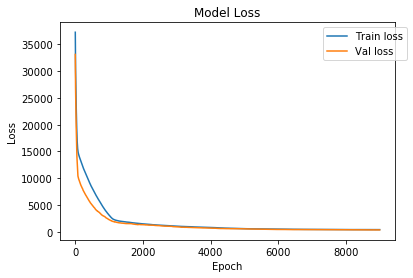

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

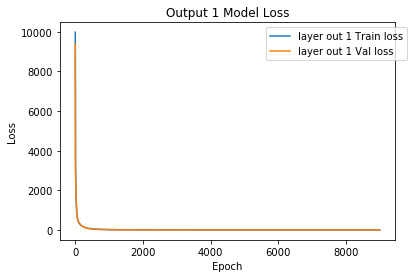

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

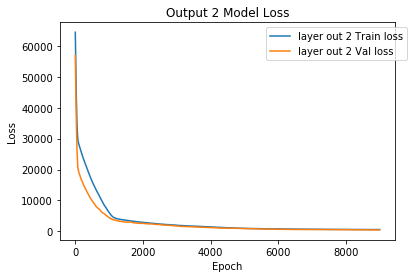

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [25]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([1264.83730649, 1275.18781625, 1286.14001341, 1280.30808342,
       1284.3859866 , 1287.50916683, 1286.85273803, 1289.62801629,
       1269.91196722, 1281.92276625, 1293.75749472, 1297.99440578,
       1306.44352254, 1294.13858499, 1291.12667412, 1297.77098518,
       1298.93579554, 1294.72368263, 1304.10069782, 1298.19005545,
       1292.82507313, 1303.97013895, 1303.92943416, 1303.64319661,
       1288.92716155, 1305.2632655 , 1292.84235176, 1304.89743813,
       1303.70446224, 1298.24658591, 1295.40783014, 1305.50462631,
       1293.81975063, 1289.57750012])

In [26]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [27]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(22.981216917174837, 36.54064524357236)

In [28]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [29]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

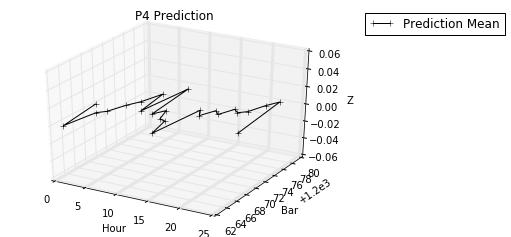

In [30]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P4 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

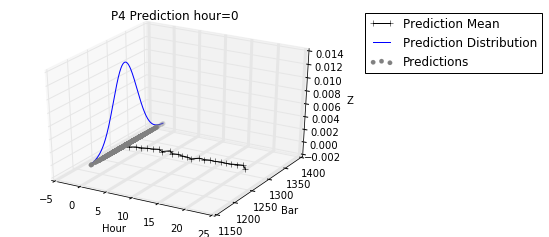

In [31]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("P4 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

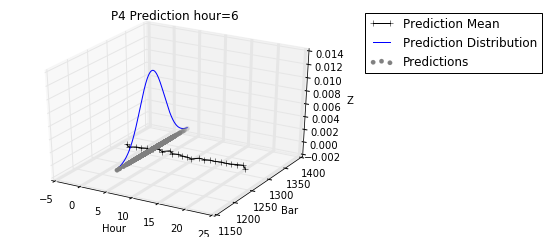

In [32]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

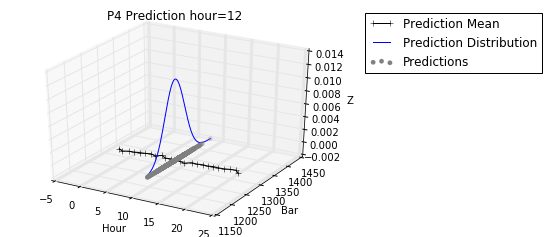

In [33]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

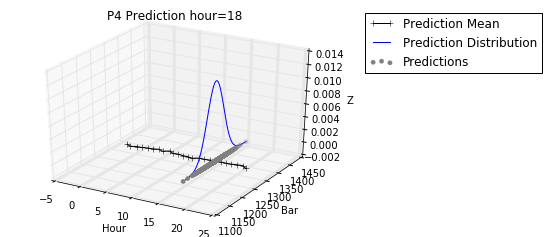

In [34]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

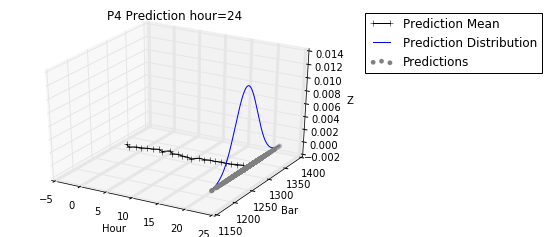

In [35]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("P4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Bar')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [36]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [37]:
#Load hour of prediction

hour_NUM = ['5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm']

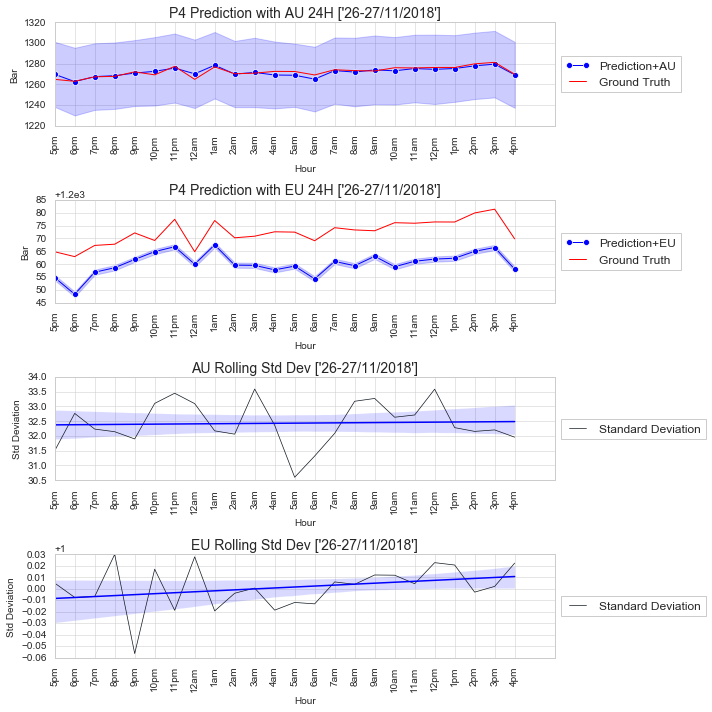

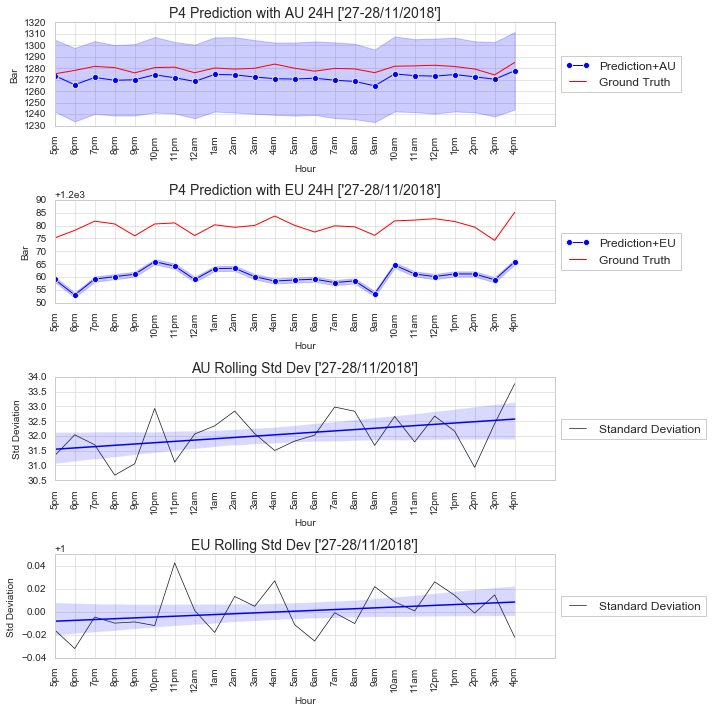

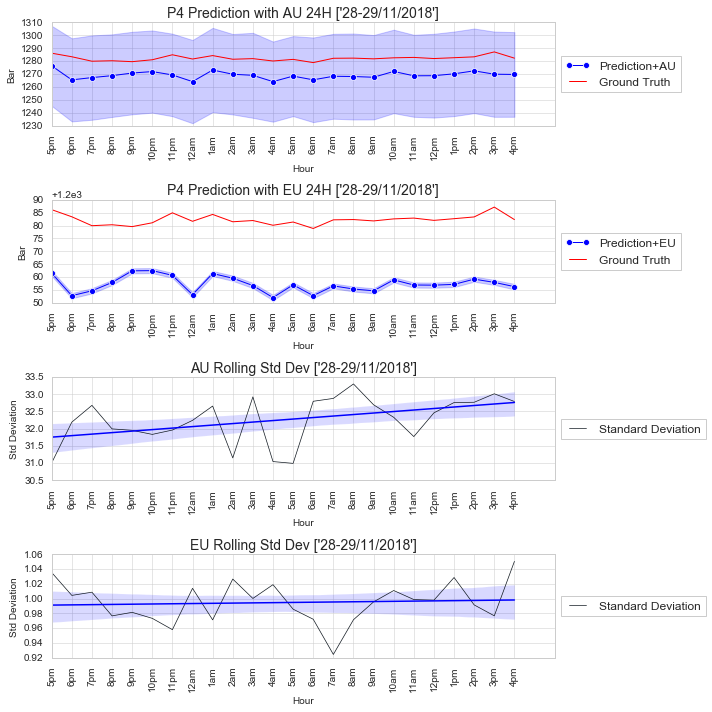

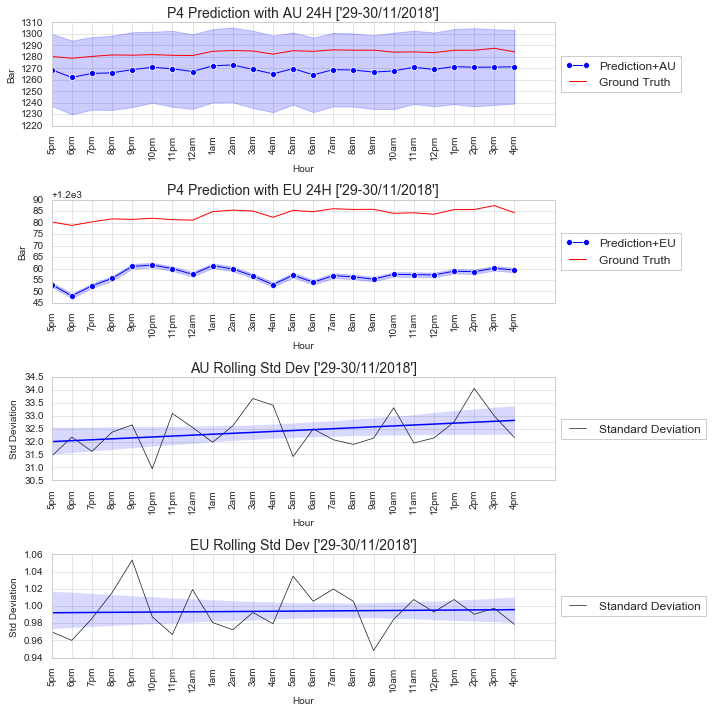

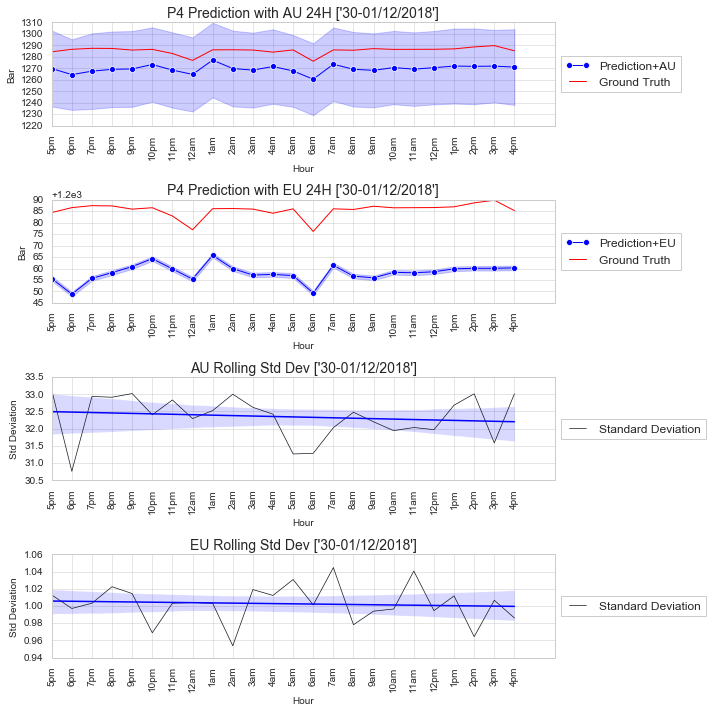

...

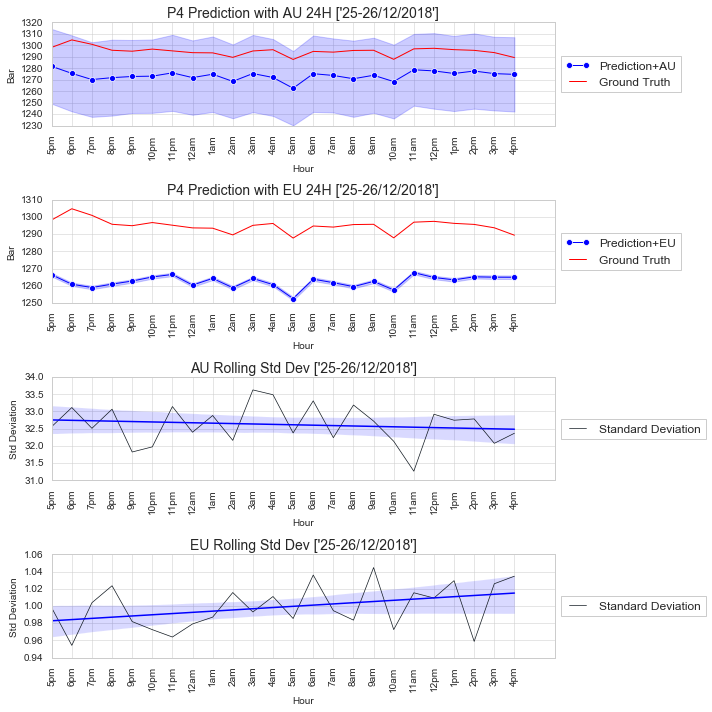

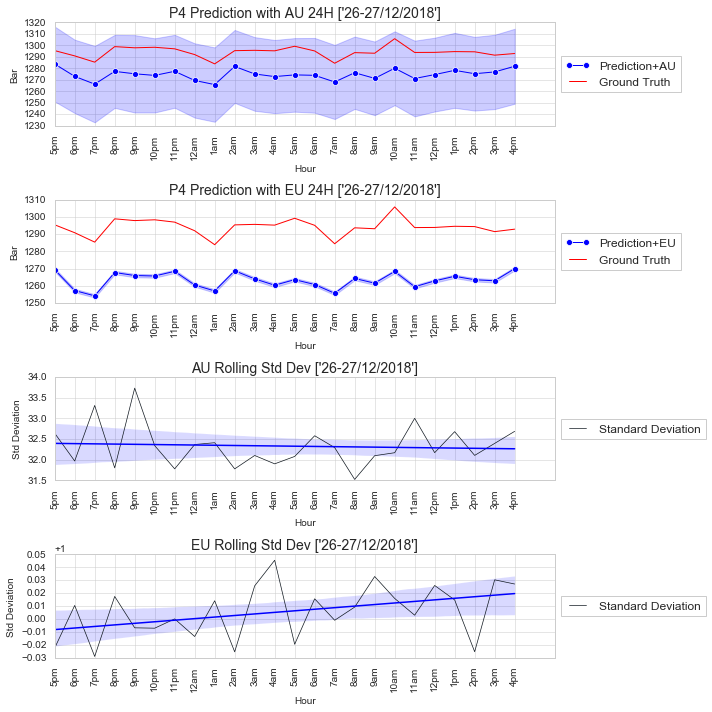

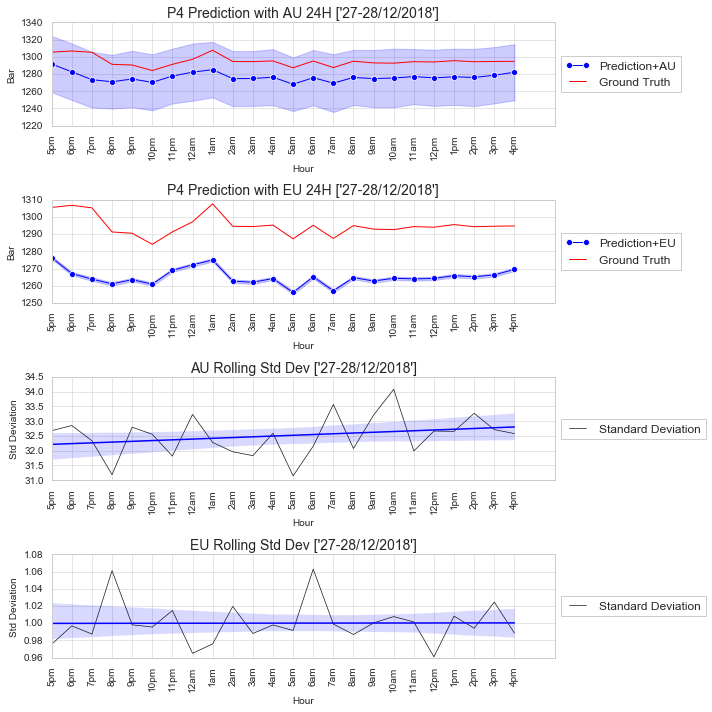

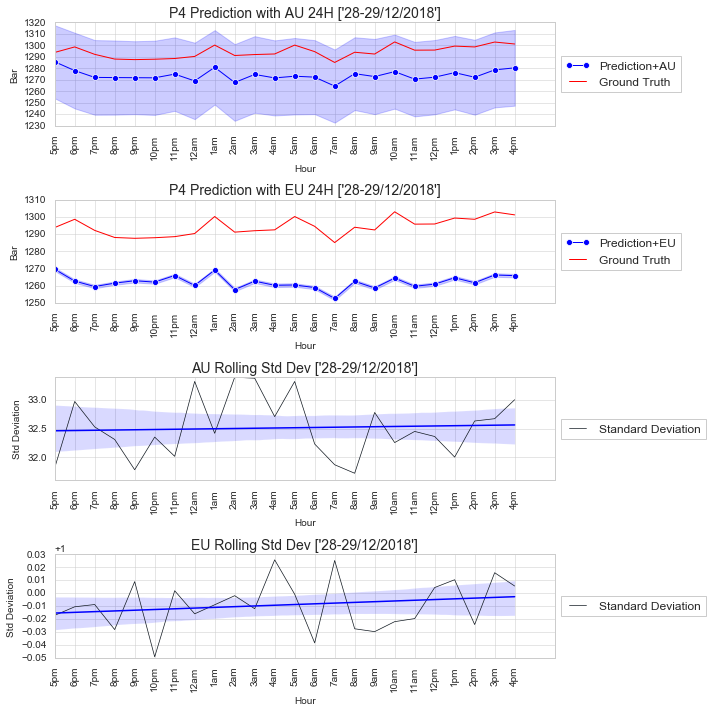

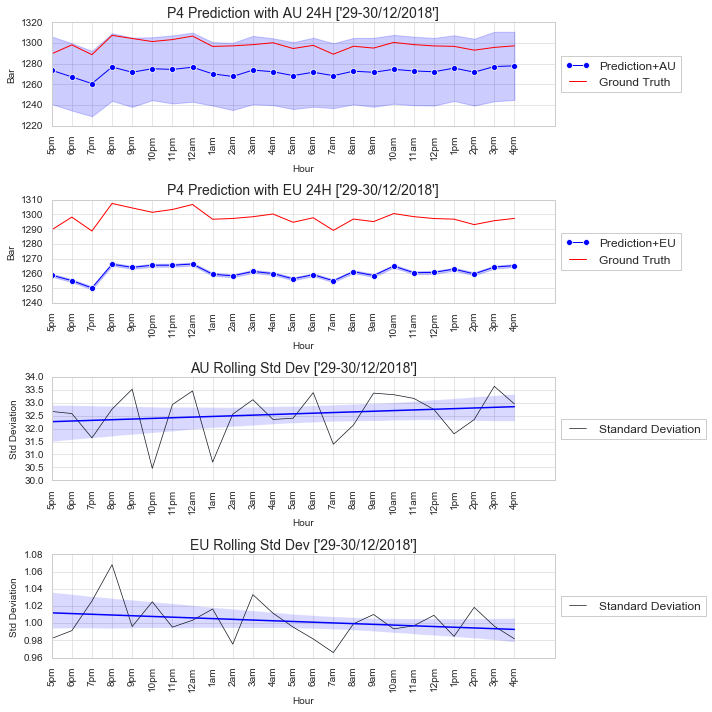

In [38]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','Bar']
    
    max_Seq_Arrange1.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','Bar']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P4 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('P4 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],scatter = False)
    plt.title('AU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'Bar', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['Bar'],scatter = False)
    plt.title('EU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.savefig("P4_Pred %i" %B+'.tiff')
    plt.show()

In [25]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 65)            18200     
_________________________________________________________________
dense_3 (Dense)              (None, 24, 495)           32670     
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 51,366
Trainable params: 51,366
Non-trainable params: 0
_________________________________________________________________


In [26]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [27]:
#Prediction with new LSTM & Consistency Metrics

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [28]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [29]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [30]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

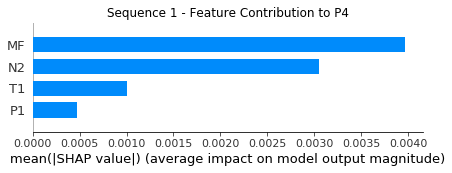

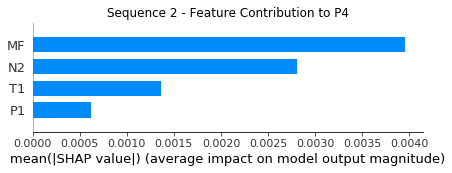

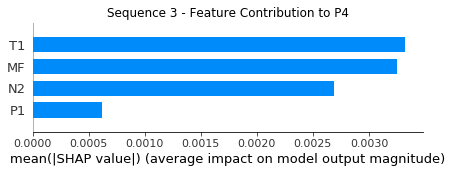

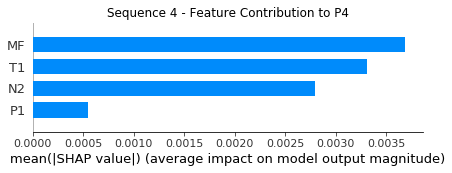

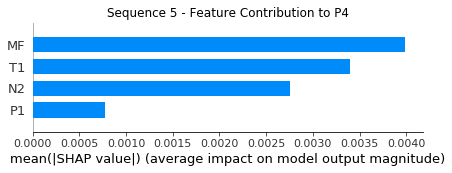

...

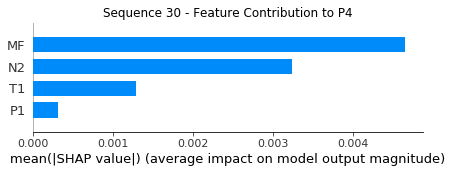

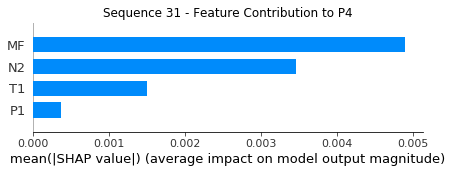

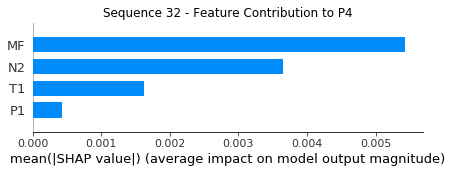

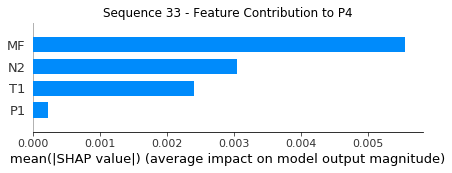

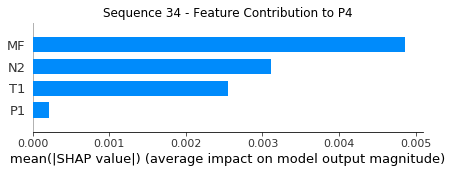

In [31]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution to P4" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

In [46]:
#SHAP Force Plot - Matplotlib
import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [-0.00067266 -0.00141481 -0.00207995 -0.00211023]


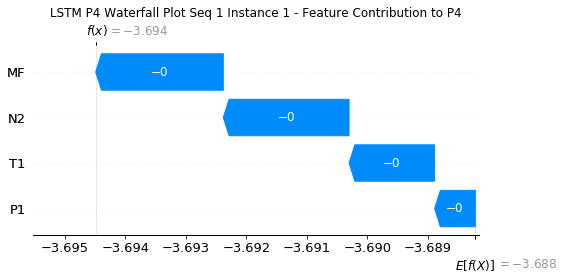

None

Contribution: [ 1.10450827e-04 -1.51254897e-04 -7.85673241e-05 -9.59932450e-05]


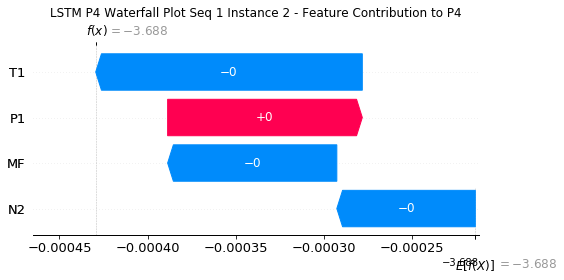

None

Contribution: [ 1.46108831e-04  1.03900874e-04 -6.48454582e-05 -5.07942598e-05]


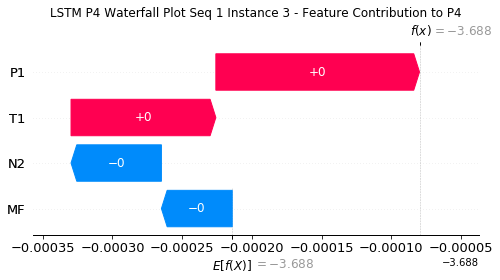

None

Contribution: [ 1.60142785e-04  1.13616976e-04 -6.80175147e-05 -1.10687275e-05]


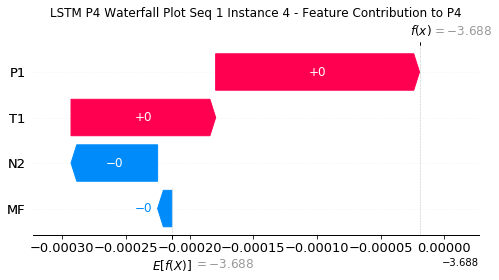

None

Contribution: [ 1.41731431e-04  9.34544126e-05 -8.48765635e-05 -1.54219082e-05]


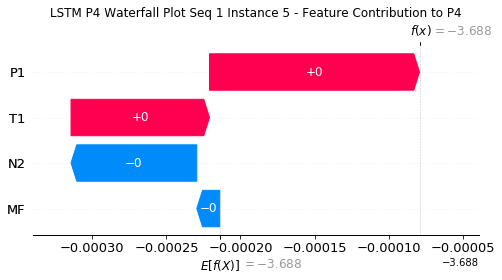

None

Contribution: [ 1.32354353e-04  4.03328472e-05 -1.40796320e-04 -6.24144528e-05]


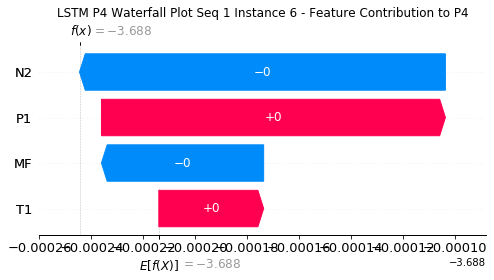

None

Contribution: [ 1.19890718e-04 -1.27073303e-06 -1.56164380e-04 -8.27681870e-06]


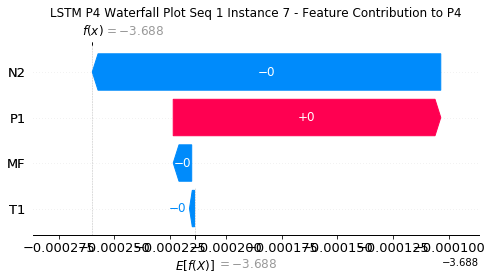

None

Contribution: [ 1.29547996e-04 -3.64528695e-05 -2.06048747e-04 -1.31020535e-04]


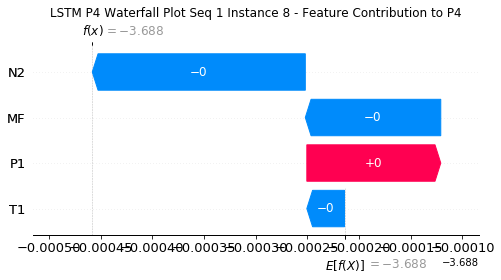

None

Contribution: [ 6.47938708e-05 -3.64136892e-05 -2.51350419e-04 -1.36159422e-04]


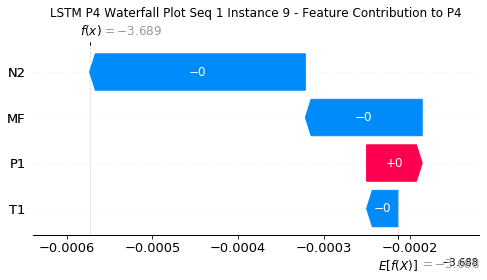

None

Contribution: [ 1.00463750e-04 -3.98291806e-05 -2.70196954e-04 -1.09952897e-04]


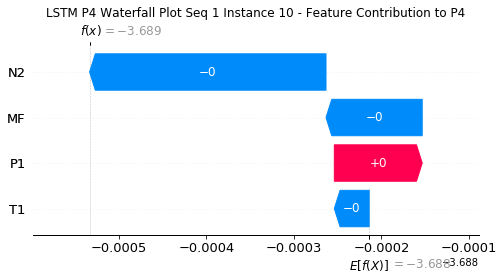

None

Contribution: [ 1.11682707e-05 -3.94650739e-05 -3.40204213e-04 -2.79673424e-04]


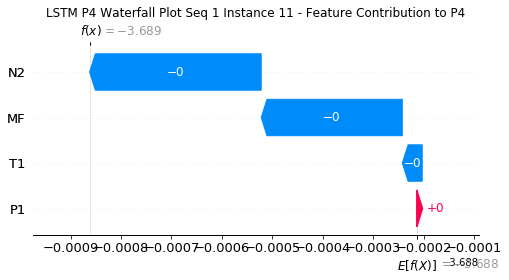

None

Contribution: [-1.21773628e-05 -1.84288015e-05 -3.96653808e-04 -3.35207018e-04]


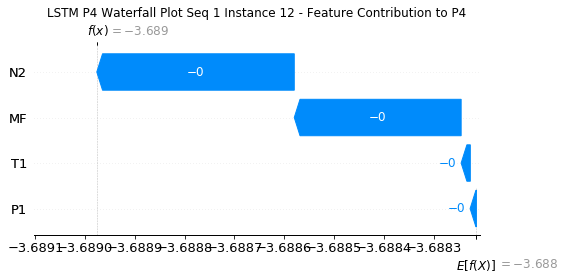

None

Contribution: [-1.52945077e-05 -4.19490695e-05 -4.89483207e-04 -4.17269930e-04]


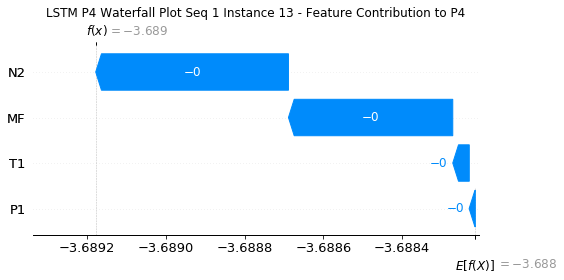

None

Contribution: [ 9.36414781e-05 -1.02163727e-04 -5.02406578e-04 -3.45612435e-04]


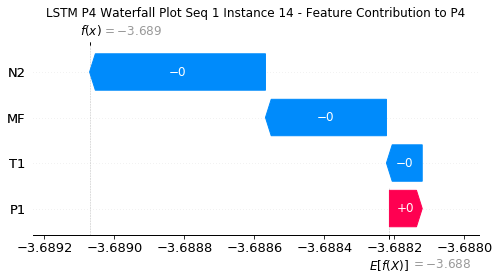

None

Contribution: [-1.77229865e-05 -1.27712785e-05 -4.27193190e-04 -3.26937975e-04]


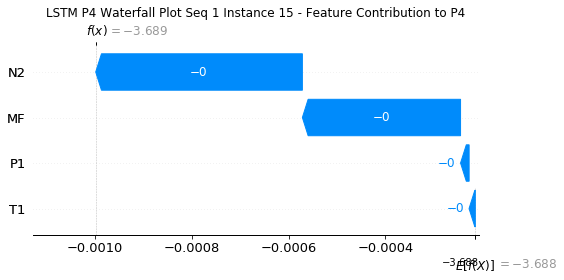

None

Contribution: [-4.64676547e-05  2.86762025e-06 -5.90007040e-04 -4.81575350e-04]


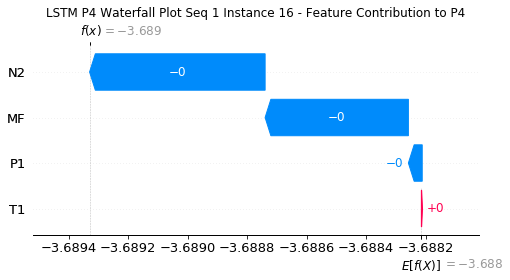

None

Contribution: [-4.64975062e-06 -3.43346060e-04 -1.43090551e-03 -1.14089229e-03]


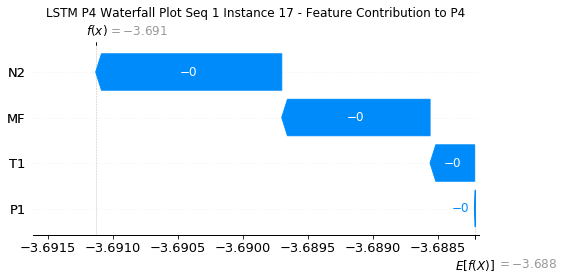

None

Contribution: [-5.42456017e-05  1.97632708e-04 -9.14996304e-04 -9.11082240e-04]


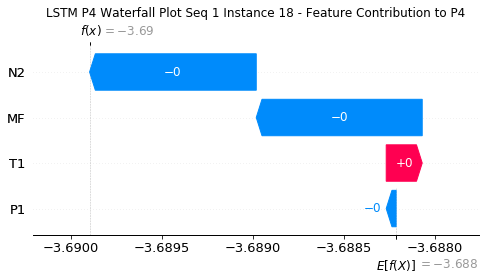

None

Contribution: [-2.03740397e-04 -2.86108903e-05  1.71036939e-03  2.27663337e-03]


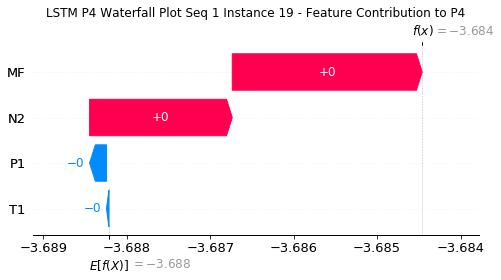

None

Contribution: [-0.00020501 -0.00251991 -0.00278109 -0.00225153]


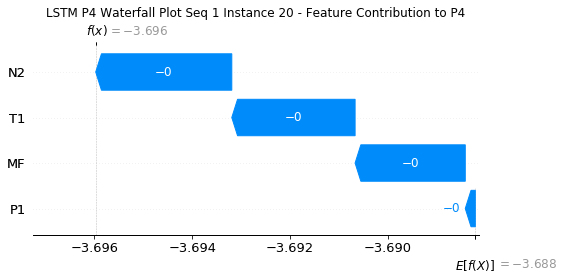

None

Contribution: [ 0.00090433  0.00341259 -0.00912447 -0.01164272]


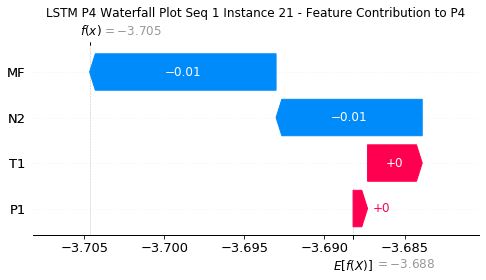

None

Contribution: [-0.00208544  0.00233495  0.00810258  0.00961651]


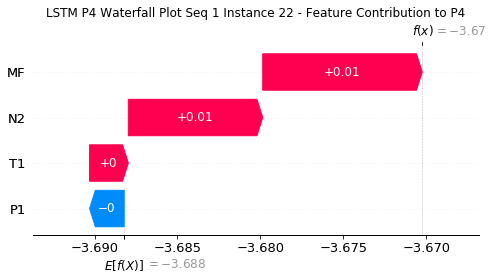

None

Contribution: [ 0.00391208 -0.0060934   0.0114427   0.02590048]


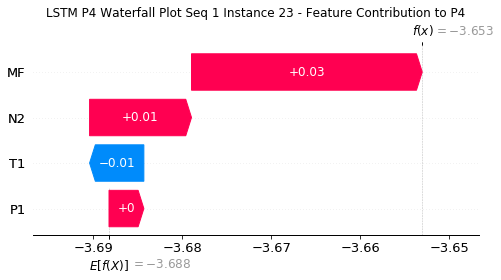

None

Contribution: [-0.00193818  0.00701376 -0.03157242 -0.03648544]


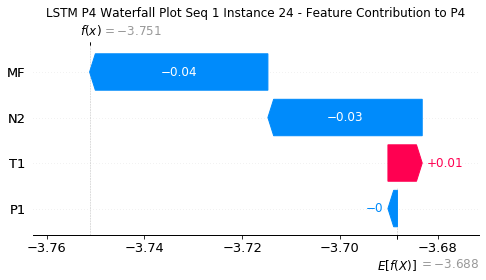

None

Contribution: [-0.00050369 -0.00110568 -0.00207037 -0.00180994]


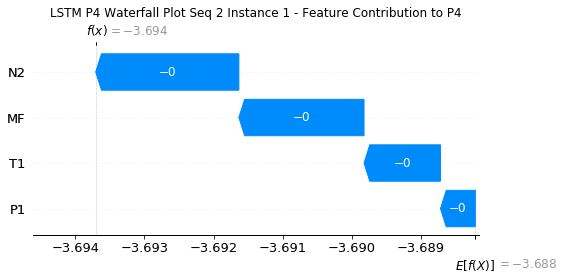

None

Contribution: [ 9.48453198e-05 -1.27613202e-04 -8.45896741e-05 -5.03850212e-05]


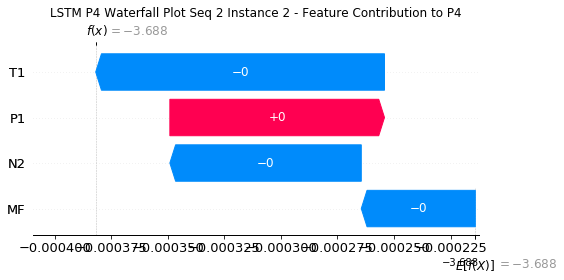

None

Contribution: [ 1.04455791e-04  3.82481288e-05 -7.22620957e-05 -7.21934347e-06]


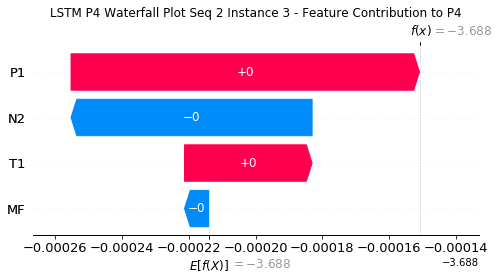

None

Contribution: [ 1.04385933e-04  3.21112094e-05 -8.79404503e-05  5.89241672e-05]


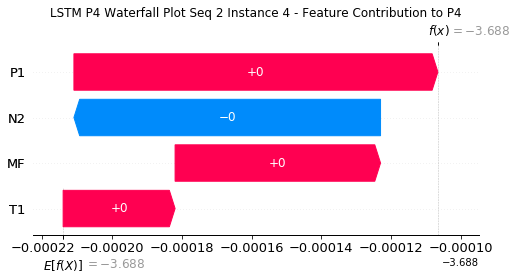

None

Contribution: [ 9.59911412e-05  2.21220725e-05 -1.45190236e-04  5.38671594e-05]


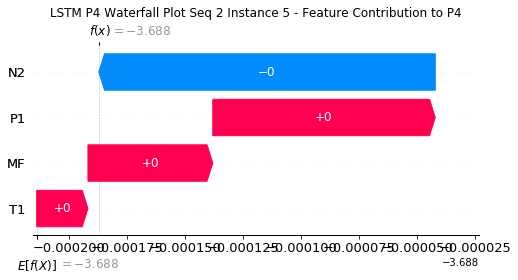

None

Contribution: [ 7.87341343e-05 -1.31252174e-05 -1.66152032e-04  3.01991506e-06]


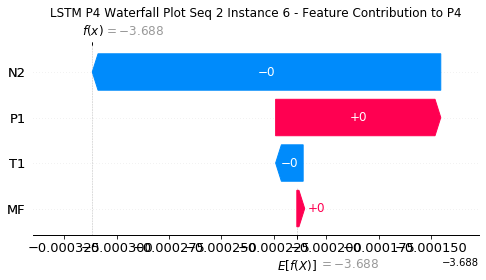

None

Contribution: [ 1.09472153e-04 -2.18182841e-05 -1.98218530e-04  8.88368702e-07]


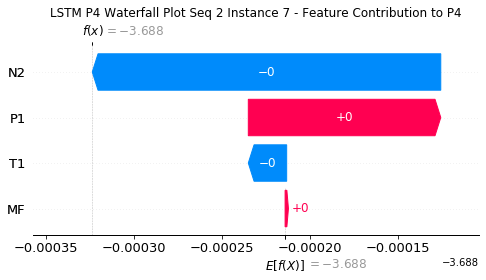

None

Contribution: [ 9.90502208e-05 -4.03226228e-05 -2.38071176e-04 -1.12595821e-04]


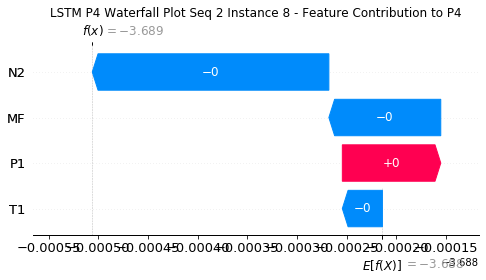

None

Contribution: [ 3.16932510e-05 -4.01779316e-05 -2.78623007e-04 -1.60636740e-04]


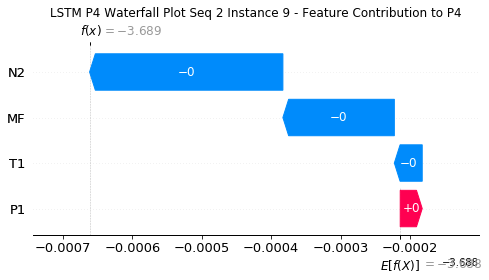

None

Contribution: [ 8.11302729e-05 -7.52272157e-05 -2.85461612e-04 -9.90594812e-05]


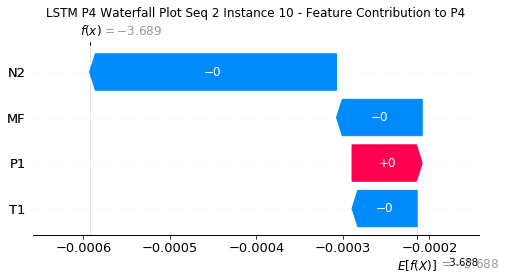

None

Contribution: [-1.63920865e-06 -7.63357561e-05 -3.55196786e-04 -2.63795547e-04]


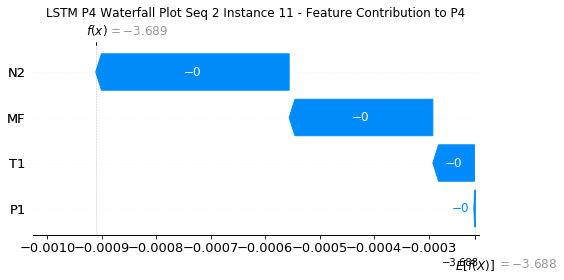

None

Contribution: [-1.27008190e-05 -4.54957685e-05 -4.12975271e-04 -3.13043515e-04]


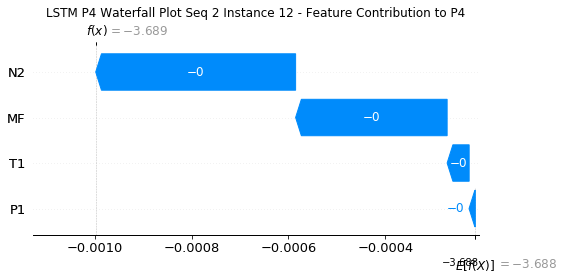

None

Contribution: [-2.55596276e-05 -8.19346652e-05 -5.05202071e-04 -4.12409955e-04]


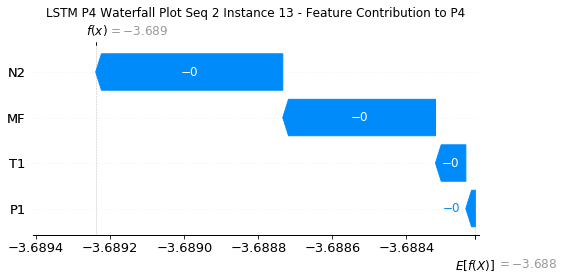

None

Contribution: [ 7.69083783e-05 -1.35316921e-04 -5.14392792e-04 -2.81564397e-04]


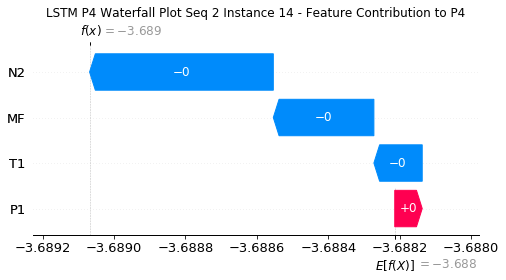

None

Contribution: [-2.05821280e-05 -5.99971874e-05 -4.28791281e-04 -3.21526189e-04]


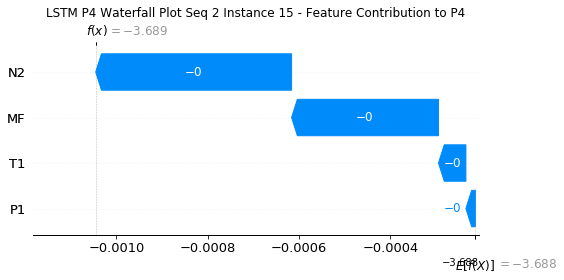

None

Contribution: [-4.52937442e-05 -6.24051131e-05 -6.11026843e-04 -5.04583009e-04]


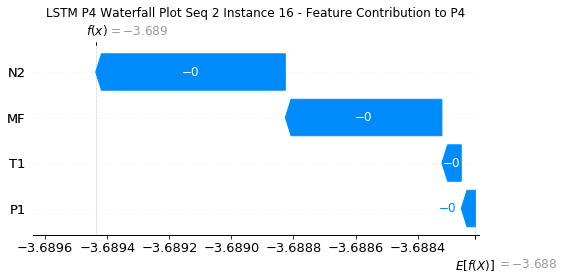

None

Contribution: [ 6.67911045e-06 -3.38519444e-04 -1.53803722e-03 -1.46199659e-03]


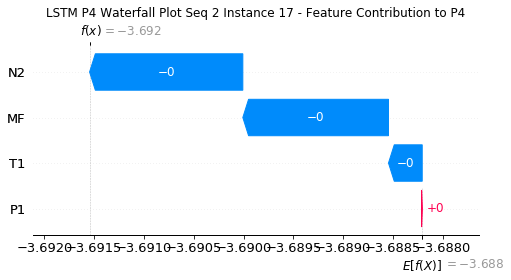

None

Contribution: [-5.29220974e-05  4.20425506e-05 -8.10181150e-04 -9.20252482e-04]


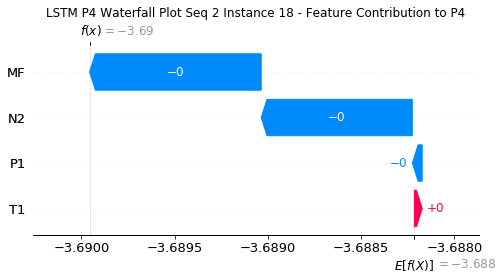

None

Contribution: [-2.00080666e-04 -8.40694942e-05  1.74227664e-03  2.31422085e-03]


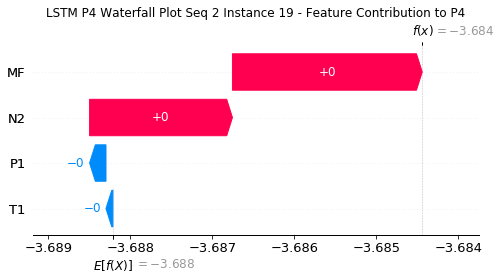

None

Contribution: [-0.00019954 -0.00216451 -0.00331531 -0.00203678]


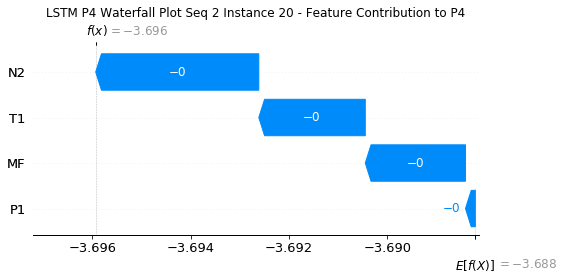

None

Contribution: [ 0.00087691  0.00254827 -0.00805874 -0.01152326]


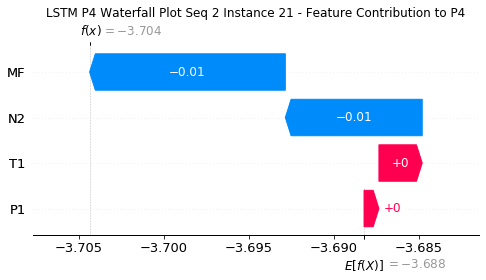

None

Contribution: [-0.00195514  0.00147375  0.00838035  0.01021915]


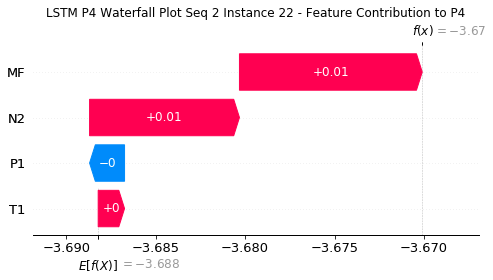

None

Contribution: [ 0.00674564 -0.00681314  0.0061372   0.01012243]


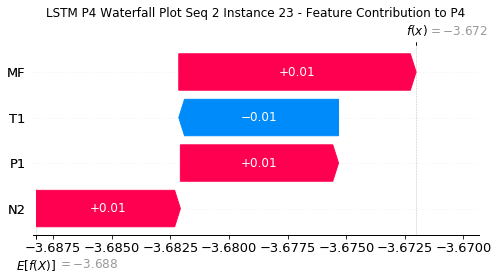

None

Contribution: [-0.00341388  0.01725848 -0.03088851 -0.0517917 ]


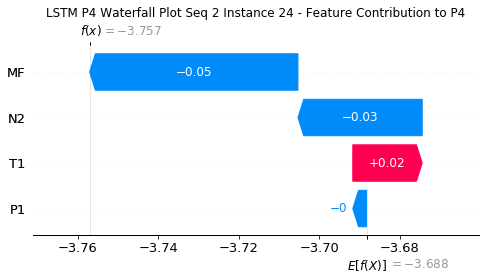

None

Contribution: [-0.00061301 -0.00231209 -0.00214289 -0.0015131 ]


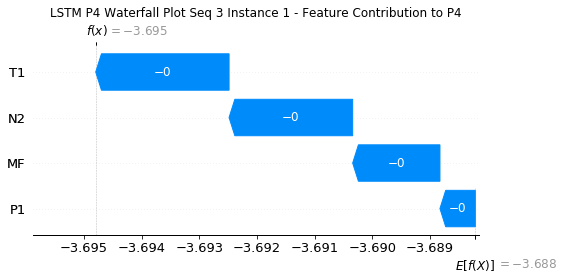

None

Contribution: [ 1.07632575e-04 -1.83999749e-04 -8.20935810e-05 -3.72954293e-05]


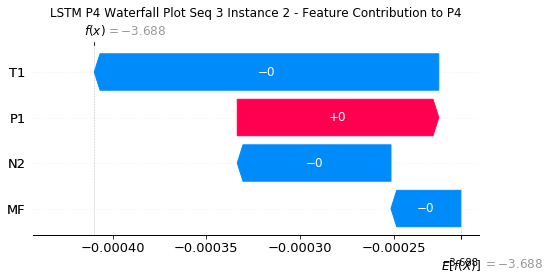

None

Contribution: [ 1.33106048e-04  2.92842546e-04 -7.53646474e-05 -1.98285698e-05]


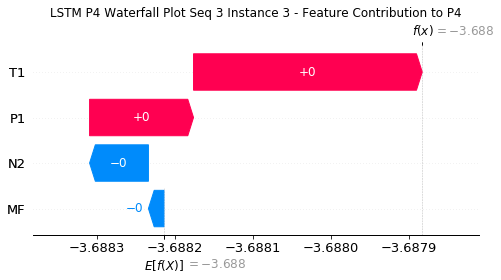

None

Contribution: [ 1.41408970e-04  3.37309980e-04 -9.15323159e-05  3.65672653e-05]


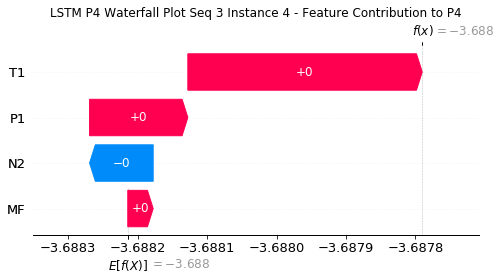

None

Contribution: [ 1.39245530e-04  2.99499634e-04 -1.06355224e-04  4.73420811e-05]


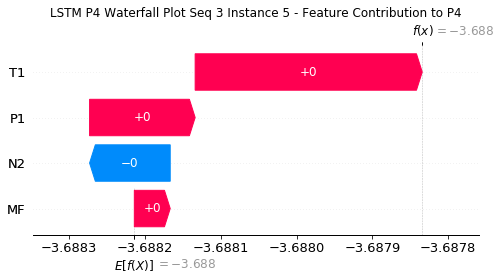

None

Contribution: [ 1.22848006e-04  2.16131824e-04 -1.69709257e-04 -3.11974705e-05]


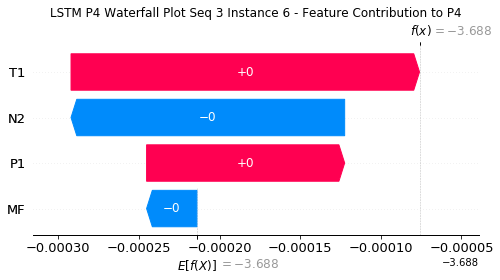

None

Contribution: [ 1.84539906e-04  1.50226413e-04 -2.07121861e-04 -4.63803071e-05]


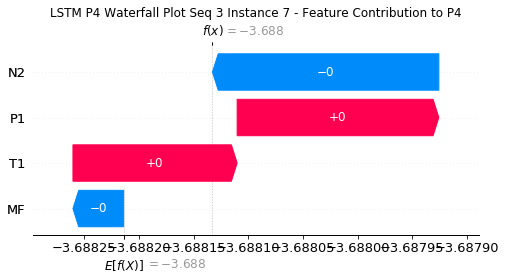

None

Contribution: [ 9.92545042e-05  1.25064698e-04 -2.42557194e-04 -1.42839323e-04]


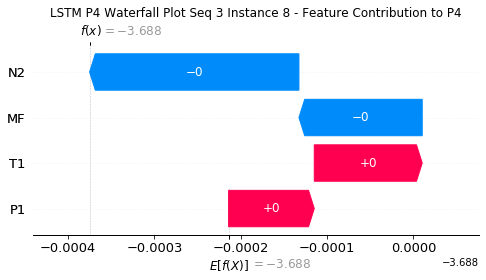

None

Contribution: [ 8.53691972e-05  8.85420022e-05 -2.79992228e-04 -1.85436109e-04]


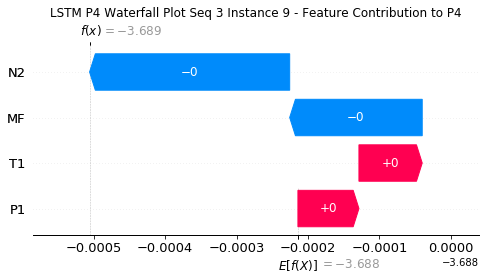

None

Contribution: [ 1.03761332e-04  6.75562626e-05 -2.85434124e-04 -1.11751742e-04]


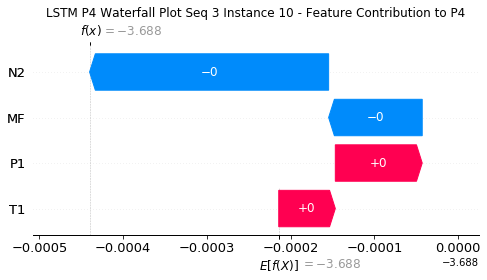

None

Contribution: [ 1.77158870e-05  6.69476178e-05 -3.60320875e-04 -2.83205729e-04]


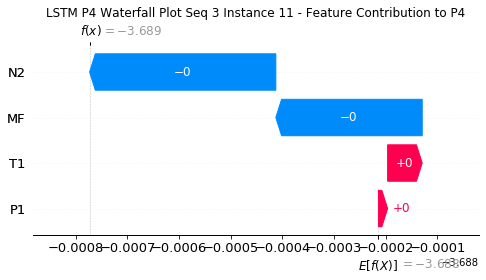

None

Contribution: [ 1.07247711e-05  9.92471692e-05 -4.13166374e-04 -3.48774220e-04]


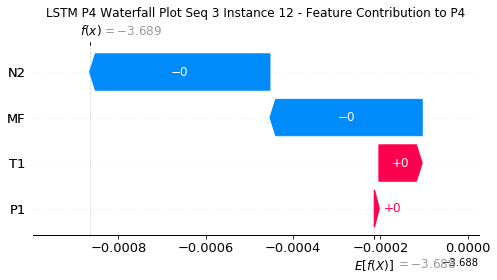

None

Contribution: [-3.56379452e-06  1.08211309e-04 -4.87622879e-04 -4.08937425e-04]


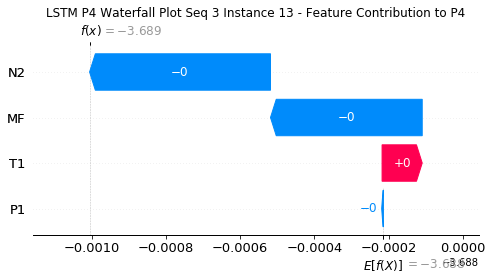

None

Contribution: [ 6.74445506e-05 -3.46374326e-06 -5.34483123e-04 -3.37926407e-04]


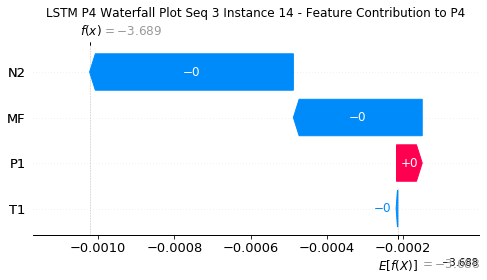

None

Contribution: [ 7.29985718e-06  1.54089070e-04 -4.76508597e-04 -3.81485523e-04]


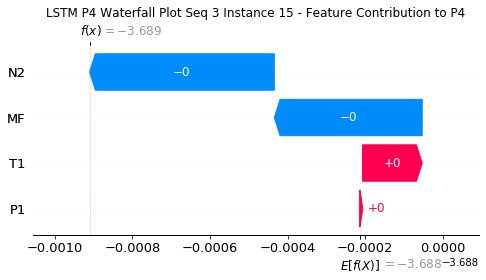

None

Contribution: [-4.54777132e-05  2.73746270e-04 -5.50854519e-04 -4.43393995e-04]


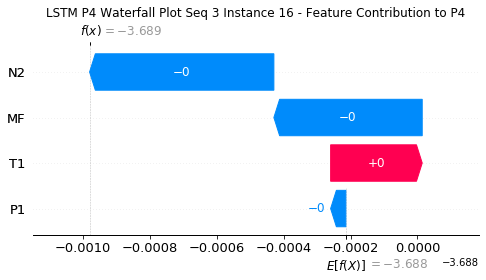

None

Contribution: [-1.90749706e-05 -4.72120942e-04 -1.45122057e-03 -1.21563710e-03]


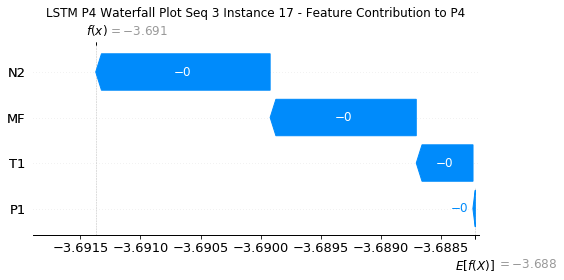

None

Contribution: [ 4.43135728e-05  8.54679991e-04 -9.83834266e-04 -1.03041137e-03]


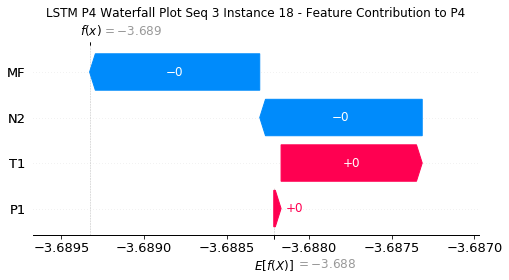

None

Contribution: [-0.00029143  0.00033535  0.00161491  0.00211845]


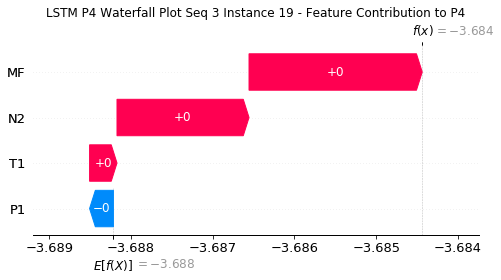

None

Contribution: [-0.00019921 -0.00550787 -0.00306798 -0.00247362]


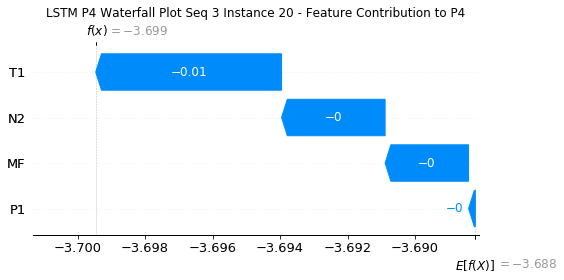

None

Contribution: [ 0.00105314  0.00961786 -0.00808764 -0.01009639]


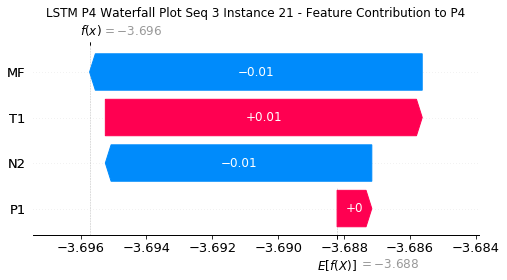

None

Contribution: [-0.00261338  0.00607963  0.00798093  0.00968086]


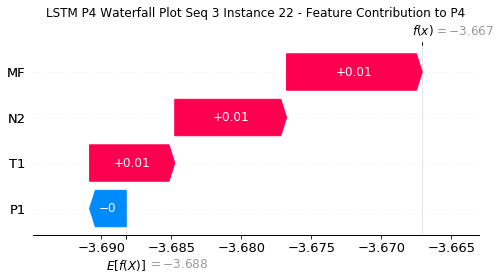

None

Contribution: [ 0.00512881 -0.0219966   0.00724436  0.01506325]


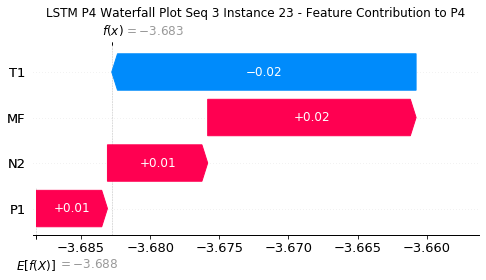

None

Contribution: [-0.00359607  0.03000973 -0.02766786 -0.03194268]


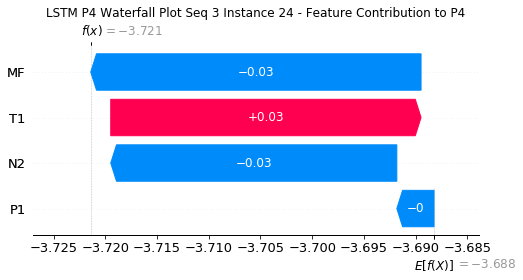

None

Contribution: [-0.00066382 -0.00298508 -0.00232386 -0.0021135 ]


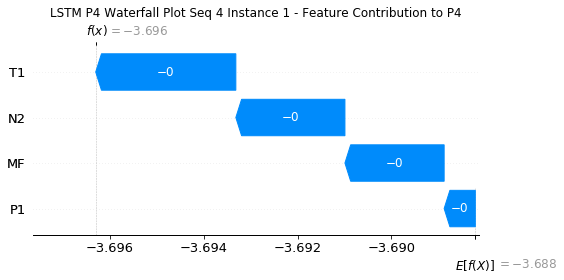

None

Contribution: [ 1.14872452e-04 -2.12864442e-04 -9.19407350e-05 -7.76103863e-05]


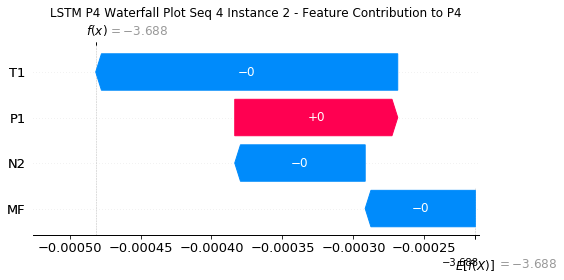

None

Contribution: [ 1.33285077e-04  3.02781975e-04 -7.97235243e-05 -6.11180949e-05]


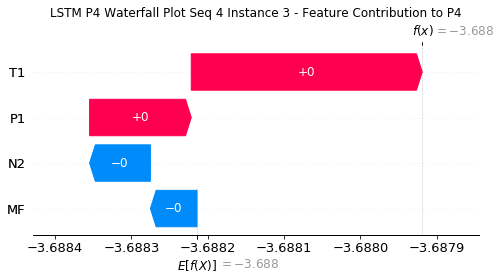

None

Contribution: [ 1.46223653e-04  3.46729393e-04 -1.01050618e-04 -3.10614072e-05]


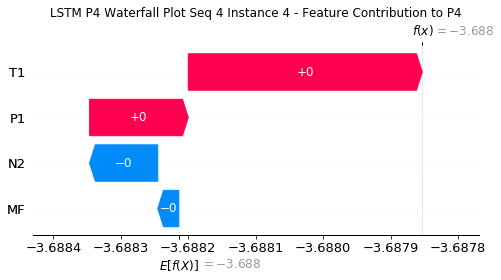

None

Contribution: [ 1.27339316e-04  2.51237616e-04 -1.30279193e-04 -3.22499817e-05]


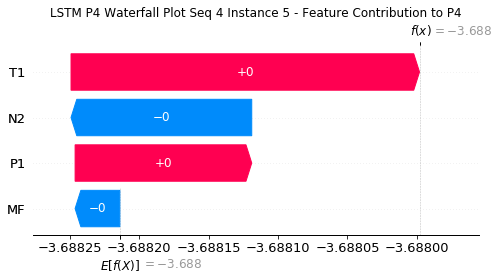

None

Contribution: [ 1.20306486e-04  2.13955377e-04 -1.74186315e-04 -9.26109359e-05]


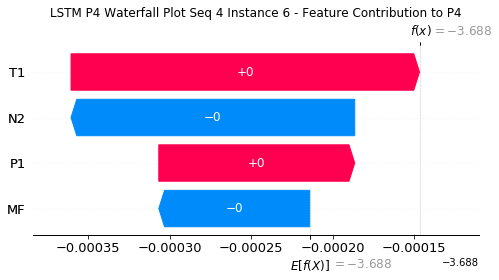

None

Contribution: [ 1.18163637e-04  1.49018878e-04 -1.94585880e-04 -9.19252725e-05]


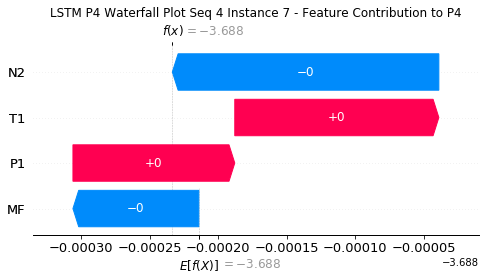

None

Contribution: [ 0.0001058   0.00010393 -0.00022905 -0.00014415]


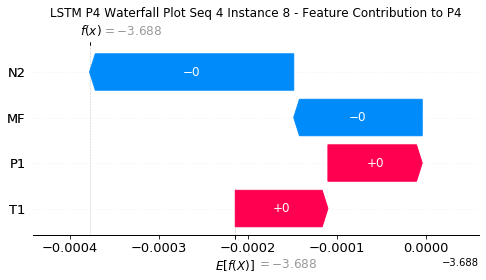

None

Contribution: [ 8.00444724e-05  7.50205175e-05 -2.73793804e-04 -1.90661760e-04]


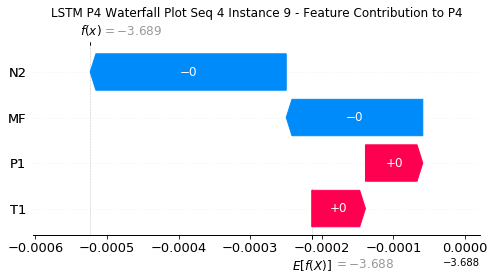

None

Contribution: [ 9.60507306e-05  6.53423666e-05 -2.83259158e-04 -1.10446682e-04]


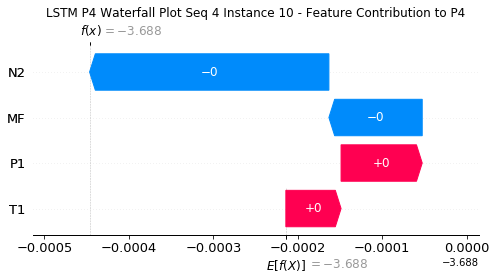

None

Contribution: [ 4.49064408e-06  6.86246199e-05 -3.56688783e-04 -2.83992641e-04]


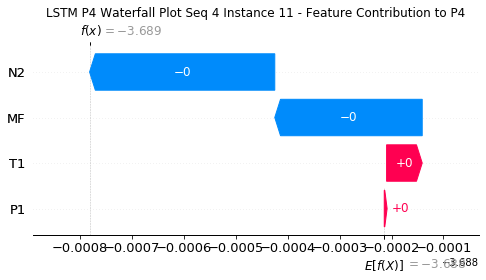

None

Contribution: [ 5.07207197e-05  1.13156038e-04 -4.09941005e-04 -3.55915310e-04]


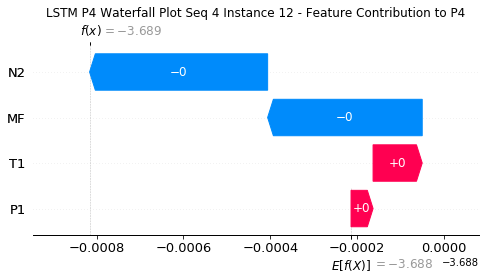

None

Contribution: [-1.43599328e-05  1.15304877e-04 -4.85351586e-04 -4.06436192e-04]


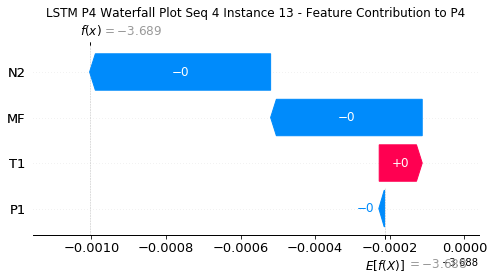

None

Contribution: [ 4.78985411e-05  1.72133413e-05 -5.24552258e-04 -3.28583533e-04]


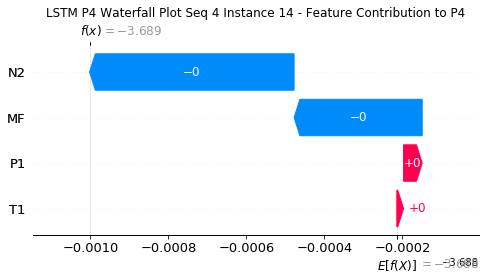

None

Contribution: [-1.35919118e-05  1.66950682e-04 -4.75454299e-04 -3.79362070e-04]


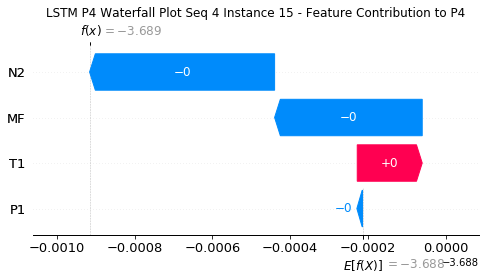

None

Contribution: [-5.52250661e-05  2.93766032e-04 -5.51767652e-04 -4.44446960e-04]


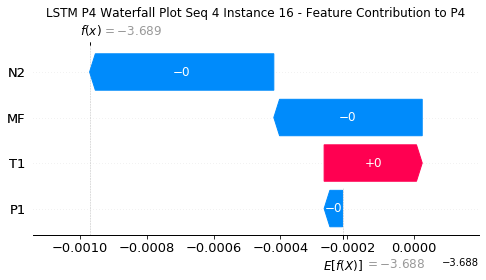

None

Contribution: [-4.64934069e-05 -4.76304033e-04 -1.42153350e-03 -1.19884844e-03]


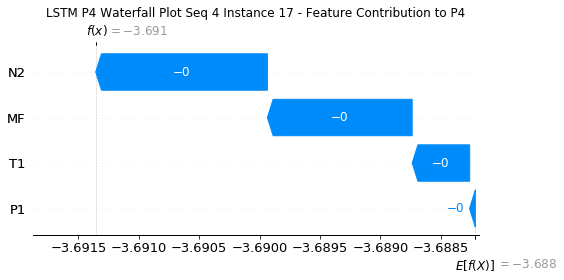

None

Contribution: [-1.80935979e-06  9.51081779e-04 -1.00601849e-03 -9.94993270e-04]


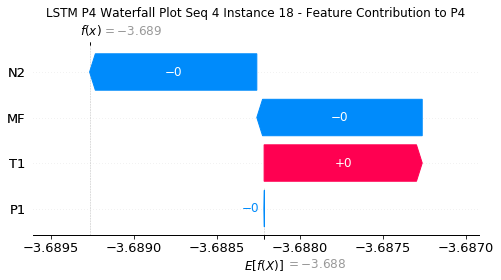

None

Contribution: [-0.00027484  0.00037715  0.00159925  0.00212949]


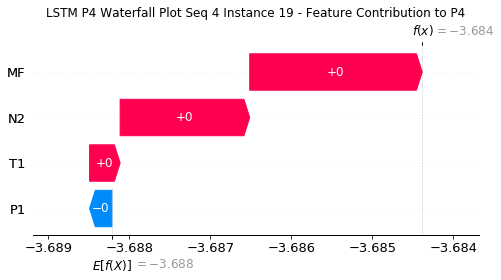

None

Contribution: [-0.00022528 -0.00585795 -0.00294392 -0.00265903]


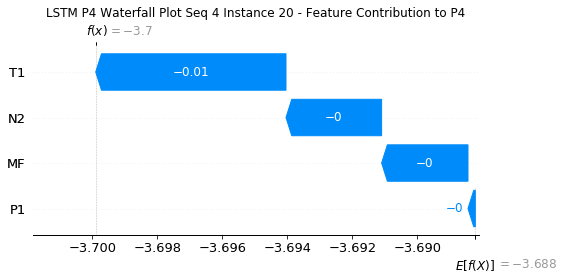

None

Contribution: [ 0.00105197  0.01006633 -0.00842494 -0.0103442 ]


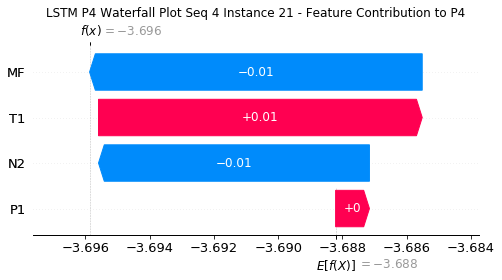

None

Contribution: [-0.00266999  0.00635406  0.00792687  0.00973723]


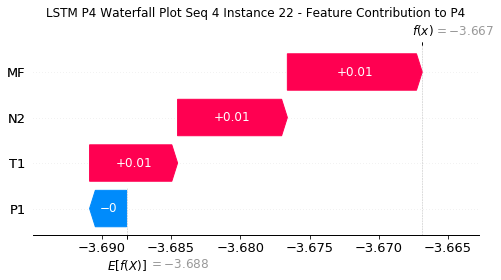

None

Contribution: [ 0.00417754 -0.02016944  0.00735758  0.01639142]


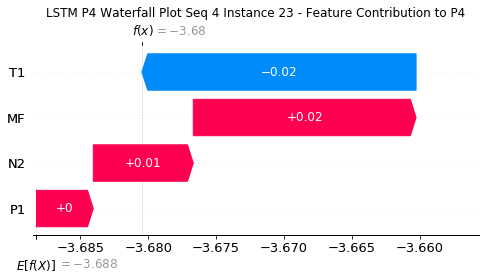

None

Contribution: [-0.00285536  0.02978561 -0.0298233  -0.03985462]


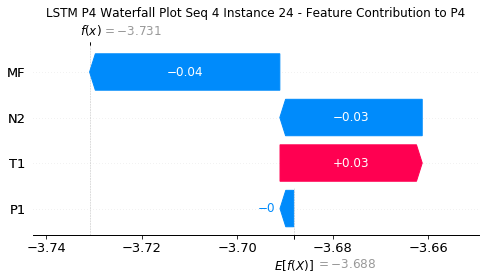

None

Contribution: [-0.00059927 -0.0032047  -0.00228383 -0.001924  ]


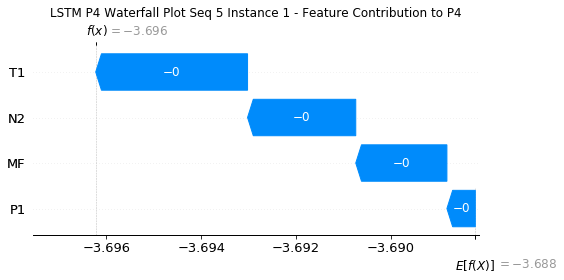

None

Contribution: [ 1.08062956e-04 -2.32053081e-04 -9.27032220e-05 -6.24162962e-05]


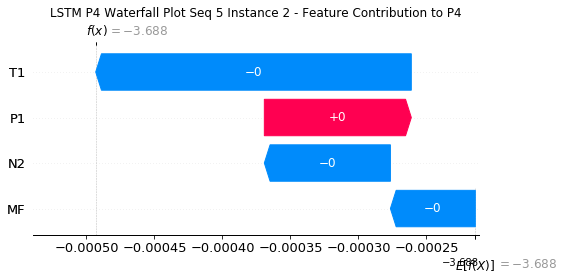

None

Contribution: [ 1.34883325e-04  3.70542186e-04 -7.61472775e-05 -1.39442344e-05]


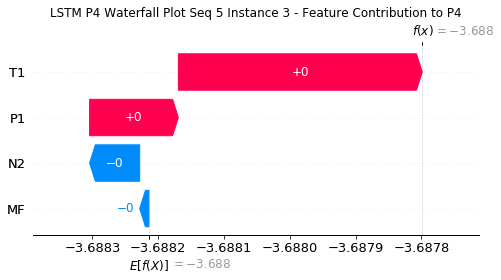

None

Contribution: [ 1.39705930e-04  4.12499057e-04 -9.36273064e-05  6.31261814e-05]


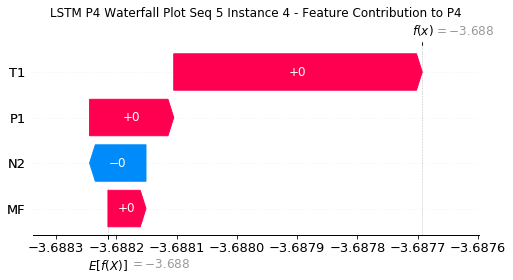

None

Contribution: [ 1.01627410e-04  3.75259002e-04 -1.29020328e-04  6.48871401e-05]


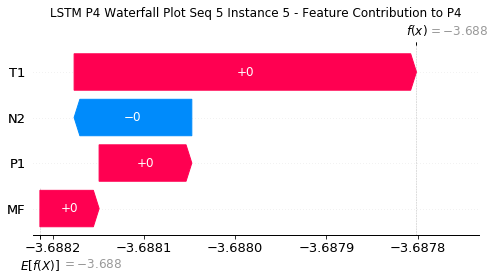

None

Contribution: [ 1.17064398e-04  2.65358101e-04 -1.67939299e-04 -5.66211822e-06]


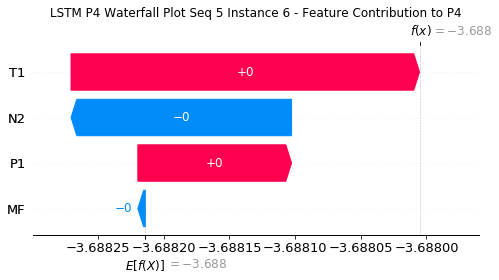

None

Contribution: [ 1.33244198e-04  1.86184766e-04 -1.90771950e-04 -5.40247719e-05]


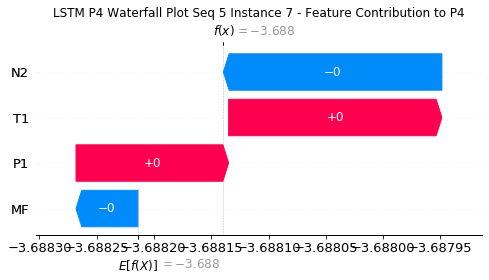

None

Contribution: [ 0.00014596  0.00012531 -0.00023414 -0.00015188]


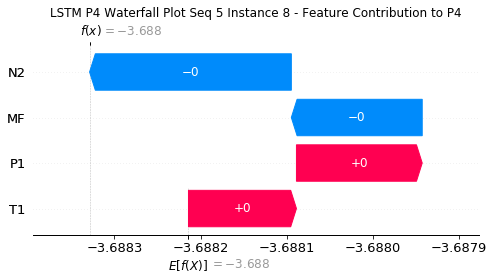

None

Contribution: [ 6.89892438e-05  9.35716407e-05 -2.69906240e-04 -1.35262721e-04]


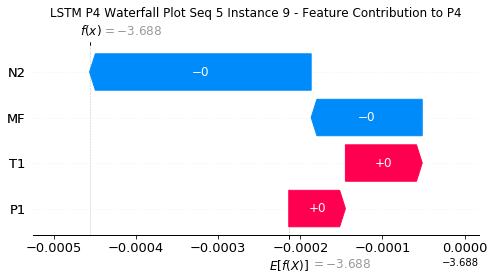

None

Contribution: [ 8.63903200e-05  8.43182510e-05 -2.81853772e-04 -7.93318630e-05]


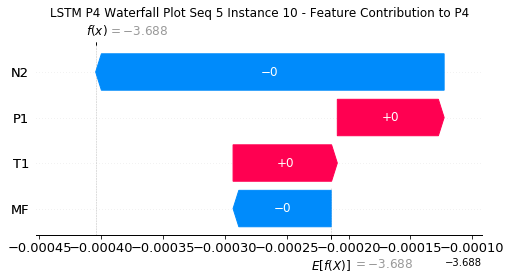

None

Contribution: [ 6.97540341e-07  8.53461347e-05 -3.56158858e-04 -2.58825510e-04]


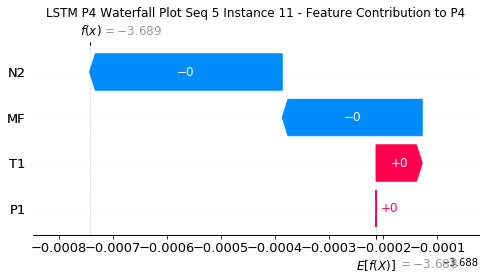

None

Contribution: [ 2.49721734e-05  1.07686266e-04 -4.06198376e-04 -3.14813011e-04]


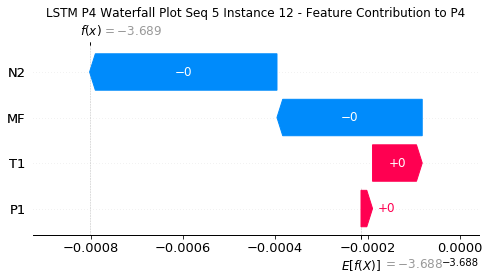

None

Contribution: [-2.24576964e-05  1.38677403e-04 -4.81759661e-04 -3.82299593e-04]


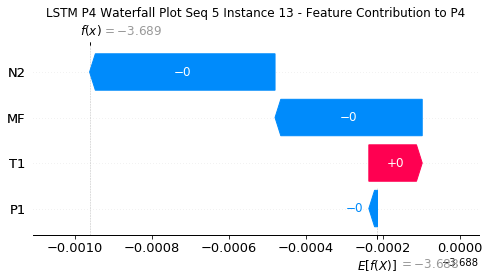

None

Contribution: [ 4.48445381e-05  1.62154635e-05 -5.31223155e-04 -3.60848033e-04]


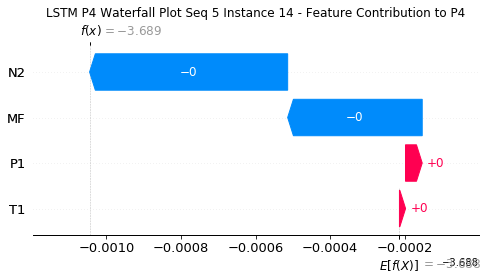

None

Contribution: [-1.89077601e-05  1.80518250e-04 -4.83909554e-04 -3.75379686e-04]


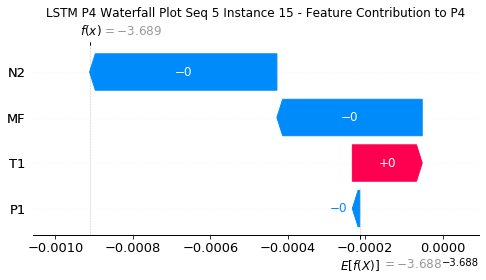

None

Contribution: [-5.89947250e-05  3.30735476e-04 -5.41665917e-04 -4.37525187e-04]


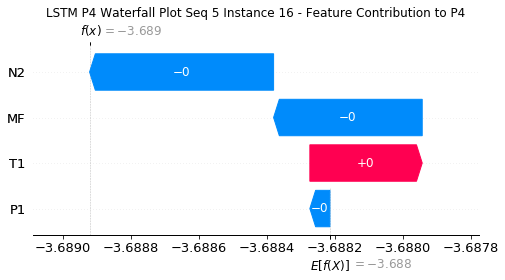

None

Contribution: [-9.25908038e-06 -5.05910408e-04 -1.41117068e-03 -1.08037305e-03]


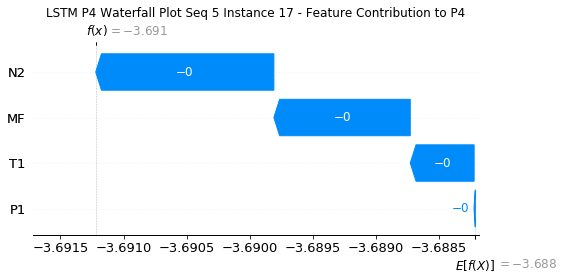

None

Contribution: [ 2.83304313e-05  1.02377308e-03 -1.04568829e-03 -1.11061417e-03]


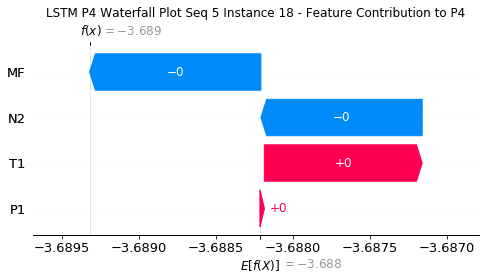

None

Contribution: [-0.00029589  0.00047964  0.00156353  0.00202217]


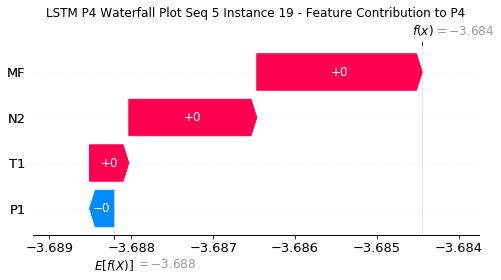

None

Contribution: [-0.00021383 -0.00610639 -0.00283014 -0.0017686 ]


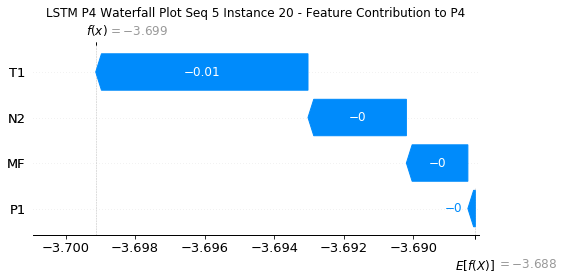

None

Contribution: [ 0.00108225  0.0103076  -0.00843775 -0.01177874]


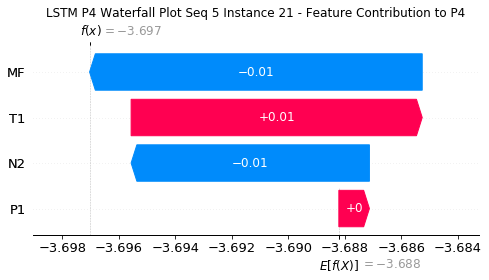

None

Contribution: [-0.00283705  0.00659119  0.00785122  0.0091523 ]


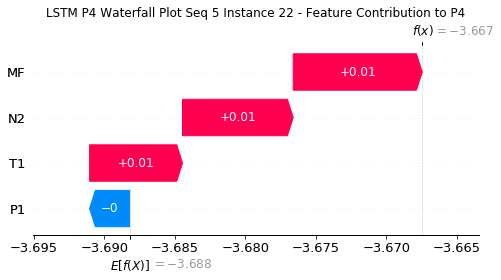

None

Contribution: [ 0.00774269 -0.0201826   0.0068982   0.0189872 ]


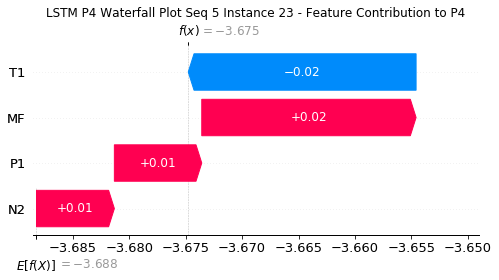

None

Contribution: [-0.00453629  0.03006019 -0.02951293 -0.04502399]


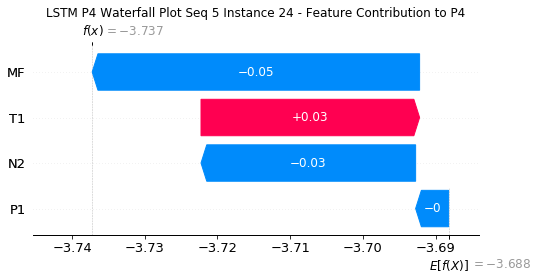

None

Contribution: [-0.00066416 -0.00300707 -0.00224028 -0.00164763]


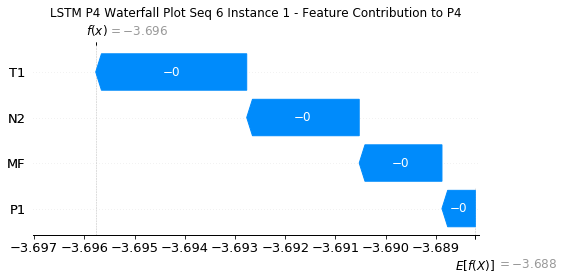

None

Contribution: [ 1.07347776e-04 -2.22009482e-04 -8.91504493e-05 -1.50960119e-05]


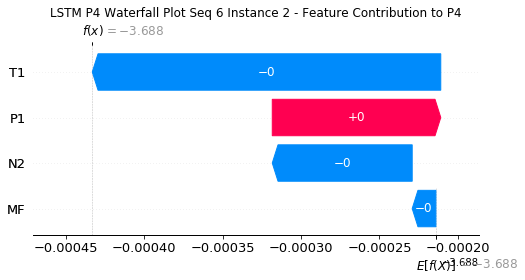

None

Contribution: [ 1.46376346e-04  3.21116769e-04 -8.38880295e-05 -3.60295310e-05]


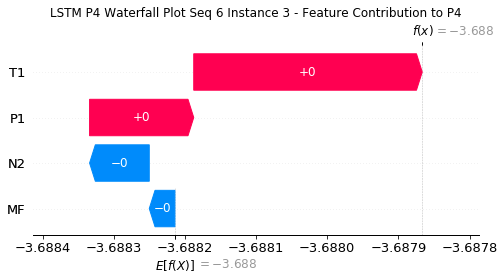

None

Contribution: [ 1.50789513e-04  3.65228573e-04 -1.05098341e-04  2.90226857e-05]


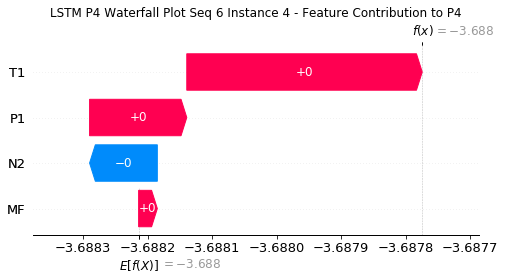

None

Contribution: [ 2.06919501e-04  3.20115557e-04 -1.46747217e-04 -1.17906696e-05]


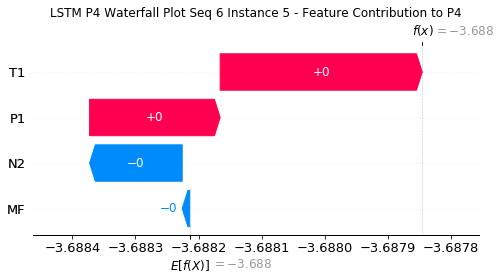

None

Contribution: [ 1.28480291e-04  2.27511877e-04 -1.77944807e-04 -3.41282657e-05]


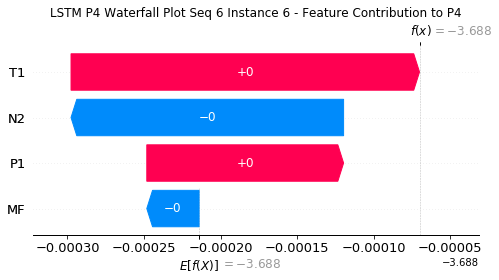

None

Contribution: [ 0.00016763  0.0001558  -0.00020372 -0.00010805]


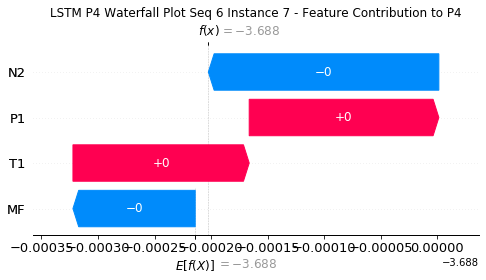

None

Contribution: [ 1.61393536e-04  9.37610741e-05 -2.28836540e-04 -7.98936732e-05]


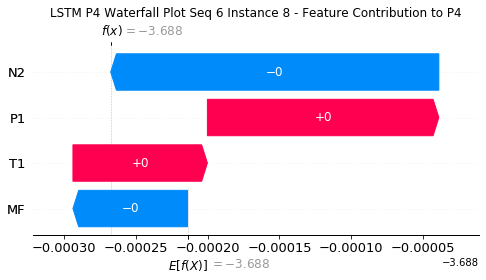

None

Contribution: [ 7.28594155e-05  8.23661064e-05 -2.71828913e-04 -1.60388419e-04]


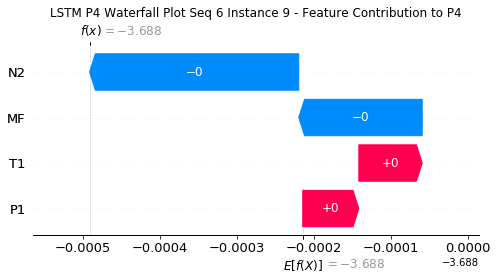

None

Contribution: [ 9.72768938e-05  6.91308895e-05 -2.81958183e-04 -7.28792226e-05]


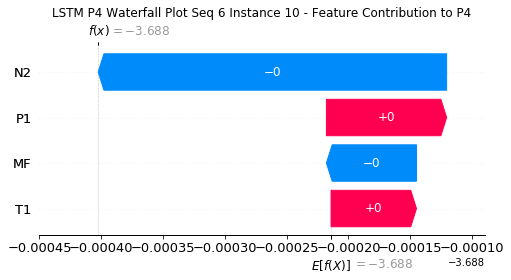

None

Contribution: [ 1.04297963e-05  6.90066450e-05 -3.58823160e-04 -2.55485345e-04]


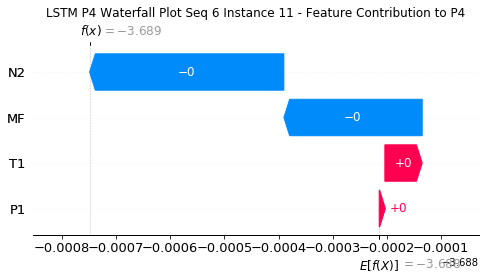

None

Contribution: [-1.81519890e-05  9.33250421e-05 -4.08754595e-04 -2.95132497e-04]


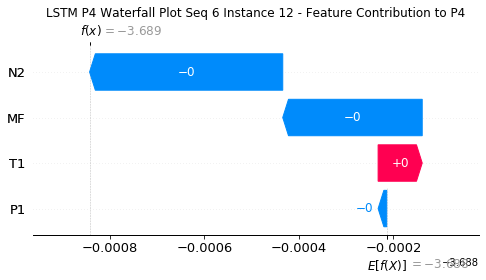

None

Contribution: [-1.46101396e-05  1.12620597e-04 -4.85930632e-04 -3.83273275e-04]


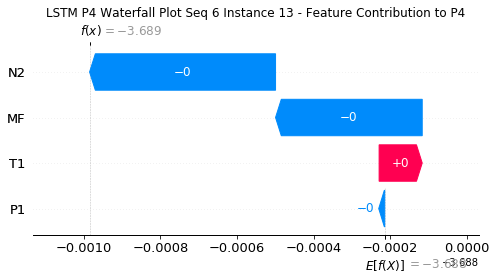

None

Contribution: [ 5.61627068e-05  1.07222907e-05 -5.38590051e-04 -3.20718087e-04]


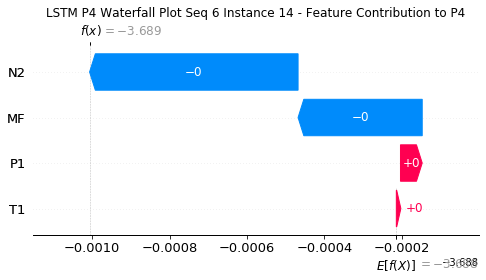

None

Contribution: [-1.18002546e-05  1.58799016e-04 -4.75556669e-04 -3.66794775e-04]


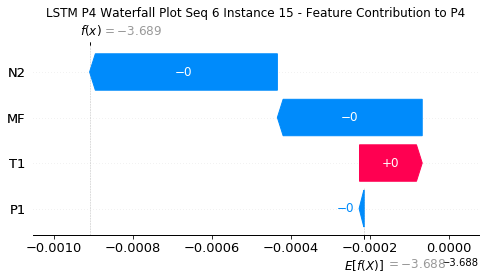

None

Contribution: [-6.04522929e-05  2.71642709e-04 -5.56642011e-04 -4.51505207e-04]


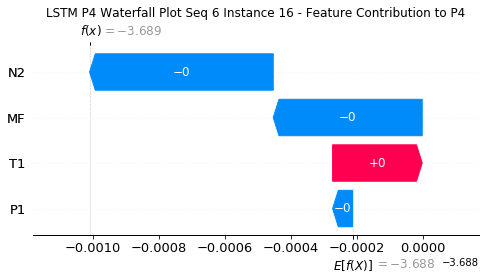

None

Contribution: [-1.52849053e-05 -4.62270375e-04 -1.42616405e-03 -1.14326204e-03]


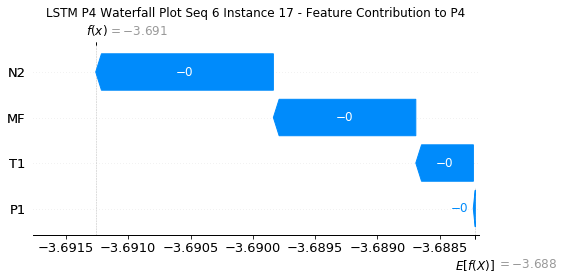

None

Contribution: [-6.08537514e-06  8.72024210e-04 -9.98415754e-04 -1.02703748e-03]


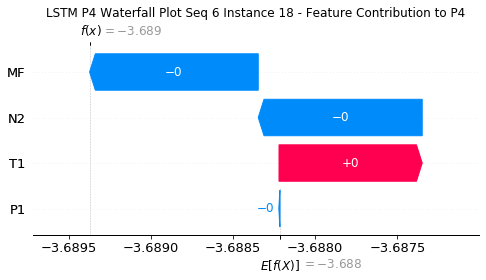

None

Contribution: [-0.00025456  0.00032151  0.00160311  0.00210155]


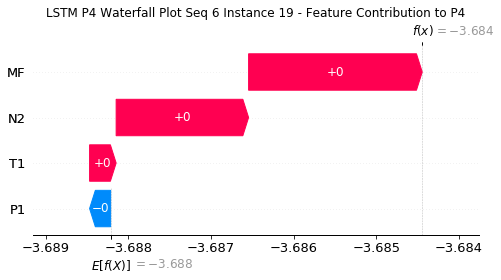

None

Contribution: [-0.00023057 -0.00529262 -0.00283095 -0.00194369]


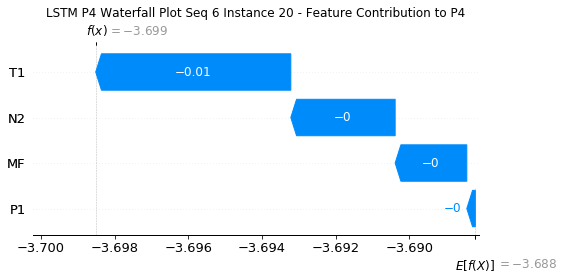

None

Contribution: [ 0.00096302  0.00899183 -0.00877809 -0.01217904]


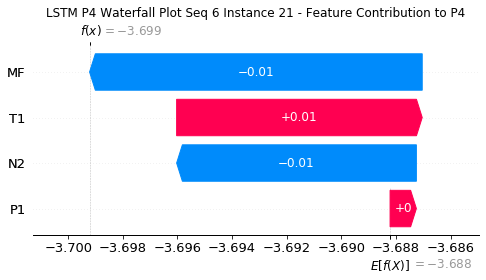

None

Contribution: [-0.00229452  0.00568782  0.00793362  0.00945692]


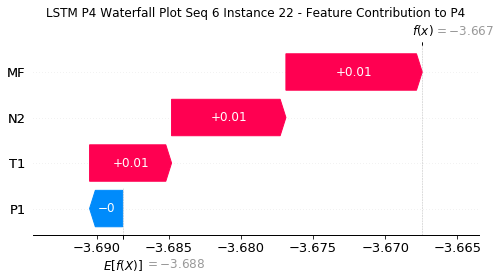

None

Contribution: [ 0.00599221 -0.01819392  0.00828187  0.01171074]


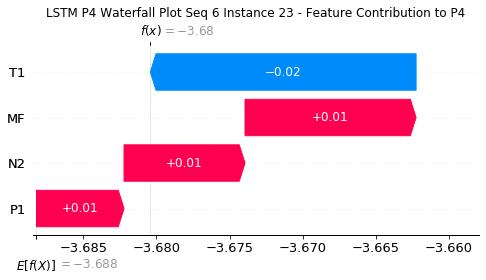

None

Contribution: [-0.00258175  0.02579559 -0.03154368 -0.04225405]


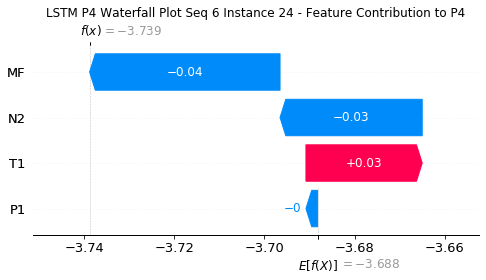

None

Contribution: [-0.00063302 -0.00273692 -0.00221677 -0.00190083]


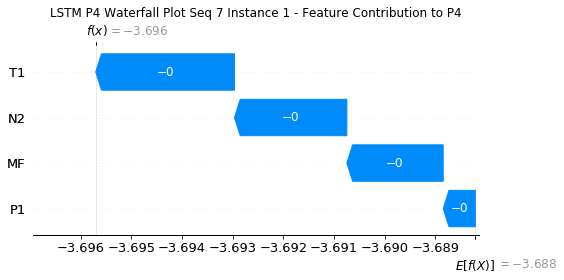

None

Contribution: [ 1.11591764e-04 -2.14146637e-04 -8.96363234e-05 -9.03654950e-05]


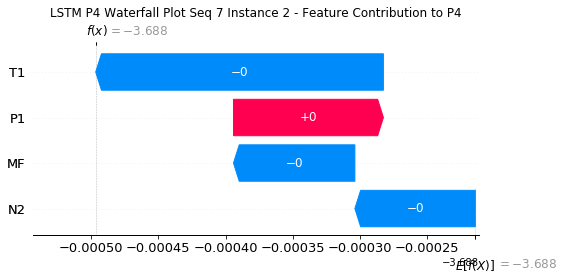

None

Contribution: [ 1.34535137e-04  3.48759827e-04 -7.96778876e-05 -4.88498285e-05]


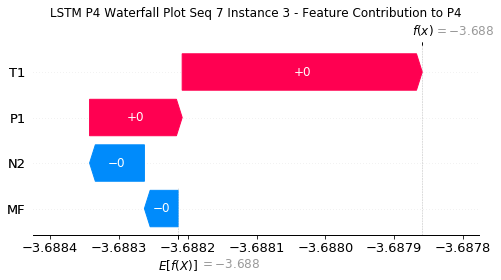

None

Contribution: [ 1.38756800e-04  3.97907968e-04 -9.92299967e-05 -1.68091642e-05]


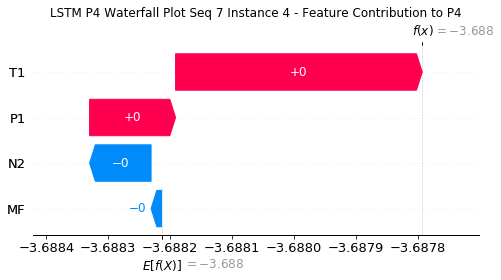

None

Contribution: [ 1.62597491e-04  3.35752503e-04 -1.33253026e-04  2.26343345e-05]


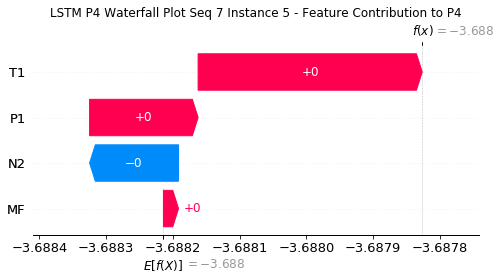

None

Contribution: [ 1.17640342e-04  2.63691879e-04 -1.77045287e-04 -8.48860021e-05]


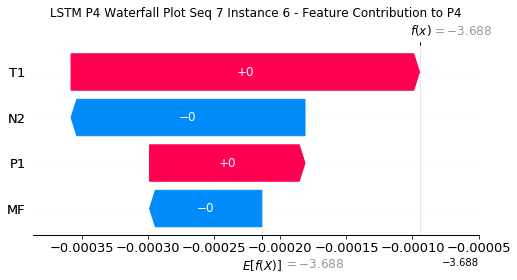

None

Contribution: [ 0.00016399  0.00020612 -0.00022524 -0.00011153]


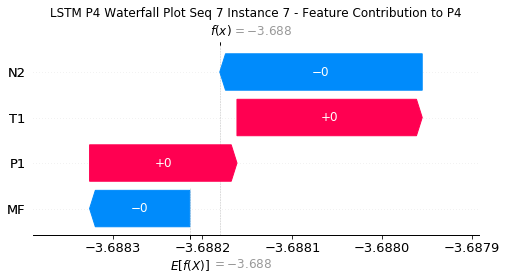

None

Contribution: [ 0.0001074   0.00011467 -0.00024788 -0.00014612]


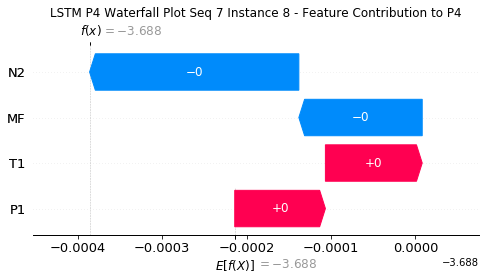

None

Contribution: [ 7.78854695e-05  9.87653400e-05 -2.88595446e-04 -1.96814643e-04]


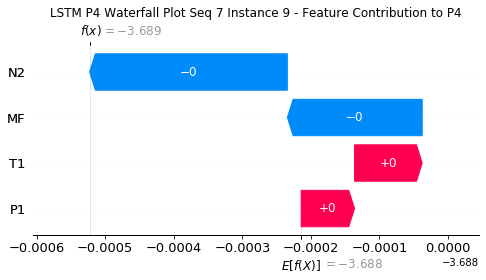

None

Contribution: [ 9.48632921e-05  1.02238885e-04 -2.83396993e-04 -1.14729783e-04]


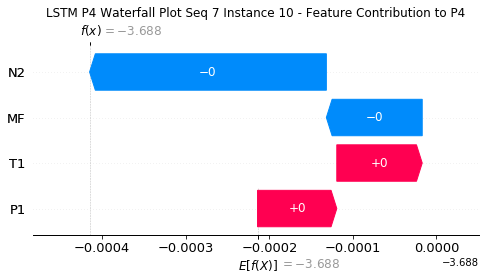

None

Contribution: [ 7.74922535e-06  1.08958827e-04 -3.60508465e-04 -2.94311776e-04]


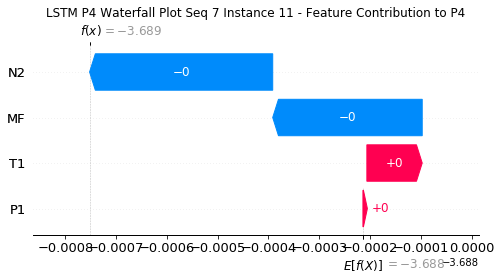

None

Contribution: [-2.13881414e-06  1.60887504e-04 -4.06764693e-04 -3.52792091e-04]


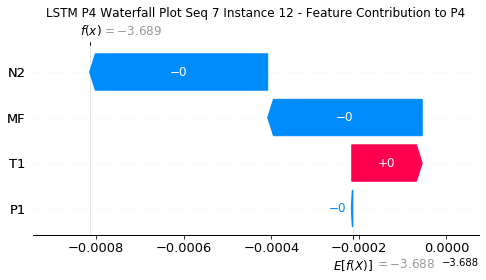

None

Contribution: [-1.22462457e-05  1.72248925e-04 -4.80143656e-04 -4.05219869e-04]


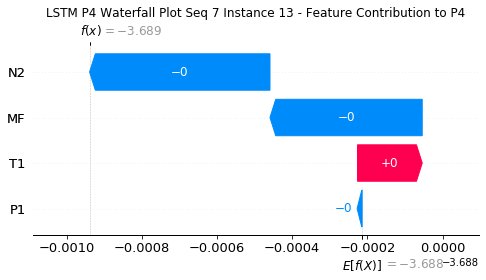

None

Contribution: [ 5.51947786e-05  5.67735745e-05 -5.27208415e-04 -3.46141627e-04]


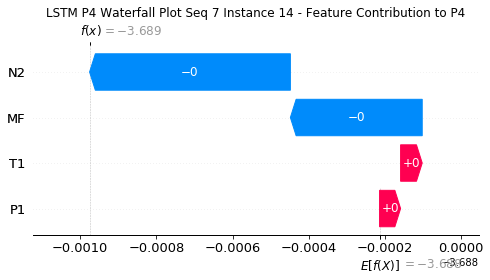

None

Contribution: [-1.88472174e-06  2.29234554e-04 -4.94200600e-04 -4.06975396e-04]


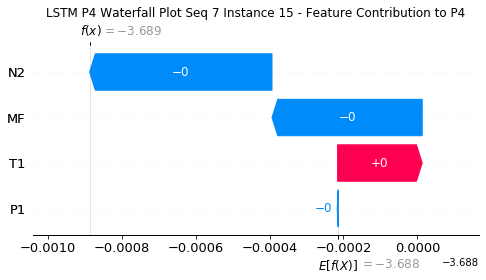

None

Contribution: [-5.61868800e-05  4.16311376e-04 -5.35851040e-04 -4.24029973e-04]


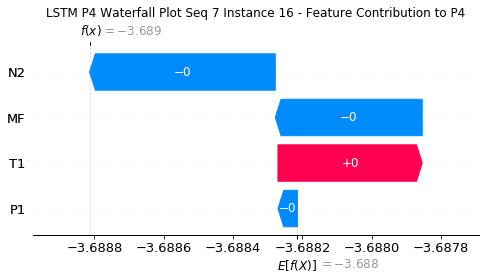

None

Contribution: [-2.97659135e-05 -5.51654549e-04 -1.40115647e-03 -1.32035937e-03]


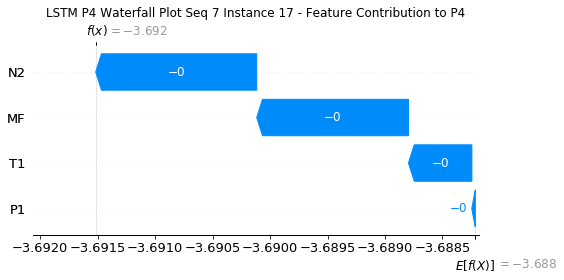

None

Contribution: [ 5.74635184e-05  1.19291504e-03 -1.07839302e-03 -1.04432313e-03]


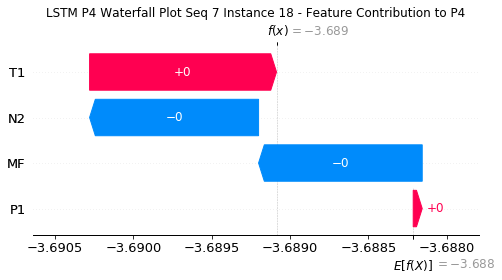

None

Contribution: [-0.00031623  0.00060827  0.00154343  0.00208442]


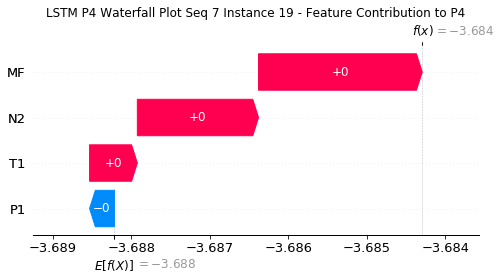

None

Contribution: [-0.0002188  -0.00702011 -0.0027789  -0.00263049]


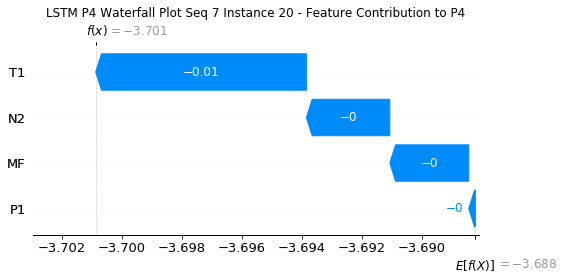

None

Contribution: [ 0.00109808  0.01219322 -0.0086011  -0.00984921]


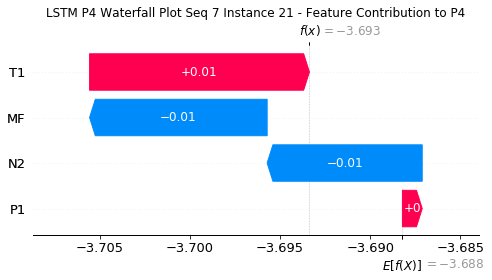

None

Contribution: [-0.00284001  0.00763628  0.00776884  0.00964845]


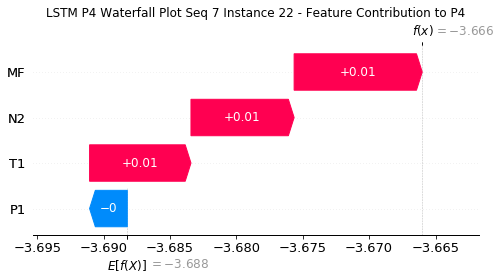

None

Contribution: [ 0.0055498  -0.025028    0.00744009  0.02012532]


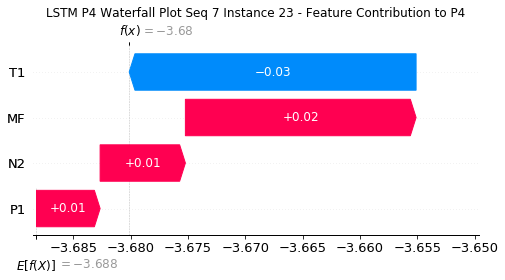

None

Contribution: [-0.00329863  0.03680351 -0.03143731 -0.04669776]


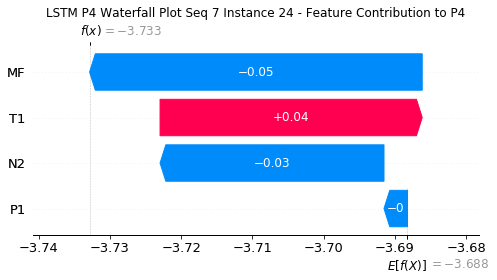

None

Contribution: [-0.00067919 -0.00382777 -0.00227525 -0.00169288]


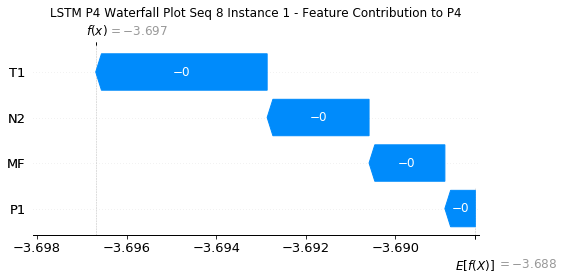

None

Contribution: [ 1.23922581e-04 -2.34438897e-04 -8.94650282e-05 -3.66646569e-05]


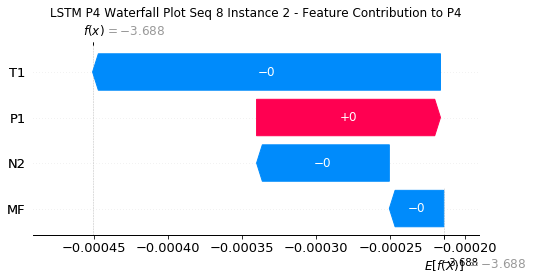

None

Contribution: [ 1.27306437e-04  4.73506765e-04 -8.68083921e-05 -4.54780274e-05]


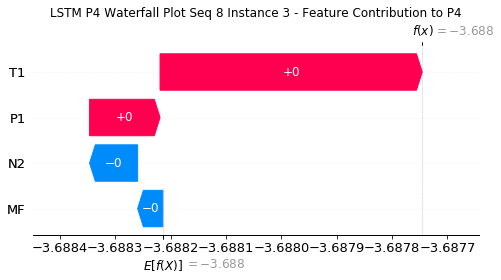

None

Contribution: [ 1.62586836e-04  5.33036823e-04 -1.17457714e-04 -3.64756589e-05]


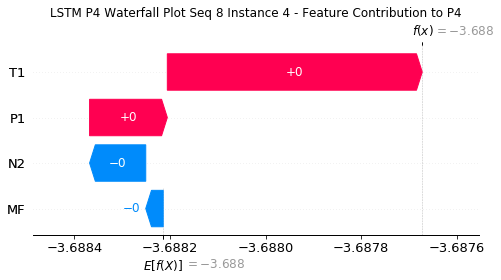

None

Contribution: [ 1.38774893e-04  4.05519726e-04 -1.39643303e-04  3.07434056e-05]


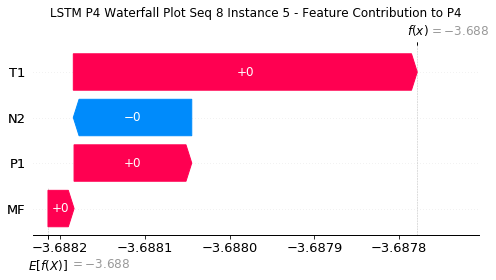

None

Contribution: [ 0.00015262  0.00033762 -0.00019168 -0.00011898]


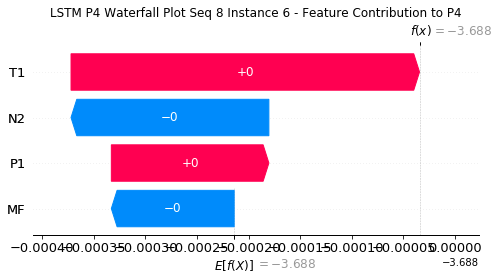

None

Contribution: [ 1.67674855e-04  2.09591247e-04 -1.97501386e-04 -3.49601617e-05]


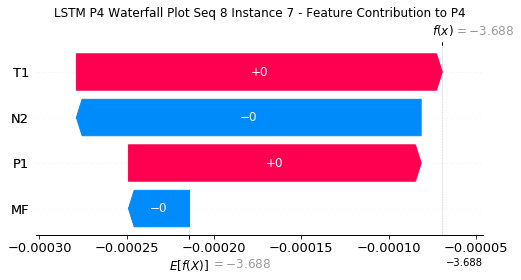

None

Contribution: [ 1.46520038e-04  1.65758715e-04 -2.33326472e-04 -9.47883276e-05]


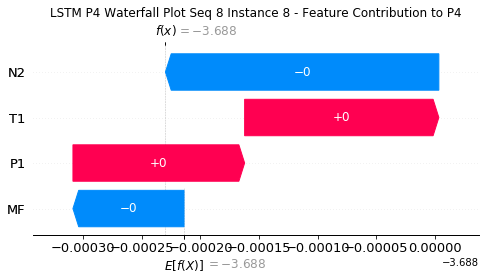

None

Contribution: [ 0.00010447  0.00011849 -0.00027269 -0.0001682 ]


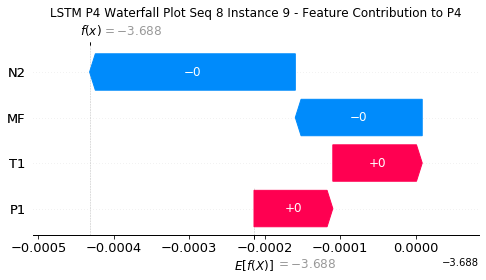

None

Contribution: [ 0.00010786  0.00012538 -0.00027884 -0.00010037]


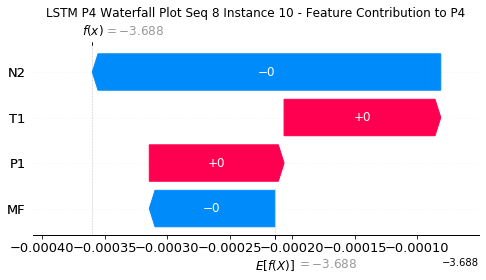

None

Contribution: [ 1.62592973e-05  1.28475133e-04 -3.54745540e-04 -2.81324889e-04]


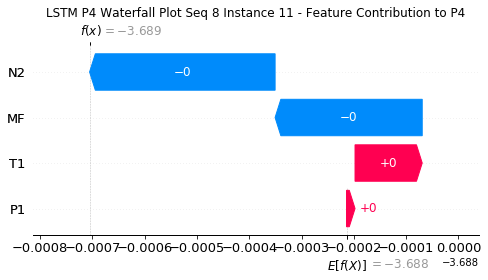

None

Contribution: [ 3.38001836e-05  1.58979445e-04 -4.01222324e-04 -3.50853630e-04]


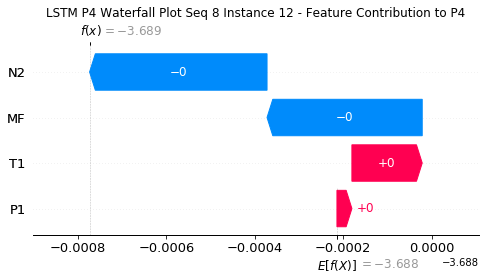

None

Contribution: [-1.92873290e-05  1.80939525e-04 -4.69843364e-04 -3.76264212e-04]


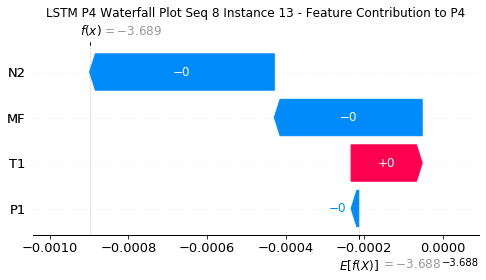

None

Contribution: [ 4.82664476e-05  6.53290899e-05 -5.15470672e-04 -3.07599900e-04]


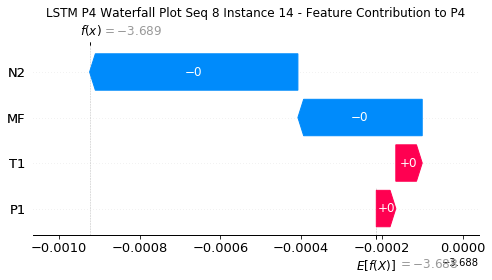

None

Contribution: [ 4.35606062e-06  2.30135213e-04 -4.82270700e-04 -3.85786584e-04]


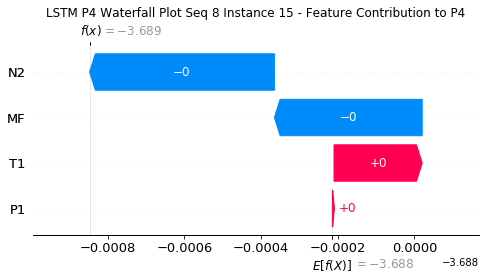

None

Contribution: [-3.16827688e-05  4.26037244e-04 -5.25189765e-04 -4.07797924e-04]


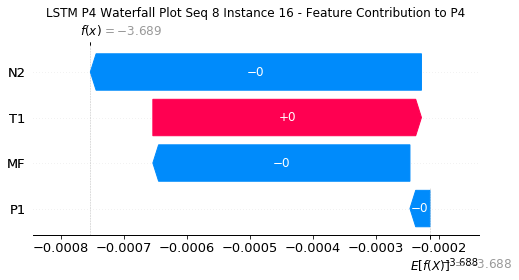

None

Contribution: [ 7.17685907e-06 -5.45704591e-04 -1.36825646e-03 -1.14097018e-03]


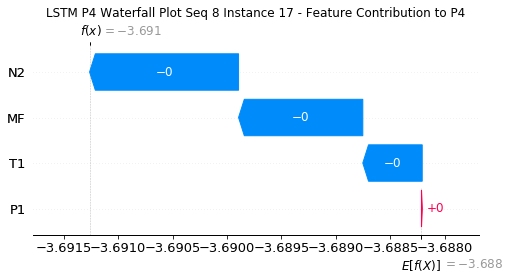

None

Contribution: [ 6.30088280e-05  1.19948540e-03 -1.05304470e-03 -9.99508752e-04]


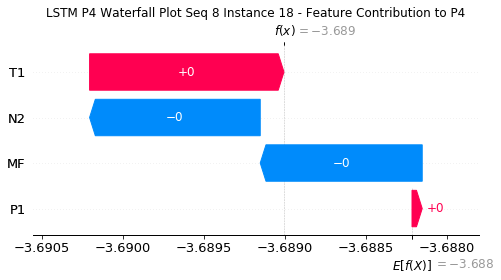

None

Contribution: [-0.00033543  0.00062711  0.00153627  0.00214905]


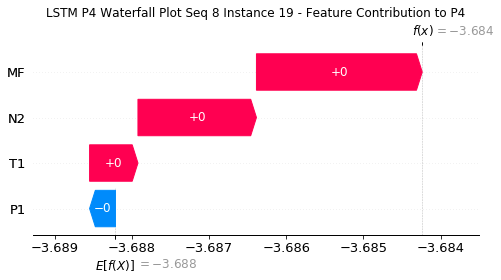

None

Contribution: [-0.00024143 -0.00675853 -0.00266481 -0.00239224]


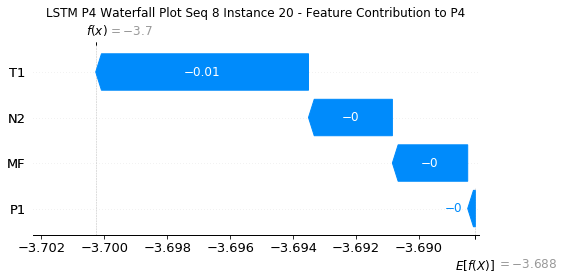

None

Contribution: [ 0.00116613  0.01176281 -0.0084882  -0.00880772]


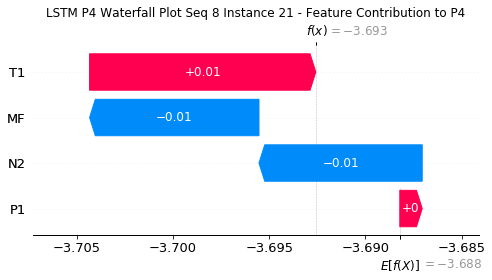

None

Contribution: [-0.00243567  0.00726012  0.00763073  0.00845374]


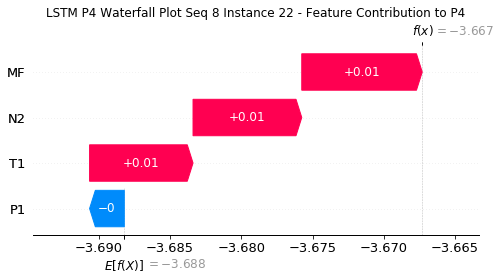

None

Contribution: [ 0.00894031 -0.02632416  0.00804837  0.02043493]


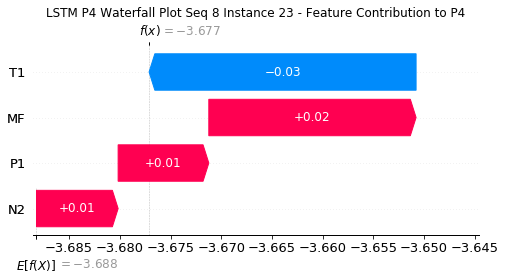

None

Contribution: [-0.00882637  0.03739959 -0.0211611   0.03476666]


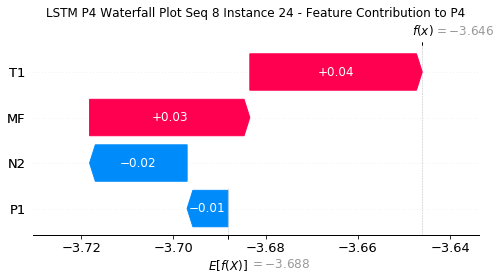

None

Contribution: [-0.00057428 -0.00346097 -0.00230986 -0.00238642]


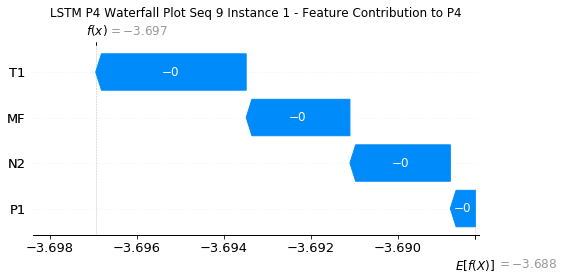

None

Contribution: [ 1.15384059e-04 -2.68696250e-04 -8.90718929e-05 -9.24057335e-05]


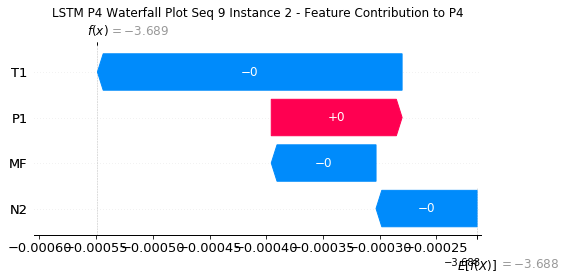

None

Contribution: [ 2.05415324e-04  3.89971282e-04 -6.95131649e-05 -1.81281509e-05]


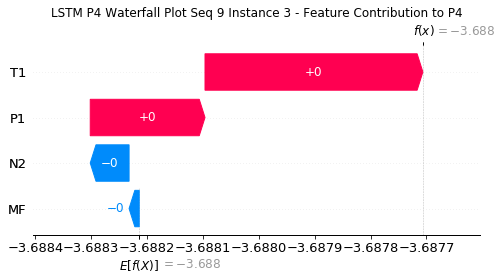

None

Contribution: [ 2.02473273e-04  4.19481911e-04 -7.61055199e-05  7.25632350e-05]


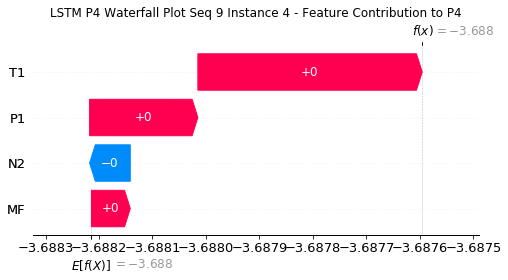

None

Contribution: [ 0.00037821  0.00042072 -0.00012266 -0.00017433]


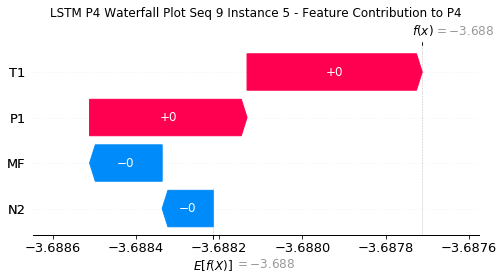

None

Contribution: [ 1.69505409e-04  2.48049545e-04 -1.47781664e-04  1.10672822e-05]


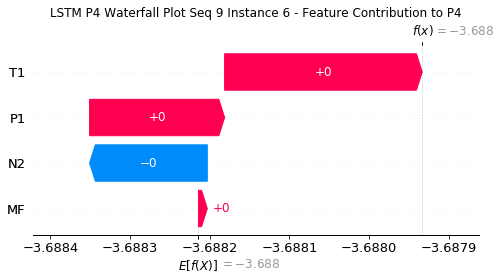

None

Contribution: [ 1.47280792e-04  1.08010254e-04 -1.80782825e-04 -2.57357187e-05]


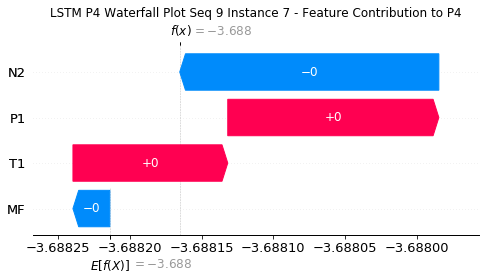

None

Contribution: [ 9.96357394e-05  4.33820644e-05 -2.10892074e-04 -3.80011159e-05]


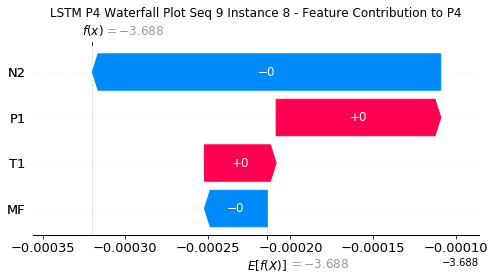

None

Contribution: [ 4.51116955e-05  6.15628925e-05 -2.60427734e-04 -1.07790856e-04]


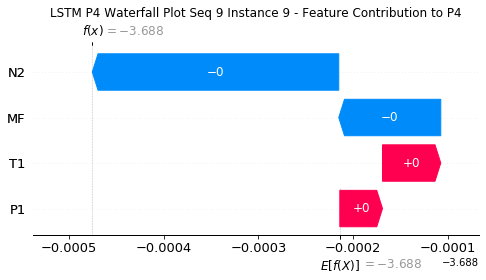

None

Contribution: [ 7.50545284e-05  6.48642529e-05 -2.73754443e-04 -6.41549599e-05]


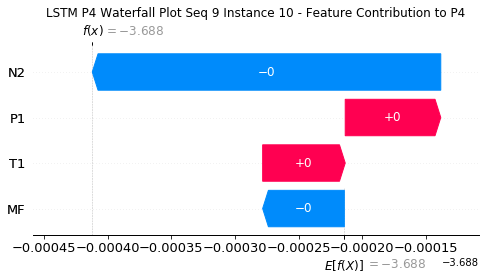

None

Contribution: [-8.90912920e-06  6.24122726e-05 -3.47524919e-04 -2.44005626e-04]


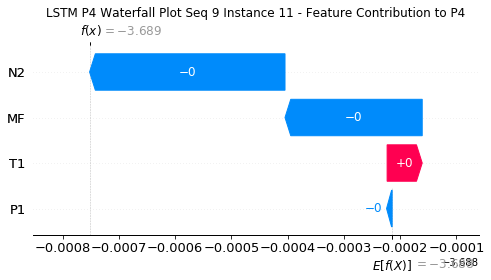

None

Contribution: [ 4.54842969e-06  8.02861023e-05 -4.05465678e-04 -3.32824330e-04]


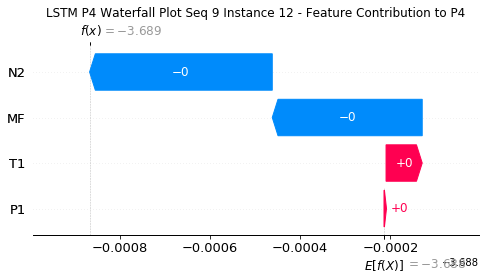

None

Contribution: [-3.60395149e-05  9.52428264e-05 -4.85050598e-04 -3.89979773e-04]


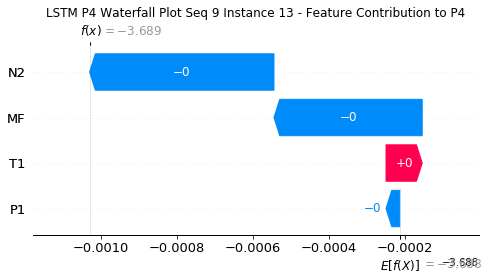

None

Contribution: [ 2.92364540e-05  3.81659099e-06 -5.10843116e-04 -3.05275431e-04]


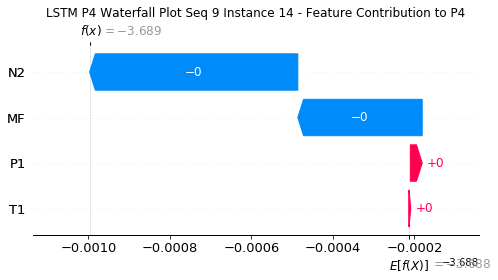

None

Contribution: [-4.82575986e-05  1.21478904e-04 -4.60297944e-04 -3.52732034e-04]


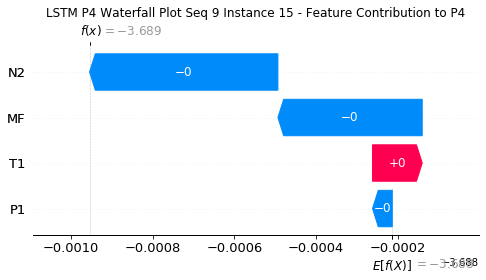

None

Contribution: [-8.00639496e-05  1.96671399e-04 -5.77671253e-04 -4.71409454e-04]


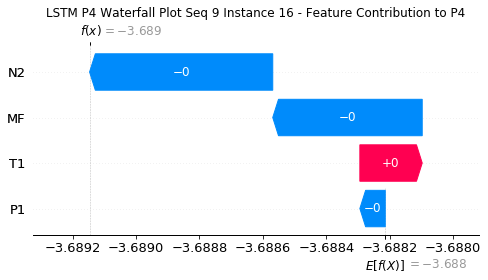

None

Contribution: [-1.58757347e-05 -4.17729522e-04 -1.41994285e-03 -1.23187817e-03]


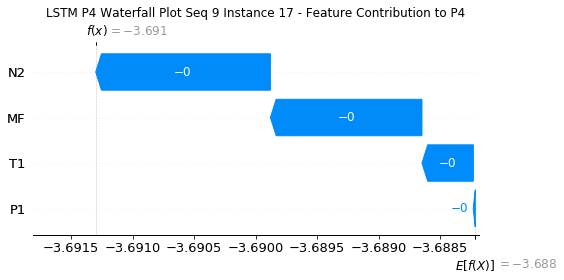

None

Contribution: [-3.70249455e-05  7.33980835e-04 -9.84237602e-04 -9.35077540e-04]


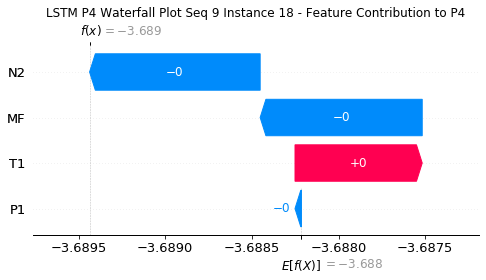

None

Contribution: [-0.00022655  0.00018648  0.00163142  0.00217508]


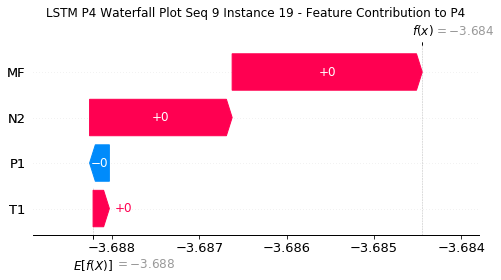

None

Contribution: [-0.00024265 -0.00485796 -0.00282054 -0.00280898]


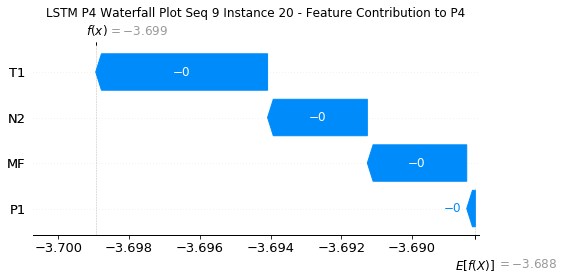

None

Contribution: [ 0.0008534   0.00772475 -0.009078   -0.01126543]


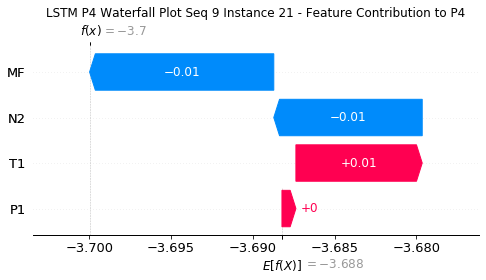

None

Contribution: [-0.00201454  0.00510708  0.00802551  0.01015484]


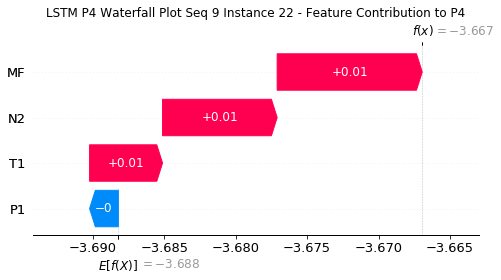

None

Contribution: [ 0.00730169 -0.01366605  0.00640764  0.00869068]


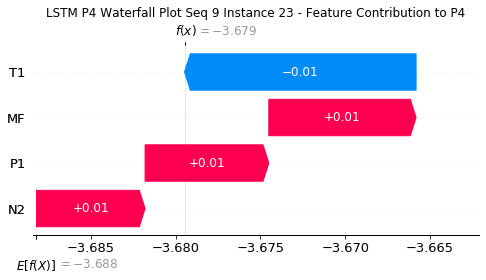

None

Contribution: [-0.00232252  0.01955873 -0.03095391 -0.05283858]


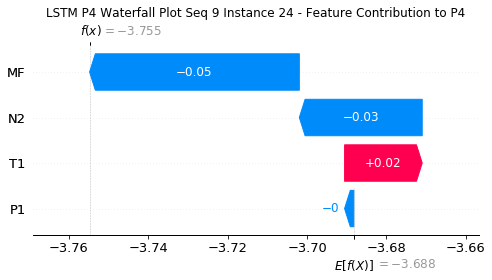

None

Contribution: [-0.00068001 -0.0023804  -0.0022786  -0.00197468]


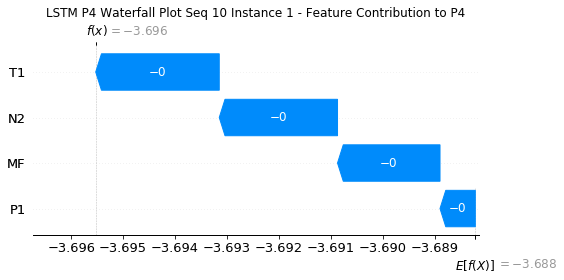

None

Contribution: [ 1.19599922e-04 -1.93408993e-04 -9.06133434e-05 -6.88699542e-05]


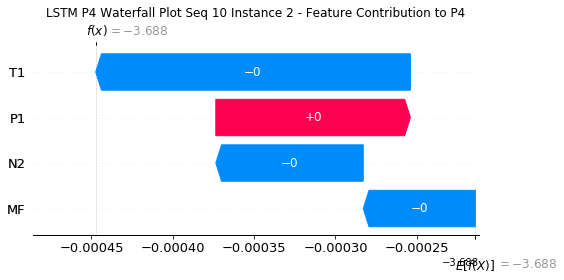

None

Contribution: [ 1.07052482e-04  2.72880217e-04 -8.11073523e-05 -3.83307964e-05]


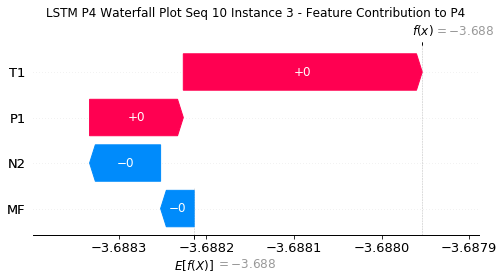

None

Contribution: [ 9.52601194e-05  3.04138775e-04 -9.78041898e-05  2.63474379e-05]


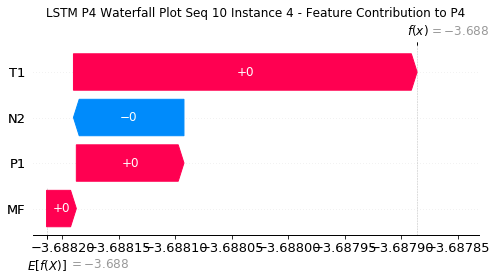

None

Contribution: [ 0.00010581  0.00023947 -0.00012402  0.00016417]


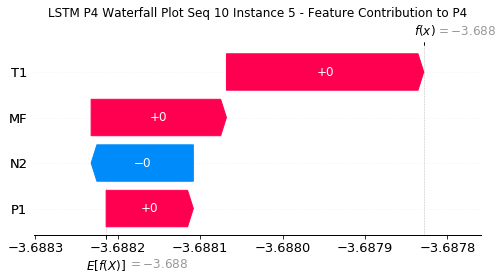

None

Contribution: [ 6.99659996e-05  1.95398847e-04 -1.71549177e-04 -3.00800896e-05]


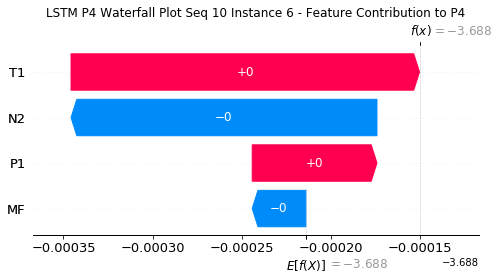

None

Contribution: [ 0.00017173  0.00012981 -0.00020351 -0.00015996]


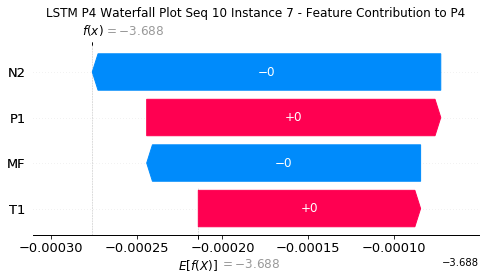

None

Contribution: [ 2.62579013e-05  7.18634197e-05 -2.14031927e-04  4.21680760e-06]


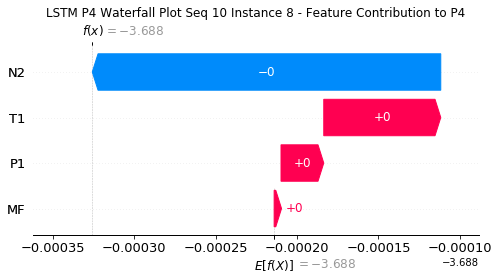

None

Contribution: [ 5.00397239e-05  6.21402776e-05 -2.71254901e-04 -1.39616522e-04]


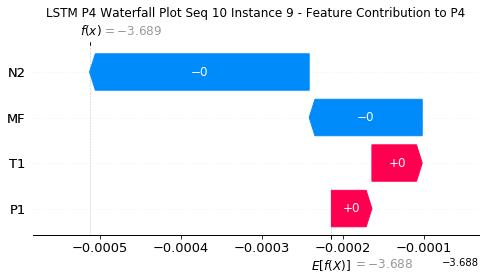

None

Contribution: [ 5.73166227e-05  5.33438436e-05 -2.78713213e-04 -6.40886737e-05]


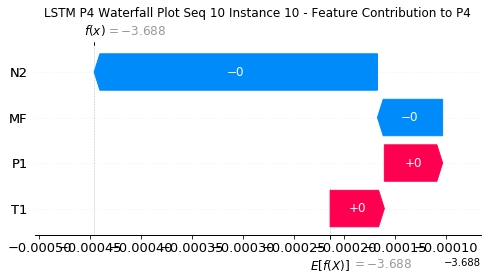

None

Contribution: [-2.47059178e-05  5.74345613e-05 -3.54728455e-04 -2.55241067e-04]


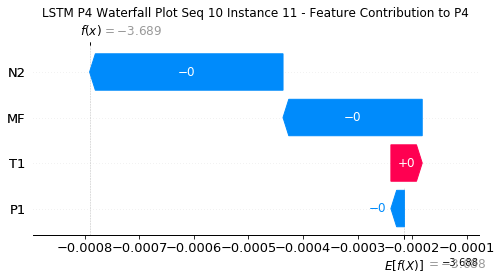

None

Contribution: [-1.58246850e-05  9.80982523e-05 -4.09492616e-04 -3.36725707e-04]


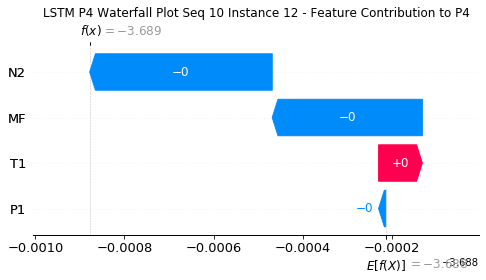

None

Contribution: [-5.20771764e-05  9.29954791e-05 -4.83164449e-04 -3.73794663e-04]


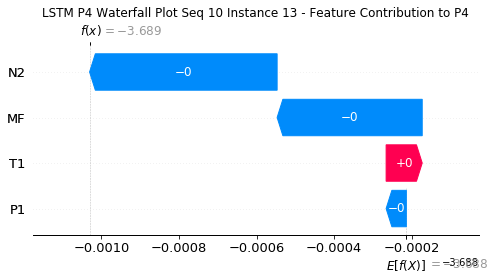

None

Contribution: [ 3.08596401e-05 -1.78976475e-05 -5.18304893e-04 -2.52026396e-04]


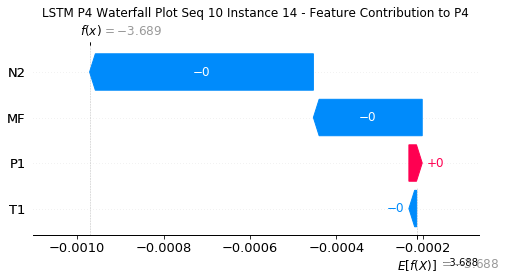

None

Contribution: [-5.56930190e-05  1.38941275e-04 -4.75944775e-04 -3.58728227e-04]


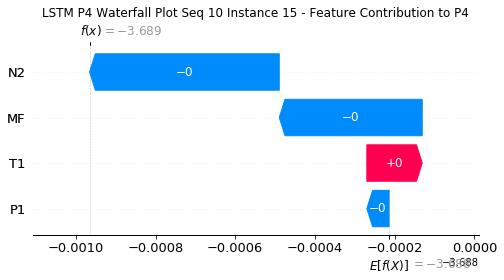

None

Contribution: [-7.97664027e-05  2.46327448e-04 -5.59439191e-04 -4.54178776e-04]


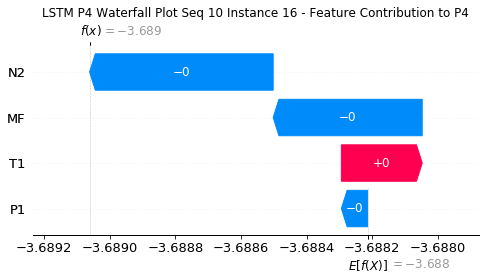

None

Contribution: [-5.36961151e-05 -4.59841174e-04 -1.39587750e-03 -1.10647016e-03]


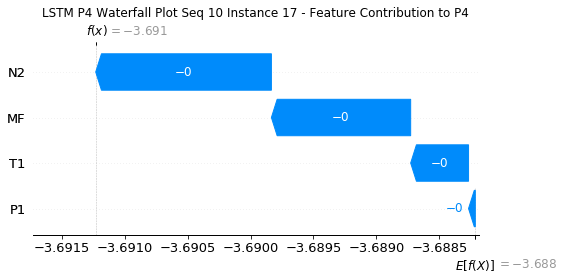

None

Contribution: [-8.71721838e-05  8.43803278e-04 -1.03726473e-03 -1.10127348e-03]


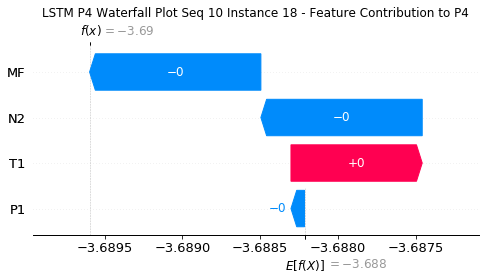

None

Contribution: [-0.00020159  0.00032173  0.00158319  0.00204369]


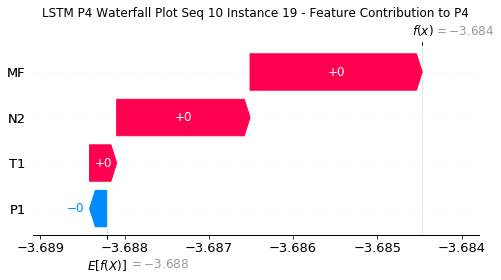

None

Contribution: [-0.00028328 -0.00547241 -0.00262057 -0.00115366]


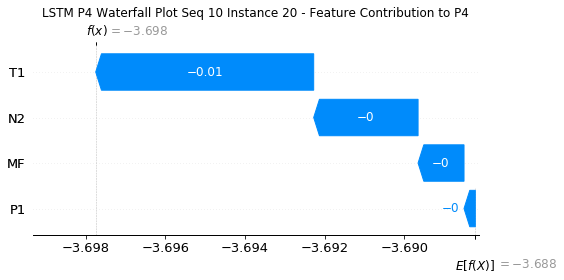

None

Contribution: [ 0.00082737  0.00930199 -0.00923743 -0.0140248 ]


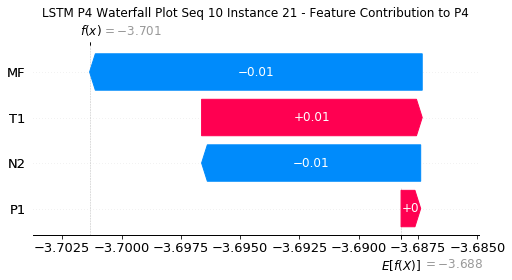

None

Contribution: [-0.00137274  0.00599753  0.00787104  0.00896179]


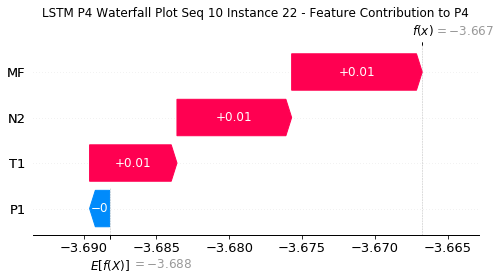

None

Contribution: [ 0.00135235 -0.01756398  0.00881491  0.01209203]


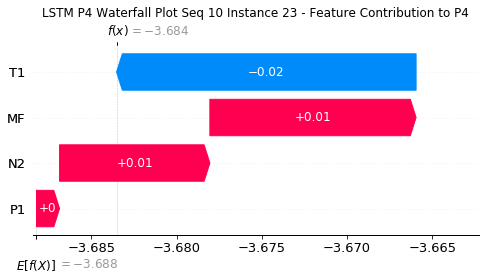

None

Contribution: [ 0.00019811  0.0237561  -0.03285207 -0.05258808]


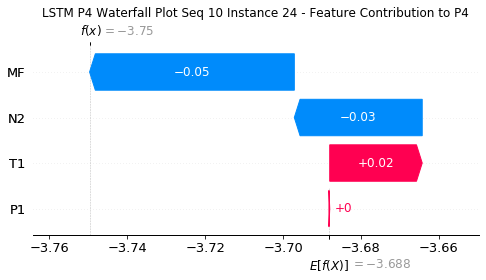

None

Contribution: [-0.00037228 -0.00260768 -0.00210705 -0.00142615]


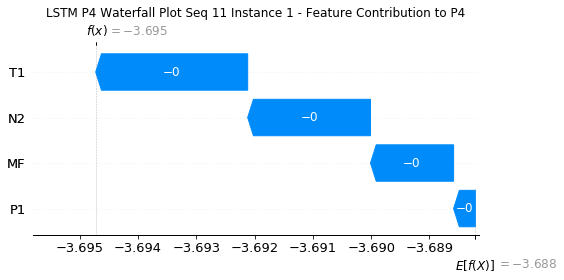

None

Contribution: [ 7.34449828e-05 -1.81167143e-04 -8.27077801e-05 -3.76733076e-06]


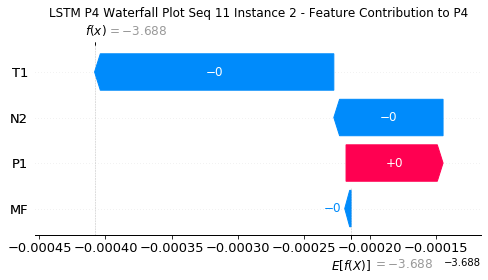

None

Contribution: [-7.75893183e-06  3.08413187e-04 -7.54532526e-05  7.18118620e-05]


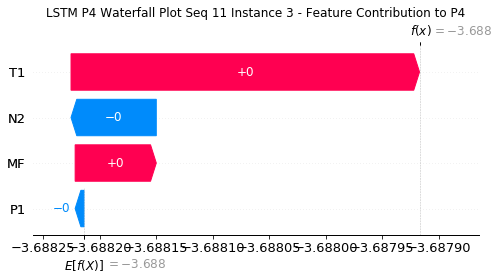

None

Contribution: [-4.84859804e-05  3.94318829e-04 -8.51176832e-05  2.26803893e-04]


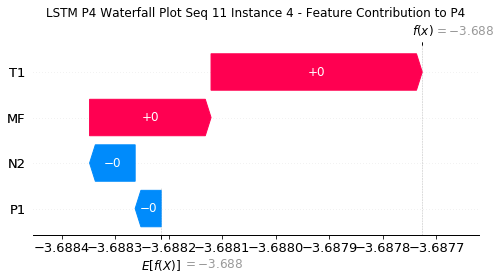

None

Contribution: [-0.00012972  0.00022093 -0.00011013  0.00026227]


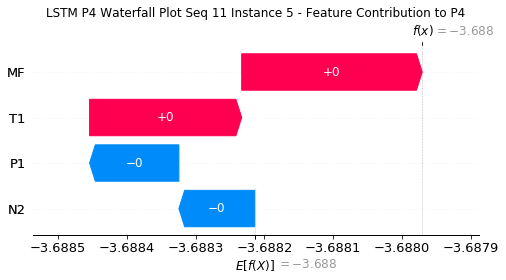

None

Contribution: [-9.56095236e-05  2.37067497e-04 -1.57722054e-04  1.70644417e-04]


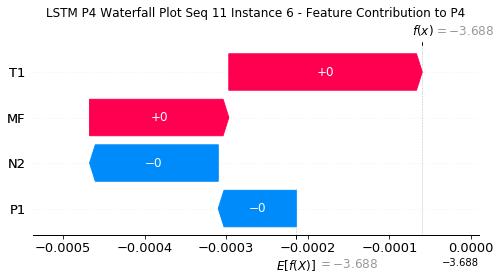

None

Contribution: [-3.79238866e-05  1.00280151e-04 -1.69226313e-04  1.07971963e-04]


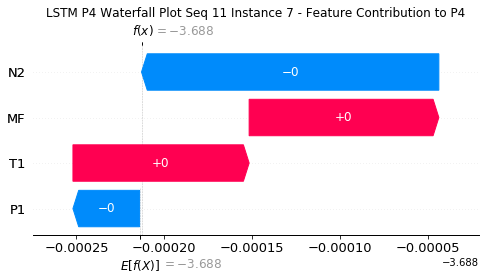

None

Contribution: [-3.88770405e-05  6.79071623e-05 -2.06996873e-04  4.50089137e-05]


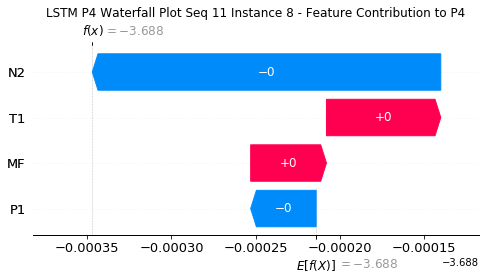

None

Contribution: [-4.80034346e-05  3.81331226e-05 -2.57638565e-04 -5.76586467e-05]


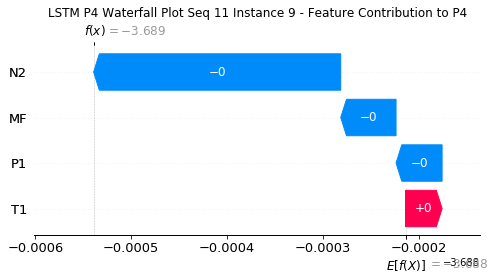

None

Contribution: [ 7.82176598e-06  1.52186185e-04 -2.77086570e-04 -1.64529598e-05]


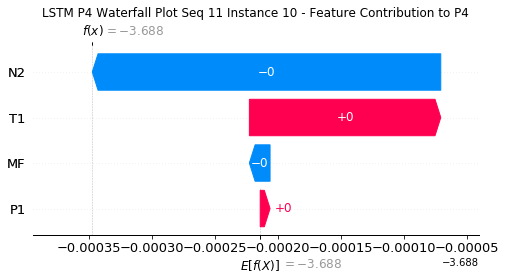

None

Contribution: [-7.63611744e-05  1.49557952e-04 -3.55776512e-04 -2.06986112e-04]


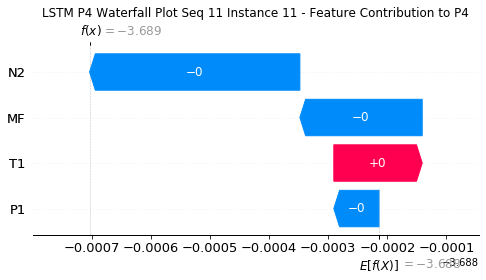

None

Contribution: [-4.81586266e-05  2.60511114e-04 -4.05622416e-04 -2.55978913e-04]


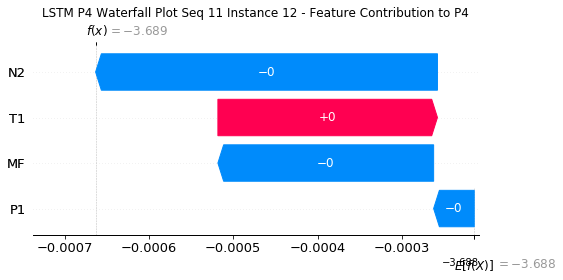

None

Contribution: [-9.28328530e-05  2.25567143e-04 -4.78118883e-04 -3.49707611e-04]


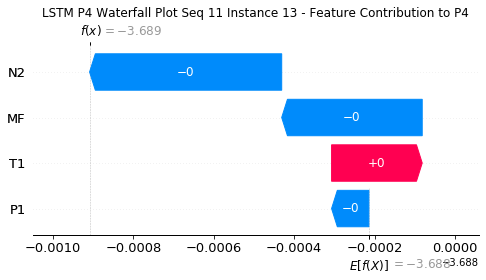

None

Contribution: [-6.35297396e-06  1.58573678e-04 -5.10577927e-04 -2.08388820e-04]


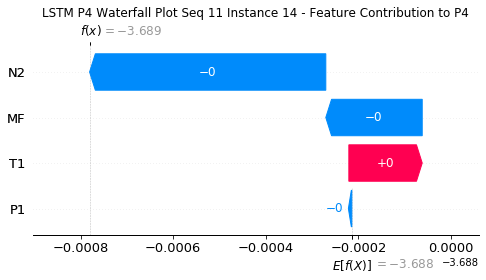

None

Contribution: [-9.80086625e-05  2.91128360e-04 -4.88762528e-04 -3.63992053e-04]


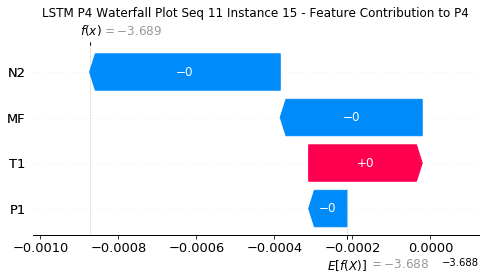

None

Contribution: [-0.00010731  0.00043304 -0.00055253 -0.00044963]


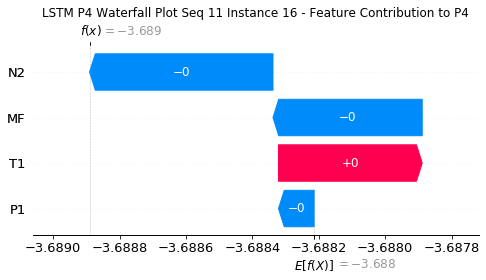

None

Contribution: [-0.00012313 -0.00047423 -0.00134935 -0.00070636]


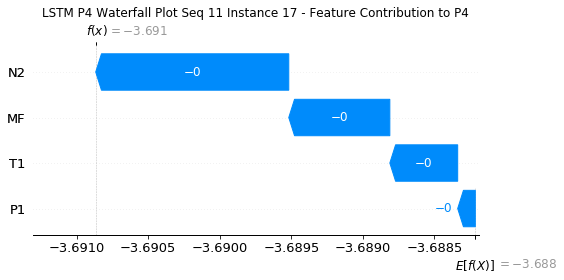

None

Contribution: [-0.00021755  0.00102214 -0.00103398 -0.00113058]


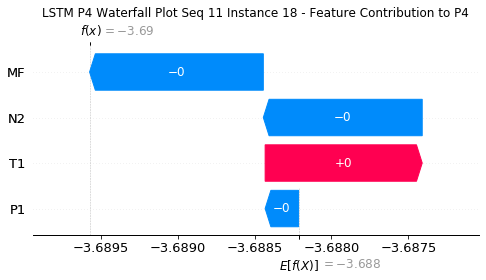

None

Contribution: [-0.00011567  0.00035461  0.00158618  0.00203926]


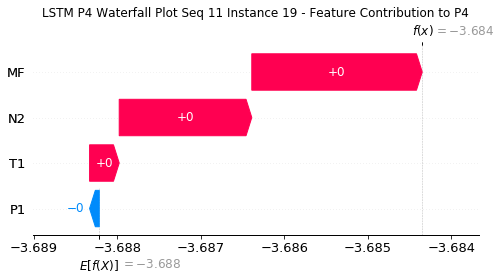

None

Contribution: [-0.00034954 -0.00575206 -0.00268476 -0.00145235]


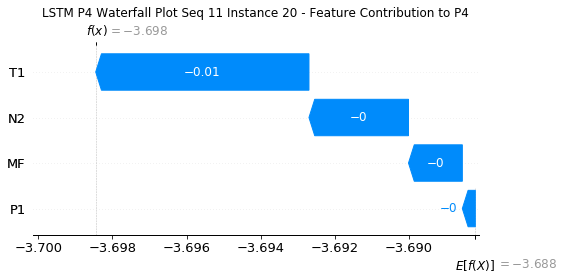

None

Contribution: [ 0.00072464  0.01098643 -0.00891875 -0.01237396]


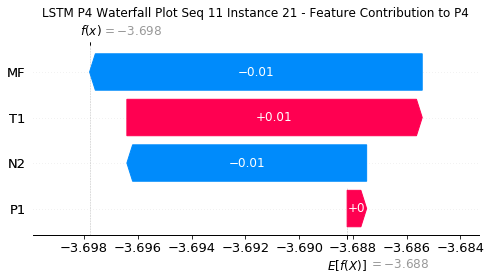

None

Contribution: [-0.00064108  0.00633226  0.00787039  0.009289  ]


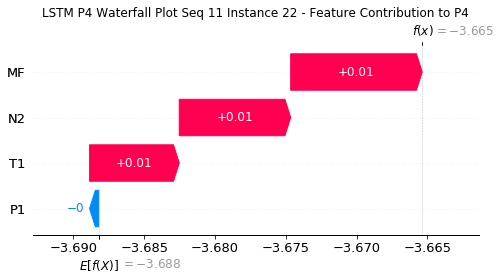

None

Contribution: [-0.00800717 -0.01212772  0.01094306  0.0380941 ]


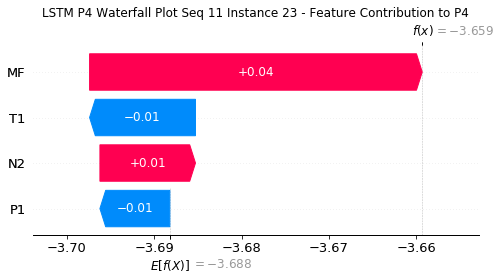

None

Contribution: [ 0.0045768   0.01599374 -0.03496121 -0.06943245]


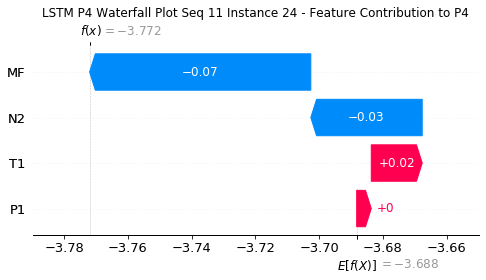

None

Contribution: [-0.00019173 -0.0021338  -0.00198454 -0.00121918]


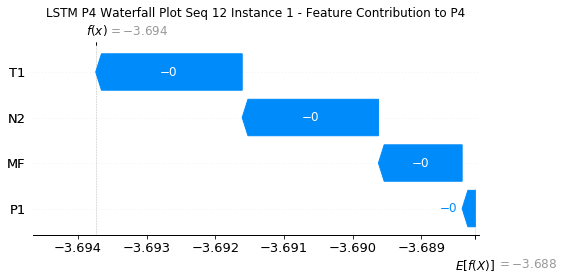

None

Contribution: [ 6.80741748e-05 -1.63325239e-04 -7.93992788e-05 -3.25869966e-05]


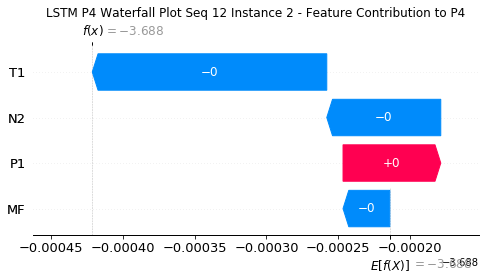

None

Contribution: [-2.85858566e-05  1.84909045e-04 -6.82498033e-05  1.89379100e-05]


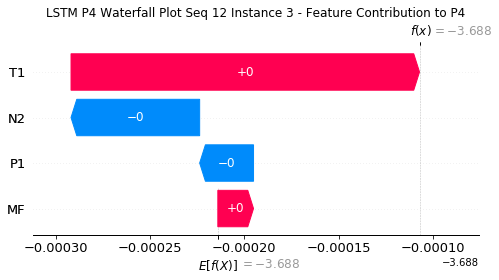

None

Contribution: [-8.70965183e-05  2.02624680e-04 -7.33175647e-05  1.31860726e-04]


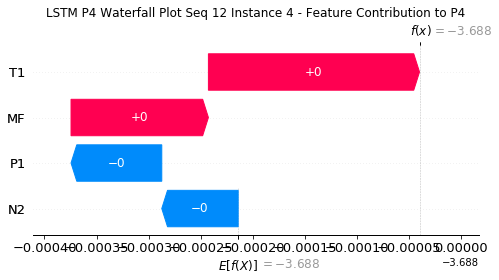

None

Contribution: [-2.64282065e-05  1.61912499e-04 -1.05166822e-04  1.16731063e-04]


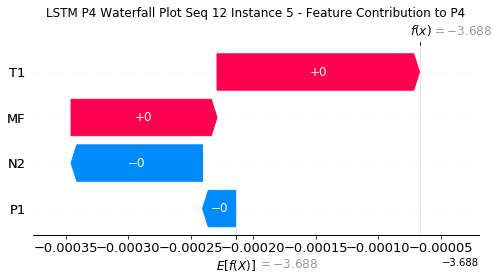

None

Contribution: [-0.00013973  0.00010172 -0.00014881  0.00010212]


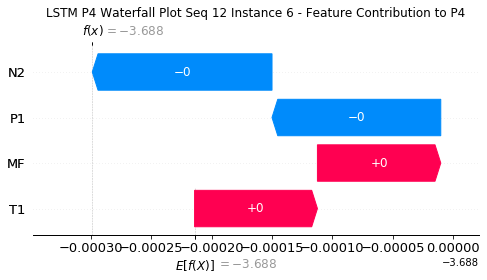

None

Contribution: [-1.30520735e-04  4.58198388e-05 -1.58433438e-04  2.09237576e-04]


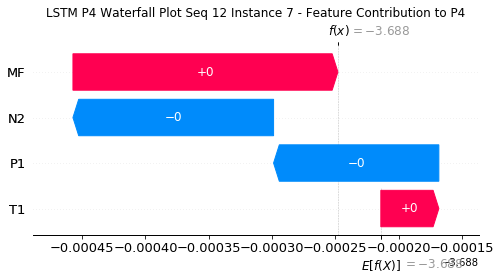

None

Contribution: [-7.86170270e-05  3.19315475e-05 -2.14602557e-04 -1.20982515e-05]


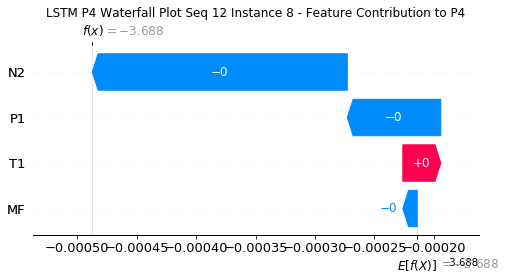

None

Contribution: [-7.99434711e-05  9.99414204e-06 -2.58442734e-04 -5.30928530e-05]


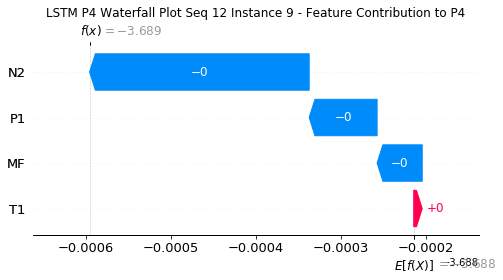

None

Contribution: [-3.86016629e-05 -1.32900411e-05 -2.77302344e-04 -1.95537324e-05]


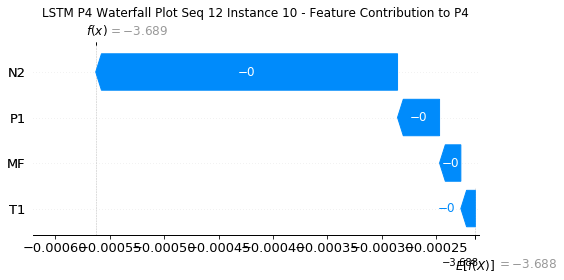

None

Contribution: [-1.25757032e-04 -1.13631494e-05 -3.46924517e-04 -1.83361344e-04]


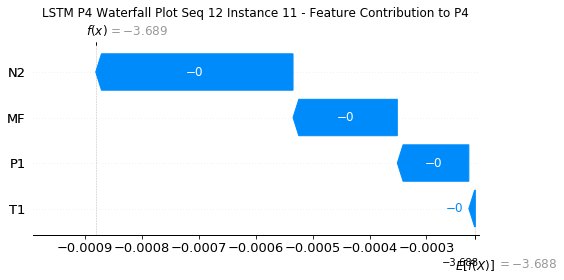

None

Contribution: [-7.53571056e-05  6.31687887e-06 -4.16431992e-04 -3.07963797e-04]


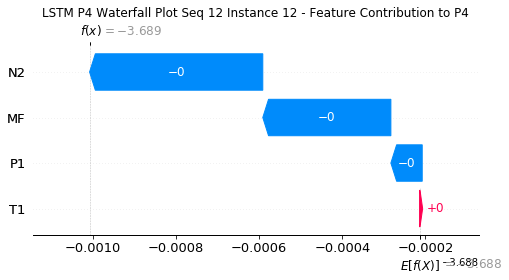

None

Contribution: [-1.40997933e-04 -1.29049018e-05 -4.87923628e-04 -3.29186394e-04]


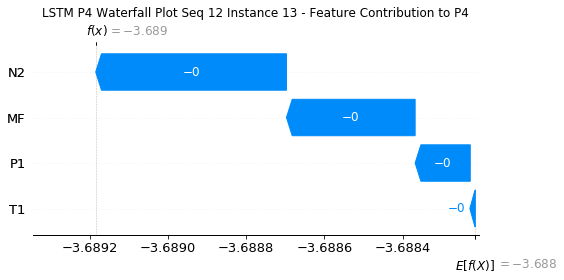

None

Contribution: [-9.42872695e-05 -8.80761356e-05 -5.01329231e-04 -8.05733177e-05]


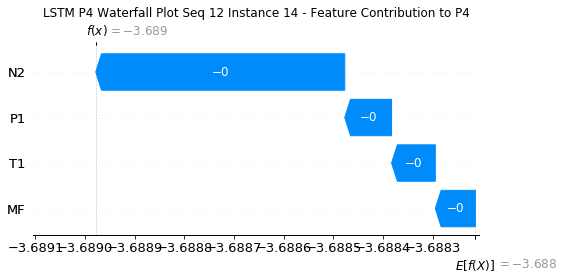

None

Contribution: [-1.64086857e-04  2.14884947e-05 -4.48921813e-04 -2.88359230e-04]


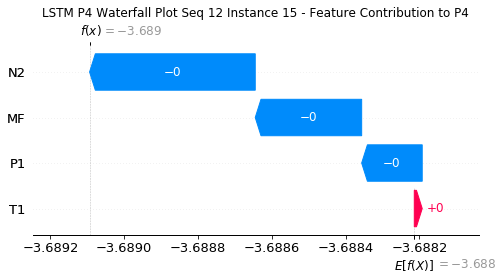

None

Contribution: [-1.32485053e-04  5.15168250e-05 -5.86359914e-04 -4.66772293e-04]


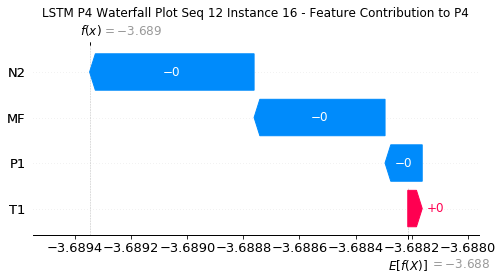

None

Contribution: [-0.00012067 -0.00037172 -0.00146717 -0.00106374]


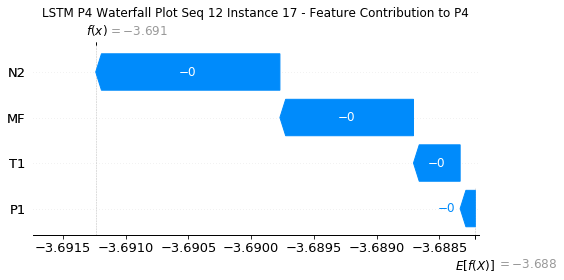

None

Contribution: [-0.00032969  0.00031192 -0.00092249 -0.00135356]


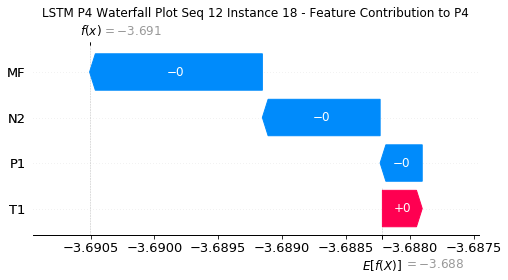

None

Contribution: [-5.24838045e-05  1.42032062e-05  1.68007368e-03  2.12638510e-03]


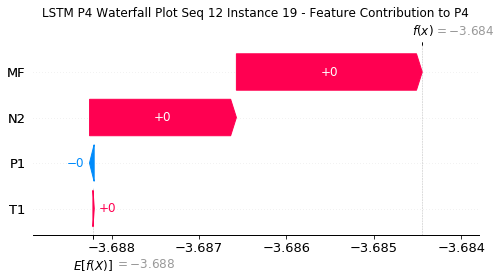

None

Contribution: [-0.00034824 -0.00296996 -0.00296457  0.00044257]


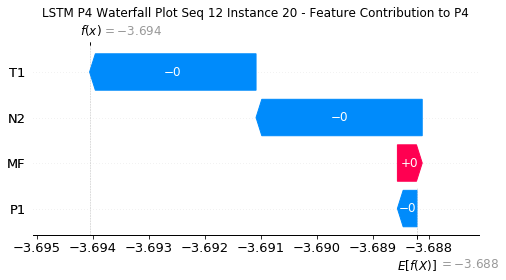

None

Contribution: [ 0.00064384  0.00442477 -0.00857674 -0.0164486 ]


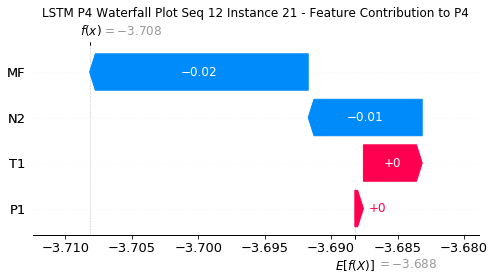

None

Contribution: [-8.92482099e-05  3.06566893e-03  8.20795274e-03  8.89904949e-03]


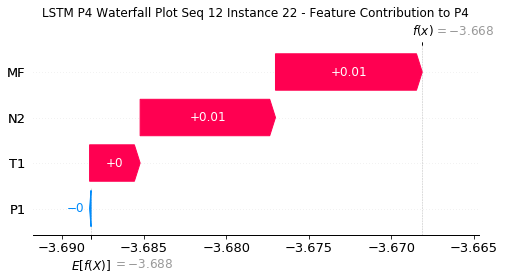

None

Contribution: [-0.00659129 -0.00866216  0.00781165  0.03178387]


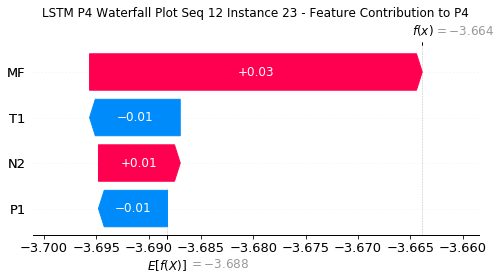

None

Contribution: [ 0.00405897  0.01011414 -0.03296877 -0.05932716]


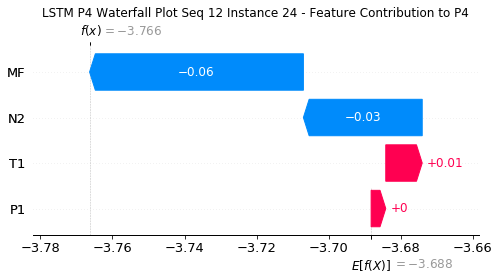

None

Contribution: [-0.00016655 -0.00140218 -0.00204082 -0.00113356]


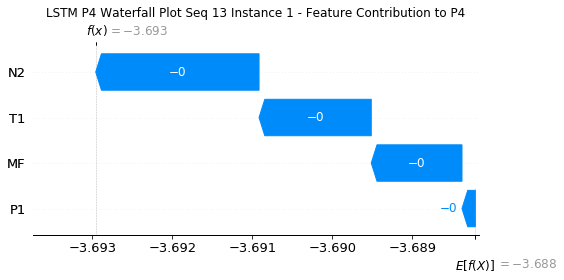

None

Contribution: [ 5.87846327e-05 -1.49726266e-04 -8.13719220e-05  1.13184396e-05]


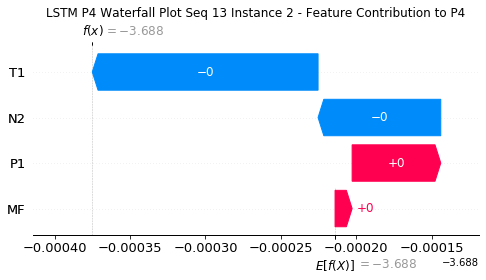

None

Contribution: [-9.89137340e-06  1.72446515e-04 -7.35285760e-05  6.17759511e-05]


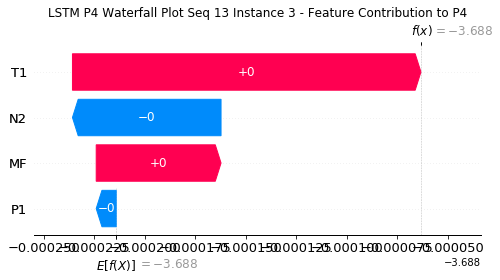

None

Contribution: [-7.00326924e-05  2.04819921e-04 -7.97545897e-05  2.37107609e-04]


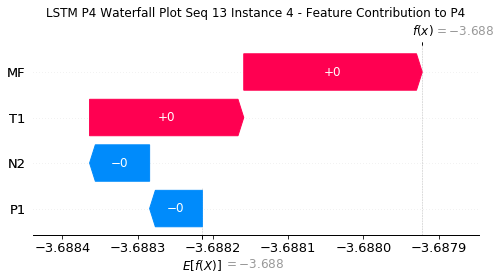

None

Contribution: [-0.0001768   0.00016398 -0.00010351  0.00032875]


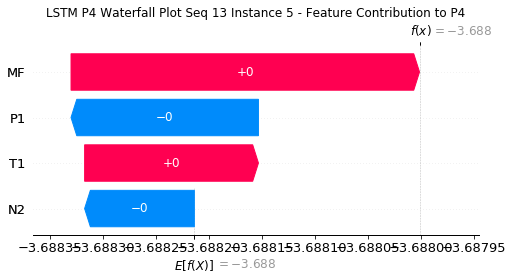

None

Contribution: [-0.00010824  0.00012412 -0.00015709  0.00017285]


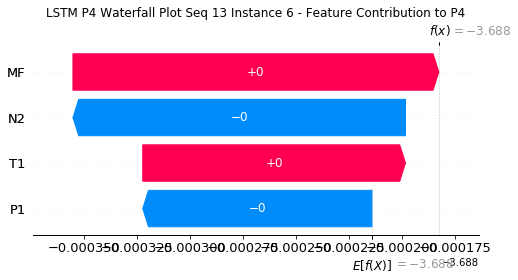

None

Contribution: [ 3.81348238e-05  9.12200983e-05 -2.02964223e-04 -4.05406432e-05]


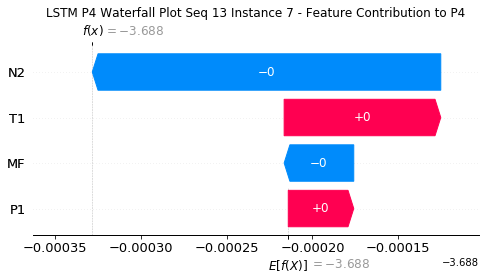

None

Contribution: [-2.32353704e-06  6.51042755e-05 -2.28778863e-04 -1.50093095e-05]


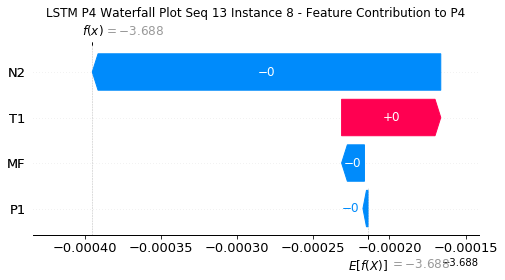

None

Contribution: [-3.75116265e-05  3.51310161e-05 -2.74949580e-04 -9.48270958e-05]


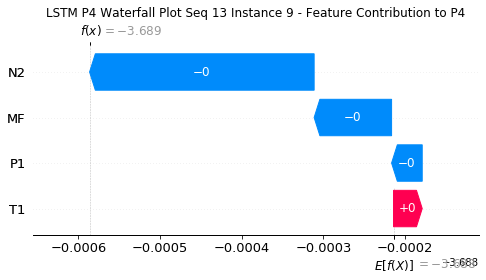

None

Contribution: [-4.10410418e-05  1.67874874e-05 -2.74226183e-04  2.75983643e-05]


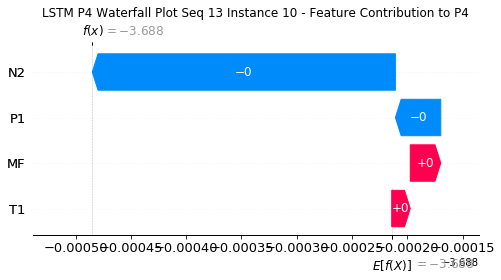

None

Contribution: [-1.14384189e-04  1.57620109e-05 -3.49367993e-04 -1.59374837e-04]


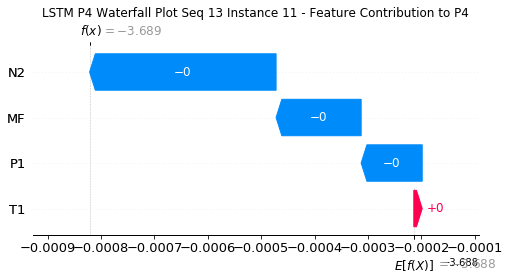

None

Contribution: [-1.20966675e-04  3.69648569e-05 -4.03337138e-04 -2.03880714e-04]


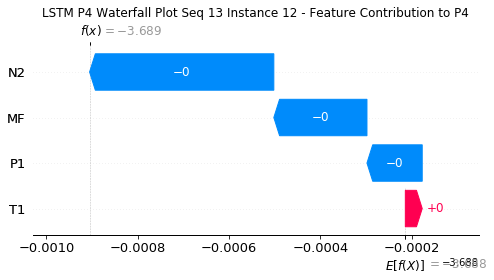

None

Contribution: [-1.36158509e-04  3.78663487e-05 -4.85395451e-04 -3.17327165e-04]


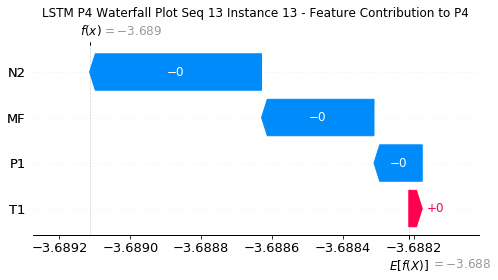

None

Contribution: [-3.15373866e-05 -3.59293551e-05 -5.10095436e-04 -2.30558273e-04]


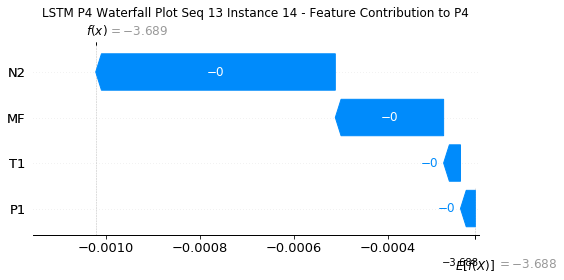

None

Contribution: [-1.43796182e-04  8.16197957e-05 -4.55386078e-04 -3.03959630e-04]


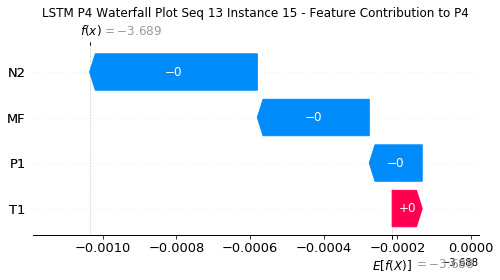

None

Contribution: [-0.00012268  0.00013445 -0.00057755 -0.00046358]


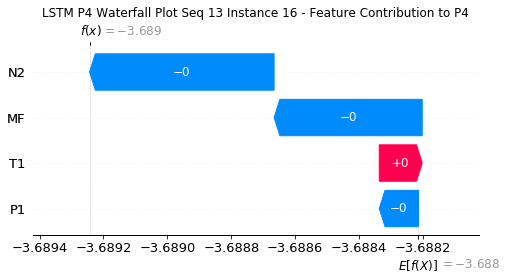

None

Contribution: [-0.00012302 -0.00036837 -0.00139899 -0.00086643]


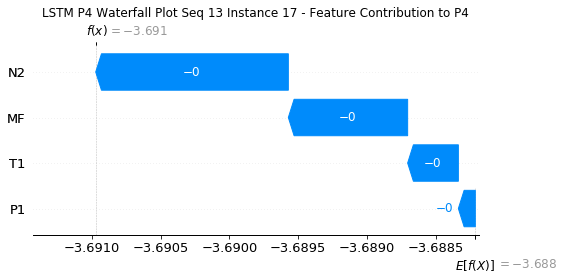

None

Contribution: [-0.00023342  0.00049926 -0.00097293 -0.0011793 ]


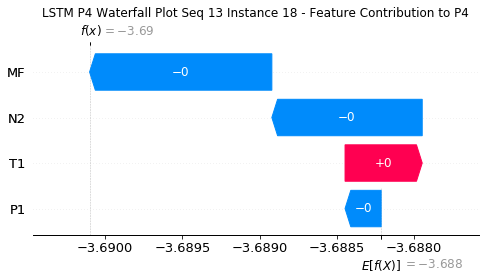

None

Contribution: [-1.01298830e-04  9.33326692e-05  1.66240850e-03  2.12606536e-03]


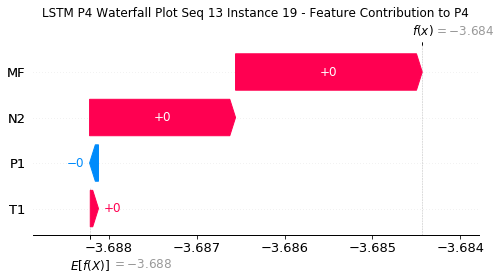

None

Contribution: [-0.00032465 -0.00360811 -0.00265974 -0.00039604]


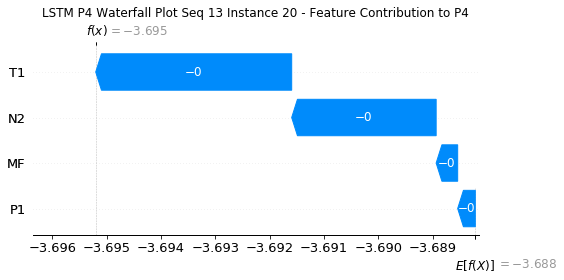

None

Contribution: [ 0.00066694  0.00598326 -0.00927033 -0.01606227]


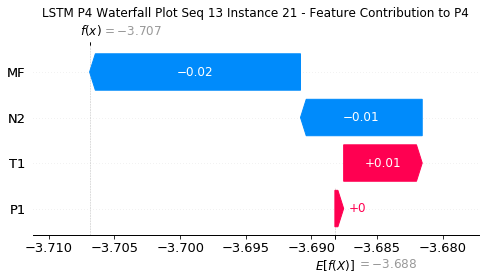

None

Contribution: [-0.00037769  0.00359707  0.00805877  0.00893424]


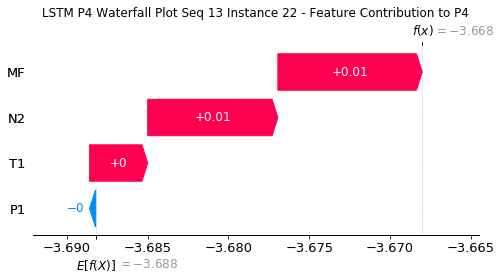

None

Contribution: [-0.00103968 -0.00837743  0.00876688  0.02821884]


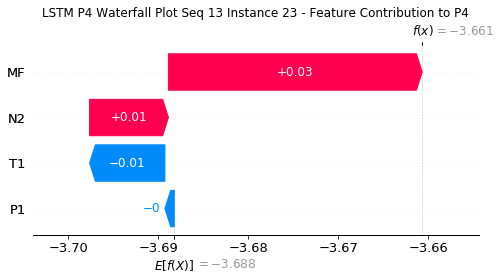

None

Contribution: [ 0.00155665  0.0139772  -0.03316456 -0.05975926]


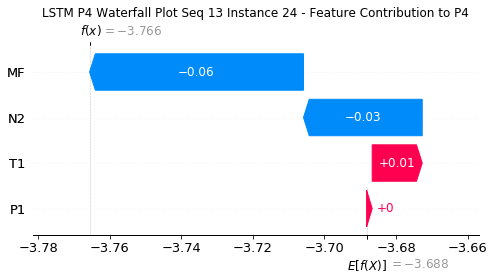

None

Contribution: [-0.00031556 -0.00162898 -0.00202677 -0.00140309]


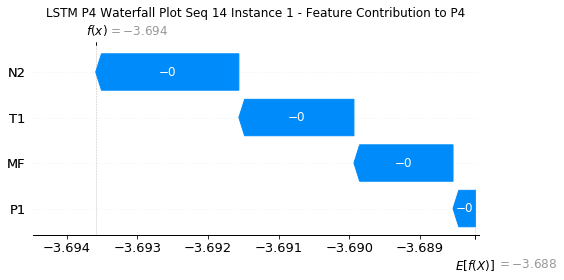

None

Contribution: [ 7.98303672e-05 -1.57820903e-04 -8.30244890e-05 -5.55428786e-05]


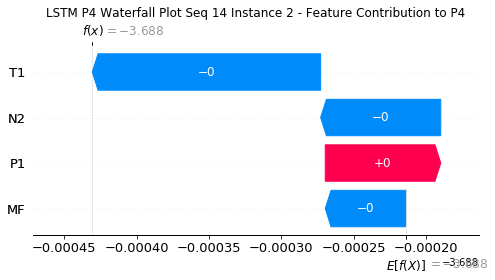

None

Contribution: [ 5.07307523e-06  1.89717455e-04 -6.56386598e-05  4.33557276e-05]


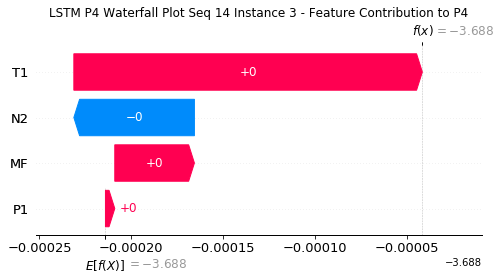

None

Contribution: [-3.41305375e-05  2.00181599e-04 -6.84066324e-05  1.88589319e-04]


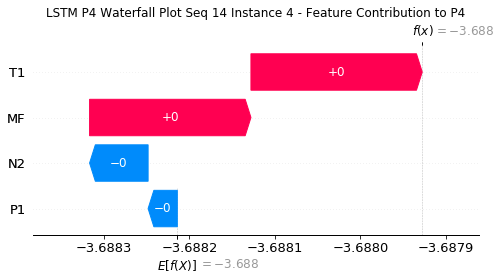

None

Contribution: [-3.02217117e-05  2.52779461e-04 -1.12663379e-04  1.52944163e-04]


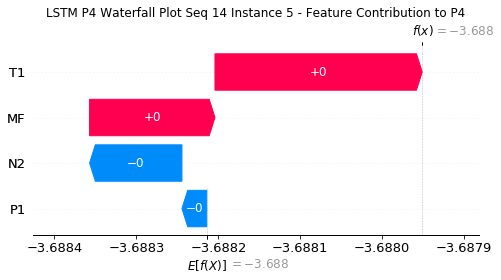

None

Contribution: [-6.65541558e-05  1.01832014e-04 -1.44045515e-04  1.31707812e-04]


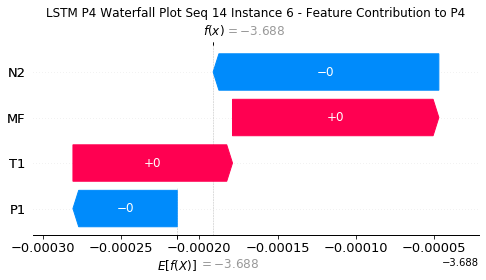

None

Contribution: [ 2.02525565e-05  4.93658511e-05 -1.76952320e-04  3.68297269e-05]


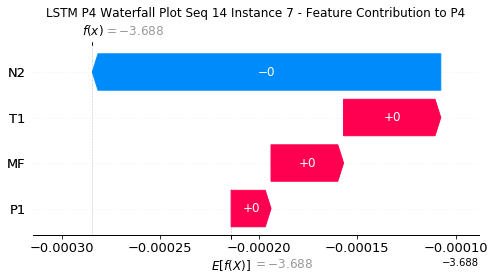

None

Contribution: [ 1.35065042e-05 -2.67377653e-06 -2.11357033e-04 -6.36309200e-06]


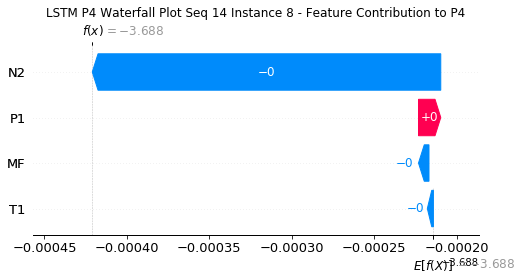

None

Contribution: [-2.43661665e-05 -1.38130646e-05 -2.59075592e-04 -7.41568716e-05]


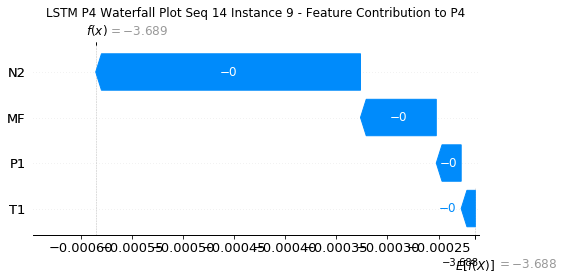

None

Contribution: [ 1.20197910e-05 -1.66523426e-05 -2.71958535e-04 -2.74626392e-05]


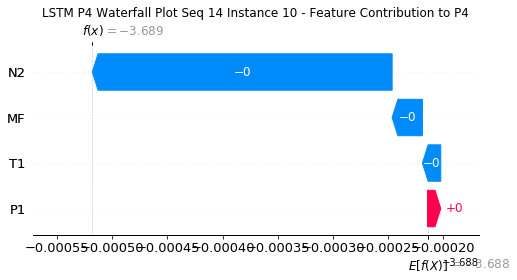

None

Contribution: [-6.94168154e-05 -1.60322810e-05 -3.44247087e-04 -2.06427951e-04]


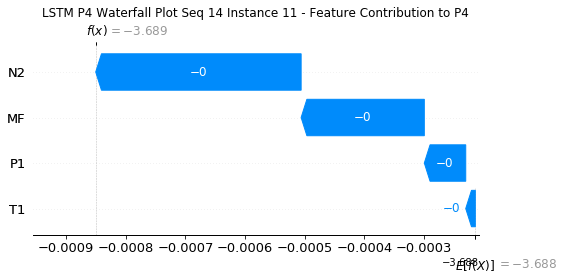

None

Contribution: [-5.57391537e-05 -5.23849725e-06 -3.95406523e-04 -2.36280051e-04]


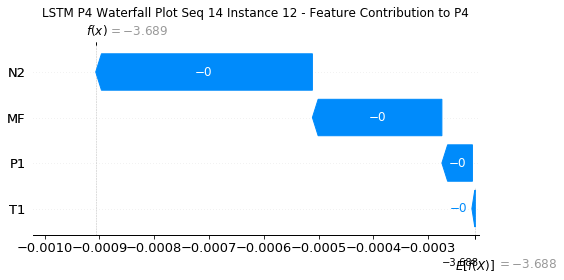

None

Contribution: [-8.75292241e-05 -1.77264517e-05 -4.84837186e-04 -3.52099836e-04]


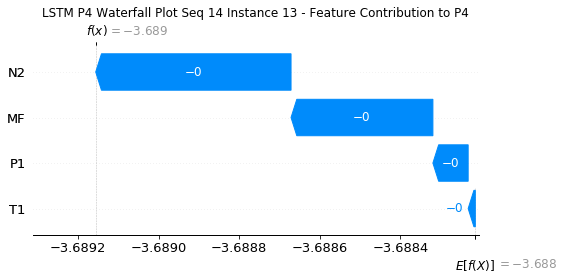

None

Contribution: [ 1.64330244e-05 -7.07526803e-05 -5.00017546e-04 -2.10046912e-04]


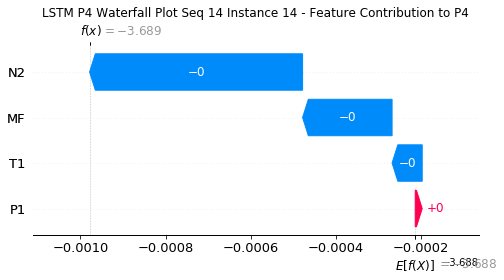

None

Contribution: [-8.85279853e-05  1.24730455e-05 -4.41548015e-04 -3.06805803e-04]


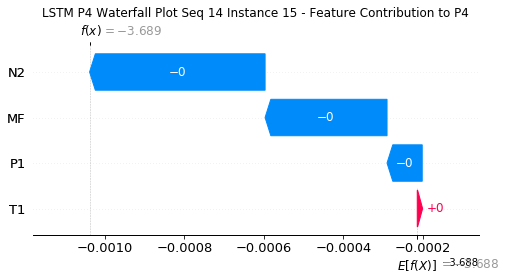

None

Contribution: [-9.06715425e-05  2.82807507e-05 -5.77236187e-04 -4.56379471e-04]


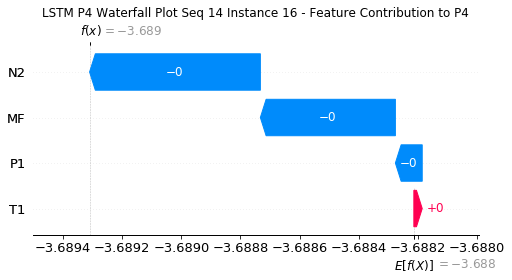

None

Contribution: [-7.76253848e-05 -3.73142936e-04 -1.41180078e-03 -8.88173796e-04]


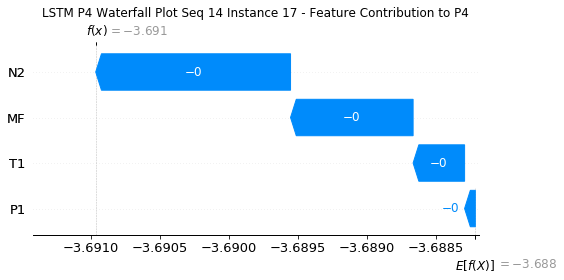

None

Contribution: [-0.00017829  0.0002331  -0.0009592  -0.00123333]


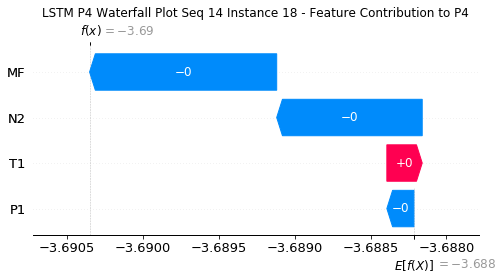

None

Contribution: [-1.32439301e-04 -9.45027866e-06  1.67850073e-03  2.16222857e-03]


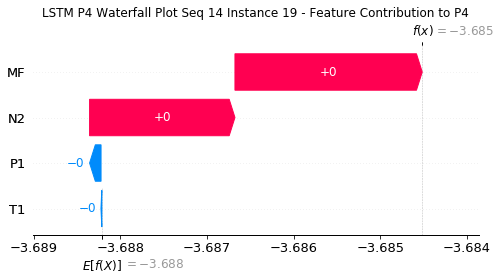

None

Contribution: [-2.78132907e-04 -2.29699056e-03 -2.59902370e-03 -6.83527011e-05]


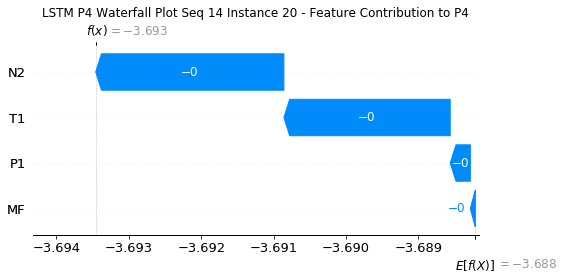

None

Contribution: [ 0.00076399  0.0028157  -0.00937372 -0.0163135 ]


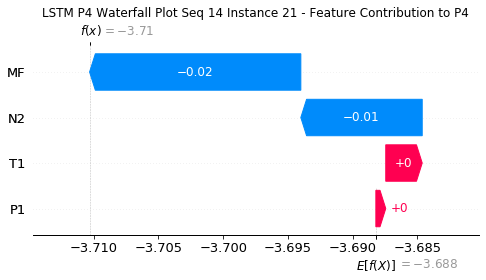

None

Contribution: [-0.00088051  0.00188325  0.00804997  0.00855143]


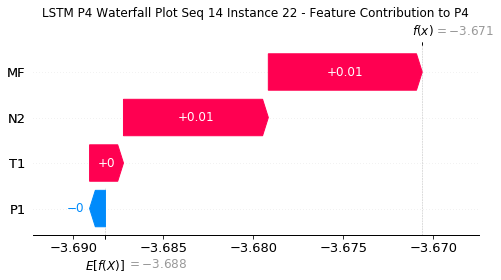

None

Contribution: [-0.00463578 -0.00342541  0.01087756  0.04561871]


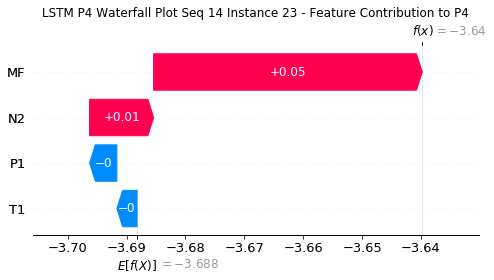

None

Contribution: [ 0.00231224  0.00436259 -0.03298719 -0.06197676]


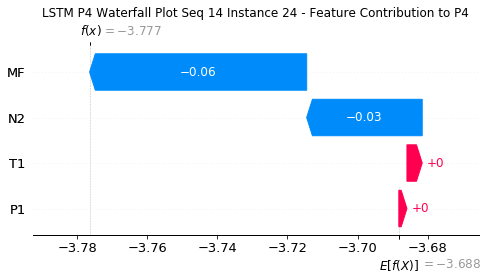

None

Contribution: [-0.00026884 -0.00085862 -0.00202147 -0.001393  ]


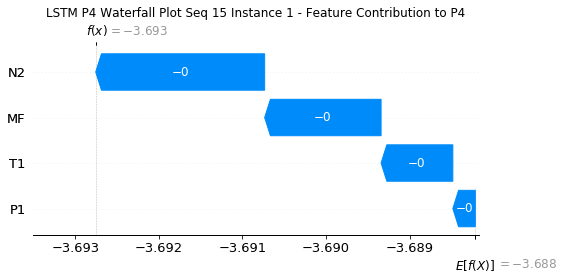

None

Contribution: [ 6.99108927e-05 -1.28435774e-04 -8.13939099e-05 -1.37095839e-05]


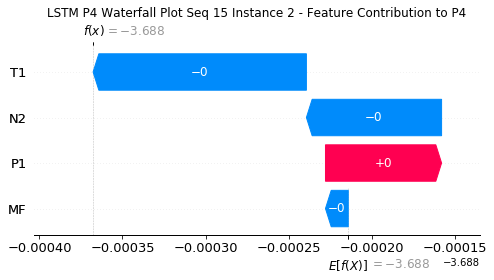

None

Contribution: [ 3.40512113e-05  6.28996108e-05 -7.49643666e-05  6.99582781e-06]


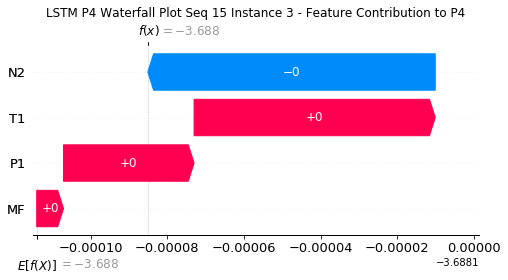

None

Contribution: [-2.85371593e-06  7.96915874e-05 -8.33490463e-05  1.17552444e-04]


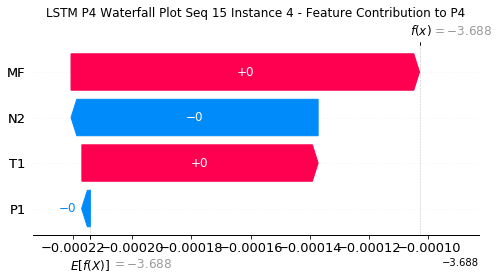

None

Contribution: [-5.80210882e-05  3.40366360e-05 -1.11929298e-04  1.96446702e-04]


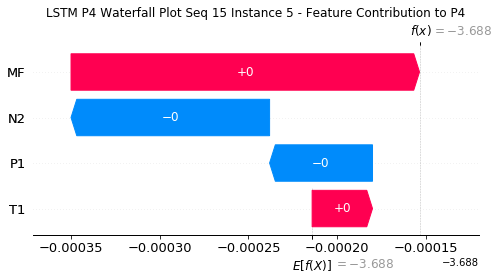

None

Contribution: [-3.73141443e-05  2.63019540e-05 -1.59745205e-04  6.59527015e-05]


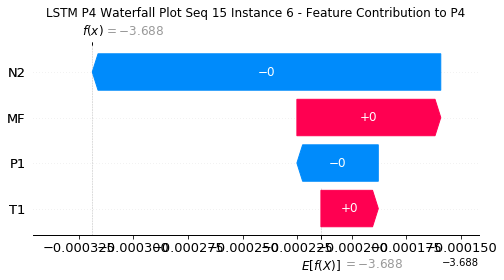

None

Contribution: [ 7.11598627e-05  1.73869750e-05 -1.94496953e-04 -2.04568790e-05]


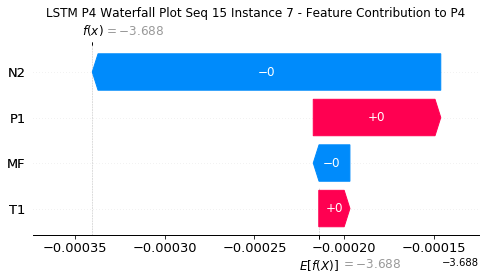

None

Contribution: [-1.59443775e-05 -9.91374622e-06 -2.18217521e-04  1.16891119e-05]


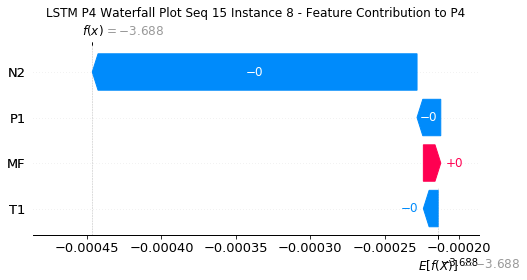

None

Contribution: [-1.02389896e-05 -2.58335905e-05 -2.72692798e-04 -1.32548234e-04]


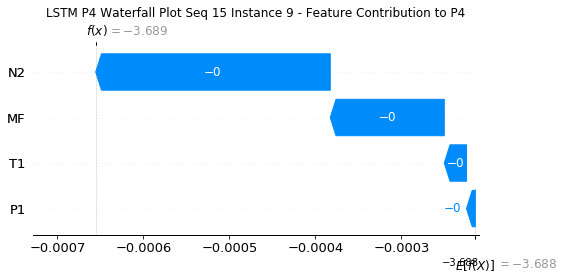

None

Contribution: [ 1.07974903e-05 -3.23338046e-05 -2.76085645e-04 -3.25349577e-05]


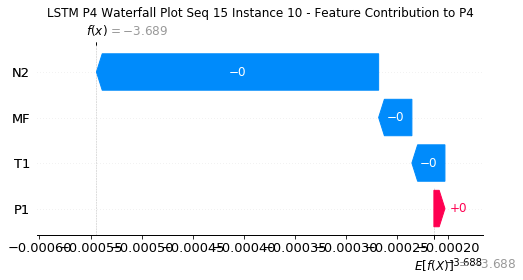

None

Contribution: [-6.74196736e-05 -2.97865905e-05 -3.49780727e-04 -2.11639762e-04]


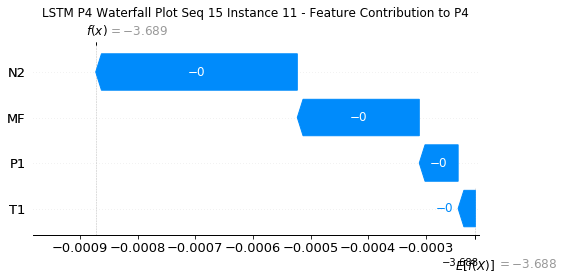

None

Contribution: [-6.77872682e-05 -1.80834935e-05 -4.01656482e-04 -2.50870159e-04]


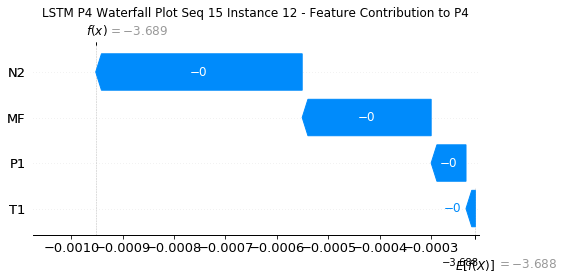

None

Contribution: [-9.07499466e-05 -2.15184294e-05 -4.90443987e-04 -3.55556503e-04]


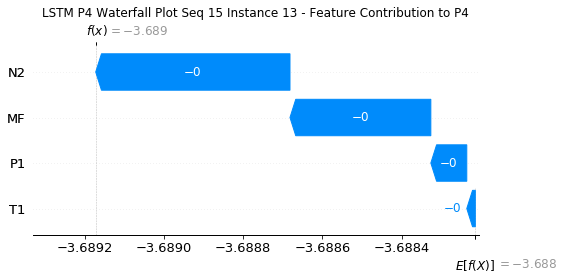

None

Contribution: [-2.03297680e-05 -6.89905387e-05 -5.00018584e-04 -1.97444021e-04]


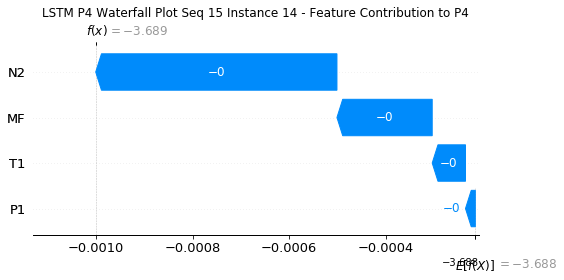

None

Contribution: [-9.66248585e-05  2.20175000e-05 -4.47851832e-04 -3.13535084e-04]


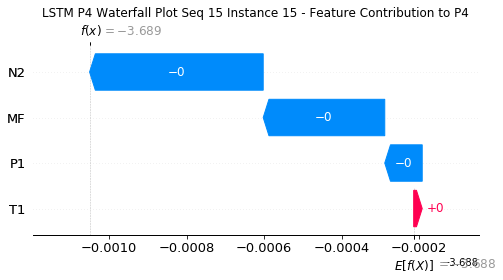

None

Contribution: [-9.44539493e-05  4.83807960e-05 -5.85996384e-04 -4.70435030e-04]


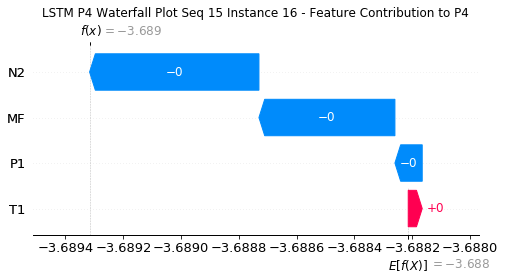

None

Contribution: [-9.05528514e-05 -3.64019784e-04 -1.43134018e-03 -1.02615722e-03]


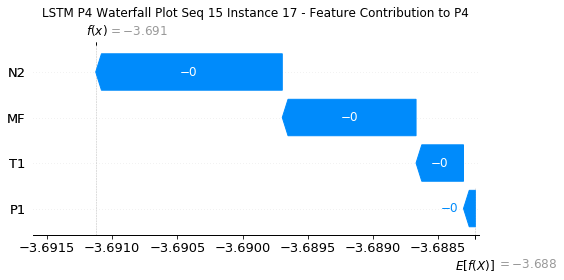

None

Contribution: [-0.00017772  0.0003064  -0.00094989 -0.0011463 ]


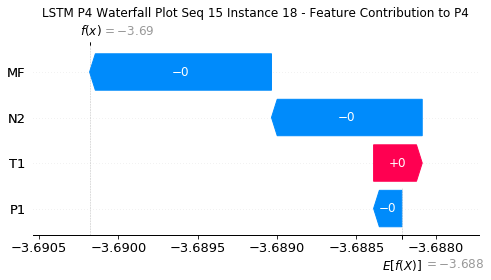

None

Contribution: [-1.32511684e-04  1.72399699e-05  1.68687934e-03  2.18582196e-03]


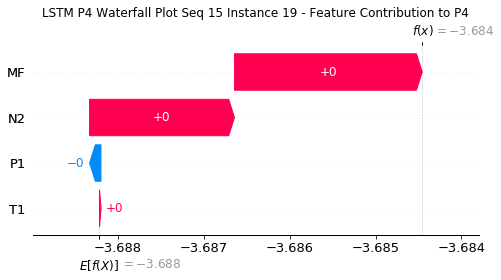

None

Contribution: [-0.0002773  -0.00294613 -0.00275454 -0.00076888]


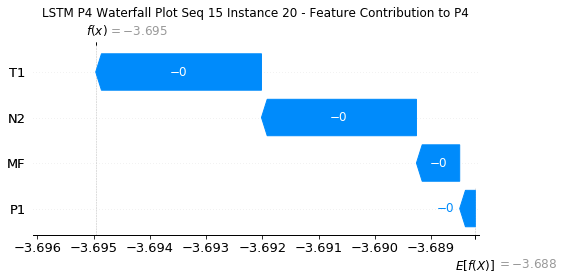

None

Contribution: [ 0.00074592  0.0044862  -0.00920622 -0.01484484]


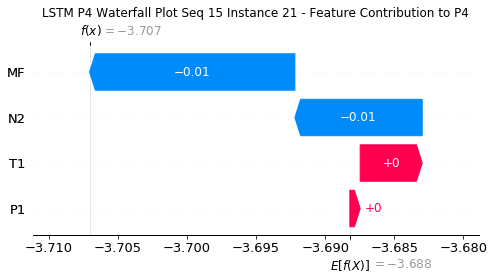

None

Contribution: [-0.00090999  0.00305763  0.00810727  0.00928155]


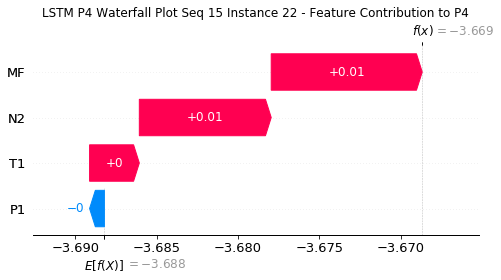

None

Contribution: [-0.00057    -0.00896175  0.00944955  0.02687602]


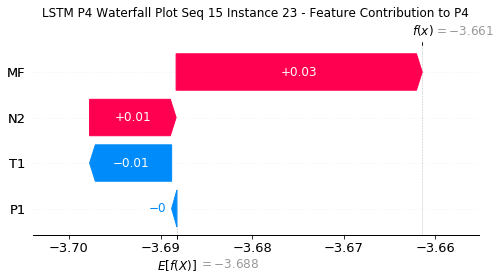

None

Contribution: [ 0.00212135  0.00941713 -0.03450883 -0.0664547 ]


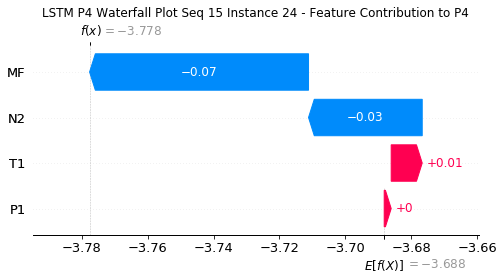

None

Contribution: [-0.00027111 -0.00145789 -0.00197444 -0.00115558]


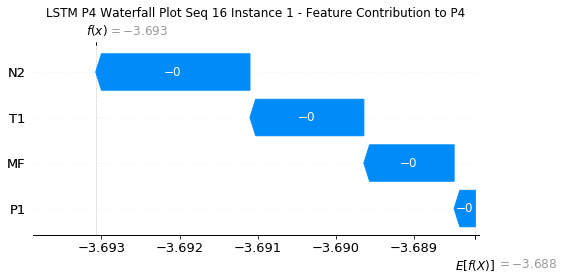

None

Contribution: [ 6.30648611e-05 -1.46301902e-04 -7.60836617e-05 -5.91760619e-06]


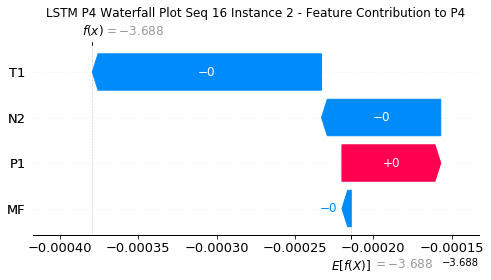

None

Contribution: [ 5.01043168e-05  1.36969196e-04 -7.23740086e-05  1.23557671e-05]


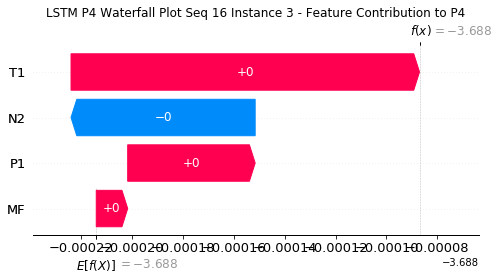

None

Contribution: [ 1.50418528e-05  1.48413285e-04 -7.63737446e-05  1.30071323e-04]


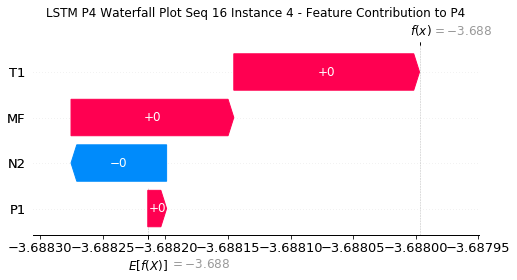

None

Contribution: [-5.46635500e-05  1.08114064e-04 -1.02874714e-04  2.30641314e-04]


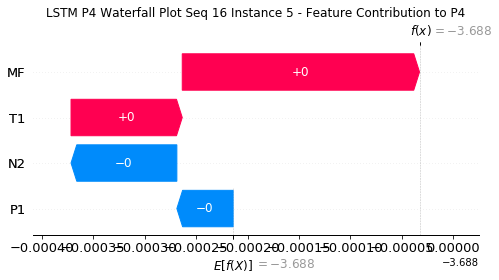

None

Contribution: [-2.26542833e-05  7.10587938e-05 -1.52211270e-04  8.62594353e-05]


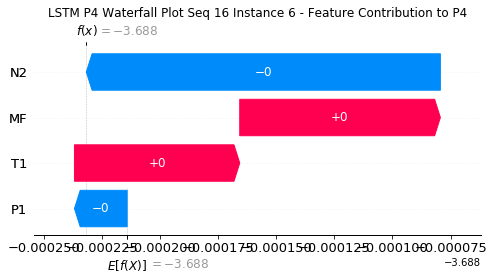

None

Contribution: [ 3.65460049e-05  3.71265587e-05 -1.77956389e-04  7.06101667e-05]


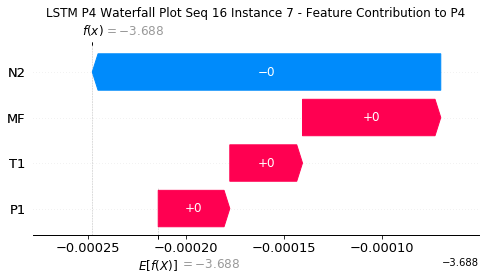

None

Contribution: [ 2.69137773e-05 -9.29682992e-06 -2.20608659e-04 -3.36355733e-05]


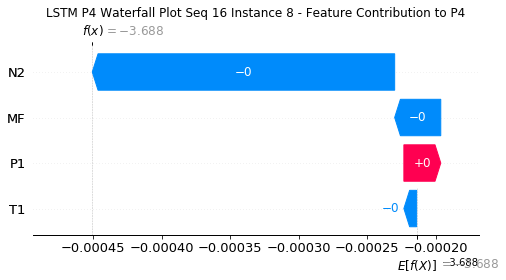

None

Contribution: [-2.78246730e-05 -6.90737496e-06 -2.61769373e-04 -7.20428535e-05]


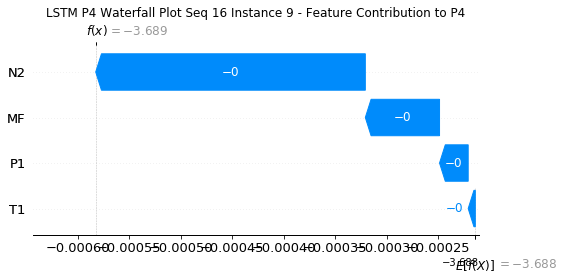

None

Contribution: [ 7.80921341e-06 -2.87713641e-05 -2.73686143e-04 -2.47972037e-05]


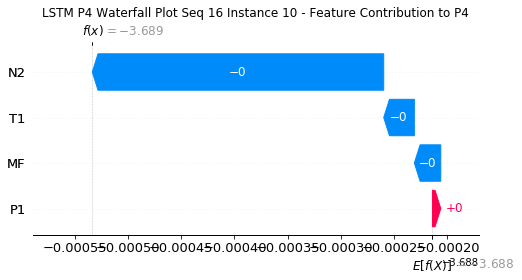

None

Contribution: [-6.91792997e-05 -2.75888642e-05 -3.45676276e-04 -2.01162190e-04]


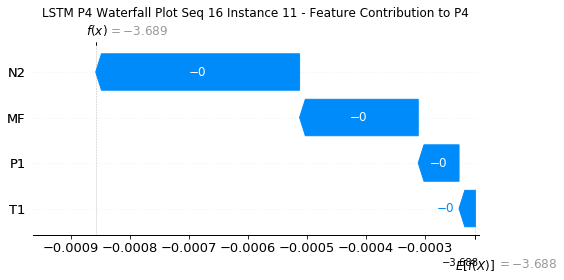

None

Contribution: [-6.67439789e-05 -3.32064369e-05 -4.03106400e-04 -2.78199235e-04]


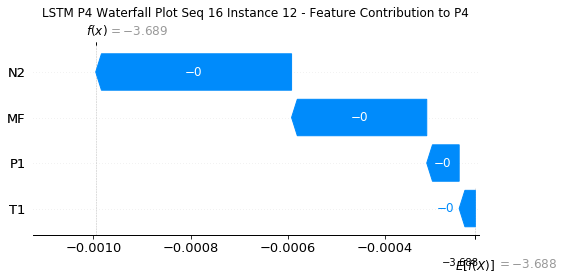

None

Contribution: [-9.30333747e-05 -2.71854940e-05 -4.87506439e-04 -3.46193320e-04]


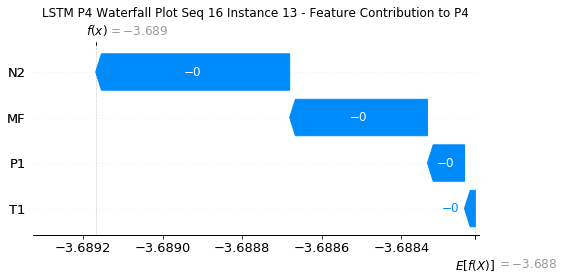

None

Contribution: [-2.26864204e-05 -9.54726329e-05 -5.01849496e-04 -2.19978546e-04]


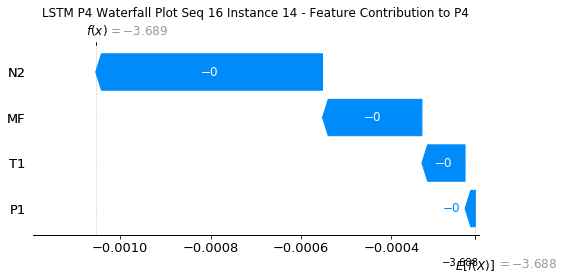

None

Contribution: [-9.87844332e-05  6.01407122e-06 -4.44076991e-04 -3.02603093e-04]


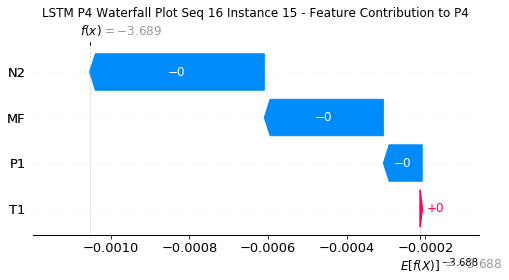

None

Contribution: [-9.35477603e-05  3.08714929e-05 -5.85824070e-04 -4.67130342e-04]


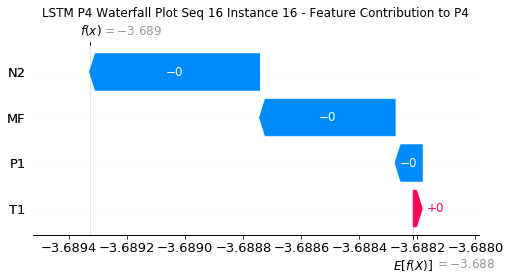

None

Contribution: [-9.25654619e-05 -3.66307647e-04 -1.42045424e-03 -1.02027018e-03]


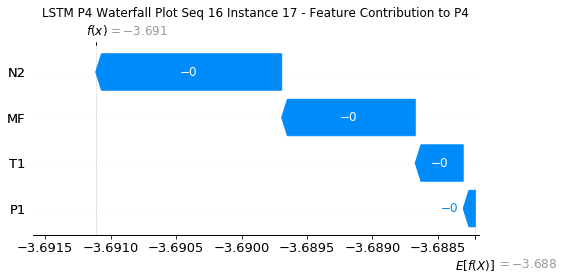

None

Contribution: [-0.00015729  0.00027178 -0.00095461 -0.00120868]


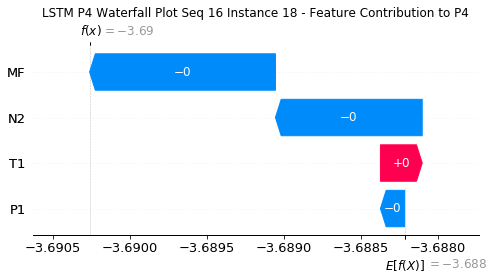

None

Contribution: [-1.43382661e-04  1.36347373e-06  1.68818169e-03  2.18648622e-03]


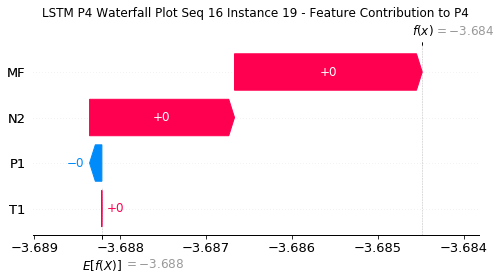

None

Contribution: [-0.00026286 -0.0027161  -0.00273074 -0.00048786]


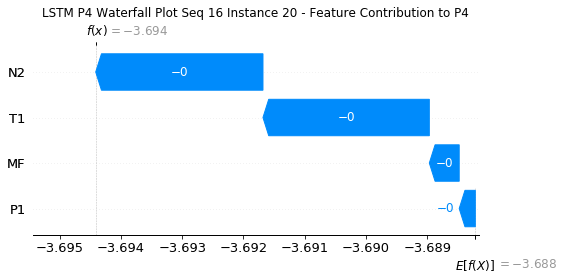

None

Contribution: [ 0.00076307  0.0038324  -0.0093025  -0.01549251]


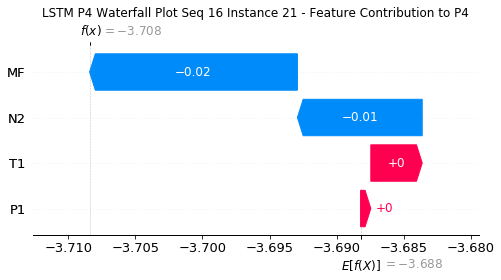

None

Contribution: [-0.0010782   0.00235949  0.00818686  0.00930772]


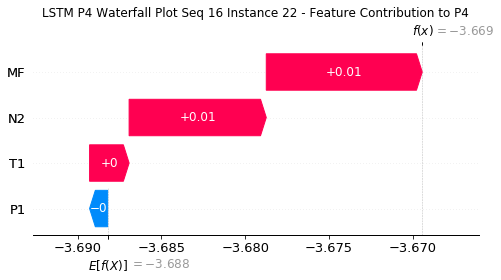

None

Contribution: [-0.00297934 -0.00557328  0.00946175  0.02407341]


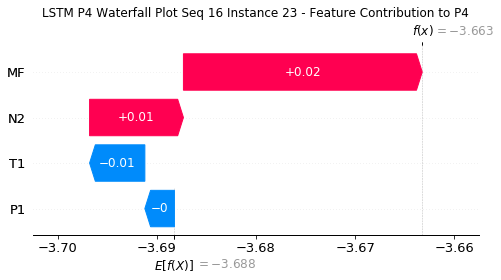

None

Contribution: [ 0.00231561  0.01110482 -0.03323171 -0.06055433]


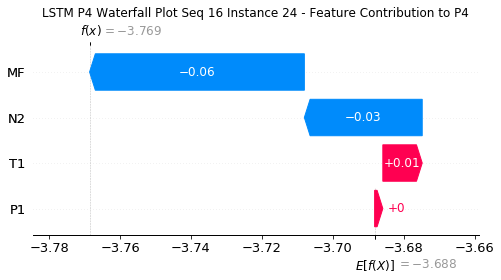

None

Contribution: [-0.00024242 -0.00146018 -0.00197988 -0.00114661]


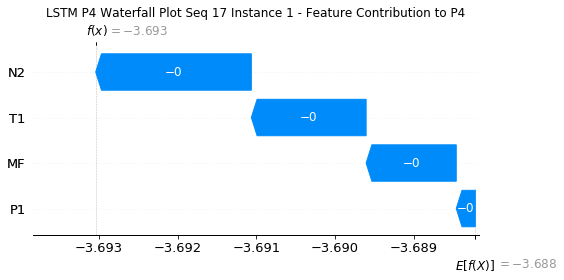

None

Contribution: [ 6.35398183e-05 -1.54072948e-04 -7.29536810e-05  2.97880857e-05]


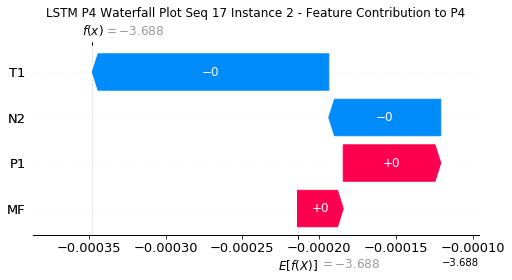

None

Contribution: [ 2.93100481e-05  1.83052334e-04 -7.17403651e-05  3.46722669e-05]


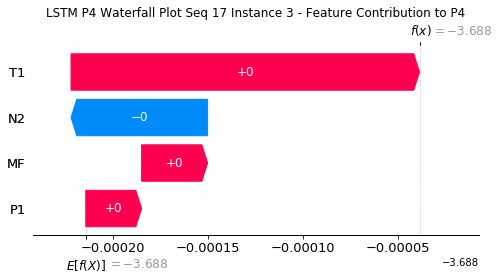

None

Contribution: [-5.43732921e-07  2.07782590e-04 -7.58295031e-05  1.57825742e-04]


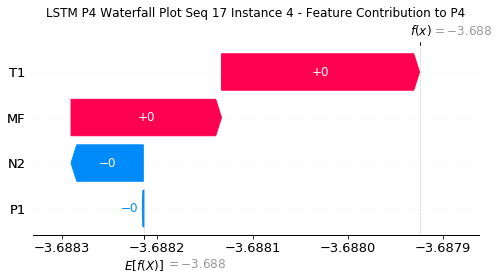

None

Contribution: [-3.75894331e-05  1.32229471e-04 -1.05152344e-04  2.14211719e-04]


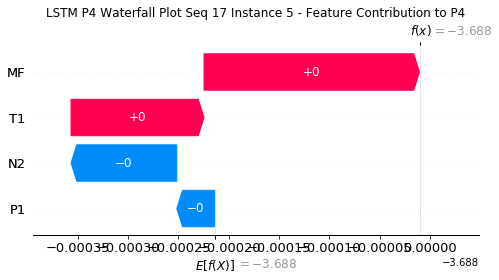

None

Contribution: [-3.54835066e-05  1.09547599e-04 -1.51877936e-04  1.11220562e-04]


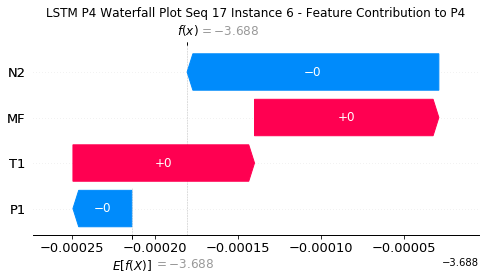

None

Contribution: [ 3.12424901e-05  4.02067186e-05 -1.79933806e-04  7.98684393e-05]


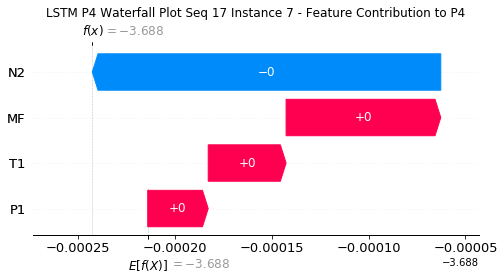

None

Contribution: [ 1.34582217e-05  1.90273330e-05 -2.07885632e-04  5.74565506e-05]


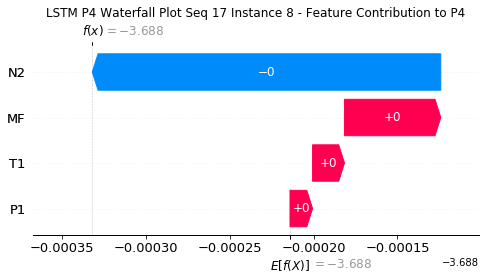

None

Contribution: [-5.20114863e-06  8.11933603e-06 -2.63858477e-04 -9.15167867e-05]


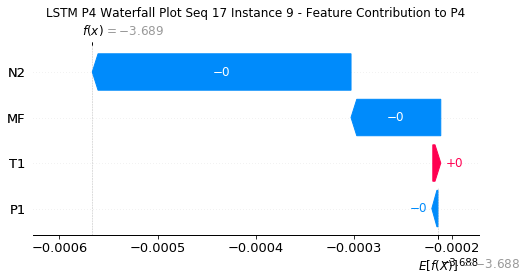

None

Contribution: [ 2.54949088e-05  2.31356599e-06 -2.74098211e-04 -4.54471205e-05]


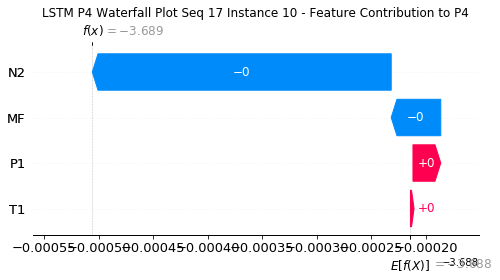

None

Contribution: [-5.98456018e-05  2.56564314e-06 -3.47103523e-04 -2.22541297e-04]


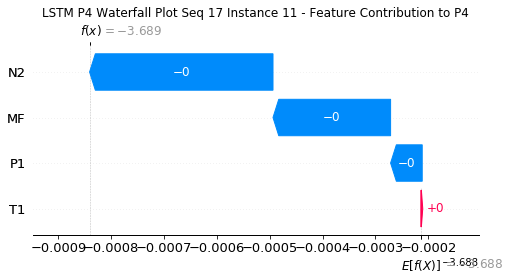

None

Contribution: [-5.81775080e-05  2.04218209e-06 -3.99185764e-04 -2.74438257e-04]


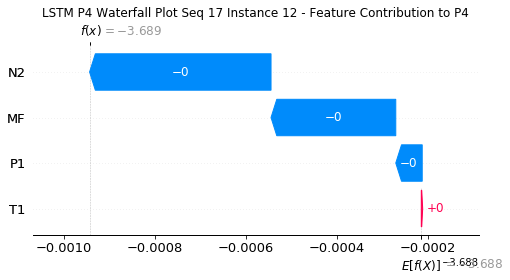

None

Contribution: [-8.09142296e-05  1.05151860e-05 -4.85795440e-04 -3.66757453e-04]


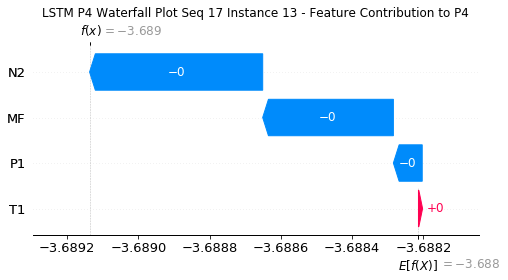

None

Contribution: [-1.98009047e-05 -5.81844213e-05 -5.03488617e-04 -1.67307659e-04]


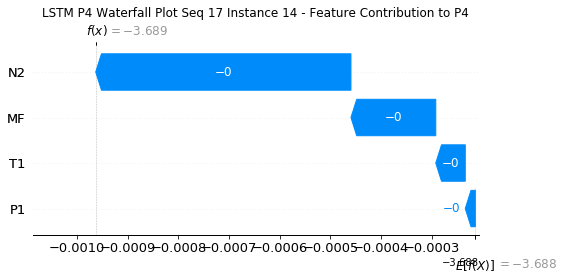

None

Contribution: [-8.77177259e-05  4.89827144e-05 -4.46412154e-04 -3.21470134e-04]


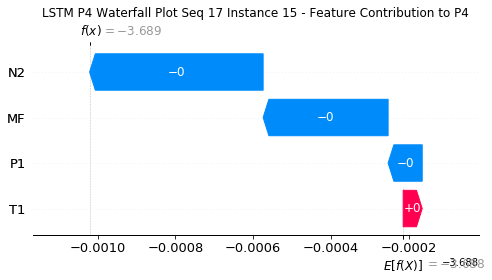

None

Contribution: [-8.93788646e-05  8.94997232e-05 -5.74126380e-04 -4.59169663e-04]


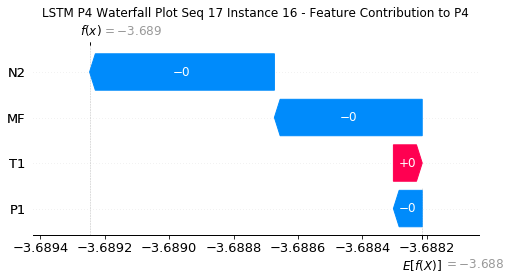

None

Contribution: [-8.82175018e-05 -3.71752992e-04 -1.44230074e-03 -8.88937222e-04]


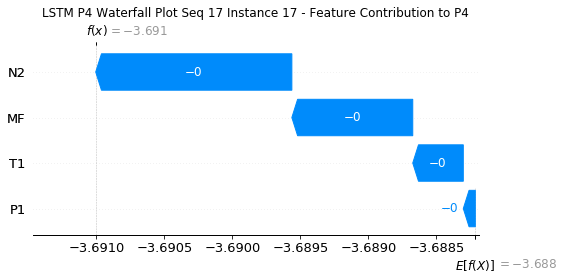

None

Contribution: [-0.00018888  0.00040247 -0.00095254 -0.00112805]


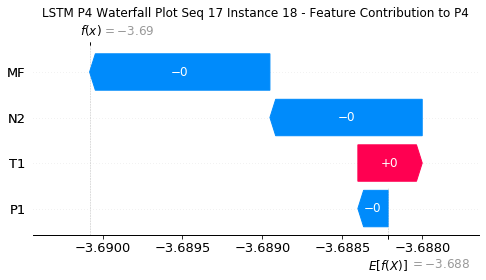

None

Contribution: [-1.30063383e-04  5.51071080e-05  1.67826711e-03  2.17303539e-03]


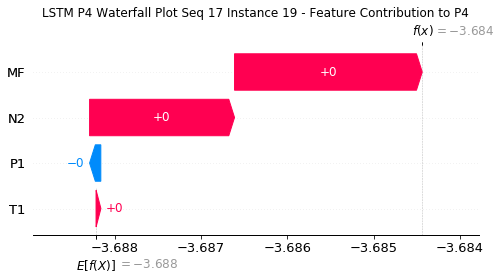

None

Contribution: [-0.00028763 -0.00329547 -0.00273335 -0.00103486]


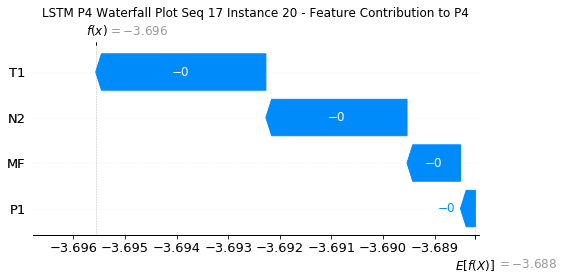

None

Contribution: [ 0.00076191  0.00512897 -0.00910113 -0.0136901 ]


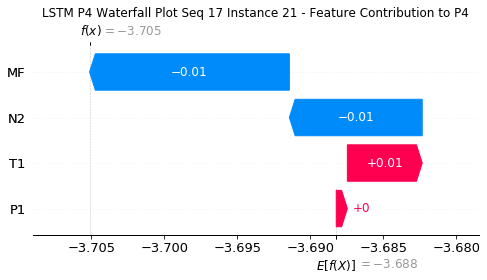

None

Contribution: [-0.00067827  0.0032592   0.0080172   0.00901298]


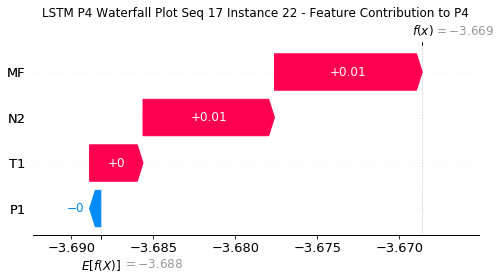

None

Contribution: [-0.00643378 -0.00973685  0.01164368  0.04317809]


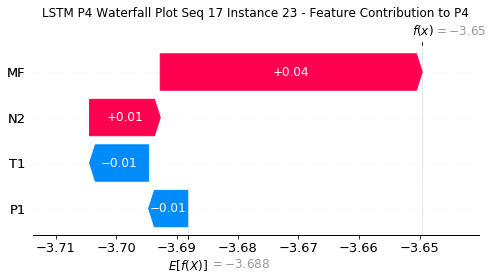

None

Contribution: [ 0.00182008  0.01489771 -0.03238056 -0.05728884]


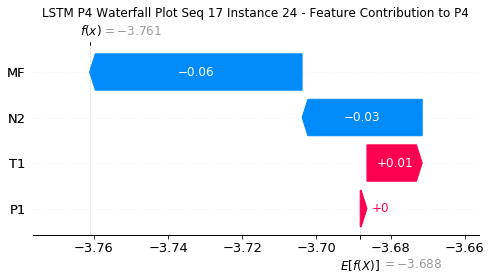

None

Contribution: [-0.0002778  -0.00175385 -0.00210535 -0.00150496]


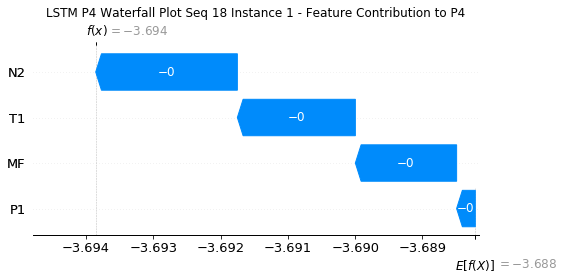

None

Contribution: [ 7.03306861e-05 -1.64889789e-04 -8.32168120e-05 -3.51152787e-05]


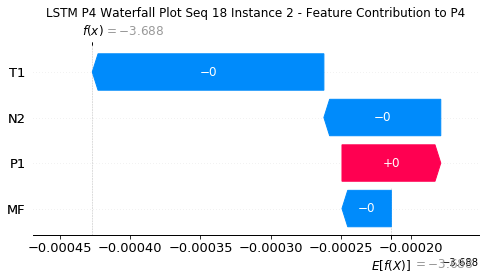

None

Contribution: [ 3.27036636e-05  2.24971478e-04 -7.32103992e-05  1.24139085e-05]


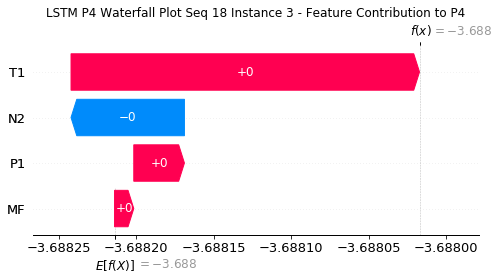

None

Contribution: [-7.04654373e-07  2.46847809e-04 -8.22560909e-05  1.01518387e-04]


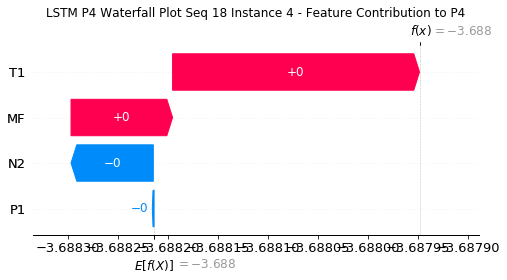

None

Contribution: [-1.58883741e-05  1.75573034e-04 -9.83352243e-05  1.34118994e-04]


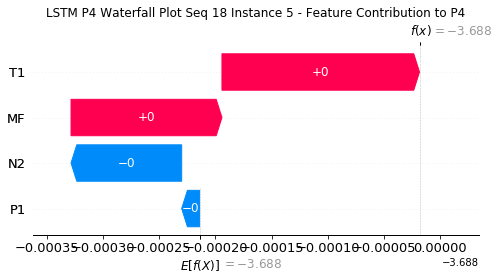

None

Contribution: [-3.40099403e-05  1.41646170e-04 -1.57139910e-04  3.76842348e-05]


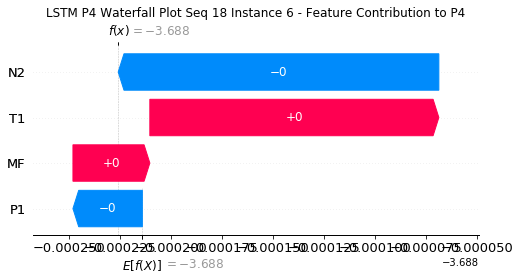

None

Contribution: [ 6.33188373e-05  9.27786952e-05 -1.88534785e-04 -4.34458037e-05]


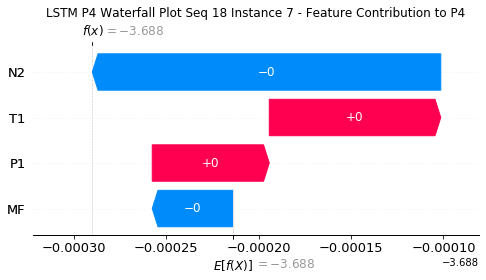

None

Contribution: [ 6.02989544e-06  5.16407311e-05 -2.13405687e-04 -1.99105001e-05]


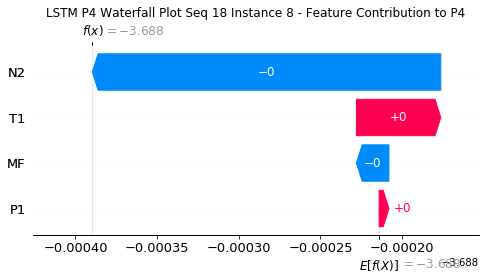

None

Contribution: [ 5.47878296e-06  3.31228615e-05 -2.69840766e-04 -1.48941204e-04]


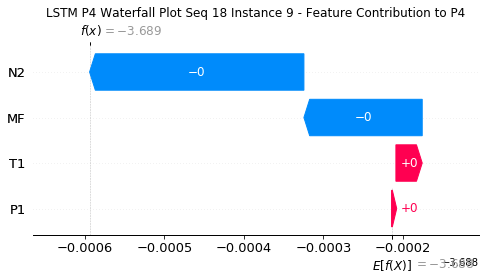

None

Contribution: [ 1.59733268e-05  1.00138017e-05 -2.73369253e-04 -6.22600096e-05]


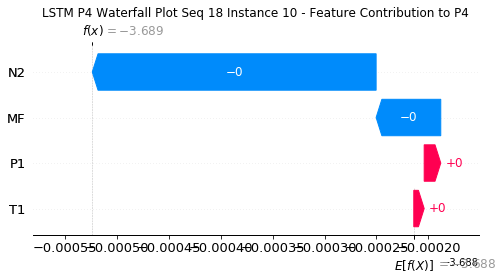

None

Contribution: [-6.76307552e-05  1.28596029e-05 -3.46024252e-04 -2.37832191e-04]


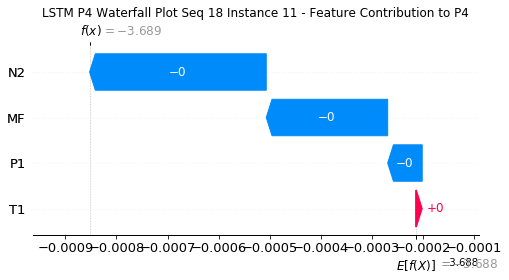

None

Contribution: [-6.24914461e-05  2.55549768e-05 -4.07425381e-04 -3.15964187e-04]


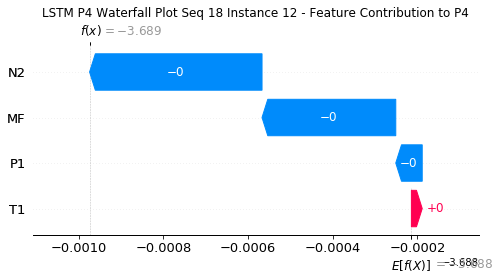

None

Contribution: [-9.16210172e-05  2.36228134e-05 -4.85160103e-04 -3.74638524e-04]


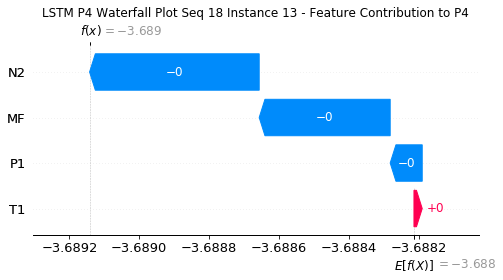

None

Contribution: [-2.17133954e-05 -6.92654385e-05 -5.01259579e-04 -2.67257912e-04]


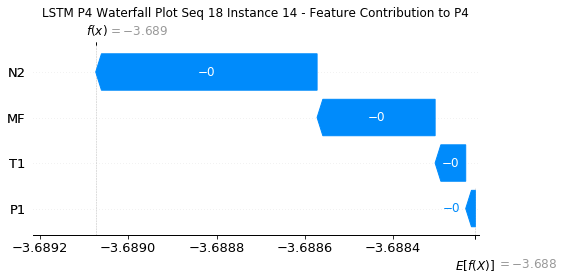

None

Contribution: [-1.03041683e-04  6.11807820e-05 -4.48813445e-04 -3.30169223e-04]


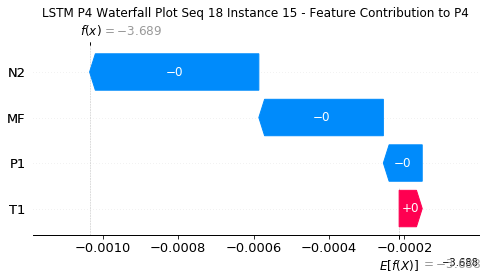

None

Contribution: [-0.00010103  0.00010864 -0.00057875 -0.00046884]


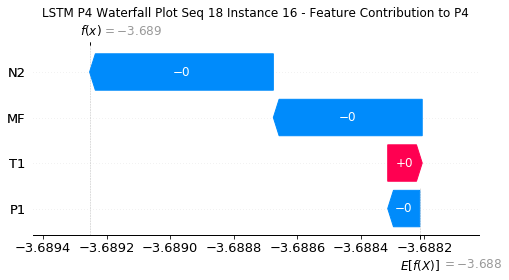

None

Contribution: [-8.63872927e-05 -4.00420942e-04 -1.41444916e-03 -1.14184918e-03]


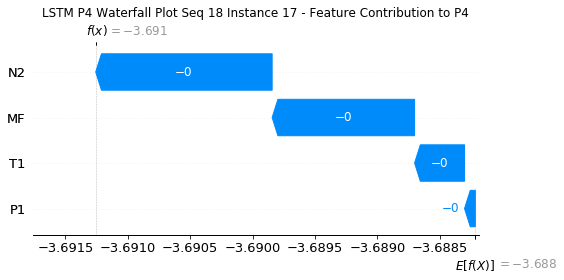

None

Contribution: [-0.00021543  0.00048597 -0.00099309 -0.00111349]


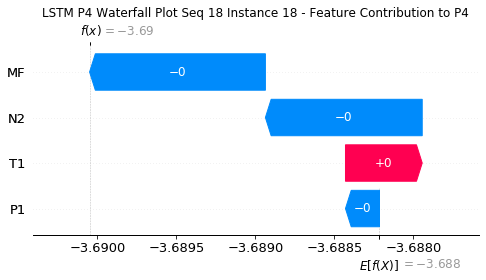

None

Contribution: [-1.16759056e-04  9.06689839e-05  1.65070413e-03  2.14605820e-03]


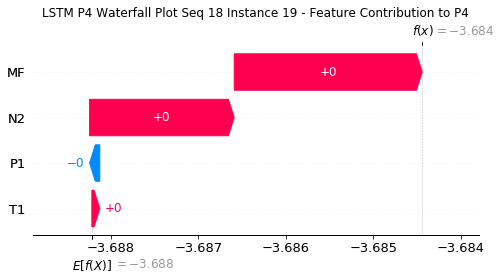

None

Contribution: [-0.00031491 -0.00363518 -0.00254456 -0.00086089]


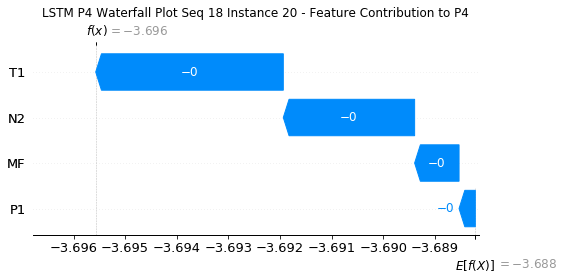

None

Contribution: [ 0.00071444  0.00560291 -0.00946198 -0.01359762]


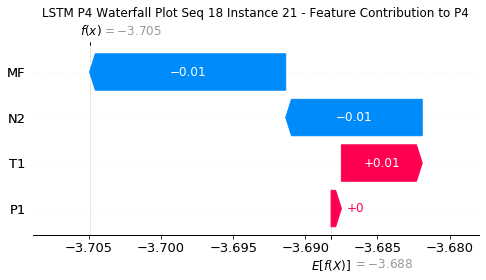

None

Contribution: [-0.00054239  0.00371588  0.00798594  0.00913777]


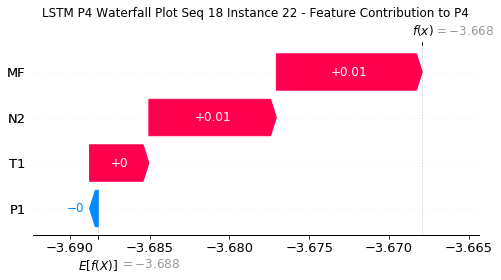

None

Contribution: [-0.00255263 -0.01168135  0.01044249  0.02925295]


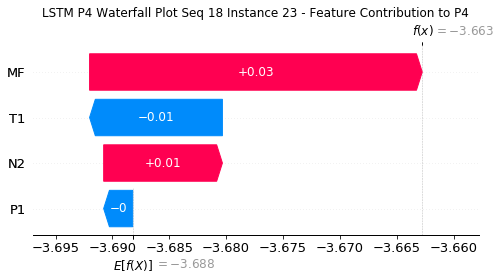

None

Contribution: [ 0.00209484  0.01475716 -0.0346212  -0.06085863]


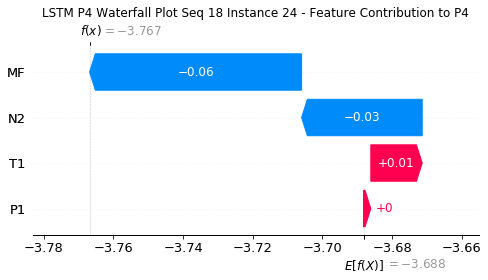

None

Contribution: [-0.00024108 -0.00175063 -0.00192316 -0.00101823]


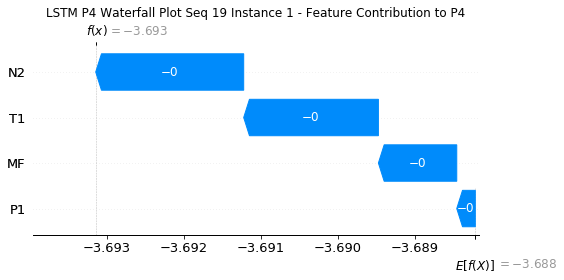

None

Contribution: [ 5.96747519e-05 -1.62237035e-04 -7.19599536e-05  2.43828408e-05]


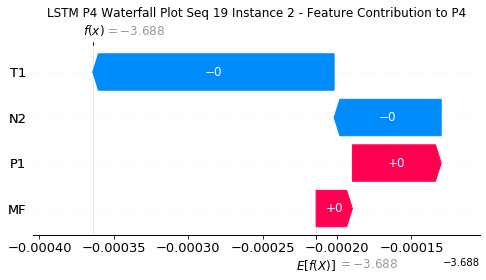

None

Contribution: [ 4.75974750e-06  1.57603456e-04 -6.94315470e-05  4.86250481e-05]


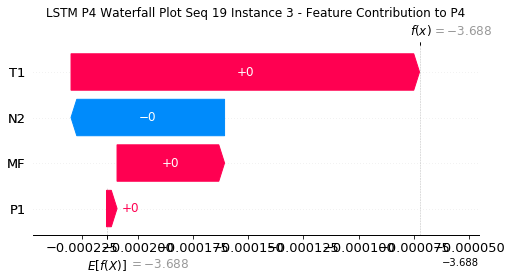

None

Contribution: [-3.62446396e-05  1.76047048e-04 -7.05227393e-05  1.87051978e-04]


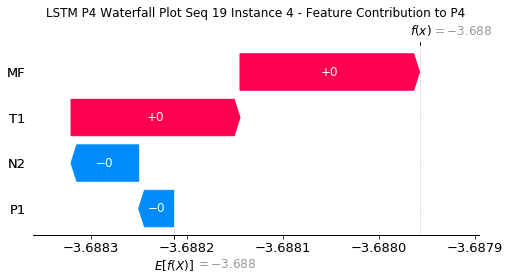

None

Contribution: [-0.00011354  0.00015678 -0.00010214  0.00020597]


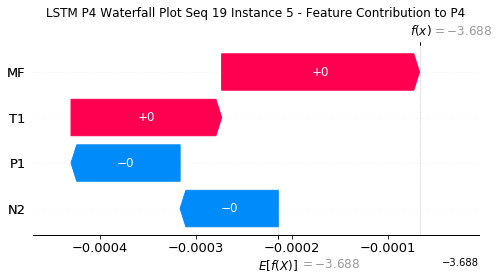

None

Contribution: [-8.27063427e-05  8.81972634e-05 -1.44764871e-04  1.43898493e-04]


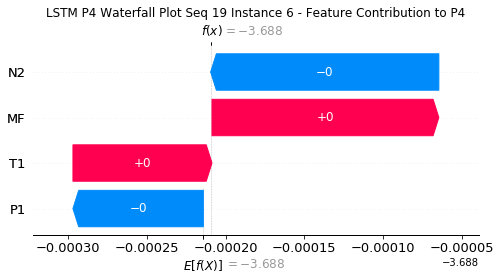

None

Contribution: [-4.02649305e-05  4.10331691e-05 -1.66207154e-04  1.31768658e-04]


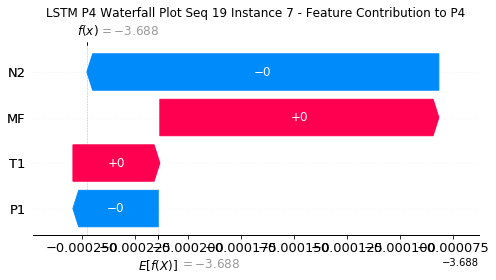

None

Contribution: [-5.96334507e-05  2.00177224e-05 -1.99810202e-04  1.18608196e-04]


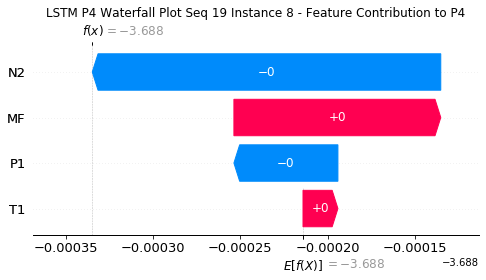

None

Contribution: [-4.44158546e-05 -9.27485688e-06 -2.61070382e-04 -6.92913755e-05]


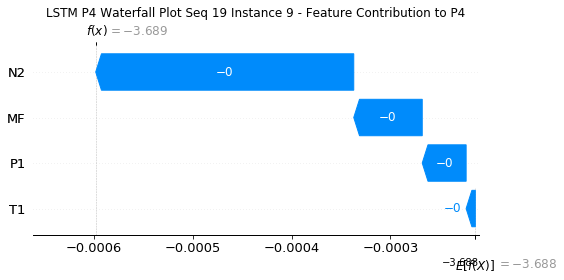

None

Contribution: [-7.77242476e-06 -1.67420048e-05 -2.71775181e-04 -2.61959768e-05]


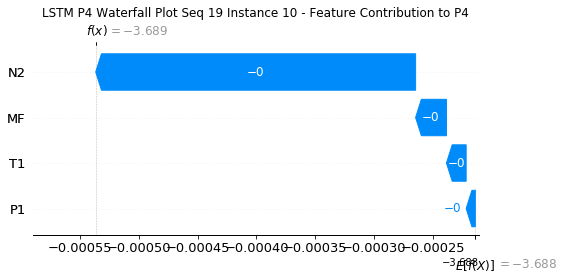

None

Contribution: [-9.04742141e-05 -1.28588397e-05 -3.44591938e-04 -2.03778612e-04]


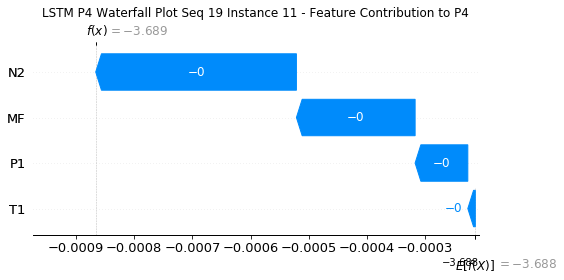

None

Contribution: [-1.08485626e-04  1.69339163e-06 -3.96440525e-04 -2.33554275e-04]


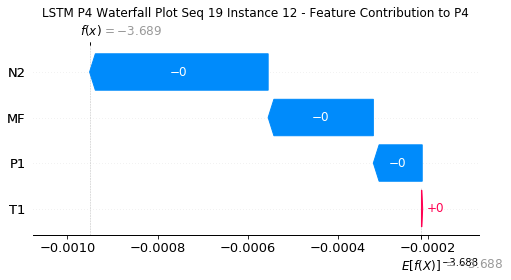

None

Contribution: [-1.10341240e-04 -6.16166648e-06 -4.88226084e-04 -3.61187899e-04]


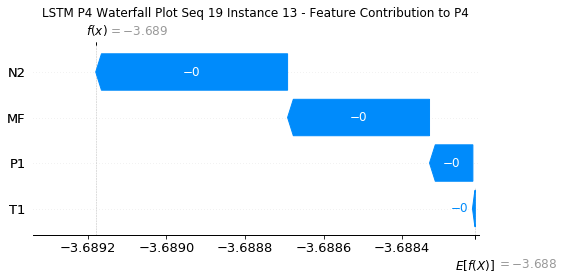

None

Contribution: [-4.18727776e-05 -6.57865099e-05 -4.96091369e-04 -1.90596402e-04]


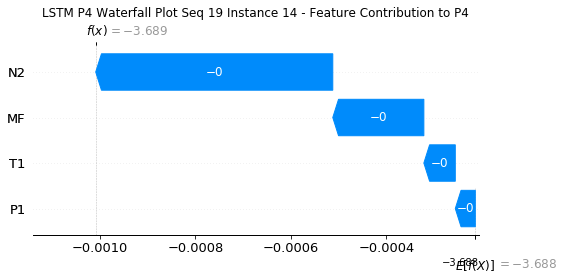

None

Contribution: [-1.17584261e-04  4.04383254e-05 -4.43980240e-04 -3.17767457e-04]


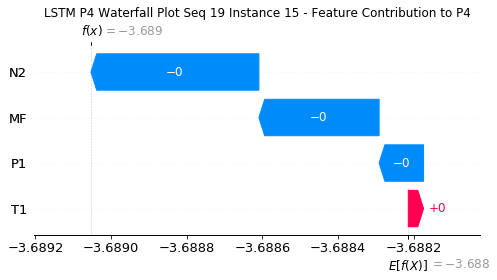

None

Contribution: [-1.03477624e-04  8.11716632e-05 -5.84237927e-04 -4.71113624e-04]


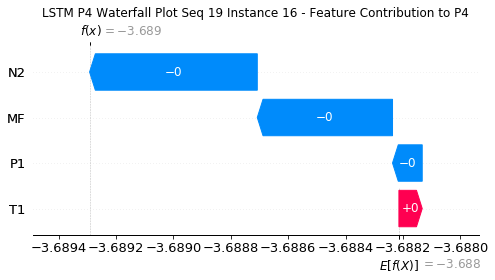

None

Contribution: [-0.0001098  -0.00036218 -0.00139074 -0.00089179]


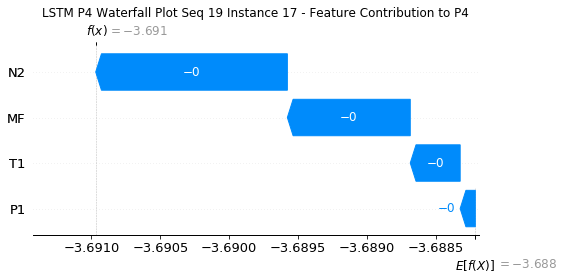

None

Contribution: [-0.00022617  0.00046404 -0.00095793 -0.00106252]


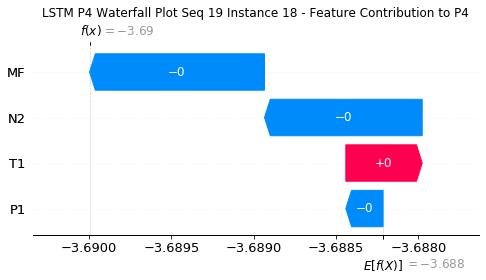

None

Contribution: [-1.09709128e-04  5.02538314e-05  1.69146643e-03  2.21300586e-03]


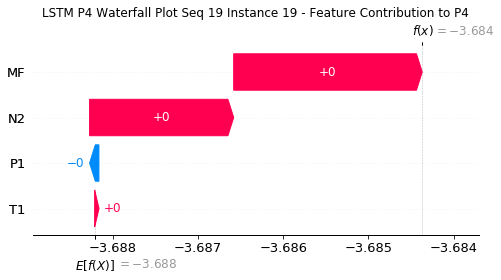

None

Contribution: [-0.00030384 -0.00339074 -0.00270023 -0.00143872]


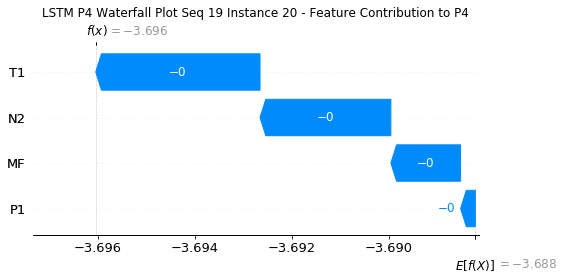

None

Contribution: [ 0.00072788  0.00515767 -0.00922192 -0.01290855]


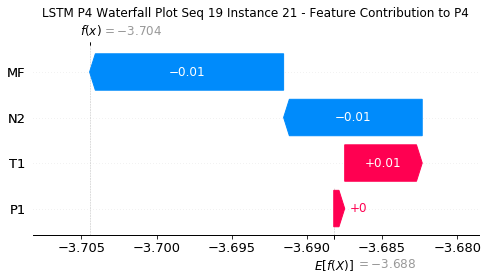

None

Contribution: [-0.00072938  0.00343441  0.00808373  0.00965814]


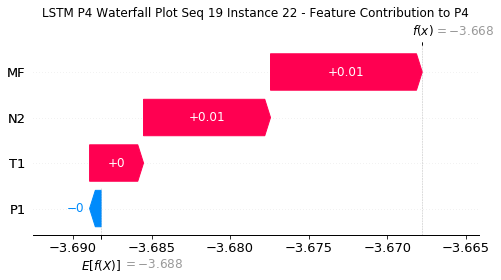

None

Contribution: [-0.00432431 -0.01005918  0.01129287  0.03282616]


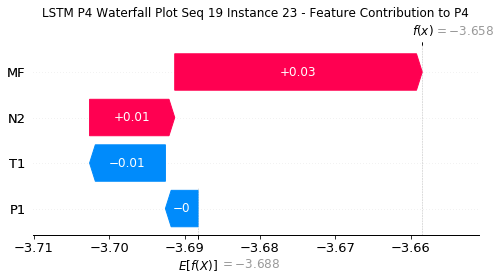

None

Contribution: [ 0.00317071  0.01369403 -0.03516033 -0.06908627]


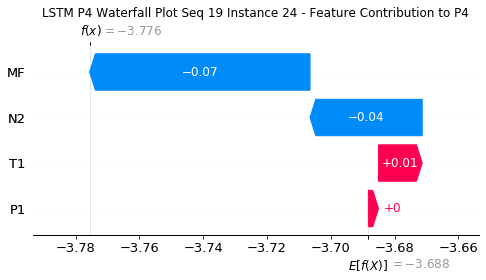

None

Contribution: [-0.00020294 -0.00164561 -0.00200218 -0.00127181]


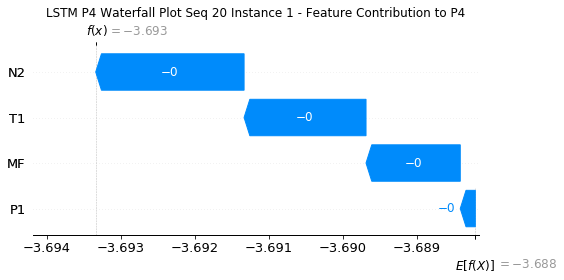

None

Contribution: [ 7.33682153e-05 -1.66796617e-04 -8.07262152e-05 -4.70182553e-05]


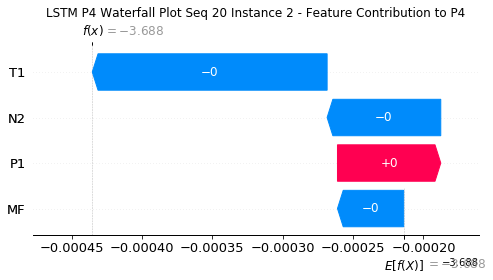

None

Contribution: [ 1.72372797e-05  1.90560720e-04 -7.20471087e-05  1.65288499e-05]


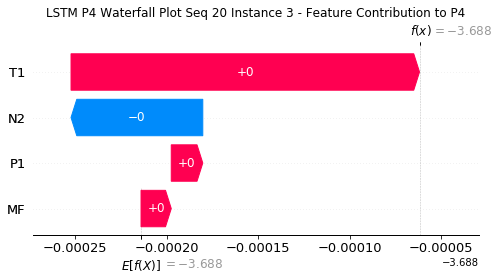

None

Contribution: [-3.08217279e-05  2.08942614e-04 -7.67356088e-05  1.39968558e-04]


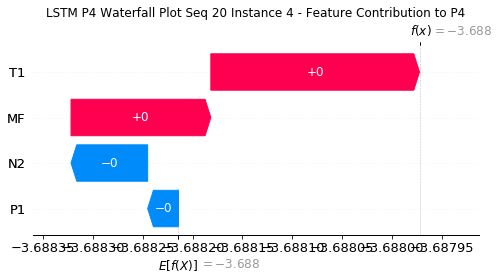

None

Contribution: [-8.52092457e-05  1.59767261e-04 -1.05644673e-04  1.47687392e-04]


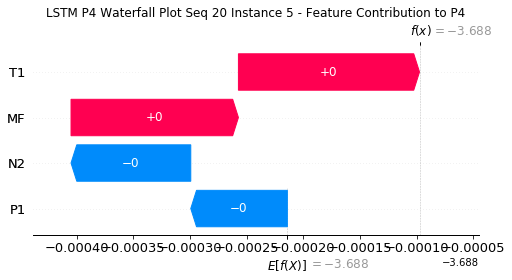

None

Contribution: [-7.44499632e-05  1.12049489e-04 -1.51564553e-04  9.53237361e-05]


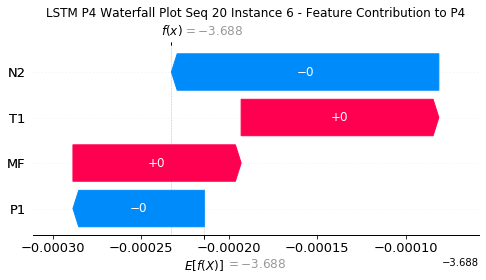

None

Contribution: [-1.26347740e-05  7.10135585e-05 -1.74738280e-04  9.35891603e-05]


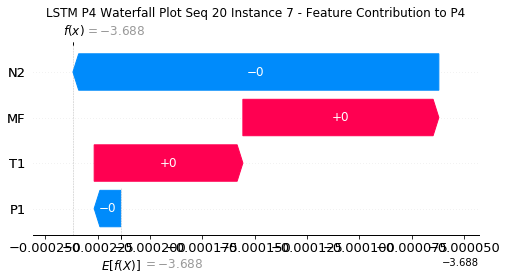

None

Contribution: [-2.63172370e-05  2.80590591e-05 -2.13807535e-04 -1.65673391e-05]


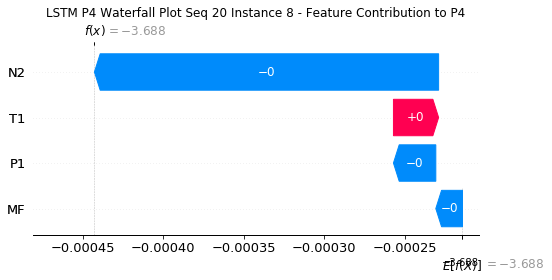

None

Contribution: [-4.60492887e-05  1.29520953e-05 -2.60002774e-04 -7.25086004e-05]


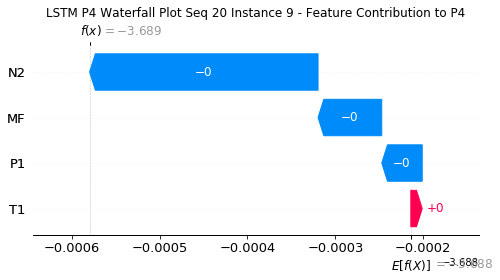

None

Contribution: [-3.00850075e-06 -1.90771878e-06 -2.79062687e-04 -5.86226099e-05]


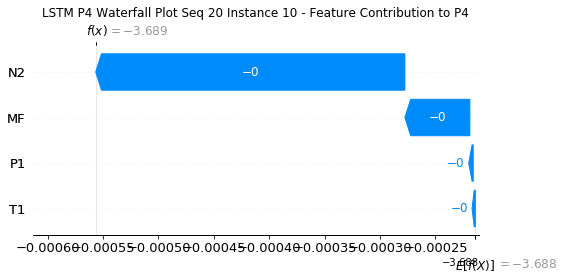

None

Contribution: [-8.38650756e-05  1.56349521e-06 -3.51089649e-04 -2.30939623e-04]


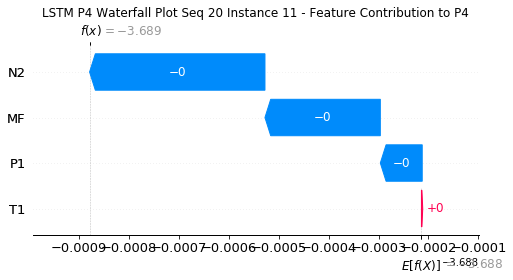

None

Contribution: [-9.82077212e-05 -6.76678126e-06 -4.12905401e-04 -2.97385988e-04]


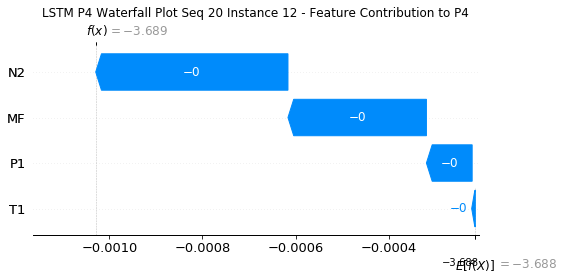

None

Contribution: [-1.05554533e-04  1.16141556e-05 -4.93936858e-04 -3.82601615e-04]


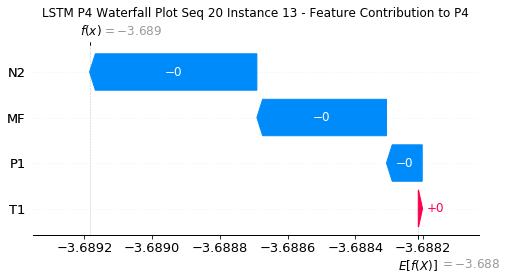

None

Contribution: [-1.95804824e-05 -6.46410588e-05 -5.12999990e-04 -2.77365093e-04]


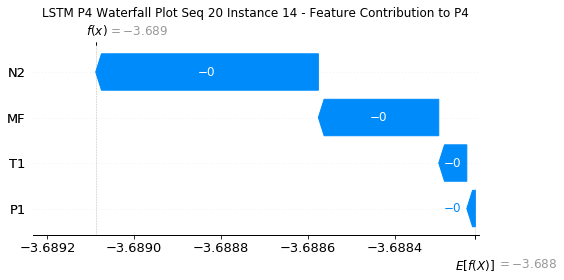

None

Contribution: [-1.20929084e-04  5.33104438e-05 -4.48460618e-04 -3.22948144e-04]


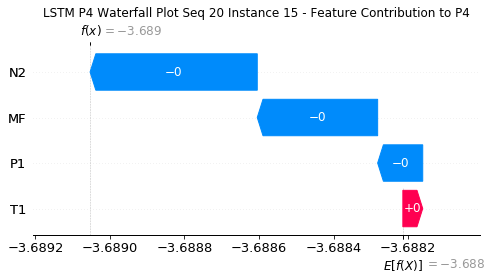

None

Contribution: [-1.11675069e-04  9.59563593e-05 -5.88971441e-04 -4.78548982e-04]


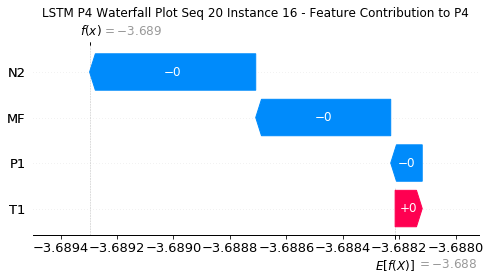

None

Contribution: [-0.00012799 -0.00038226 -0.00146327 -0.00101397]


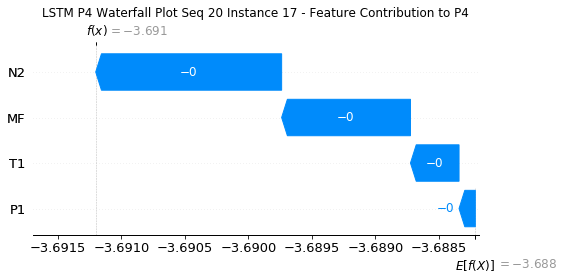

None

Contribution: [-0.00023935  0.00049172 -0.00092347 -0.00111996]


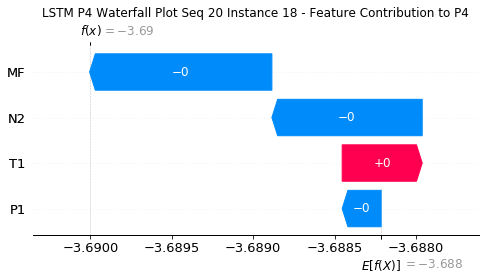

None

Contribution: [-1.02174118e-04  4.53987496e-05  1.69717481e-03  2.19986813e-03]


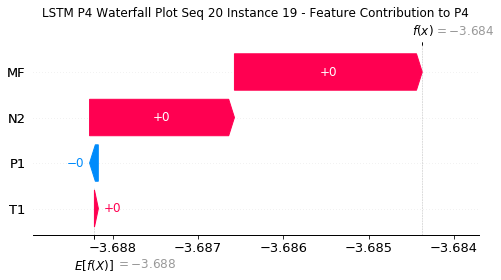

None

Contribution: [-0.00030463 -0.00360734 -0.00302324 -0.00156705]


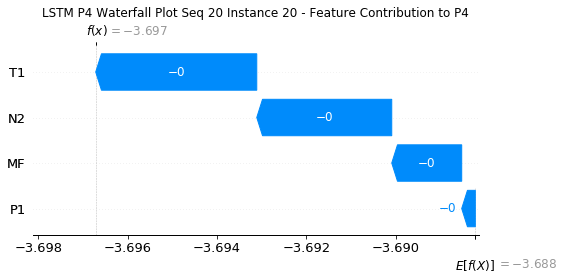

None

Contribution: [ 0.00070662  0.00554493 -0.00878074 -0.0135225 ]


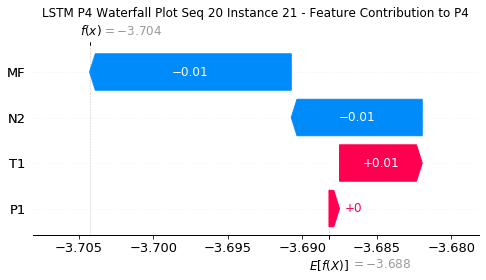

None

Contribution: [-0.00059467  0.00359734  0.00822191  0.00978382]


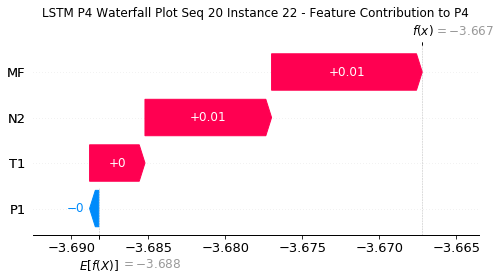

None

Contribution: [-0.00325528 -0.00897359  0.0087445   0.01709706]


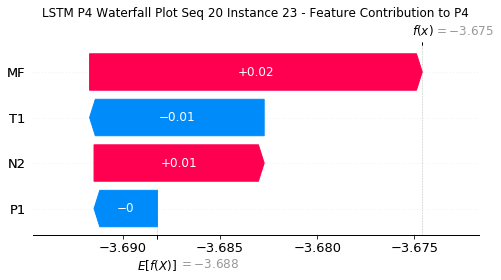

None

Contribution: [ 0.00303036  0.01205283 -0.03369191 -0.06083223]


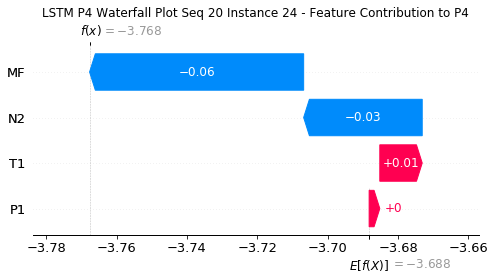

None

Contribution: [-0.000248   -0.00155005 -0.00209014 -0.00161221]


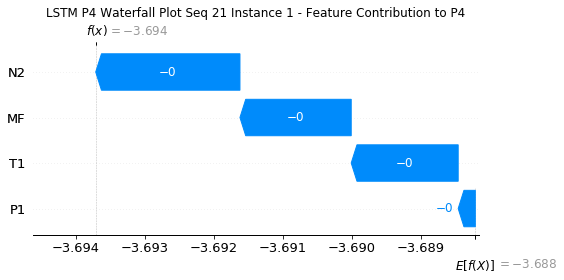

None

Contribution: [ 5.69777124e-05 -1.55244744e-04 -7.54975025e-05  5.36657435e-06]


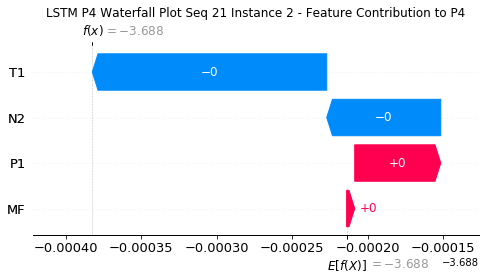

None

Contribution: [ 2.37000054e-05  1.86323062e-04 -7.26167507e-05  5.21482520e-06]


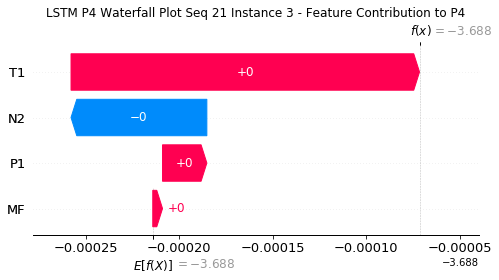

None

Contribution: [-1.42494539e-05  2.01317049e-04 -7.74907631e-05  1.13475957e-04]


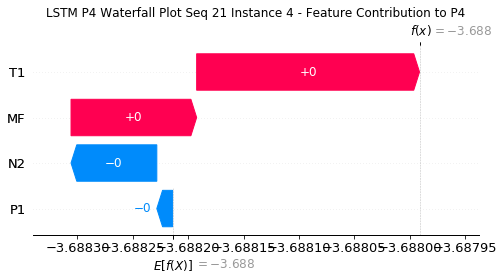

None

Contribution: [-0.00011357  0.00021585 -0.00012122  0.00018573]


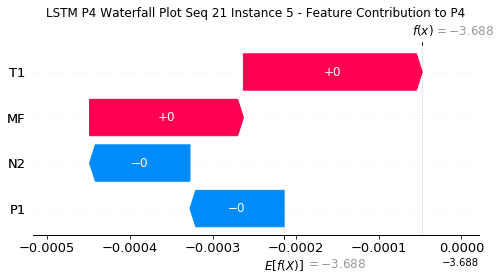

None

Contribution: [-6.47192086e-05  1.03618350e-04 -1.55138448e-04  7.20579484e-05]


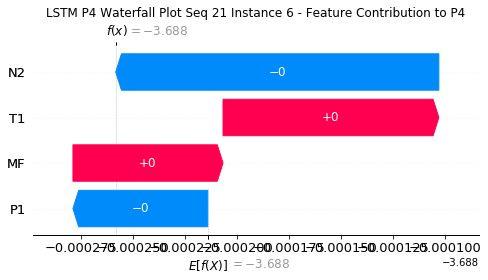

None

Contribution: [-4.12632014e-05  4.30164021e-05 -1.85582877e-04  7.25724647e-05]


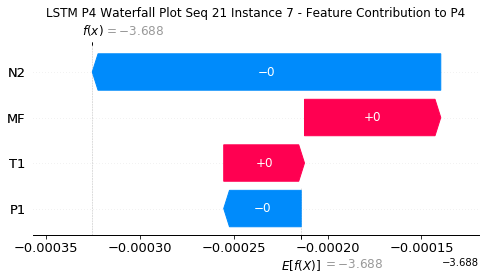

None

Contribution: [-3.51234002e-05 -4.24009569e-06 -2.17997619e-04  1.58132137e-05]


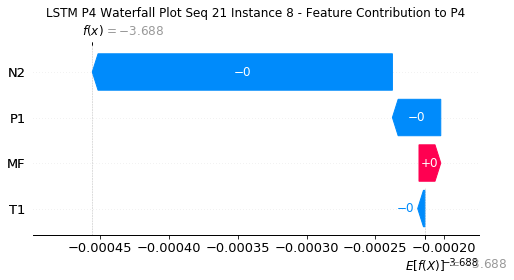

None

Contribution: [-4.40982880e-05 -1.00224452e-05 -2.65496072e-04 -7.75363586e-05]


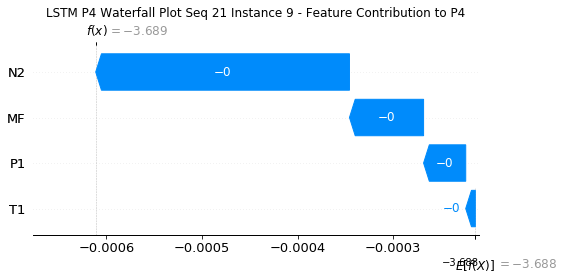

None

Contribution: [ 1.65787310e-05 -5.44656623e-06 -2.76479795e-04 -5.95508935e-05]


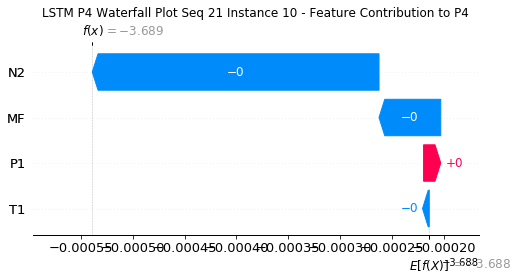

None

Contribution: [-7.05688262e-05 -5.84211047e-06 -3.50675545e-04 -2.33957155e-04]


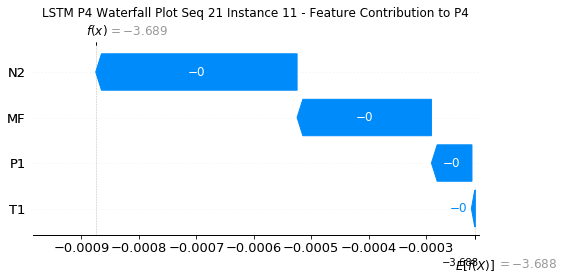

None

Contribution: [-1.09199777e-04  8.61842716e-06 -3.98293685e-04 -2.34437616e-04]


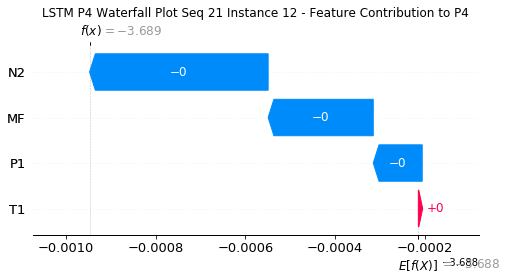

None

Contribution: [-9.58832101e-05  6.32659242e-06 -4.88833042e-04 -3.67228369e-04]


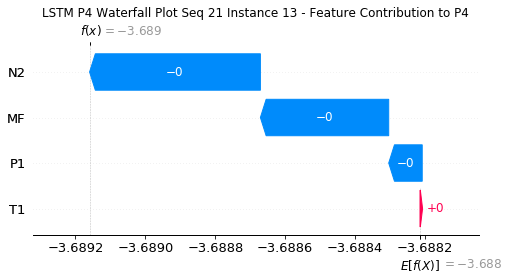

None

Contribution: [-4.46529023e-05 -7.33345652e-05 -5.04146920e-04 -2.24583564e-04]


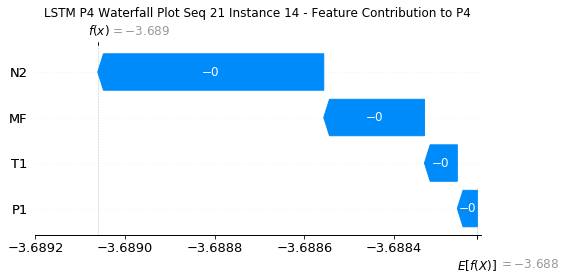

None

Contribution: [-1.41037383e-04  6.67931757e-05 -4.55442340e-04 -3.06081759e-04]


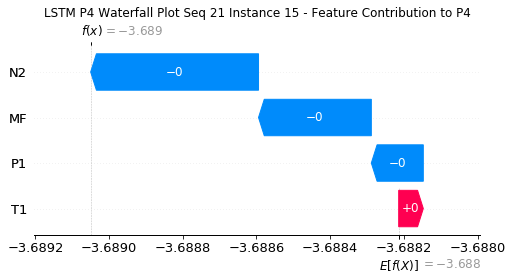

None

Contribution: [-0.000117    0.0001215  -0.00057736 -0.00046619]


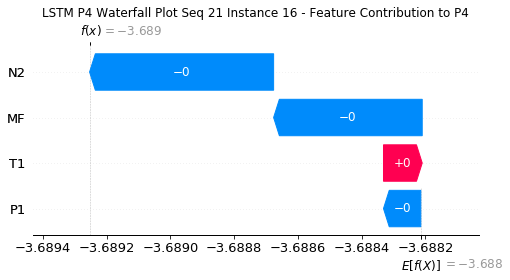

None

Contribution: [-0.00011917 -0.00039176 -0.00138498 -0.00093191]


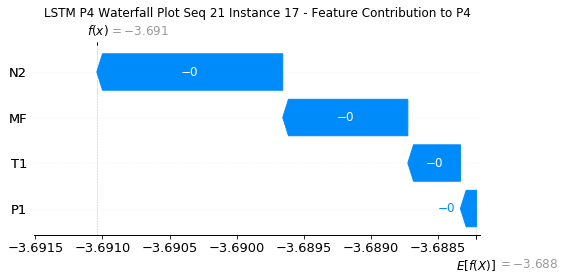

None

Contribution: [-0.00027802  0.00050202 -0.00102256 -0.00127609]


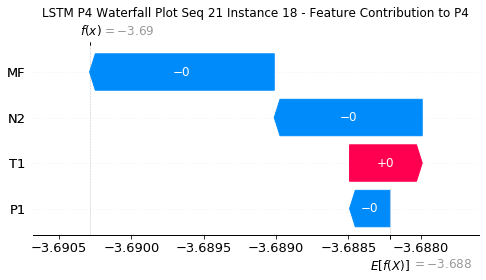

None

Contribution: [-0.00010344  0.00013612  0.00163657  0.00209487]


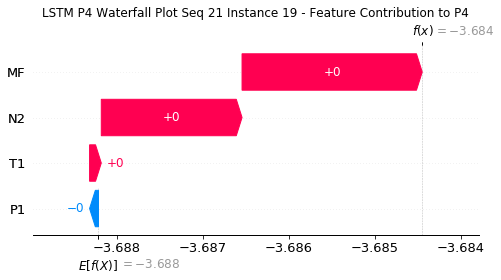

None

Contribution: [-0.00031695 -0.00405453 -0.00253947 -0.00080747]


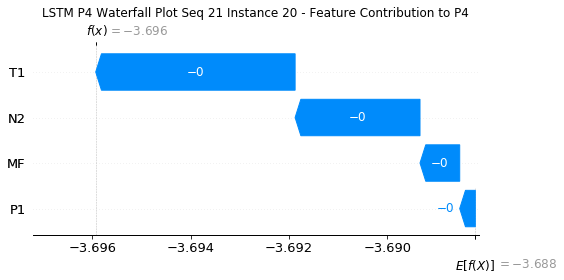

None

Contribution: [ 0.00072312  0.00660475 -0.00917502 -0.01387553]


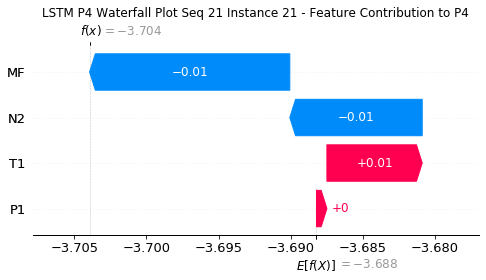

None

Contribution: [-0.00063242  0.004478    0.00794977  0.00910914]


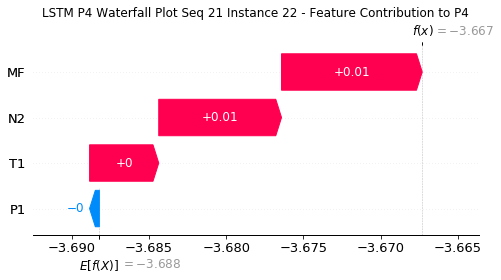

None

Contribution: [-0.0045422  -0.01455722  0.0106777   0.02840717]


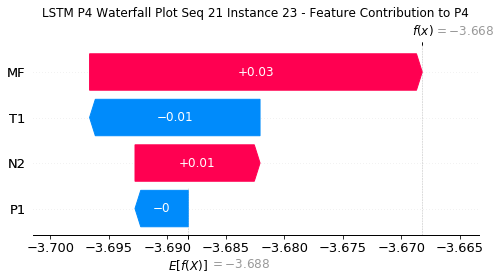

None

Contribution: [ 0.00433994  0.01781655 -0.03584131 -0.07160988]


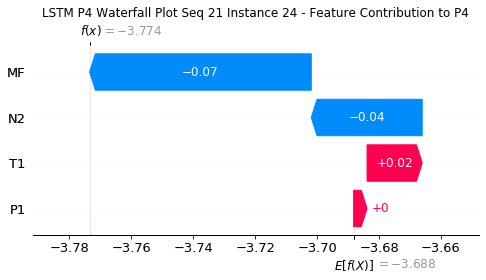

None

Contribution: [-0.00023319 -0.00213474 -0.0020363  -0.0011268 ]


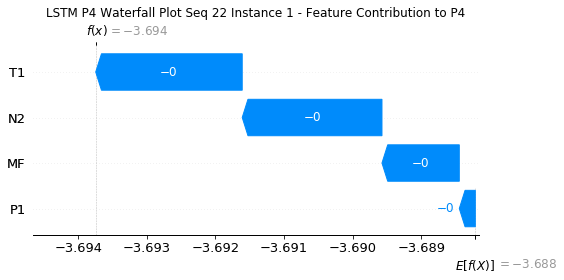

None

Contribution: [ 6.27293403e-05 -1.85356918e-04 -8.46783284e-05  1.69624102e-05]


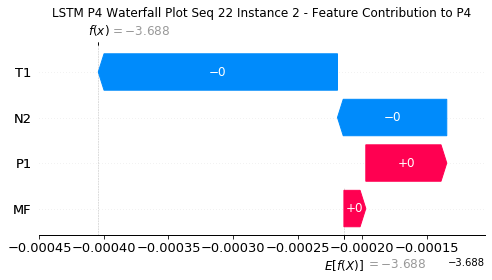

None

Contribution: [-9.11746487e-07  2.81616332e-04 -8.28012385e-05  4.59978800e-05]


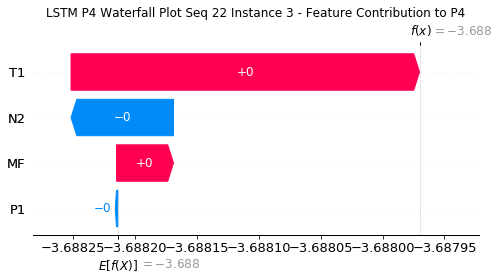

None

Contribution: [-2.51270913e-05  2.45229382e-04 -1.04276822e-04  1.59509920e-04]


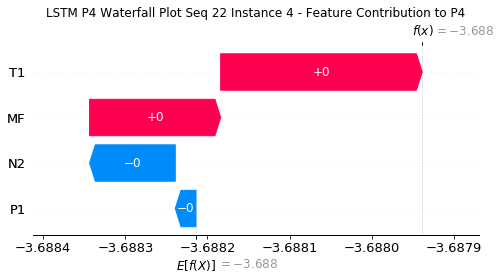

None

Contribution: [-5.66689364e-05  2.06040462e-04 -1.38107351e-04  2.00703829e-04]


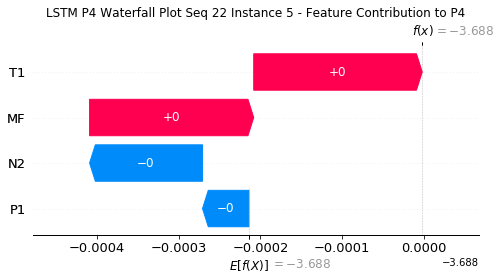

None

Contribution: [-9.71017020e-05  1.16864434e-04 -1.72229046e-04  6.73704766e-05]


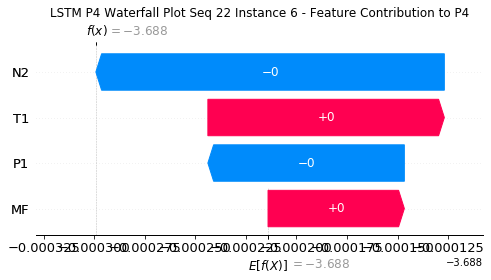

None

Contribution: [-1.24657732e-05  6.65474750e-05 -1.91840861e-04  1.12782761e-04]


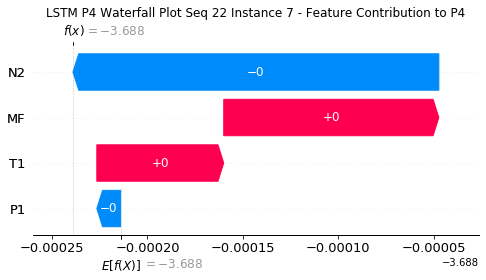

None

Contribution: [-3.63705904e-05  3.32800594e-06 -2.17262463e-04  9.64968090e-05]


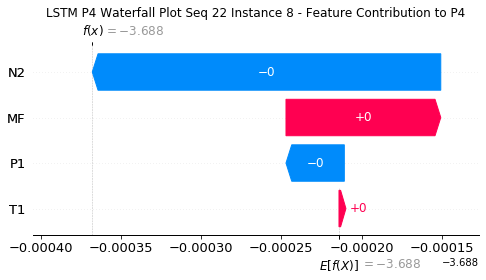

None

Contribution: [-6.22890943e-05  4.75558671e-06 -2.67391598e-04 -2.32318158e-05]


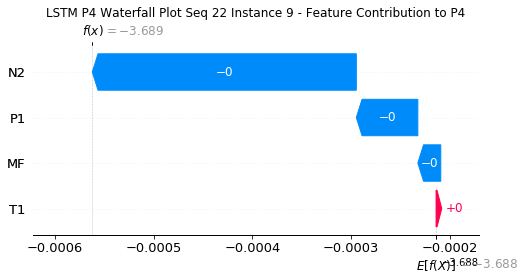

None

Contribution: [ 5.35317948e-06 -1.00361638e-05 -2.75698862e-04  1.28482880e-05]


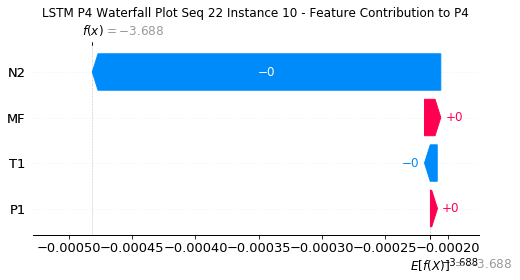

None

Contribution: [-7.43832553e-05 -5.77148676e-07 -3.51560404e-04 -1.88365190e-04]


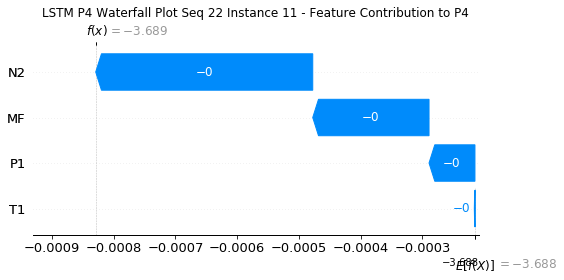

None

Contribution: [-8.16711367e-05  8.38583079e-06 -4.03530403e-04 -2.40379708e-04]


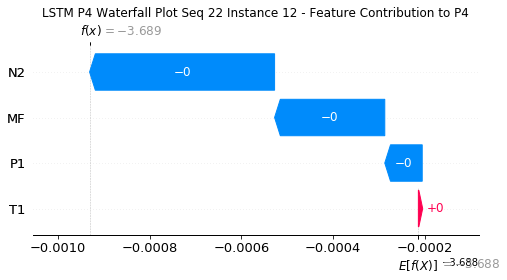

None

Contribution: [-1.28192036e-04  7.37783303e-06 -4.82537985e-04 -2.78316847e-04]


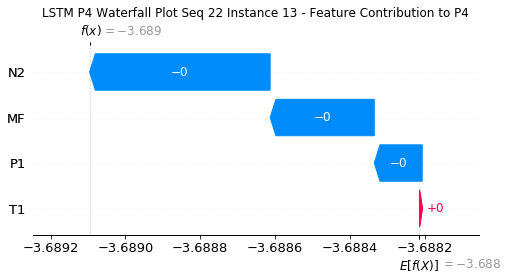

None

Contribution: [-2.61427049e-05 -6.72812013e-05 -5.04852592e-04 -1.85497496e-04]


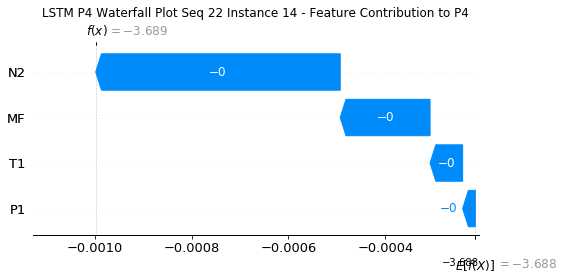

None

Contribution: [-1.06086468e-04  4.03121342e-05 -4.49729825e-04 -3.13177128e-04]


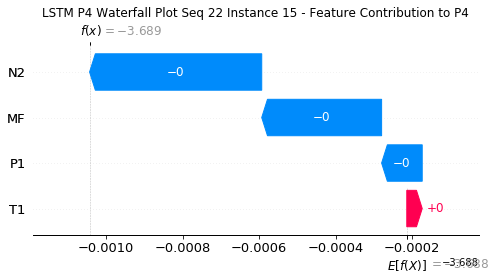

None

Contribution: [-1.10841276e-04  6.92046432e-05 -5.77087154e-04 -4.63769695e-04]


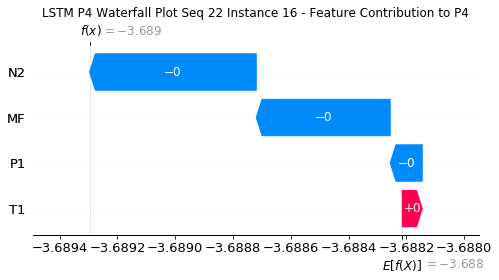

None

Contribution: [-0.00011431 -0.00037294 -0.00140006 -0.00081598]


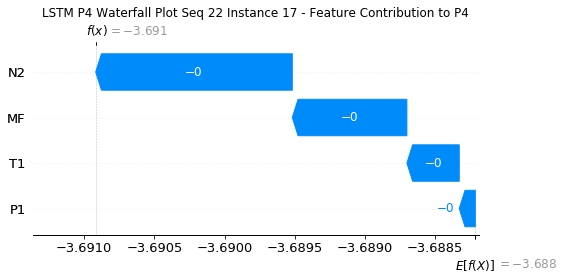

None

Contribution: [-0.00031877  0.00037265 -0.00096766 -0.00129085]


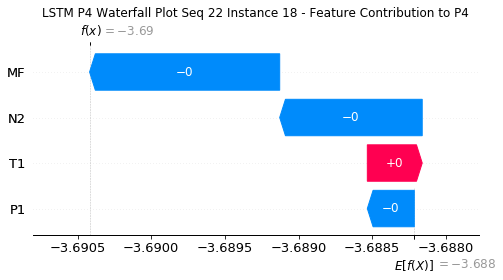

None

Contribution: [-9.10538869e-05  6.04543780e-05  1.65151429e-03  2.07971090e-03]


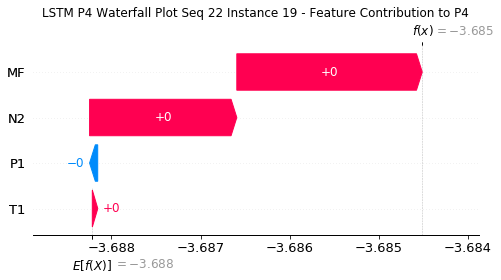

None

Contribution: [-0.00032499 -0.00326201 -0.00254669  0.00033982]


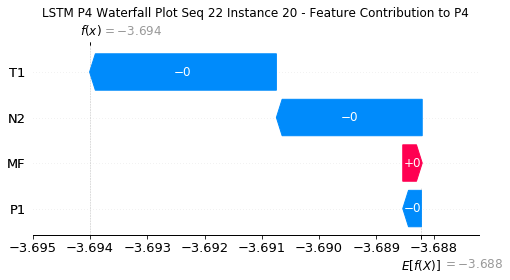

None

Contribution: [ 0.00070839  0.00503398 -0.00924584 -0.01563476]


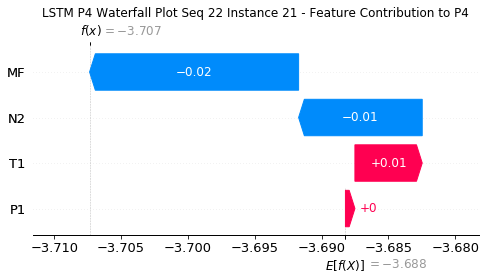

None

Contribution: [-0.00052818  0.00336146  0.00799313  0.00863955]


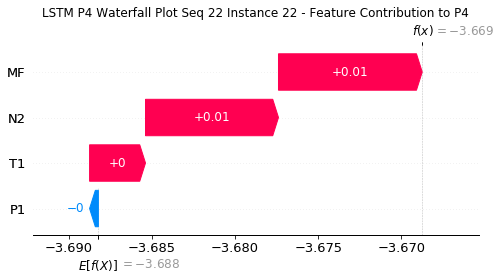

None

Contribution: [-0.0030422  -0.01162881  0.0102284   0.0330095 ]


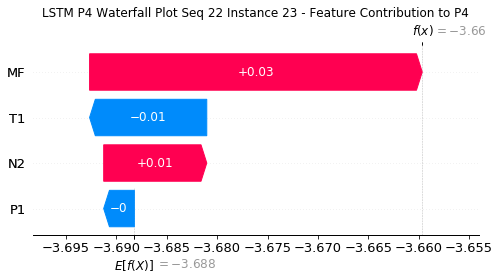

None

Contribution: [ 2.41955483e-05  1.75921980e-02 -3.25131216e-02 -5.57982652e-02]


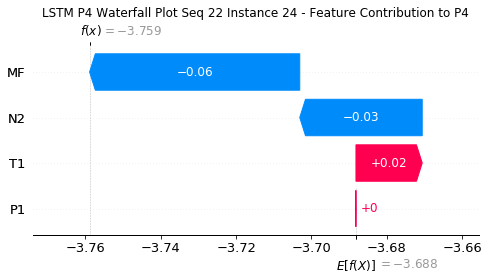

None

Contribution: [-0.00019628 -0.001784   -0.00197275 -0.00098676]


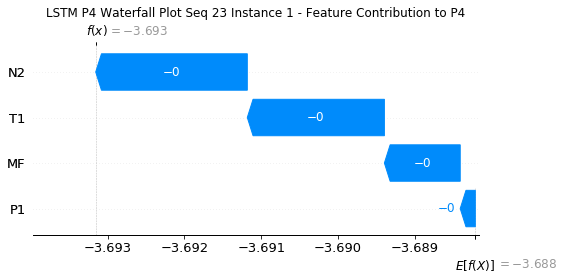

None

Contribution: [ 6.05247717e-05 -1.68590932e-04 -7.57730455e-05  7.78412449e-06]


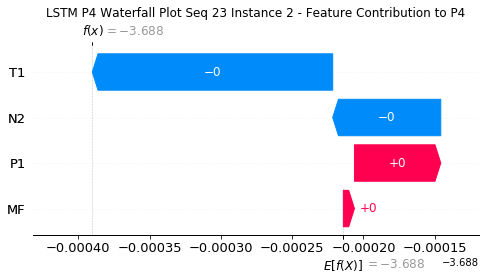

None

Contribution: [-1.57384026e-05  2.04031818e-04 -7.04317952e-05  4.13069434e-05]


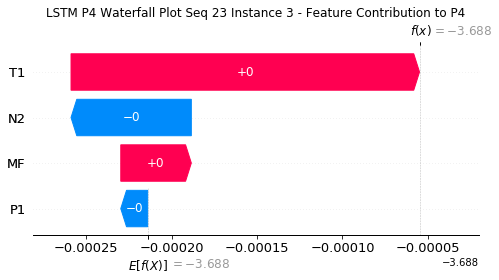

None

Contribution: [-3.99438750e-05  2.08993286e-04 -7.14257326e-05  1.26824319e-04]


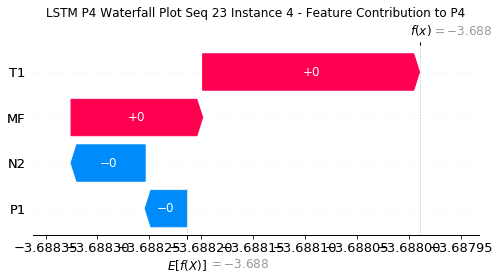

None

Contribution: [-7.29512840e-05  1.72169287e-04 -1.02928497e-04  1.56935243e-04]


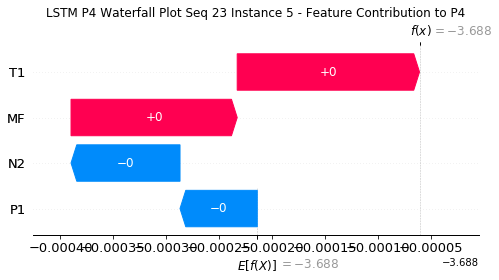

None

Contribution: [-0.00013834  0.00010544 -0.00014052  0.00013196]


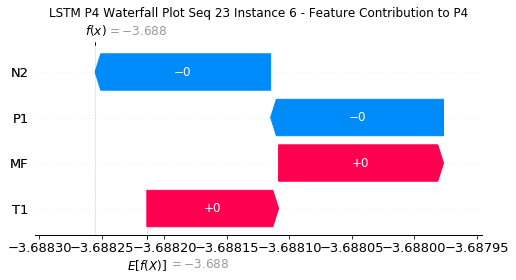

None

Contribution: [-2.81763755e-05  5.60589151e-05 -1.71838168e-04  7.16710008e-05]


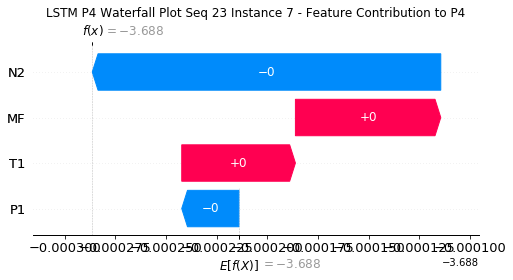

None

Contribution: [-5.70802468e-05  2.59820749e-05 -2.07503056e-04  4.37420113e-05]


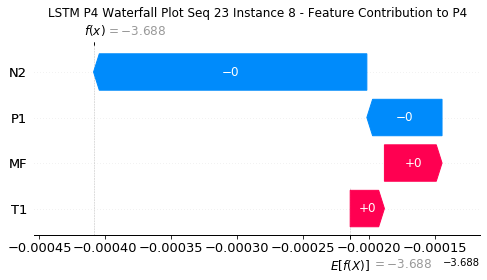

None

Contribution: [-5.99152391e-05 -3.79793321e-06 -2.61306956e-04 -1.05383768e-04]


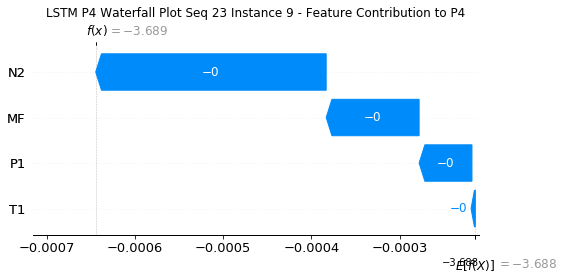

None

Contribution: [-1.65597897e-05 -1.16900077e-05 -2.67703746e-04  1.84251342e-06]


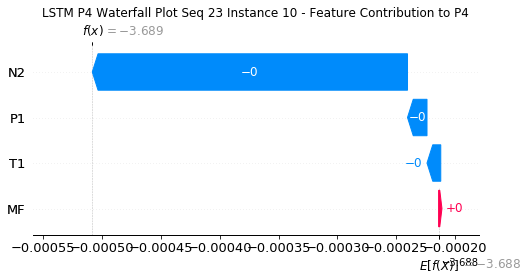

None

Contribution: [-8.92456543e-05 -7.77834167e-06 -3.45277629e-04 -2.08393059e-04]


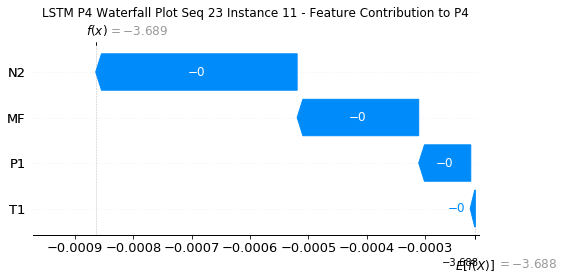

None

Contribution: [-9.39022826e-05  7.42107722e-06 -3.99356778e-04 -2.66789303e-04]


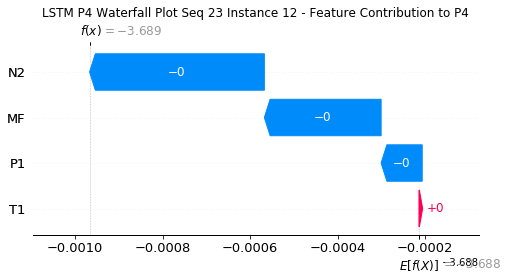

None

Contribution: [-1.22272847e-04 -1.35408339e-06 -4.87805936e-04 -3.61531157e-04]


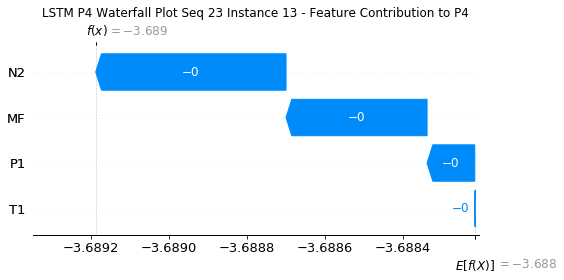

None

Contribution: [-4.06340733e-05 -6.93370505e-05 -4.96208389e-04 -2.17850743e-04]


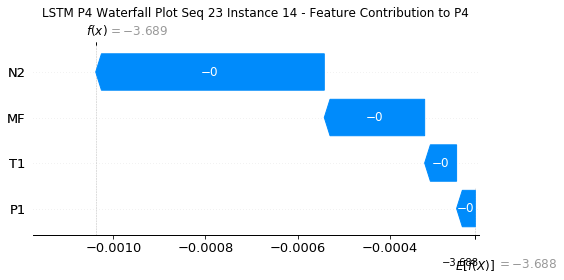

None

Contribution: [-1.31750520e-04  4.99439227e-05 -4.48089469e-04 -3.46783444e-04]


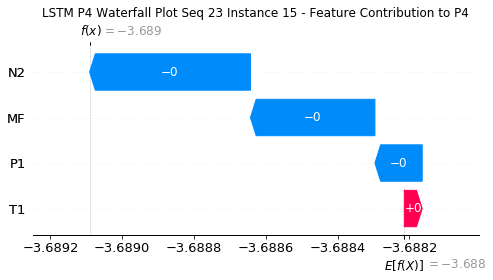

None

Contribution: [-1.15565448e-04  7.53256161e-05 -5.85929652e-04 -4.74520751e-04]


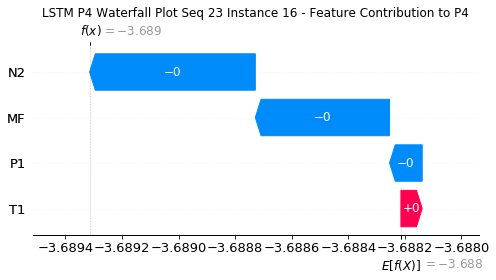

None

Contribution: [-0.00012099 -0.00037264 -0.0014072  -0.0009885 ]


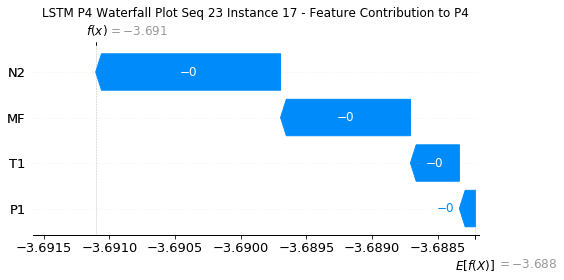

None

Contribution: [-0.00024527  0.00046601 -0.00095782 -0.00102476]


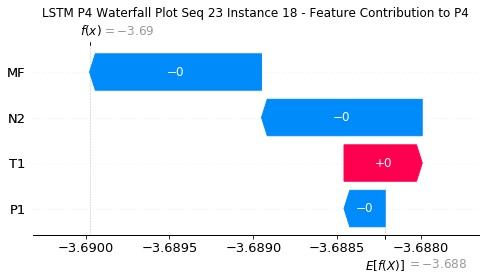

None

Contribution: [-8.12738190e-05  4.88214042e-05  1.67957835e-03  2.18766359e-03]


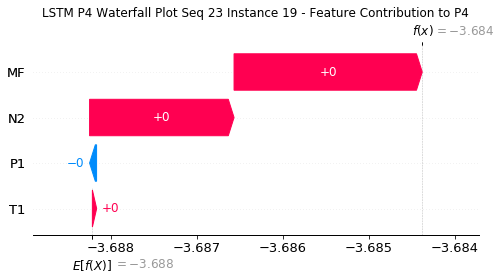

None

Contribution: [-0.00033382 -0.00345698 -0.00254275 -0.00101156]


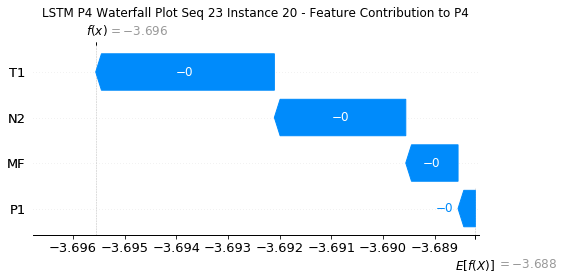

None

Contribution: [ 0.00067275  0.00528699 -0.00943034 -0.01351478]


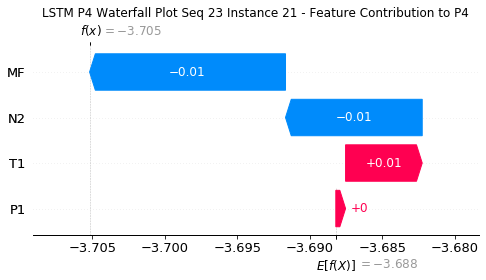

None

Contribution: [-0.00022354  0.00341377  0.00804812  0.00924304]


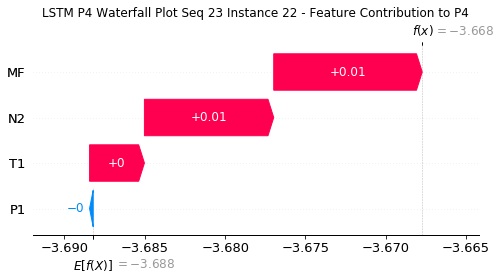

None

Contribution: [-0.00710494 -0.0111273   0.01120456  0.03023687]


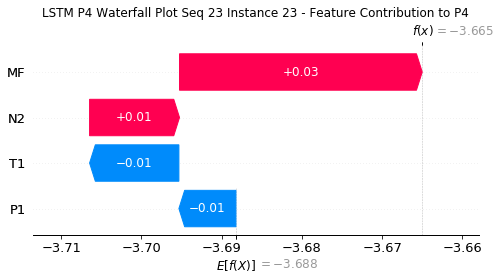

None

Contribution: [ 0.00514284  0.01563261 -0.03552083 -0.06844673]


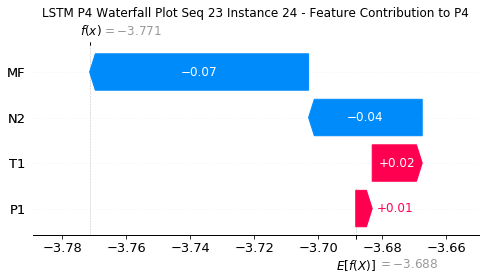

None

Contribution: [-0.00016502 -0.00184449 -0.00198299 -0.00133694]


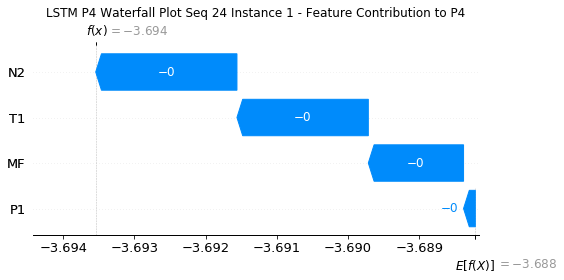

None

Contribution: [ 5.30860350e-05 -1.69678696e-04 -7.49143567e-05 -1.77459009e-05]


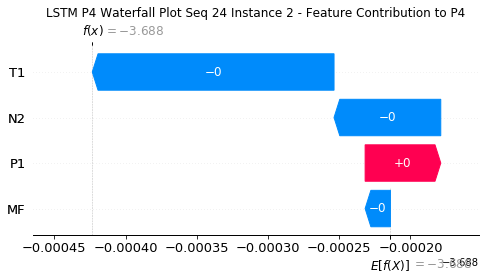

None

Contribution: [ 4.69676287e-07  2.22303091e-04 -6.98281624e-05  9.07502043e-06]


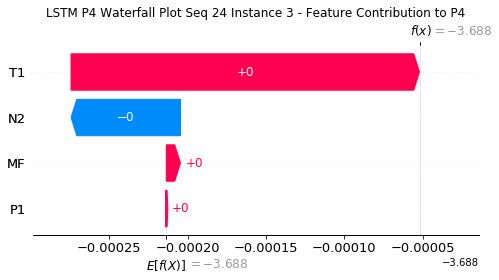

None

Contribution: [-5.02145076e-05  2.50939861e-04 -6.44170323e-05  1.44382169e-04]


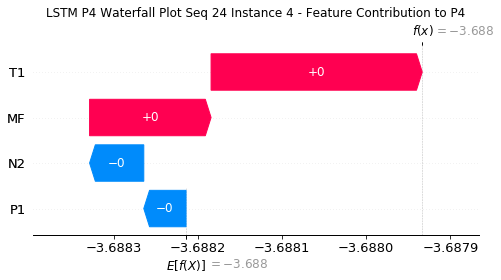

None

Contribution: [-8.23880242e-05  2.01280562e-04 -9.84428460e-05  1.57882389e-04]


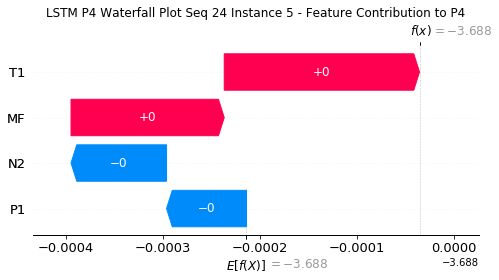

None

Contribution: [-0.00011222  0.00013892 -0.0001413   0.00015478]


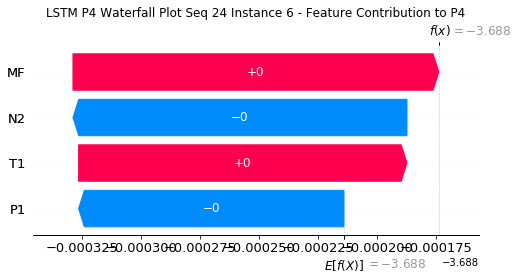

None

Contribution: [-3.06324172e-05  7.25150711e-05 -1.69702996e-04  6.80250905e-05]


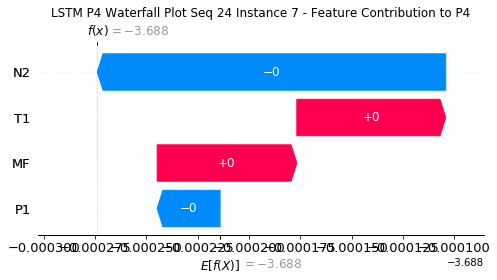

None

Contribution: [-4.08828020e-05  4.65137930e-05 -2.04834267e-04  3.02861667e-05]


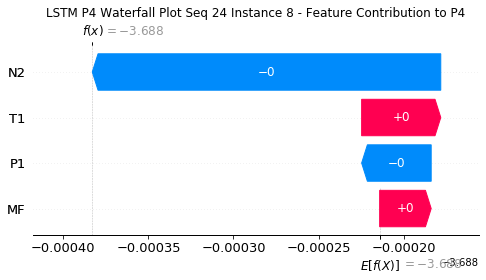

None

Contribution: [-4.38377115e-05  2.70618656e-05 -2.59230404e-04 -8.73028277e-05]


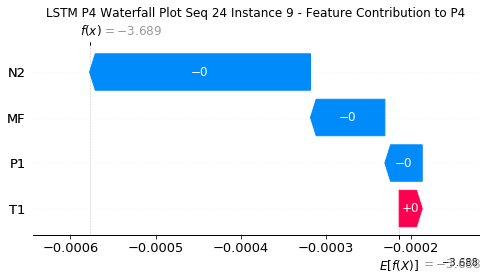

None

Contribution: [-1.69097355e-05  1.09467502e-05 -2.68109323e-04 -3.85899983e-05]


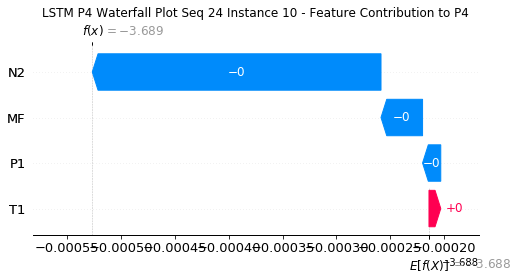

None

Contribution: [-9.58753583e-05 -5.71472195e-06 -3.39939263e-04 -2.00053863e-04]


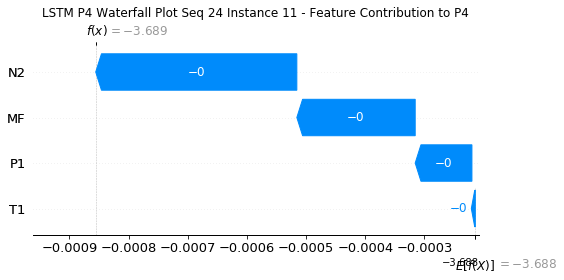

None

Contribution: [-9.93746273e-05  9.00808050e-06 -3.94674041e-04 -2.53032828e-04]


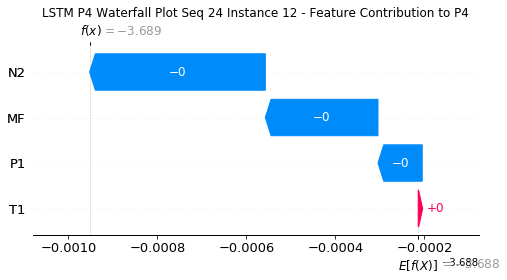

None

Contribution: [-1.18484699e-04 -1.20888723e-05 -4.84106039e-04 -3.44085936e-04]


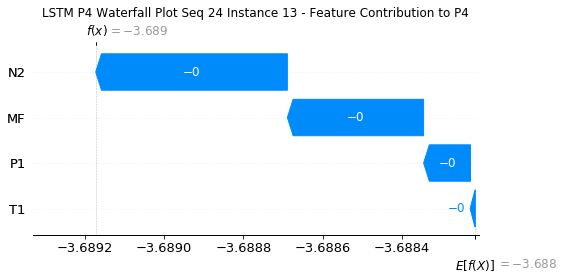

None

Contribution: [-5.10471481e-05 -7.62328101e-05 -4.87636309e-04 -1.85509027e-04]


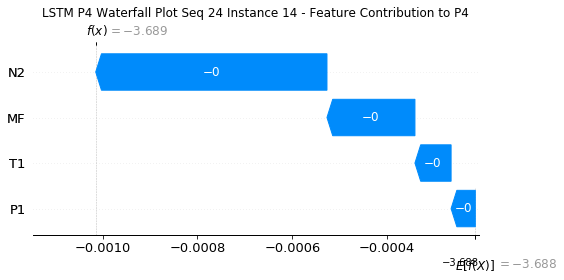

None

Contribution: [-1.29266555e-04  1.73172786e-05 -4.34880724e-04 -2.98524774e-04]


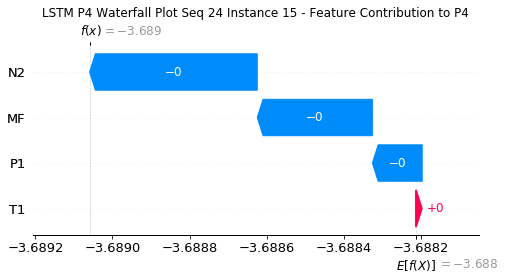

None

Contribution: [-1.20951121e-04  4.71389351e-05 -5.87181228e-04 -4.67757218e-04]


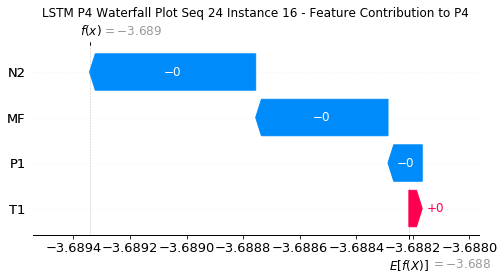

None

Contribution: [-0.00012297 -0.00035372 -0.00140639 -0.00093222]


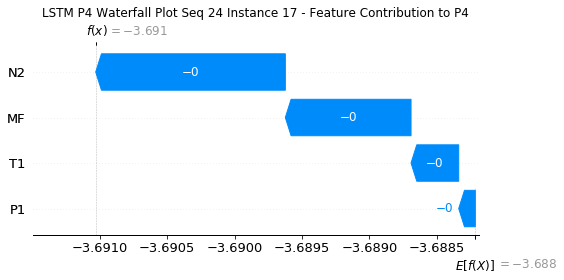

None

Contribution: [-0.0002983   0.00023789 -0.00092844 -0.00122322]


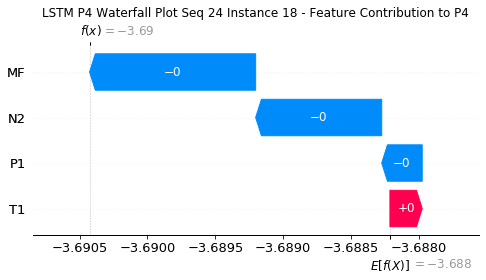

None

Contribution: [-7.57636930e-05  1.23738203e-06  1.69312309e-03  2.18544582e-03]


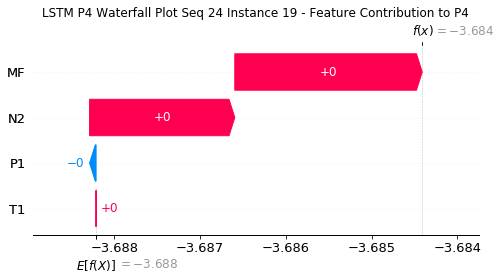

None

Contribution: [-0.00033028 -0.00281677 -0.00260728 -0.0003523 ]


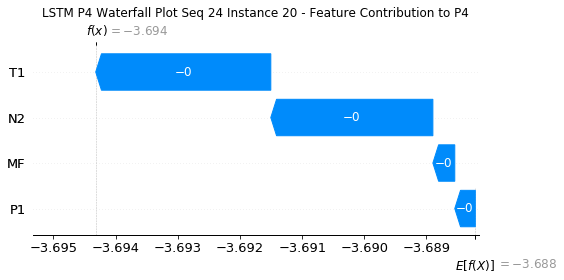

None

Contribution: [ 0.00065601  0.00398887 -0.0094218  -0.015364  ]


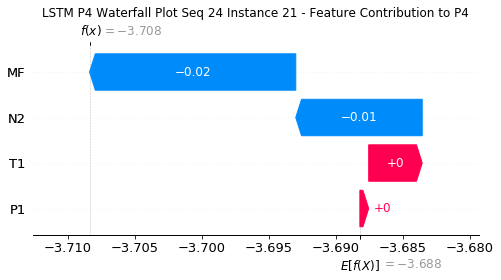

None

Contribution: [-6.09034902e-05  2.56039212e-03  8.12205967e-03  9.13797030e-03]


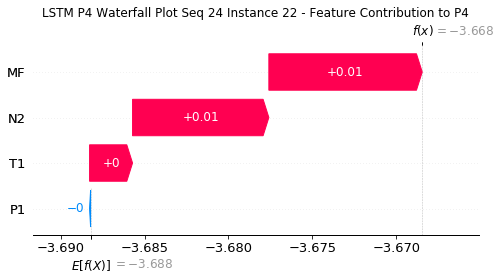

None

Contribution: [-0.00811358 -0.00862899  0.01123056  0.03811566]


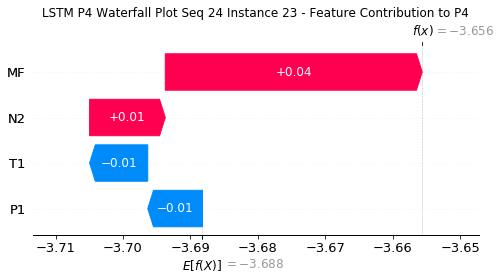

None

Contribution: [ 0.00155305  0.01468723 -0.03324916 -0.05383531]


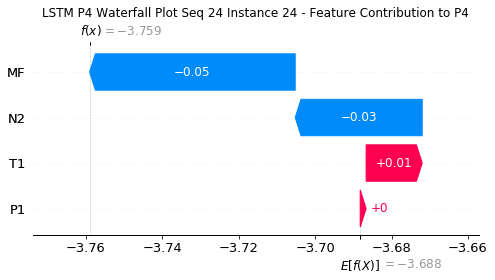

None

Contribution: [-0.00034471 -0.00153166 -0.00211913 -0.00192264]


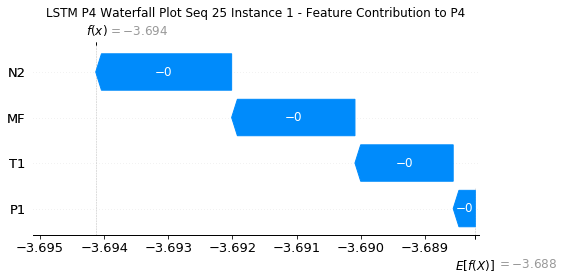

None

Contribution: [ 6.32922061e-05 -1.56115144e-04 -7.78400931e-05 -3.69290975e-05]


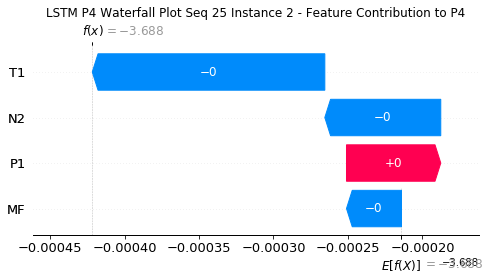

None

Contribution: [ 1.12535338e-05  1.64591276e-04 -6.67136182e-05  1.22247018e-05]


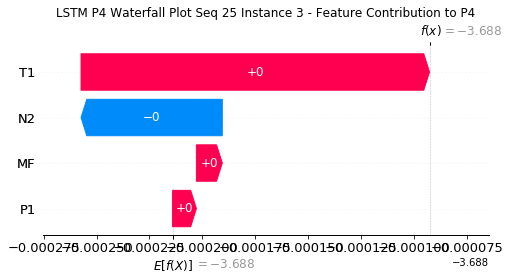

None

Contribution: [-5.72305218e-05  1.90184863e-04 -5.84800320e-05  2.03031501e-04]


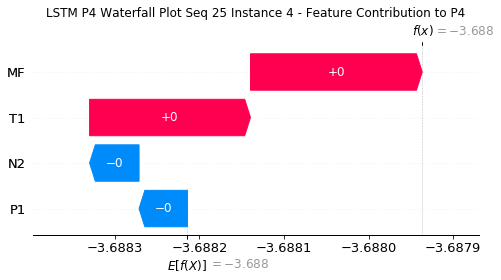

None

Contribution: [-8.71669078e-05  1.57659366e-04 -9.33300821e-05  2.09603831e-04]


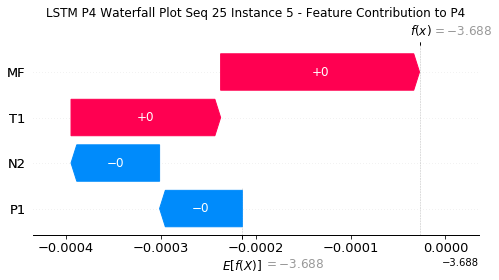

None

Contribution: [ 8.61914184e-07  1.19061320e-04 -1.54144189e-04 -4.24726331e-05]


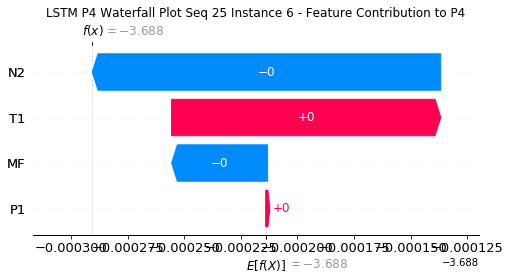

None

Contribution: [-3.17596043e-05  4.15398595e-05 -1.63649232e-04  9.86434969e-05]


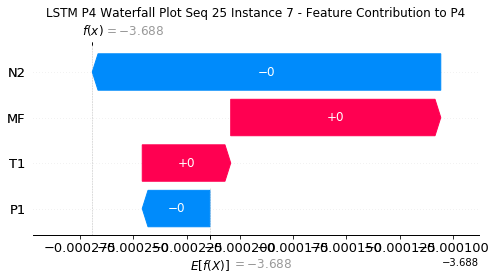

None

Contribution: [-2.74281774e-05  1.61338459e-05 -2.06512080e-04  4.02570955e-06]


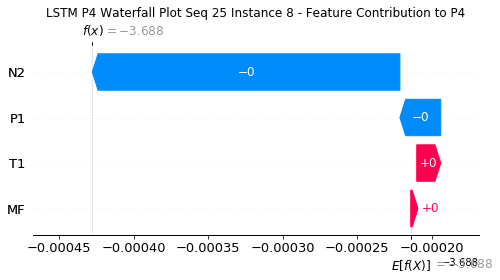

None

Contribution: [-4.21036178e-05  1.66346674e-06 -2.58105497e-04 -8.26680074e-05]


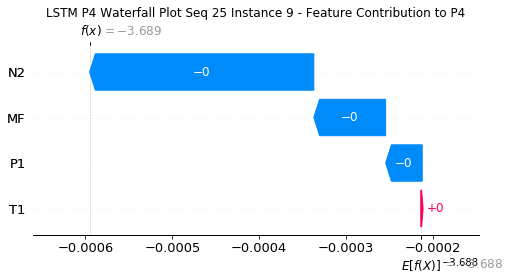

None

Contribution: [-1.83159607e-05 -1.63111220e-05 -2.67918599e-04 -4.50542543e-05]


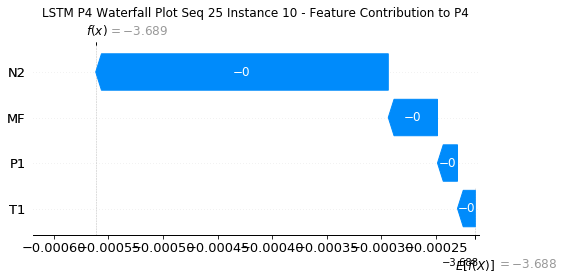

None

Contribution: [-7.66048525e-05 -1.34344647e-05 -3.43204435e-04 -2.23066443e-04]


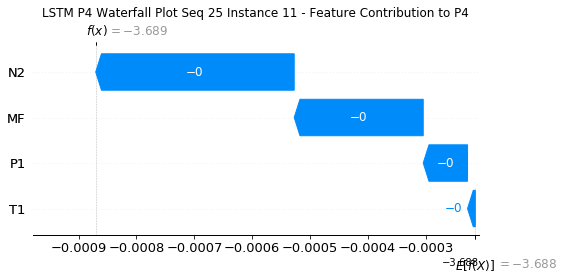

None

Contribution: [-7.95292149e-05  4.25668462e-07 -3.96461688e-04 -2.72192430e-04]


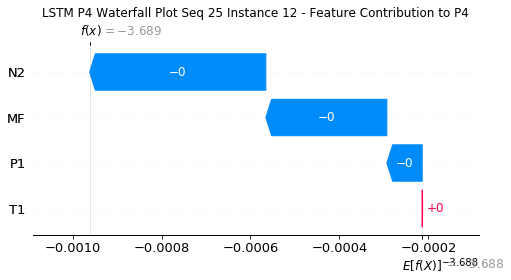

None

Contribution: [-7.91591933e-05 -8.38885165e-06 -4.86737472e-04 -3.80960541e-04]


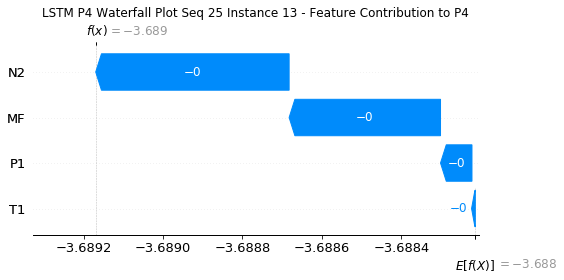

None

Contribution: [-2.56325741e-05 -8.32355517e-05 -4.94800928e-04 -2.25632783e-04]


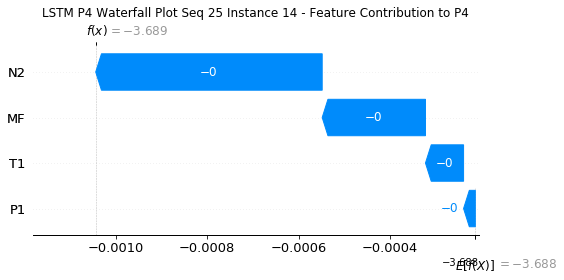

None

Contribution: [-1.46653267e-04  1.42856081e-05 -4.36169325e-04 -2.95639754e-04]


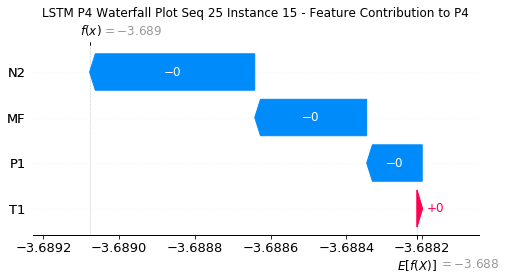

None

Contribution: [-1.01995268e-04  3.72513012e-05 -5.86996087e-04 -4.68957924e-04]


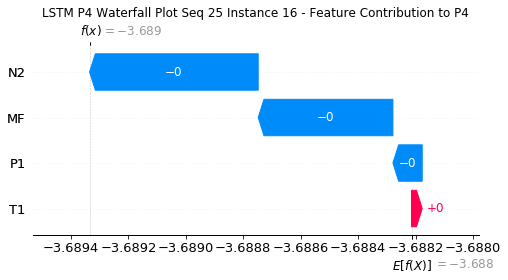

None

Contribution: [-0.00010615 -0.00034926 -0.0014084  -0.00098414]


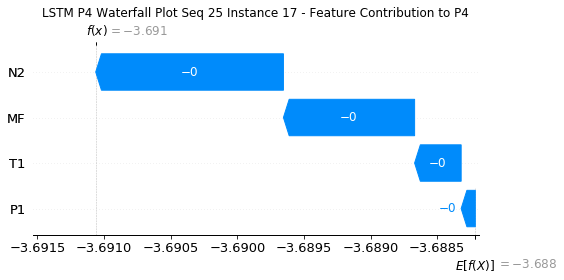

None

Contribution: [-0.00028999  0.00015061 -0.00097408 -0.00134489]


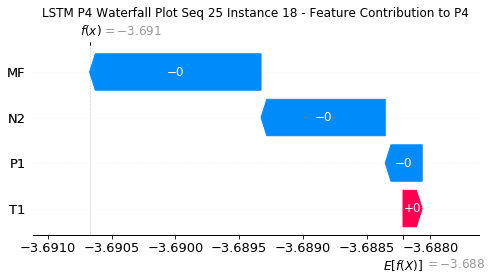

None

Contribution: [-9.29464956e-05 -1.58729550e-05  1.68198948e-03  2.17498772e-03]


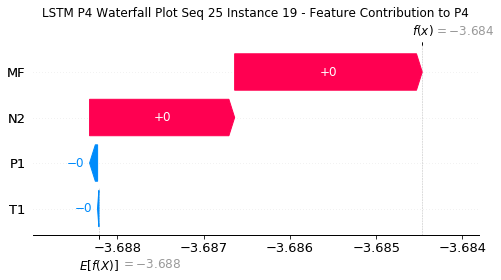

None

Contribution: [-3.18813405e-04 -2.42789140e-03 -2.48795768e-03  4.29292202e-05]


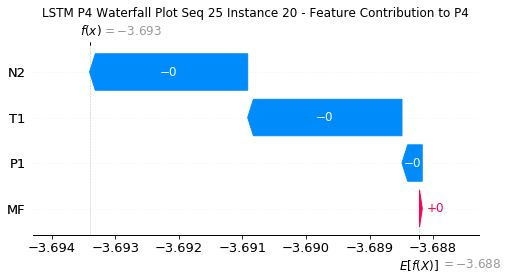

None

Contribution: [ 0.00067611  0.00318037 -0.00968136 -0.01627574]


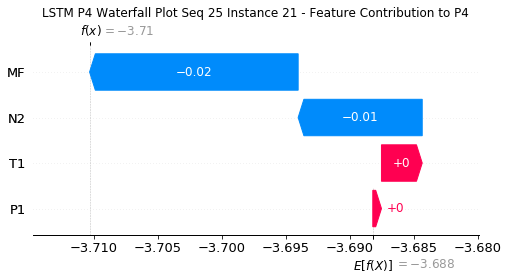

None

Contribution: [-0.0002419   0.00224543  0.0080858   0.00899614]


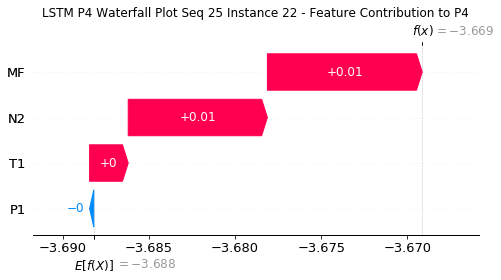

None

Contribution: [-0.0071103  -0.00666649  0.0120471   0.0393714 ]


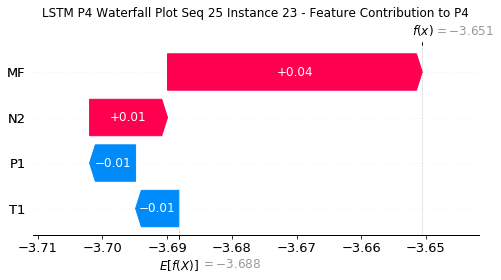

None

Contribution: [ 0.00356125  0.00911901 -0.03607879 -0.06703719]


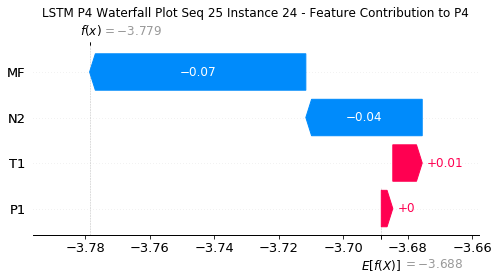

None

Contribution: [-0.00016344 -0.00126374 -0.00193235 -0.0011549 ]


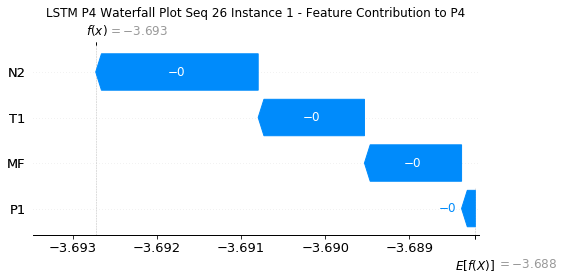

None

Contribution: [ 5.47968440e-05 -1.42523751e-04 -7.20253877e-05  5.66075052e-06]


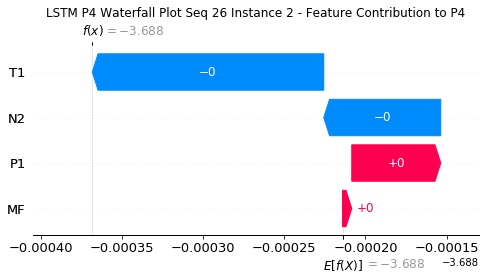

None

Contribution: [-4.41606663e-06  1.16118890e-04 -6.61139196e-05  3.86576704e-05]


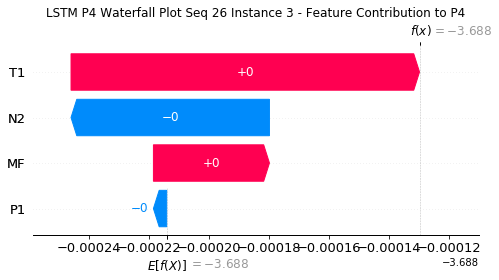

None

Contribution: [ 1.91505048e-06  1.57236782e-04 -6.86537862e-05  9.82813639e-05]


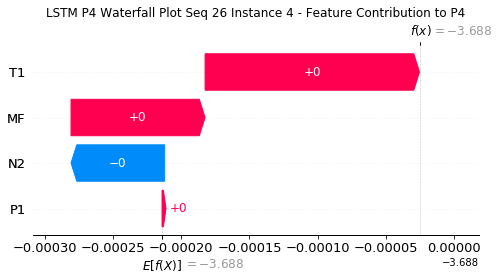

None

Contribution: [-3.38164317e-05  1.25900315e-04 -1.01017629e-04  1.23197233e-04]


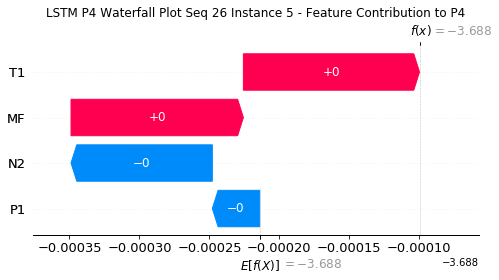

None

Contribution: [-7.91932838e-05  7.07337345e-05 -1.37873935e-04  1.38408895e-04]


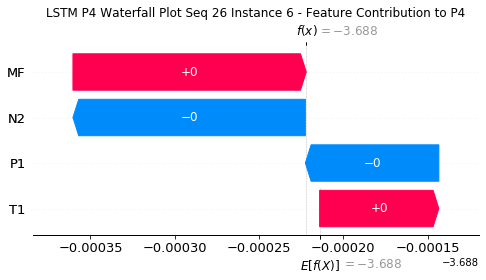

None

Contribution: [-1.43897306e-07  2.93969320e-05 -1.70784949e-04  5.75661529e-05]


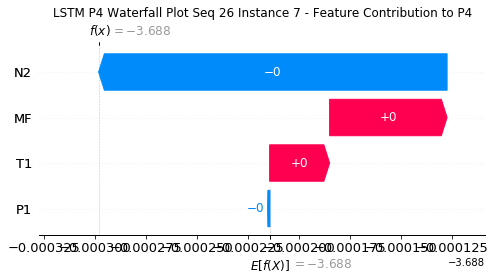

None

Contribution: [-3.05698020e-05  5.09680609e-06 -2.03960811e-04  4.08566947e-05]


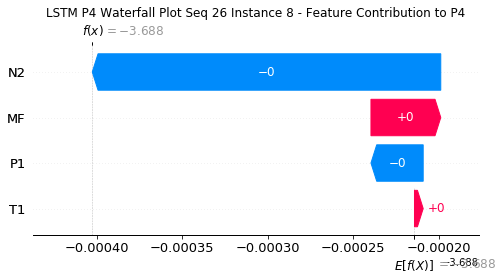

None

Contribution: [-9.28297886e-05 -5.23362476e-06 -2.51113678e-04 -1.49039976e-06]


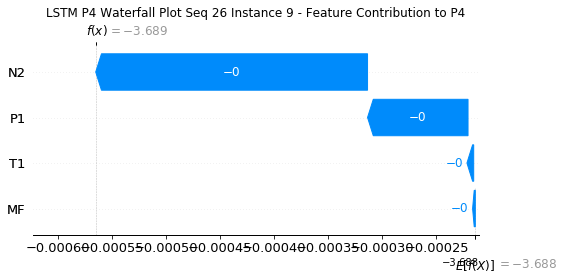

None

Contribution: [-2.59163153e-05 -2.48792492e-05 -2.66715380e-04  9.09481609e-07]


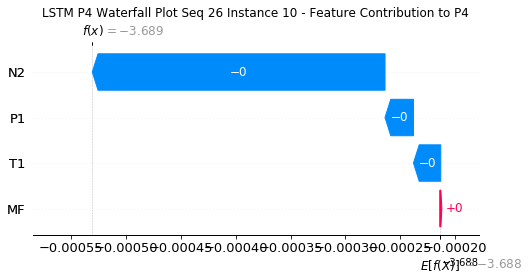

None

Contribution: [-7.61723408e-05 -2.25366678e-05 -3.42770561e-04 -2.00168582e-04]


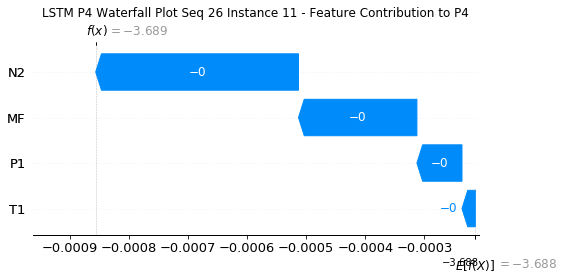

None

Contribution: [-7.69077757e-05 -9.59668109e-06 -3.97462184e-04 -2.59175232e-04]


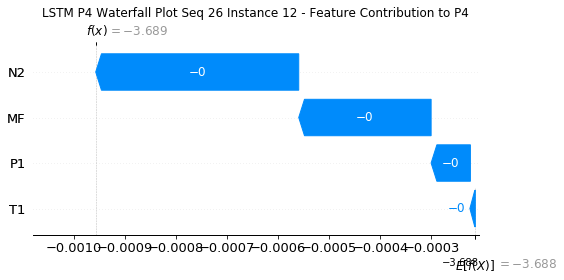

None

Contribution: [-1.20347191e-04 -4.27229864e-05 -4.82755239e-04 -3.25577527e-04]


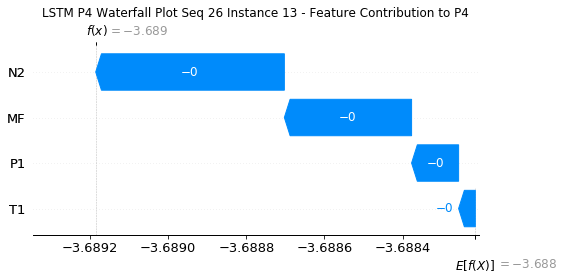

None

Contribution: [-2.83493012e-05 -8.82740585e-05 -4.94148689e-04 -1.85355100e-04]


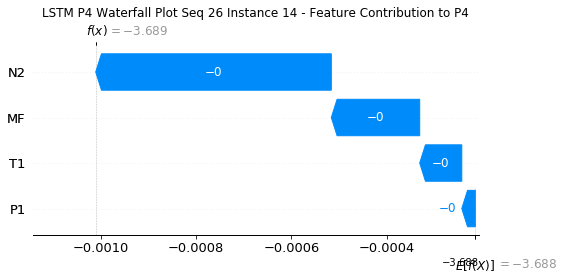

None

Contribution: [-1.25474110e-04 -3.88829459e-06 -4.41022848e-04 -2.96150722e-04]


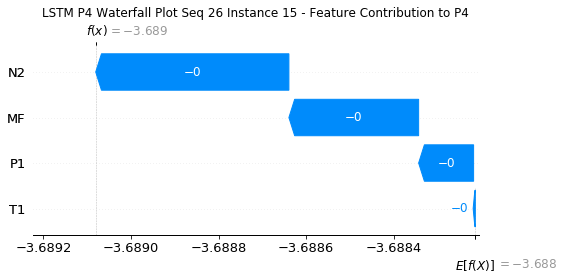

None

Contribution: [-1.07401094e-04  3.49740744e-05 -5.81146680e-04 -4.62625762e-04]


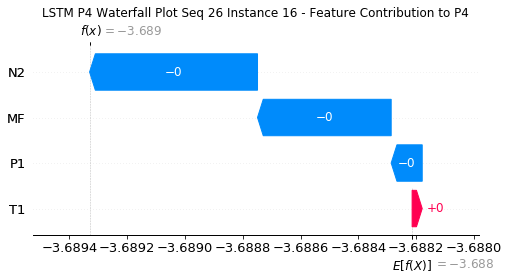

None

Contribution: [-0.00011143 -0.0003531  -0.00140336 -0.00088142]


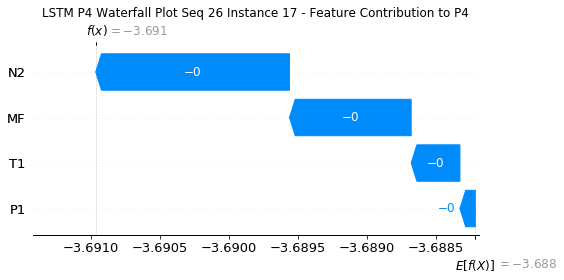

None

Contribution: [-0.00025513  0.00025943 -0.00096464 -0.00116242]


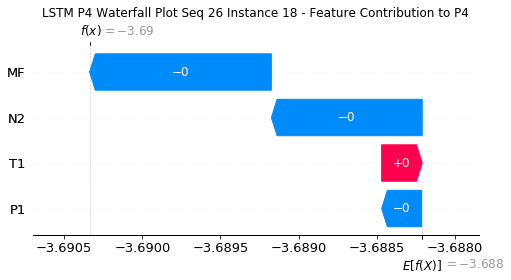

None

Contribution: [-9.29885596e-05  1.63675176e-05  1.68006012e-03  2.13803163e-03]


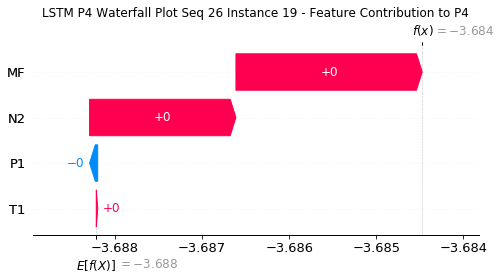

None

Contribution: [-0.00032002 -0.00281578 -0.00252426  0.00029958]


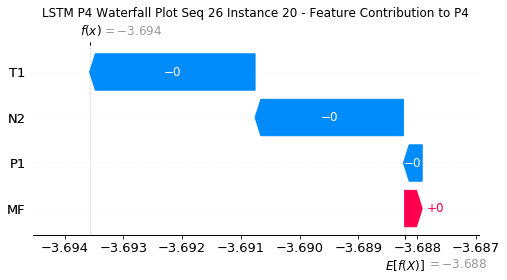

None

Contribution: [ 0.00068487  0.00398834 -0.00938399 -0.016706  ]


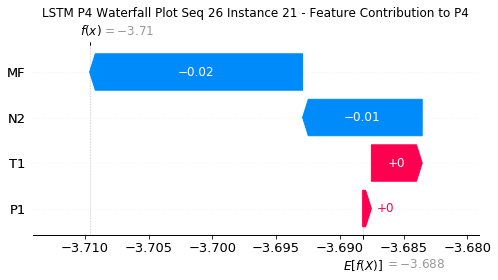

None

Contribution: [-0.00012643  0.00277163  0.00800894  0.00850163]


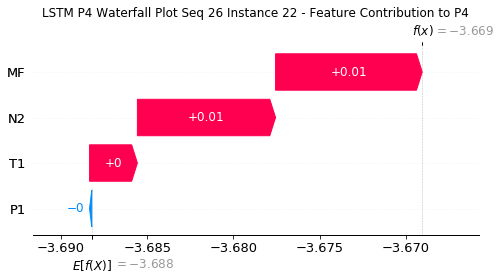

None

Contribution: [-0.00817377 -0.00792546  0.01168777  0.04892007]


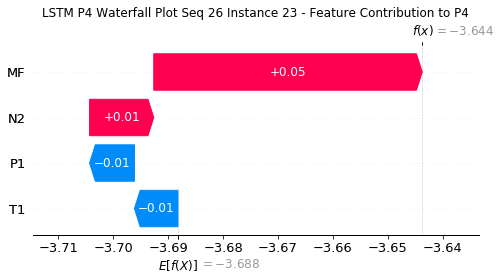

None

Contribution: [ 0.00363673  0.01092495 -0.03558655 -0.07646029]


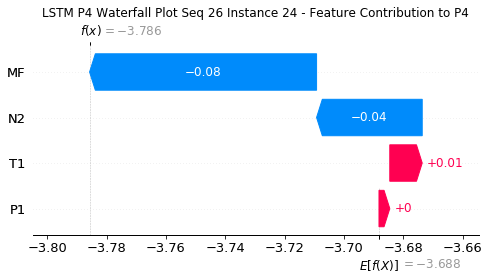

None

Contribution: [-0.00029671 -0.0017102  -0.00208457 -0.0016079 ]


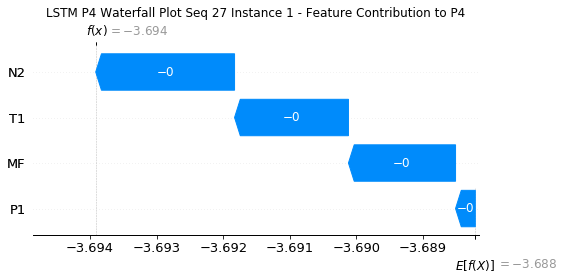

None

Contribution: [ 6.76034751e-05 -1.59628567e-04 -7.81159743e-05 -6.36939664e-06]


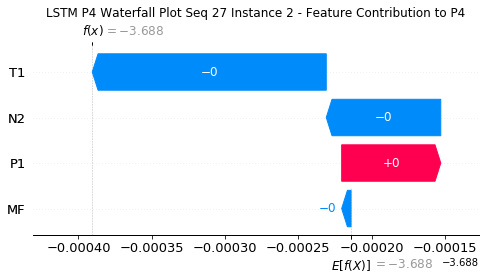

None

Contribution: [ 1.72831154e-05  1.41418261e-04 -6.77617156e-05  4.31977680e-05]


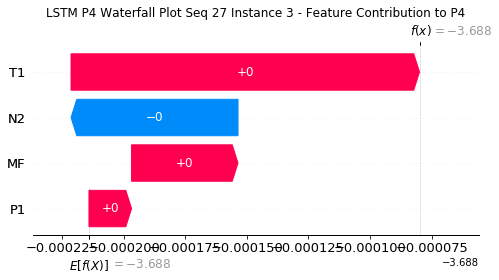

None

Contribution: [-3.65879117e-05  1.74675403e-04 -7.17800795e-05  1.27377148e-04]


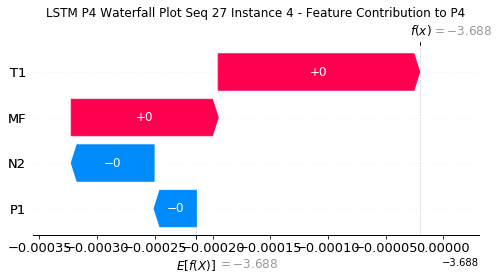

None

Contribution: [-6.83555733e-05  1.38092736e-04 -1.05028577e-04  1.49351900e-04]


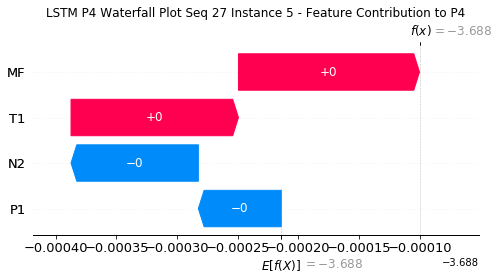

None

Contribution: [-6.29500342e-05  8.93393110e-05 -1.50242056e-04  5.31038969e-05]


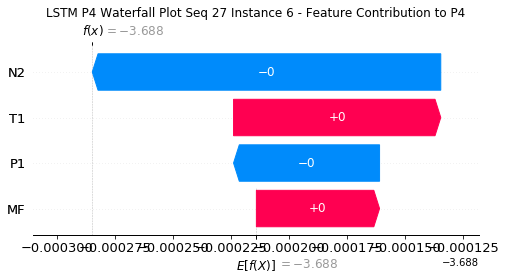

None

Contribution: [-1.20918354e-05  3.47936041e-05 -1.75217160e-04  5.25602743e-05]


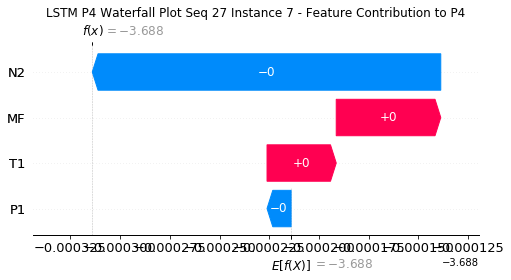

None

Contribution: [-8.97292102e-06  1.70721247e-05 -2.14989266e-04 -6.51357100e-06]


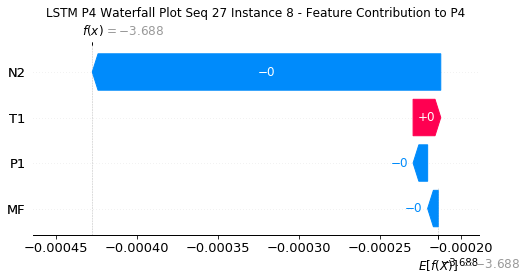

None

Contribution: [-3.43288842e-06  3.58669559e-05 -2.71285536e-04 -1.44492438e-04]


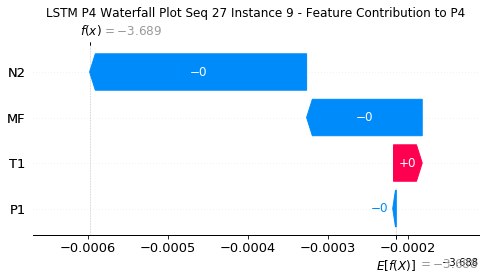

None

Contribution: [ 2.06529105e-05 -1.58231675e-05 -2.75771443e-04 -6.43671399e-05]


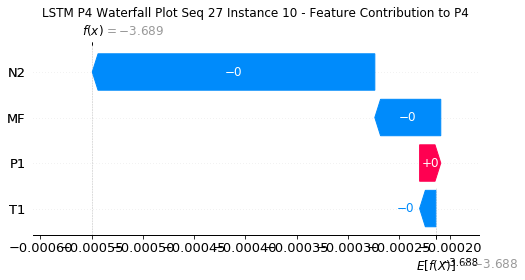

None

Contribution: [-8.52953329e-05 -2.72622025e-05 -3.46660053e-04 -2.14288726e-04]


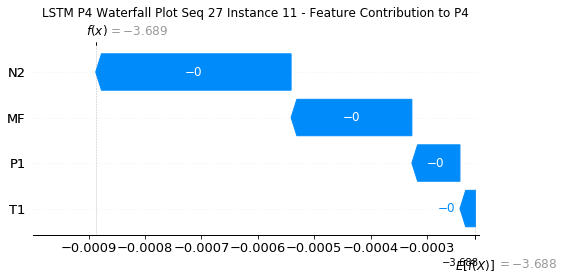

None

Contribution: [-8.92105949e-05 -1.38088590e-05 -4.00561141e-04 -2.65640915e-04]


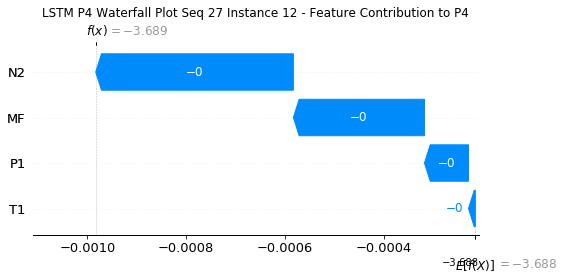

None

Contribution: [-9.42621171e-05 -3.41975775e-05 -4.92536757e-04 -3.90623415e-04]


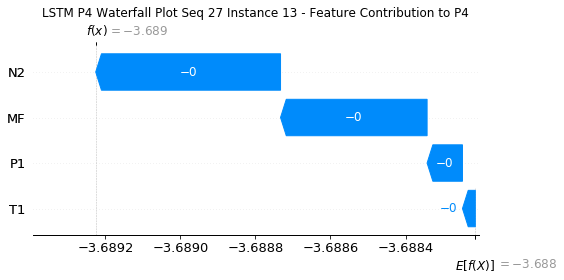

None

Contribution: [-2.93518730e-05 -9.53493962e-05 -4.98506193e-04 -2.20784303e-04]


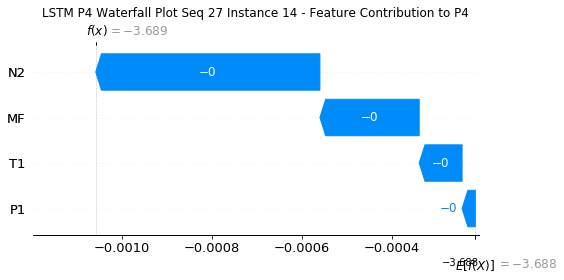

None

Contribution: [-1.20049391e-04  1.29141765e-06 -4.41871264e-04 -3.21122434e-04]


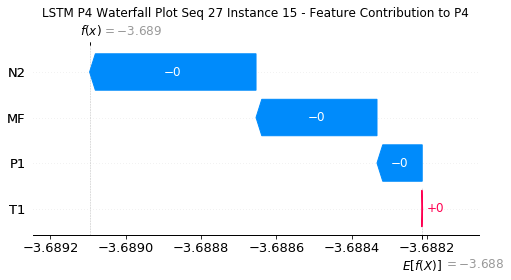

None

Contribution: [-1.05111405e-04  1.65298952e-05 -5.91666208e-04 -4.72277288e-04]


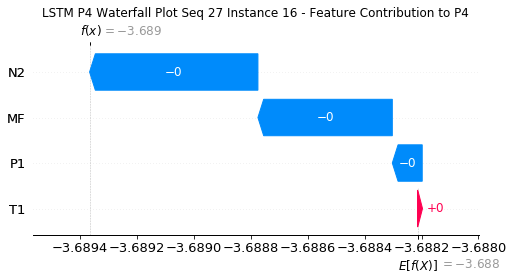

None

Contribution: [-0.00010201 -0.00035059 -0.00143316 -0.00099048]


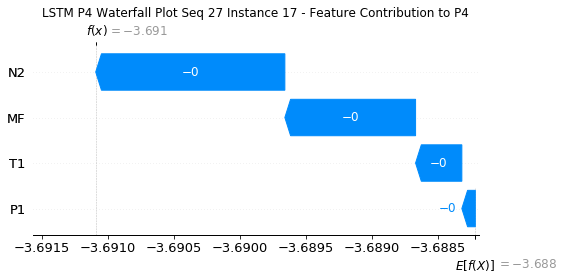

None

Contribution: [-0.00027539  0.00013722 -0.00095616 -0.00142462]


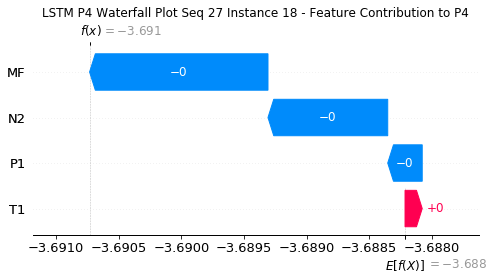

None

Contribution: [-1.23937090e-04 -1.51890639e-05  1.69162721e-03  2.21424107e-03]


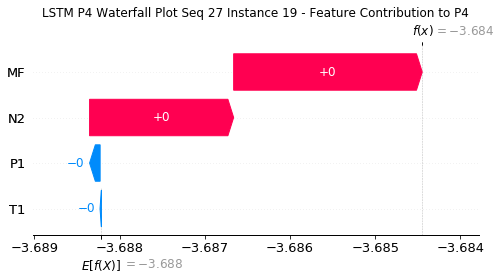

None

Contribution: [-0.00027361 -0.00262601 -0.0028512  -0.00116107]


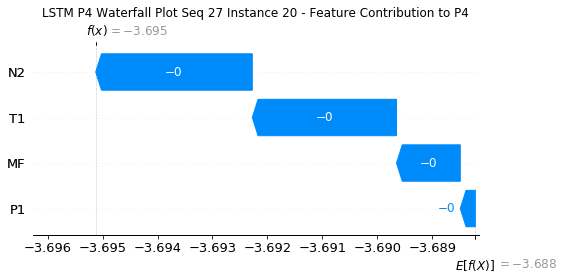

None

Contribution: [ 0.0007721   0.00366354 -0.00892871 -0.01316131]


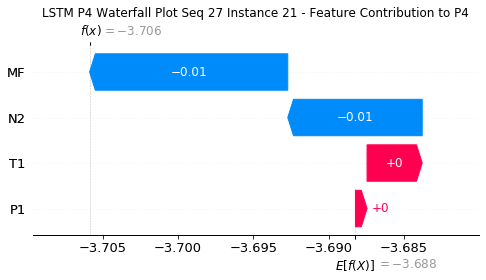

None

Contribution: [-0.00102398  0.00246513  0.00818306  0.00953476]


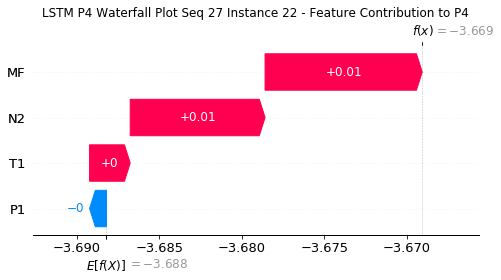

None

Contribution: [-0.00064856 -0.00779406  0.00878964  0.02287712]


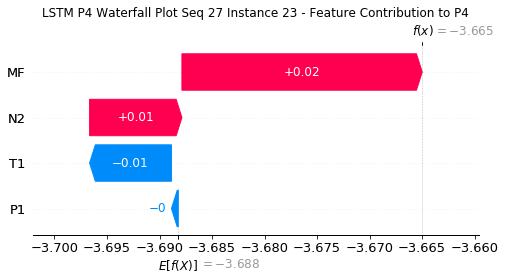

None

Contribution: [ 0.00373742  0.01057328 -0.03371271 -0.06904525]


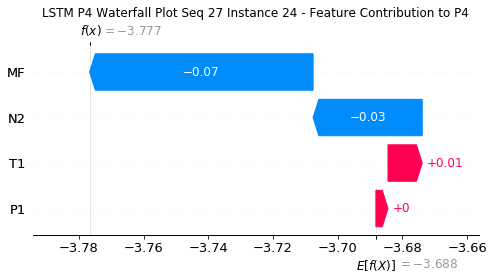

None

Contribution: [-5.52852287e-05 -1.43339881e-03 -1.96231196e-03 -8.20948281e-04]


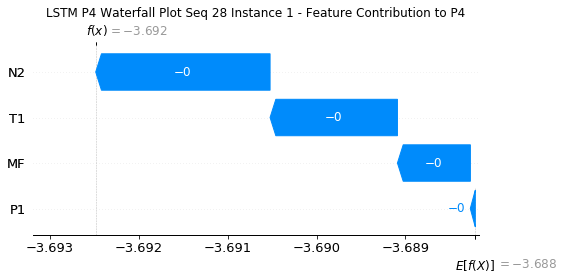

None

Contribution: [ 4.56126576e-05 -1.47886169e-04 -7.50754964e-05  3.71807098e-05]


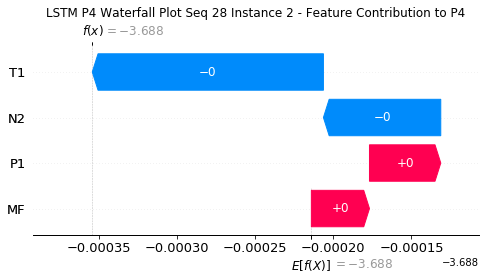

None

Contribution: [-2.40704598e-05  1.18034626e-04 -6.74968492e-05  9.74782226e-05]


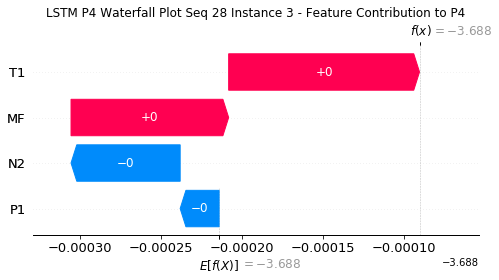

None

Contribution: [-6.71167911e-05  7.78093501e-05 -5.83632168e-05  1.89613275e-04]


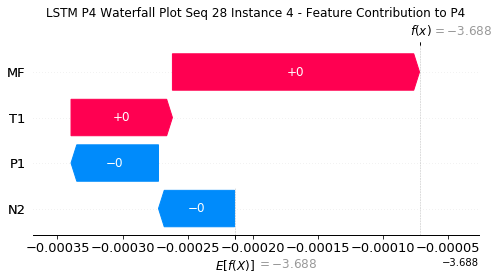

None

Contribution: [-8.48691315e-05  7.31774772e-05 -9.45595872e-05  1.80021951e-04]


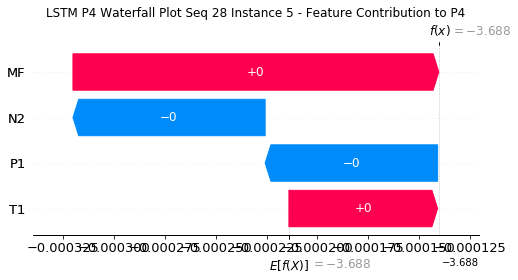

None

Contribution: [-1.71035262e-04  9.05546089e-06 -1.25154475e-04  2.68281637e-04]


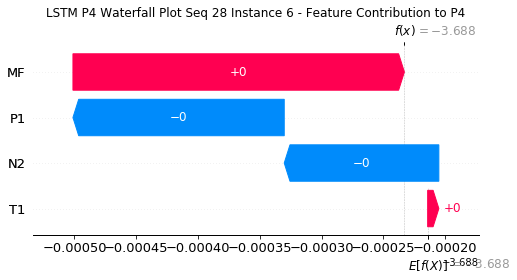

None

Contribution: [-4.89214712e-05  2.07909159e-05 -1.68330288e-04  9.42292503e-05]


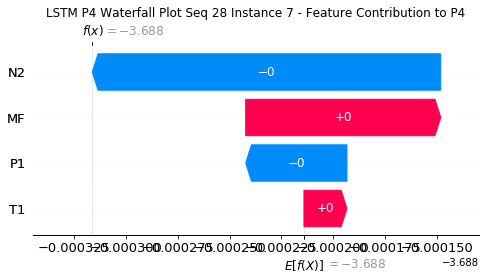

None

Contribution: [-5.57782445e-05  1.02246272e-05 -2.09093701e-04  4.67632785e-05]


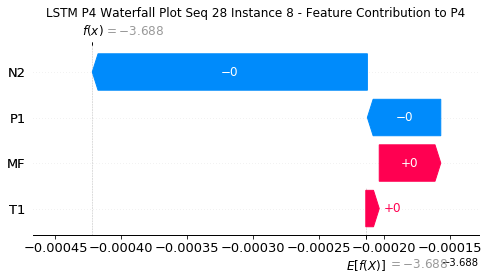

None

Contribution: [-6.17005949e-05  4.82870949e-06 -2.58406555e-04 -2.67506287e-05]


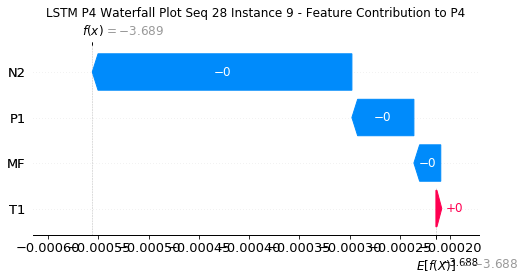

None

Contribution: [-2.43708632e-07 -6.53069354e-06 -2.73850798e-04 -5.18742920e-05]


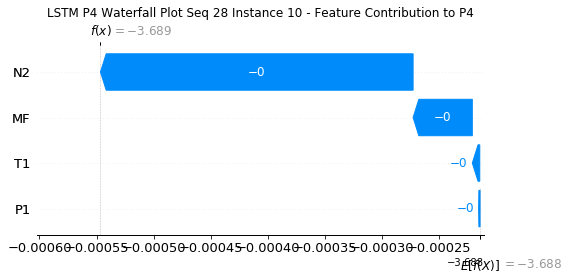

None

Contribution: [-1.08672509e-04 -2.68115607e-05 -3.42775357e-04 -1.90236564e-04]


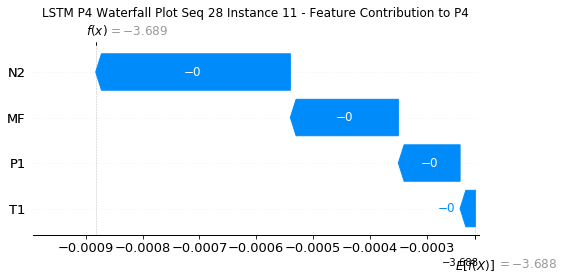

None

Contribution: [-1.24146731e-04 -3.05244367e-06 -3.94710417e-04 -2.36151059e-04]


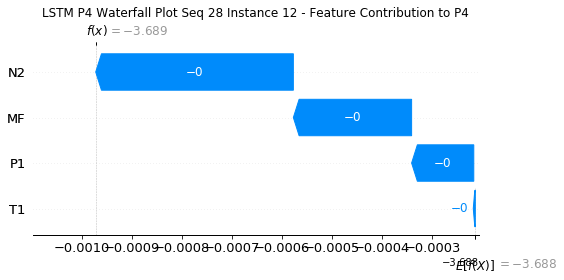

None

Contribution: [-7.37650315e-05 -8.59847172e-06 -4.83432607e-04 -3.66100066e-04]


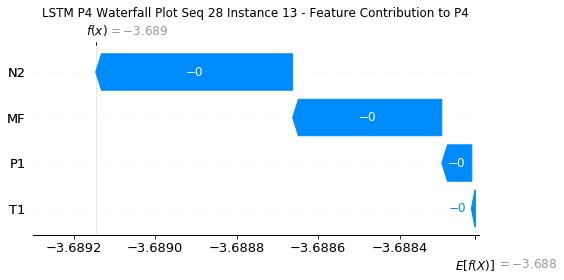

None

Contribution: [-9.44599227e-05 -5.35829702e-05 -4.91752367e-04 -1.45157913e-04]


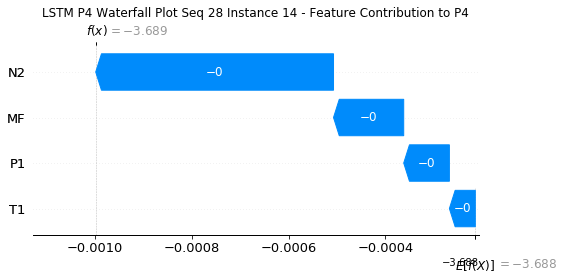

None

Contribution: [-1.26459015e-04  7.39724416e-05 -4.68252113e-04 -3.20619043e-04]


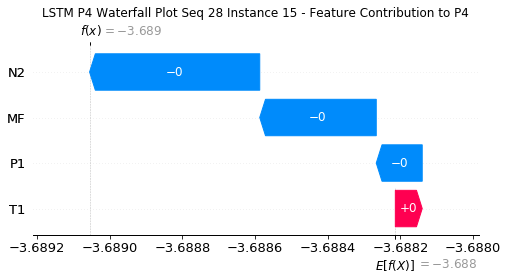

None

Contribution: [-0.0001649   0.00019446 -0.00055562 -0.00046642]


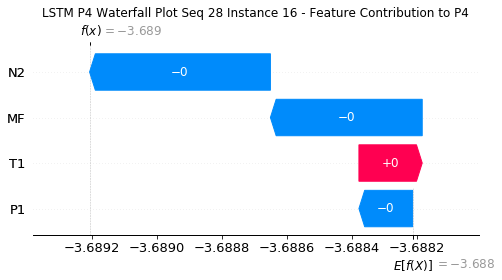

None

Contribution: [-0.00019033 -0.00042184 -0.00133168 -0.00071129]


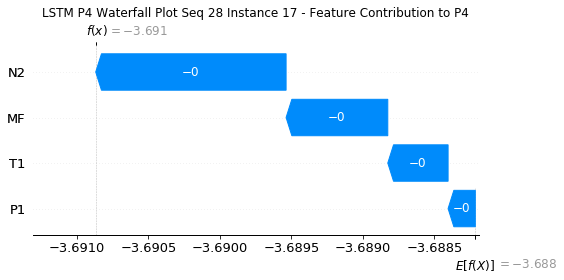

None

Contribution: [-0.00012042  0.0004422  -0.00104874 -0.00088115]


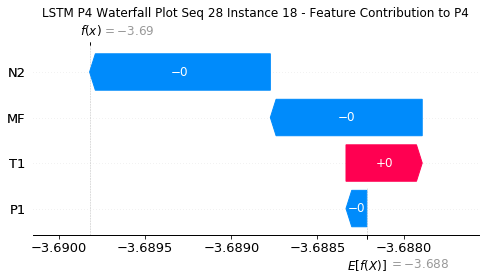

None

Contribution: [0.00019914 0.00043206 0.00153937 0.00159497]


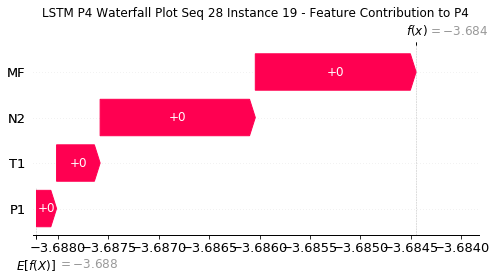

None

Contribution: [-0.00062663 -0.00669743 -0.00181034  0.00299636]


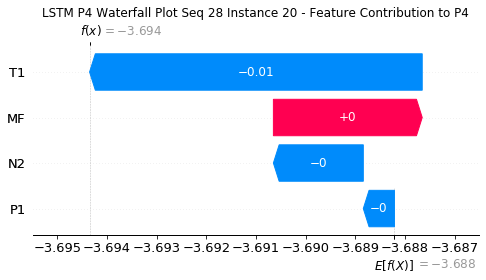

None

Contribution: [ 9.22561884e-06  1.22895831e-02 -1.03414807e-02 -2.17371111e-02]


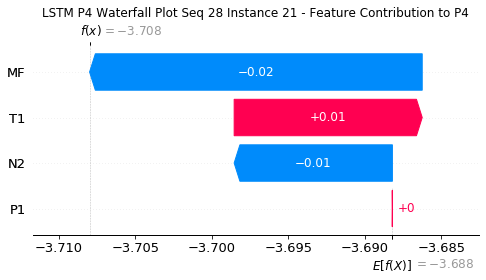

None

Contribution: [0.00322807 0.00798203 0.0074894  0.00675139]


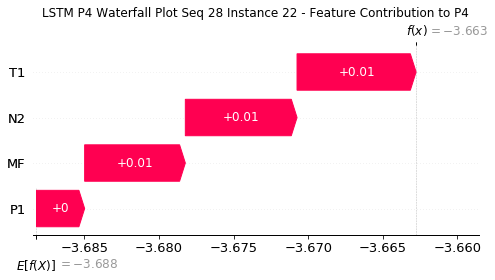

None

Contribution: [-0.02833354 -0.02799195  0.01544999  0.0690259 ]


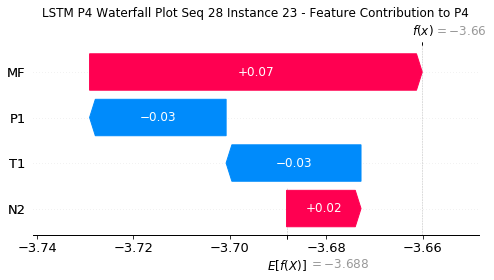

None

Contribution: [ 0.01530866  0.03879255 -0.04158453 -0.10480093]


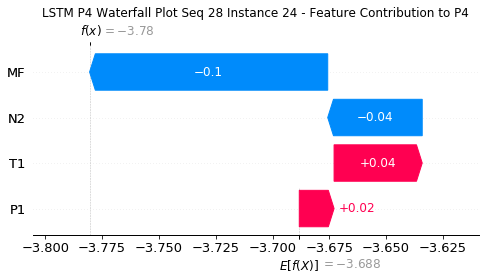

None

Contribution: [ 0.00035361 -0.00415072 -0.00199601 -0.00122254]


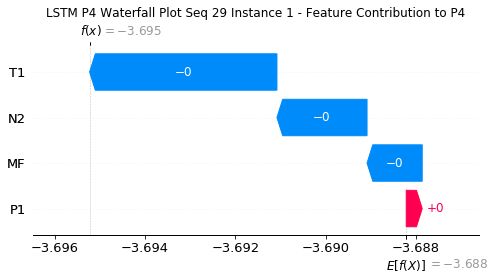

None

Contribution: [-3.64818153e-05 -2.59817411e-04 -6.13234906e-05  9.99350561e-05]


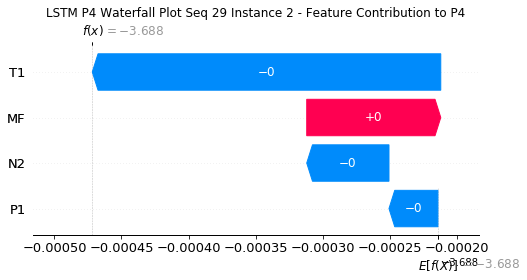

None

Contribution: [-2.43582161e-04  4.95196261e-04 -5.28788861e-05  1.48201454e-04]


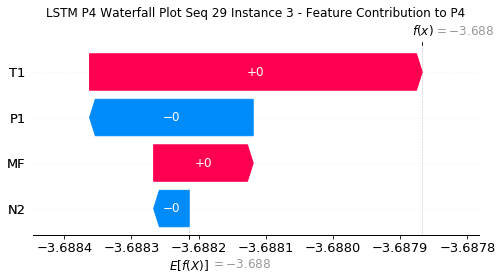

None

Contribution: [-3.95078704e-04  6.40485762e-04 -3.22222490e-05  3.64061341e-04]


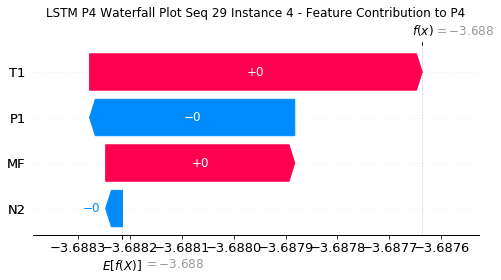

None

Contribution: [-4.86557670e-04  5.49735356e-04 -6.18579923e-05  4.08194042e-04]


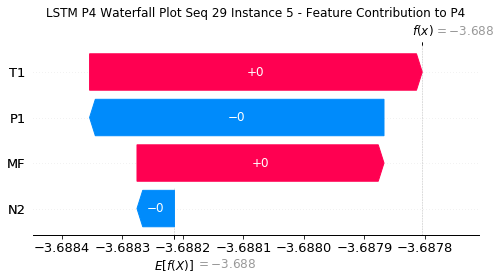

None

Contribution: [-2.27293788e-04  4.07511876e-04 -1.43986505e-04  3.85761845e-05]


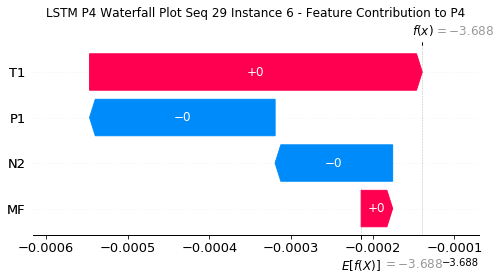

None

Contribution: [-0.00032419  0.00026955 -0.00014513  0.00024025]


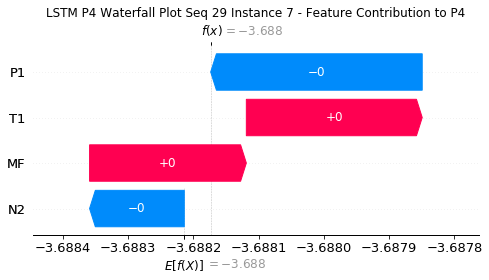

None

Contribution: [-0.00027332  0.0002072  -0.00019344  0.00013624]


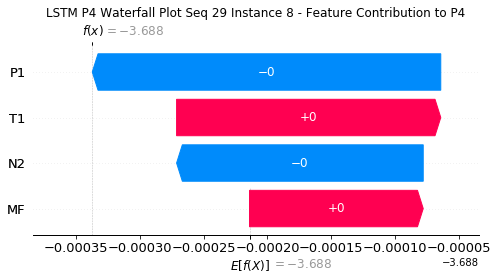

None

Contribution: [-0.00032185  0.00017141 -0.00023634  0.00014832]


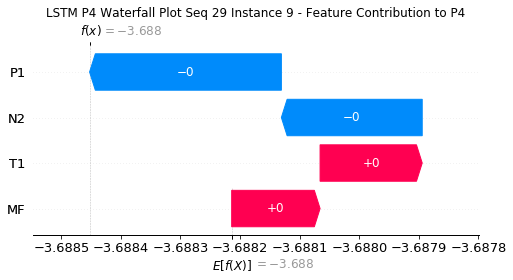

None

Contribution: [-0.00025765  0.00016465 -0.00025478  0.0001193 ]


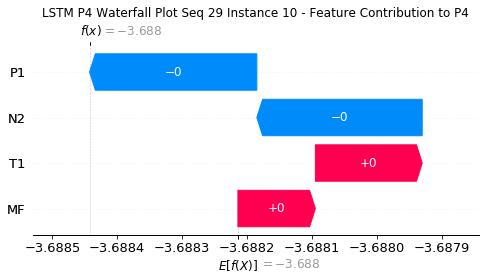

None

Contribution: [-2.69627837e-04  1.50872232e-04 -3.33704815e-04 -9.68346052e-05]


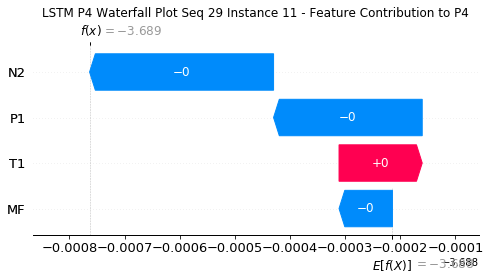

None

Contribution: [-0.00025349  0.00016755 -0.00038781 -0.00017293]


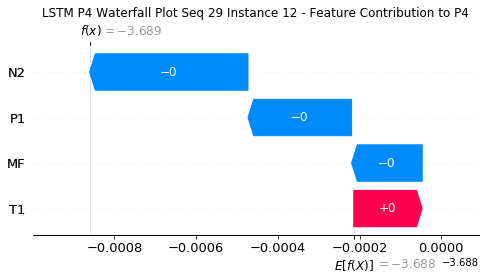

None

Contribution: [-0.00029778  0.0002249  -0.00046846 -0.00025503]


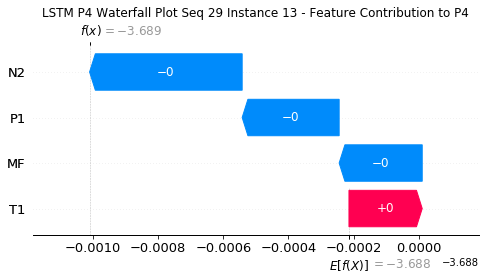

None

Contribution: [-1.79594779e-04  6.44179086e-05 -4.86214691e-04 -1.07254527e-04]


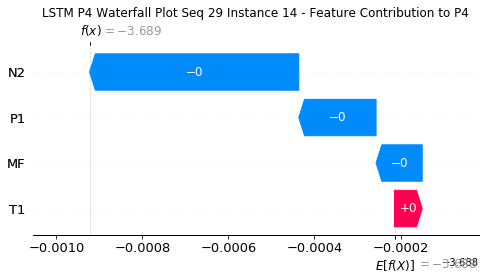

None

Contribution: [-0.00019003  0.00011724 -0.00046347 -0.00032696]


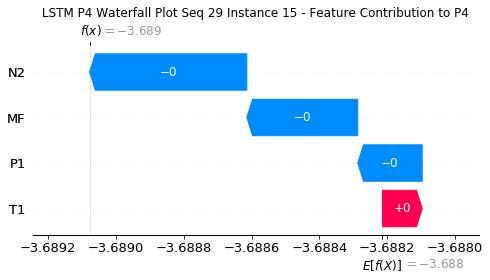

None

Contribution: [-0.00018367  0.00026928 -0.00057451 -0.00046451]


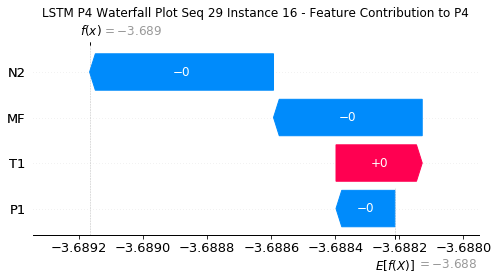

None

Contribution: [-0.00019353 -0.00042579 -0.0013442  -0.00079566]


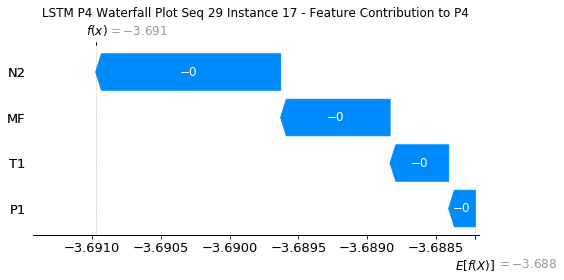

None

Contribution: [-8.48452033e-05  5.19328893e-04 -9.66479604e-04 -8.76732124e-04]


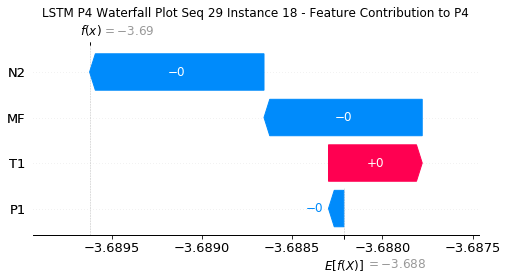

None

Contribution: [-0.00010511  0.00014466  0.0016081   0.00207948]


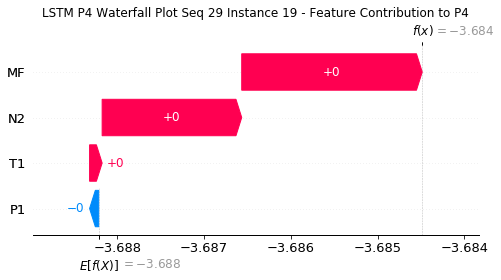

None

Contribution: [-0.00032625 -0.00388082 -0.00238655 -0.00085123]


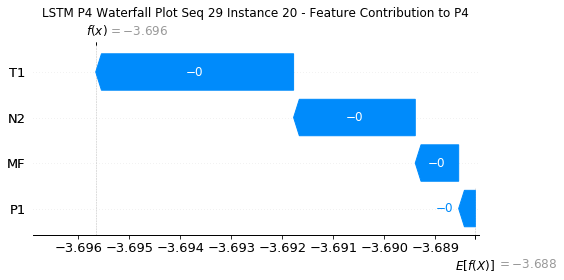

None

Contribution: [ 0.00071143  0.00594344 -0.00957348 -0.01458269]


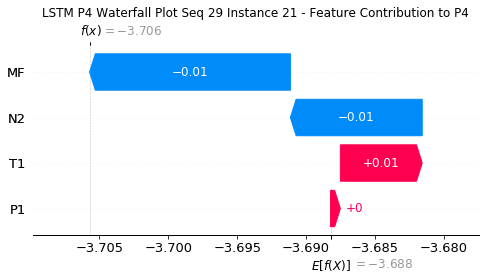

None

Contribution: [-0.00037125  0.00356535  0.00792213  0.00877664]


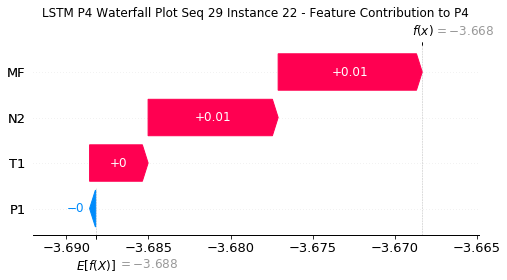

None

Contribution: [-0.00113861 -0.01197342  0.0110704   0.02781638]


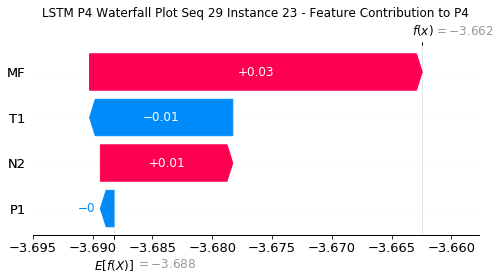

None

Contribution: [-0.0026894   0.02274335 -0.03266344 -0.03740828]


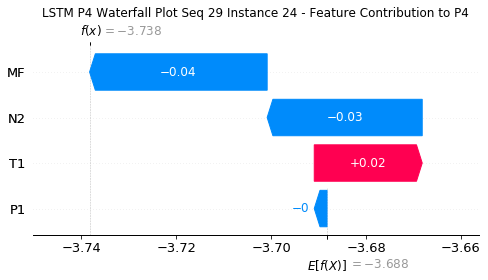

None

Contribution: [-0.00026582 -0.00159001 -0.001977   -0.00130241]


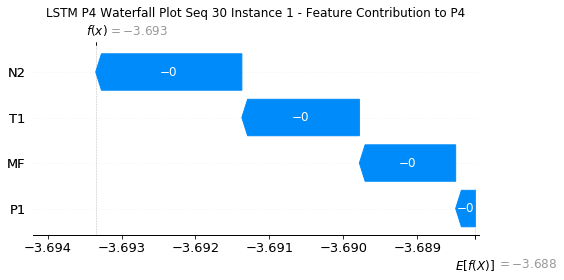

None

Contribution: [ 5.55157858e-05 -1.67846458e-04 -7.19424285e-05  2.28171502e-05]


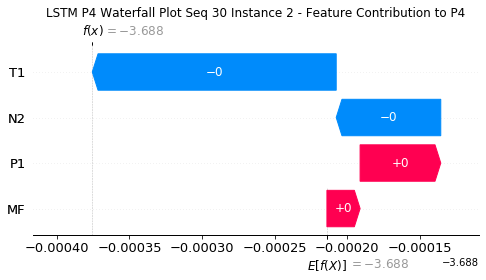

None

Contribution: [-1.69608289e-05  1.14331577e-04 -6.59206542e-05  2.76813063e-05]


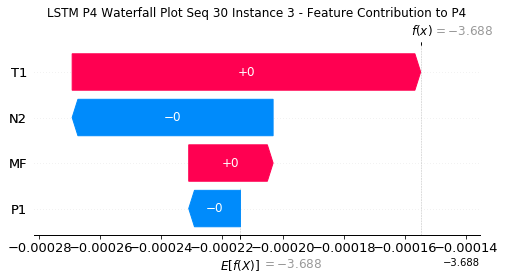

None

Contribution: [-1.42571795e-05  1.32642612e-04 -6.80404722e-05  1.07964222e-04]


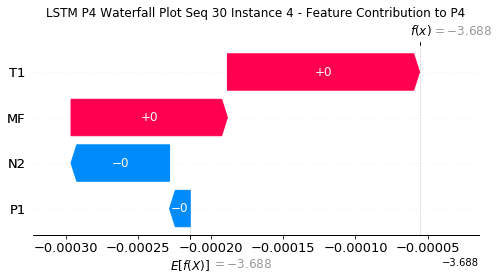

None

Contribution: [-4.00080438e-05  1.17116759e-04 -1.04342532e-04  1.09872643e-04]


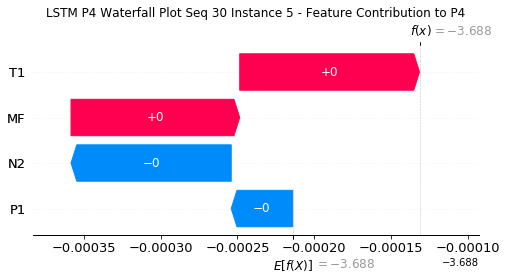

None

Contribution: [-9.32852131e-05  9.12157803e-05 -1.41523100e-04  4.01989594e-05]


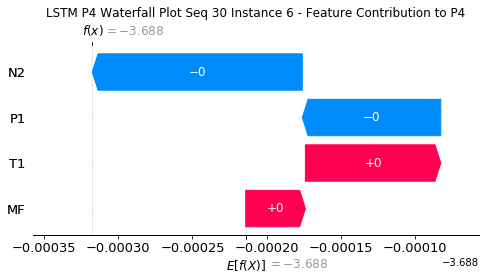

None

Contribution: [-1.11699186e-06  2.66459850e-05 -1.71280127e-04  3.06823863e-05]


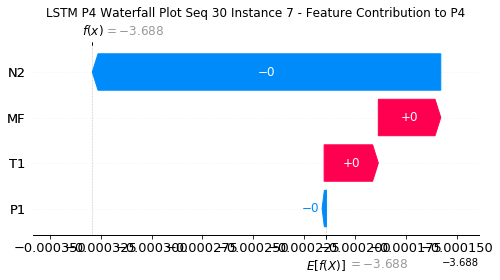

None

Contribution: [-6.10997390e-06  2.41756362e-05 -2.13563346e-04 -6.51283222e-05]


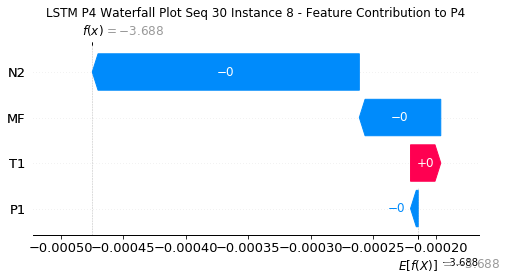

None

Contribution: [-1.01602375e-05  2.20989977e-05 -2.62576882e-04 -1.36846290e-04]


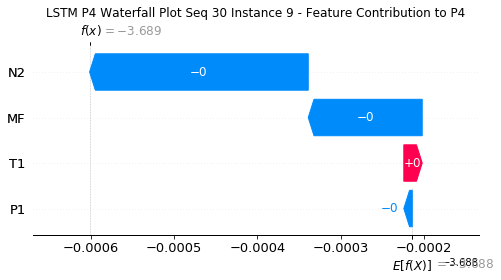

None

Contribution: [ 1.08305472e-05  1.61535731e-07 -2.74837700e-04 -1.09771210e-04]


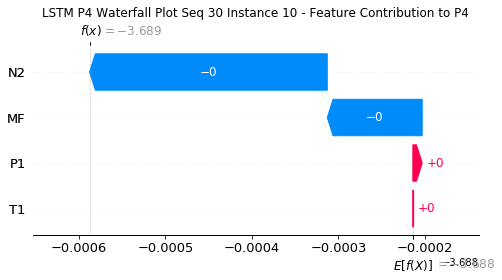

None

Contribution: [-6.77287175e-05 -9.69095877e-06 -3.46159838e-04 -2.37763843e-04]


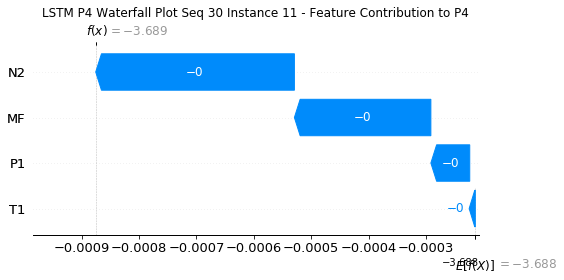

None

Contribution: [-7.16907152e-05  3.92940371e-06 -4.00759539e-04 -2.86517810e-04]


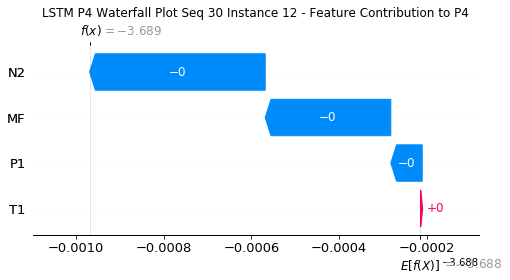

None

Contribution: [-8.23877215e-05  6.49349740e-06 -4.92914983e-04 -4.21526426e-04]


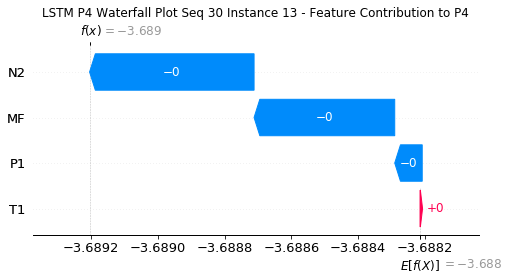

None

Contribution: [-1.56647878e-05 -7.58991066e-05 -4.98274163e-04 -2.48520007e-04]


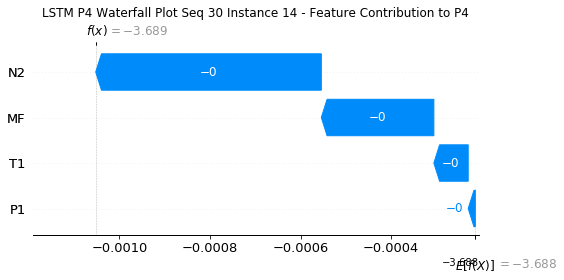

None

Contribution: [-1.21175268e-04  3.68131930e-06 -4.39105791e-04 -3.15154724e-04]


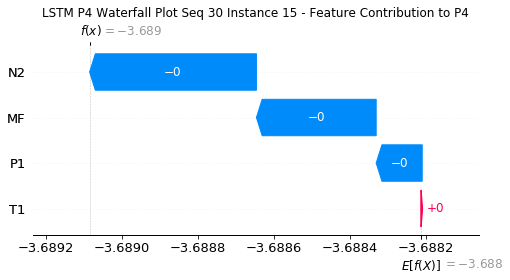

None

Contribution: [-9.71099504e-05  5.81886312e-05 -5.90127011e-04 -4.77268548e-04]


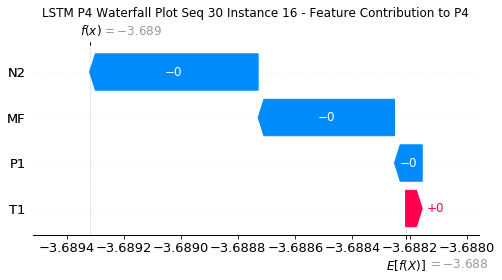

None

Contribution: [-9.91756517e-05 -3.62377643e-04 -1.42677884e-03 -1.03961515e-03]


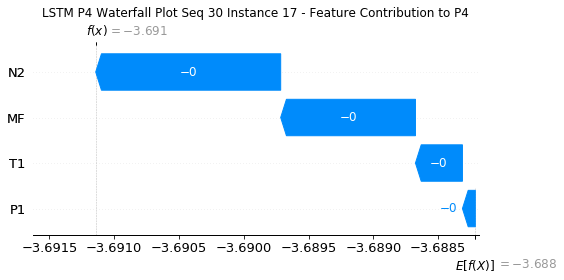

None

Contribution: [-0.00024229  0.0003992  -0.00093385 -0.00095417]


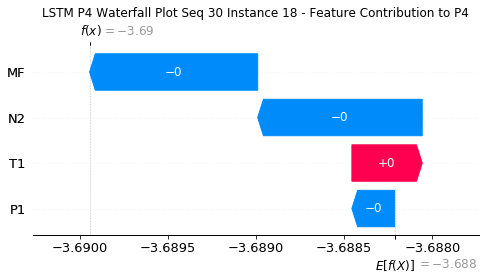

None

Contribution: [-1.09909632e-04 -9.68156607e-06  1.69026454e-03  2.20157750e-03]


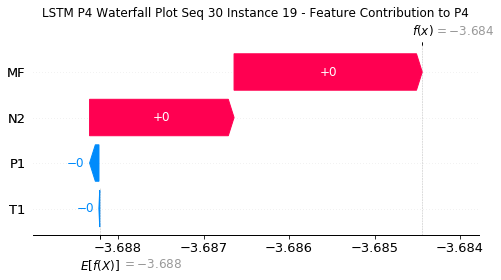

None

Contribution: [-0.00030815 -0.00271383 -0.00247759 -0.00062723]


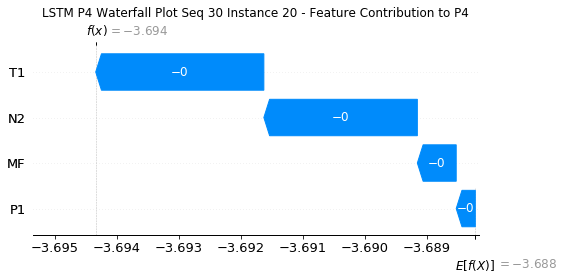

None

Contribution: [ 0.00071548  0.00385754 -0.00974343 -0.01433718]


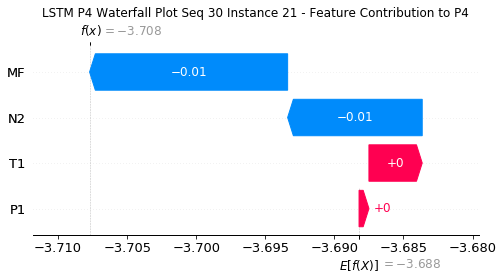

None

Contribution: [-0.0005399   0.00284917  0.00808903  0.0093152 ]


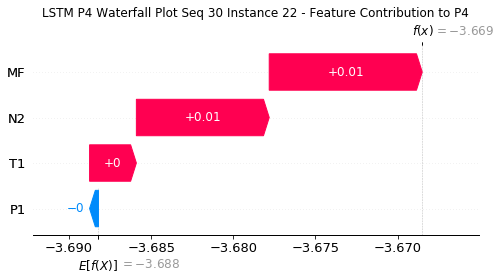

None

Contribution: [-0.00376474 -0.0080282   0.01143986  0.02742354]


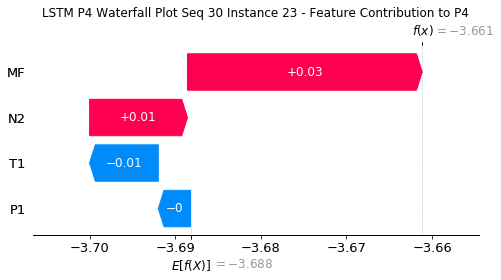

None

Contribution: [ 0.00091897  0.01030009 -0.03597681 -0.05181076]


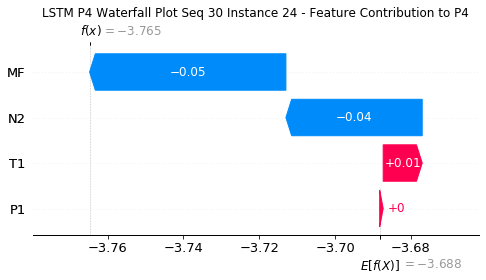

None

Contribution: [-0.00020797 -0.00157476 -0.00185866 -0.00118334]


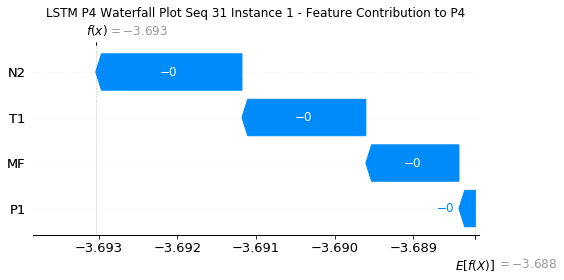

None

Contribution: [ 6.72825189e-05 -1.57058817e-04 -6.67779068e-05 -2.40193631e-05]


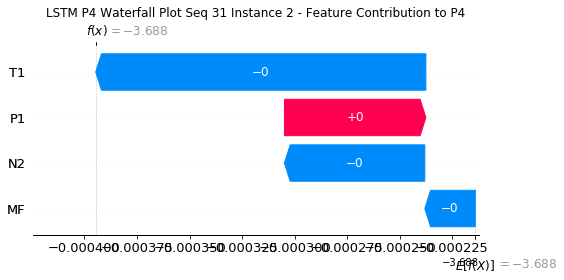

None

Contribution: [ 5.56347865e-05  1.38755816e-04 -6.89476627e-05 -3.38679104e-05]


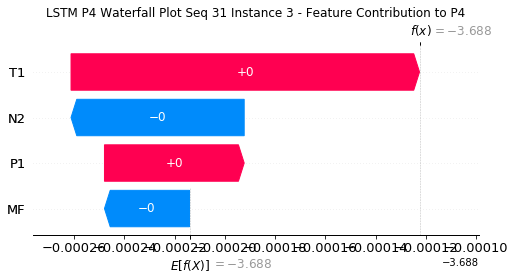

None

Contribution: [-6.42122702e-05  1.41910515e-04 -4.05610499e-05  1.95262267e-04]


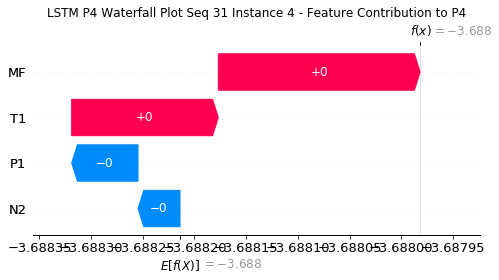

None

Contribution: [-9.64000491e-05  1.19067810e-04 -7.53637240e-05  2.09782383e-04]


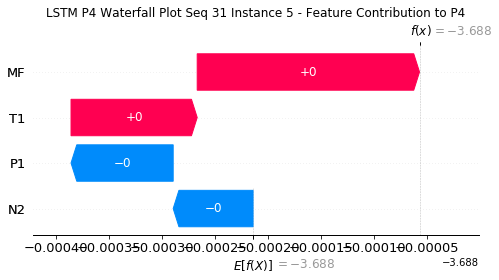

None

Contribution: [-1.05203899e-04  6.49412750e-05 -1.35426970e-04  8.48104472e-05]


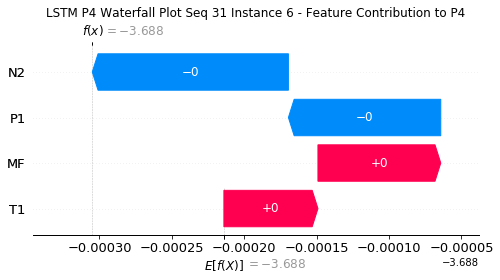

None

Contribution: [-3.02426476e-05  2.90439449e-05 -1.56822261e-04  8.70216324e-05]


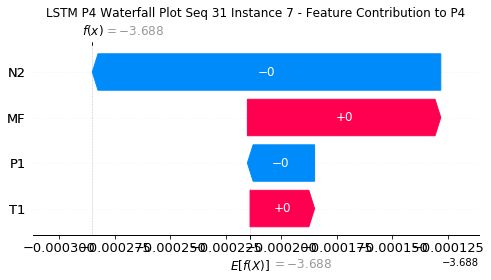

None

Contribution: [ 6.56893357e-06  2.69821078e-05 -2.13243604e-04 -4.89787590e-05]


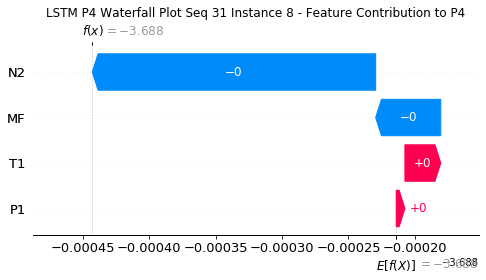

None

Contribution: [ 9.03642841e-06  9.47356545e-06 -2.68860917e-04 -2.12571918e-04]


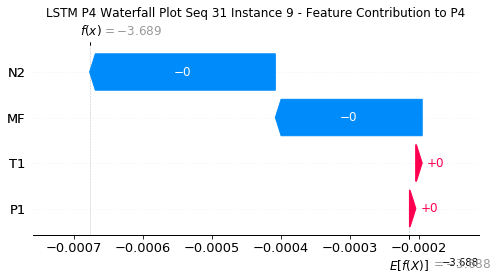

None

Contribution: [ 2.06103978e-05 -2.90735362e-06 -2.71560131e-04 -6.03299191e-05]


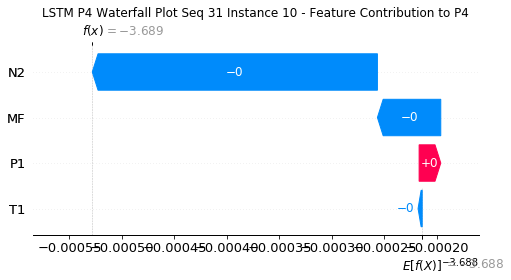

None

Contribution: [-9.28596085e-05 -2.23750708e-05 -3.41468506e-04 -2.13873155e-04]


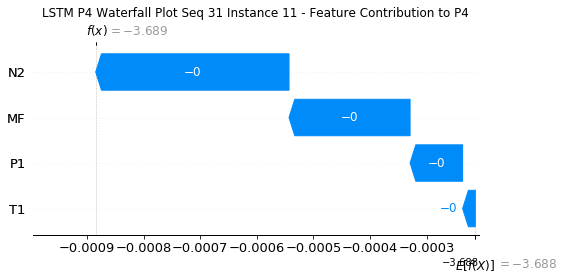

None

Contribution: [-9.49527990e-05 -1.03427344e-05 -3.95693726e-04 -2.68299799e-04]


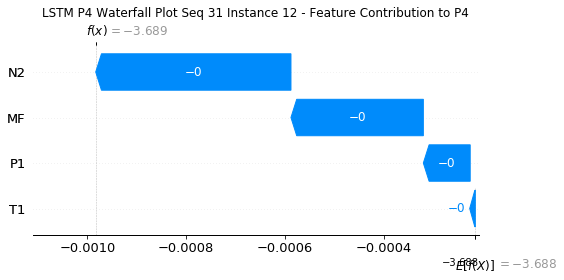

None

Contribution: [-1.11389487e-04 -1.28640268e-05 -4.85196337e-04 -3.49391771e-04]


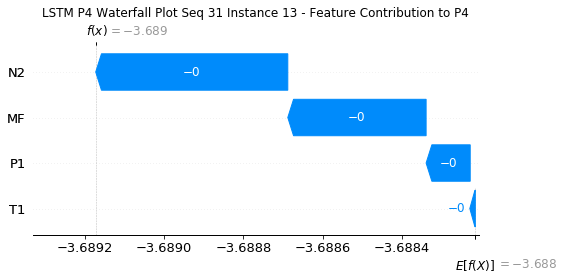

None

Contribution: [-3.82169703e-05 -8.06265104e-05 -4.93142688e-04 -2.21201364e-04]


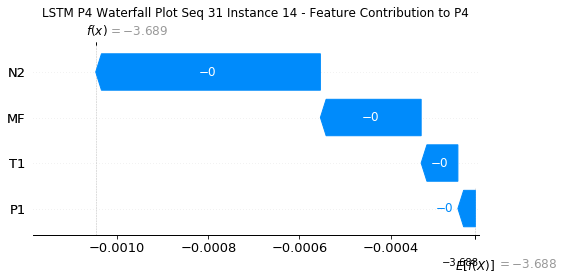

None

Contribution: [-1.00111691e-04  2.34417345e-05 -4.43156857e-04 -3.48002166e-04]


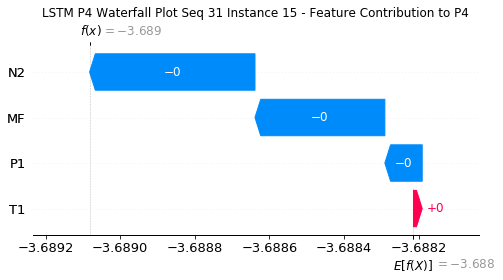

None

Contribution: [-1.08575498e-04  5.55702669e-05 -5.84322577e-04 -4.69879912e-04]


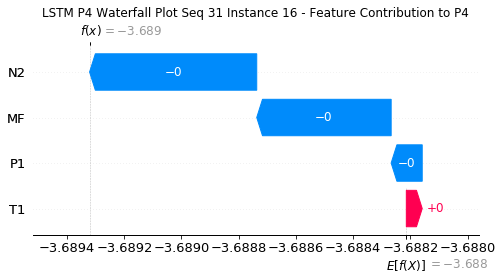

None

Contribution: [-0.00010652 -0.00036219 -0.00141054 -0.00103517]


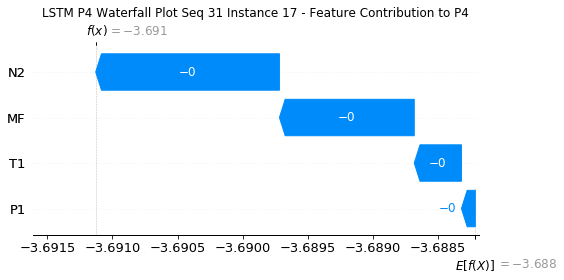

None

Contribution: [-0.00030969  0.00022988 -0.00100463 -0.00134603]


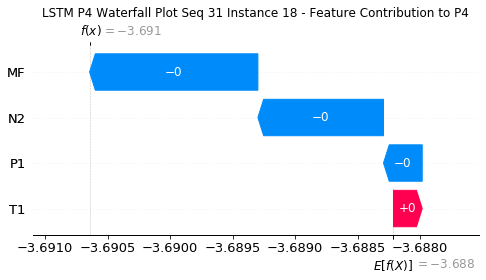

None

Contribution: [-1.11702546e-04  3.75763927e-05  1.67952967e-03  2.18978444e-03]


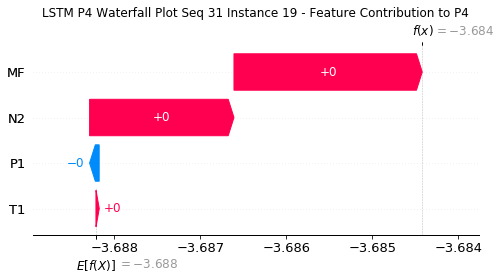

None

Contribution: [-0.0002954  -0.00310831 -0.00256532 -0.00101634]


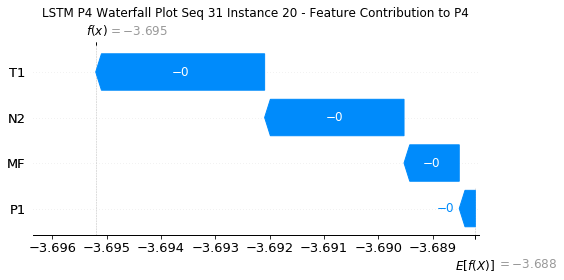

None

Contribution: [ 0.0007329   0.00480596 -0.00956101 -0.01418201]


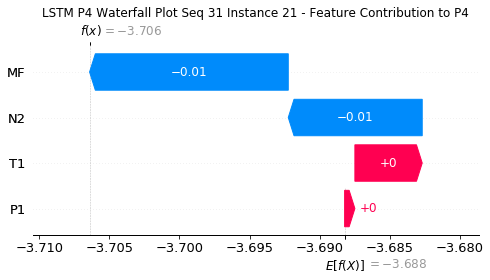

None

Contribution: [-0.00071665  0.00324044  0.00807317  0.00929695]


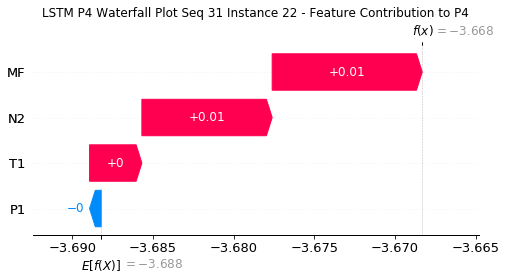

None

Contribution: [-0.00255805 -0.01035463  0.01077629  0.02495543]


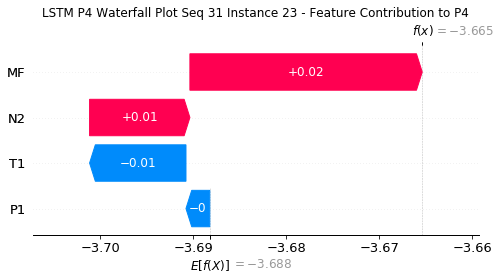

None

Contribution: [ 0.0029747   0.01142436 -0.04199627 -0.05938399]


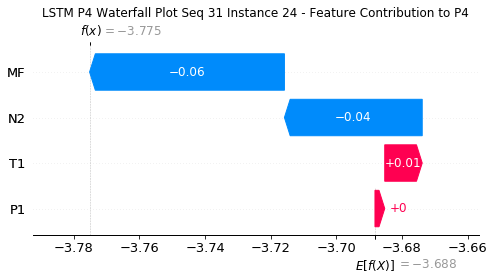

None

Contribution: [-7.76995879e-05 -1.53505631e-03 -1.68387516e-03 -7.12233841e-04]


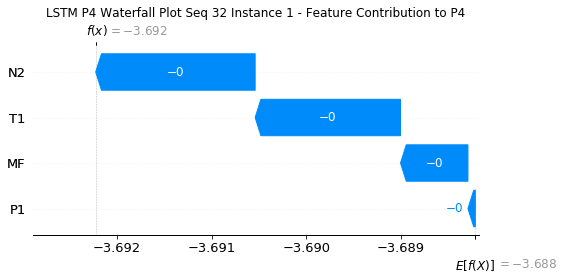

None

Contribution: [ 4.36106489e-05 -1.65520877e-04 -5.03244872e-05  6.13275238e-05]


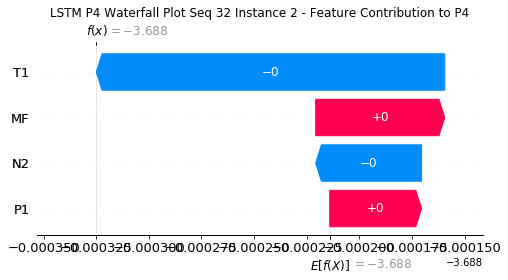

None

Contribution: [-2.87531226e-05  2.05406577e-04 -4.70125907e-05  9.25571925e-05]


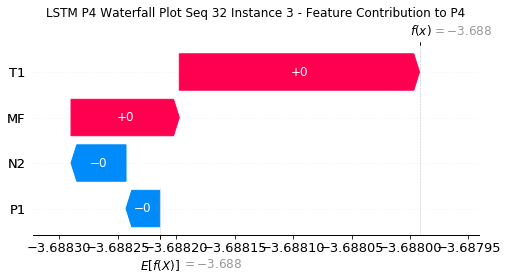

None

Contribution: [-2.10980707e-05  1.81152555e-04 -4.03897206e-05  1.27660766e-04]


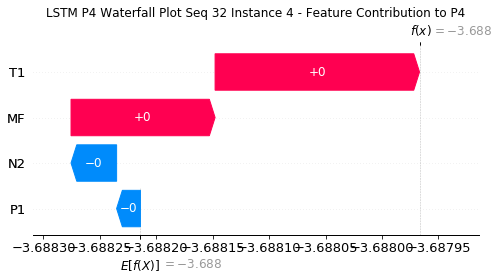

None

Contribution: [-4.83676282e-05  1.53720385e-04 -6.73829376e-05  1.37292761e-04]


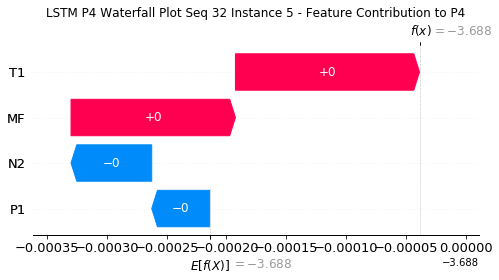

None

Contribution: [ 2.26722375e-05  8.86164204e-05 -1.61924425e-04 -3.75319831e-05]


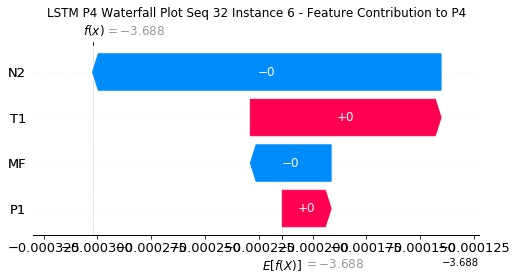

None

Contribution: [-9.87579880e-07  3.95605889e-05 -1.46516068e-04  6.64764075e-05]


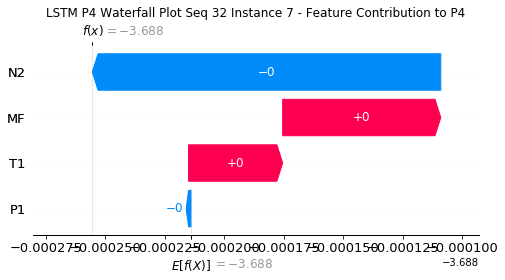

None

Contribution: [-2.87449617e-05  7.40709709e-06 -1.86463077e-04  7.84713117e-05]


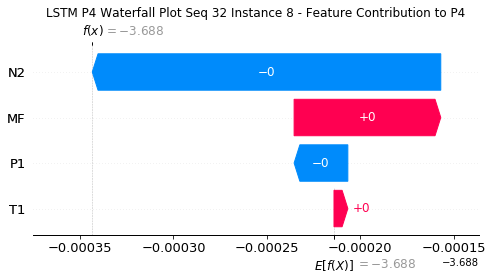

None

Contribution: [-5.96570378e-05 -1.08914862e-05 -2.42187931e-04  2.33026007e-05]


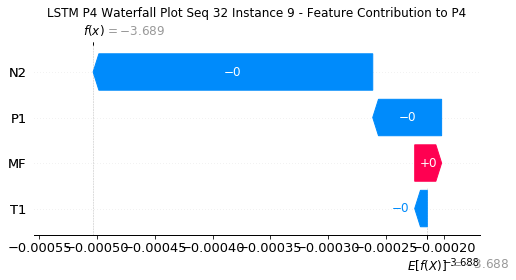

None

Contribution: [ 6.08896063e-07 -2.59280441e-05 -2.55672393e-04 -6.21435953e-06]


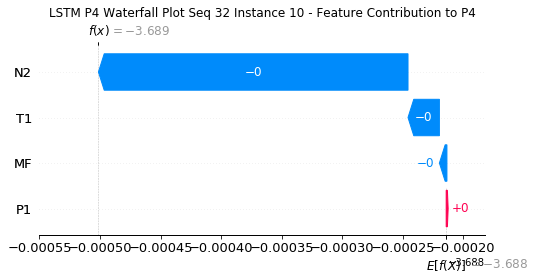

None

Contribution: [-7.62429700e-05 -1.05714964e-05 -3.34751011e-04 -2.08460483e-04]


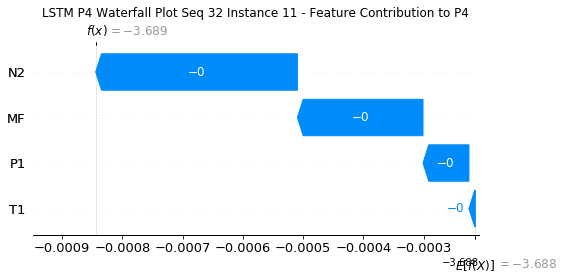

None

Contribution: [-8.15930891e-05  7.90281460e-06 -3.88781575e-04 -2.60394772e-04]


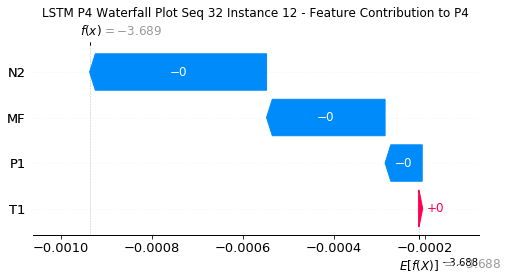

None

Contribution: [-8.16294087e-05  1.04791872e-05 -4.76486488e-04 -3.86562447e-04]


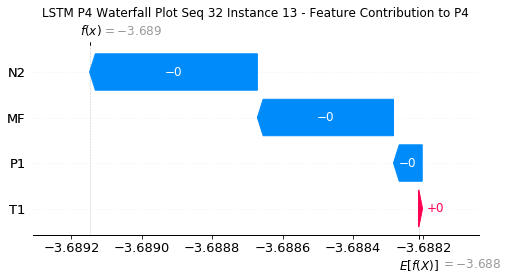

None

Contribution: [-2.37426052e-05 -6.73570246e-05 -4.83930644e-04 -2.10119206e-04]


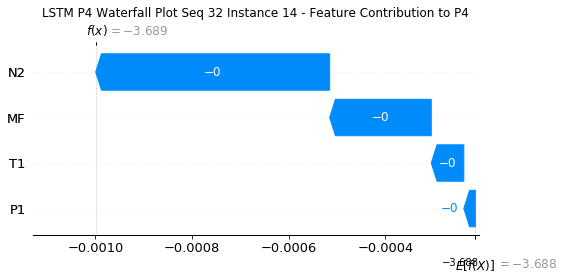

None

Contribution: [-4.27859501e-05  8.82363319e-05 -4.63807247e-04 -3.51837051e-04]


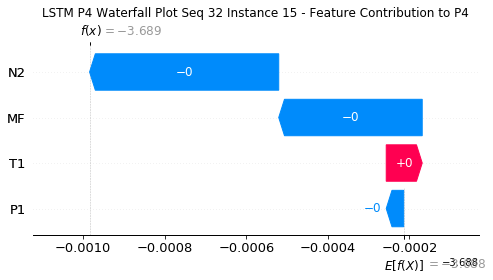

None

Contribution: [-1.04073710e-04  9.10092324e-05 -5.70023080e-04 -4.53992322e-04]


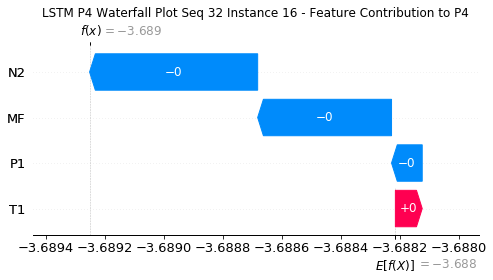

None

Contribution: [-0.00010108 -0.00037951 -0.00131494 -0.0009347 ]


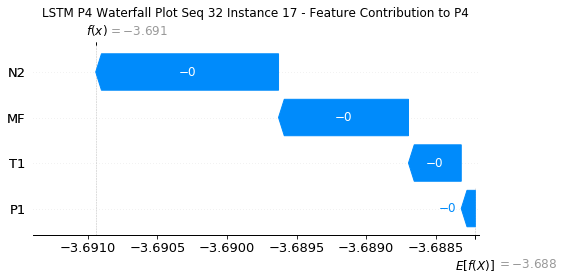

None

Contribution: [-0.00021888  0.00049181 -0.00113692 -0.00130207]


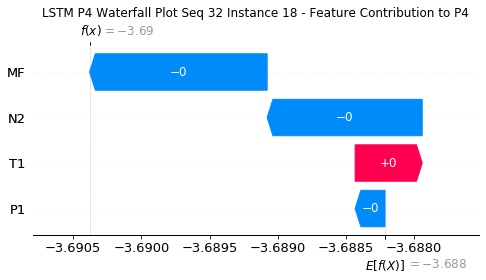

None

Contribution: [-0.00010559  0.00011349  0.00162048  0.00208583]


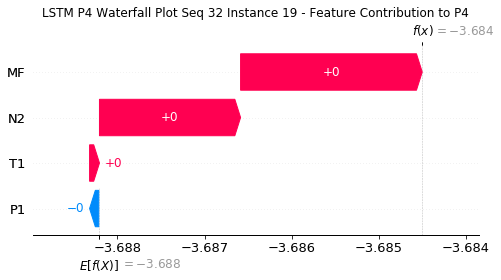

None

Contribution: [-0.0003101  -0.00360736 -0.00185268 -0.00034751]


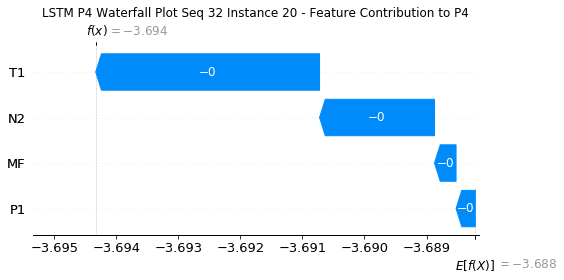

None

Contribution: [ 0.00071403  0.00565273 -0.01079763 -0.01520051]


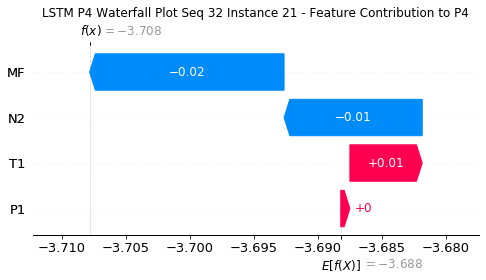

None

Contribution: [-0.00059805  0.00378361  0.00780634  0.00891009]


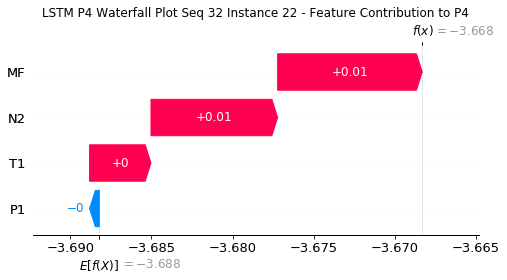

None

Contribution: [-0.0044675  -0.01154153  0.01581238  0.03286593]


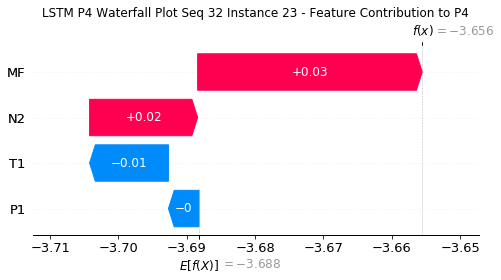

None

Contribution: [ 0.0028871   0.01062183 -0.04174315 -0.06534172]


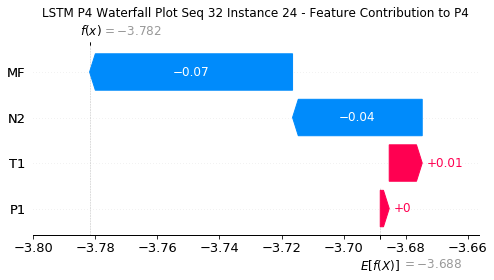

None

Contribution: [-0.00023488 -0.00167618 -0.00179742 -0.00120857]


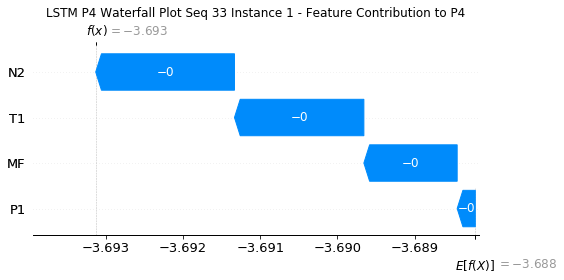

None

Contribution: [ 5.96875244e-05 -1.66229044e-04 -5.56185670e-05  2.39216203e-05]


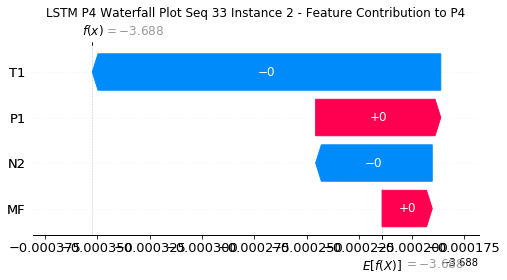

None

Contribution: [ 1.65015895e-05  1.88350016e-04 -5.14884303e-05  3.53192474e-05]


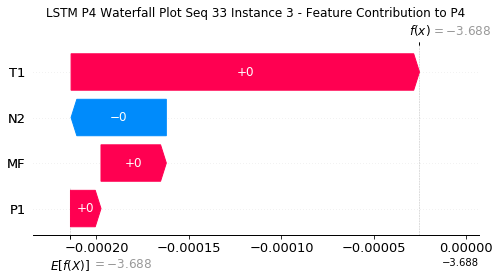

None

Contribution: [ 4.03144594e-05  2.32961516e-04 -4.89245051e-05  1.15966747e-04]


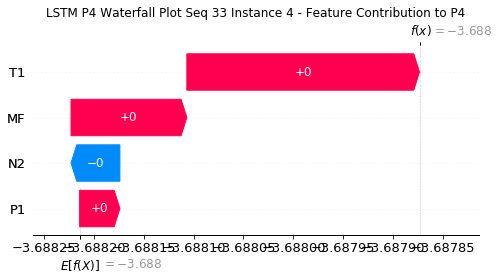

None

Contribution: [ 2.93055074e-05  2.07296590e-04 -8.59498393e-05  1.05742310e-04]


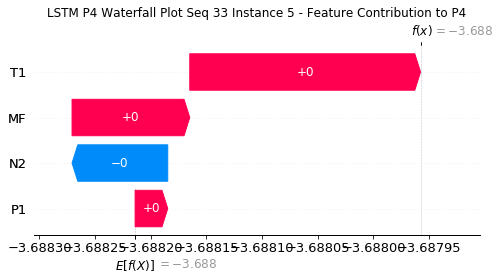

None

Contribution: [ 9.51202367e-06  1.13258783e-04 -1.55808665e-04 -2.76739393e-05]


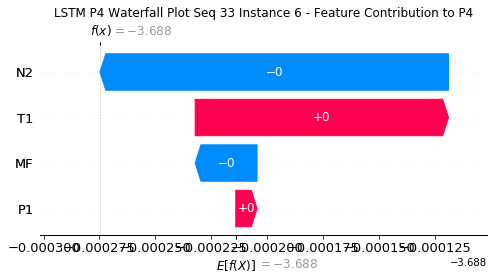

None

Contribution: [ 5.64811564e-05  8.20464246e-05 -1.63392647e-04  2.33093804e-05]


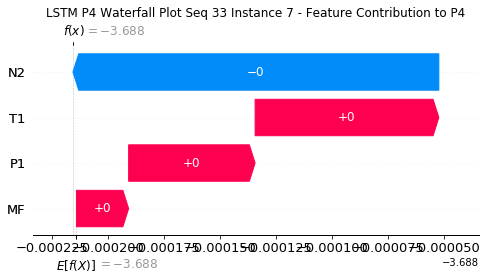

None

Contribution: [-8.84130694e-06  6.29928021e-05 -2.09603124e-04 -5.40890203e-05]


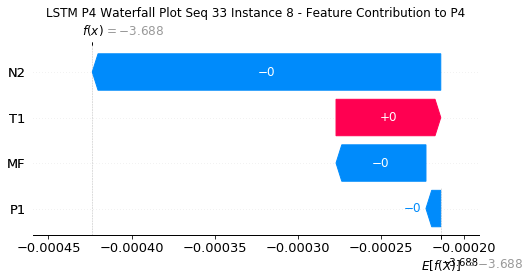

None

Contribution: [-2.99764246e-05  1.94369130e-05 -2.62197044e-04 -7.98867723e-05]


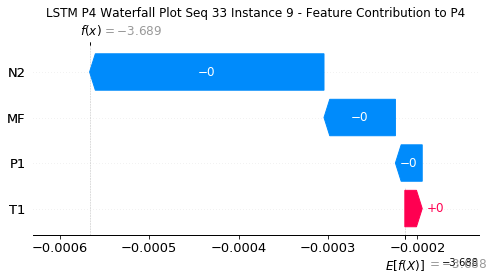

None

Contribution: [ 1.64681346e-05  3.59347773e-05 -2.73515800e-04 -7.96086104e-05]


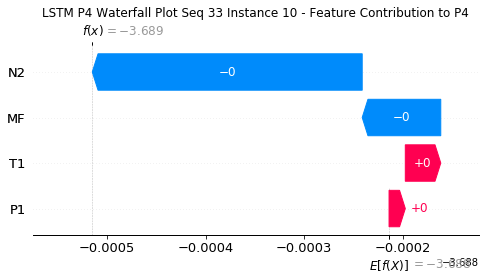

None

Contribution: [-4.68316921e-05  2.10988996e-05 -3.47328729e-04 -2.37318640e-04]


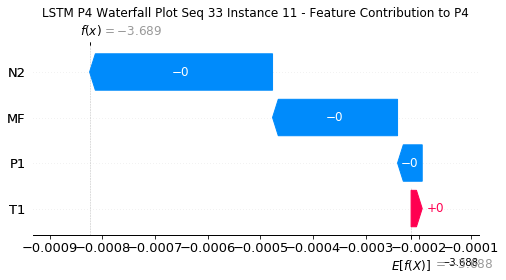

None

Contribution: [-5.10927313e-05  3.85969009e-05 -3.99575901e-04 -2.87311763e-04]


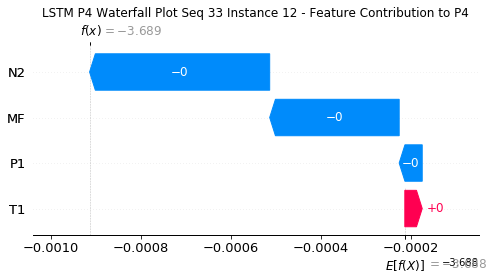

None

Contribution: [-1.05237024e-04  3.97870710e-05 -4.81699615e-04 -3.51479823e-04]


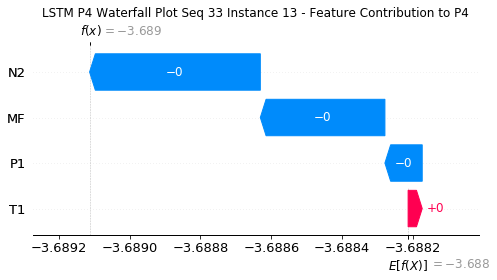

None

Contribution: [-1.15154880e-06 -3.48612494e-05 -5.06473748e-04 -2.44379944e-04]


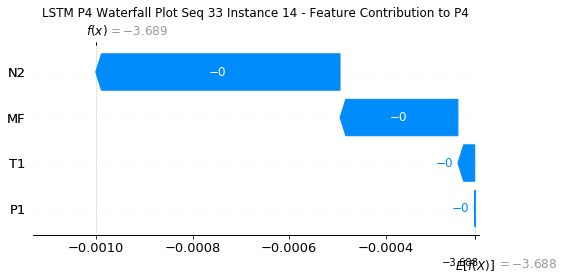

None

Contribution: [-5.82599858e-05  9.53946835e-05 -4.67765410e-04 -3.78211011e-04]


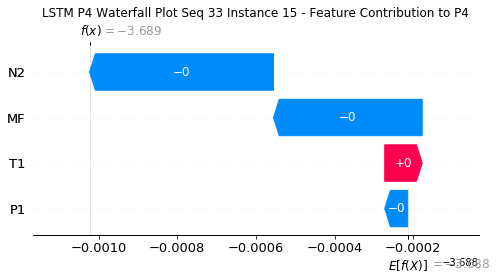

None

Contribution: [-8.75548556e-05  1.62389975e-04 -5.59810515e-04 -4.50472736e-04]


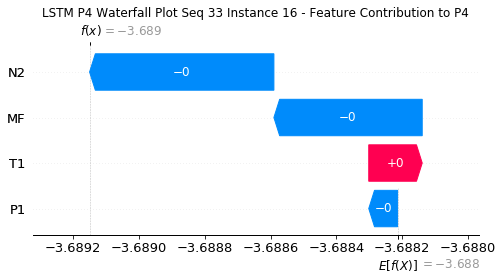

None

Contribution: [-6.65607177e-05 -4.14896640e-04 -1.39980923e-03 -1.06972043e-03]


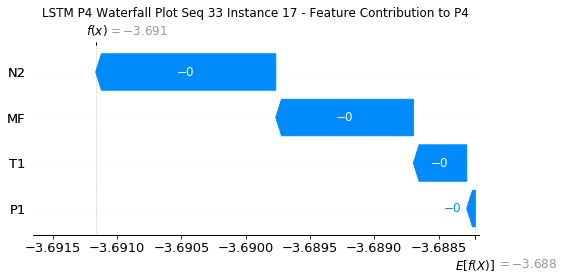

None

Contribution: [-0.00023729  0.00066083 -0.00104893 -0.00132504]


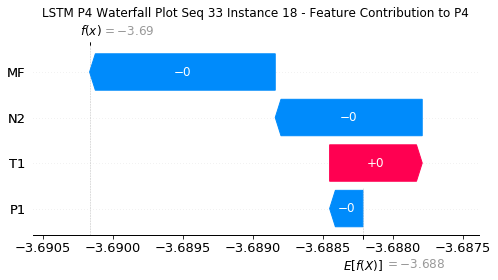

None

Contribution: [-0.00016225  0.00021438  0.00162152  0.00208225]


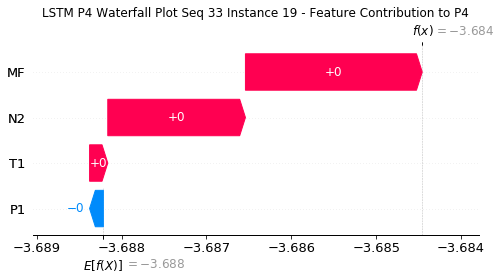

None

Contribution: [-0.00026991 -0.00438694 -0.00256708 -0.0010791 ]


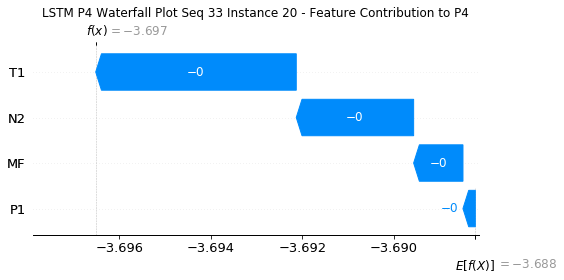

None

Contribution: [ 0.00079736  0.00722505 -0.00921992 -0.01432266]


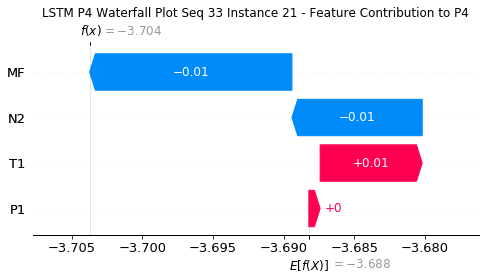

None

Contribution: [-0.00127518  0.00487944  0.00791074  0.00894778]


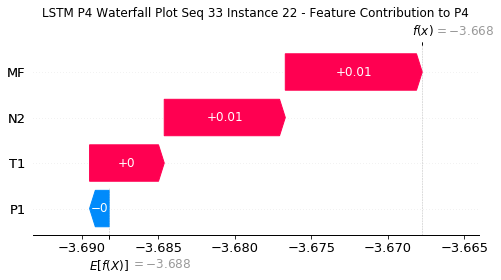

None

Contribution: [-0.0014359  -0.01579309  0.01014427  0.03528147]


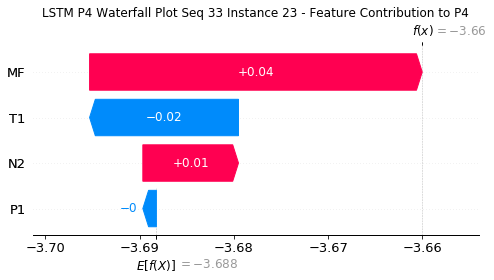

None

Contribution: [ 0.00029117  0.02093118 -0.03335571 -0.06530793]


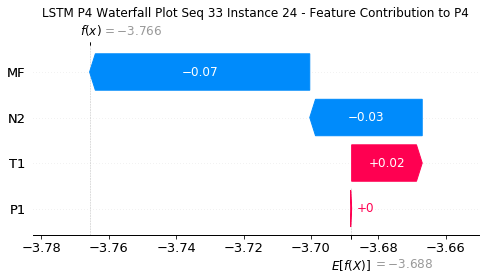

None

Contribution: [-0.00046308 -0.00224127 -0.00215572 -0.0017961 ]


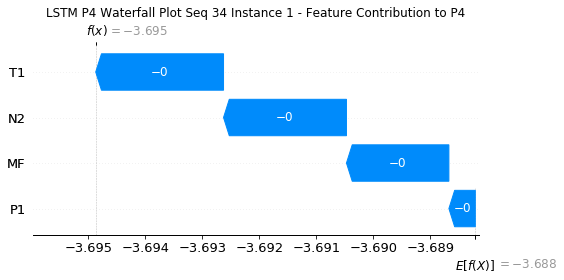

None

Contribution: [ 7.44847701e-05 -1.88987066e-04 -7.93714376e-05 -1.78349755e-05]


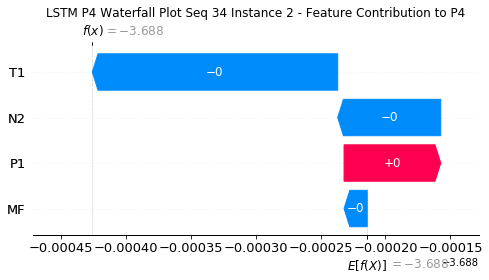

None

Contribution: [ 7.15079247e-05  2.76480887e-04 -7.98233054e-05 -5.75041319e-05]


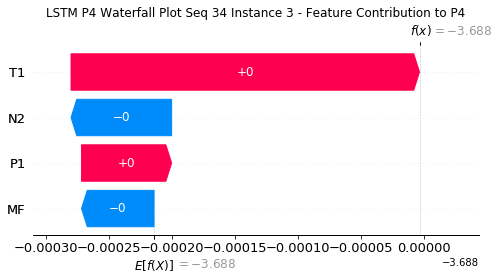

None

Contribution: [ 6.07585019e-05  2.85983786e-04 -6.11609447e-05  1.61933886e-04]


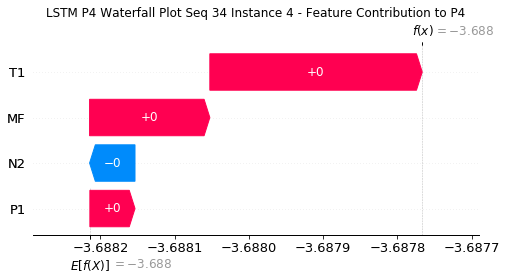

None

Contribution: [ 5.89257800e-05  2.50936419e-04 -9.84353862e-05  1.33738129e-04]


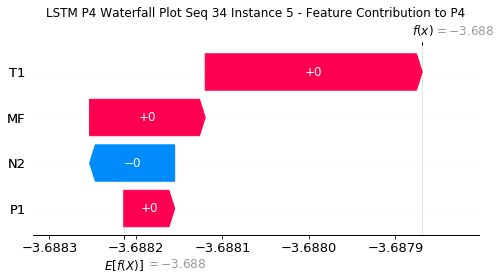

None

Contribution: [ 1.15462908e-04  1.87081150e-04 -1.47298558e-04  3.27991377e-05]


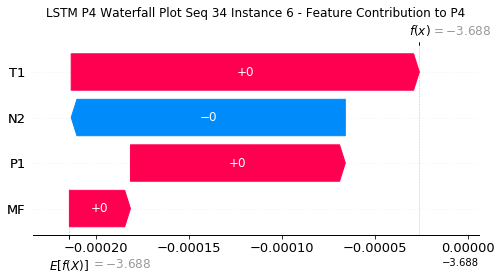

None

Contribution: [ 9.62767603e-05  1.05082144e-04 -1.69395226e-04  3.80293920e-05]


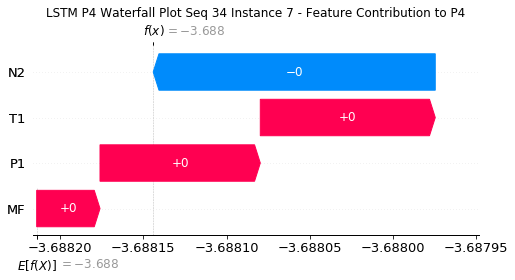

None

Contribution: [ 1.03255224e-04  6.46267592e-05 -2.04579238e-04 -5.95633894e-07]


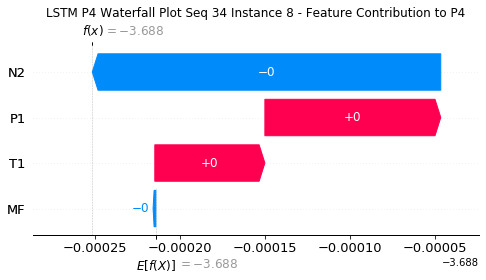

None

Contribution: [ 1.22338181e-04  5.83815670e-05 -2.63262641e-04 -1.60240407e-04]


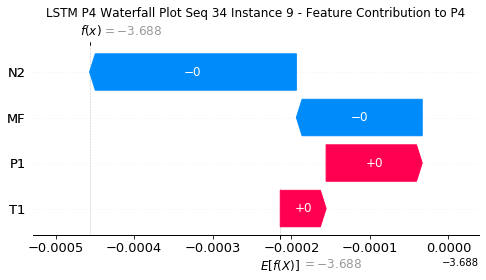

None

Contribution: [ 1.24892314e-04  3.98481705e-05 -2.72890557e-04 -1.19060985e-04]


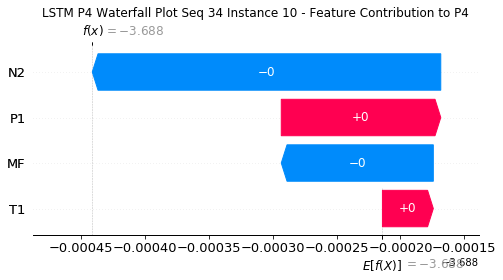

None

Contribution: [-1.80218552e-05  4.13202483e-05 -3.46687156e-04 -2.57304619e-04]


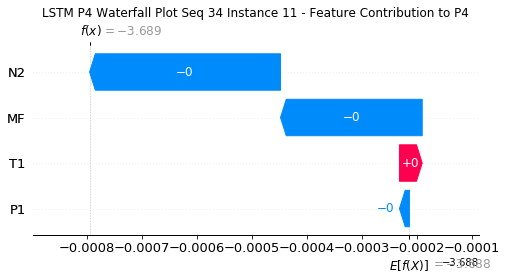

None

Contribution: [-2.87664315e-05  6.14594826e-05 -3.96583857e-04 -2.90703366e-04]


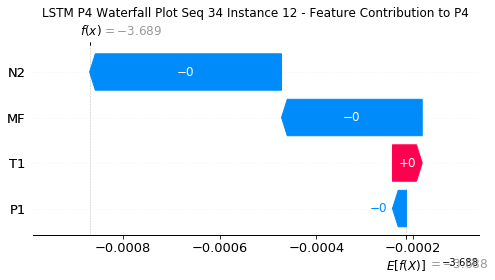

None

Contribution: [-3.11087707e-05  5.18973632e-05 -4.79327317e-04 -3.96091503e-04]


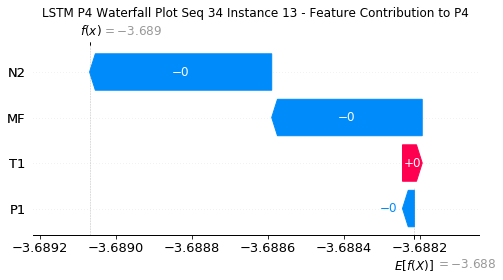

None

Contribution: [ 2.73087773e-05 -2.14644839e-05 -5.04024832e-04 -2.68691323e-04]


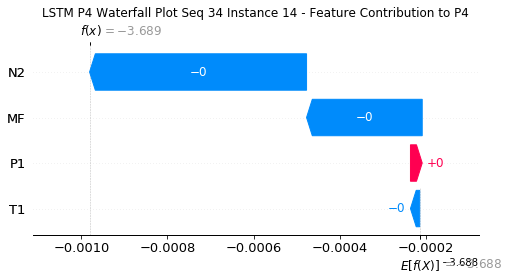

None

Contribution: [-1.19425167e-05  1.29569222e-04 -4.67455489e-04 -3.77975764e-04]


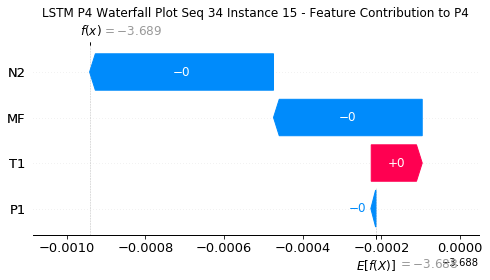

None

Contribution: [-7.53745366e-05  1.95365071e-04 -5.62675703e-04 -4.52739225e-04]


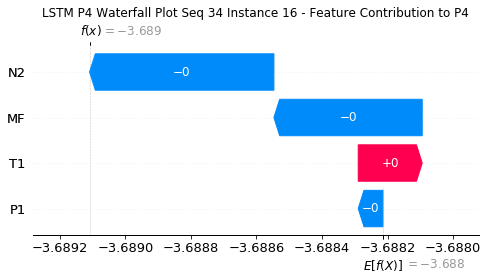

None

Contribution: [-5.36416978e-05 -4.29279848e-04 -1.38192848e-03 -1.08418292e-03]


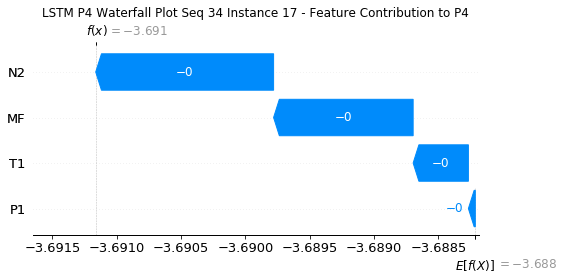

None

Contribution: [-0.00013745  0.00062231 -0.00104381 -0.00126284]


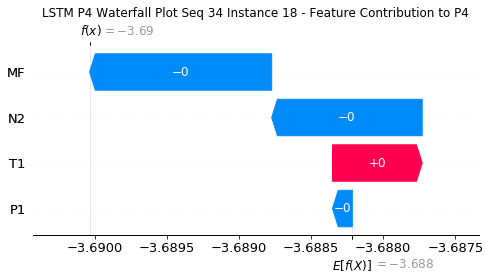

None

Contribution: [-0.00017522  0.00022303  0.00160418  0.00204314]


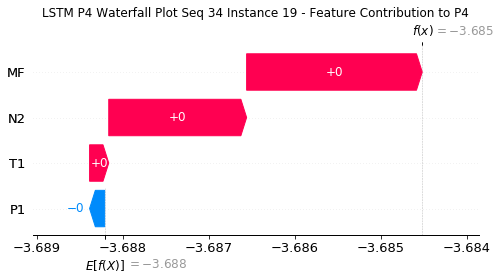

None

Contribution: [-0.00027282 -0.00461241 -0.00253584 -0.0010595 ]


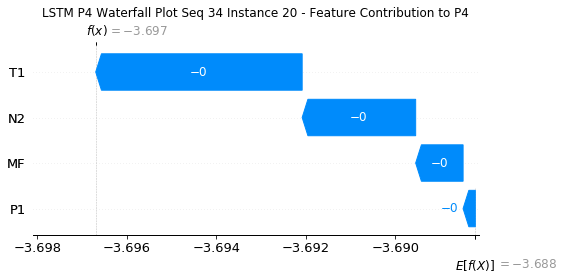

None

Contribution: [ 0.00082891  0.00747511 -0.00923297 -0.0132677 ]


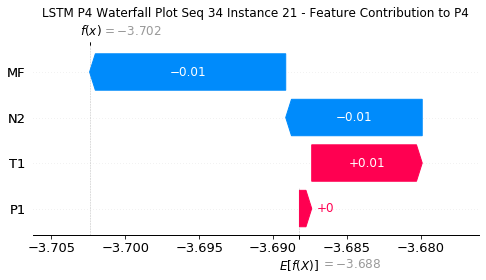

None

Contribution: [-0.00165797  0.0050322   0.00792848  0.00948795]


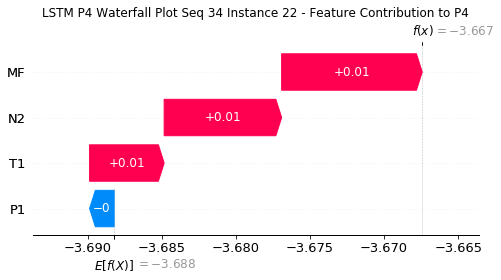

None

Contribution: [ 0.00034304 -0.01619684  0.01028897  0.02607702]


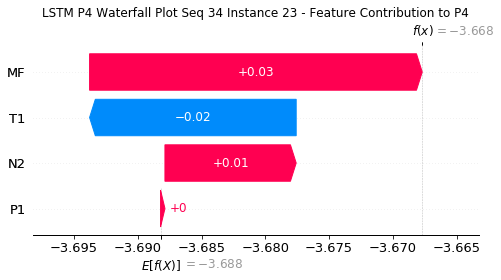

None

Contribution: [ 6.32733371e-06  2.23705382e-02 -3.44242685e-02 -5.77202755e-02]


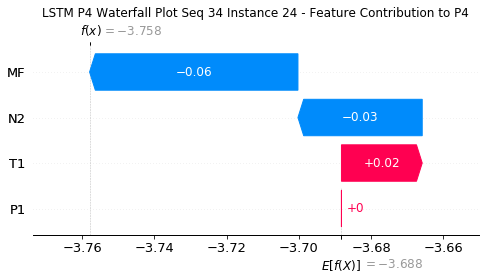

None

In [32]:
#Waterfall Plot for Local Accuracy & Consistency metrics
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P4 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [48]:
#calculate variables for control limit

std.stack().max(),std.stack().mean(),std.stack().std()

(34.58467568216679, 32.39223571306332, 0.7429785567545388)

In [49]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

2.9508791999064306

In [125]:
#Load NaN anomaly testing data

xtest_AD_file = "xNan.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [51]:
#Load NaN anomaly ground truth

ytest_AD_file = "yNan.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [52]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
y1_AD = preds_AD[2]
y_AD = tf.keras.backend.get_value(y_AD)
y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, tens_draw1_AD

(array([1281.82746631]), array([[nan]], dtype=float32))

In [53]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [54]:
hour_NUM2 = ['3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm']

invalid value encountered in greater
invalid value encountered in less
invalid value encountered in less_equal


0


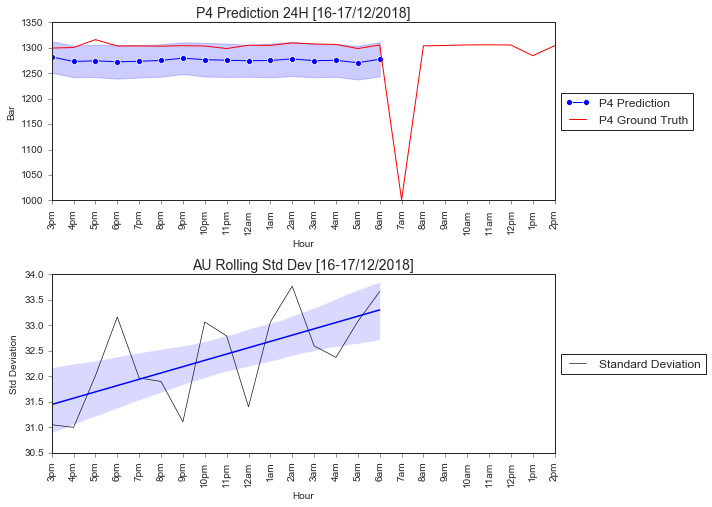

In [55]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['P4'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="P4 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="P4 Ground Truth")
    plt.title('P4 Prediction 24H [16-17/12/2018]',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],scatter = False)
    plt.title('AU Rolling Std Dev [16-17/12/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [102]:
#SHAP Force Plot for NaN anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [74]:
#Load Null anomaly testing data

xtest_AD_ALL_file = "xNull.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [75]:
#Load Null anomaly ground truth

ytest_AD_ALL_file = "yNull.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [76]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, tens_draw1_AD_ALL

(array([1264.06887292]), array([[-3.8402958]], dtype=float32))

In [77]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [78]:
hour_NUM3 = ['6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm',]

0


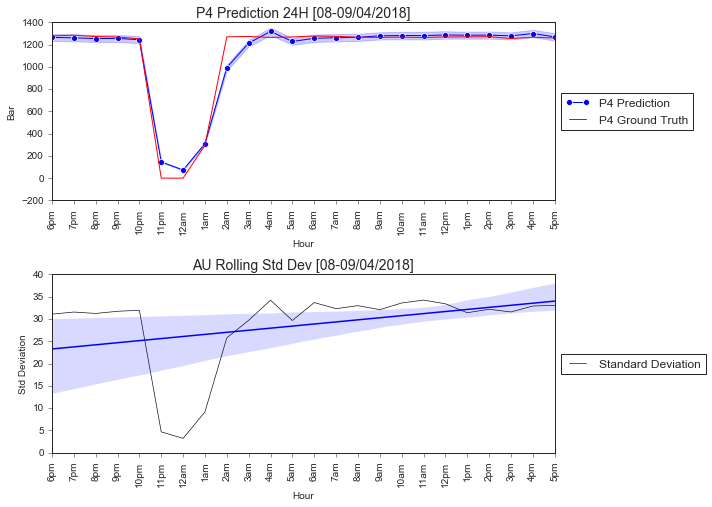

In [79]:
#Visualize anomaly prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Bar']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['P4'][x]
    max_RUL_Arrange.columns = ['Hour','Bar']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','Bar']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Bar",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="P4 Prediction")
    sns.lineplot(x="Hour", y="Bar", data = max_RUL_Arrange, color='red', ax=ax,label="P4 Ground Truth")
    plt.title('P4 Prediction 24H [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Bar', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Bar'],scatter = False)
    plt.title('AU Rolling Std Dev [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

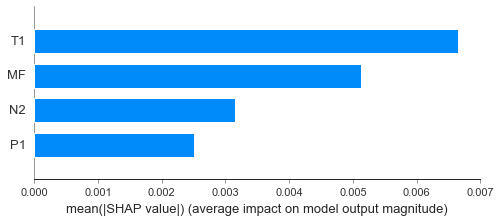

In [80]:
#Summary Plot for anomaly

instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="bar")

In [81]:
#SHAP Force Plot for Null anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [82]:
#export data for CUSUM MATLAB

min_Std_Arrange.to_csv(r'C:\Users\Asus\OneDrive - Universiti Teknologi PETRONAS\New folder\P4_2\AD.csv', index = False)

In [33]:
#Define New LSTM without probabilistic layers for Consistency metric

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 65)            17940     
_________________________________________________________________
dense_5 (Dense)              (None, 24, 495)           32670     
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             496       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 51,106
Trainable params: 51,106
Non-trainable params: 0
_________________________________________________________________


In [34]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [35]:
#Transfer weights from previous LSTM to new LSTM

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [36]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [37]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [38]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [-0.00040202 -0.00093813  0.00031089]


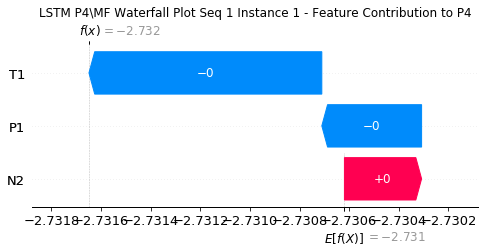

None

Contribution: [-0.00029409 -0.00018029  0.00029559]


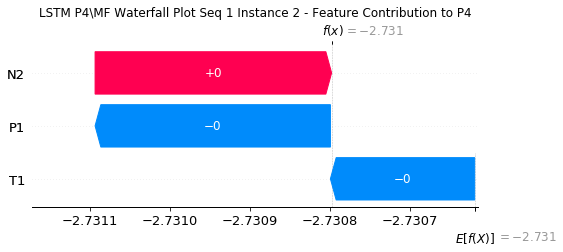

None

Contribution: [-0.0004345  -0.00054809  0.00076449]


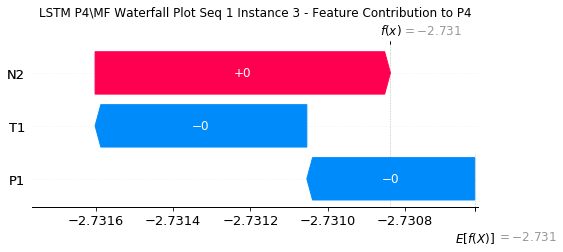

None

Contribution: [-2.87412805e-04  8.58502165e-06  7.67135813e-04]


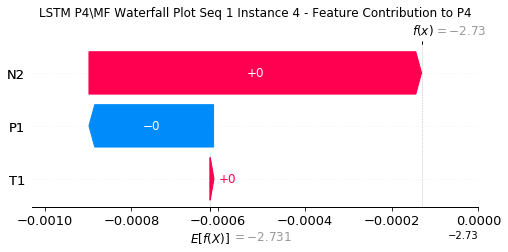

None

Contribution: [-0.00071577  0.00101212  0.00090788]


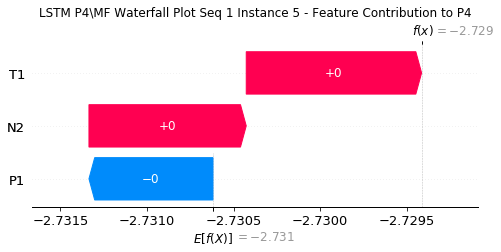

None

Contribution: [-0.00168572 -0.00185795  0.00052489]


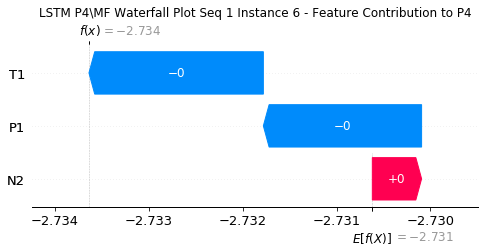

None

Contribution: [-0.00169781 -0.00224079 -0.00399071]


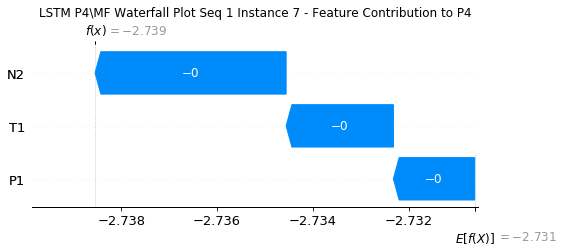

None

Contribution: [ 0.00137722  0.01034461 -0.00315595]


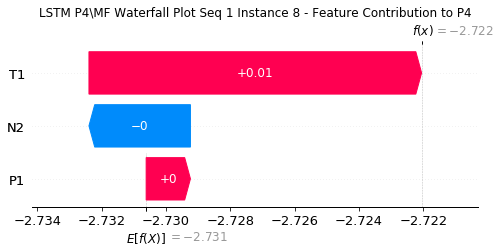

None

Contribution: [0.00508697 0.0113012  0.00459916]


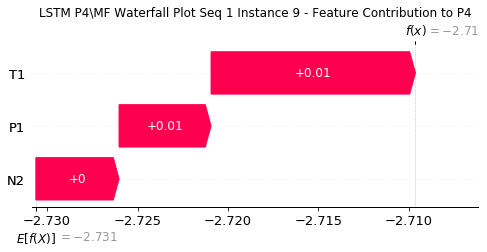

None

Contribution: [ 0.0008156  -0.01307833  0.00549537]


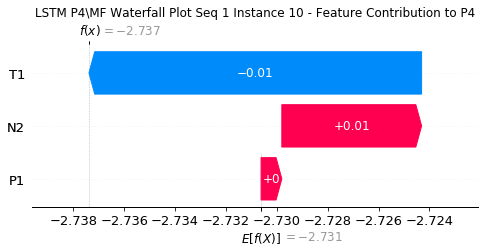

None

Contribution: [-0.00451108 -0.01763627 -0.00321836]


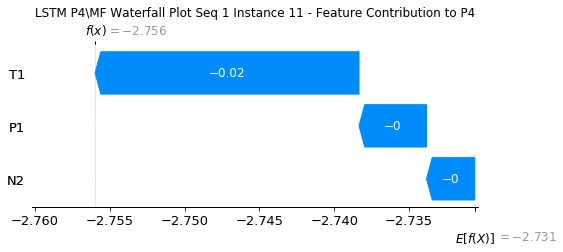

None

Contribution: [-0.00179421  0.01382342 -0.00740991]


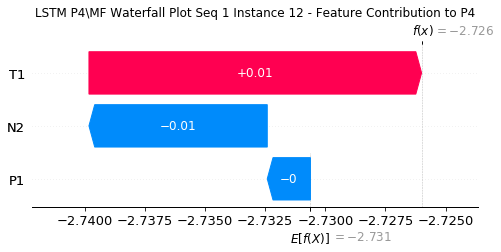

None

Contribution: [0.00399362 0.02190477 0.00243005]


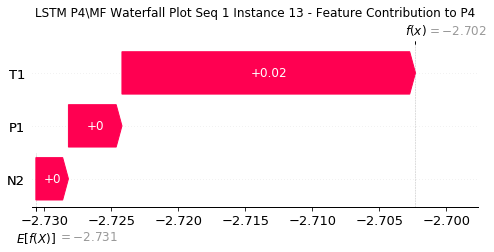

None

Contribution: [ 0.00413272 -0.00909215  0.00684914]


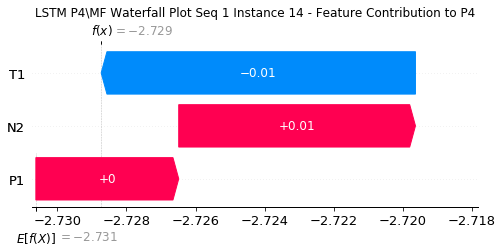

None

Contribution: [-0.00331933 -0.02280165 -0.0026464 ]


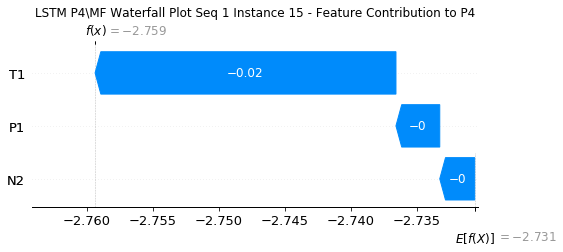

None

Contribution: [-0.00361507  0.00818077 -0.00967351]


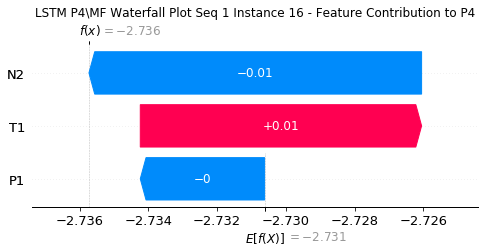

None

Contribution: [0.00454208 0.02488048 0.0013158 ]


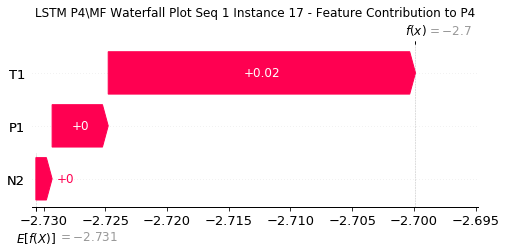

None

Contribution: [ 0.00360608 -0.0028572   0.01247641]


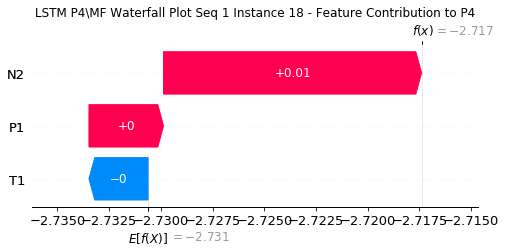

None

Contribution: [-0.0018575  -0.02322274 -0.00202312]


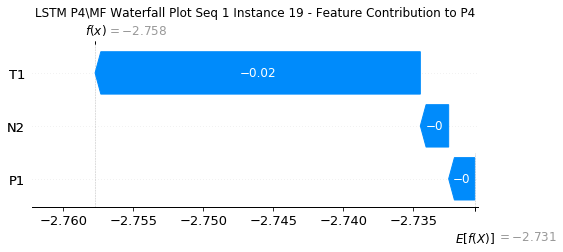

None

Contribution: [-0.00298955  0.00632171 -0.01940326]


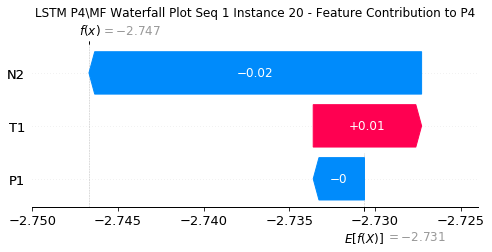

None

Contribution: [ 0.00229269  0.02706032 -0.00239307]


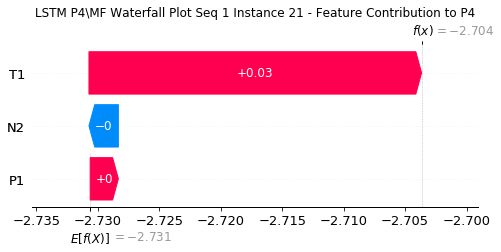

None

Contribution: [ 0.00205947 -0.00516417  0.02224674]


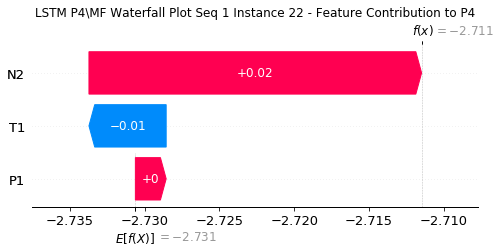

None

Contribution: [ 0.00321856 -0.00343447 -0.00743437]


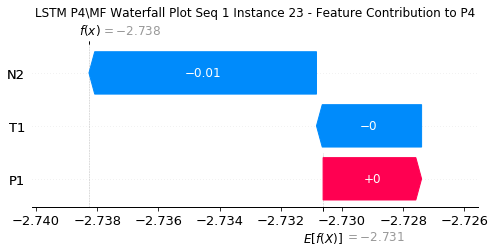

None

Contribution: [-0.00153101  0.0094598  -0.03461716]


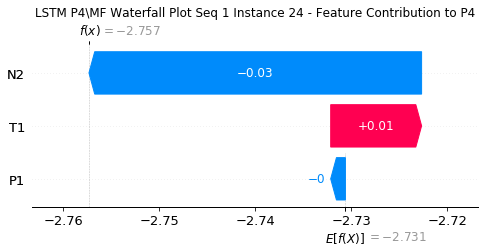

None

Contribution: [-0.00022484 -0.0008448   0.00035363]


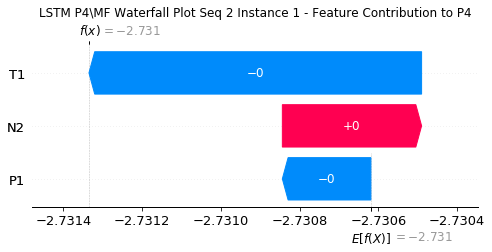

None

Contribution: [-0.00021713 -0.00012225  0.00019694]


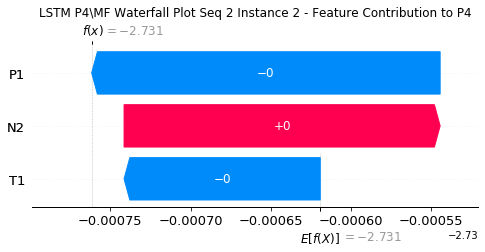

None

Contribution: [-0.0003017  -0.00039757  0.00065984]


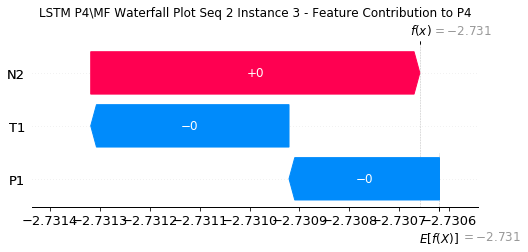

None

Contribution: [-2.16022356e-04 -3.22463012e-05  7.01098167e-04]


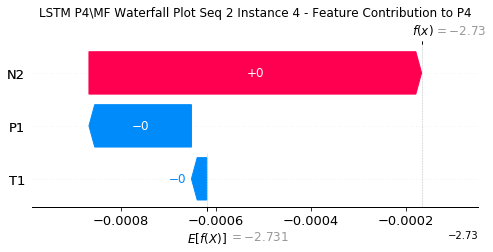

None

Contribution: [-0.00052353  0.000868    0.00052653]


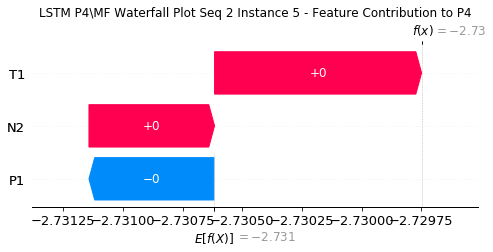

None

Contribution: [-0.00115082 -0.00134046  0.00011004]


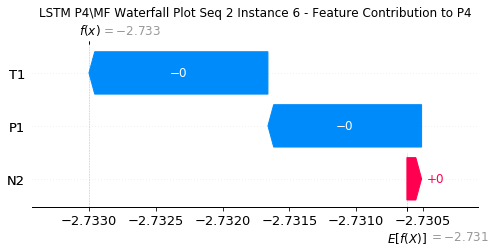

None

Contribution: [-0.0015644  -0.00209139 -0.0014187 ]


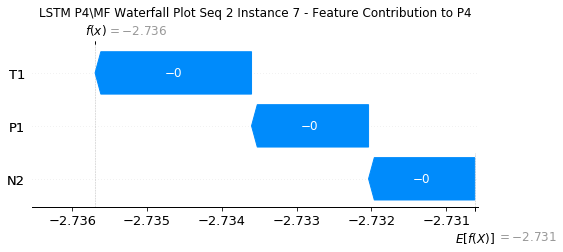

None

Contribution: [0.00118327 0.01007514 0.00049098]


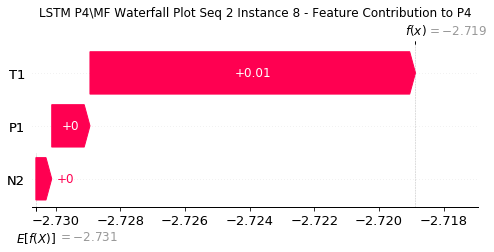

None

Contribution: [0.00312907 0.01109081 0.00189519]


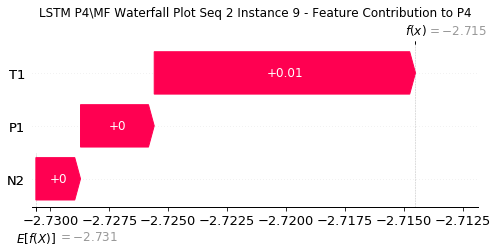

None

Contribution: [ 0.00051936 -0.00911559  0.00140337]


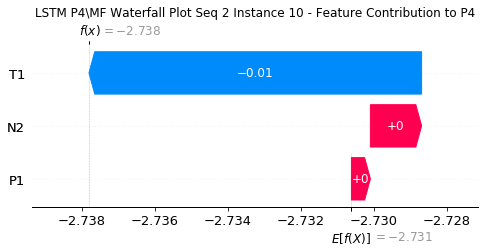

None

Contribution: [-0.00383222 -0.01231001 -0.00251601]


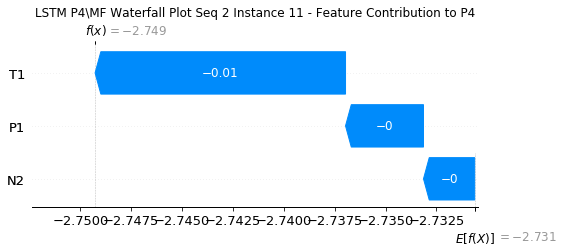

None

Contribution: [-0.00178776  0.01136626 -0.00269881]


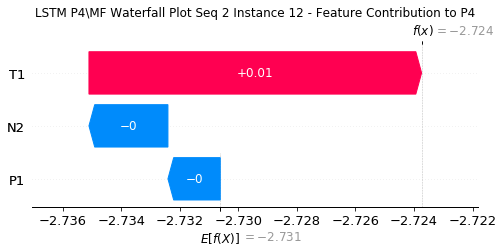

None

Contribution: [0.00347806 0.01656123 0.00246476]


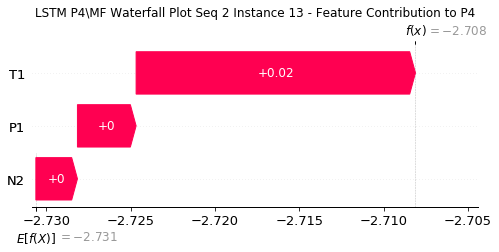

None

Contribution: [ 0.00365196 -0.00658488  0.0030622 ]


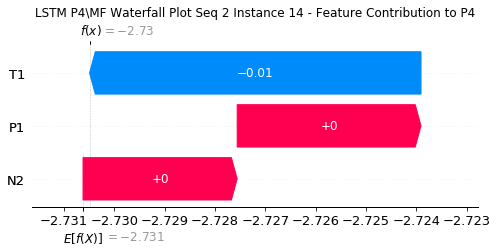

None

Contribution: [-0.0032105  -0.01687518 -0.00333442]


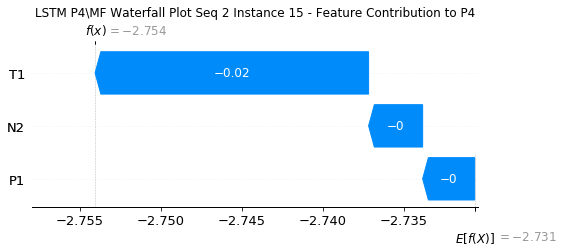

None

Contribution: [-0.00343603  0.00552408 -0.00415154]


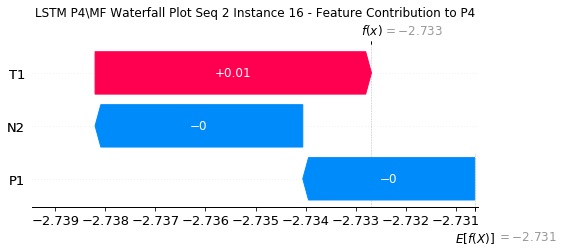

None

Contribution: [0.00496922 0.02140805 0.00315741]


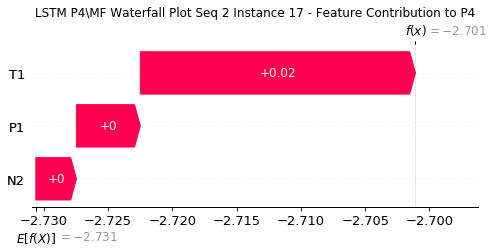

None

Contribution: [ 0.00375141 -0.00219889  0.00790359]


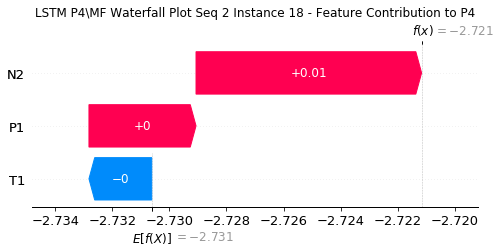

None

Contribution: [-0.00180351 -0.01831758 -0.0036825 ]


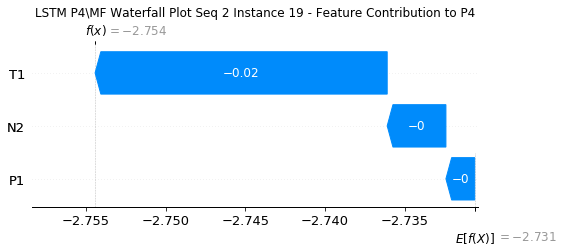

None

Contribution: [-0.0028846   0.00516094 -0.01462923]


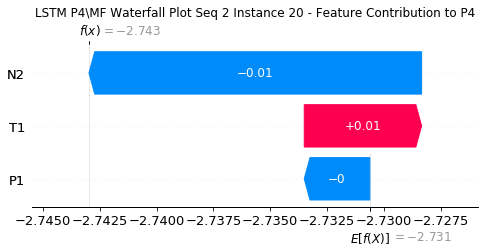

None

Contribution: [0.0022524  0.02195506 0.00021881]


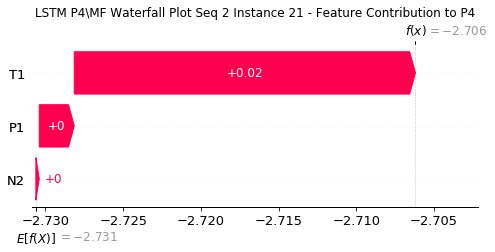

None

Contribution: [ 0.00161812 -0.0044625   0.01510641]


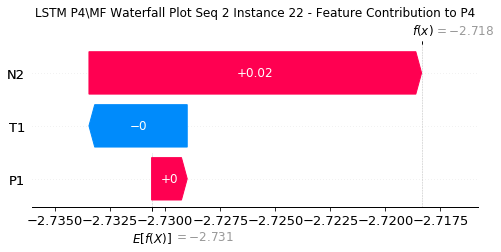

None

Contribution: [ 0.00690122 -0.00326344 -0.00871418]


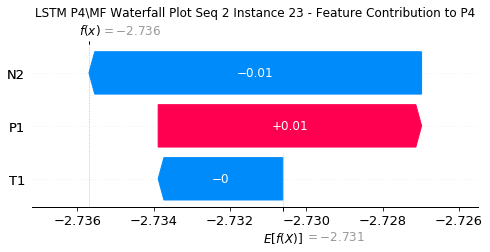

None

Contribution: [-0.00198052  0.02350558 -0.03371198]


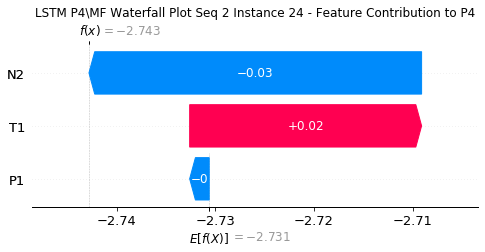

None

Contribution: [-0.0002946  -0.0014417   0.00030815]


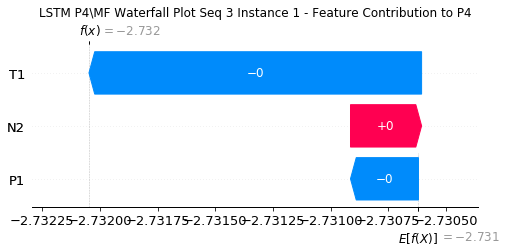

None

Contribution: [-0.00023375 -0.00041081  0.00019078]


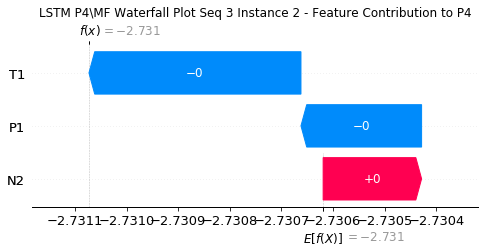

None

Contribution: [-0.00033674 -0.00093277  0.00056378]


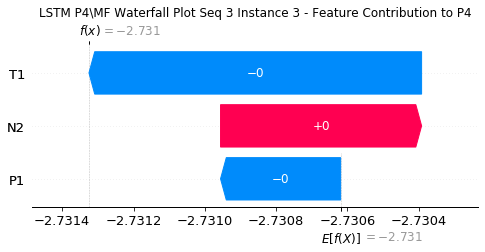

None

Contribution: [-0.00020793  0.00015693  0.00064206]


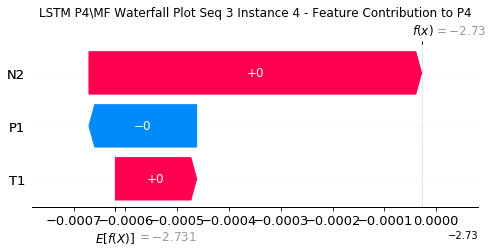

None

Contribution: [-0.00060025  0.00120901  0.00075086]


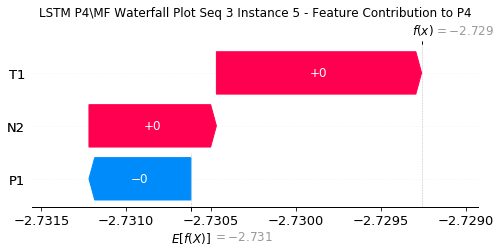

None

Contribution: [-0.00134812 -0.00318568  0.00010562]


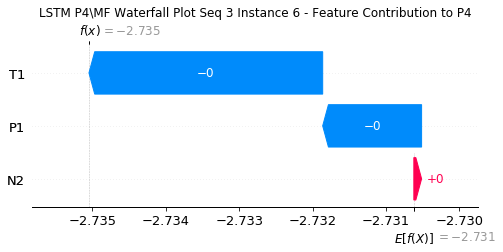

None

Contribution: [-0.00218583 -0.00303007 -0.0008808 ]


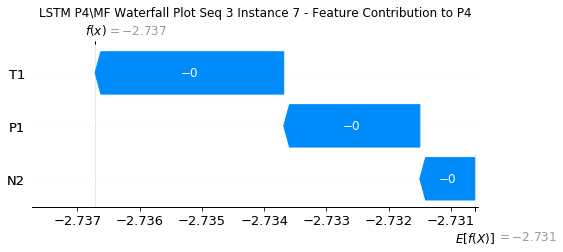

None

Contribution: [0.00091101 0.02496862 0.00081682]


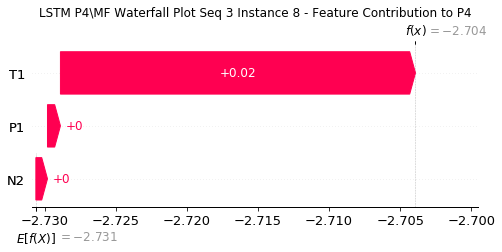

None

Contribution: [0.00542163 0.02440394 0.00157767]


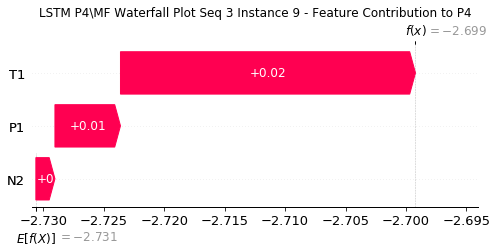

None

Contribution: [ 0.00093677 -0.02315322  0.00179579]


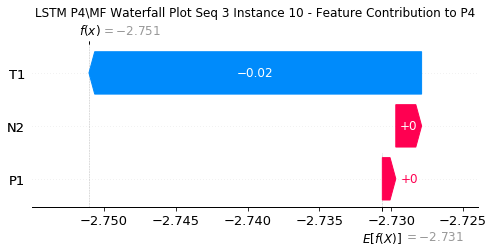

None

Contribution: [-0.00437764 -0.03113167 -0.00241234]


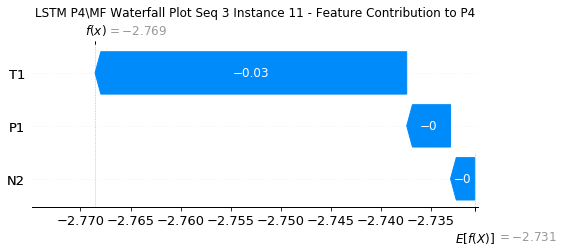

None

Contribution: [-0.00231293  0.02357131 -0.00153385]


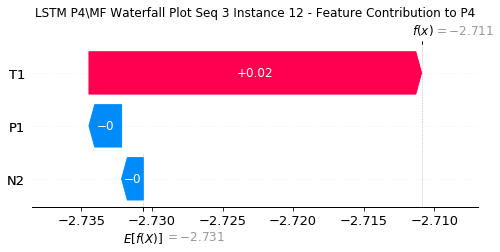

None

Contribution: [0.00422654 0.0401355  0.0023223 ]


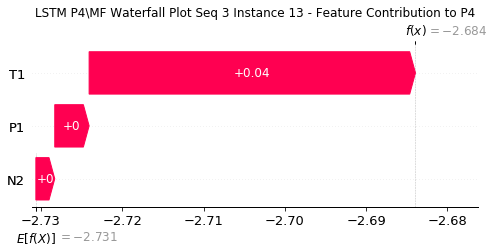

None

Contribution: [ 0.00278239 -0.01597903  0.00215911]


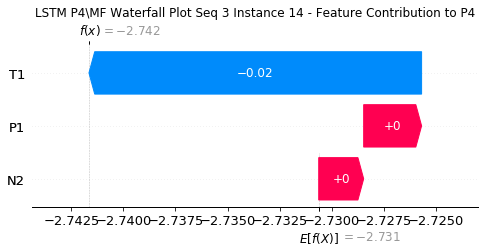

None

Contribution: [-0.00393265 -0.04239405 -0.00319044]


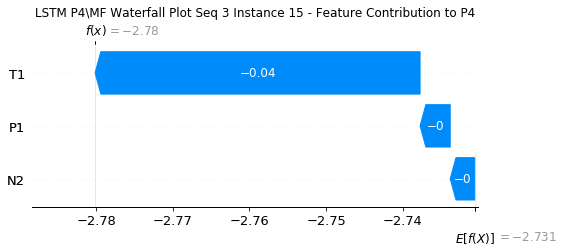

None

Contribution: [-0.0042764   0.01672851 -0.00491507]


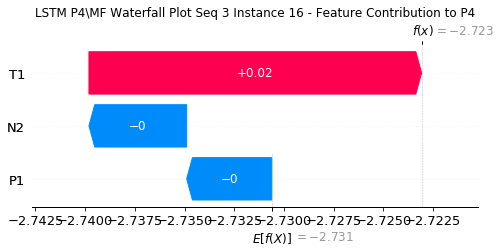

None

Contribution: [0.00405513 0.05151393 0.0031177 ]


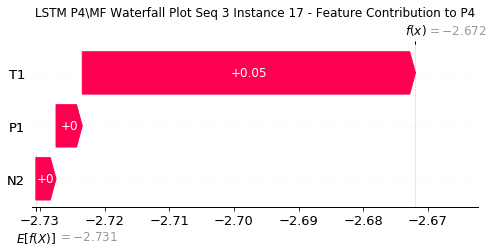

None

Contribution: [ 0.00504795 -0.00555813  0.00775793]


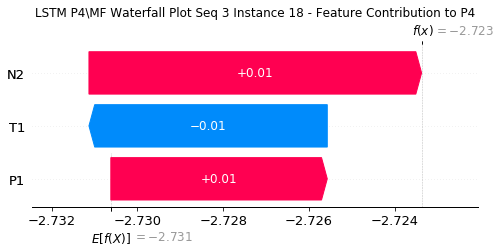

None

Contribution: [-0.00250758 -0.04580235 -0.00368129]


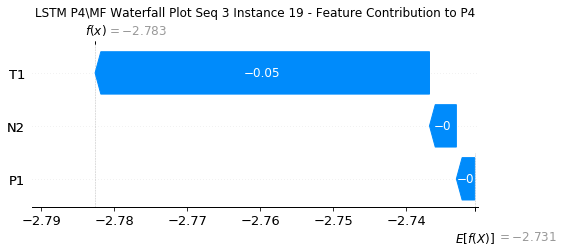

None

Contribution: [-0.00405607  0.01669785 -0.01376048]


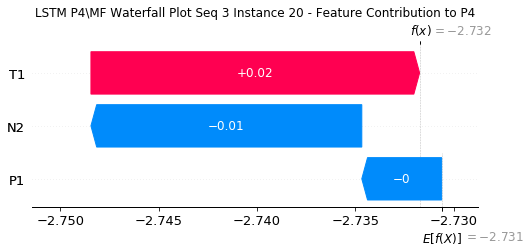

None

Contribution: [0.00282434 0.0608768  0.00045189]


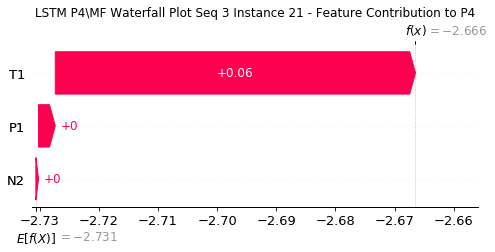

None

Contribution: [ 0.00352398 -0.00707747  0.01631847]


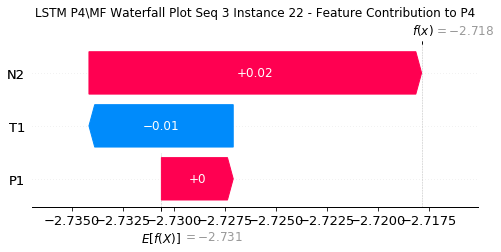

None

Contribution: [ 0.00509755  0.0042731  -0.00889328]


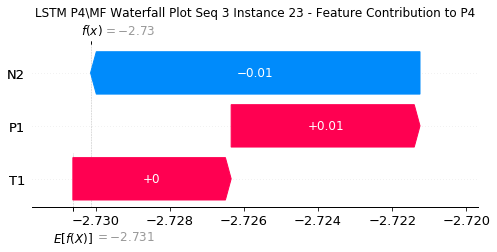

None

Contribution: [-0.00187182  0.04132608 -0.03003835]


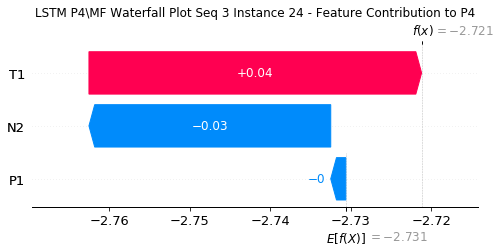

None

Contribution: [-3.34900862e-04 -1.60207214e-03  8.85525960e-05]


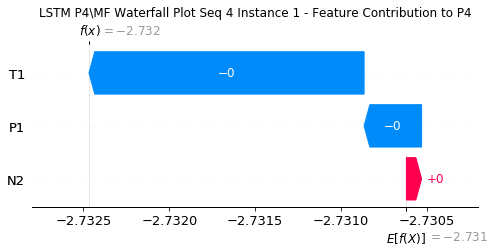

None

Contribution: [-0.00025613 -0.00038564  0.00010867]


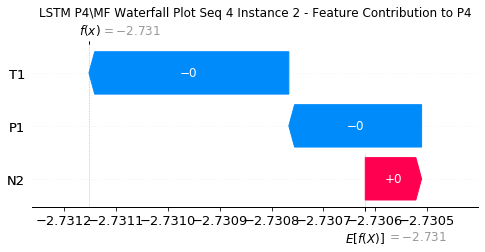

None

Contribution: [-0.00032102 -0.00080383  0.00052523]


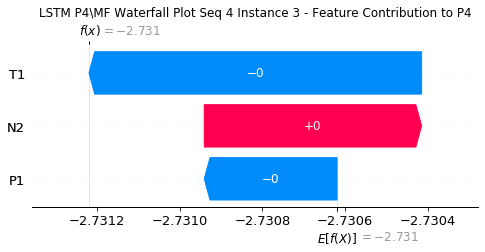

None

Contribution: [-0.00019538  0.00025337  0.00063667]


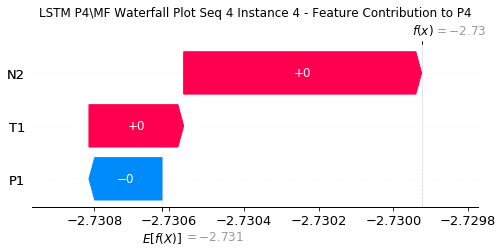

None

Contribution: [-0.00053083  0.00103839  0.00057835]


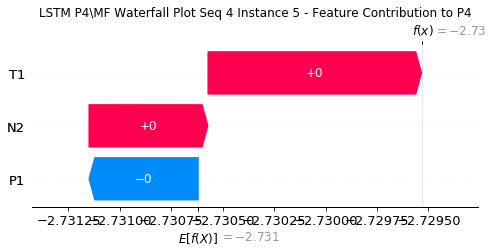

None

Contribution: [-1.28930520e-03 -3.08346037e-03 -3.82374466e-05]


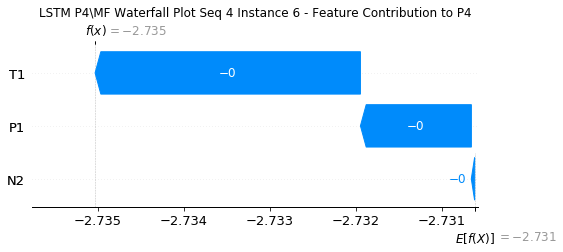

None

Contribution: [-0.0013748  -0.00283905 -0.00141229]


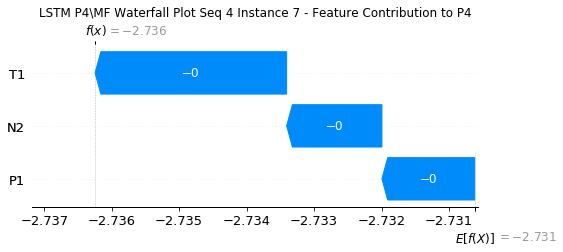

None

Contribution: [ 0.00096663  0.02303428 -0.00035255]


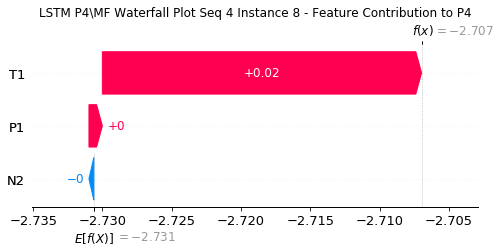

None

Contribution: [0.0051765  0.02263813 0.00206916]


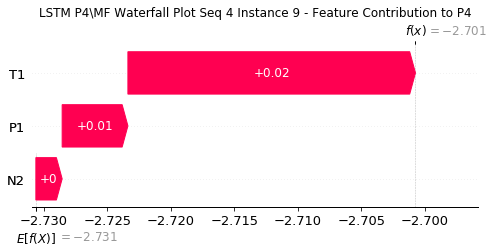

None

Contribution: [ 0.00073324 -0.02291041  0.00204013]


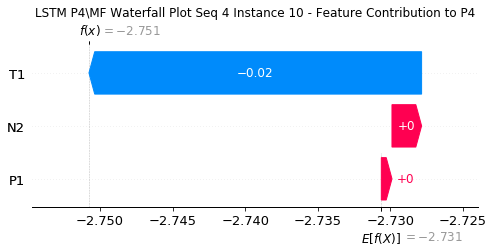

None

Contribution: [-0.00368349 -0.03127833 -0.00246903]


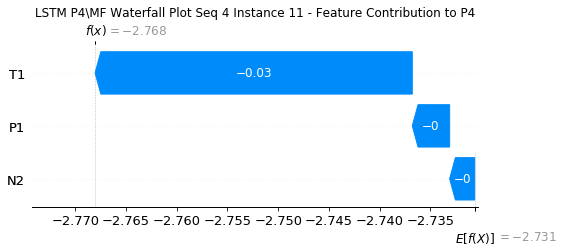

None

Contribution: [-0.0035475   0.02497267 -0.00230059]


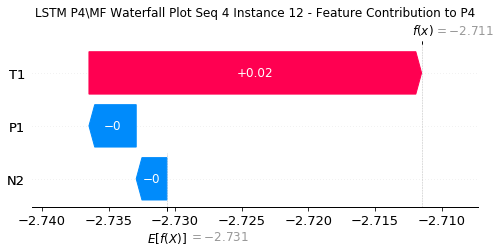

None

Contribution: [0.00367638 0.04093317 0.00230219]


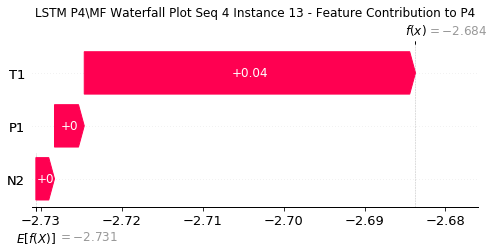

None

Contribution: [ 0.00199042 -0.01745251  0.00462426]


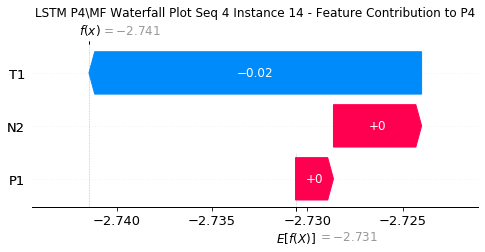

None

Contribution: [-0.00323228 -0.0440865  -0.00302695]


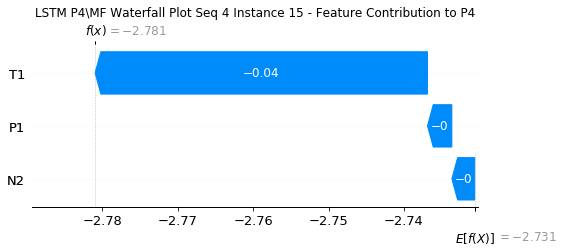

None

Contribution: [-0.00368203  0.01731312 -0.00622019]


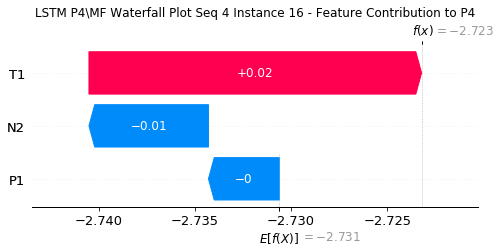

None

Contribution: [0.00309828 0.05370992 0.00252256]


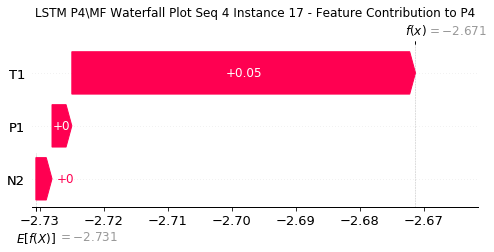

None

Contribution: [ 0.00396894 -0.00601529  0.00863068]


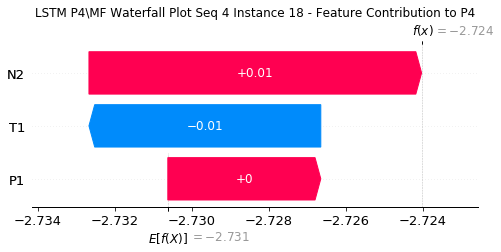

None

Contribution: [-0.00218718 -0.04860023 -0.00329364]


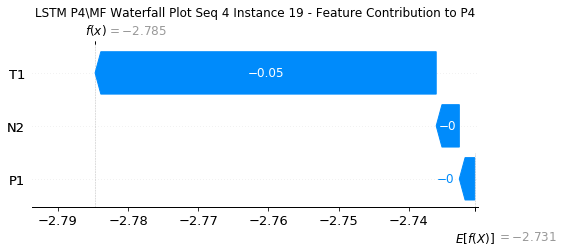

None

Contribution: [-0.00361159  0.01800518 -0.01488071]


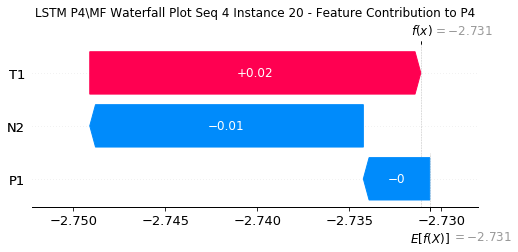

None

Contribution: [ 0.00272218  0.06337174 -0.00033765]


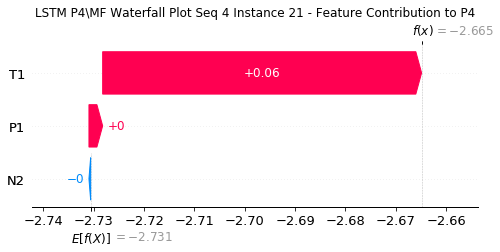

None

Contribution: [ 0.00369503 -0.00716179  0.01705875]


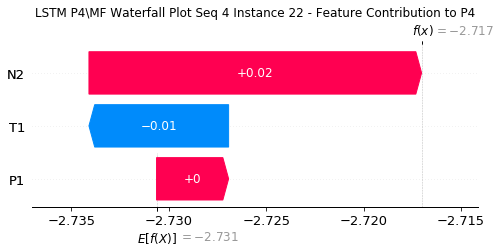

None

Contribution: [ 0.00381162  0.00356674 -0.00891307]


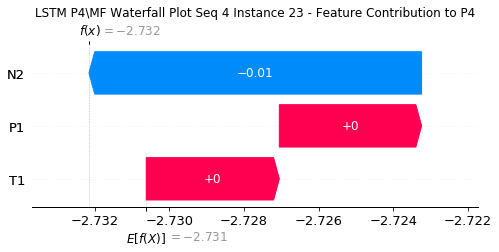

None

Contribution: [-0.00168738  0.04105265 -0.03258041]


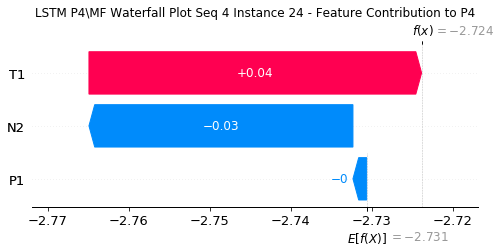

None

Contribution: [-0.00025616 -0.0016308   0.00013545]


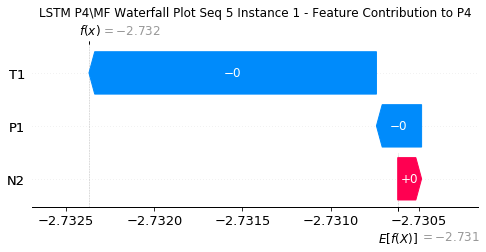

None

Contribution: [-0.00022165 -0.00047641  0.00010404]


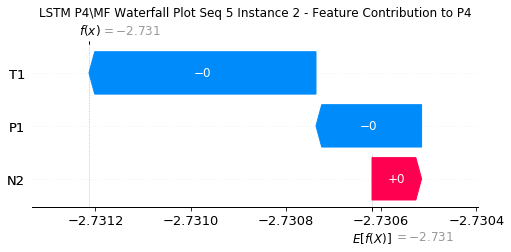

None

Contribution: [-0.00032548 -0.00095203  0.00055855]


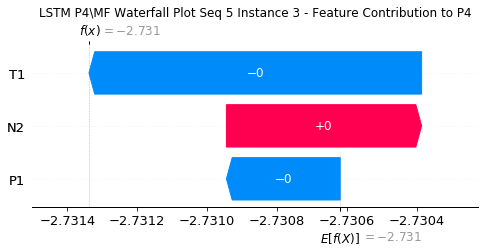

None

Contribution: [-0.00018789  0.00031863  0.00064457]


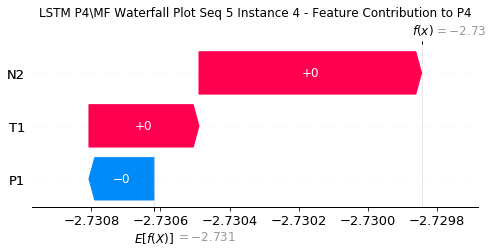

None

Contribution: [-0.00043485  0.00118209  0.00059391]


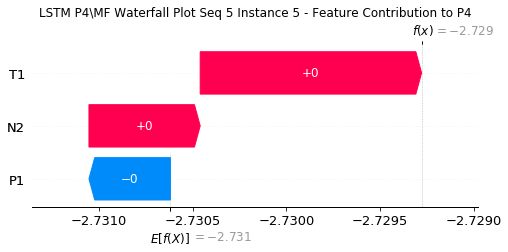

None

Contribution: [-1.23618797e-03 -3.39447140e-03  8.80732469e-05]


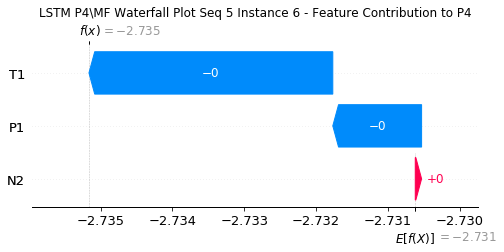

None

Contribution: [-0.00150662 -0.00278398 -0.00169754]


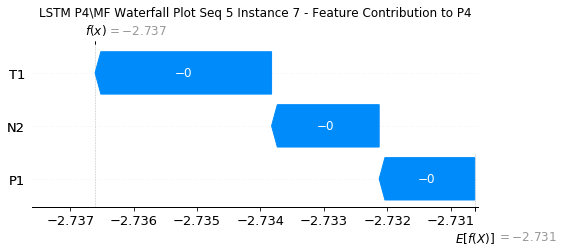

None

Contribution: [1.17769687e-03 2.45995183e-02 9.25321983e-06]


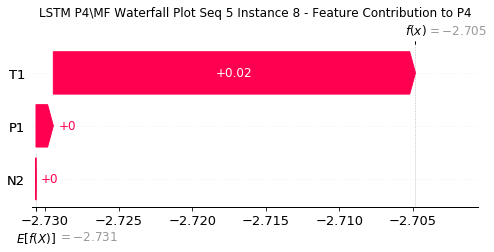

None

Contribution: [0.00445348 0.02395754 0.00237707]


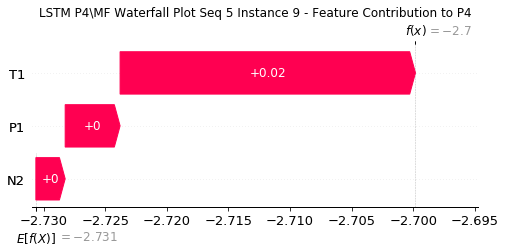

None

Contribution: [ 0.00053254 -0.02430136  0.00263241]


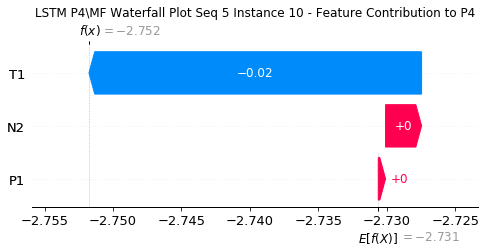

None

Contribution: [-0.00339136 -0.03313721 -0.00253811]


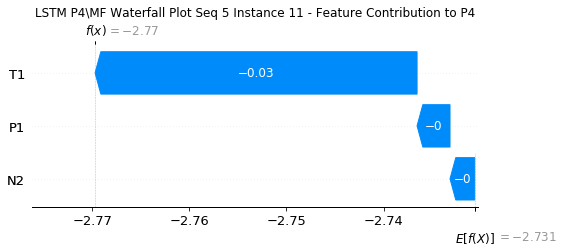

None

Contribution: [-0.00273367  0.0239566  -0.00353706]


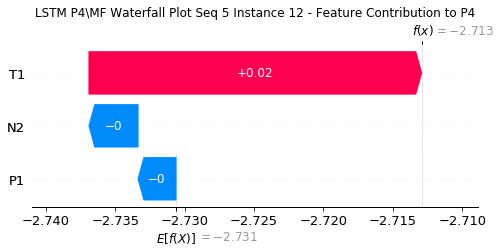

None

Contribution: [0.00324087 0.04254538 0.00225698]


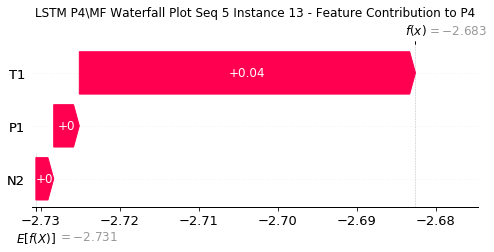

None

Contribution: [ 0.00170339 -0.01721632  0.00340725]


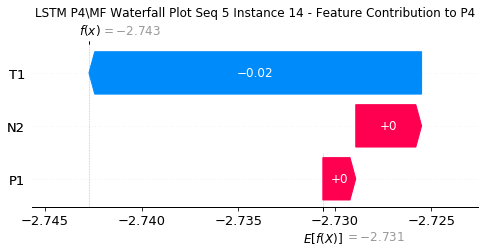

None

Contribution: [-0.00300106 -0.04581023 -0.0029235 ]


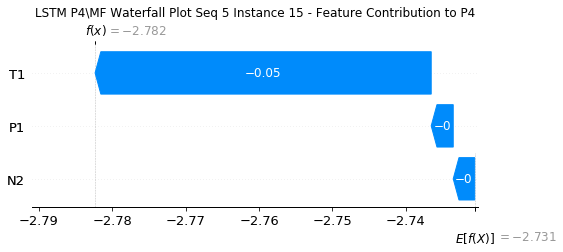

None

Contribution: [-0.00355952  0.01811527 -0.00647732]


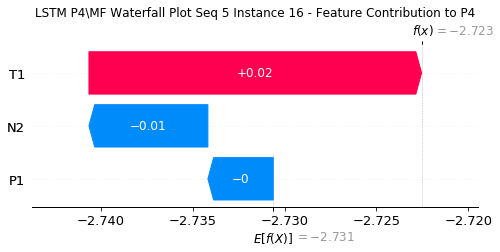

None

Contribution: [0.00453238 0.0583242  0.00273981]


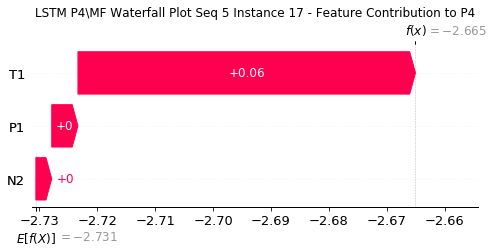

None

Contribution: [ 0.00446719 -0.00636892  0.00898709]


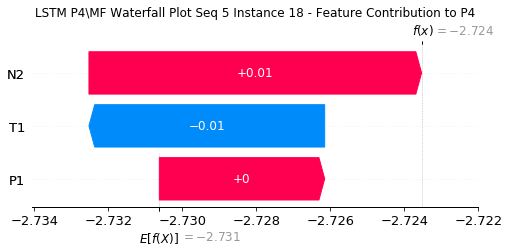

None

Contribution: [-0.00243531 -0.05119026 -0.00319567]


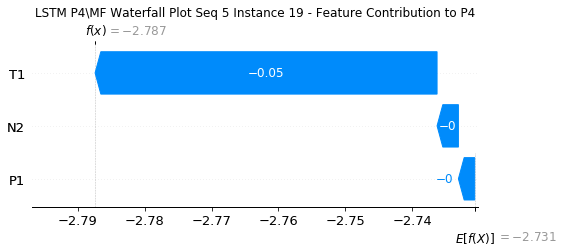

None

Contribution: [-0.00399439  0.01893394 -0.01533326]


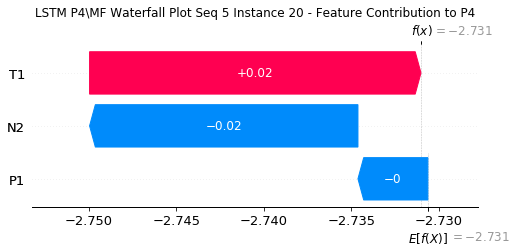

None

Contribution: [ 0.00278948  0.06509044 -0.00039551]


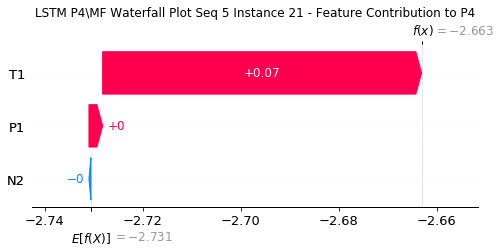

None

Contribution: [ 0.00416218 -0.00704708  0.0172304 ]


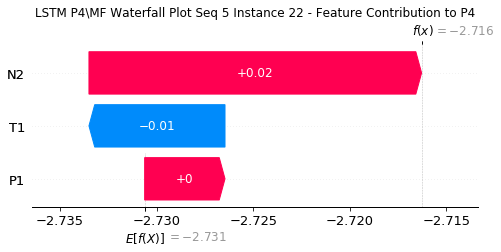

None

Contribution: [ 0.00877314  0.00386577 -0.00904774]


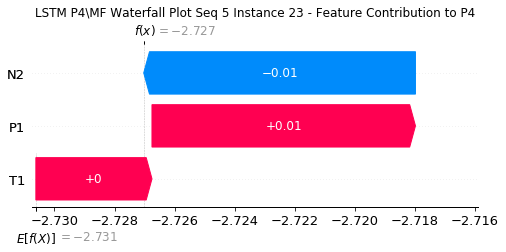

None

Contribution: [-0.00207459  0.04149369 -0.03224086]


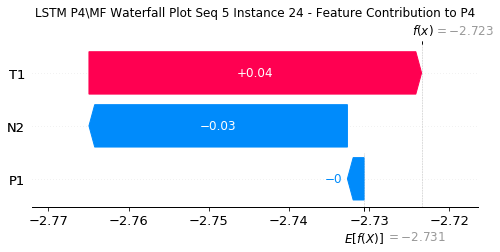

None

Contribution: [-0.00033331 -0.00160133  0.0001678 ]


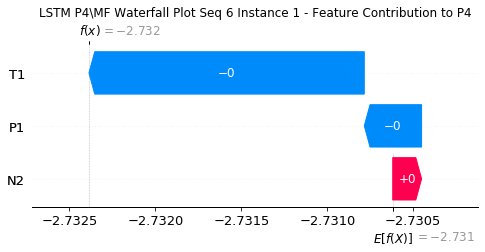

None

Contribution: [-0.00023131 -0.00045206  0.00014361]


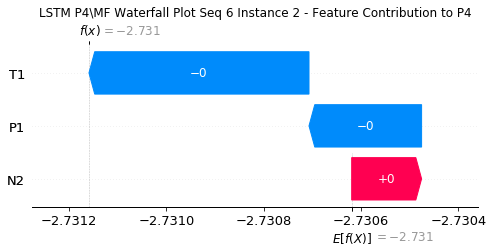

None

Contribution: [-0.00037381 -0.0008994   0.00051133]


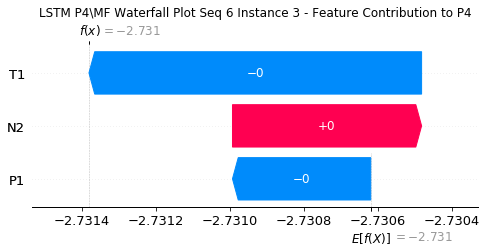

None

Contribution: [-0.00021199  0.0002436   0.00063415]


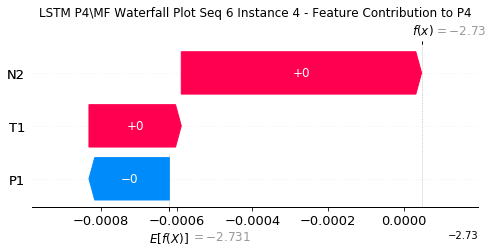

None

Contribution: [-0.00084346  0.00115025  0.00049273]


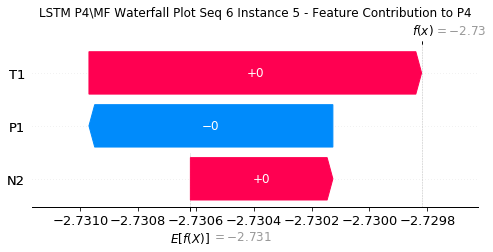

None

Contribution: [-1.37151220e-03 -3.14922182e-03 -7.19175919e-05]


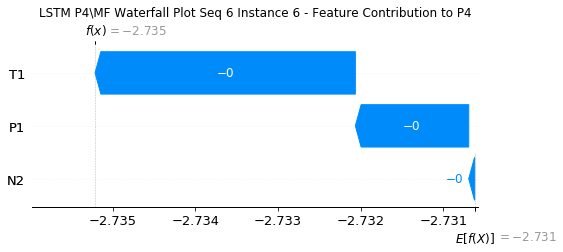

None

Contribution: [-0.00195634 -0.00276054 -0.00103988]


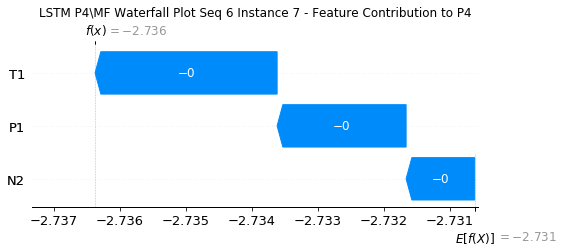

None

Contribution: [ 0.00135013  0.02209431 -0.00052069]


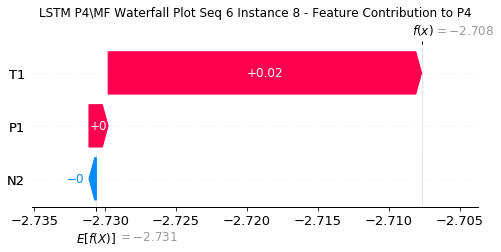

None

Contribution: [0.00480411 0.02322659 0.00250115]


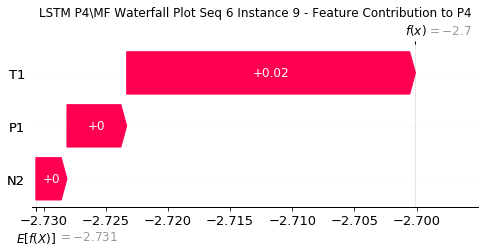

None

Contribution: [ 0.000724   -0.02334735  0.00265317]


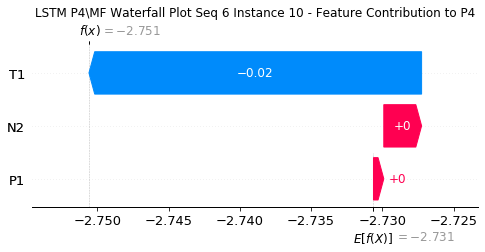

None

Contribution: [-0.00402269 -0.03134269 -0.002521  ]


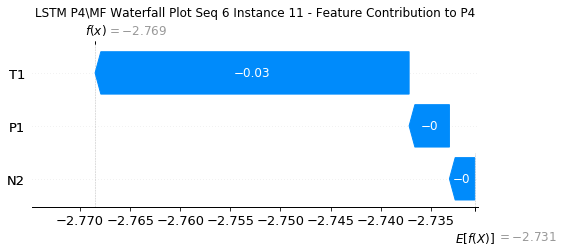

None

Contribution: [-0.00148069  0.02313927 -0.00304095]


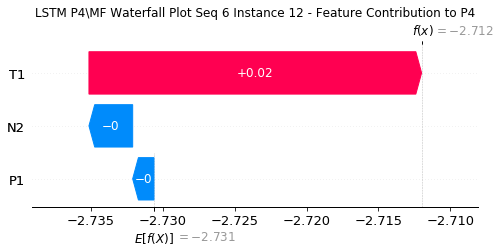

None

Contribution: [0.00372143 0.04029864 0.00229299]


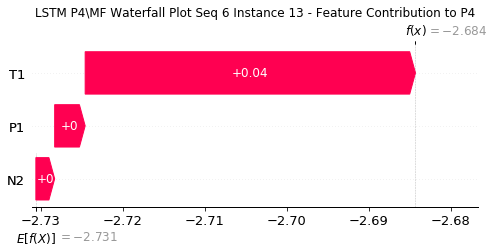

None

Contribution: [ 0.00223929 -0.01720211  0.00143037]


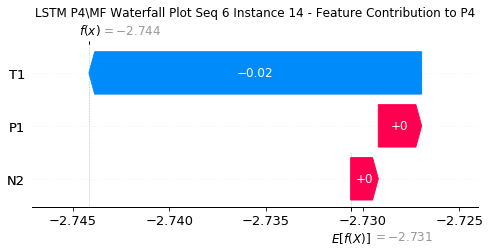

None

Contribution: [-0.00331955 -0.04301431 -0.00298159]


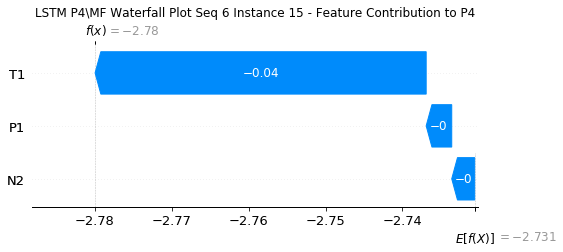

None

Contribution: [-0.00330374  0.01682917 -0.00678295]


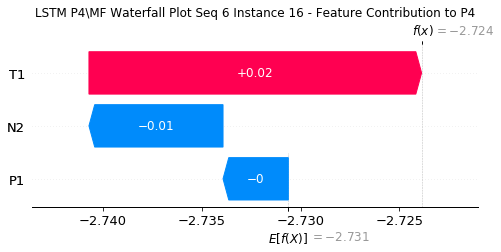

None

Contribution: [0.00425873 0.05068246 0.00255498]


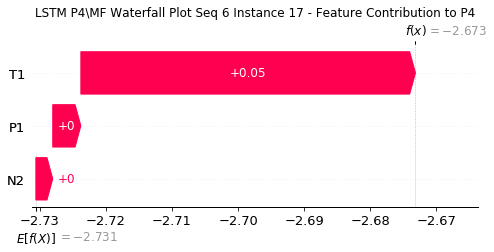

None

Contribution: [ 0.00394586 -0.00565382  0.00886227]


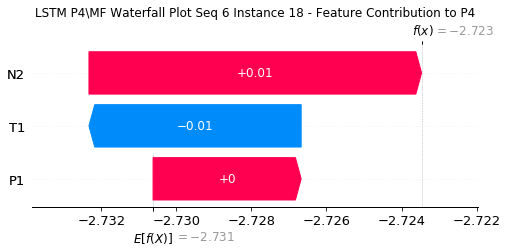

None

Contribution: [-0.00199417 -0.04528394 -0.00309293]


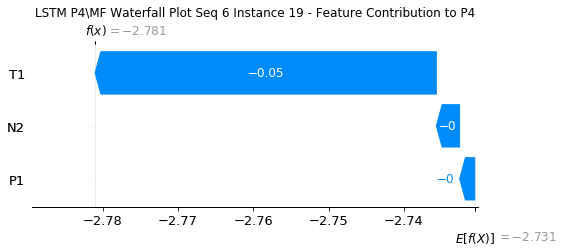

None

Contribution: [-0.00323605  0.01605948 -0.01632146]


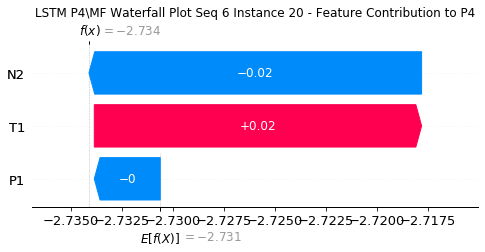

None

Contribution: [ 0.00231277  0.05771379 -0.00125641]


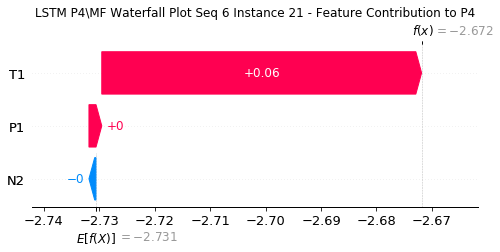

None

Contribution: [ 0.00253907 -0.00670892  0.01897401]


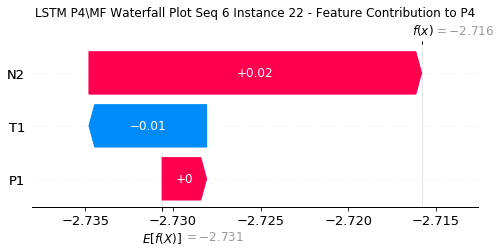

None

Contribution: [ 0.00625065  0.00245437 -0.00862313]


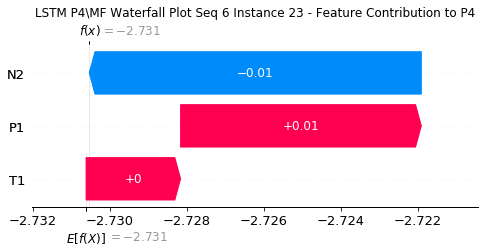

None

Contribution: [-0.0016339   0.03548101 -0.03458827]


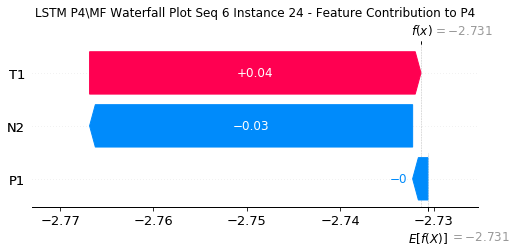

None

Contribution: [-0.00029224 -0.00135032  0.00024249]


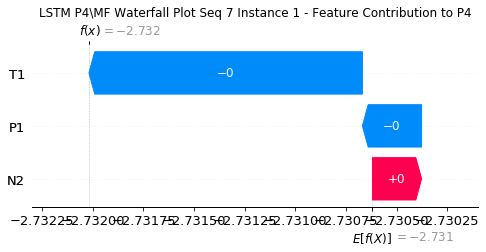

None

Contribution: [-0.00022631 -0.00034504  0.00012556]


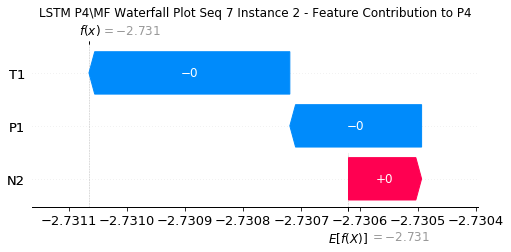

None

Contribution: [-0.00030369 -0.00080712  0.00051387]


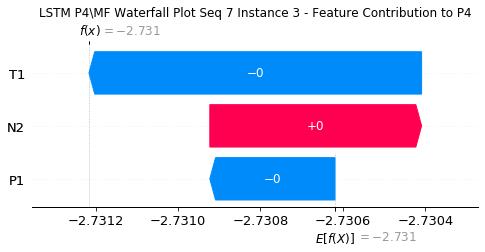

None

Contribution: [-0.00017324  0.0003401   0.00062344]


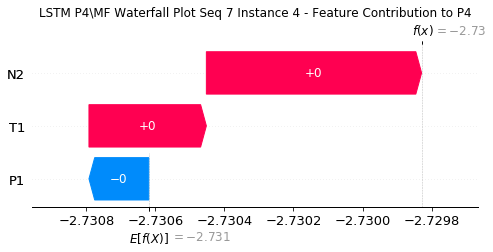

None

Contribution: [-0.00063115  0.00115968  0.00056241]


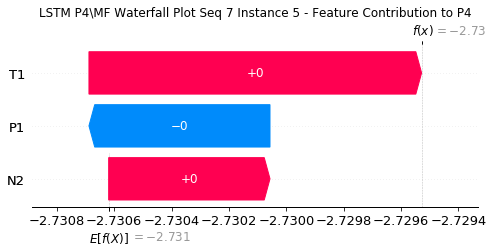

None

Contribution: [-1.21077180e-03 -3.36101901e-03 -2.91933127e-05]


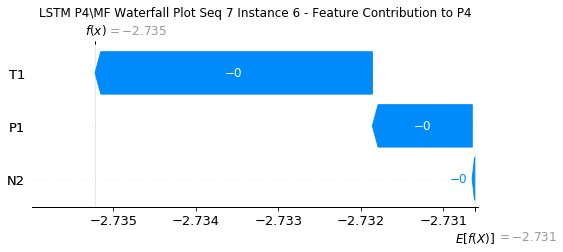

None

Contribution: [-0.00181646 -0.00307012  0.00019465]


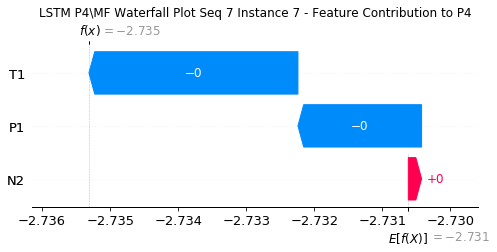

None

Contribution: [0.00088055 0.02284188 0.00171273]


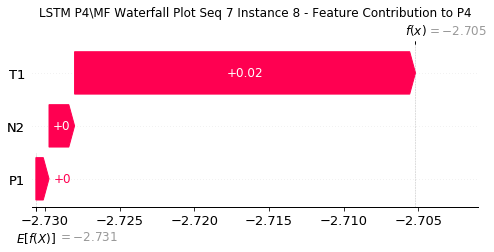

None

Contribution: [0.00476317 0.02462511 0.00063893]


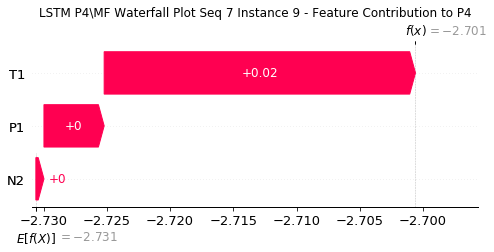

None

Contribution: [ 0.00071749 -0.02549066  0.00196954]


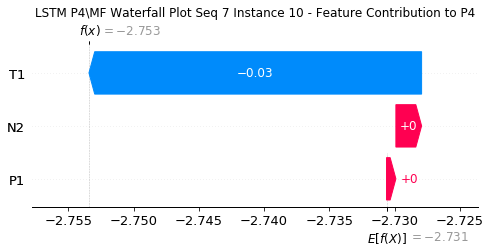

None

Contribution: [-0.00366978 -0.03589087 -0.00238805]


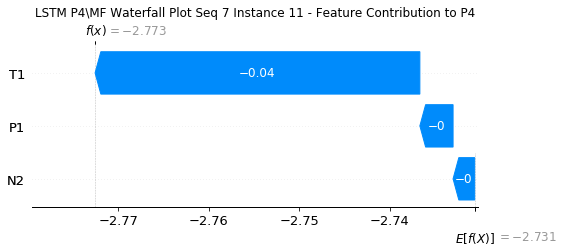

None

Contribution: [-0.0019134   0.02819442 -0.00342526]


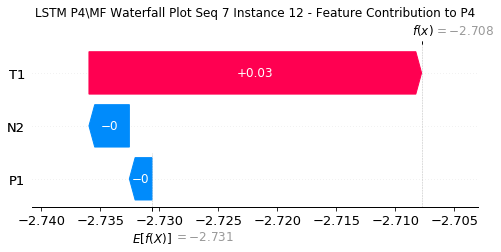

None

Contribution: [0.00363725 0.04695317 0.0022316 ]


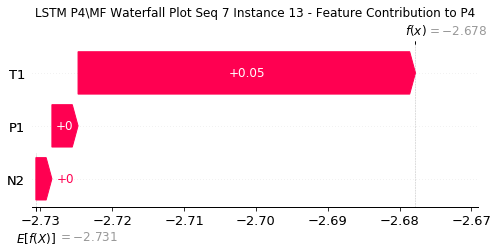

None

Contribution: [ 0.00225047 -0.01983872  0.00521705]


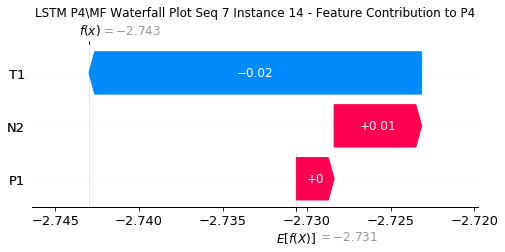

None

Contribution: [-0.0034774  -0.05130258 -0.0029594 ]


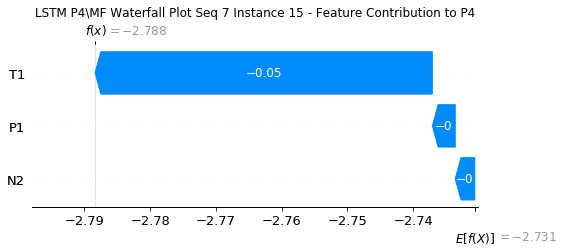

None

Contribution: [-0.00382997  0.02007957 -0.00689304]


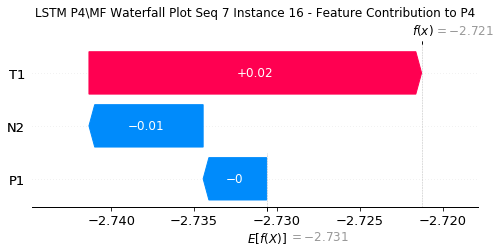

None

Contribution: [0.00373804 0.06487019 0.00270741]


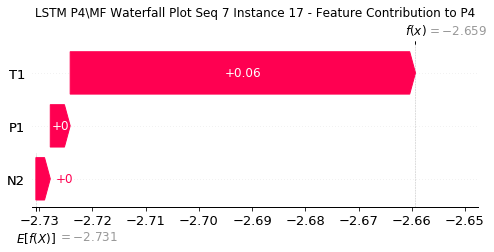

None

Contribution: [ 0.0048206  -0.00705014  0.00919978]


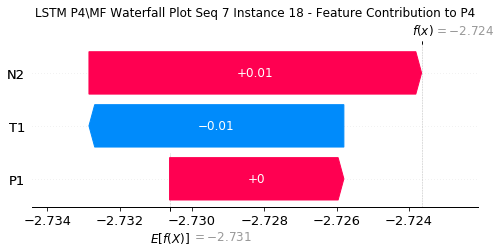

None

Contribution: [-0.00244594 -0.05696944 -0.00294045]


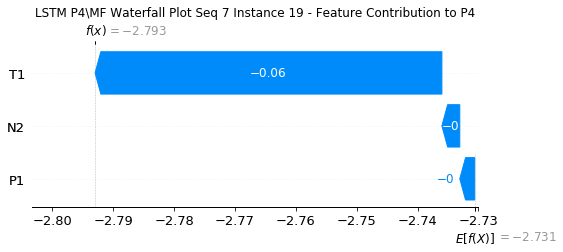

None

Contribution: [-0.00401158  0.02199304 -0.01544731]


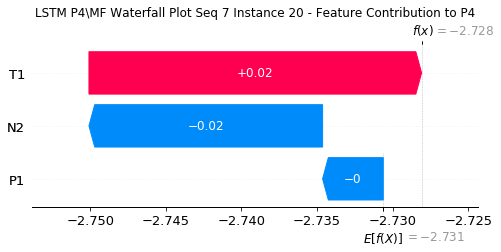

None

Contribution: [ 0.00273471  0.07491184 -0.00066128]


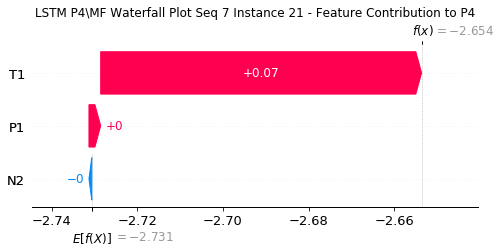

None

Contribution: [ 0.00405613 -0.00741856  0.01773923]


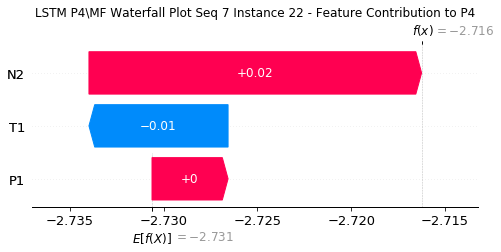

None

Contribution: [ 0.00581065  0.00673951 -0.00898216]


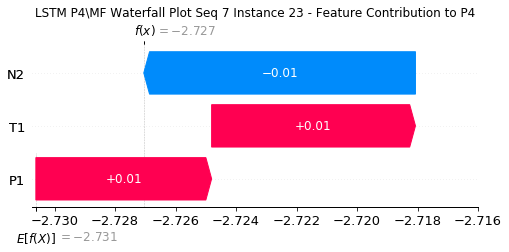

None

Contribution: [-0.00175127  0.05091814 -0.03449353]


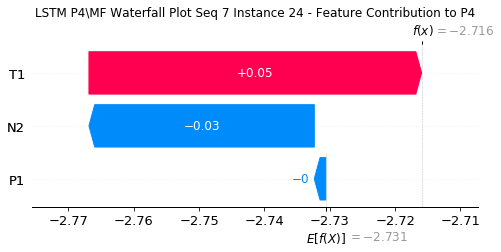

None

Contribution: [-0.00030774 -0.00156903  0.00013401]


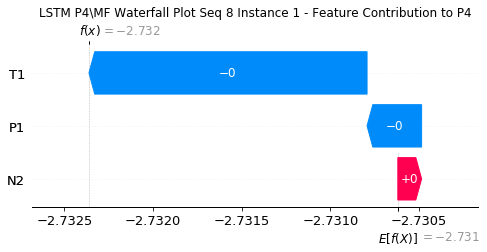

None

Contribution: [-0.00026289 -0.00038164  0.00011993]


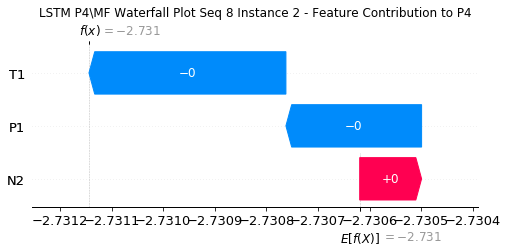

None

Contribution: [-0.00027135 -0.00088534  0.00043297]


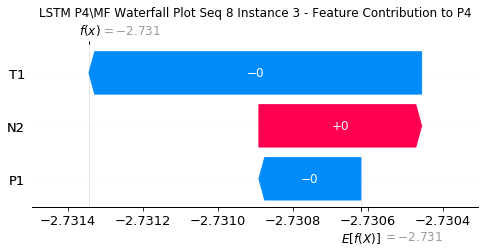

None

Contribution: [-0.00017202  0.00054258  0.00057225]


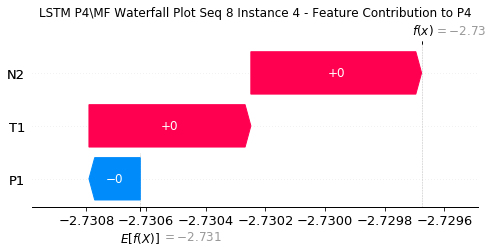

None

Contribution: [-0.00050802  0.00109903  0.0004922 ]


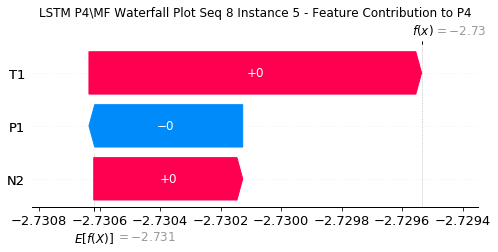

None

Contribution: [-0.00137666 -0.00370358 -0.00030488]


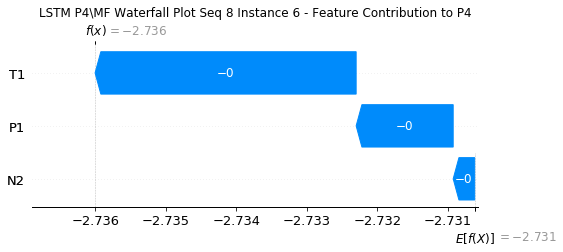

None

Contribution: [-0.00174109 -0.00264545 -0.00098354]


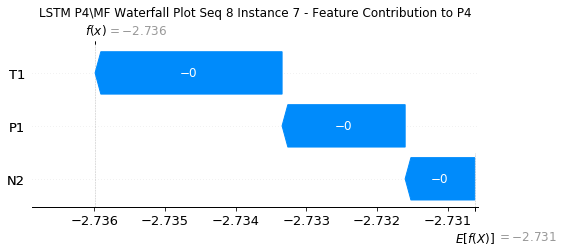

None

Contribution: [0.00106652 0.02679925 0.0004436 ]


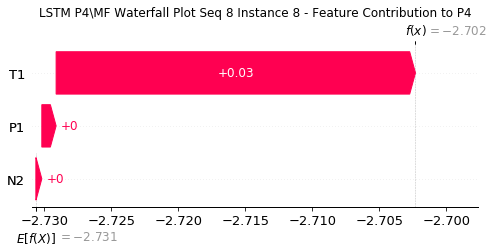

None

Contribution: [0.00568457 0.02533072 0.00164816]


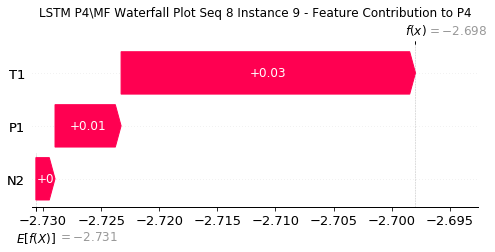

None

Contribution: [ 0.0007729  -0.02697656  0.00147737]


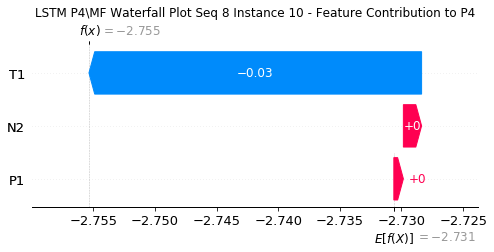

None

Contribution: [-0.00388626 -0.03709668 -0.00229794]


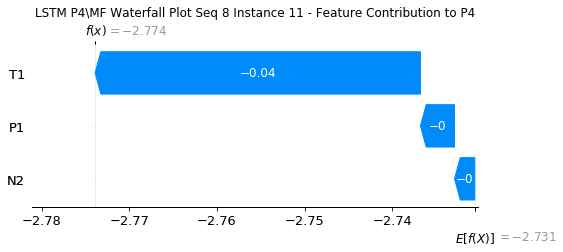

None

Contribution: [-0.00277119  0.02794193 -0.00263991]


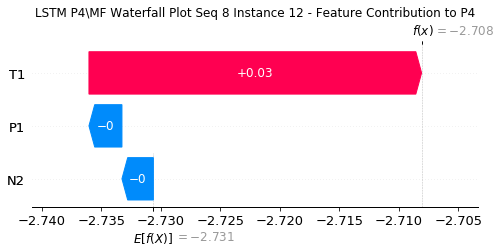

None

Contribution: [0.00315108 0.04761985 0.0021922 ]


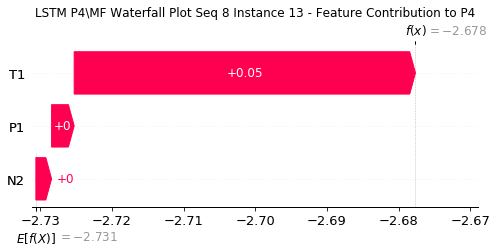

None

Contribution: [ 0.00171185 -0.02030531  0.00556618]


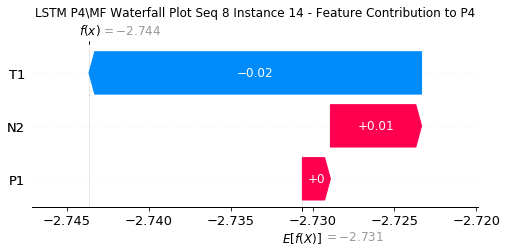

None

Contribution: [-0.00364467 -0.05152008 -0.00283097]


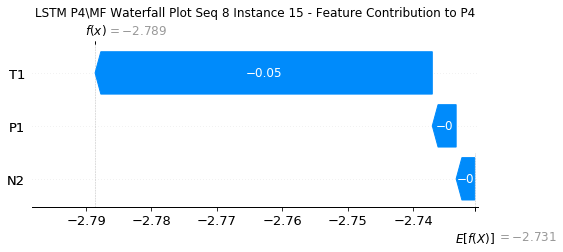

None

Contribution: [-0.00533458  0.0208464  -0.00551804]


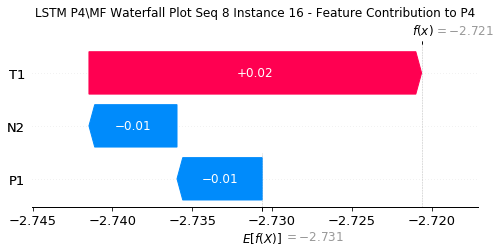

None

Contribution: [0.00495581 0.0636971  0.0024425 ]


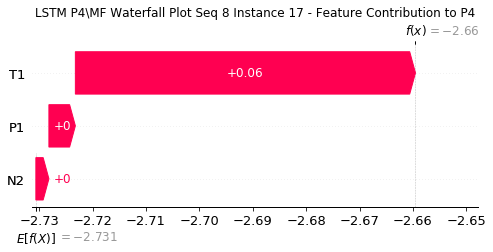

None

Contribution: [ 0.00490715 -0.00697315  0.00917265]


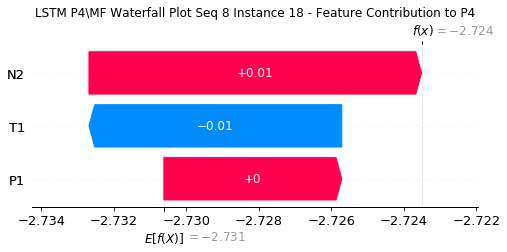

None

Contribution: [-0.00283458 -0.05691676 -0.00330949]


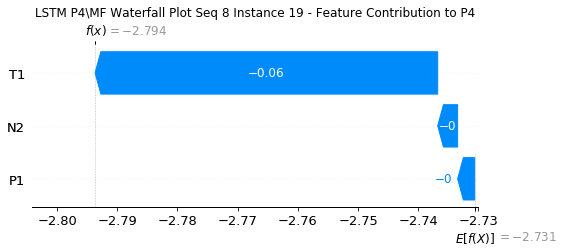

None

Contribution: [-0.00329434  0.02144572 -0.01637256]


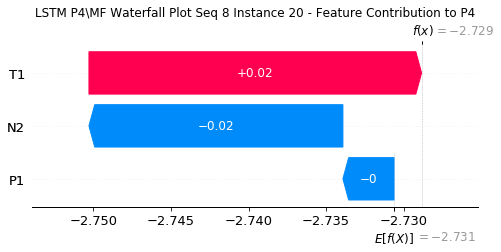

None

Contribution: [ 0.00297271  0.07328119 -0.00069404]


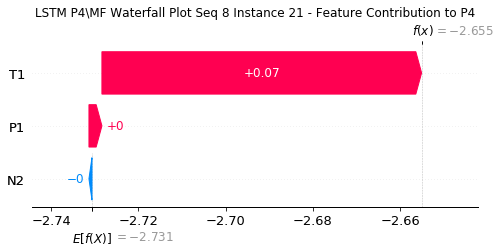

None

Contribution: [ 0.00279214 -0.00693074  0.02154555]


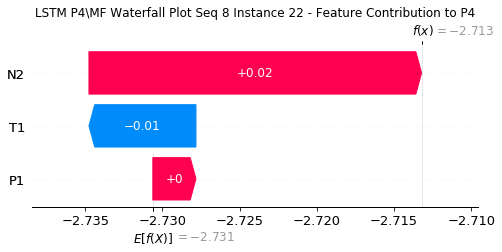

None

Contribution: [ 0.0106684   0.00767917 -0.00887881]


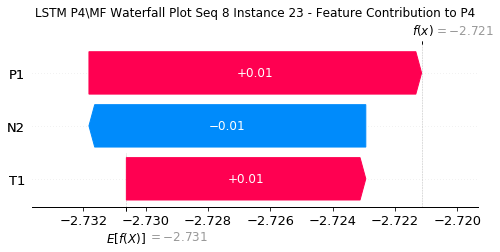

None

Contribution: [-0.00287884  0.05130886 -0.02233408]


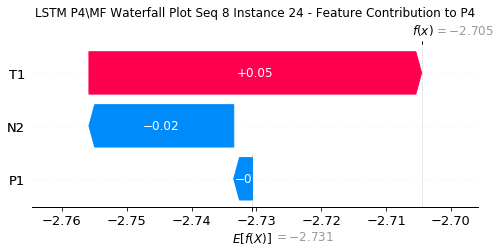

None

Contribution: [-2.39047768e-04 -1.59488572e-03  8.72853383e-05]


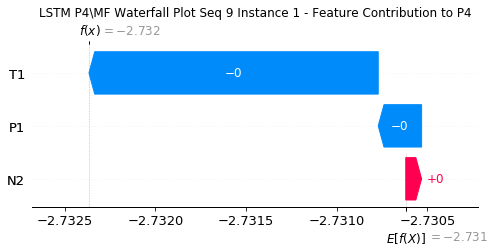

None

Contribution: [-0.00027635 -0.00045212  0.00017894]


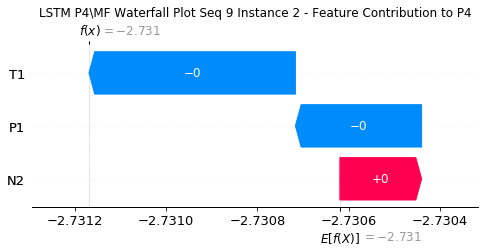

None

Contribution: [-0.00055964 -0.0008891   0.00068273]


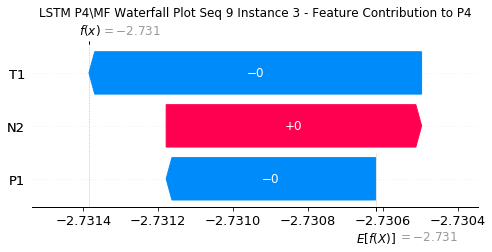

None

Contribution: [-0.00025436  0.00046946  0.00073729]


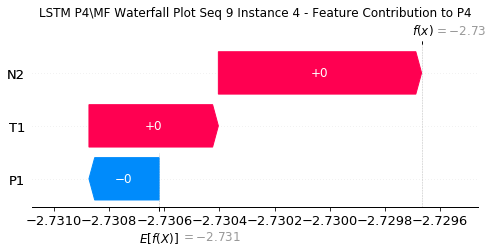

None

Contribution: [-0.00152047  0.0011356   0.00067352]


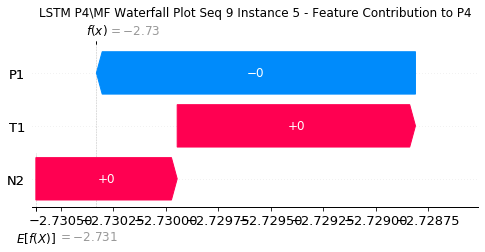

None

Contribution: [-0.00174936 -0.0033092   0.00037247]


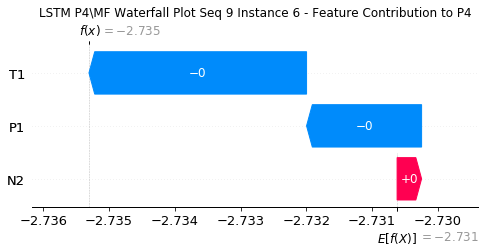

None

Contribution: [-0.00178267 -0.00213782 -0.00230555]


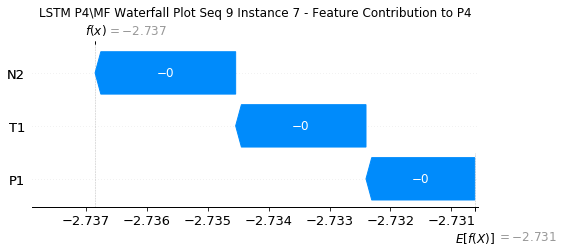

None

Contribution: [ 0.00098559  0.01702317 -0.00225069]


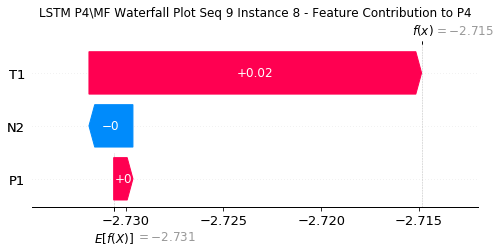

None

Contribution: [0.00329491 0.02024861 0.00341955]


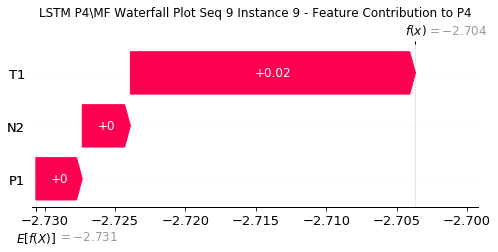

None

Contribution: [ 0.00021194 -0.02325244  0.00472915]


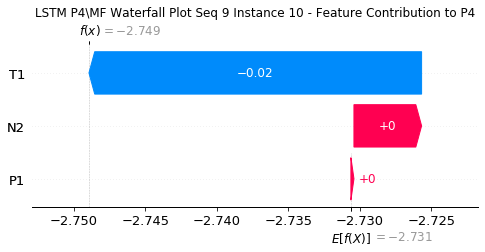

None

Contribution: [-0.0030432  -0.02940641 -0.00300328]


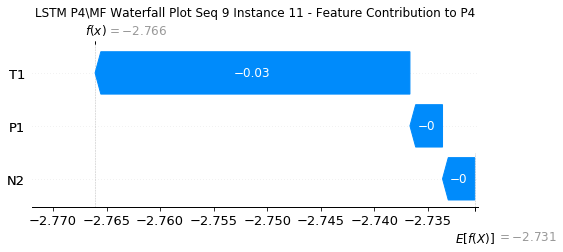

None

Contribution: [-0.00213699  0.0222891  -0.00452281]


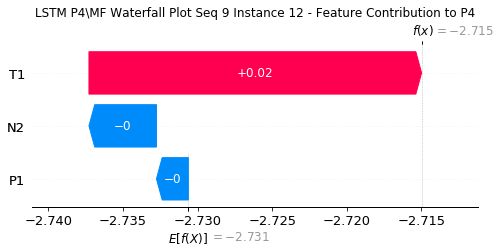

None

Contribution: [0.00265008 0.03811976 0.0023686 ]


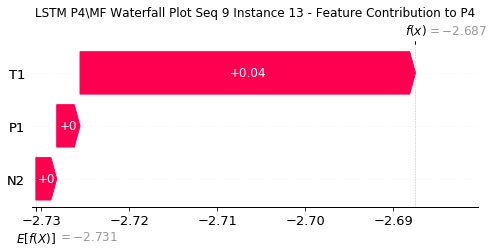

None

Contribution: [ 0.00112816 -0.01669655  0.00714385]


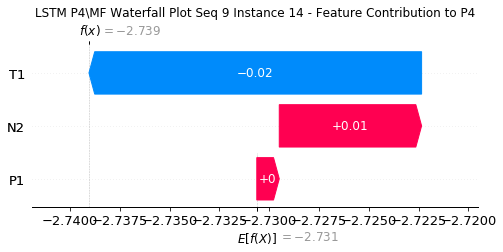

None

Contribution: [-0.00203163 -0.03780109 -0.00267438]


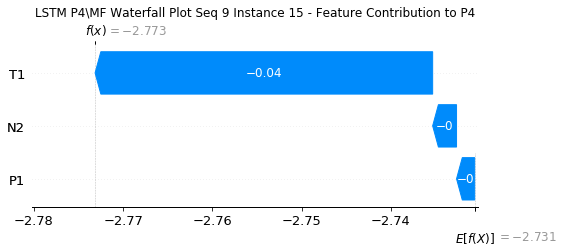

None

Contribution: [-0.00166418  0.01467459 -0.00960996]


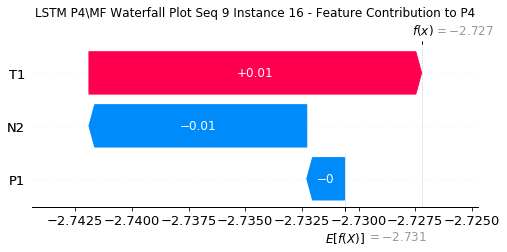

None

Contribution: [0.00428171 0.04228997 0.00195739]


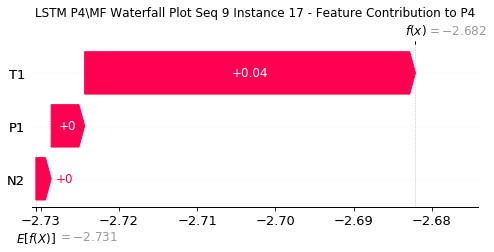

None

Contribution: [ 0.00339307 -0.00502511  0.01119016]


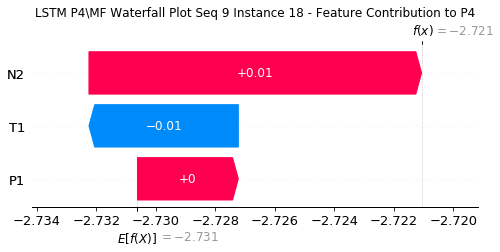

None

Contribution: [-0.0016574 -0.0402386 -0.0023128]


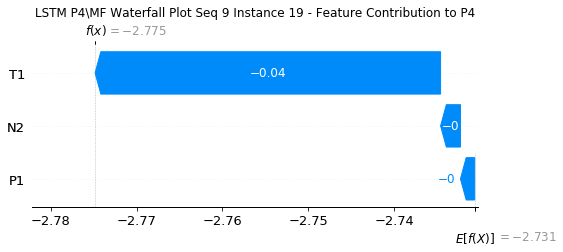

None

Contribution: [-0.00280527  0.01448677 -0.01758223]


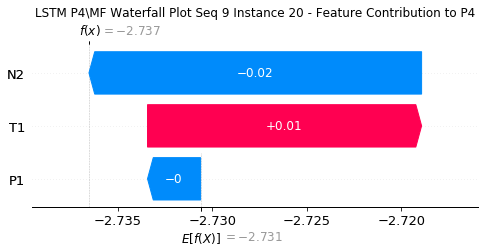

None

Contribution: [ 0.00167876  0.05038925 -0.00189695]


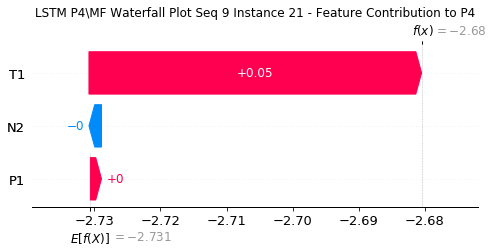

None

Contribution: [ 0.00162551 -0.00633281  0.01938126]


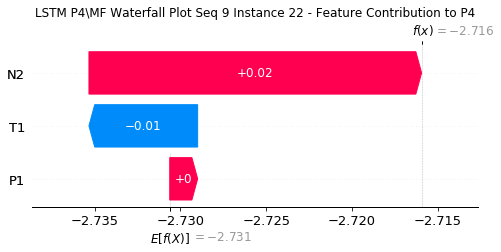

None

Contribution: [ 0.00795462  0.00031425 -0.00895853]


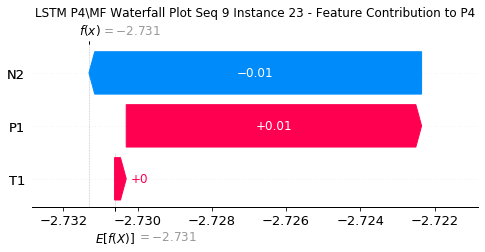

None

Contribution: [-0.00158422  0.02684921 -0.03391177]


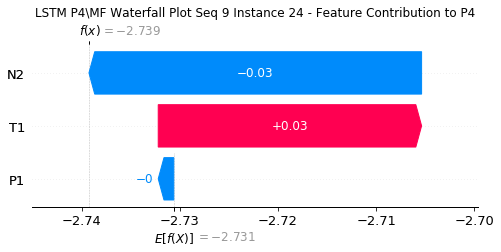

None

Contribution: [-0.00035521 -0.00135193  0.00011219]


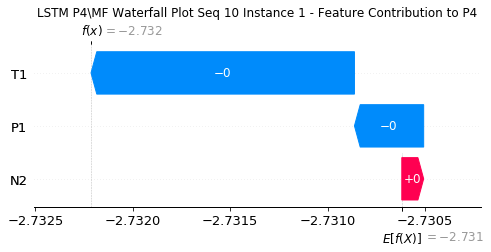

None

Contribution: [-0.00028673 -0.00035004  0.00013663]


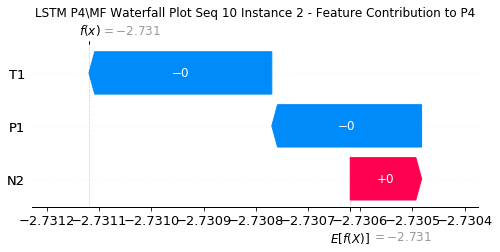

None

Contribution: [-0.00025452 -0.00084204  0.00053762]


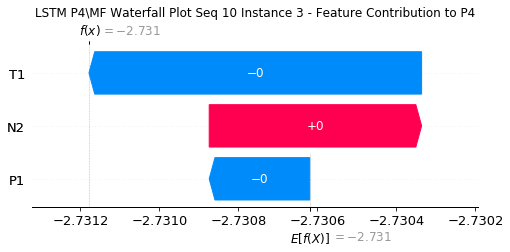

None

Contribution: [-0.00016047  0.00015719  0.00064899]


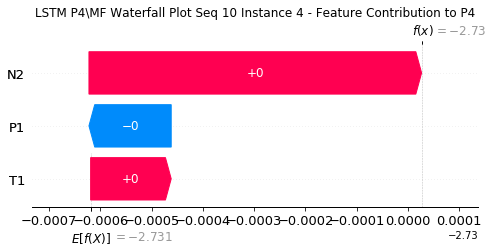

None

Contribution: [-0.00048775  0.00112466  0.00062079]


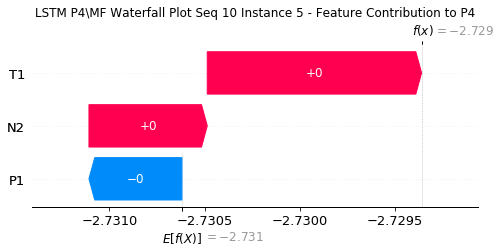

None

Contribution: [-8.94570414e-04 -2.86236358e-03  3.94351856e-05]


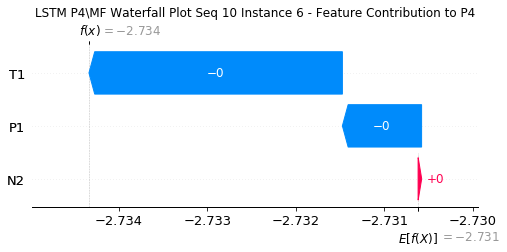

None

Contribution: [-0.00200366 -0.00272589 -0.00121056]


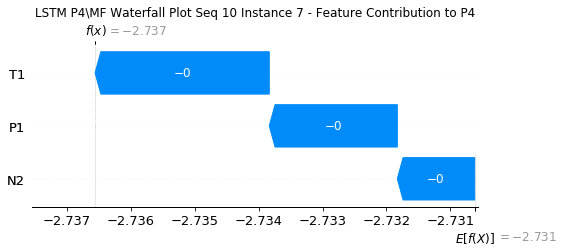

None

Contribution: [ 0.00044471  0.02038365 -0.00210282]


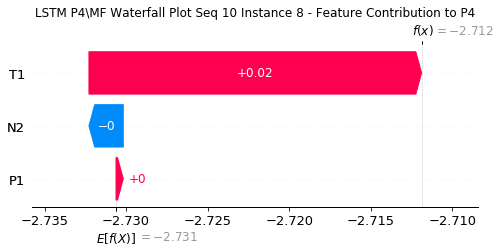

None

Contribution: [0.00374418 0.02135314 0.00287012]


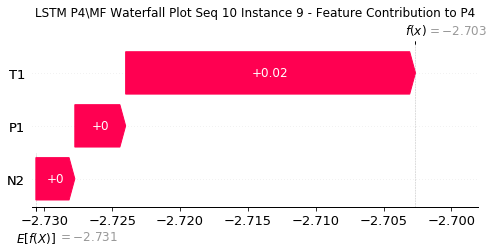

None

Contribution: [ 1.93492840e-05 -2.19503657e-02  4.05794748e-03]


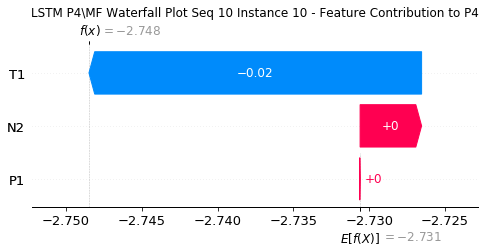

None

Contribution: [-0.00214563 -0.02961095 -0.00275819]


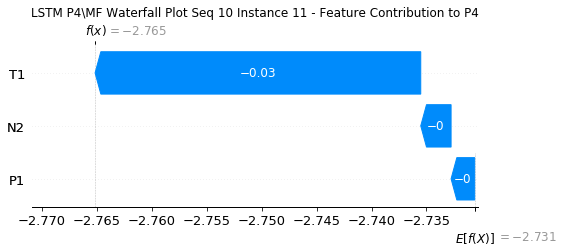

None

Contribution: [-0.00153298  0.02407606 -0.00390445]


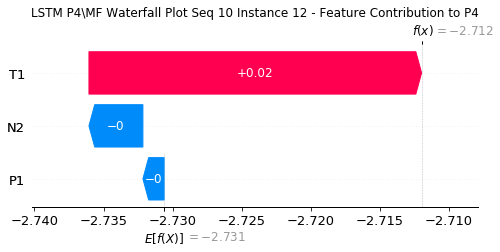

None

Contribution: [0.00176914 0.03852943 0.00227138]


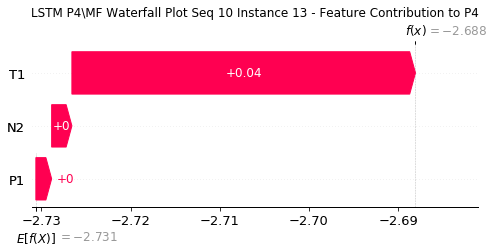

None

Contribution: [ 0.0013249  -0.01484754  0.00699288]


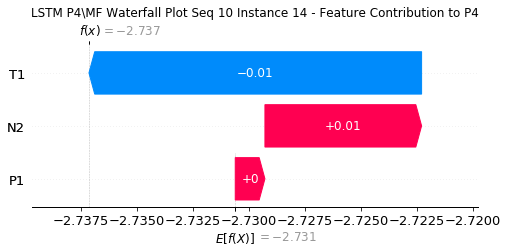

None

Contribution: [-0.00169959 -0.04073737 -0.00262597]


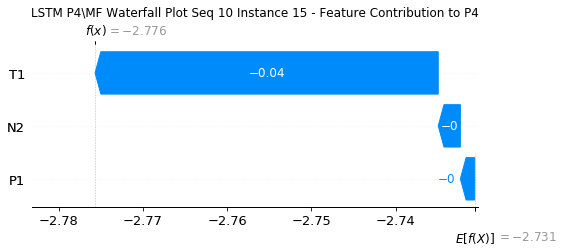

None

Contribution: [-0.00163628  0.01588967 -0.00904823]


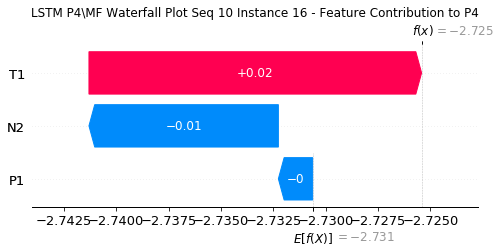

None

Contribution: [0.00273756 0.05077669 0.00192677]


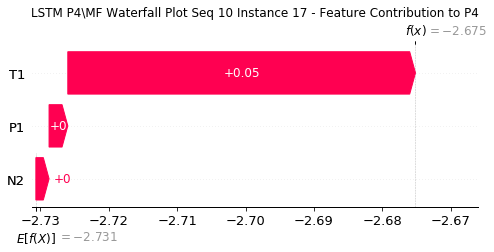

None

Contribution: [ 0.00215373 -0.00554615  0.01090763]


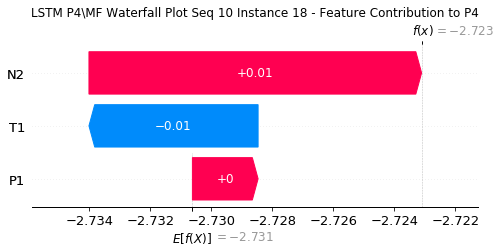

None

Contribution: [-0.00113593 -0.045418   -0.00230491]


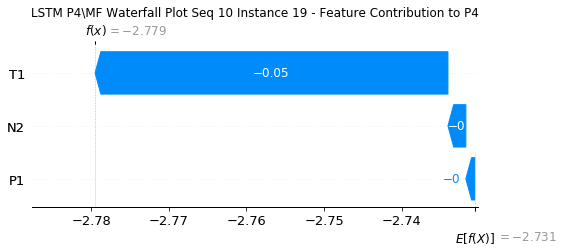

None

Contribution: [-0.00154615  0.01661826 -0.01826343]


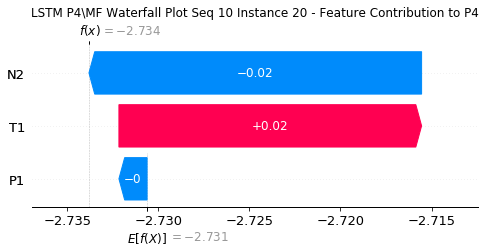

None

Contribution: [ 0.00151208  0.05941496 -0.0024145 ]


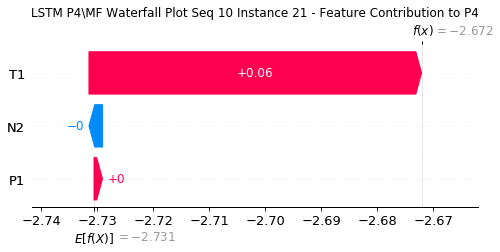

None

Contribution: [-0.00041103 -0.00715643  0.02135772]


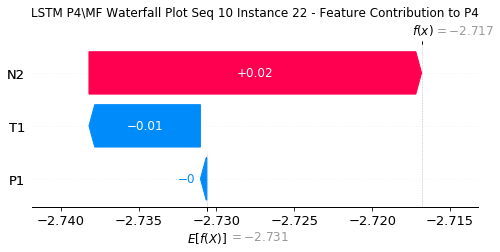

None

Contribution: [-0.00013021  0.0018724  -0.00849004]


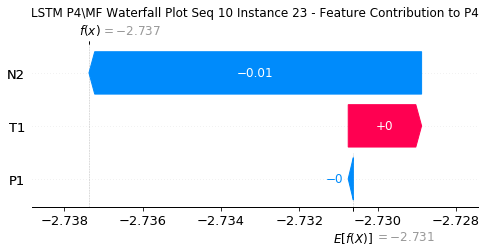

None

Contribution: [-0.00092107  0.03259893 -0.03610765]


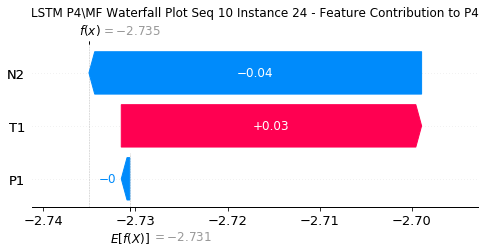

None

Contribution: [-4.16546529e-05 -9.72905461e-04  2.57067781e-04]


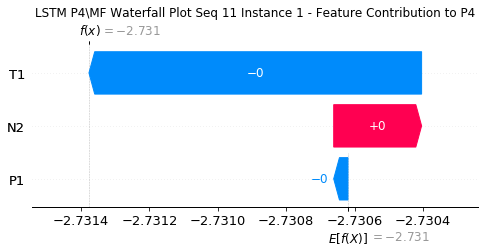

None

Contribution: [-7.47228680e-05 -2.91444518e-05  2.84995193e-04]


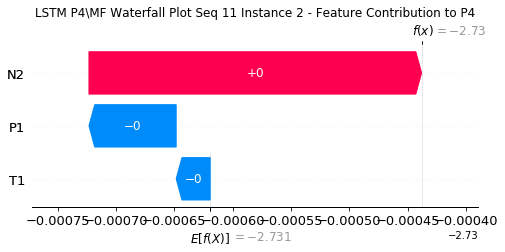

None

Contribution: [ 5.21669641e-05 -5.63455182e-04  6.88831114e-04]


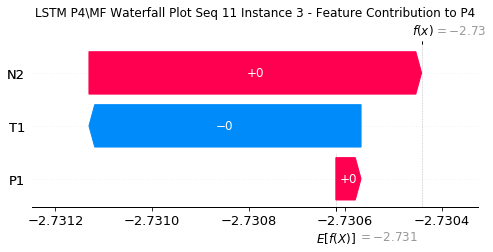

None

Contribution: [-2.31672712e-05  4.36983534e-04  7.17159882e-04]


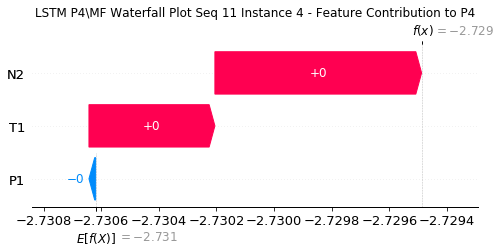

None

Contribution: [0.00037376 0.00112514 0.00069949]


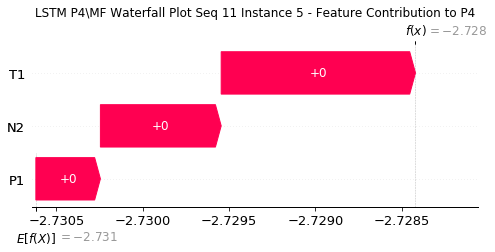

None

Contribution: [ 0.0005686  -0.00316274  0.00027976]


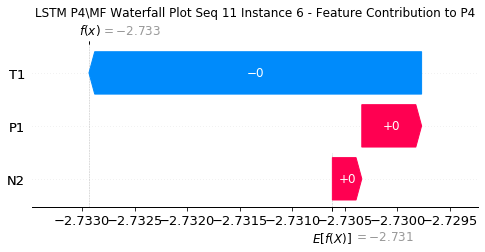

None

Contribution: [ 0.00052081 -0.0025707  -0.00293268]


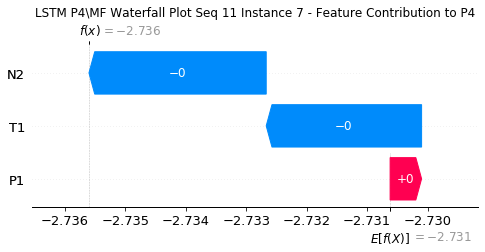

None

Contribution: [-3.82711586e-05  1.84732071e-02 -3.03225411e-03]


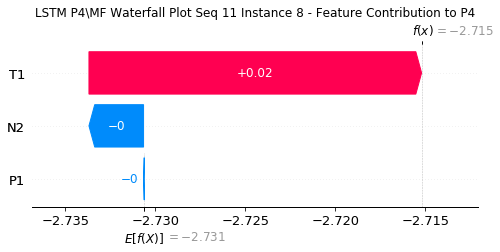

None

Contribution: [-0.00157204  0.01806304  0.00346063]


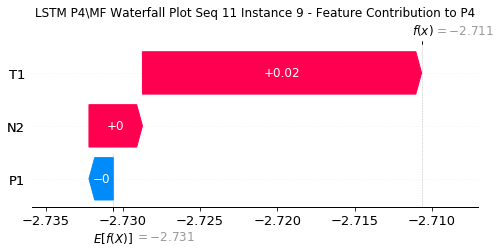

None

Contribution: [-0.00085425 -0.03128424  0.00468234]


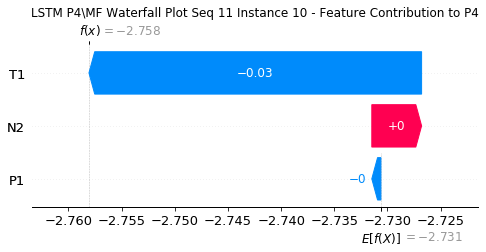

None

Contribution: [ 0.00070808 -0.04219393 -0.00280752]


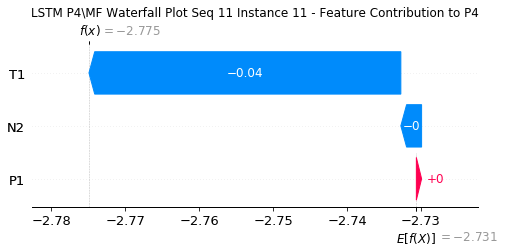

None

Contribution: [-0.000596    0.03834951 -0.00624784]


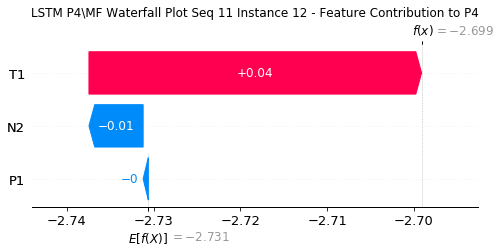

None

Contribution: [-0.00030836  0.05507256  0.00217343]


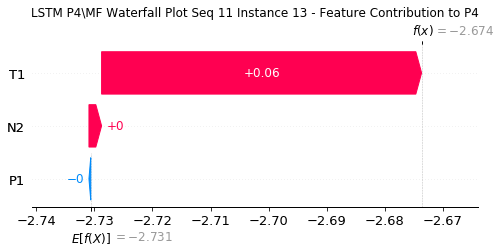

None

Contribution: [-0.00038662 -0.02748444  0.0104958 ]


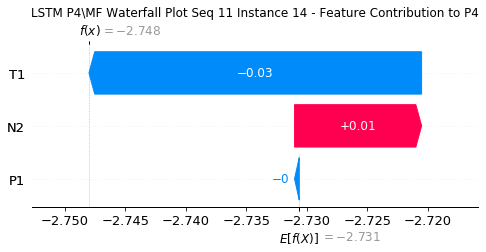

None

Contribution: [-0.00011865 -0.05779829 -0.0025714 ]


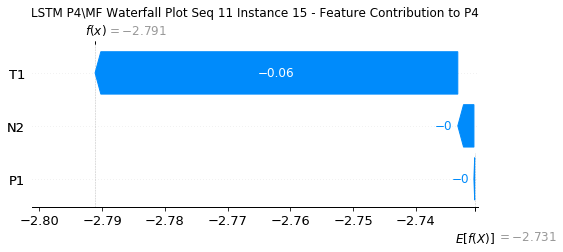

None

Contribution: [ 0.00029819  0.02205015 -0.00909926]


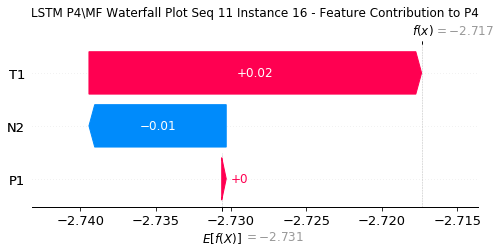

None

Contribution: [3.67820521e-05 5.83259244e-02 1.37772764e-03]


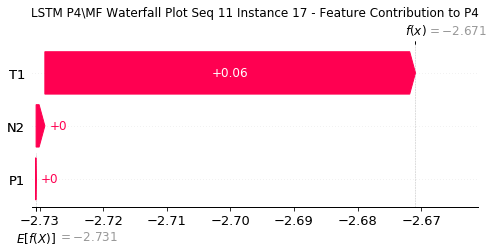

None

Contribution: [-0.00066371 -0.00636674  0.01078805]


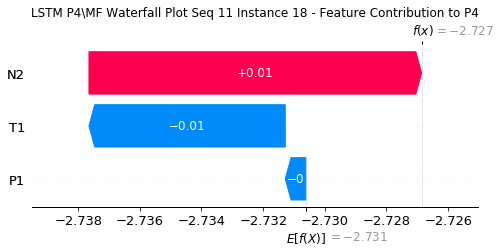

None

Contribution: [ 0.00024635 -0.04907258 -0.00251222]


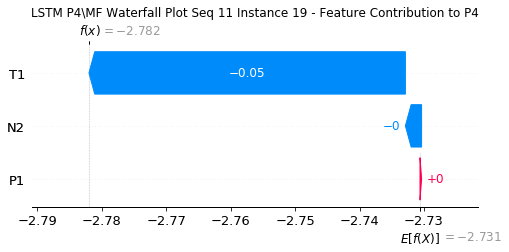

None

Contribution: [ 0.0004632   0.017209   -0.01727874]


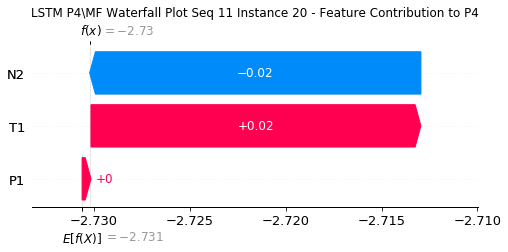

None

Contribution: [ 0.0008069   0.06755351 -0.00165749]


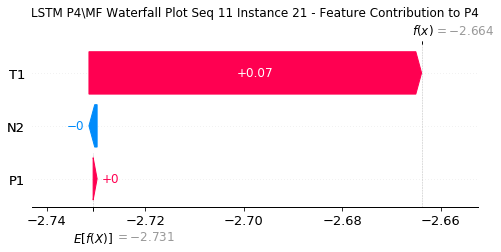

None

Contribution: [-0.00276598 -0.00725115  0.01923852]


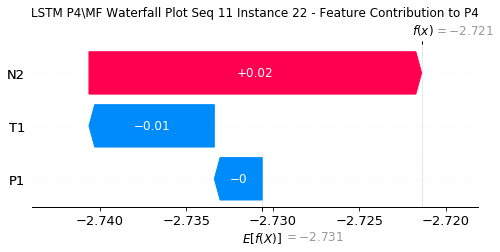

None

Contribution: [-0.01285821 -0.00046383 -0.00800162]


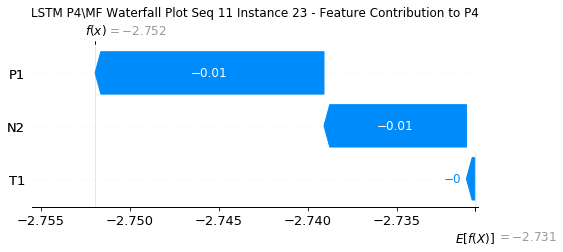

None

Contribution: [ 0.00022321  0.02185868 -0.03878046]


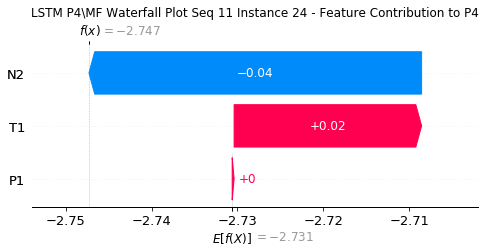

None

Contribution: [ 0.00013939 -0.00148584  0.00042841]


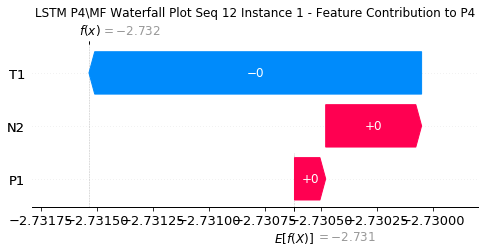

None

Contribution: [-5.64727924e-05 -3.15592655e-04  2.64436604e-04]


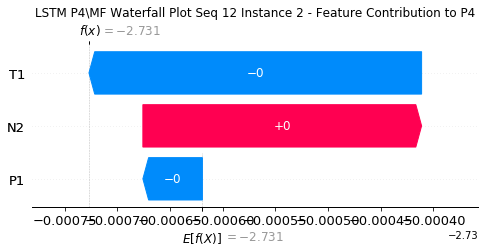

None

Contribution: [ 0.00016665 -0.00077842  0.00067803]


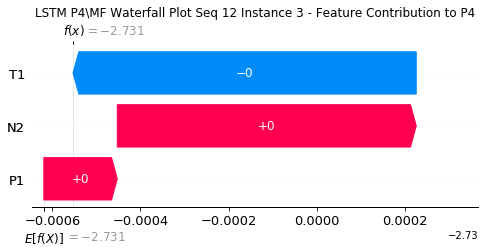

None

Contribution: [7.36135078e-05 2.79515707e-05 6.91258712e-04]


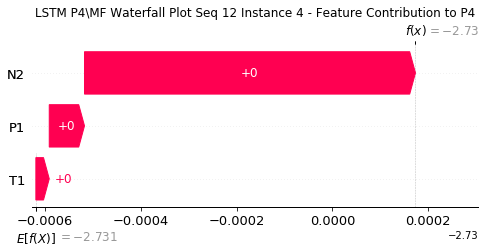

None

Contribution: [3.22007809e-05 1.08677154e-03 7.51584982e-04]


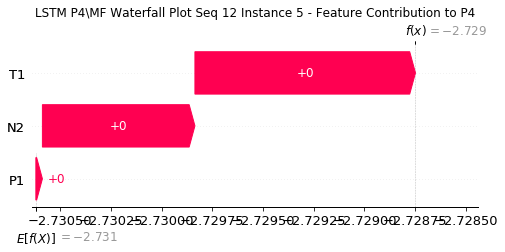

None

Contribution: [ 0.00106893 -0.00221751  0.0004176 ]


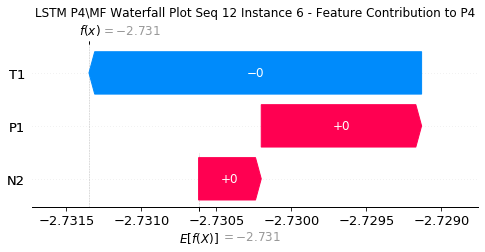

None

Contribution: [ 0.00179144 -0.00222501 -0.00383756]


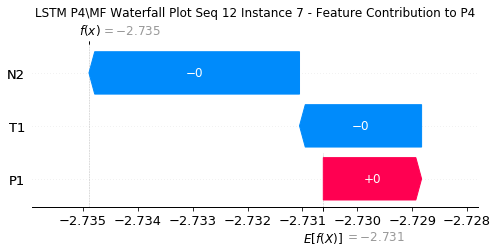

None

Contribution: [-0.00050263  0.01648241 -0.00243585]


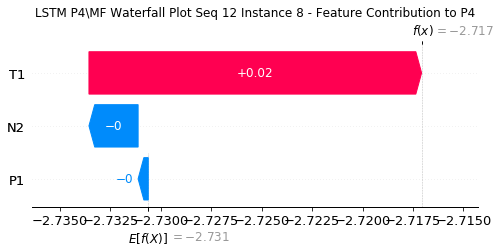

None

Contribution: [-0.00360922  0.01524323  0.00401392]


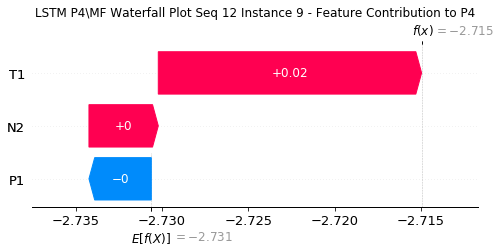

None

Contribution: [-0.00163538 -0.01537246  0.00436075]


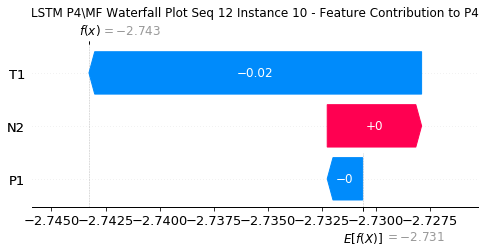

None

Contribution: [ 0.00383794 -0.01948231 -0.00300896]


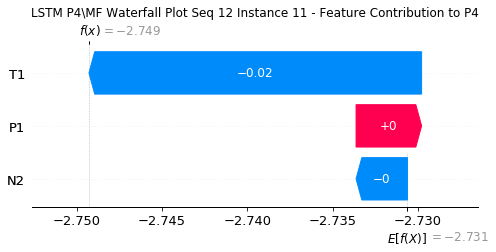

None

Contribution: [ 0.00027387  0.01582766 -0.00143183]


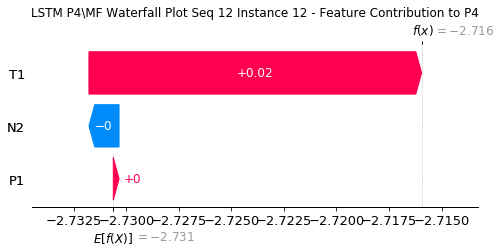

None

Contribution: [-0.00330299  0.02469605  0.00236619]


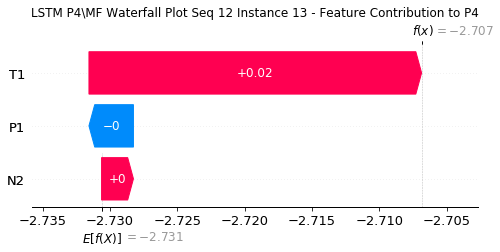

None

Contribution: [-0.00435934 -0.00957859  0.00767118]


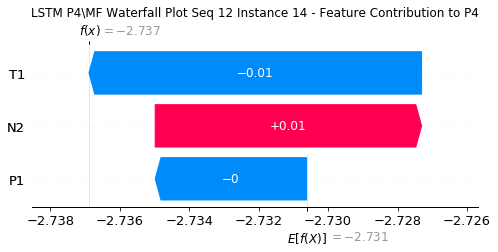

None

Contribution: [ 0.00281627 -0.02539714 -0.00272112]


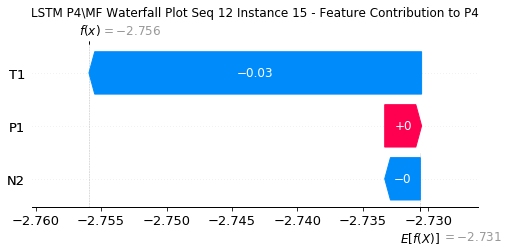

None

Contribution: [ 0.00299938  0.00968821 -0.00787629]


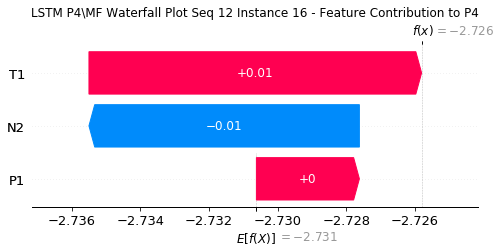

None

Contribution: [-0.0005236   0.03310702  0.0025908 ]


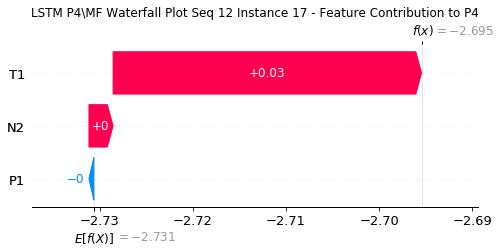

None

Contribution: [-0.00355359 -0.00330194  0.01058963]


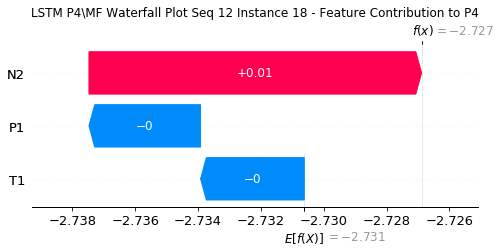

None

Contribution: [ 0.00162883 -0.02678626 -0.00261333]


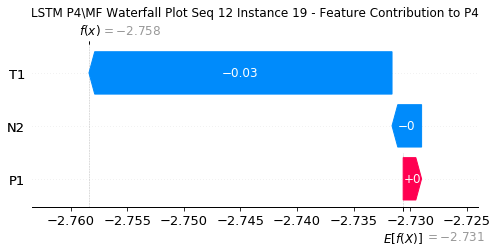

None

Contribution: [ 0.00229093  0.00778884 -0.01659047]


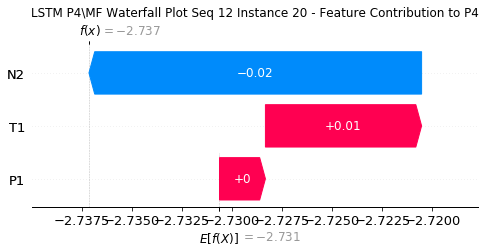

None

Contribution: [-0.00028252  0.03228533 -0.00109888]


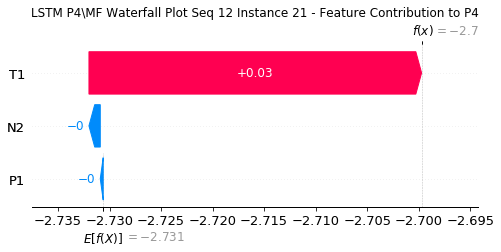

None

Contribution: [-0.00489326 -0.00566515  0.01692253]


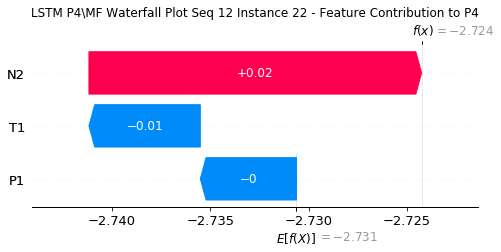

None

Contribution: [-0.01070968 -0.0025866  -0.0083582 ]


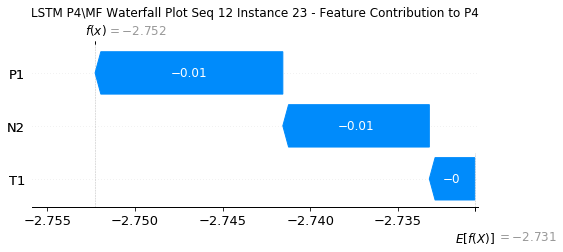

None

Contribution: [ 0.00029611  0.01364183 -0.03621667]


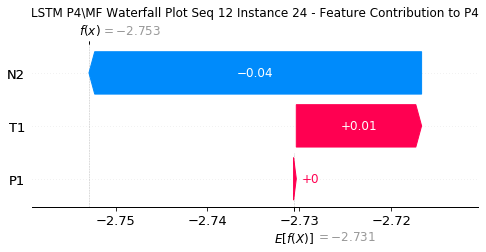

None

Contribution: [ 0.00016212 -0.00102448  0.00033374]


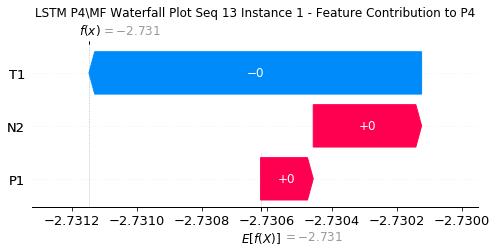

None

Contribution: [-8.22157766e-06 -2.83219264e-04  2.38876880e-04]


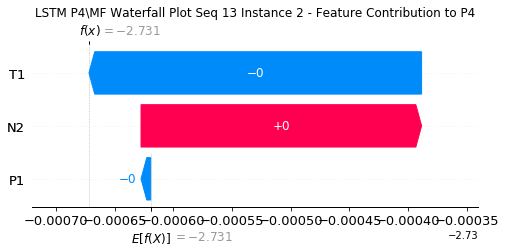

None

Contribution: [ 0.00010299 -0.00078597  0.00063277]


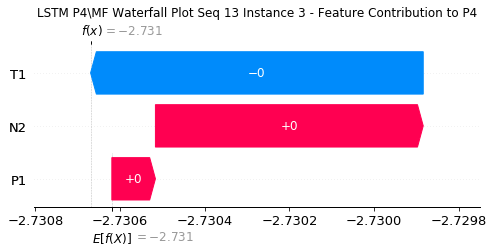

None

Contribution: [5.23287493e-05 1.42659738e-05 6.72022302e-04]


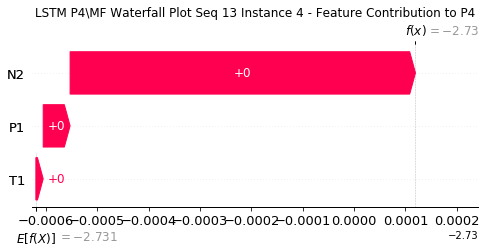

None

Contribution: [0.00067043 0.00117784 0.00075649]


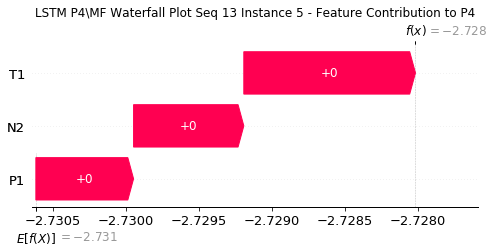

None

Contribution: [ 0.00076071 -0.0023158   0.00032417]


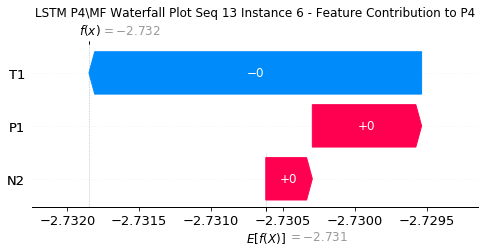

None

Contribution: [-0.00040946 -0.00261218 -0.00133334]


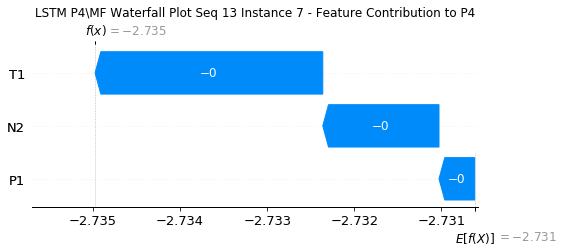

None

Contribution: [ 0.00023157  0.01997661 -0.00072787]


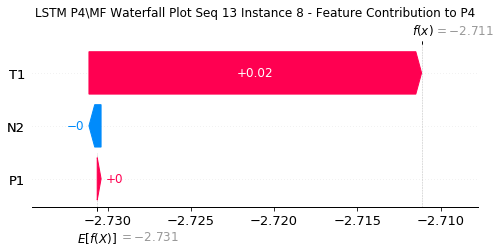

None

Contribution: [-0.00114919  0.01836504  0.00248691]


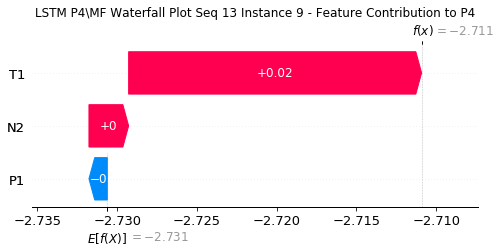

None

Contribution: [-0.0017496  -0.01880496  0.00528279]


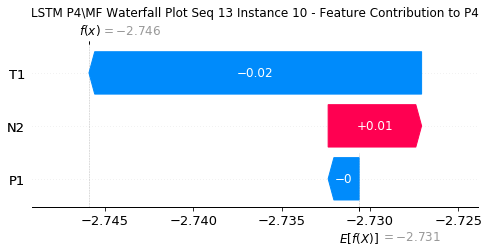

None

Contribution: [ 0.00312161 -0.02427304 -0.00307755]


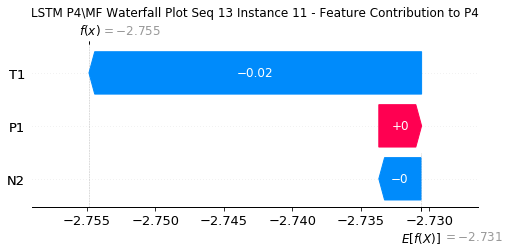

None

Contribution: [ 0.00161739  0.0186457  -0.0061753 ]


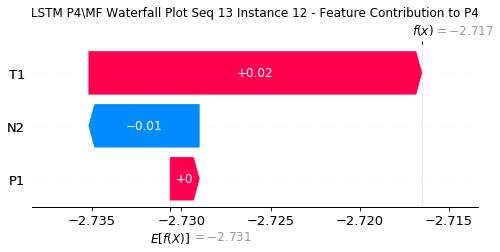

None

Contribution: [-0.0029843   0.03103937  0.00234818]


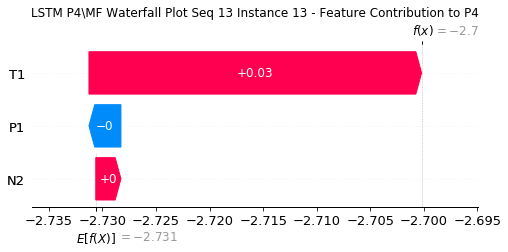

None

Contribution: [-0.00159225 -0.01381796  0.00677483]


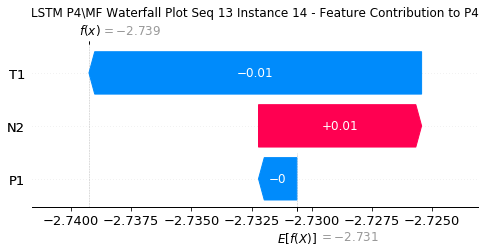

None

Contribution: [ 0.0019317  -0.03312933 -0.00258591]


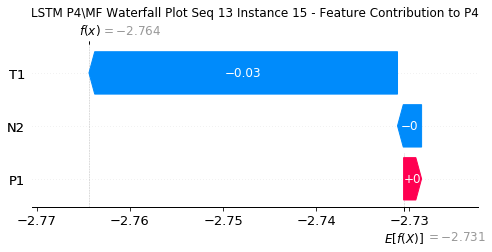

None

Contribution: [ 0.00212776  0.01275123 -0.00990382]


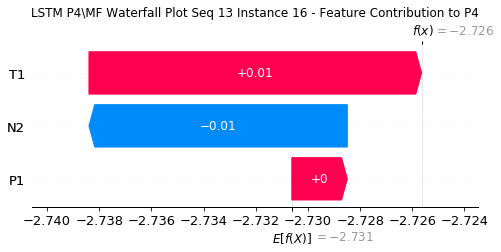

None

Contribution: [-0.00055075  0.03253547  0.00149281]


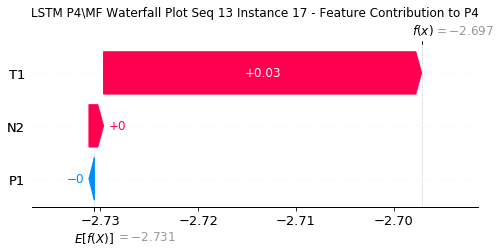

None

Contribution: [-0.00113106 -0.00407475  0.01194952]


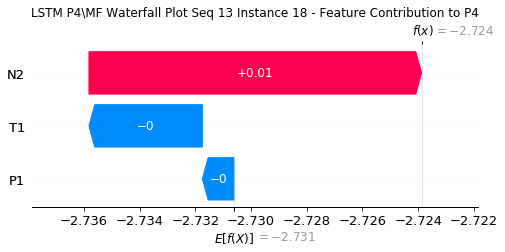

None

Contribution: [ 0.00051487 -0.03281882 -0.0019954 ]


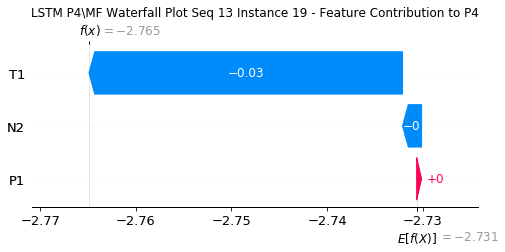

None

Contribution: [ 0.00090369  0.00995433 -0.01910246]


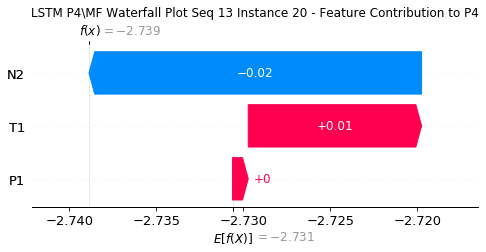

None

Contribution: [ 9.29316246e-05  4.11355690e-02 -2.68555302e-03]


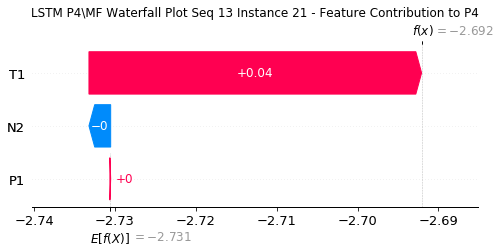

None

Contribution: [-0.00382245 -0.00592102  0.02120778]


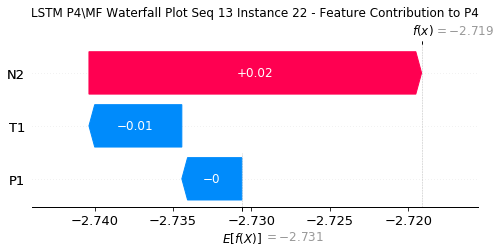

None

Contribution: [-0.0033868  -0.00253376 -0.00818912]


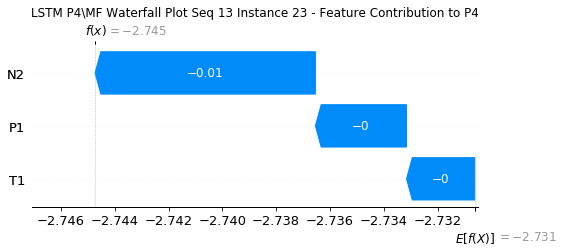

None

Contribution: [-0.00048522  0.01898289 -0.03647682]


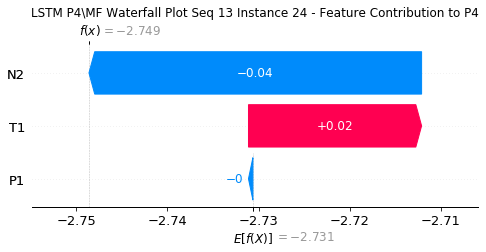

None

Contribution: [ 3.00658278e-06 -1.14789869e-03  3.28475301e-04]


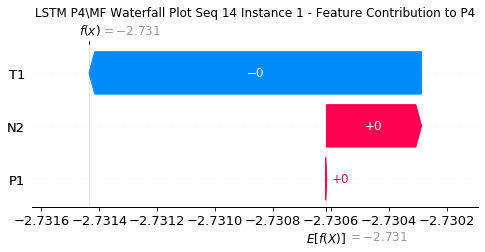

None

Contribution: [-0.00012879 -0.00029483  0.00023706]


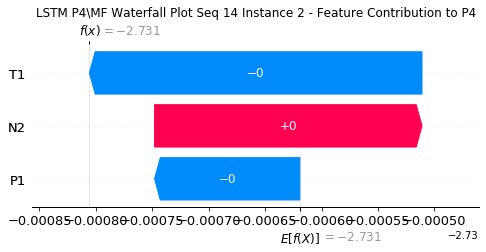

None

Contribution: [ 5.34757588e-05 -8.46044045e-04  7.34670175e-04]


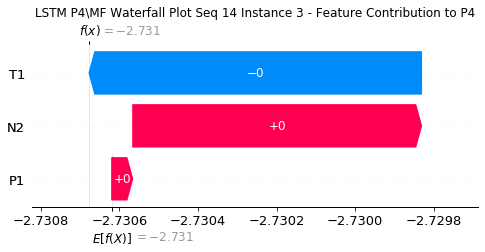

None

Contribution: [-4.99244700e-08  3.33191894e-06  7.33348206e-04]


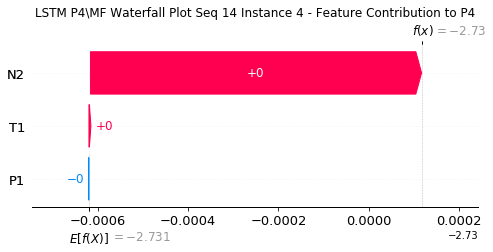

None

Contribution: [4.79154918e-05 1.43085357e-03 7.21523657e-04]


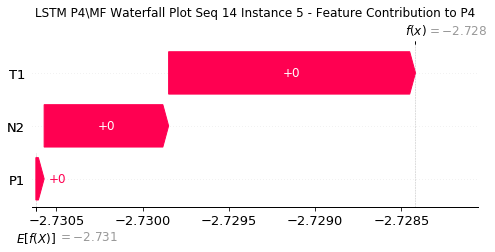

None

Contribution: [ 0.00038205 -0.00225747  0.00048845]


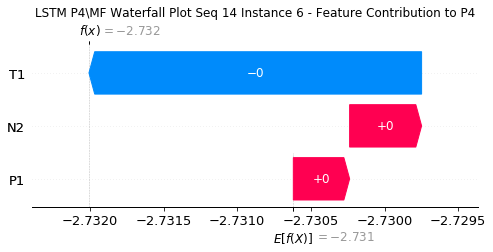

None

Contribution: [-0.00021398 -0.00237687 -0.00278349]


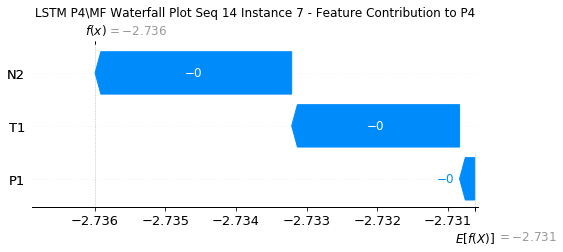

None

Contribution: [ 0.00036376  0.01338542 -0.00243135]


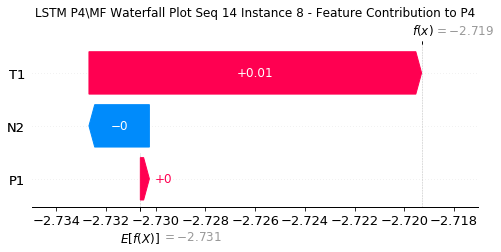

None

Contribution: [-0.00046673  0.01299301  0.00379393]


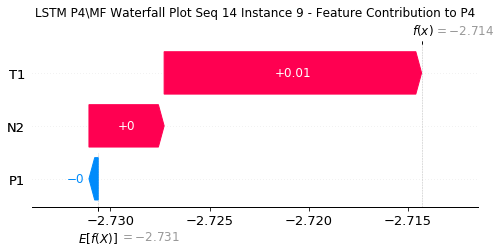

None

Contribution: [-0.0008636  -0.0154853   0.00501861]


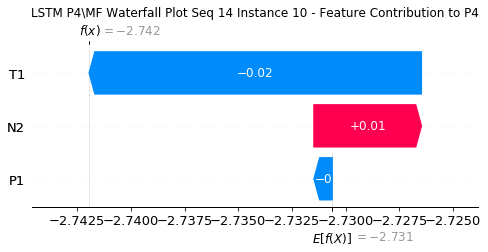

None

Contribution: [ 0.00050855 -0.02029917 -0.00314405]


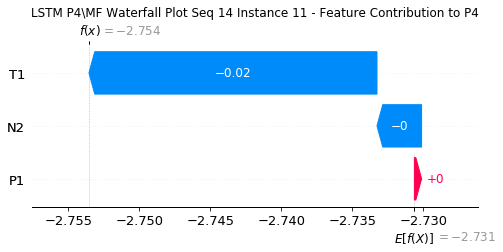

None

Contribution: [-0.00031435  0.01485515 -0.00776952]


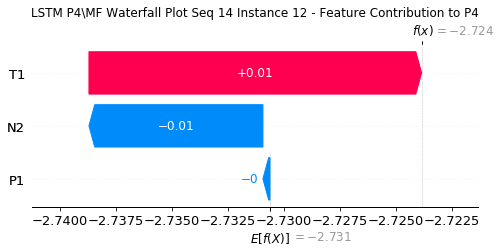

None

Contribution: [-0.00024925  0.02432114  0.00242846]


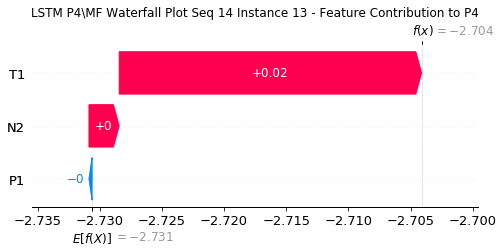

None

Contribution: [ 0.00044984 -0.01128276  0.00813906]


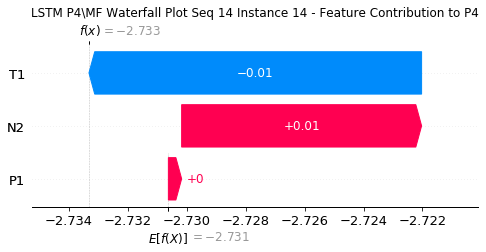

None

Contribution: [-0.00031437 -0.02525546 -0.00266096]


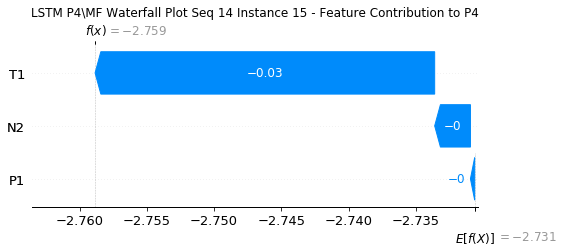

None

Contribution: [-0.00013754  0.00898631 -0.0099302 ]


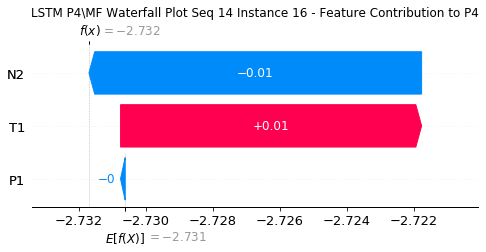

None

Contribution: [0.00132221 0.03512777 0.00155241]


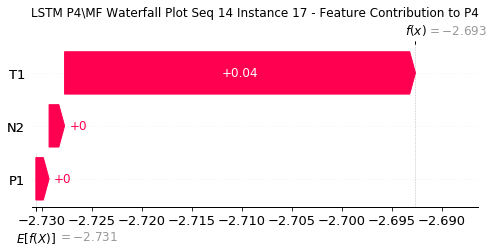

None

Contribution: [ 0.00021728 -0.00309057  0.01309655]


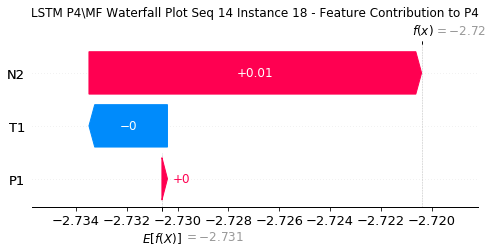

None

Contribution: [-0.00017883 -0.02319537 -0.00165127]


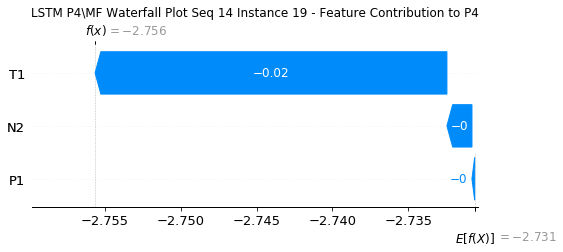

None

Contribution: [-0.00021561  0.00555695 -0.0206109 ]


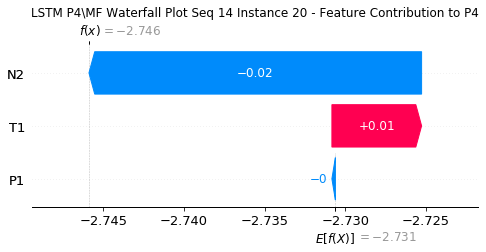

None

Contribution: [ 0.00092613  0.02371449 -0.00308302]


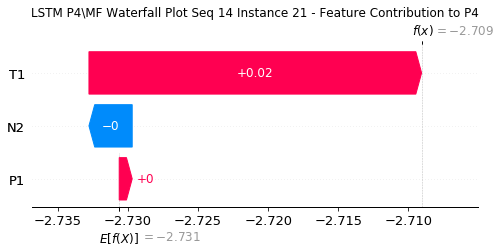

None

Contribution: [-0.00212205 -0.0047735   0.02338889]


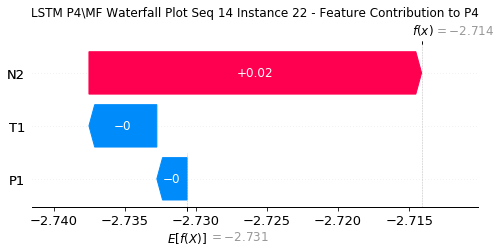

None

Contribution: [-0.00808681 -0.0042731  -0.00749251]


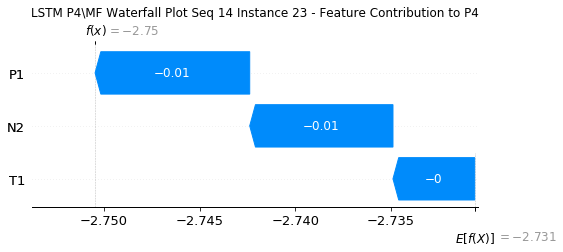

None

Contribution: [-0.00019742  0.00577792 -0.03630236]


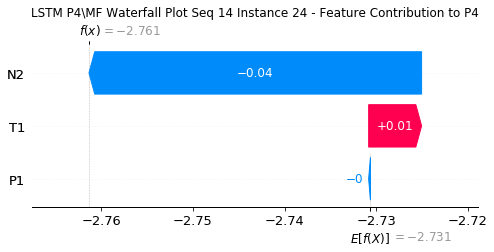

None

Contribution: [ 5.65484959e-05 -6.19599683e-04  3.68908020e-04]


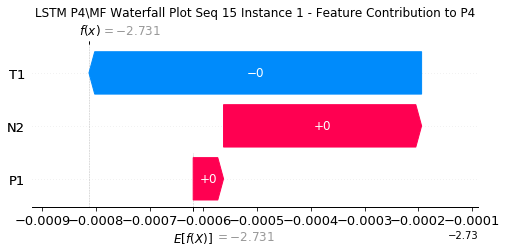

None

Contribution: [-7.45433202e-05 -1.02150683e-04  2.69431347e-04]


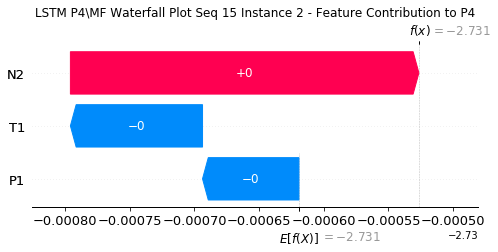

None

Contribution: [-5.15118024e-05 -4.41410834e-04  6.70282517e-04]


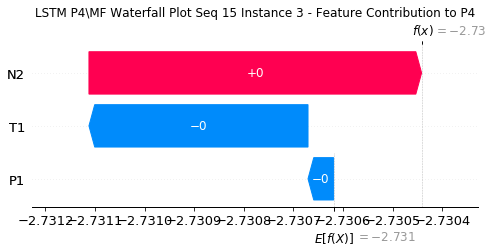

None

Contribution: [-5.18142296e-05 -2.53120939e-08  7.11816089e-04]


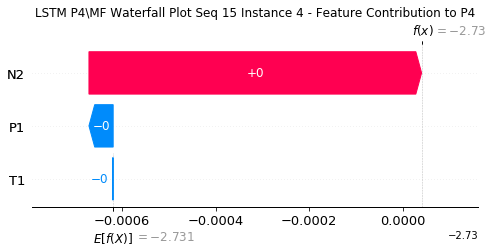

None

Contribution: [0.00016975 0.00090127 0.00072108]


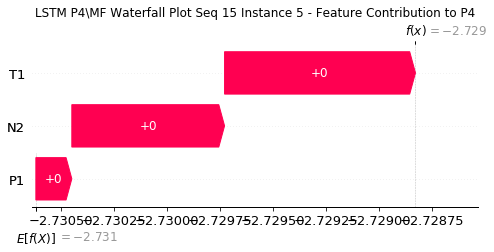

None

Contribution: [ 8.60873411e-05 -1.60612970e-03  2.64623970e-04]


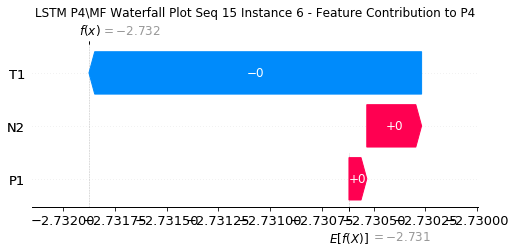

None

Contribution: [-0.00091775 -0.0023222  -0.00183682]


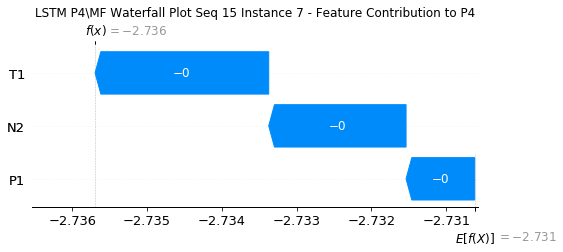

None

Contribution: [ 0.00012123  0.01297295 -0.00194702]


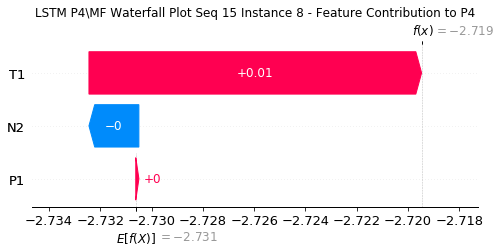

None

Contribution: [0.00042969 0.01226361 0.00282103]


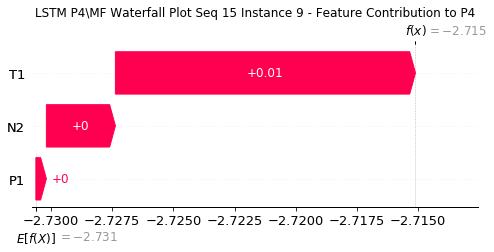

None

Contribution: [-0.00089587 -0.01389921  0.00487216]


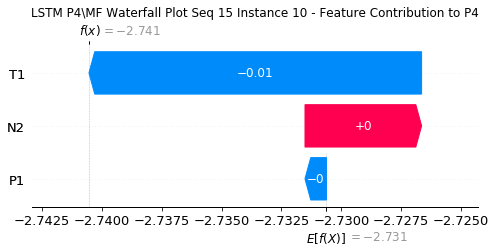

None

Contribution: [ 0.00037645 -0.01870491 -0.00306968]


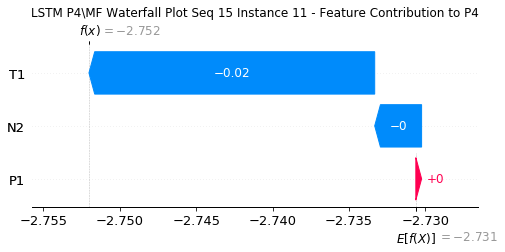

None

Contribution: [ 7.03011688e-05  1.37670147e-02 -7.21752684e-03]


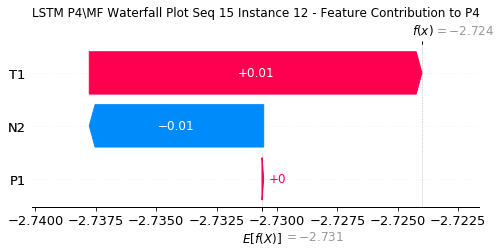

None

Contribution: [-0.00045898  0.02432388  0.00238999]


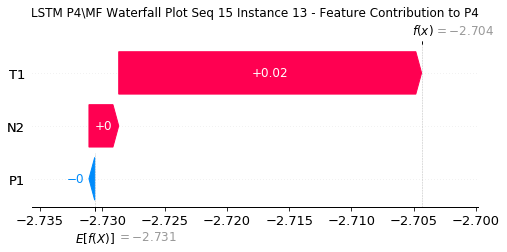

None

Contribution: [-0.0011365  -0.01143293  0.00951921]


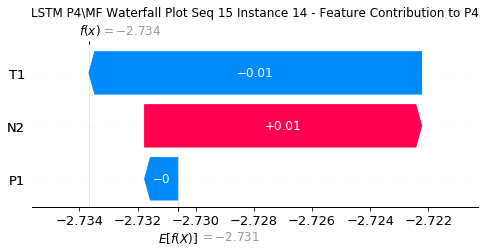

None

Contribution: [ 3.68180156e-05 -2.65315054e-02 -2.62937634e-03]


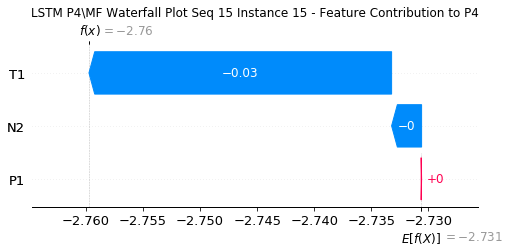

None

Contribution: [ 0.00024509  0.00967876 -0.00979913]


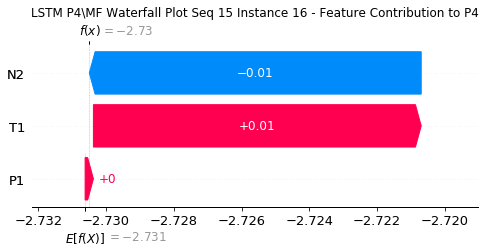

None

Contribution: [0.00077282 0.0318816  0.00170028]


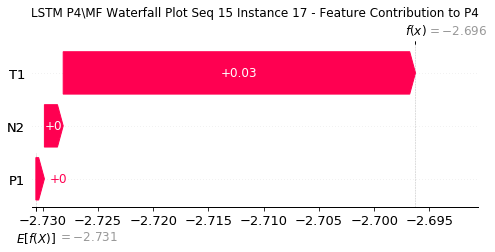

None

Contribution: [ 0.00024251 -0.00330317  0.01198593]


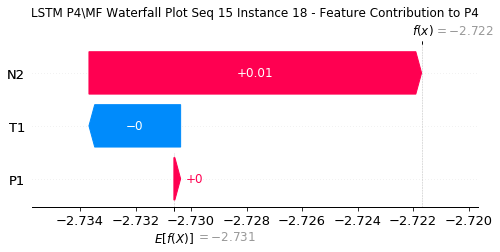

None

Contribution: [-0.00018442 -0.02660221 -0.00206325]


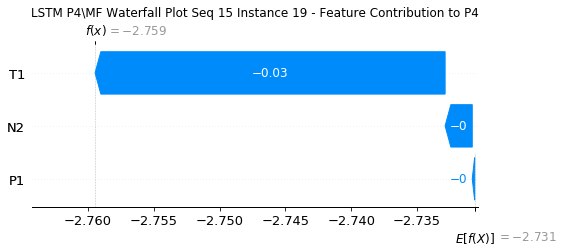

None

Contribution: [-0.00024145  0.00774459 -0.01897383]


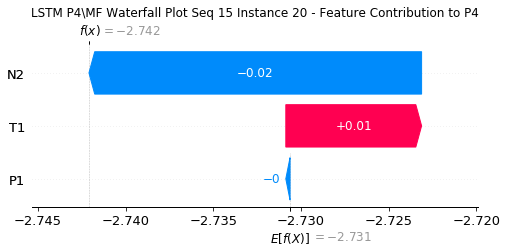

None

Contribution: [ 0.00075527  0.03294186 -0.00252666]


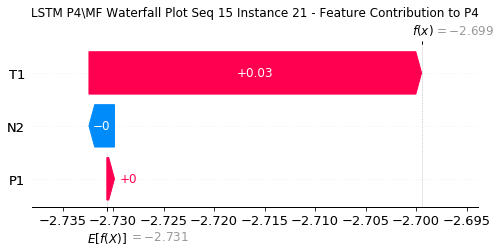

None

Contribution: [-0.00203053 -0.00568971  0.02078322]


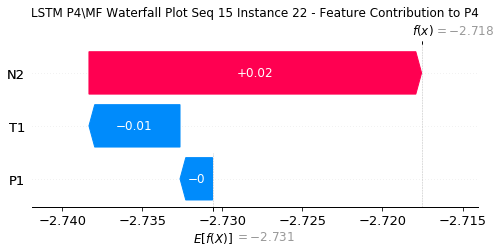

None

Contribution: [-0.00274876 -0.00251431 -0.00791033]


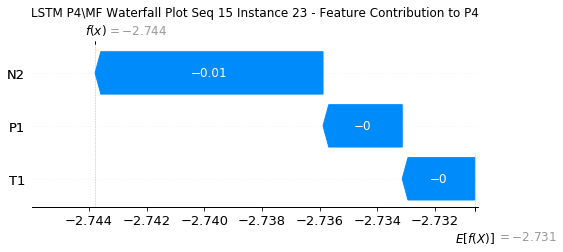

None

Contribution: [-0.00026879  0.01277235 -0.03808372]


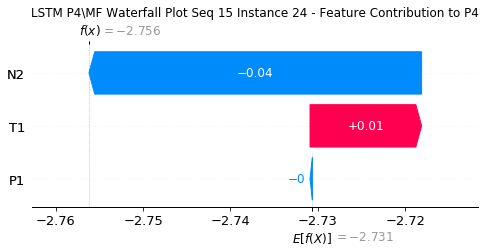

None

Contribution: [ 5.29416330e-05 -1.01416033e-03  4.28614723e-04]


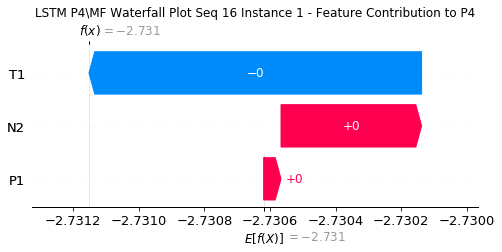

None

Contribution: [-3.44597252e-05 -2.08321488e-04  3.19348210e-04]


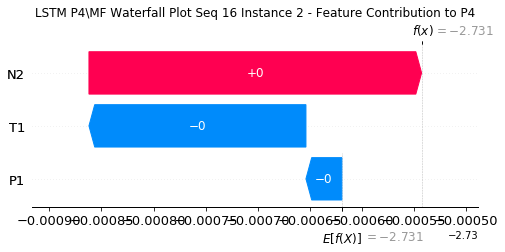

None

Contribution: [-0.00010414 -0.00066484  0.00068604]


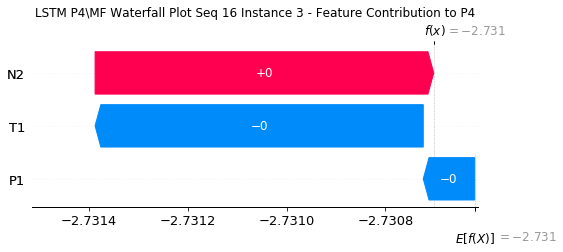

None

Contribution: [-7.60323599e-05  1.70603189e-05  7.14928630e-04]


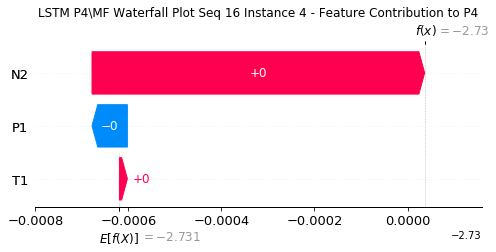

None

Contribution: [0.00015761 0.0010637  0.00079061]


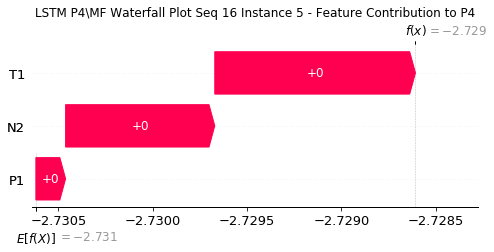

None

Contribution: [-6.45768264e-05 -2.01290963e-03  4.06487665e-04]


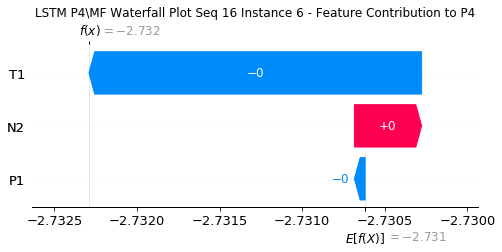

None

Contribution: [-0.00044282 -0.00235082 -0.00279632]


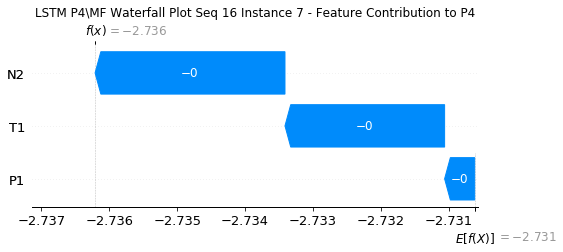

None

Contribution: [ 0.00050016  0.01289294 -0.00180226]


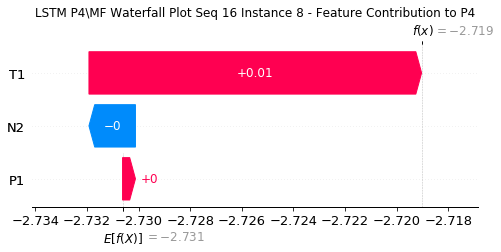

None

Contribution: [-0.00064903  0.0141513   0.0038798 ]


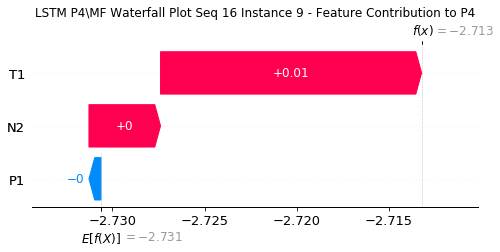

None

Contribution: [-0.00092567 -0.0141196   0.00563631]


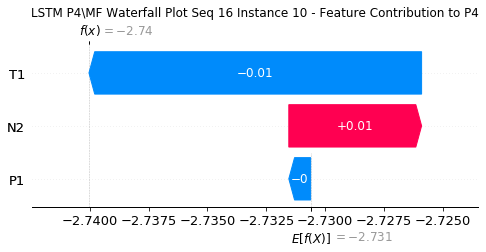

None

Contribution: [ 0.00048353 -0.01852896 -0.00322223]


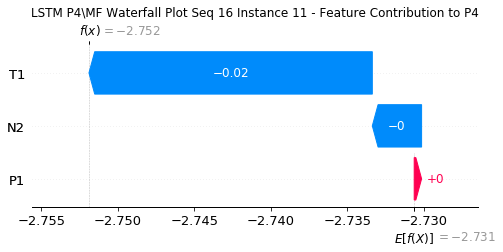

None

Contribution: [ 3.85824402e-05  1.21937252e-02 -6.26608193e-03]


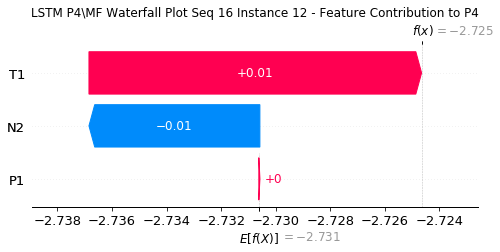

None

Contribution: [-0.00060662  0.02312758  0.00241637]


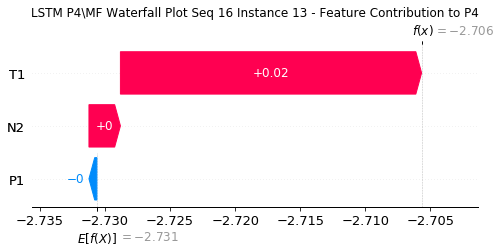

None

Contribution: [-0.00124164 -0.00942993  0.00825062]


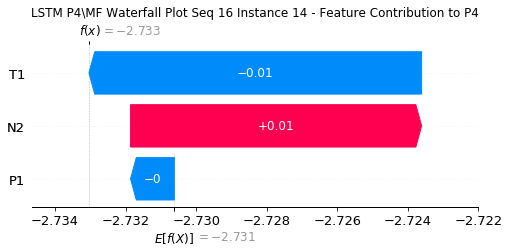

None

Contribution: [ 0.00015132 -0.02442246 -0.00250945]


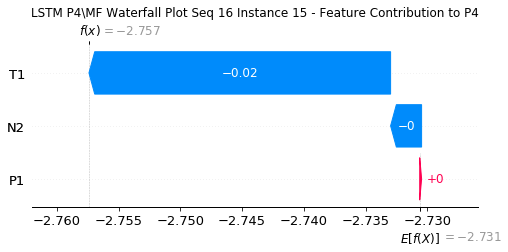

None

Contribution: [ 0.00014974  0.00907412 -0.01053549]


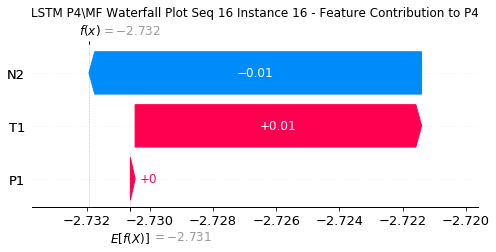

None

Contribution: [0.00067386 0.03184907 0.00155987]


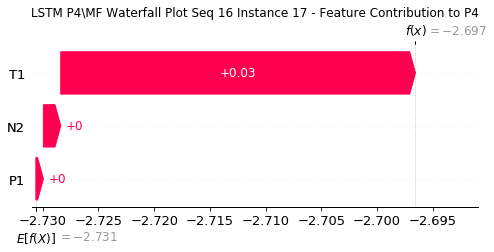

None

Contribution: [ 0.00072596 -0.00321258  0.01276069]


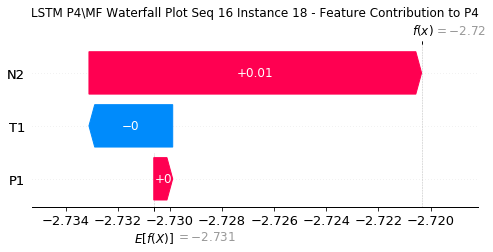

None

Contribution: [-0.0004537  -0.0253691  -0.00186663]


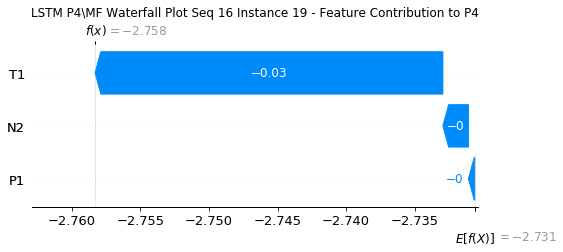

None

Contribution: [-0.00070441  0.00696161 -0.0195694 ]


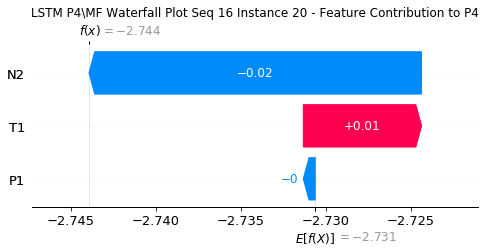

None

Contribution: [ 0.00092114  0.02914966 -0.00277469]


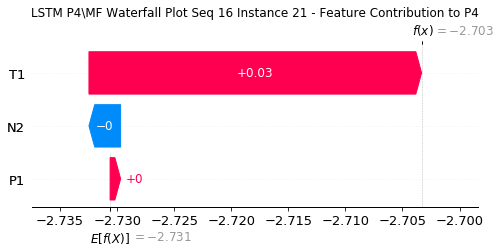

None

Contribution: [-0.00145843 -0.00515669  0.02172815]


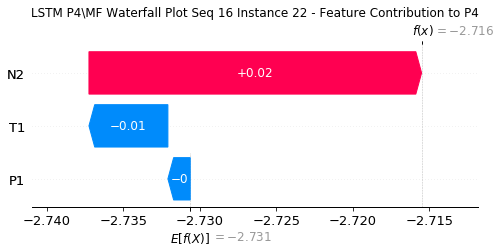

None

Contribution: [-0.00592735 -0.00360888 -0.00789022]


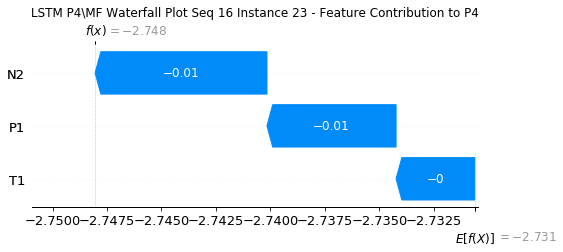

None

Contribution: [-0.00020723  0.01501152 -0.03651242]


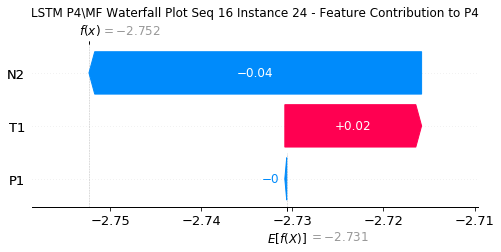

None

Contribution: [ 8.19833264e-05 -9.40716854e-04  3.91021325e-04]


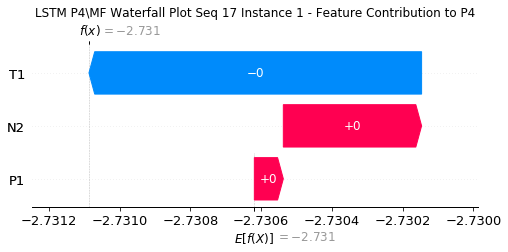

None

Contribution: [-4.00099332e-05 -1.97330793e-04  3.57574993e-04]


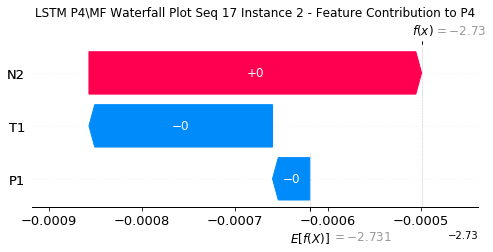

None

Contribution: [-3.56663857e-05 -7.16000292e-04  6.94872092e-04]


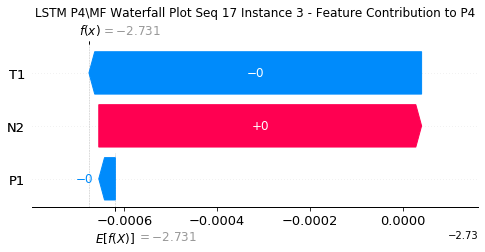

None

Contribution: [-5.53732756e-05  8.17115679e-05  7.19258221e-04]


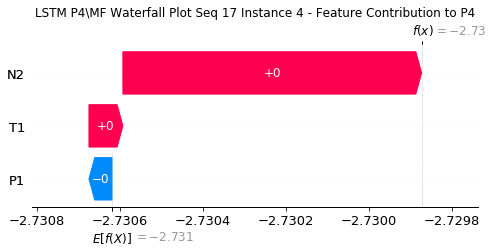

None

Contribution: [7.55312290e-05 1.09676722e-03 7.63097159e-04]


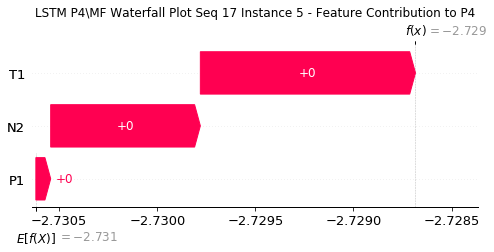

None

Contribution: [ 6.45311364e-05 -2.34955269e-03  3.89812794e-04]


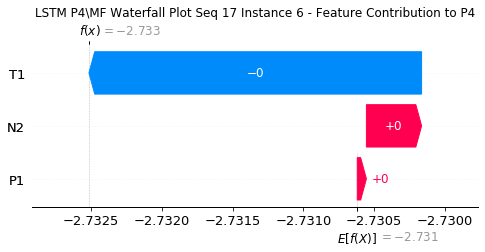

None

Contribution: [-0.00035074 -0.0024074  -0.00253914]


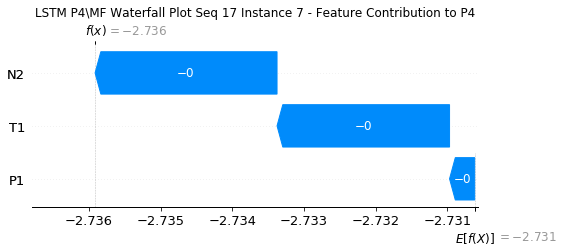

None

Contribution: [ 0.00036512  0.0154473  -0.00299725]


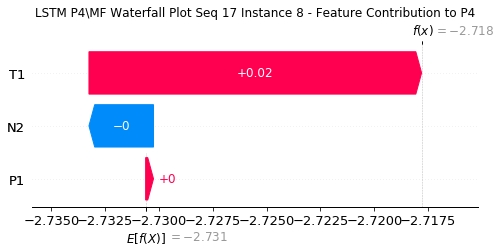

None

Contribution: [0.00067014 0.01547603 0.00341483]


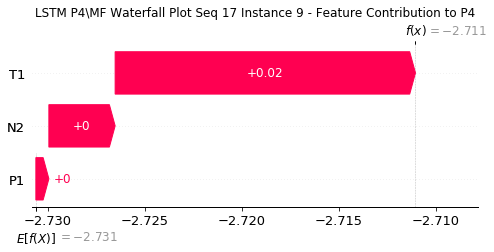

None

Contribution: [-0.00062925 -0.01732848  0.00449795]


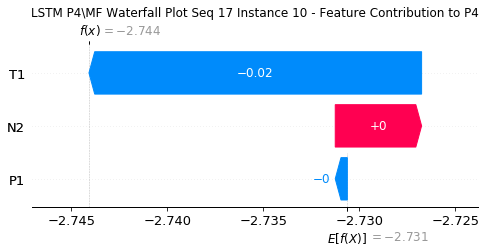

None

Contribution: [-9.09649473e-05 -2.25014949e-02 -2.99203234e-03]


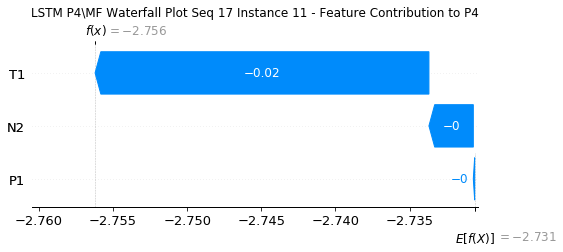

None

Contribution: [-0.00023599  0.01529252 -0.00633234]


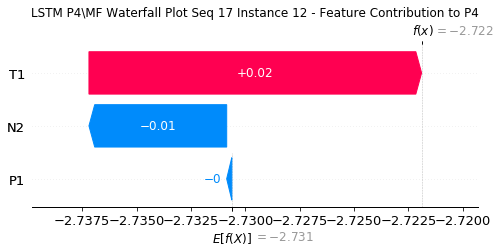

None

Contribution: [0.00011244 0.02824193 0.00236522]


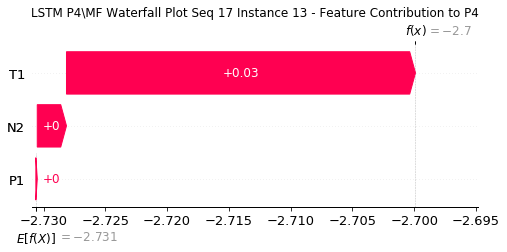

None

Contribution: [-0.00113785 -0.01184738  0.00724623]


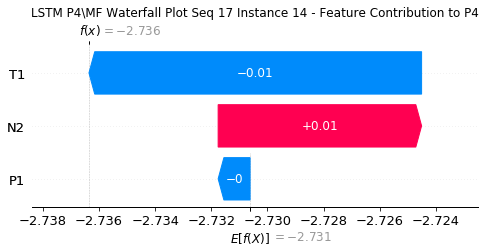

None

Contribution: [-0.00036526 -0.02928617 -0.00269647]


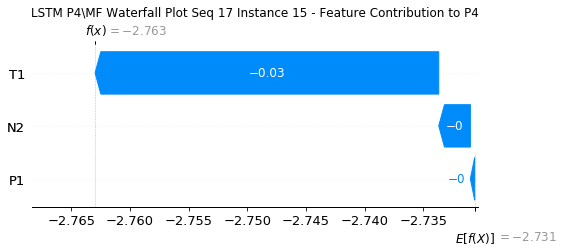

None

Contribution: [-0.00022734  0.01113629 -0.00938479]


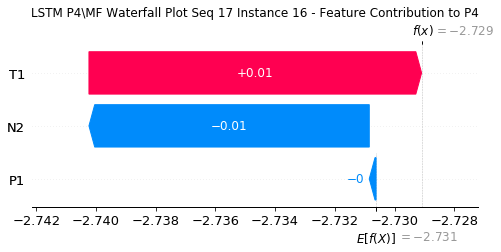

None

Contribution: [0.00089559 0.03506612 0.00223574]


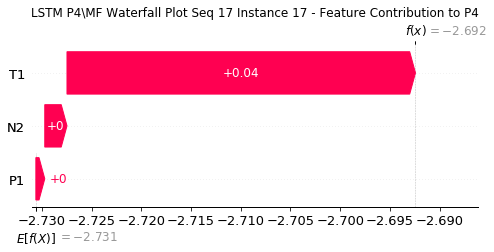

None

Contribution: [-1.17322640e-05 -3.65106516e-03  1.18727275e-02]


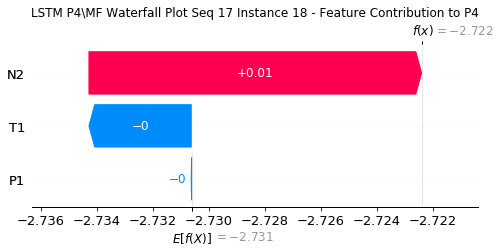

None

Contribution: [-0.00011385 -0.02974247 -0.00204997]


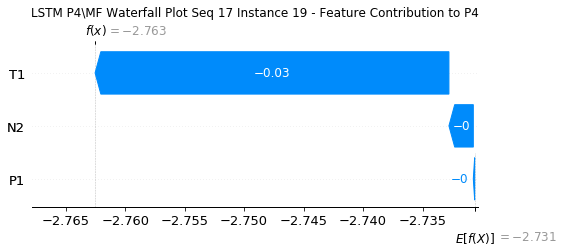

None

Contribution: [-9.08417386e-05  8.87097640e-03 -1.86535419e-02]


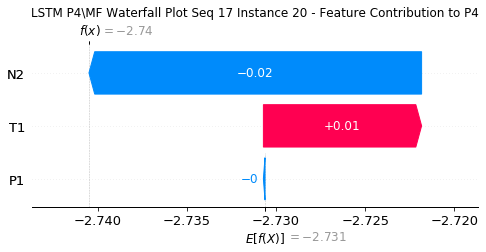

None

Contribution: [ 0.00091486  0.03647525 -0.00230435]


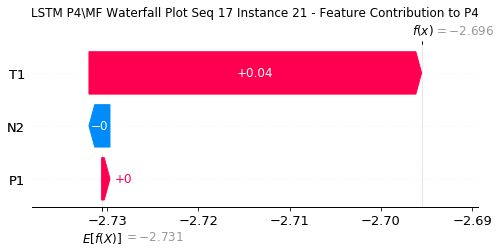

None

Contribution: [-0.00278379 -0.00573488  0.02194006]


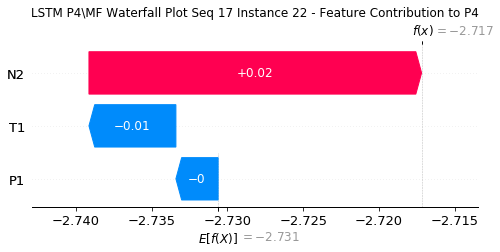

None

Contribution: [-0.01056338 -0.002125   -0.00743179]


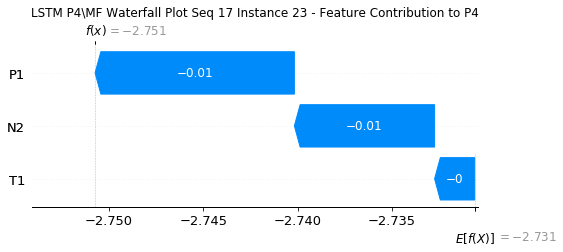

None

Contribution: [-0.00039766  0.02026293 -0.03559209]


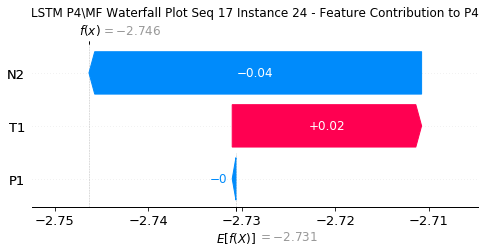

None

Contribution: [ 4.82273113e-05 -1.20275491e-03  2.72832932e-04]


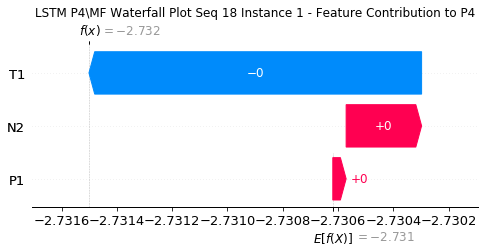

None

Contribution: [-6.07725471e-05 -3.33187888e-04  2.06556109e-04]


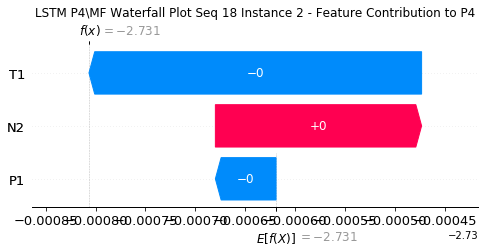

None

Contribution: [-3.52667461e-05 -9.00302957e-04  6.19451328e-04]


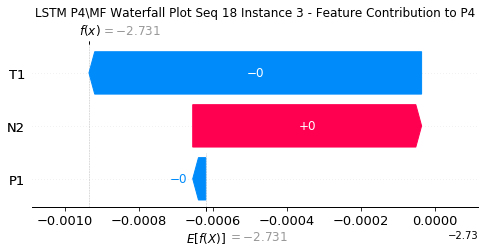

None

Contribution: [-4.79329922e-05  3.87969725e-05  6.68595156e-04]


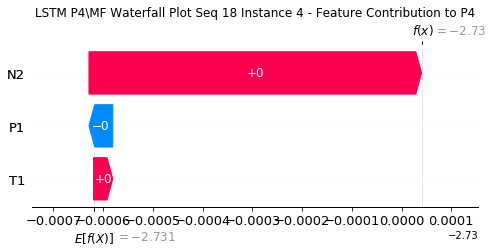

None

Contribution: [-1.16640101e-05  1.12427213e-03  7.90754932e-04]


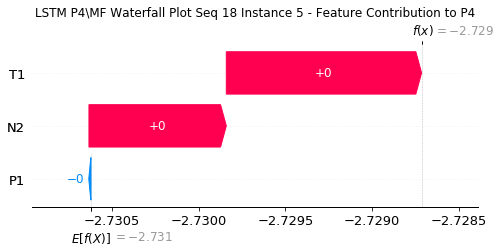

None

Contribution: [ 4.87944960e-05 -2.54545209e-03  2.99970980e-04]


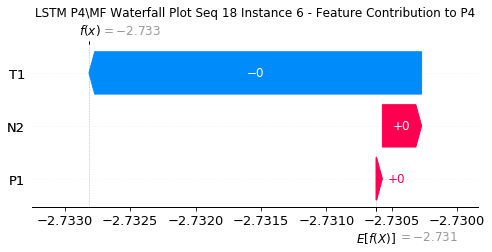

None

Contribution: [-0.00074648 -0.0026347  -0.0020421 ]


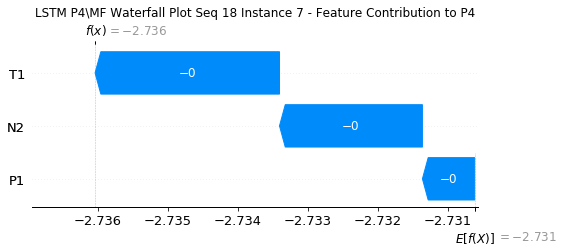

None

Contribution: [ 0.00030707  0.01864029 -0.00236432]


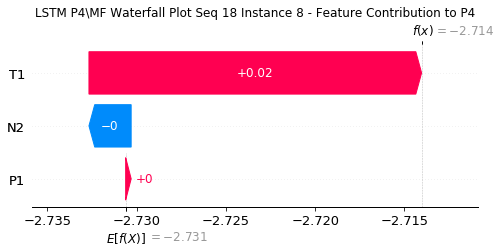

None

Contribution: [0.00130177 0.0181226  0.00296268]


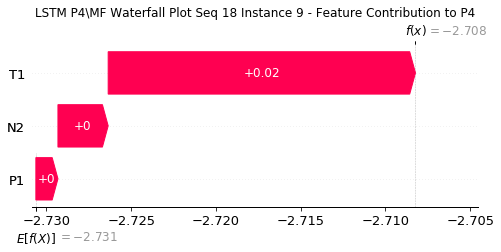

None

Contribution: [-0.00075164 -0.01797033  0.00509226]


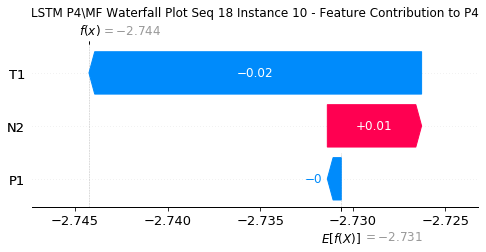

None

Contribution: [ 0.0003279  -0.0235631  -0.00307139]


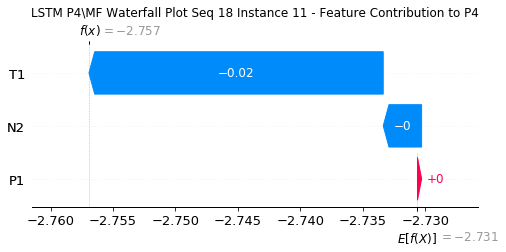

None

Contribution: [-0.00011065  0.01753125 -0.00422423]


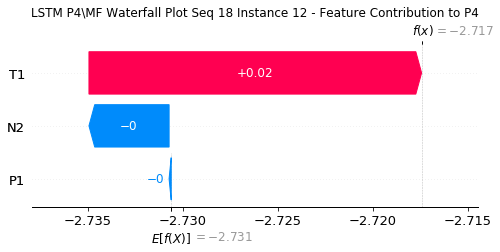

None

Contribution: [-0.00043757  0.02944993  0.0023512 ]


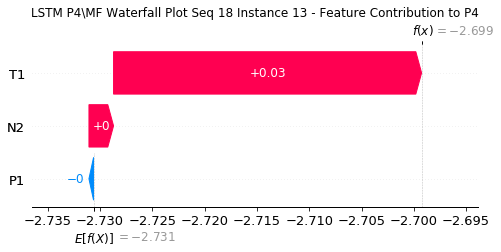

None

Contribution: [-0.00109413 -0.01120253  0.00835731]


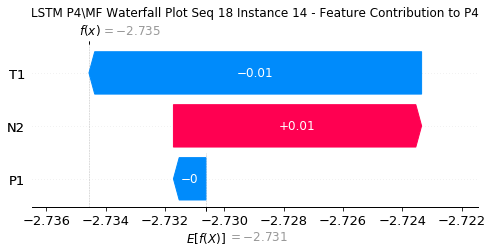

None

Contribution: [ 0.00021766 -0.03065039 -0.00247125]


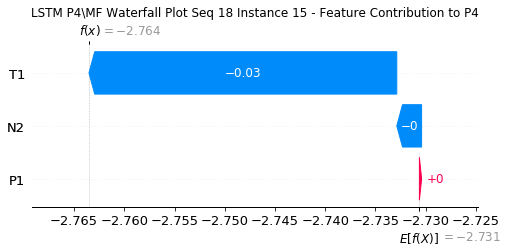

None

Contribution: [ 0.00043544  0.0117572  -0.01014126]


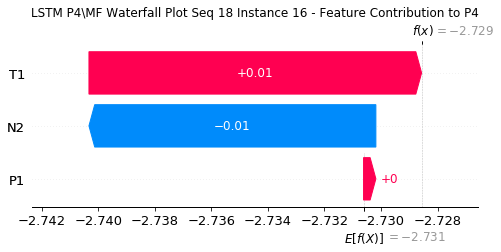

None

Contribution: [0.00111303 0.04035238 0.00168924]


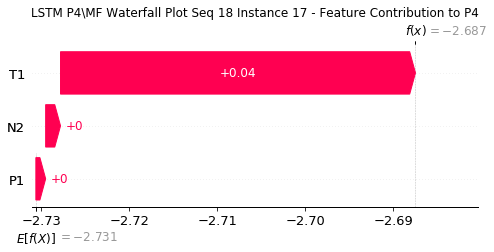

None

Contribution: [-0.00068469 -0.0040179   0.01322025]


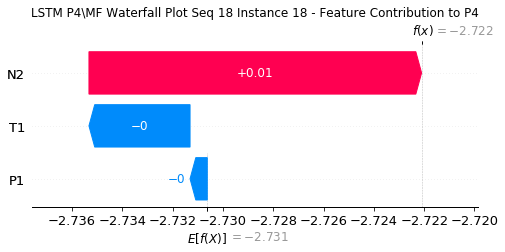

None

Contribution: [ 0.00024216 -0.03232416 -0.00160534]


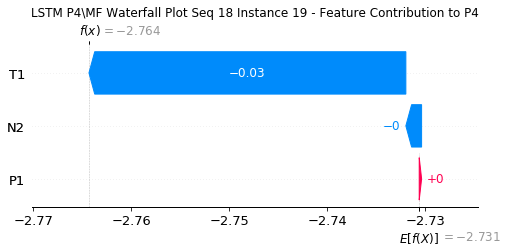

None

Contribution: [ 0.00052173  0.01008757 -0.02052406]


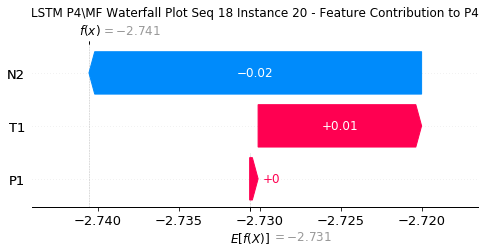

None

Contribution: [ 0.00056303  0.03899325 -0.00308797]


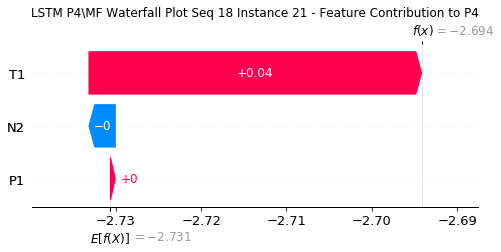

None

Contribution: [-0.0032431  -0.00601397  0.02284482]


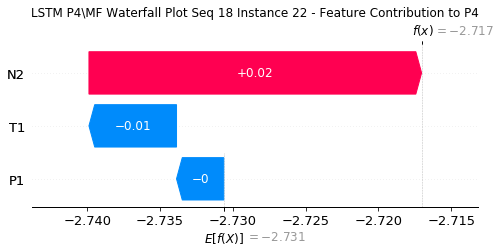

None

Contribution: [-0.00539288 -0.00132949 -0.00782579]


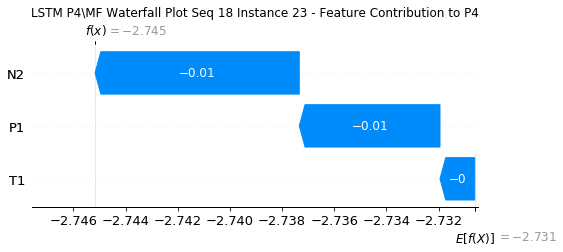

None

Contribution: [-0.0003326   0.02008685 -0.0381857 ]


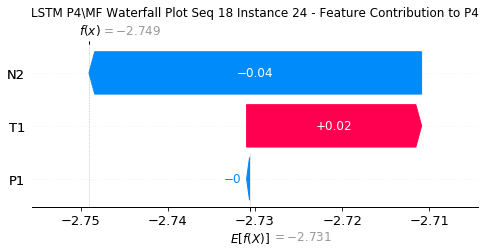

None

Contribution: [ 8.49903737e-05 -1.10915661e-03  4.84032726e-04]


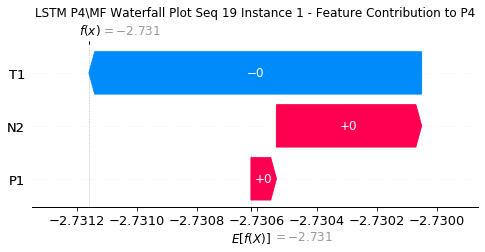

None

Contribution: [-1.86898183e-05 -2.07777648e-04  3.92221635e-04]


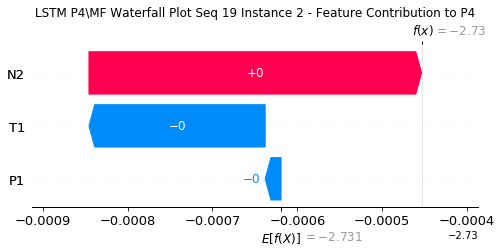

None

Contribution: [ 4.64665746e-05 -6.50367395e-04  7.43411373e-04]


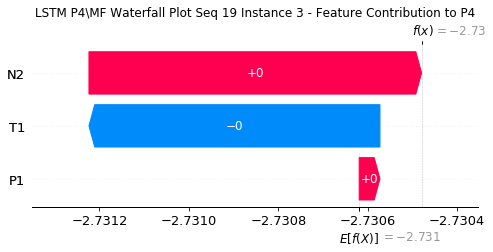

None

Contribution: [-5.05545810e-06  6.83969531e-05  7.37223445e-04]


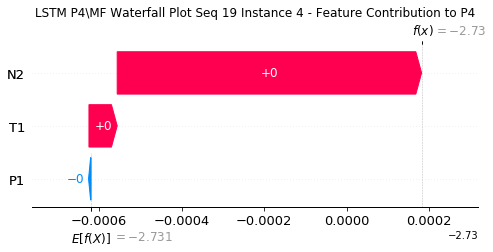

None

Contribution: [0.00039808 0.00116726 0.00078324]


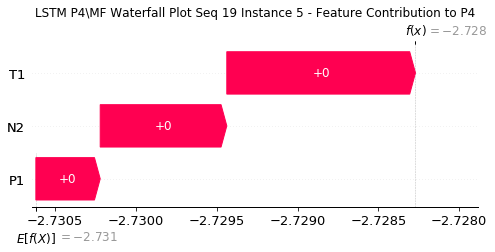

None

Contribution: [ 0.00053231 -0.00214077  0.00051091]


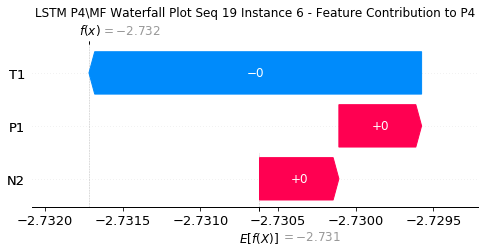

None

Contribution: [ 0.00060392 -0.00234121 -0.0035268 ]


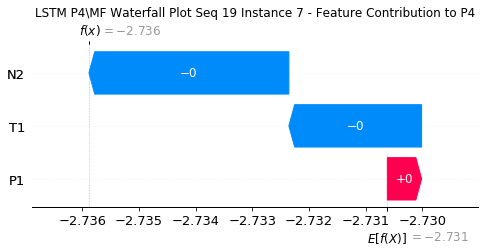

None

Contribution: [-0.00030849  0.01554909 -0.00421861]


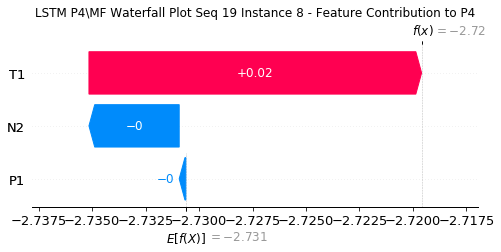

None

Contribution: [-0.00160694  0.01330598  0.00396588]


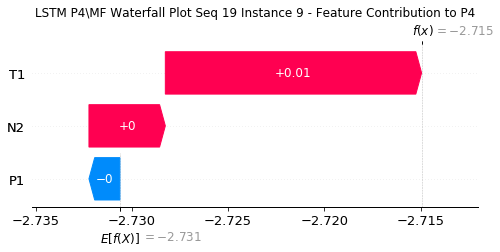

None

Contribution: [-0.00117623 -0.01512178  0.00557491]


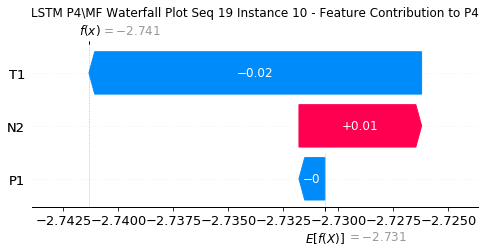

None

Contribution: [ 0.00177218 -0.02028826 -0.00323199]


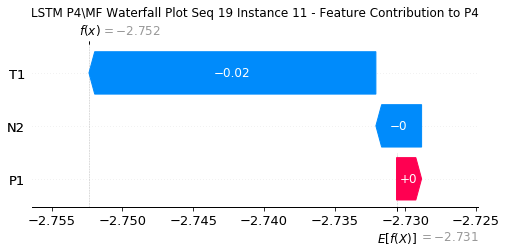

None

Contribution: [ 0.00132633  0.01522828 -0.008699  ]


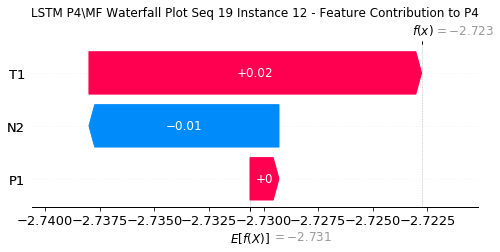

None

Contribution: [-0.00155739  0.02566449  0.00235395]


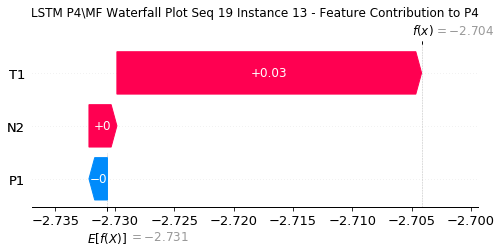

None

Contribution: [-0.00208604 -0.01120401  0.00960098]


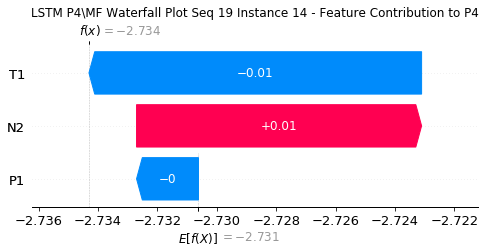

None

Contribution: [ 0.00088723 -0.028106   -0.00252078]


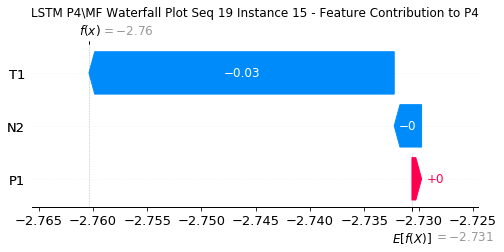

None

Contribution: [ 0.00090879  0.01079341 -0.01021754]


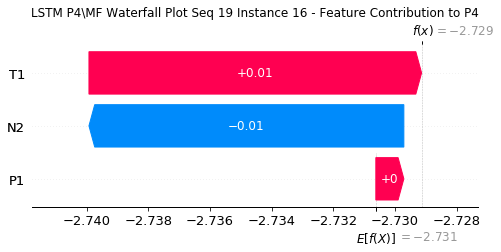

None

Contribution: [-5.05570726e-05  3.43686427e-02  8.28352248e-04]


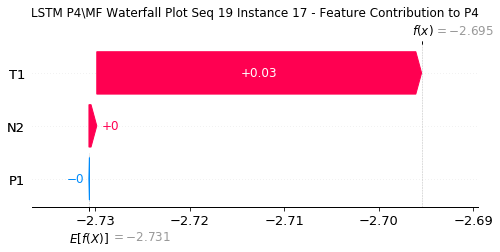

None

Contribution: [-0.00087861 -0.00384051  0.01266316]


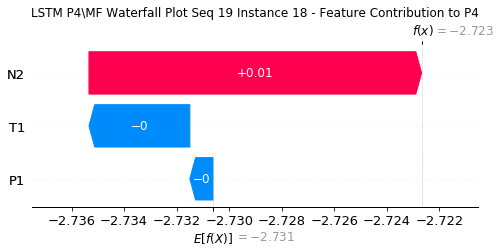

None

Contribution: [ 0.00031002 -0.03107976 -0.00184359]


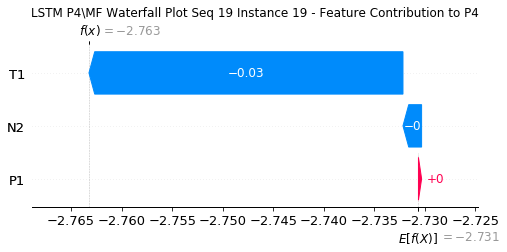

None

Contribution: [ 0.0006028   0.00919348 -0.01934131]


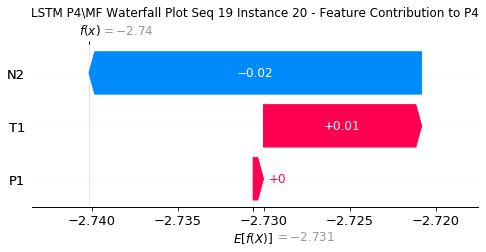

None

Contribution: [ 0.00057511  0.03632257 -0.00252836]


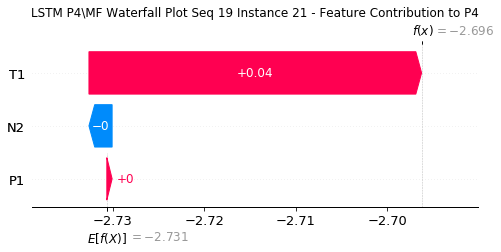

None

Contribution: [-0.00265637 -0.00582872  0.02106581]


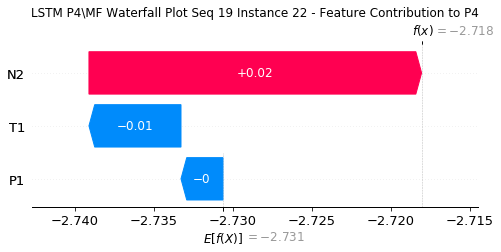

None

Contribution: [-0.00774061 -0.00198664 -0.00756032]


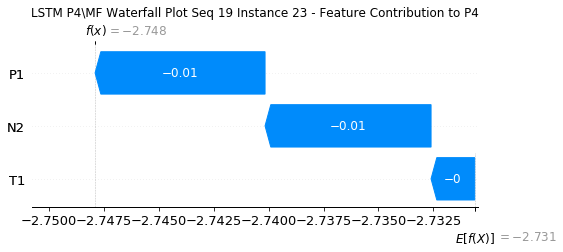

None

Contribution: [ 1.03480421e-05  1.86449244e-02 -3.88739315e-02]


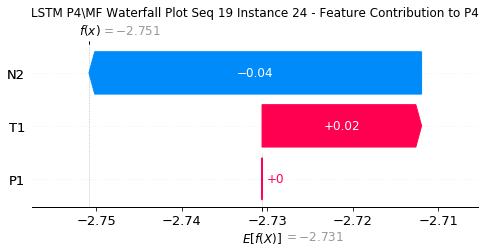

None

Contribution: [ 0.00012896 -0.00108976  0.00041753]


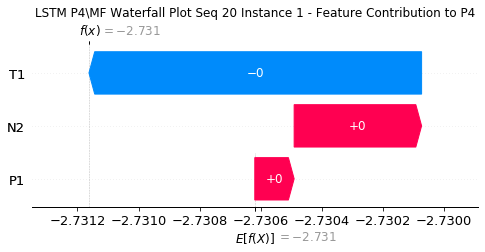

None

Contribution: [-8.42126746e-05 -2.72561163e-04  2.67618425e-04]


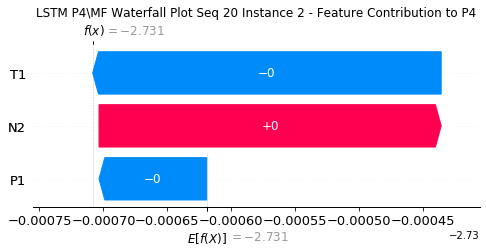

None

Contribution: [ 1.21722859e-05 -7.65566524e-04  6.77733612e-04]


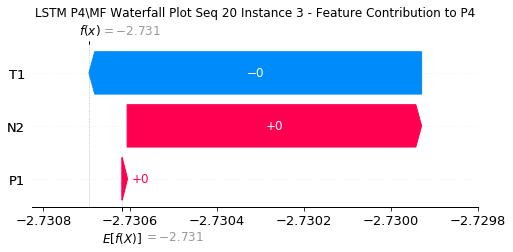

None

Contribution: [-8.74115846e-06  5.96783056e-05  7.03140385e-04]


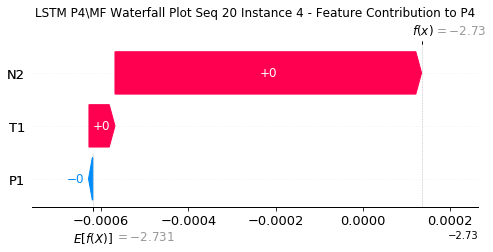

None

Contribution: [0.00027932 0.00113981 0.00076216]


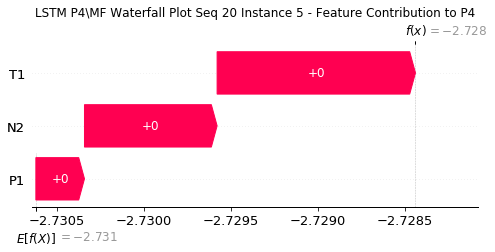

None

Contribution: [ 0.00044447 -0.00234287  0.00041028]


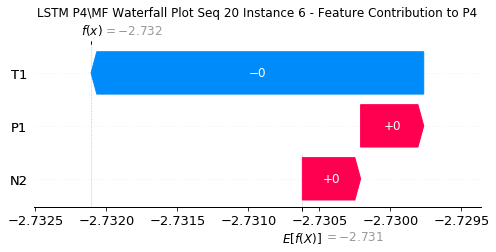

None

Contribution: [ 0.00022145 -0.00251929 -0.00301627]


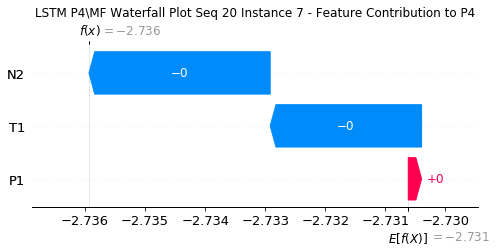

None

Contribution: [ 1.79668177e-05  1.64678933e-02 -2.75210995e-03]


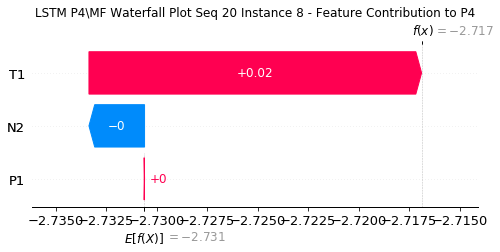

None

Contribution: [-0.00166298  0.01592336  0.0041283 ]


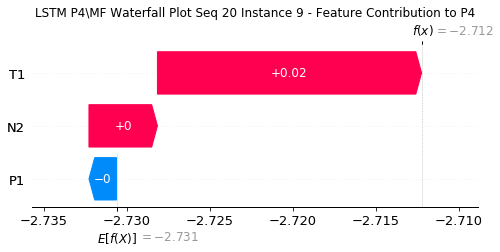

None

Contribution: [-0.00107378 -0.01669925  0.00437172]


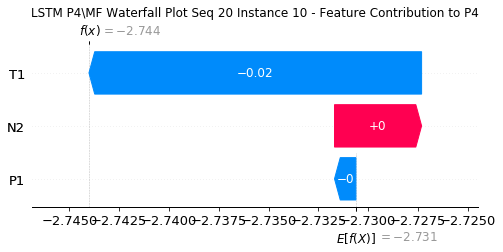

None

Contribution: [ 0.00132582 -0.0220891  -0.00292579]


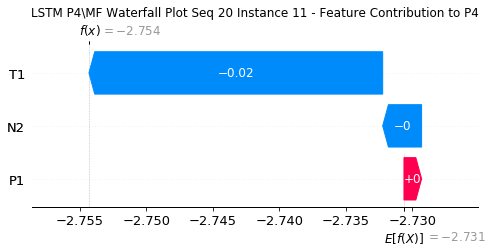

None

Contribution: [ 0.00095922  0.01441998 -0.0032024 ]


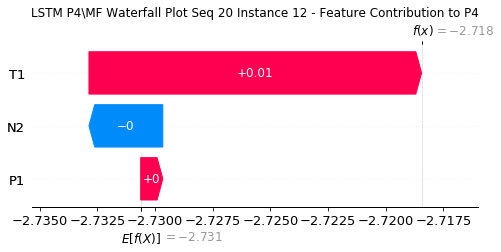

None

Contribution: [-0.00123317  0.02789144  0.00235499]


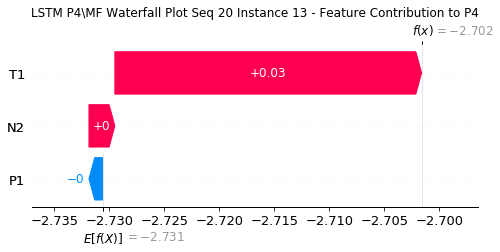

None

Contribution: [-0.00102235 -0.01166781  0.00579262]


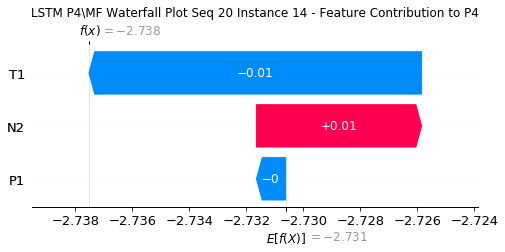

None

Contribution: [ 0.00099038 -0.02971186 -0.0027621 ]


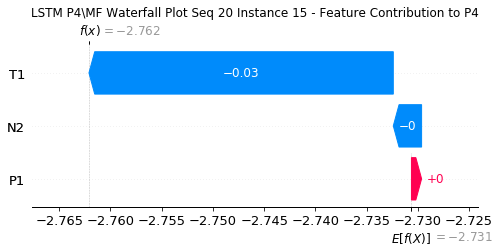

None

Contribution: [ 0.00139292  0.01135342 -0.0086549 ]


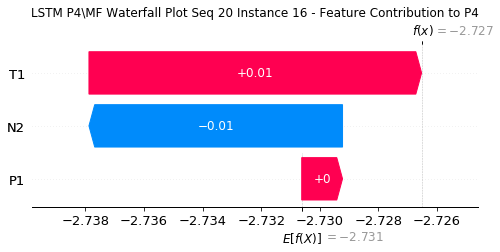

None

Contribution: [-0.00069892  0.0373735   0.00227545]


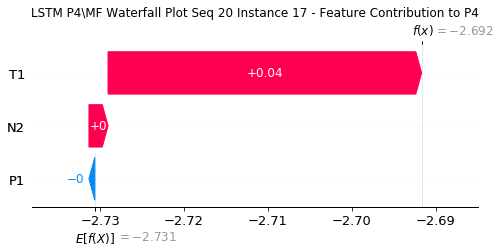

None

Contribution: [-0.0012251 -0.0040156  0.0104577]


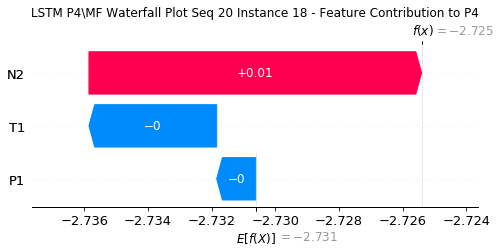

None

Contribution: [ 0.00048886 -0.03214268 -0.00260616]


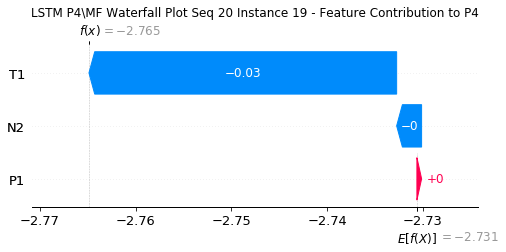

None

Contribution: [ 0.00057656  0.00984718 -0.016387  ]


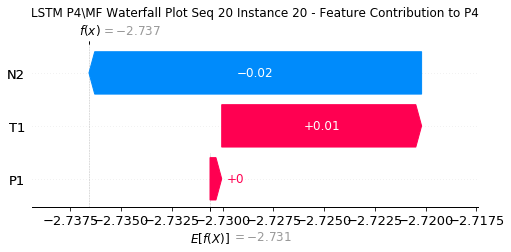

None

Contribution: [ 0.00037637  0.03823048 -0.00139223]


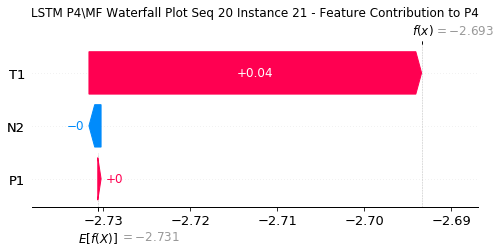

None

Contribution: [-0.00315613 -0.00596248  0.01805955]


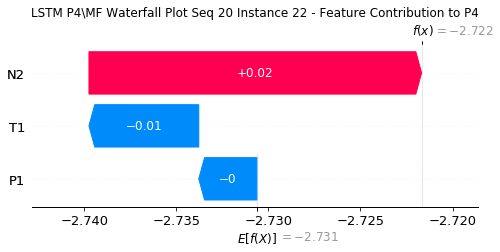

None

Contribution: [-0.00632944 -0.00233826 -0.00813567]


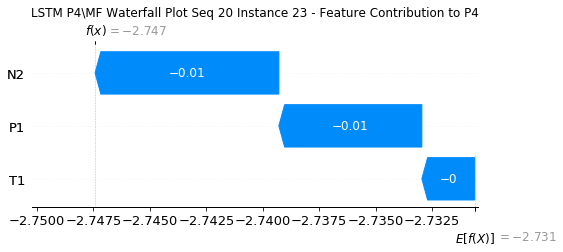

None

Contribution: [-4.61812418e-05  1.63489808e-02 -3.70883095e-02]


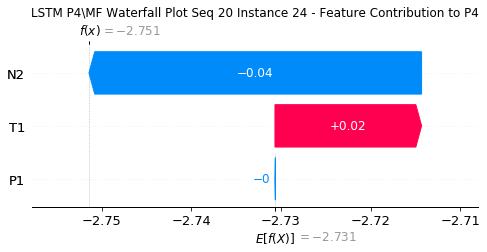

None

Contribution: [ 8.33503502e-05 -9.32556116e-04  2.85955502e-04]


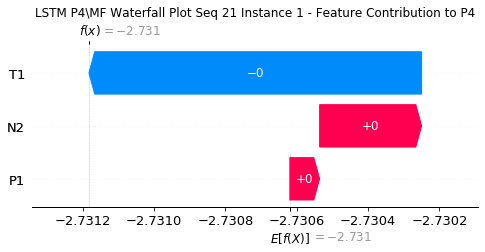

None

Contribution: [ 1.68264624e-06 -1.41300021e-04  3.51769409e-04]


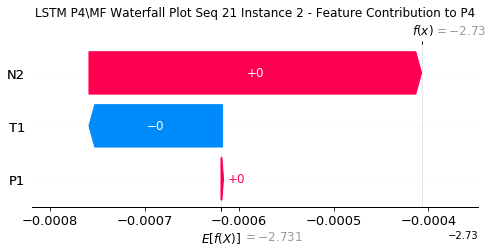

None

Contribution: [-1.68301368e-05 -6.28175463e-04  7.08896782e-04]


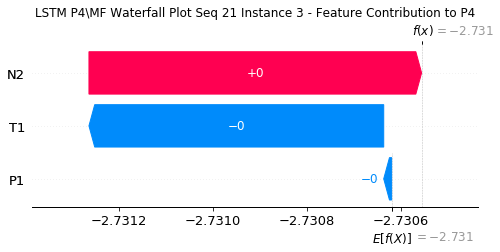

None

Contribution: [-3.80058756e-05  1.38171112e-04  7.33951691e-04]


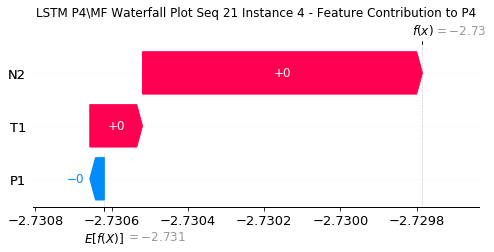

None

Contribution: [0.00039054 0.00134532 0.00066313]


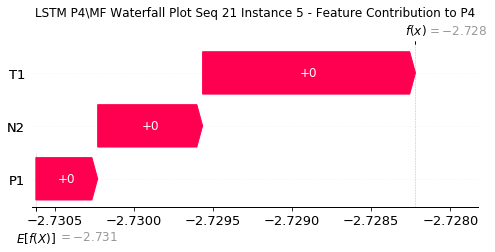

None

Contribution: [ 0.00034914 -0.00223079  0.00033027]


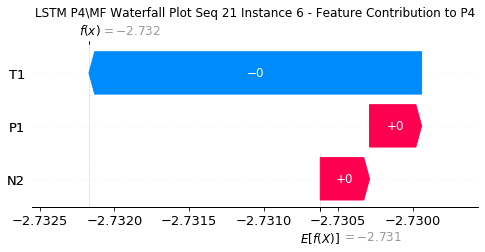

None

Contribution: [ 0.0006063  -0.00231039 -0.00225447]


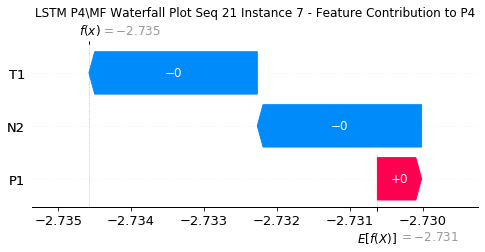

None

Contribution: [-6.51729150e-05  1.30494679e-02 -1.92675072e-03]


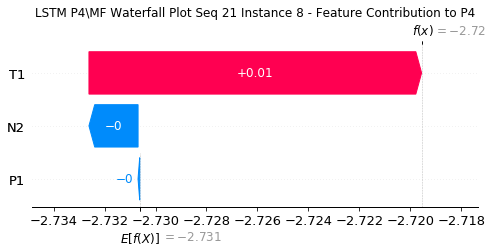

None

Contribution: [-0.00154519  0.01333825  0.00324929]


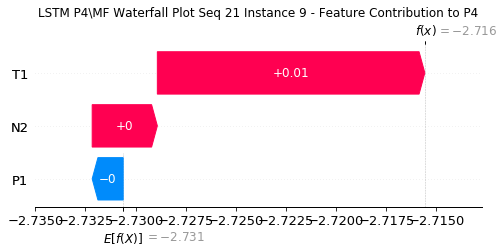

None

Contribution: [-0.00074943 -0.01635233  0.00458456]


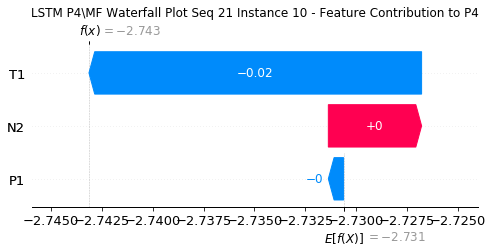

None

Contribution: [ 0.00053949 -0.02159431 -0.002985  ]


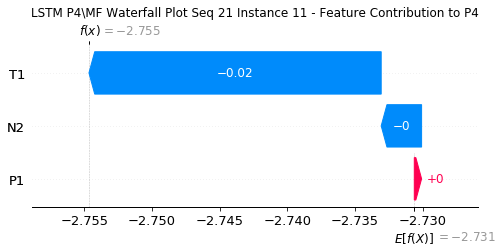

None

Contribution: [ 0.00134131  0.01580167 -0.00808967]


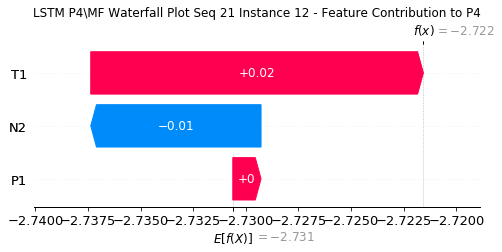

None

Contribution: [-0.00068211  0.02710422  0.00232229]


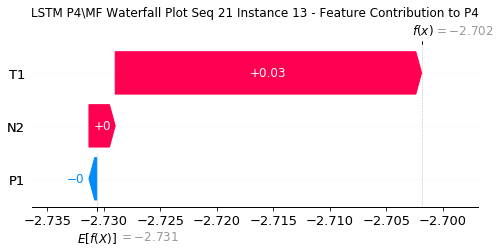

None

Contribution: [-0.00213965 -0.01085661  0.00807702]


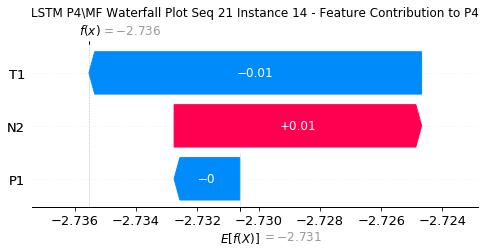

None

Contribution: [ 0.00180251 -0.03161658 -0.00235932]


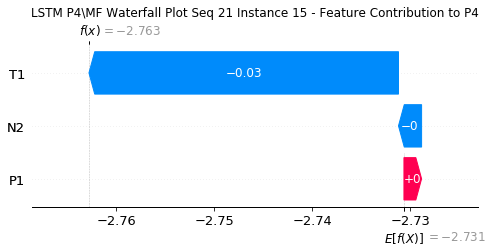

None

Contribution: [ 0.00169418  0.01205684 -0.01136081]


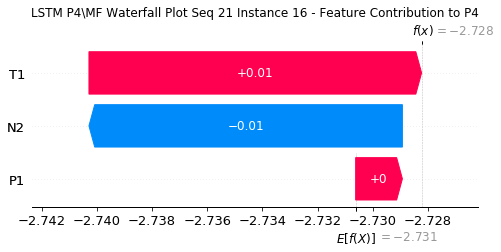

None

Contribution: [-0.00032647  0.03932921  0.00124818]


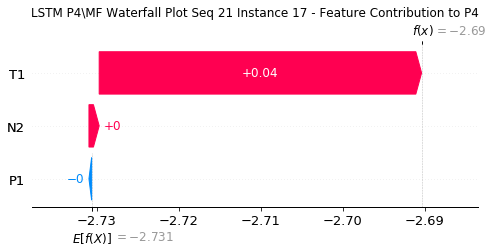

None

Contribution: [-0.00220998 -0.00395953  0.01403921]


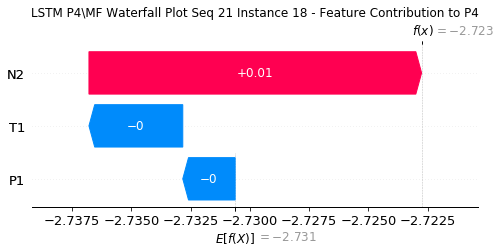

None

Contribution: [ 0.00045724 -0.03552818 -0.00175765]


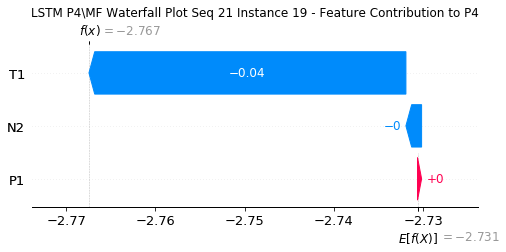

None

Contribution: [ 0.0005991   0.01154481 -0.02021725]


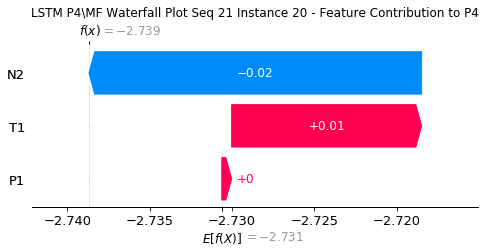

None

Contribution: [ 0.00066573  0.04468363 -0.00240371]


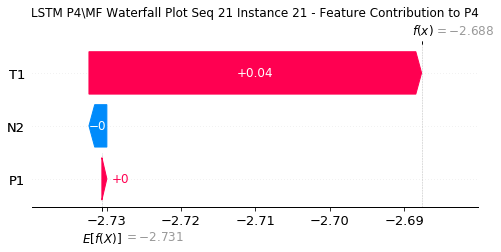

None

Contribution: [-0.00290706 -0.0064525   0.02213332]


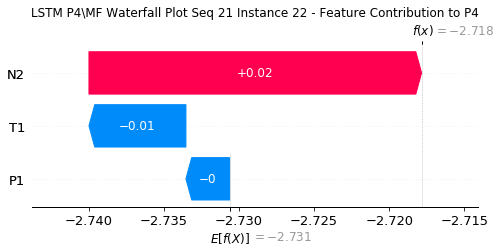

None

Contribution: [-0.00809364 -0.00014221 -0.00779011]


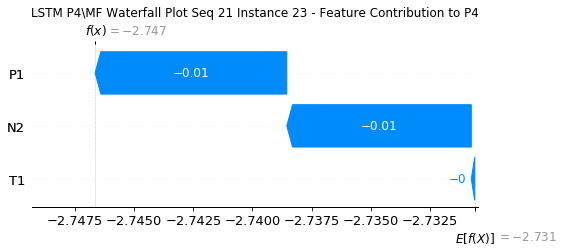

None

Contribution: [ 0.00030911  0.02437058 -0.03965495]


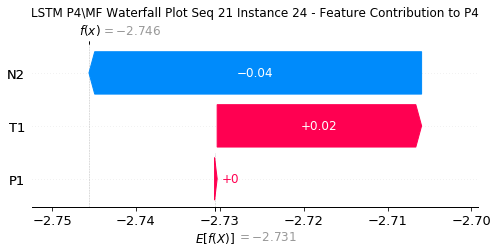

None

Contribution: [ 9.40319066e-05 -1.17382361e-03  3.12865100e-04]


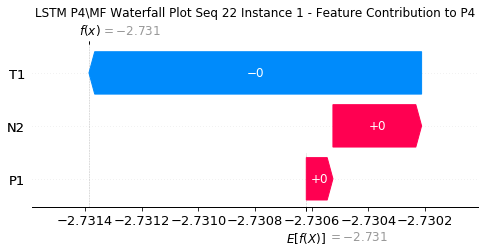

None

Contribution: [-3.44634442e-05 -1.84718064e-04  2.31151432e-04]


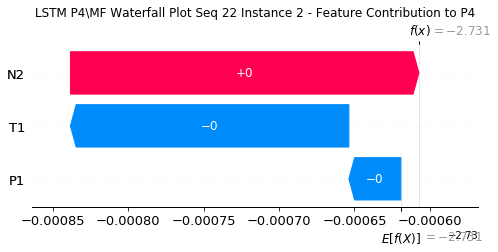

None

Contribution: [ 5.71753437e-05 -7.85821211e-04  5.96368221e-04]


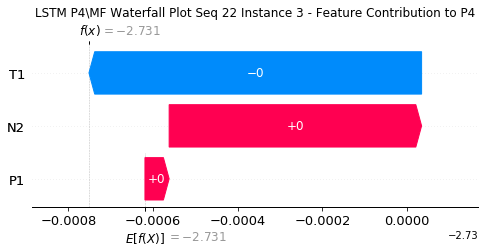

None

Contribution: [-2.8326192e-05  2.0327171e-04  6.7126946e-04]


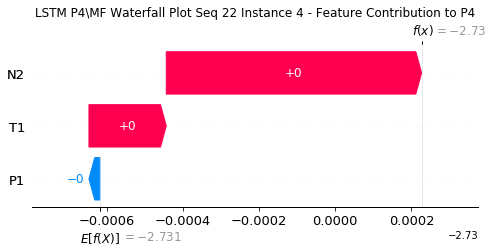

None

Contribution: [0.00014944 0.00119155 0.00054938]


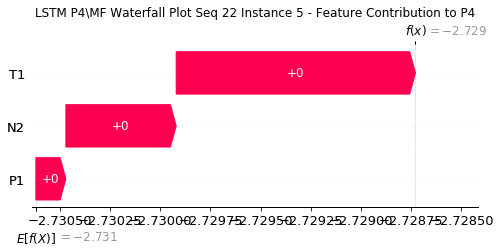

None

Contribution: [ 6.37463877e-04 -2.29938786e-03  1.94200237e-05]


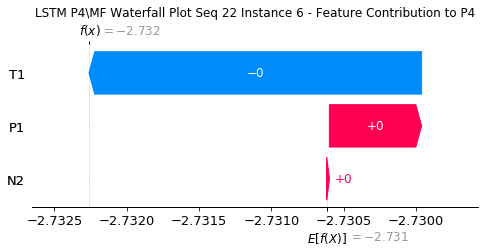

None

Contribution: [ 0.00022545 -0.0022997  -0.00175978]


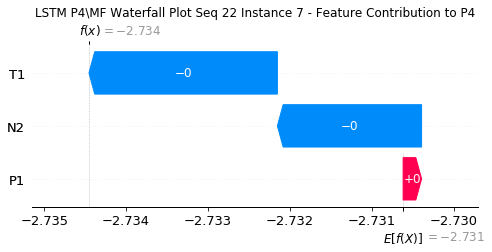

None

Contribution: [-0.00010309  0.01375026 -0.00189284]


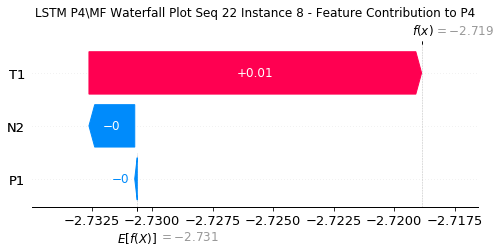

None

Contribution: [-0.00260309  0.01475113  0.00307081]


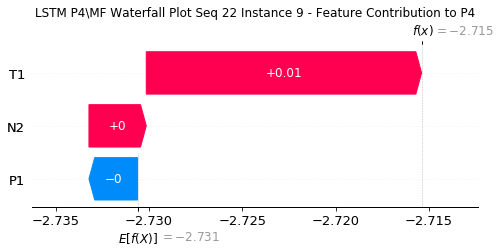

None

Contribution: [-0.00093538 -0.01553319  0.00411912]


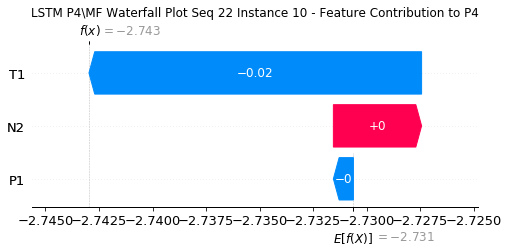

None

Contribution: [ 0.00075954 -0.02168455 -0.00277856]


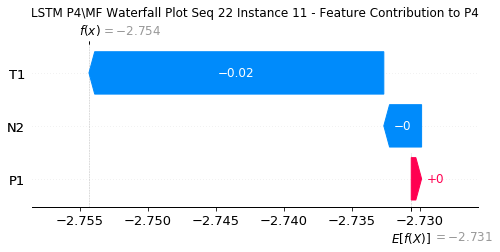

None

Contribution: [ 0.00047787  0.01637039 -0.00540756]


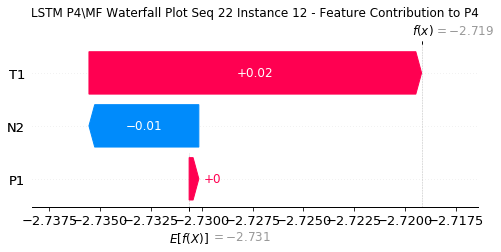

None

Contribution: [-0.00264944  0.02714868  0.00238404]


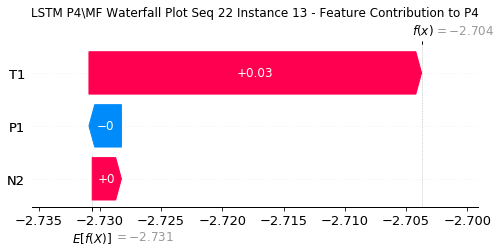

None

Contribution: [-0.00134751 -0.01118088  0.00727157]


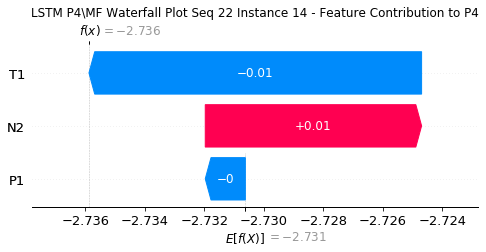

None

Contribution: [ 0.00040842 -0.02829512 -0.00269564]


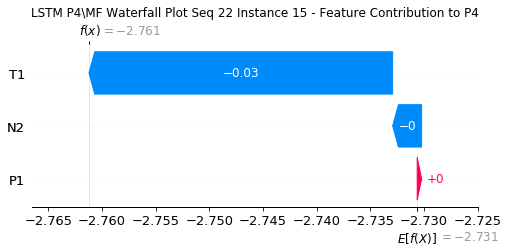

None

Contribution: [ 0.001309    0.01036577 -0.01049669]


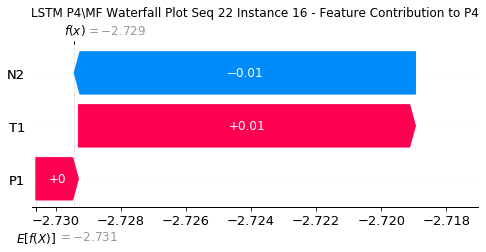

None

Contribution: [-0.00020853  0.03327715  0.00150125]


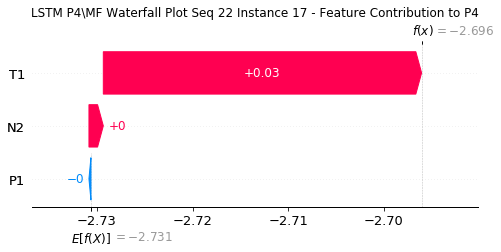

None

Contribution: [-0.00314269 -0.00345672  0.01218522]


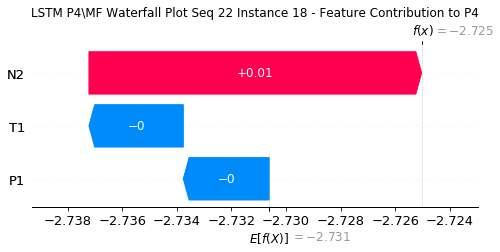

None

Contribution: [ 0.00077564 -0.0291973  -0.00171855]


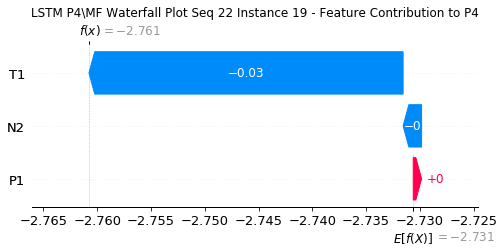

None

Contribution: [ 0.00103623  0.00886795 -0.02031339]


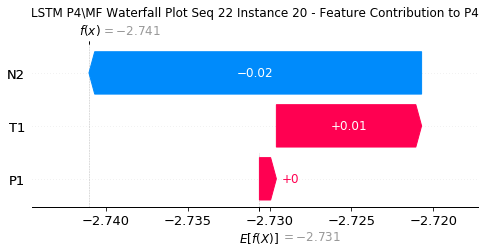

None

Contribution: [ 0.00048458  0.03613903 -0.00273636]


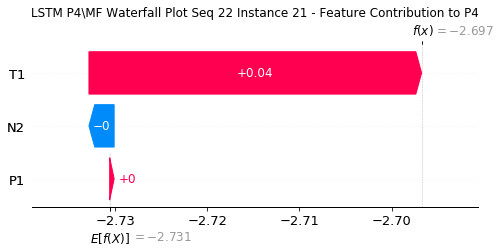

None

Contribution: [-0.00328913 -0.00564831  0.02250921]


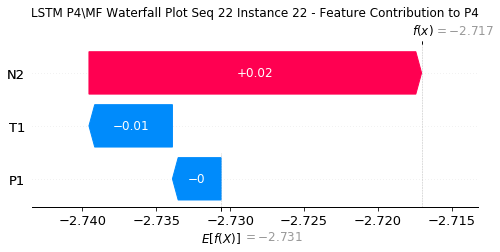

None

Contribution: [-0.00606951 -0.00133181 -0.00784513]


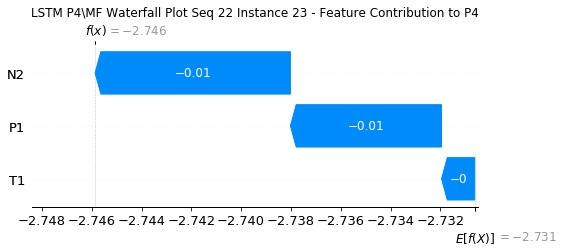

None

Contribution: [-0.00094089  0.02396998 -0.03568913]


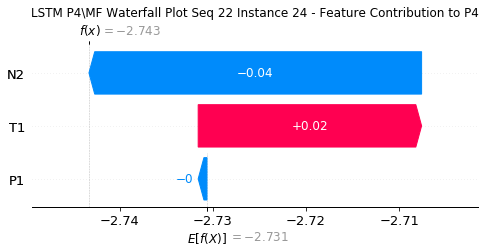

None

Contribution: [ 0.00013381 -0.00113334  0.00041861]


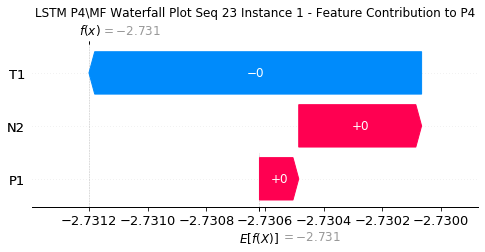

None

Contribution: [-2.13633025e-05 -2.44012042e-04  3.37779754e-04]


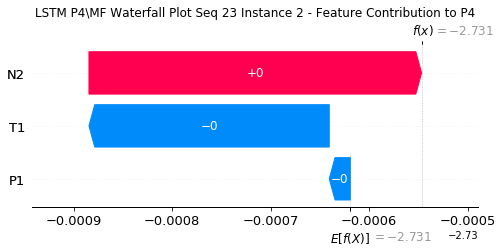

None

Contribution: [ 0.00011456 -0.00075492  0.00072264]


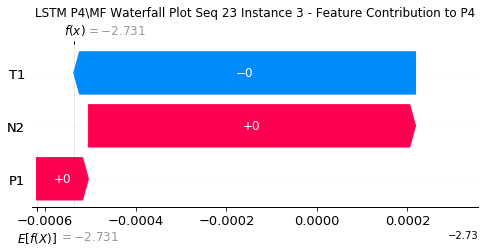

None

Contribution: [-8.25087452e-07  9.14837753e-05  7.30580345e-04]


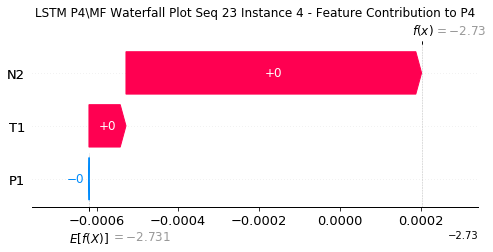

None

Contribution: [0.00022576 0.00116595 0.00078267]


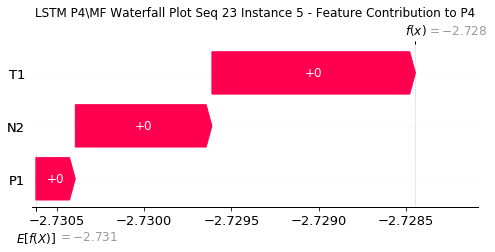

None

Contribution: [ 0.00106305 -0.00225191  0.00057636]


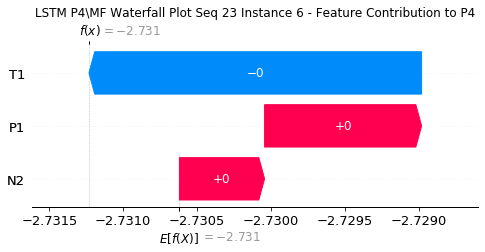

None

Contribution: [ 0.00043205 -0.00234874 -0.00316157]


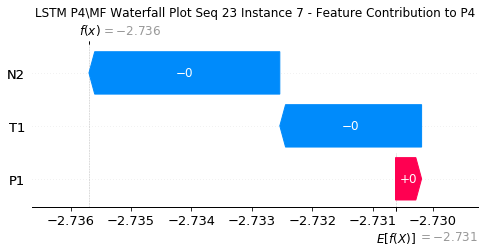

None

Contribution: [-0.00028295  0.01604326 -0.00323301]


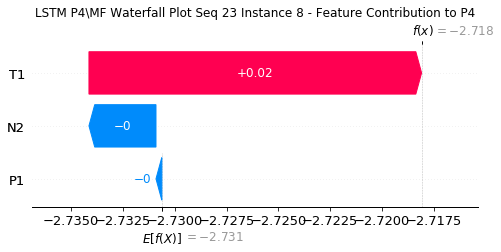

None

Contribution: [-0.00245768  0.01404651  0.0039238 ]


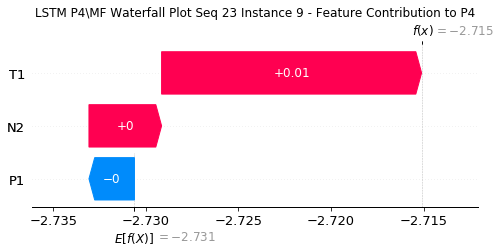

None

Contribution: [-0.00131171 -0.01567993  0.00696051]


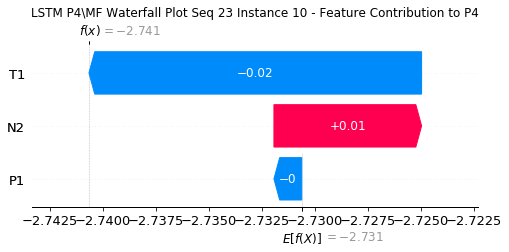

None

Contribution: [ 0.00166387 -0.02073703 -0.00327472]


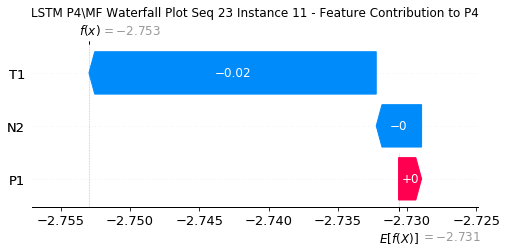

None

Contribution: [ 0.00084801  0.01599965 -0.0078875 ]


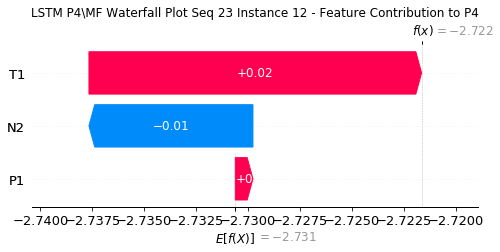

None

Contribution: [-0.00222973  0.0261425   0.00237197]


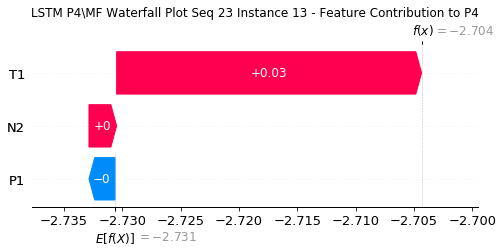

None

Contribution: [-0.00198935 -0.0110075   0.00943875]


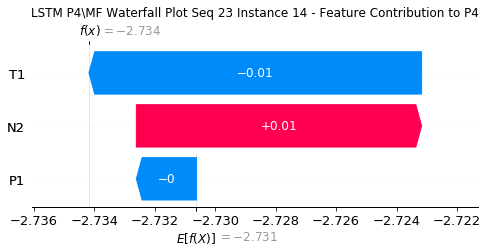

None

Contribution: [ 0.00141796 -0.02941818 -0.00270279]


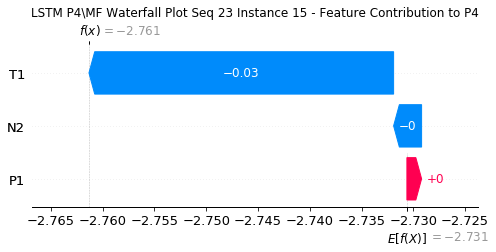

None

Contribution: [ 0.00178944  0.01068597 -0.01181666]


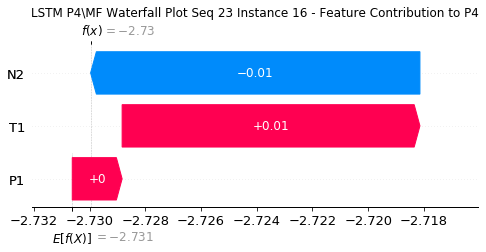

None

Contribution: [-0.0004794   0.03421486  0.00124006]


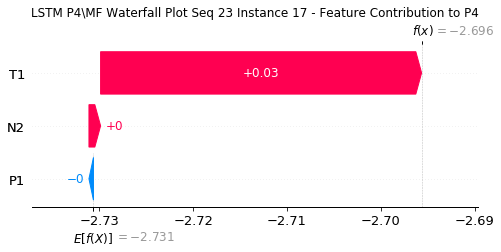

None

Contribution: [-0.00132699 -0.00388413  0.01245445]


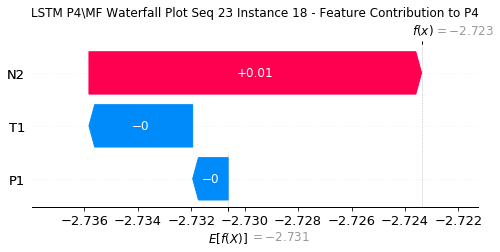

None

Contribution: [ 0.0009673  -0.03119422 -0.00150203]


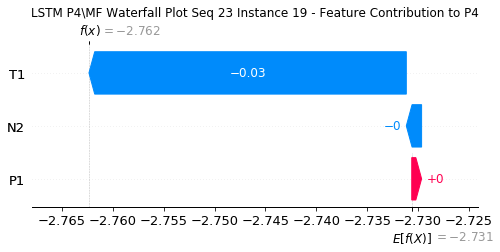

None

Contribution: [ 0.00148186  0.00938255 -0.02094638]


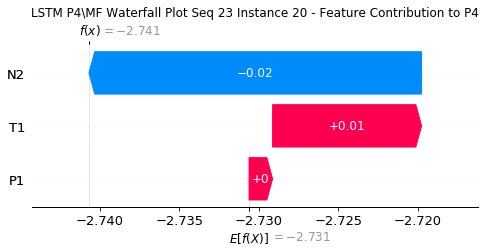

None

Contribution: [ 9.07723305e-05  3.71284119e-02 -3.06741261e-03]


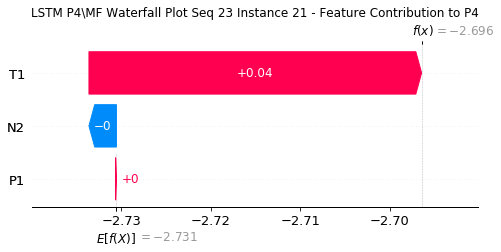

None

Contribution: [-0.00437217 -0.00580174  0.0229591 ]


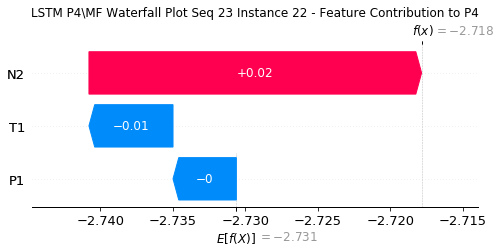

None

Contribution: [-0.01145167 -0.00162339 -0.00756896]


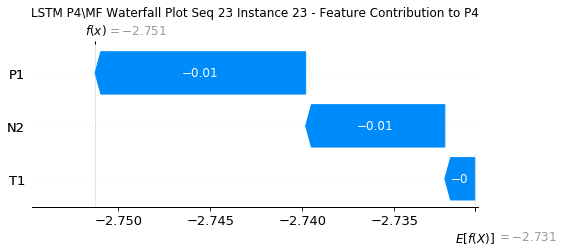

None

Contribution: [ 0.00058818  0.021252   -0.03922493]


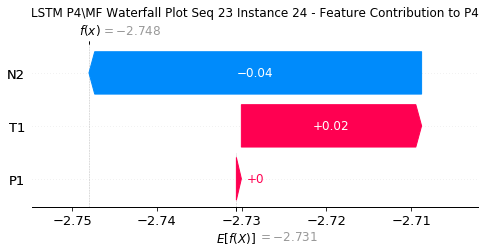

None

Contribution: [ 0.00016408 -0.0012588   0.00040535]


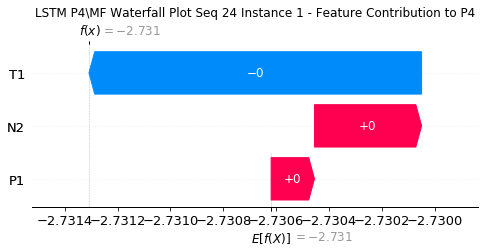

None

Contribution: [ 2.25560697e-05 -3.39951064e-04  3.14543792e-04]


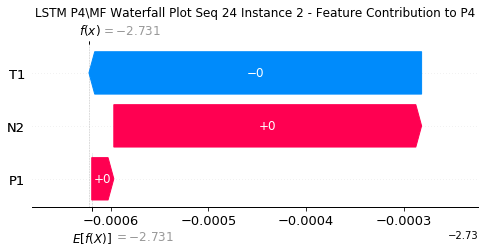

None

Contribution: [ 6.69744103e-05 -8.84032128e-04  6.76639392e-04]


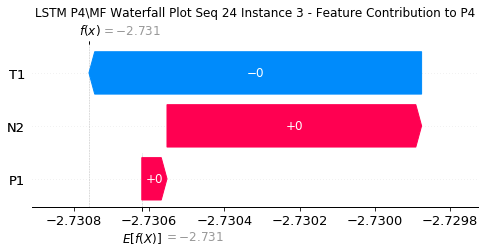

None

Contribution: [1.96129355e-05 6.17851680e-05 7.17547464e-04]


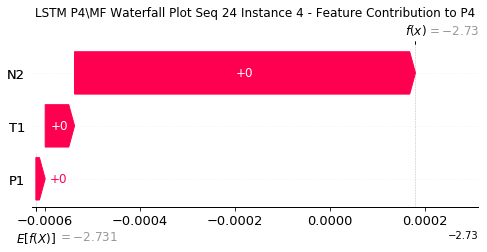

None

Contribution: [0.00027082 0.00121103 0.00079833]


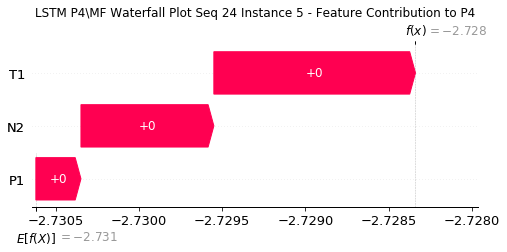

None

Contribution: [ 0.00081197 -0.00253102  0.00054472]


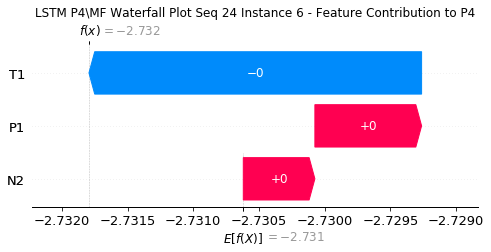

None

Contribution: [ 0.00046274 -0.00240767 -0.00317176]


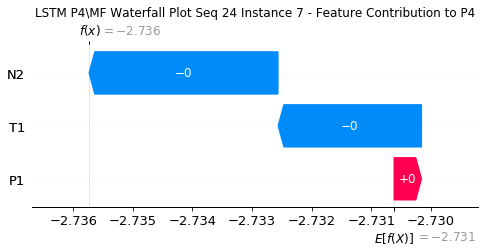

None

Contribution: [-0.00013748  0.01808262 -0.00324518]


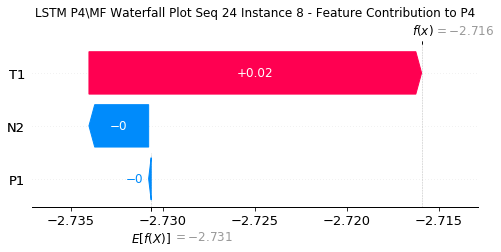

None

Contribution: [-0.00155057  0.01697132  0.00394752]


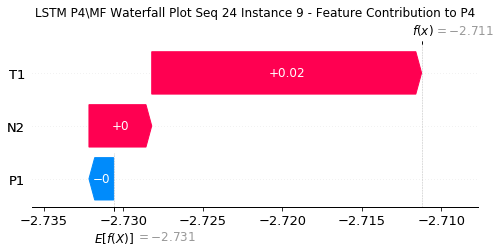

None

Contribution: [-0.0013004  -0.01821288  0.00618421]


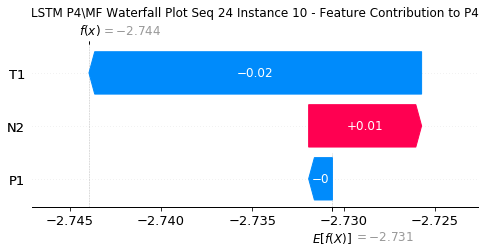

None

Contribution: [ 0.00207363 -0.02074131 -0.00335451]


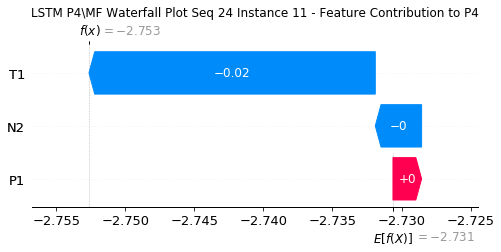

None

Contribution: [ 0.00099236  0.01590255 -0.0082947 ]


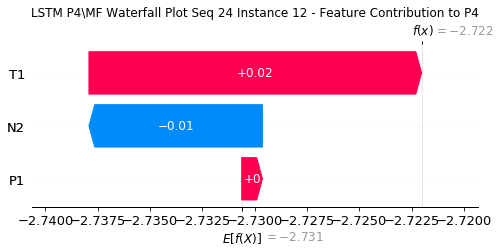

None

Contribution: [-0.00201976  0.02444546  0.0024121 ]


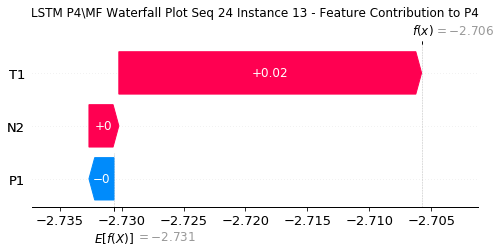

None

Contribution: [-0.00243955 -0.01054254  0.01012597]


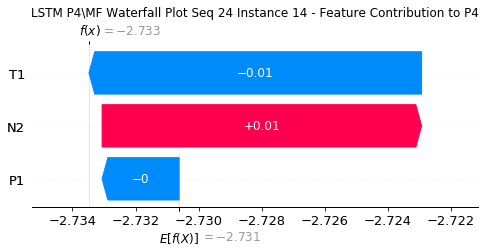

None

Contribution: [ 0.00139721 -0.02502331 -0.00210234]


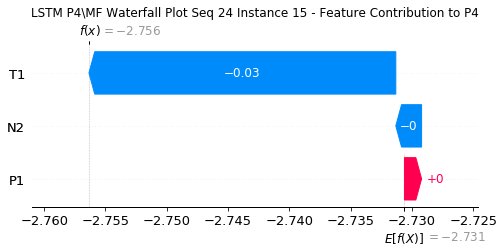

None

Contribution: [ 0.00216687  0.00956644 -0.01244474]


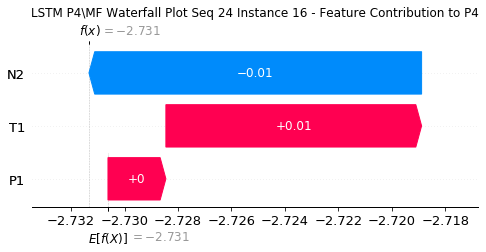

None

Contribution: [-0.00067368  0.02987434  0.00130903]


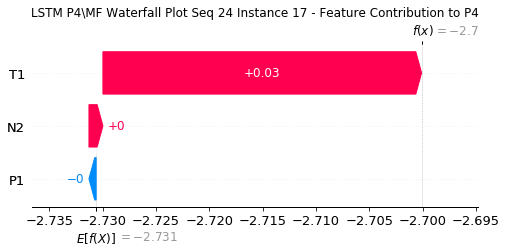

None

Contribution: [-0.00266968 -0.00293851  0.01223031]


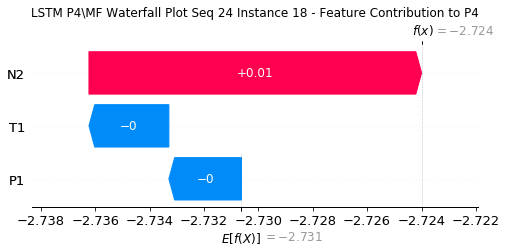

None

Contribution: [ 0.00116358 -0.02622945 -0.00142532]


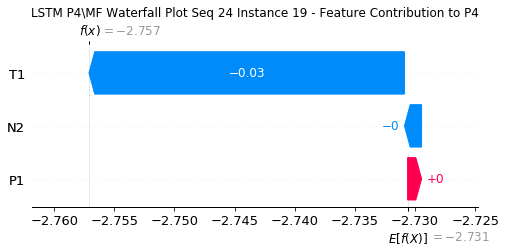

None

Contribution: [ 0.00166395  0.00725096 -0.0206053 ]


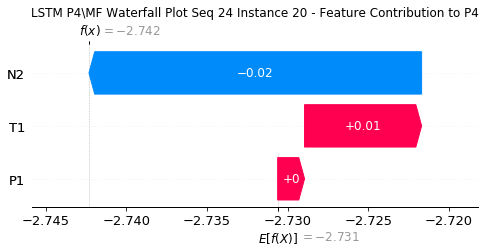

None

Contribution: [-0.00023189  0.02992767 -0.00310309]


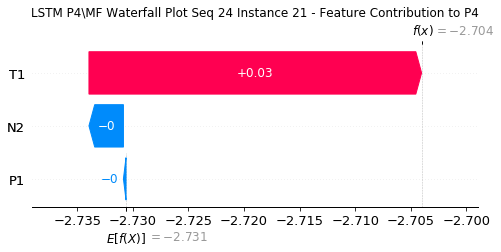

None

Contribution: [-0.00501042 -0.00517785  0.02224361]


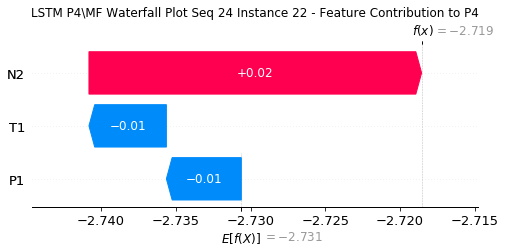

None

Contribution: [-0.01271726 -0.00256954 -0.00744538]


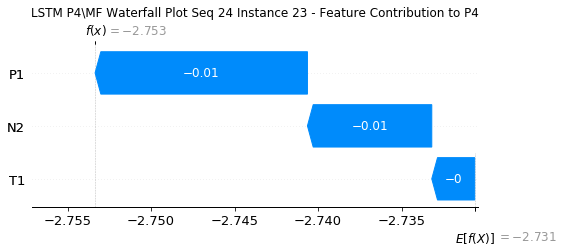

None

Contribution: [-0.00047393  0.01988821 -0.0365136 ]


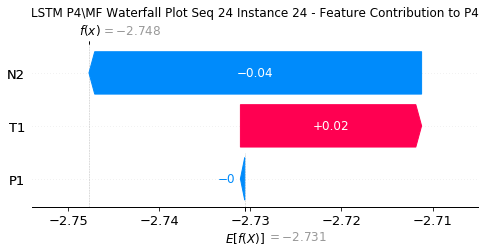

None

Contribution: [-2.56326903e-05 -1.07444470e-03  2.25575510e-04]


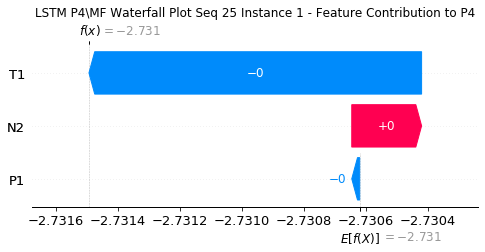

None

Contribution: [-2.86995785e-05 -2.67987972e-04  3.01951615e-04]


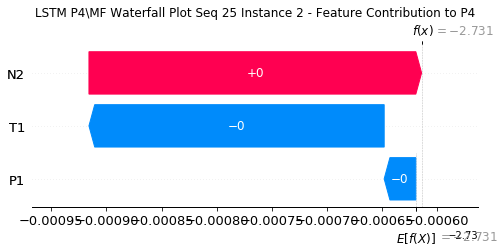

None

Contribution: [ 3.37219421e-05 -7.59181548e-04  7.16312786e-04]


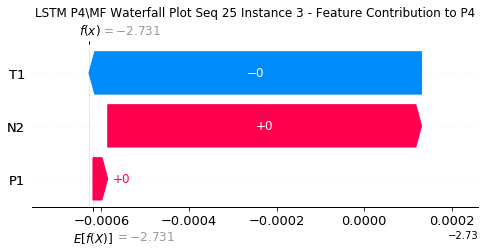

None

Contribution: [3.58536411e-05 7.15809544e-06 7.41076177e-04]


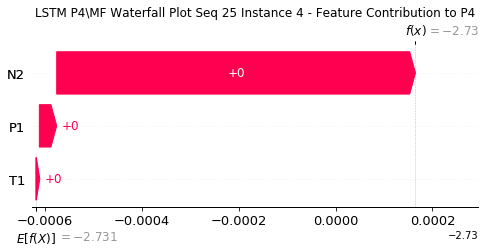

None

Contribution: [0.00029757 0.00116317 0.00082509]


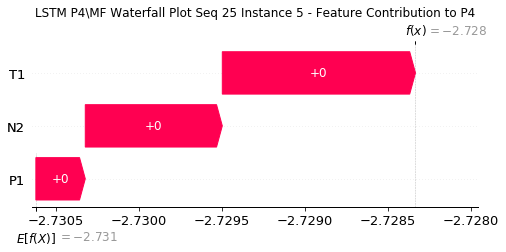

None

Contribution: [-0.00028696 -0.00236354  0.00032129]


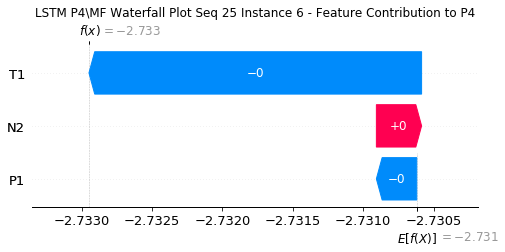

None

Contribution: [ 0.00048392 -0.00228266 -0.00343497]


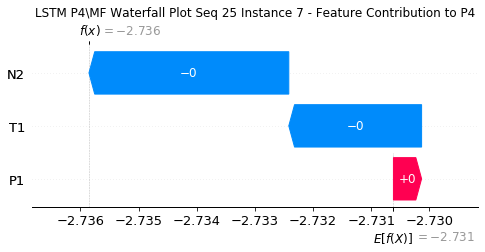

None

Contribution: [-1.38637020e-05  1.53443115e-02 -3.17566341e-03]


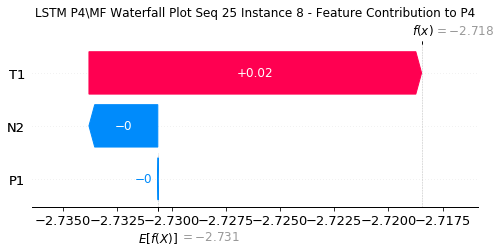

None

Contribution: [-0.00148789  0.0146023   0.00401001]


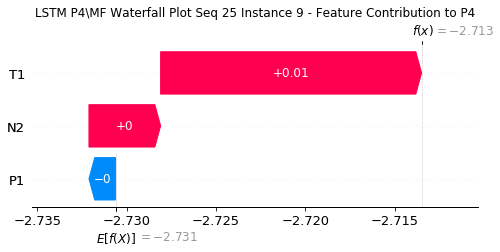

None

Contribution: [-0.00134873 -0.01542799  0.00622876]


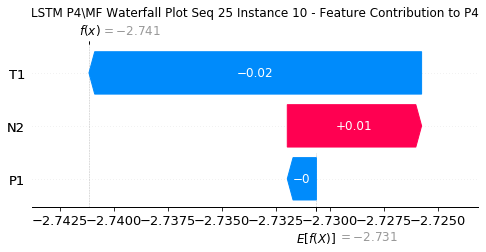

None

Contribution: [ 0.00094396 -0.02025161 -0.00319695]


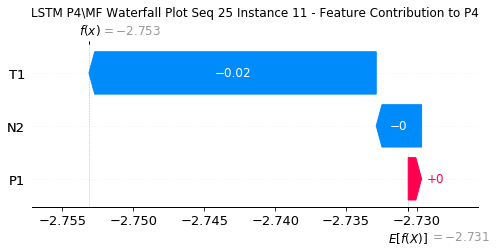

None

Contribution: [ 0.00042716  0.01527863 -0.00758729]


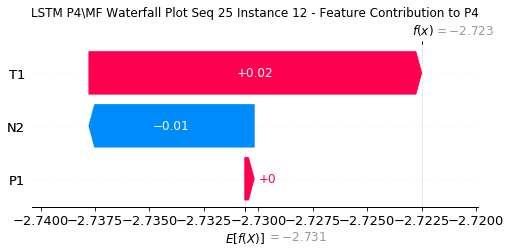

None

Contribution: [0.00022589 0.02544337 0.00242819]


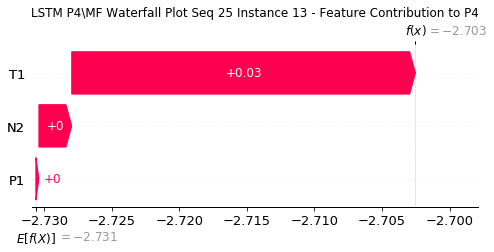

None

Contribution: [-0.00135526 -0.01023182  0.00911515]


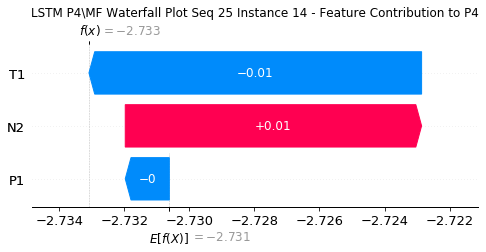

None

Contribution: [ 0.00214841 -0.02477135 -0.00232947]


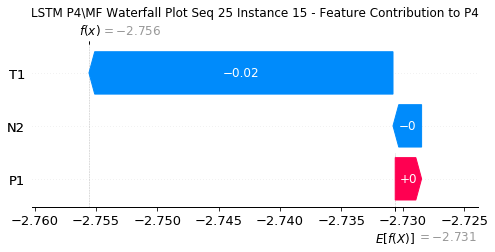

None

Contribution: [ 0.00073883  0.00930131 -0.01138899]


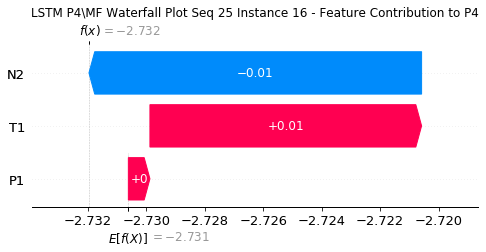

None

Contribution: [8.40796070e-05 2.85175937e-02 1.33115351e-03]


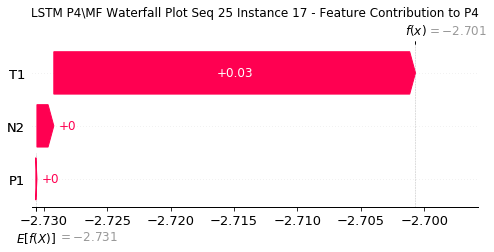

None

Contribution: [-0.00261084 -0.00264387  0.01489892]


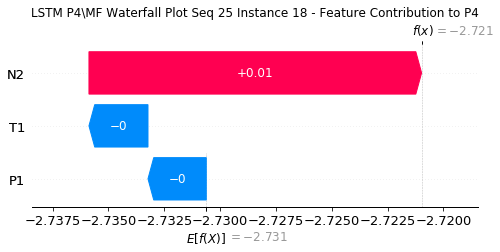

None

Contribution: [ 0.00080005 -0.02333884 -0.00112054]


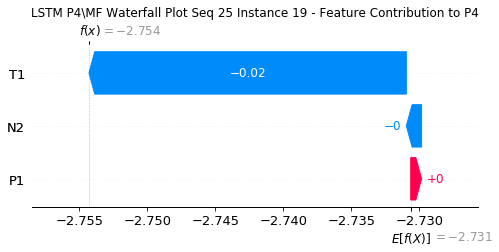

None

Contribution: [ 0.0013201   0.00604366 -0.02202094]


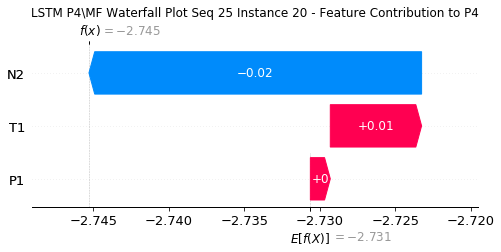

None

Contribution: [-6.98748494e-06  2.55587817e-02 -3.77926955e-03]


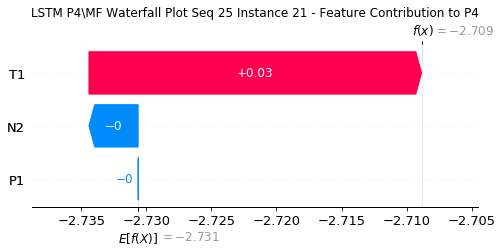

None

Contribution: [-0.00440689 -0.00504892  0.02359609]


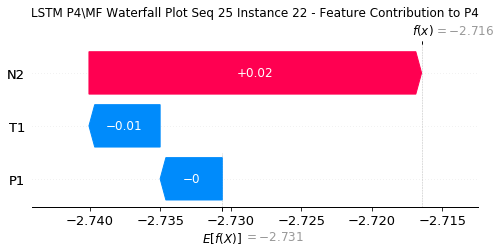

None

Contribution: [-0.01131069 -0.00330821 -0.00725304]


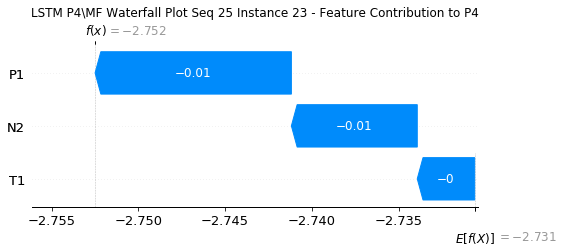

None

Contribution: [ 0.00019062  0.01229516 -0.03987289]


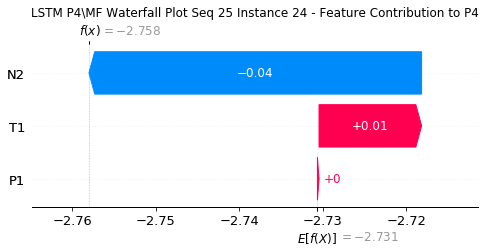

None

Contribution: [ 0.0001668  -0.00083846  0.00043862]


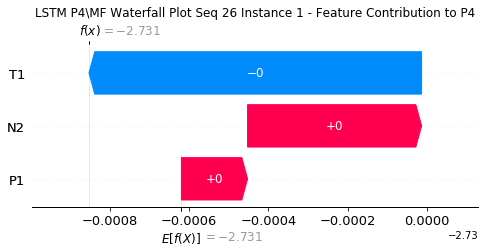

None

Contribution: [ 2.67169377e-06 -1.46888390e-04  3.91889671e-04]


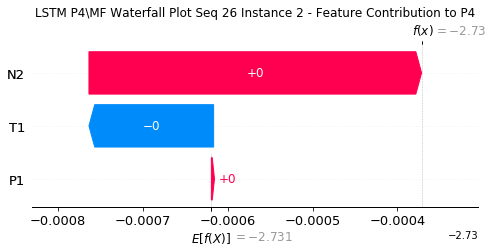

None

Contribution: [ 7.34497893e-05 -5.63911311e-04  7.74239121e-04]


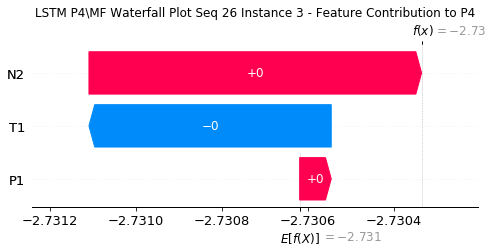

None

Contribution: [-5.98428055e-05  5.16647850e-05  7.44145483e-04]


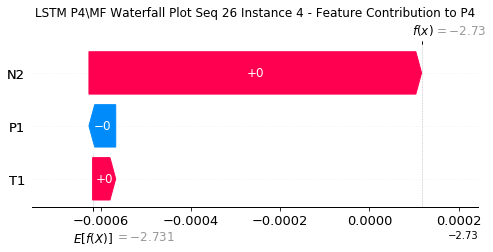

None

Contribution: [5.96004971e-05 1.14745832e-03 7.85717890e-04]


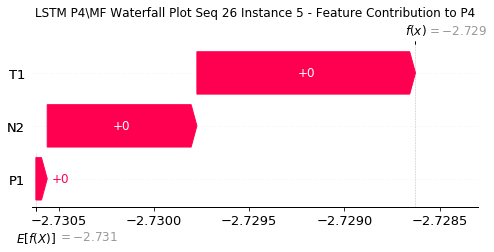

None

Contribution: [ 0.00050754 -0.00196361  0.00060588]


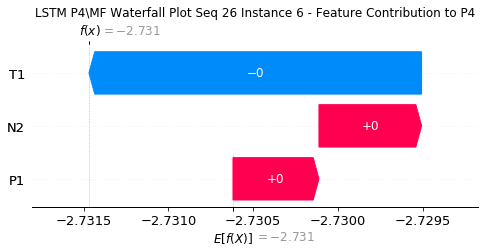

None

Contribution: [ 6.56827331e-05 -2.25304118e-03 -3.21660193e-03]


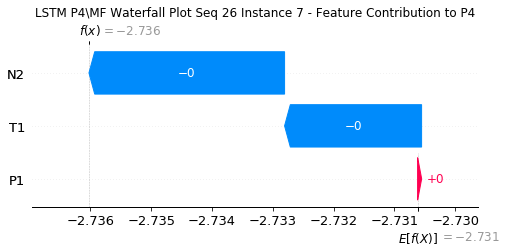

None

Contribution: [-4.77005991e-05  1.44760199e-02 -3.58262701e-03]


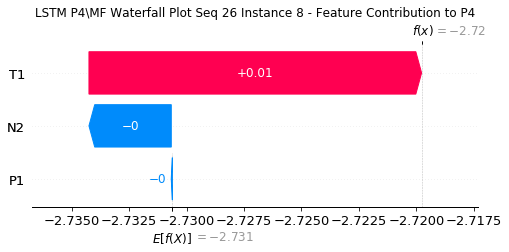

None

Contribution: [-0.004633    0.01411746  0.00498788]


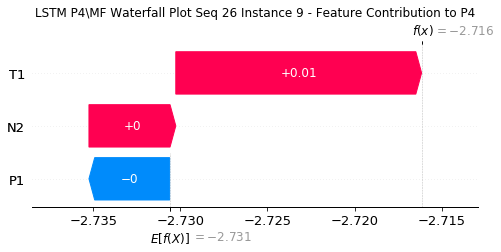

None

Contribution: [-0.00152216 -0.01429353  0.00718866]


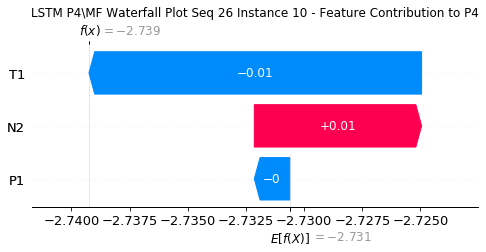

None

Contribution: [ 0.00093515 -0.01902691 -0.00328218]


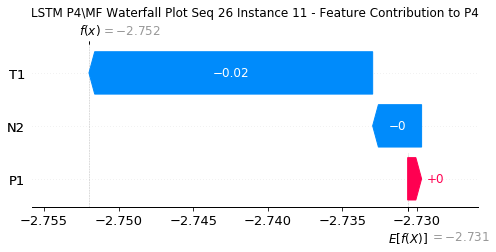

None

Contribution: [ 0.00036632  0.01447595 -0.00789338]


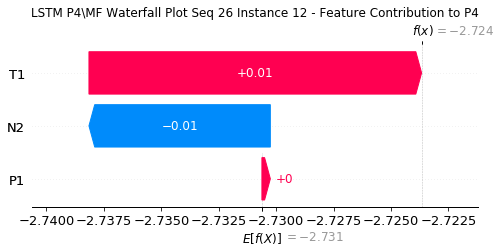

None

Contribution: [-0.00223054  0.02059244  0.00240991]


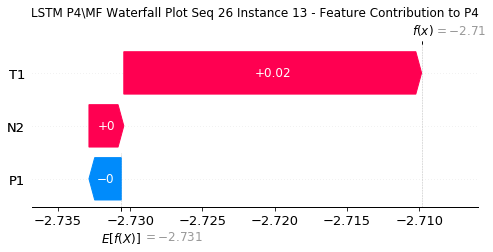

None

Contribution: [-0.00153648 -0.00969879  0.00961528]


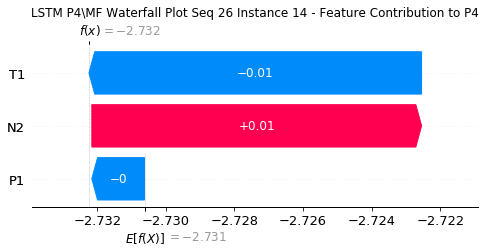

None

Contribution: [ 0.0012841  -0.02314839 -0.00247345]


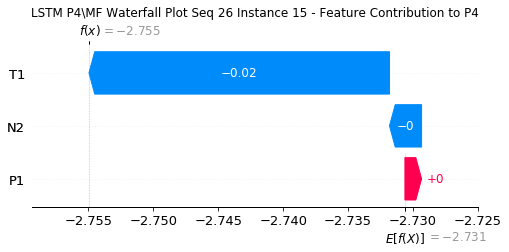

None

Contribution: [ 0.00130135  0.00908021 -0.01207866]


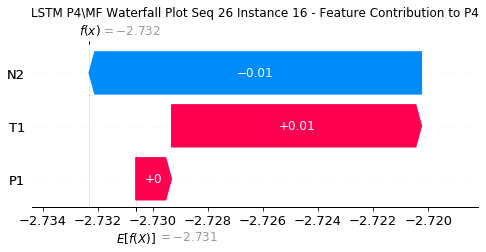

None

Contribution: [-0.00024957  0.02941946  0.00127068]


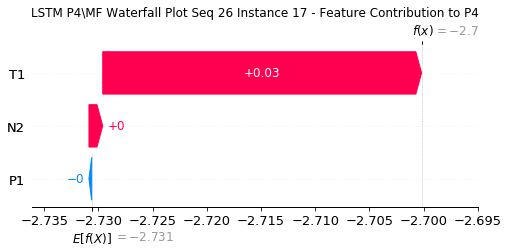

None

Contribution: [-0.00168966 -0.00308345  0.01278403]


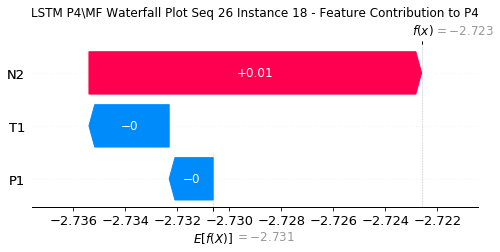

None

Contribution: [ 0.00073588 -0.02585778 -0.00145295]


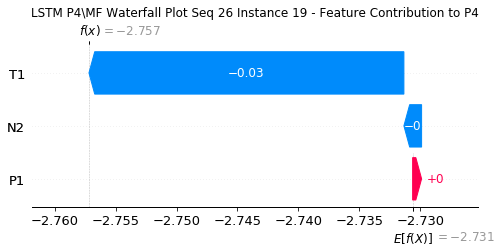

None

Contribution: [ 0.00120545  0.00725112 -0.02083069]


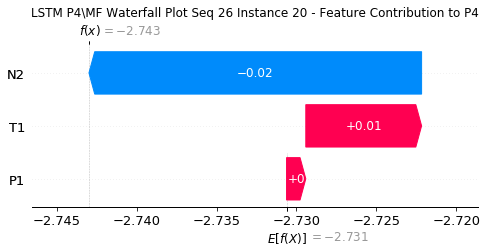

None

Contribution: [ 0.00014667  0.03026651 -0.00311299]


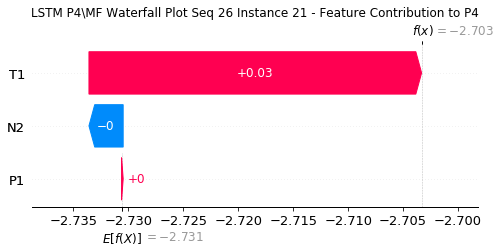

None

Contribution: [-0.00471667 -0.00544319  0.02265846]


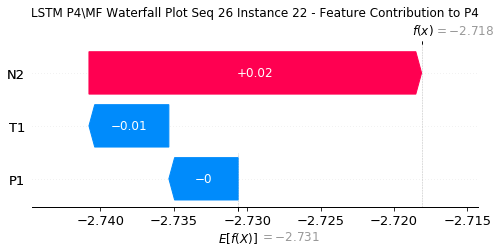

None

Contribution: [-0.01278003 -0.00288392 -0.00737244]


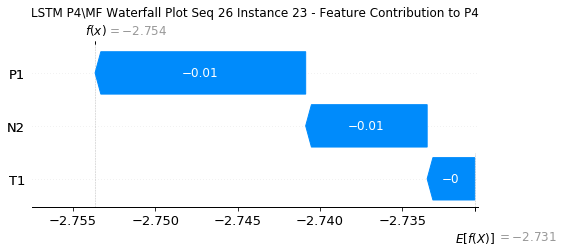

None

Contribution: [ 0.00020577  0.0148109  -0.03936081]


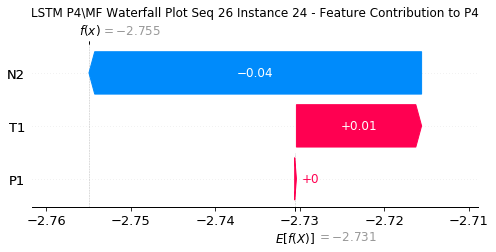

None

Contribution: [ 2.81710204e-05 -1.35844046e-03  3.16073786e-04]


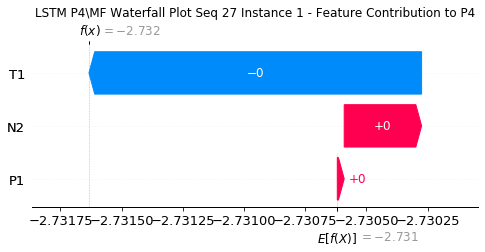

None

Contribution: [-4.84416594e-05 -3.73169137e-04  2.75486741e-04]


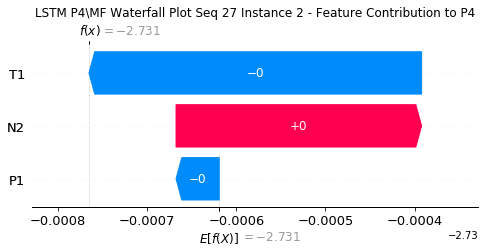

None

Contribution: [ 2.20913236e-05 -7.46880037e-04  6.80914119e-04]


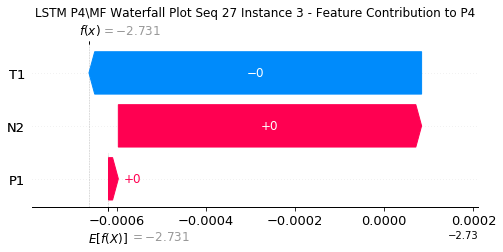

None

Contribution: [ 1.05574666e-05 -2.91054816e-05  6.97021852e-04]


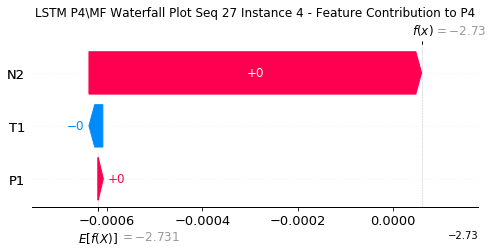

None

Contribution: [0.0002211  0.00107339 0.00076409]


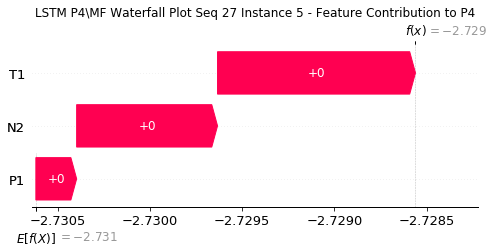

None

Contribution: [ 0.0003448  -0.00217995  0.00042087]


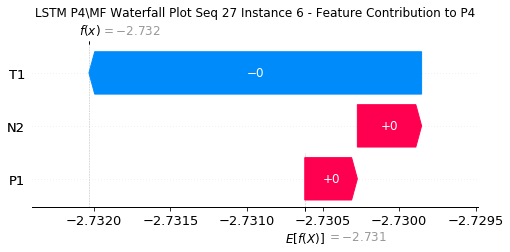

None

Contribution: [ 0.00022015 -0.0023025  -0.0028767 ]


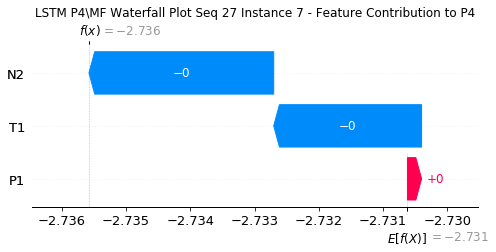

None

Contribution: [ 0.00017365  0.01546475 -0.00231671]


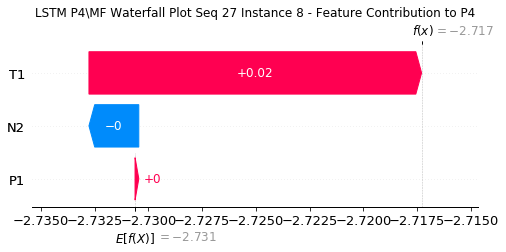

None

Contribution: [0.00083108 0.01864325 0.00295872]


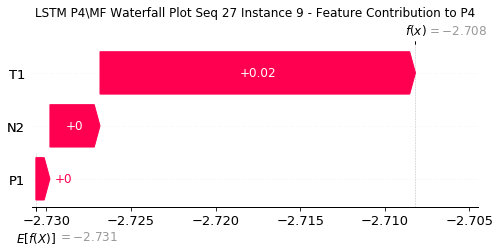

None

Contribution: [-0.00067859 -0.01572368  0.00474918]


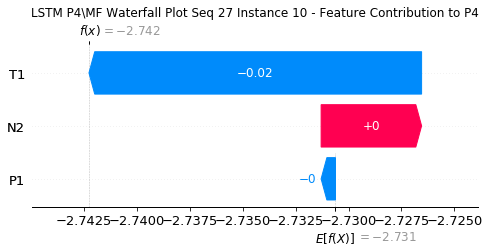

None

Contribution: [ 0.00146215 -0.01832557 -0.00316331]


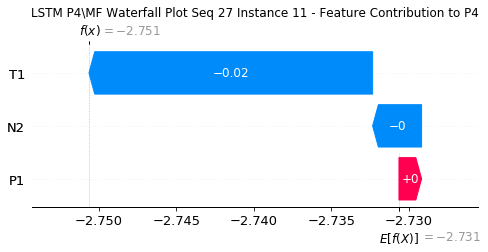

None

Contribution: [ 0.00070682  0.01398608 -0.0070876 ]


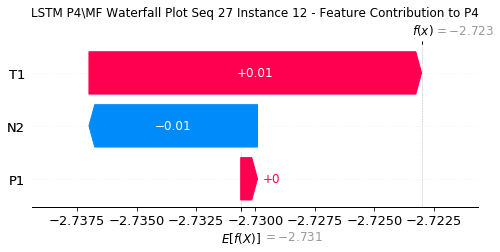

None

Contribution: [-0.00064387  0.02208835  0.0024147 ]


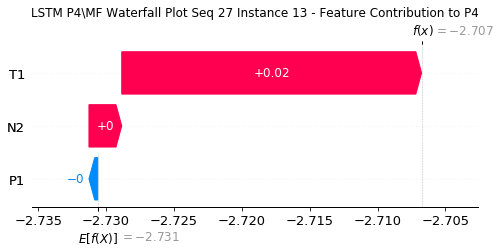

None

Contribution: [-0.00149029 -0.00930194  0.00831486]


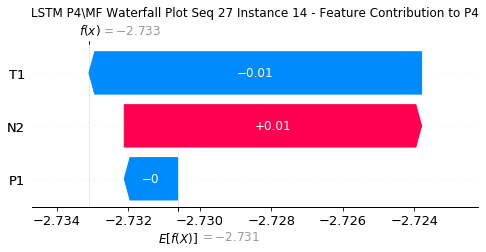

None

Contribution: [ 0.00098038 -0.02348487 -0.00273942]


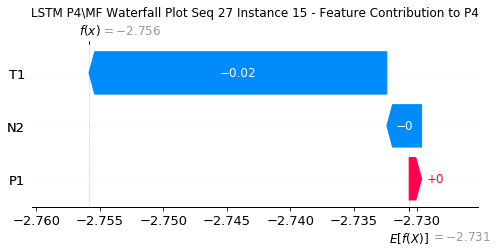

None

Contribution: [ 0.00096242  0.00857655 -0.01050123]


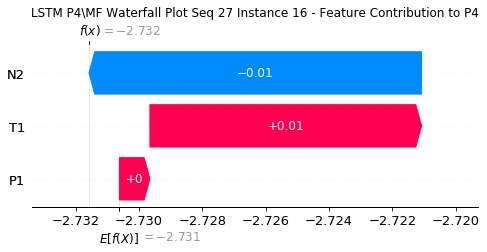

None

Contribution: [0.00031507 0.02771875 0.0017201 ]


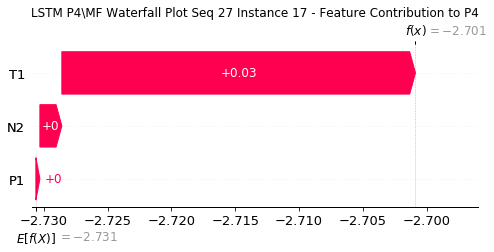

None

Contribution: [-0.00221218 -0.00257149  0.01439611]


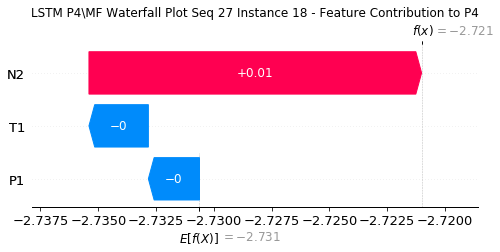

None

Contribution: [ 1.91784941e-06 -2.43869729e-02 -2.16934513e-03]


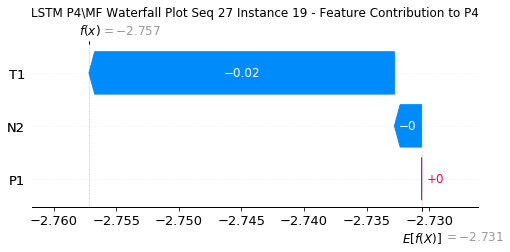

None

Contribution: [-0.00016664  0.0067025  -0.01853594]


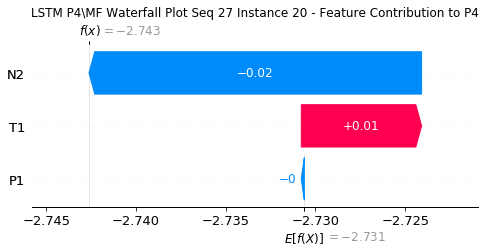

None

Contribution: [ 0.00101693  0.02815513 -0.00183528]


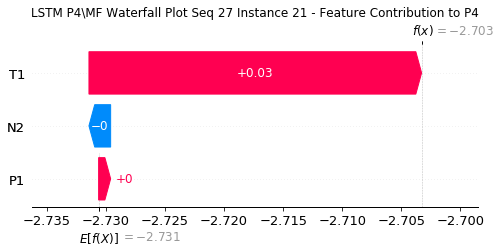

None

Contribution: [-0.00166468 -0.00520984  0.01987277]


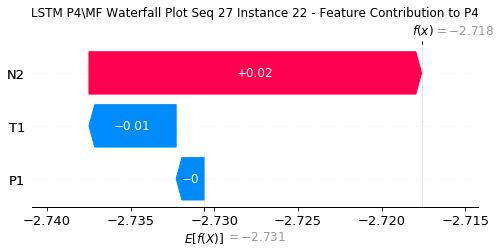

None

Contribution: [-0.00284357 -0.002904   -0.0080651 ]


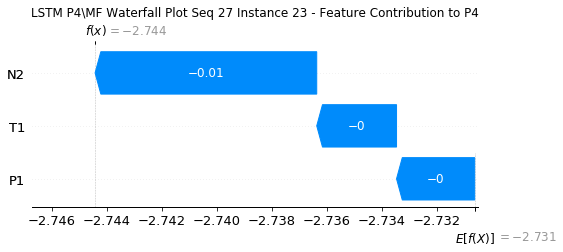

None

Contribution: [ 0.00022744  0.01431268 -0.03710433]


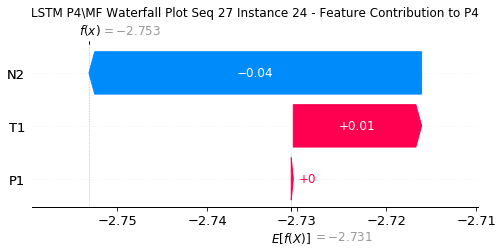

None

Contribution: [ 0.00028588 -0.00092325  0.00040651]


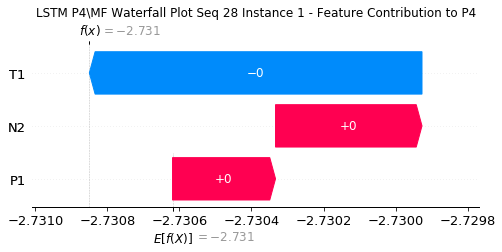

None

Contribution: [ 5.06596853e-05 -1.43612953e-04  3.33017264e-04]


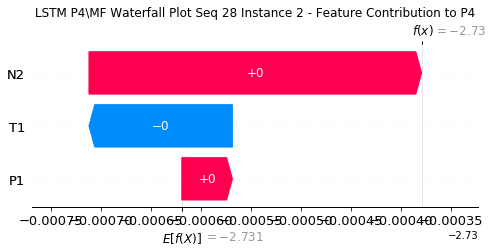

None

Contribution: [ 0.00012875 -0.000497    0.00072404]


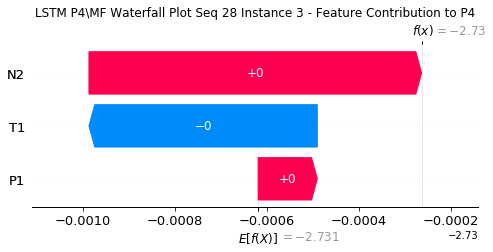

None

Contribution: [2.92119968e-05 2.28509359e-05 7.24371885e-04]


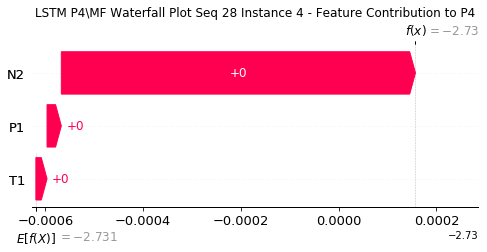

None

Contribution: [0.0002573  0.00090591 0.00078525]


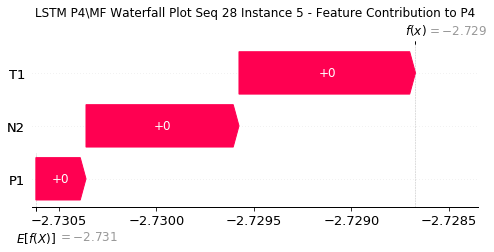

None

Contribution: [ 0.00135052 -0.00138794  0.00079229]


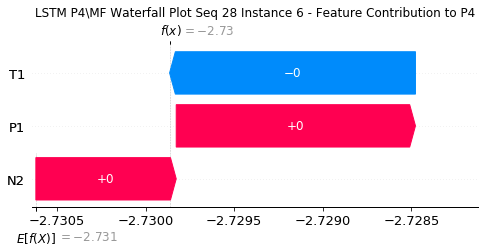

None

Contribution: [ 0.00069754 -0.00220184 -0.00318972]


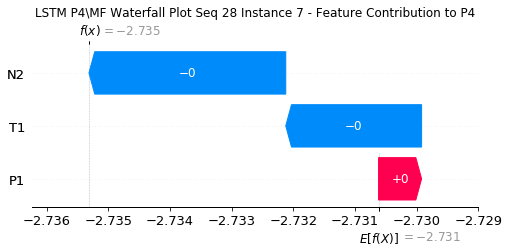

None

Contribution: [-0.00022002  0.01389289 -0.00276109]


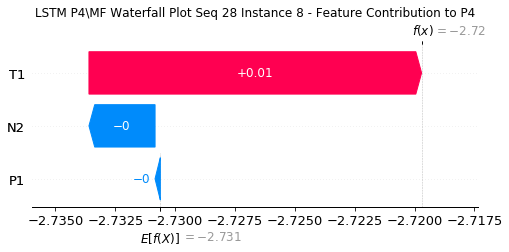

None

Contribution: [-0.00253709  0.01439687  0.00387529]


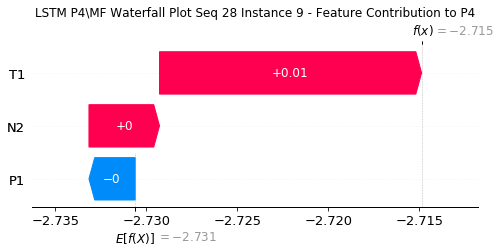

None

Contribution: [-0.00103254 -0.01531772  0.00535767]


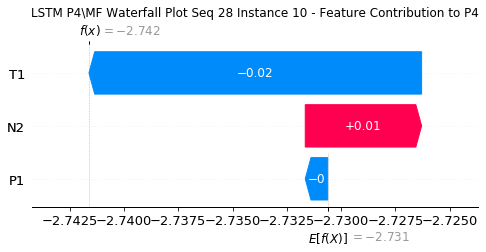

None

Contribution: [ 0.00271582 -0.01752814 -0.00317319]


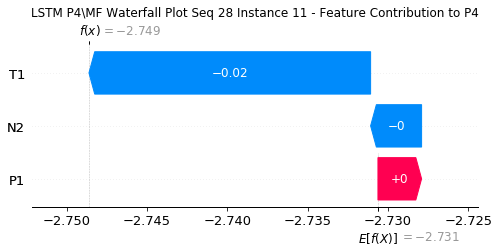

None

Contribution: [ 0.00170813  0.01393702 -0.00834506]


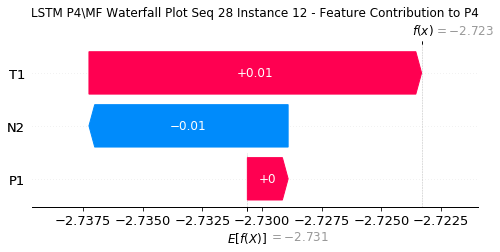

None

Contribution: [0.00042227 0.02367614 0.00220026]


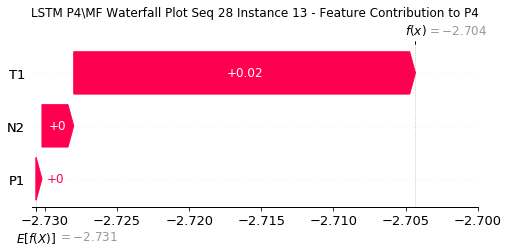

None

Contribution: [-0.00427437 -0.01129156  0.0107118 ]


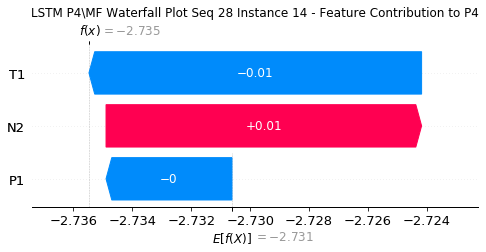

None

Contribution: [ 0.00112474 -0.03235854 -0.00233539]


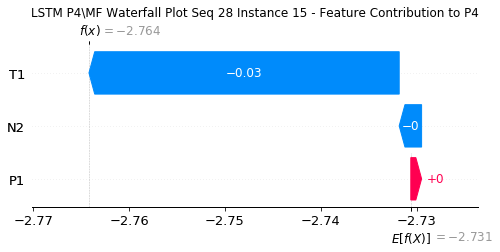

None

Contribution: [ 0.00538046  0.01327882 -0.01319283]


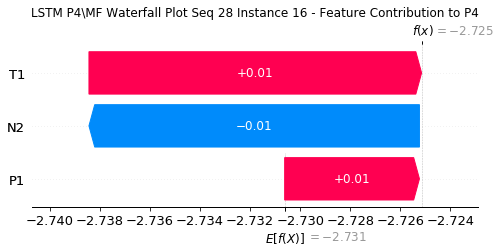

None

Contribution: [-0.00358493  0.04843177  0.00087876]


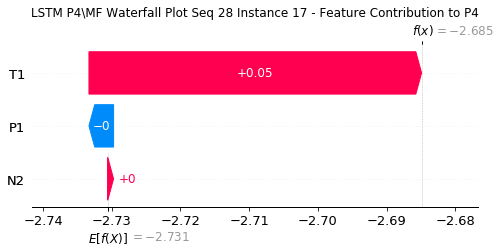

None

Contribution: [ 0.00127052 -0.00338685  0.00982822]


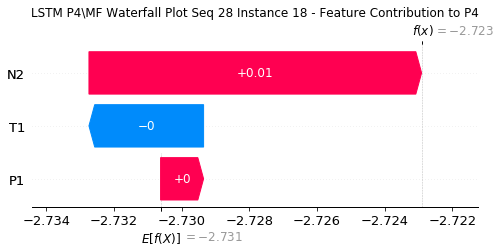

None

Contribution: [ 4.85690876e-03 -5.32076618e-02 -6.34430337e-05]


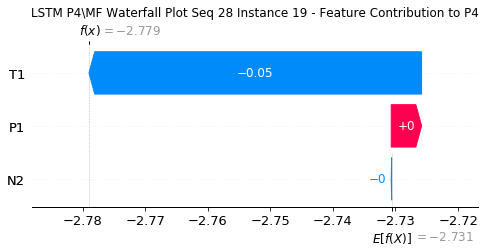

None

Contribution: [ 0.00776181  0.01997284 -0.02395679]


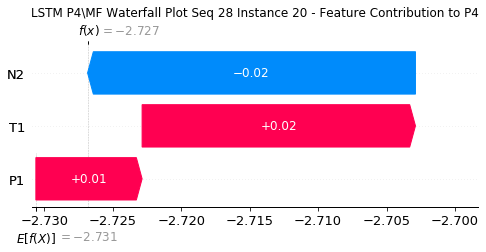

None

Contribution: [-0.0037193   0.07639553 -0.00532583]


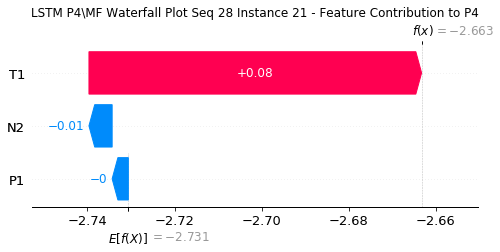

None

Contribution: [-0.01479721 -0.00829104  0.0263446 ]


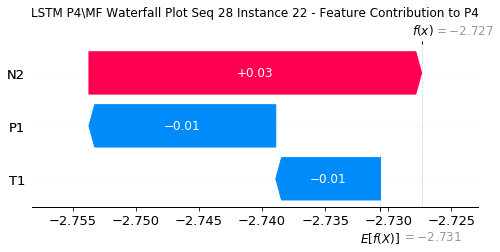

None

Contribution: [-0.04063034  0.00581946 -0.00675765]


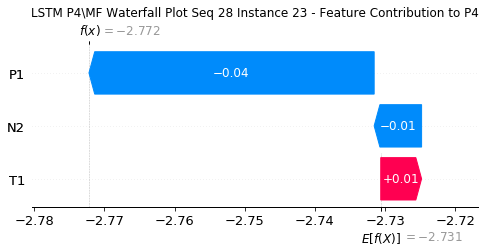

None

Contribution: [ 0.00320346  0.05314414 -0.04632801]


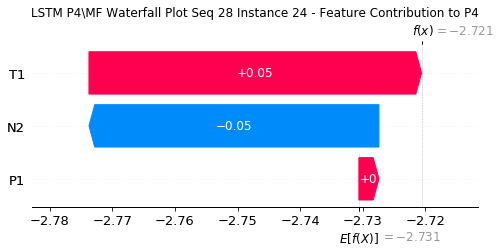

None

Contribution: [ 0.00057458 -0.00235528  0.00041469]


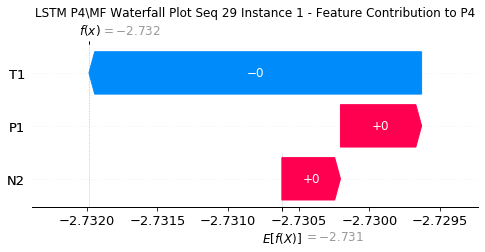

None

Contribution: [ 0.00045827 -0.00087913  0.00038907]


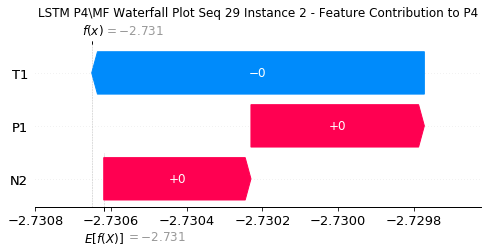

None

Contribution: [ 0.00080734 -0.00153333  0.00069236]


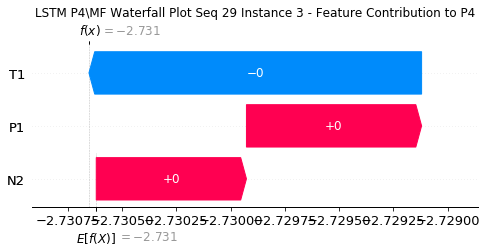

None

Contribution: [0.00043225 0.00020294 0.00066071]


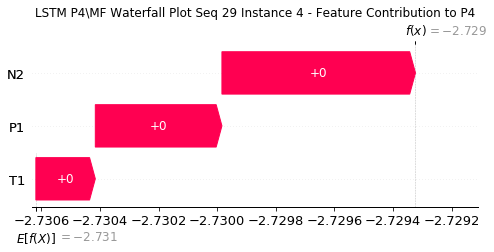

None

Contribution: [0.00166758 0.00134417 0.00094979]


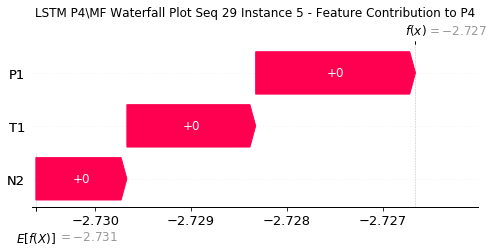

None

Contribution: [ 0.00145041 -0.00365209  0.0004716 ]


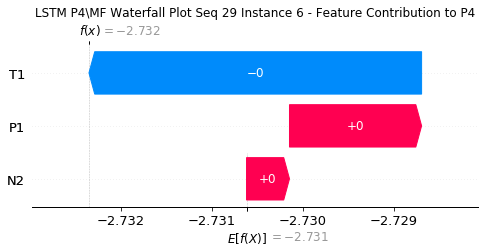

None

Contribution: [ 0.0031362 -0.001676  -0.0040757]


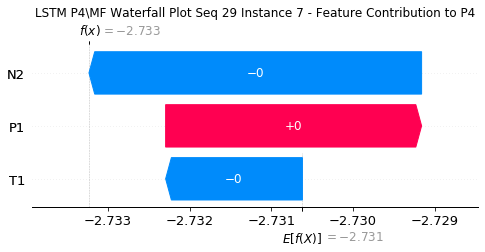

None

Contribution: [-0.00229046  0.03036463 -0.00419694]


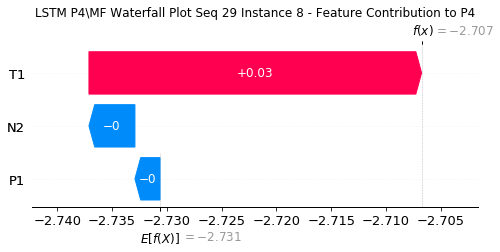

None

Contribution: [-0.01438656  0.02704465  0.00610516]


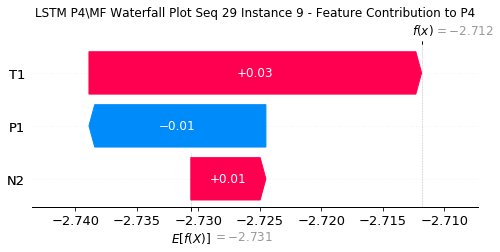

None

Contribution: [-0.00355058 -0.03154168  0.00950806]


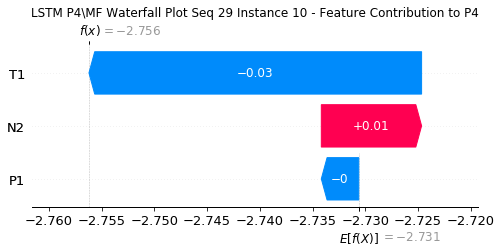

None

Contribution: [ 0.0105516  -0.03641007 -0.0038216 ]


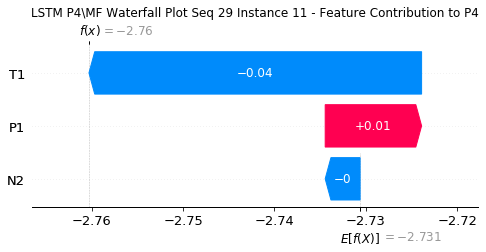

None

Contribution: [ 0.00416384  0.02974641 -0.01015715]


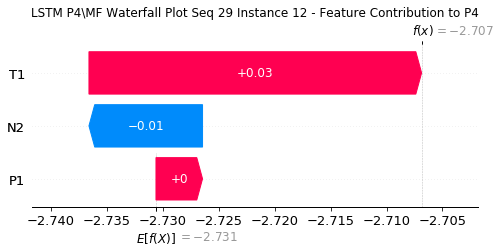

None

Contribution: [-0.01098117  0.05110727  0.00259236]


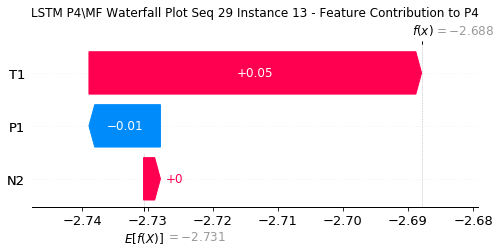

None

Contribution: [-0.0068252  -0.02016416  0.01196543]


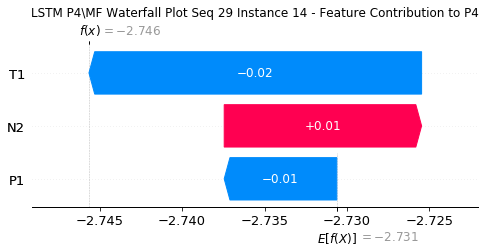

None

Contribution: [ 0.00345321 -0.03514667 -0.00256188]


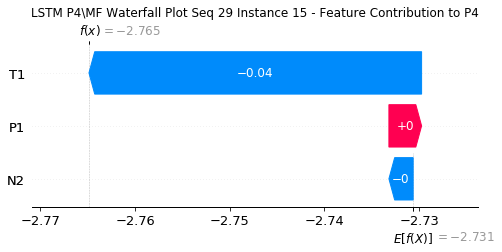

None

Contribution: [ 0.00567125  0.01766697 -0.01338668]


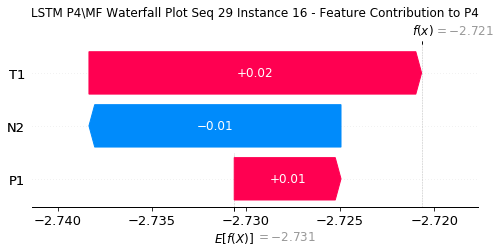

None

Contribution: [-0.00331001  0.04773606  0.00104486]


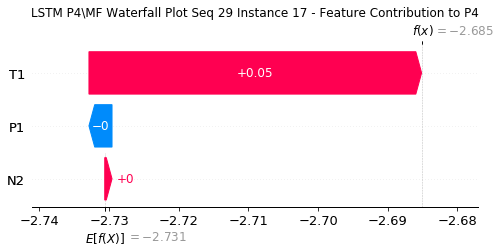

None

Contribution: [ 0.00226667 -0.00404792  0.01032737]


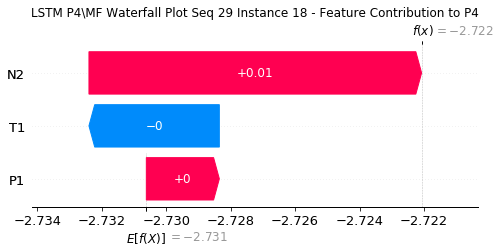

None

Contribution: [ 0.0004929  -0.03512766 -0.00137128]


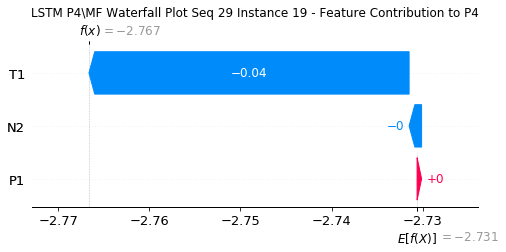

None

Contribution: [ 0.00048085  0.01088965 -0.02098975]


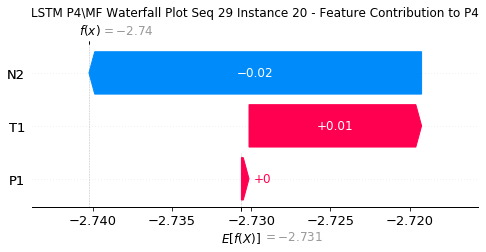

None

Contribution: [ 0.00058477  0.04063582 -0.00337354]


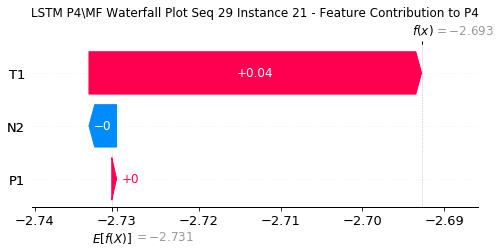

None

Contribution: [-0.00374837 -0.00530156  0.02326172]


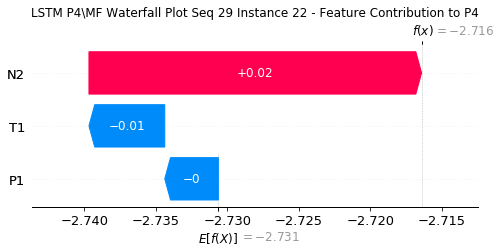

None

Contribution: [-0.00353954 -0.0006374  -0.00783784]


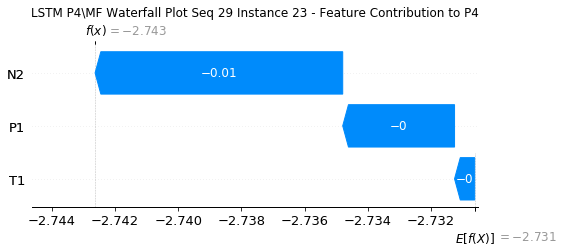

None

Contribution: [-0.00166745  0.03081949 -0.03578876]


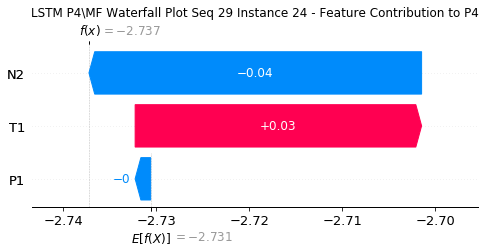

None

Contribution: [ 6.09291200e-05 -1.21596064e-03  4.61996315e-04]


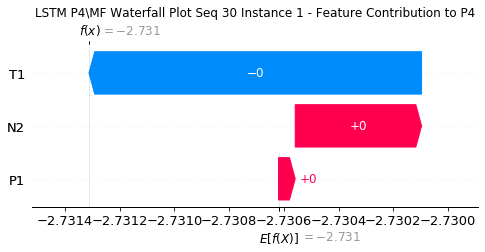

None

Contribution: [ 1.78323920e-05 -3.84037479e-04  3.60928220e-04]


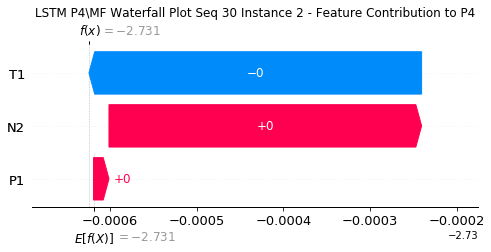

None

Contribution: [ 0.00014195 -0.00065204  0.00071167]


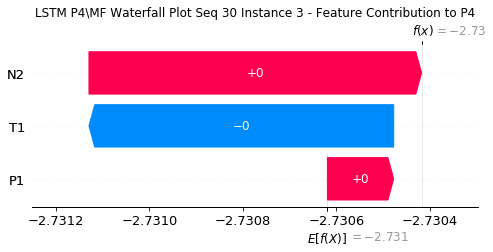

None

Contribution: [-2.59884772e-05 -3.66955728e-05  7.04972188e-04]


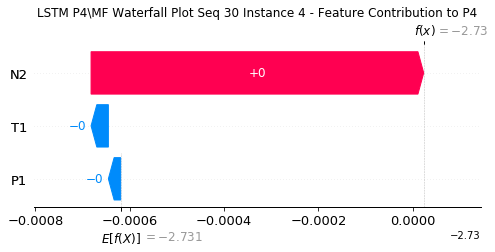

None

Contribution: [9.37446952e-05 1.03577763e-03 7.61372689e-04]


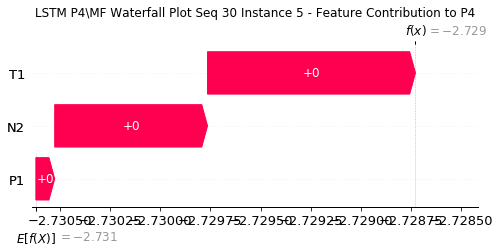

None

Contribution: [ 0.00064137 -0.00217579  0.0005545 ]


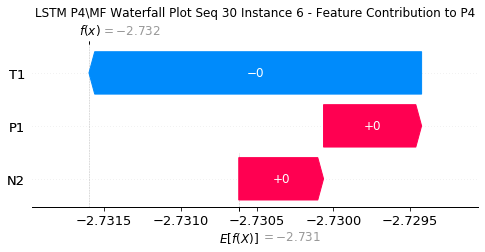

None

Contribution: [ 7.81942015e-05 -2.28697407e-03 -3.06417466e-03]


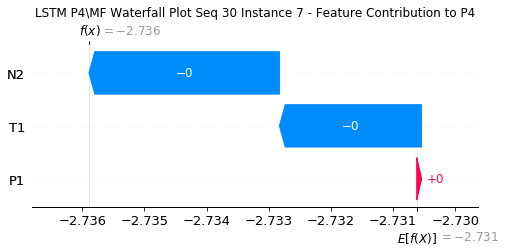

None

Contribution: [ 0.00020102  0.01608469 -0.00248495]


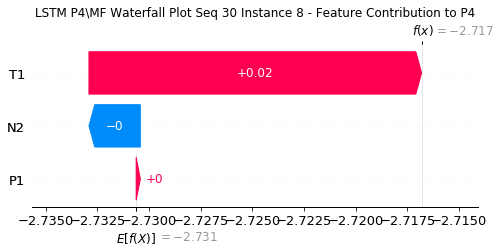

None

Contribution: [0.00041111 0.01703458 0.00372879]


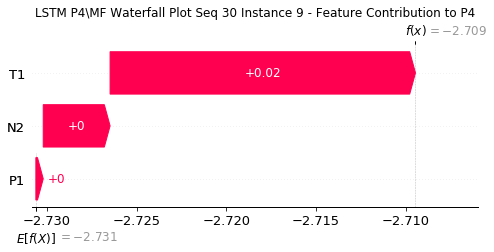

None

Contribution: [-0.00086601 -0.01750986  0.00506687]


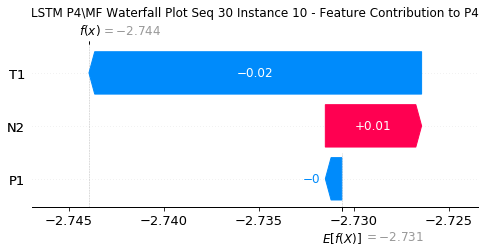

None

Contribution: [ 0.00039836 -0.02097677 -0.00311309]


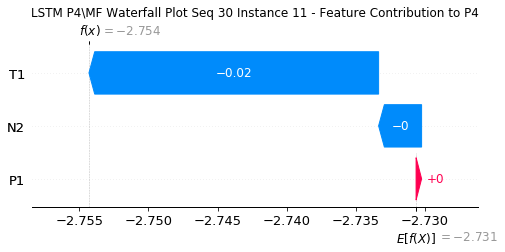

None

Contribution: [ 0.00017805  0.01547867 -0.00713291]


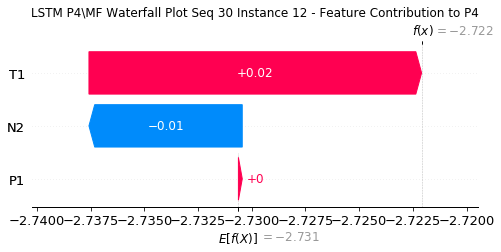

None

Contribution: [5.10847092e-05 2.76660798e-02 2.40564116e-03]


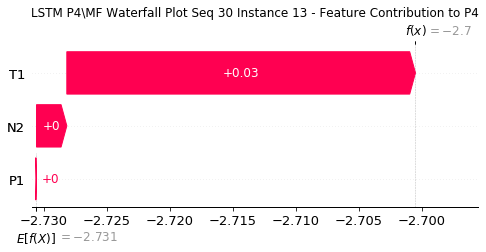

None

Contribution: [-0.00090787 -0.01083405  0.0086884 ]


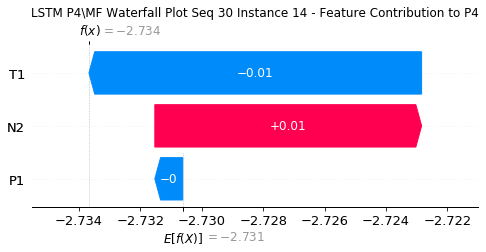

None

Contribution: [ 0.00101435 -0.02403036 -0.00254486]


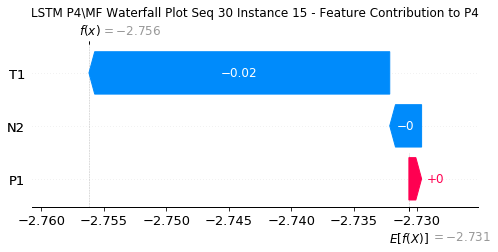

None

Contribution: [ 0.00040678  0.01015458 -0.01088179]


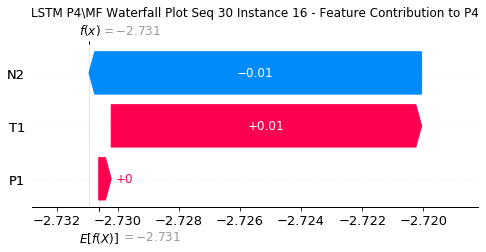

None

Contribution: [0.00041693 0.0315312  0.00146308]


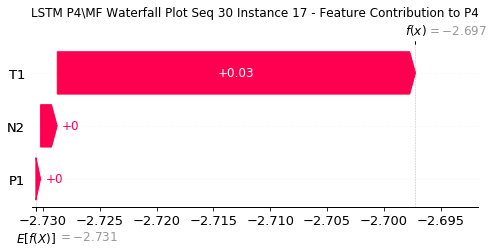

None

Contribution: [-0.00128267 -0.00371766  0.011816  ]


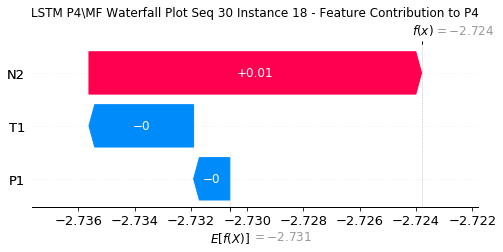

None

Contribution: [ 0.00036572 -0.0250567  -0.00120582]


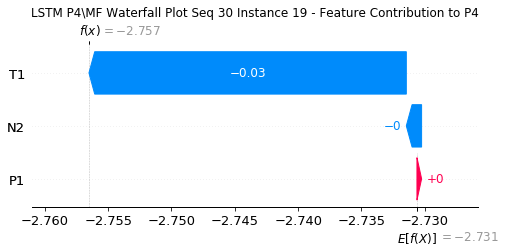

None

Contribution: [ 0.00072998  0.00688838 -0.02215155]


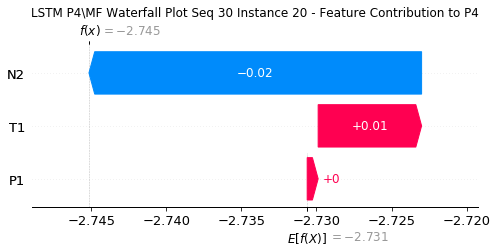

None

Contribution: [ 0.00045206  0.02928641 -0.00382735]


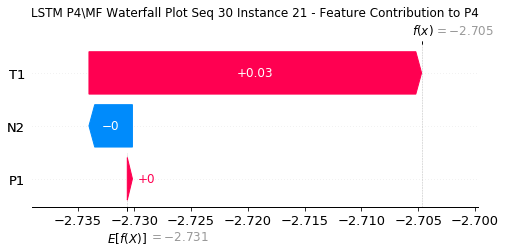

None

Contribution: [-0.00332723 -0.00550418  0.0237825 ]


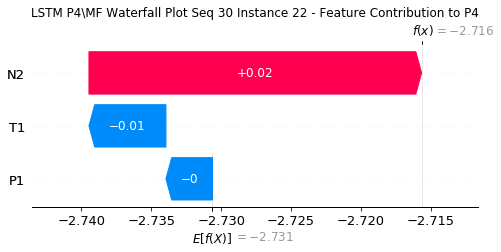

None

Contribution: [-0.00696552 -0.00280056 -0.00731542]


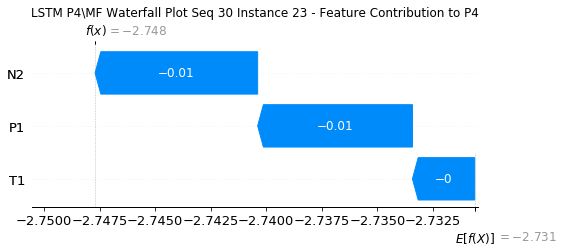

None

Contribution: [-0.00065581  0.01392783 -0.03971344]


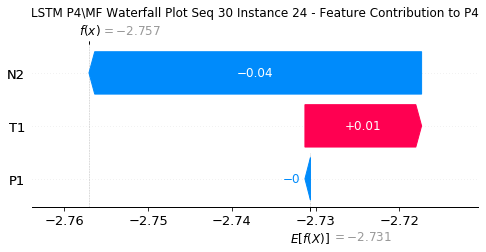

None

Contribution: [ 0.00012457 -0.00116741  0.00065846]


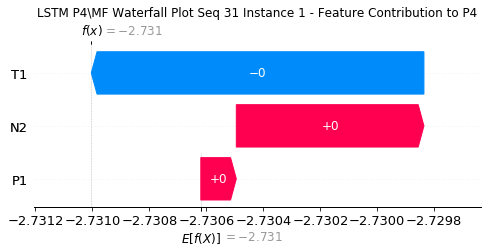

None

Contribution: [-5.44589807e-05 -3.07109001e-04  4.12126317e-04]


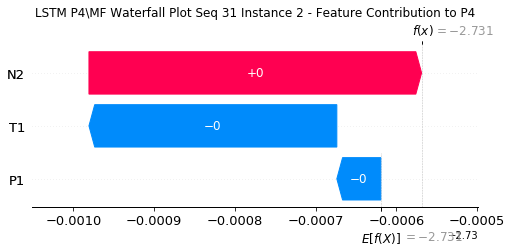

None

Contribution: [-0.00011914 -0.00069933  0.00069295]


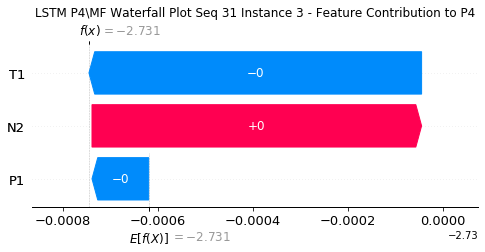

None

Contribution: [ 4.63134471e-05 -1.15965220e-06  7.56227742e-04]


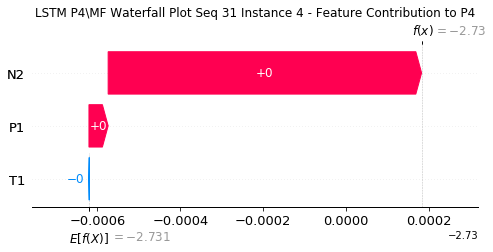

None

Contribution: [0.00034275 0.00104779 0.00097207]


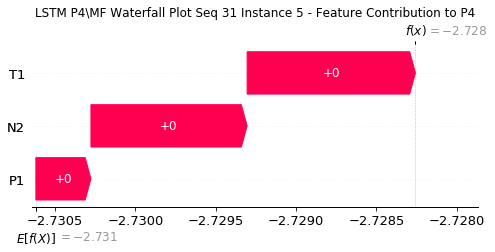

None

Contribution: [ 0.00076557 -0.00200107  0.00071369]


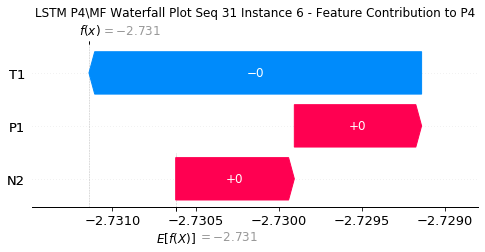

None

Contribution: [ 0.00047679 -0.00233384 -0.0040633 ]


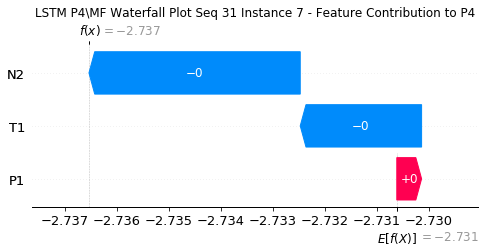

None

Contribution: [ 0.00032221  0.01610335 -0.00271954]


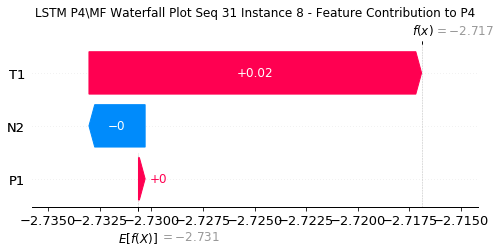

None

Contribution: [0.00148458 0.0157789  0.00324763]


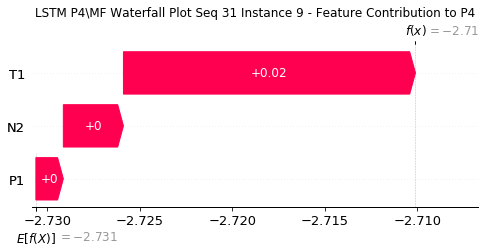

None

Contribution: [-0.00068444 -0.01698858  0.00628315]


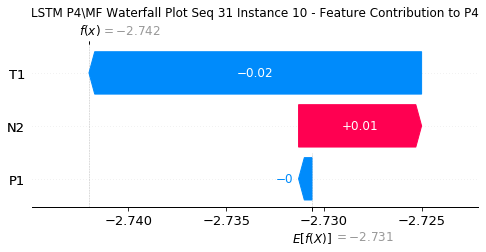

None

Contribution: [ 0.00190168 -0.01894072 -0.00352917]


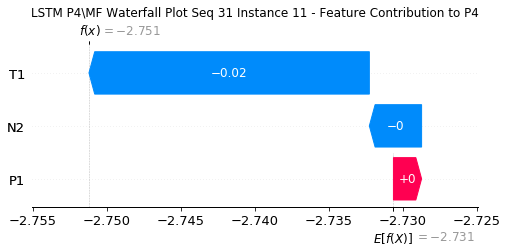

None

Contribution: [ 0.0008844   0.01434258 -0.00921262]


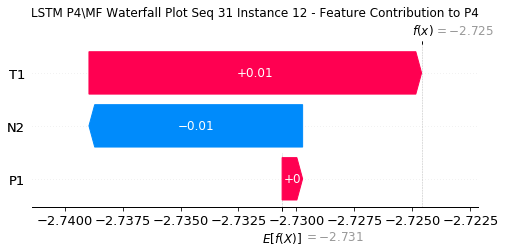

None

Contribution: [-0.00167235  0.02481829  0.00239258]


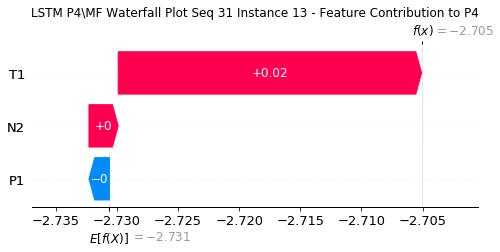

None

Contribution: [-0.00188987 -0.01018165  0.01070764]


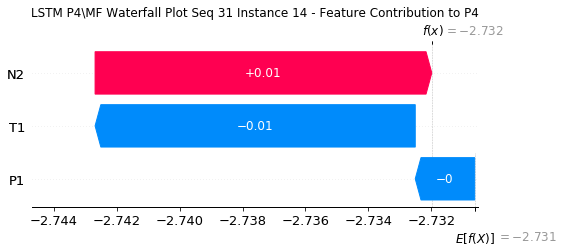

None

Contribution: [ 0.00016089 -0.02600799 -0.00224025]


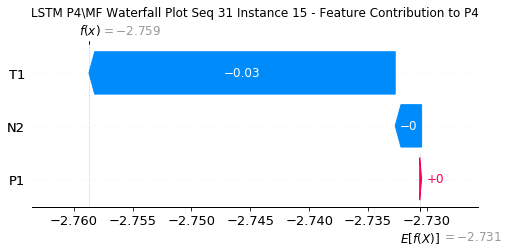

None

Contribution: [ 0.00124188  0.00989726 -0.0120577 ]


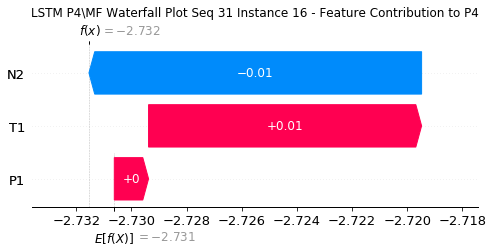

None

Contribution: [8.98261307e-05 3.13440832e-02 1.34036756e-03]


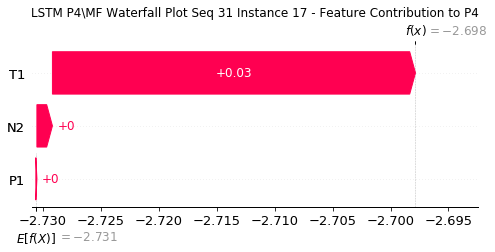

None

Contribution: [-0.00303929 -0.00288571  0.015504  ]


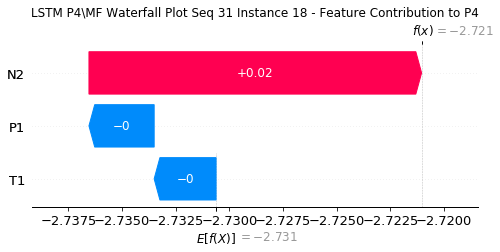

None

Contribution: [ 0.00028998 -0.0284331  -0.00142067]


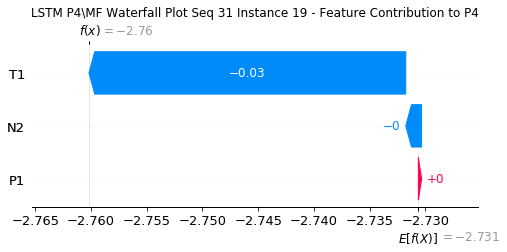

None

Contribution: [ 0.0003516   0.00827488 -0.02082467]


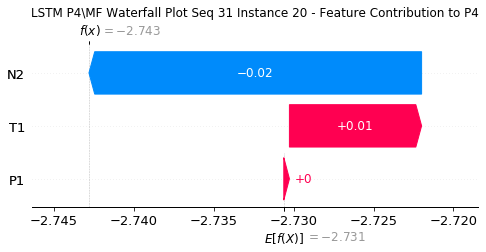

None

Contribution: [ 0.00062882  0.03458633 -0.0033077 ]


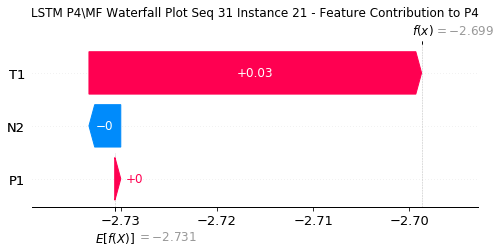

None

Contribution: [-0.00269216 -0.0057339   0.02245454]


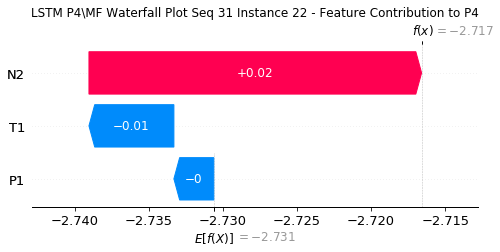

None

Contribution: [-0.00539388 -0.00198128 -0.00758492]


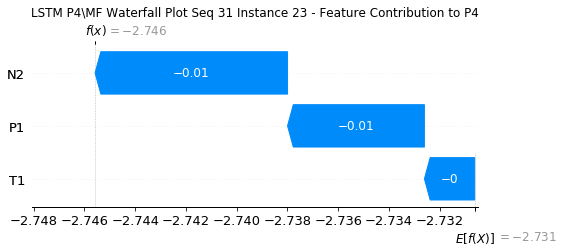

None

Contribution: [-3.48986860e-05  1.55042505e-02 -4.68007945e-02]


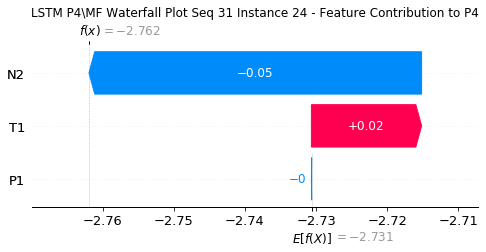

None

Contribution: [ 0.00025004 -0.00089663  0.00077126]


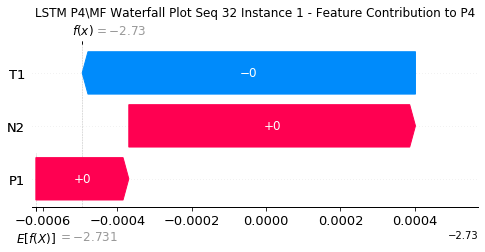

None

Contribution: [ 7.31271971e-05 -1.68561891e-04  7.09196614e-04]


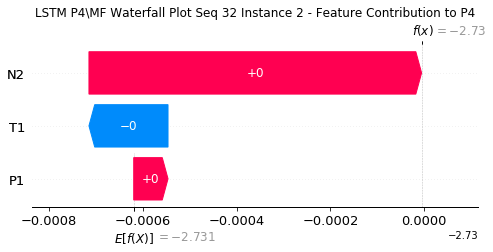

None

Contribution: [ 0.00016137 -0.00075744  0.00107263]


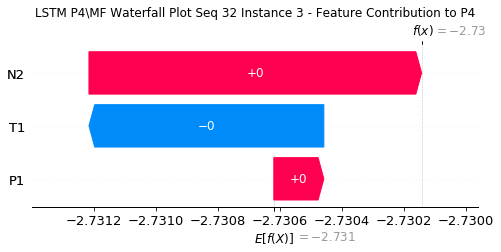

None

Contribution: [-2.95641986e-05  7.47962659e-05  8.03717780e-04]


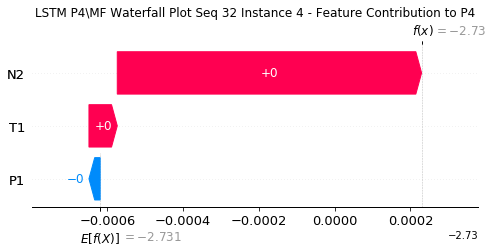

None

Contribution: [0.00011555 0.00117285 0.00100434]


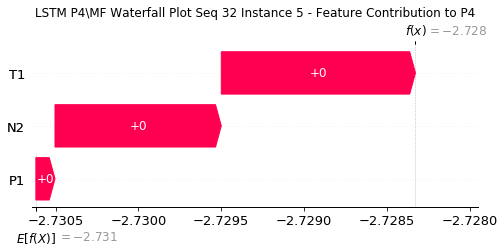

None

Contribution: [-0.00049698 -0.00213309  0.00026788]


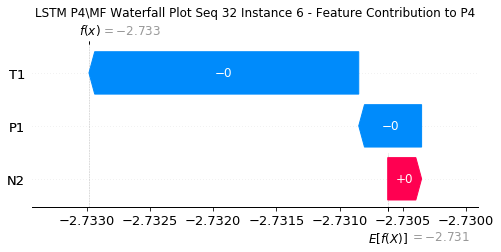

None

Contribution: [ 7.90832812e-05 -2.37588174e-03 -4.69415506e-03]


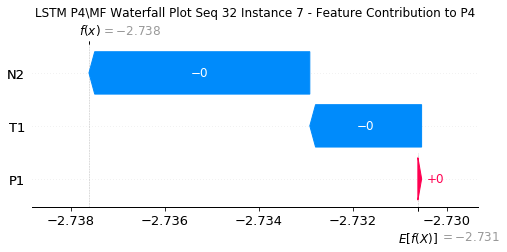

None

Contribution: [-4.09316473e-06  1.45988020e-02 -6.12371709e-03]


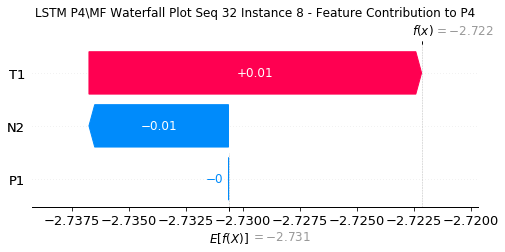

None

Contribution: [-0.00257231  0.01336112  0.00620435]


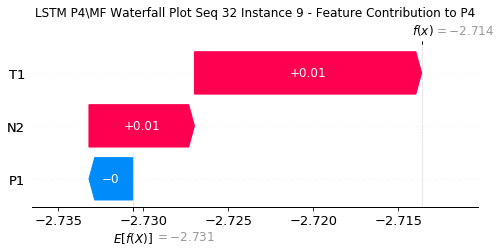

None

Contribution: [-0.00104994 -0.01390052  0.01107158]


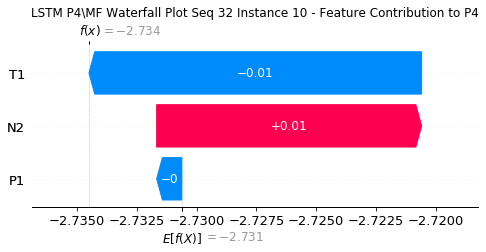

None

Contribution: [ 0.00090373 -0.02068517 -0.00387934]


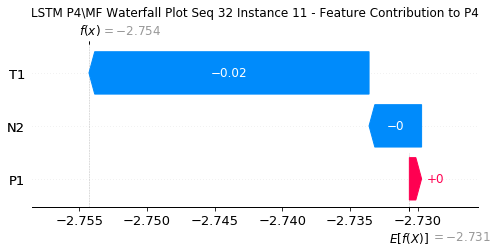

None

Contribution: [ 0.0004898   0.01576676 -0.0122397 ]


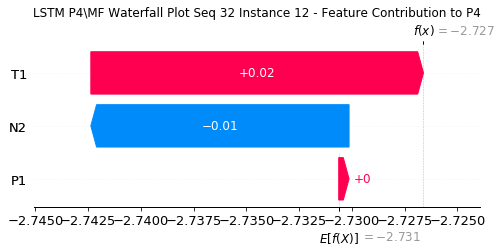

None

Contribution: [5.82195322e-05 2.79533850e-02 2.31643422e-03]


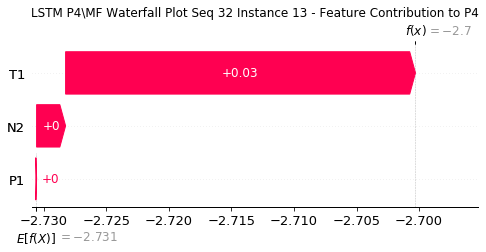

None

Contribution: [-0.00133117 -0.01103984  0.01423821]


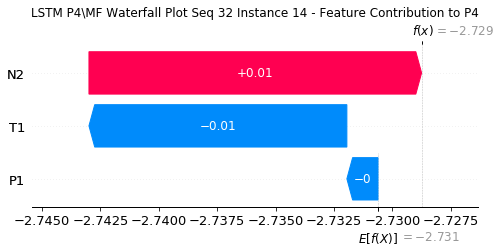

None

Contribution: [-0.00216713 -0.03399492 -0.00235587]


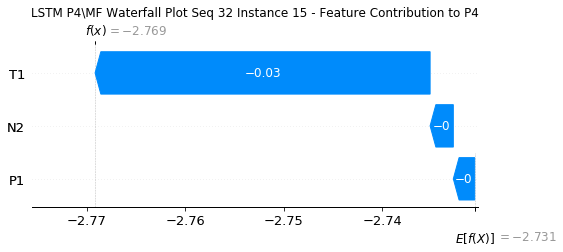

None

Contribution: [ 0.00085391  0.01093812 -0.01668416]


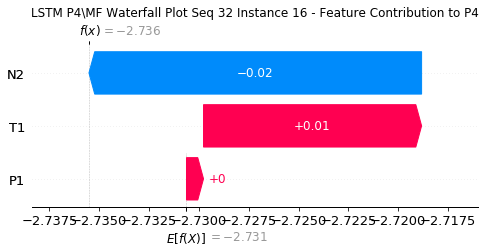

None

Contribution: [ 3.49558962e-04  3.51373350e-02 -4.07622238e-05]


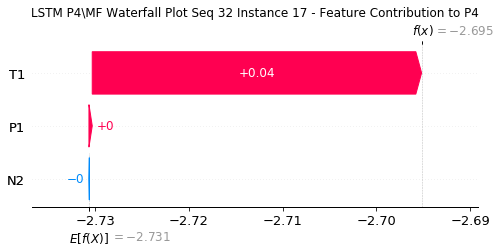

None

Contribution: [-0.00088704 -0.00402654  0.02041023]


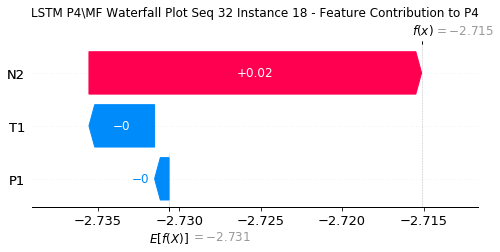

None

Contribution: [ 0.00037814 -0.032477    0.00068194]


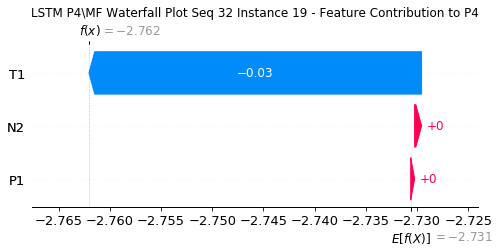

None

Contribution: [ 0.00053704  0.00993561 -0.02727883]


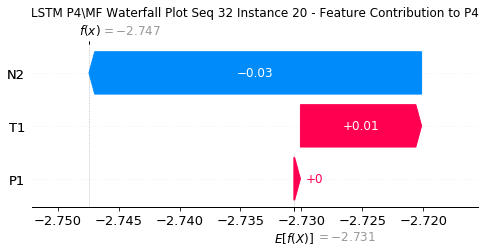

None

Contribution: [ 0.00051186  0.03957713 -0.00639351]


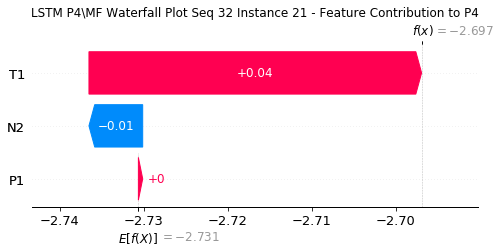

None

Contribution: [-0.00303125 -0.00599902  0.0296363 ]


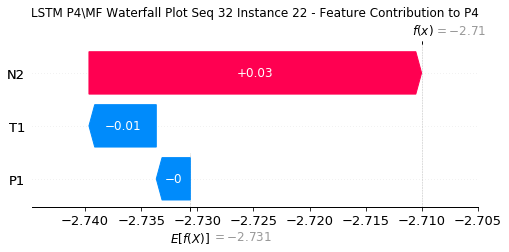

None

Contribution: [-0.00796135 -0.00144904 -0.00646457]


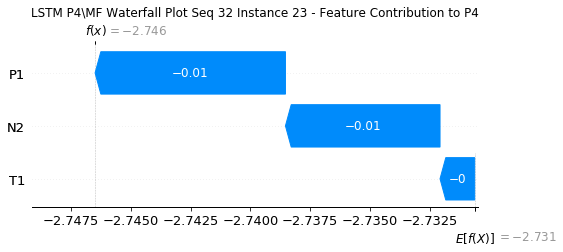

None

Contribution: [-8.07245452e-05  1.44295388e-02 -4.65877132e-02]


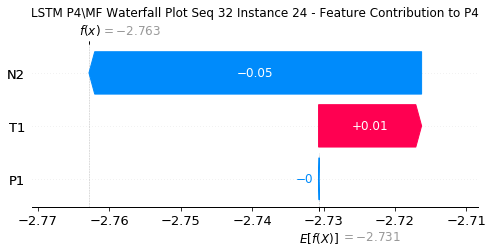

None

Contribution: [ 9.30994458e-05 -9.07267526e-04  6.82994563e-04]


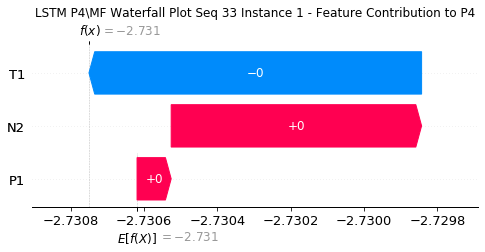

None

Contribution: [-1.28008598e-05 -1.29187602e-04  6.10775842e-04]


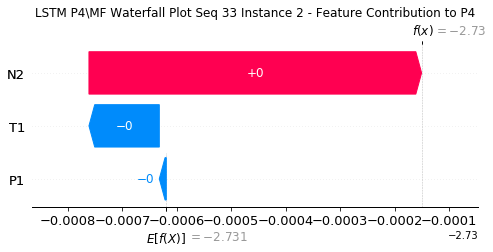

None

Contribution: [ 5.21072028e-06 -6.15025868e-04  9.63257172e-04]


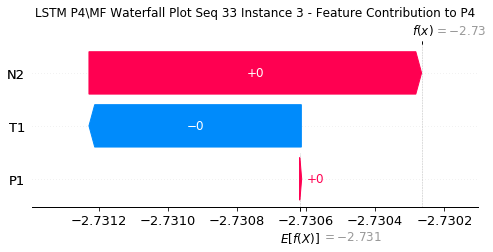

None

Contribution: [-0.00010709  0.00018011  0.0007906 ]


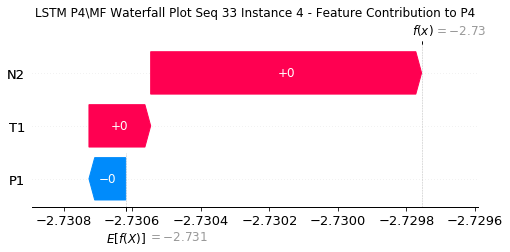

None

Contribution: [-0.00020429  0.00128311  0.00088961]


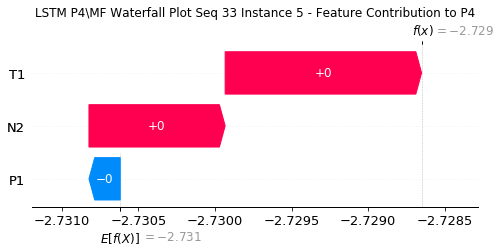

None

Contribution: [-0.00036368 -0.00230951  0.00034043]


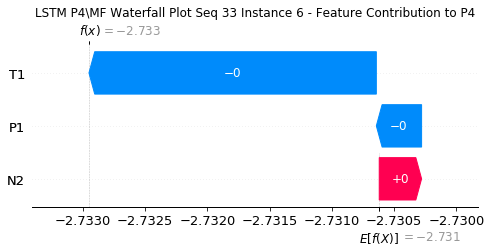

None

Contribution: [-0.00066789 -0.00262642 -0.00356062]


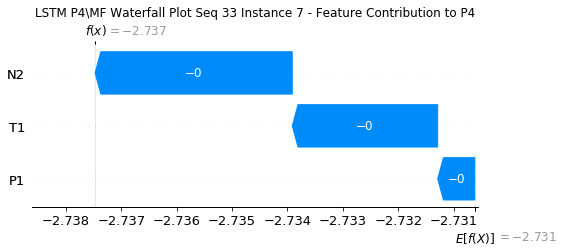

None

Contribution: [ 0.00017974  0.01973884 -0.00312299]


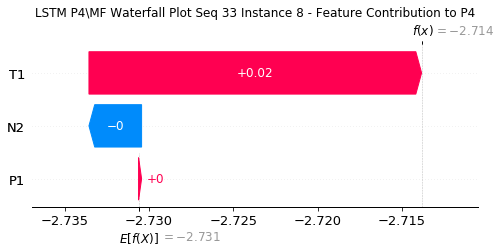

None

Contribution: [-0.00072574  0.01677187  0.00355699]


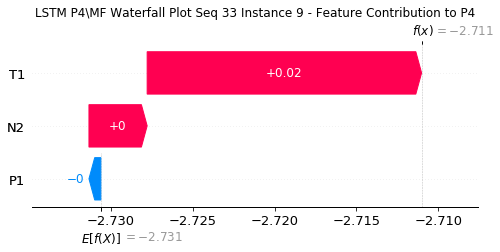

None

Contribution: [-0.00075075 -0.02053031  0.00565562]


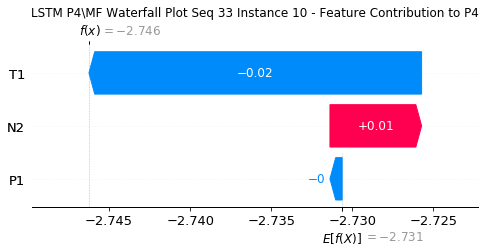

None

Contribution: [-0.00088024 -0.02505212 -0.0030961 ]


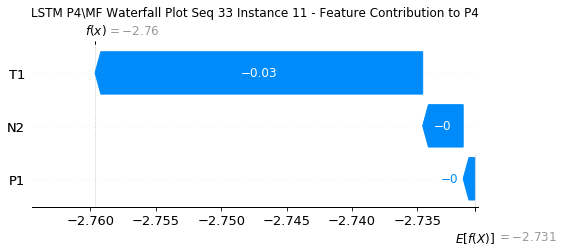

None

Contribution: [-0.00048442  0.01863559 -0.0075005 ]


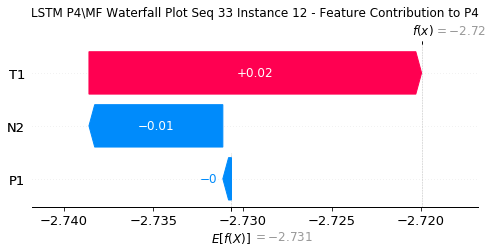

None

Contribution: [-0.00118261  0.0314895   0.00228897]


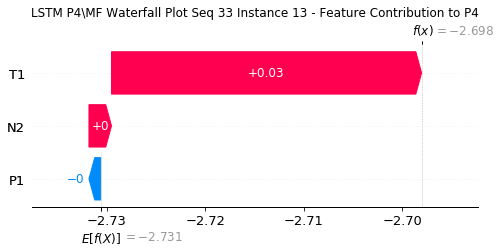

None

Contribution: [-0.00024155 -0.01320428  0.00850671]


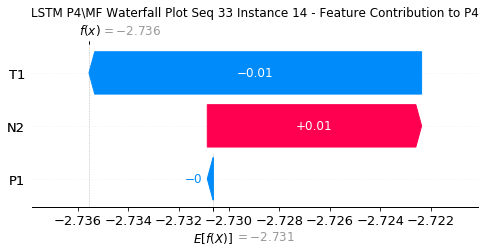

None

Contribution: [-0.00154037 -0.03478337 -0.00286594]


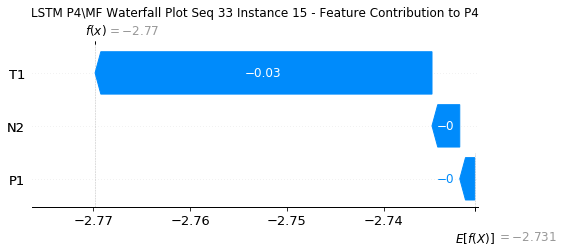

None

Contribution: [-0.00066417  0.01325865 -0.0097436 ]


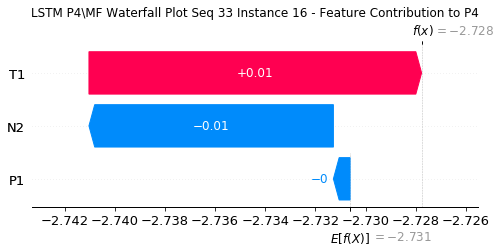

None

Contribution: [0.0019497  0.04256671 0.0018736 ]


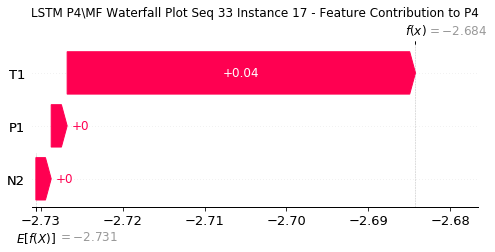

None

Contribution: [-0.00125815 -0.00461304  0.01357263]


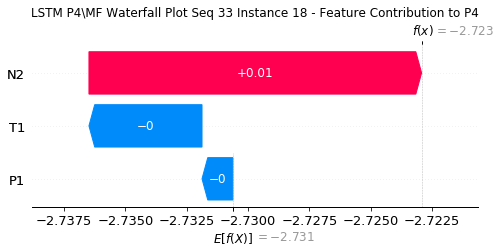

None

Contribution: [-0.00066492 -0.03810117 -0.00197234]


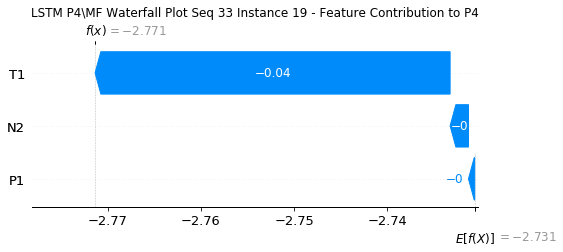

None

Contribution: [-0.00123059  0.01275563 -0.01919719]


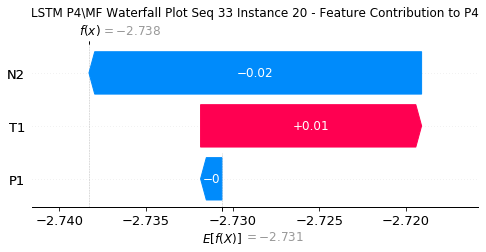

None

Contribution: [ 0.00125362  0.04839909 -0.00245606]


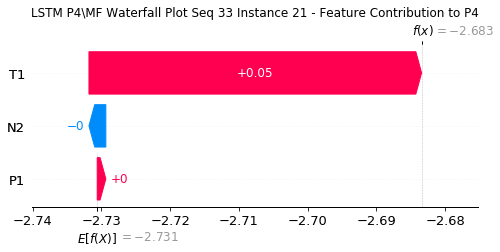

None

Contribution: [-0.00072714 -0.00651817  0.02038452]


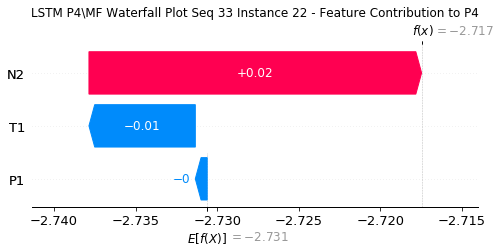

None

Contribution: [-0.00394044  0.00068491 -0.0080268 ]


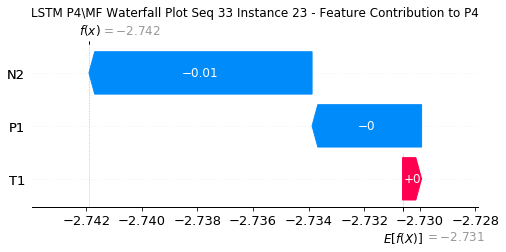

None

Contribution: [-0.00088212  0.02876034 -0.03679492]


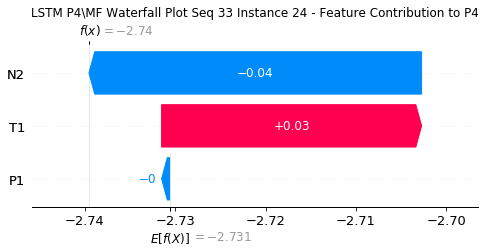

None

Contribution: [-0.00014011 -0.00140173  0.00024581]


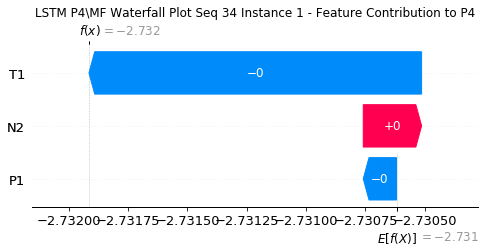

None

Contribution: [-7.37086360e-05 -4.32783380e-04  2.54610738e-04]


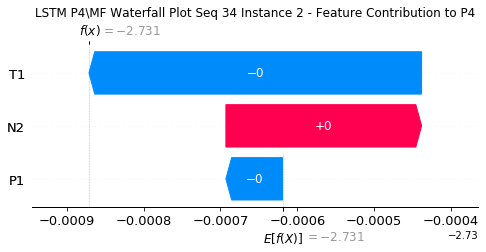

None

Contribution: [-0.00015785 -0.00100105  0.00056282]


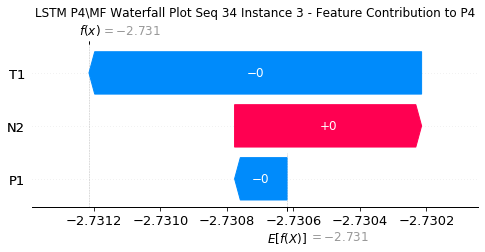

None

Contribution: [-1.30291821e-04  7.96982353e-05  7.20799657e-04]


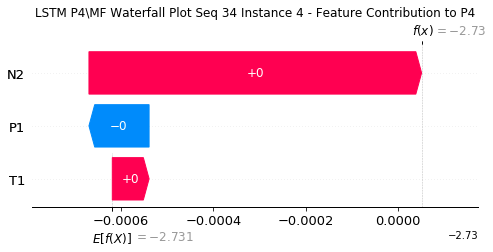

None

Contribution: [-0.00032089  0.00122405  0.00080494]


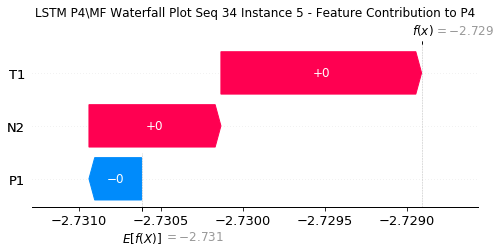

None

Contribution: [-0.00136731 -0.00304316  0.00049242]


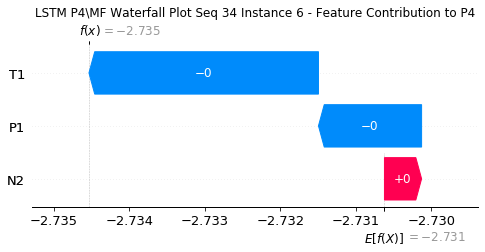

None

Contribution: [-0.00119824 -0.00282598 -0.00316002]


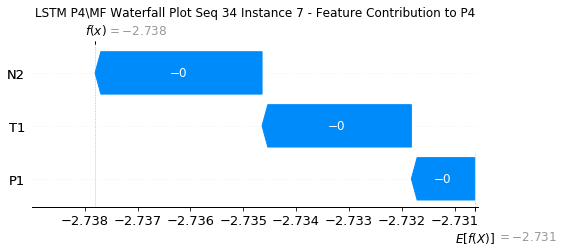

None

Contribution: [ 0.00104433  0.01977776 -0.0035016 ]


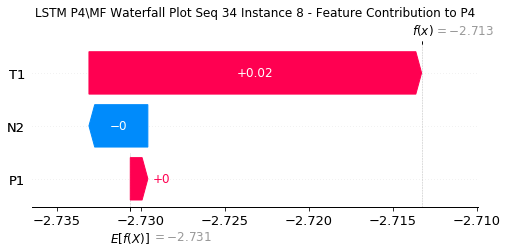

None

Contribution: [0.00784778 0.02079814 0.00350786]


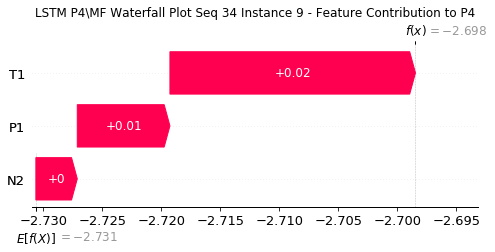

None

Contribution: [ 0.00124797 -0.02090884  0.00539321]


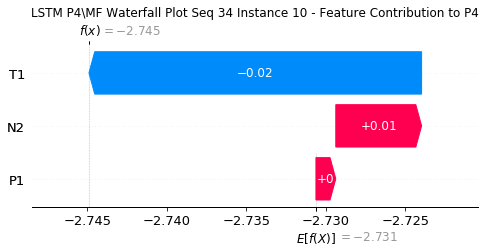

None

Contribution: [-0.00251784 -0.02784686 -0.00309245]


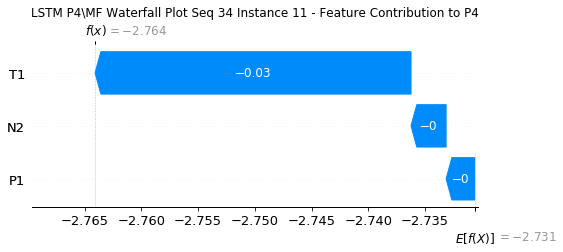

None

Contribution: [-0.0011797   0.02052506 -0.00768664]


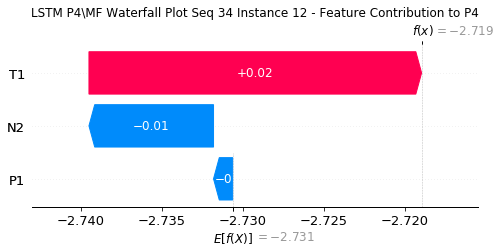

None

Contribution: [0.00287127 0.03295799 0.00228975]


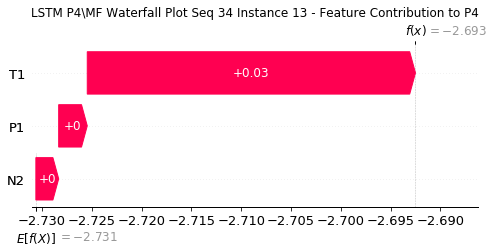

None

Contribution: [ 0.00106148 -0.01444851  0.00889286]


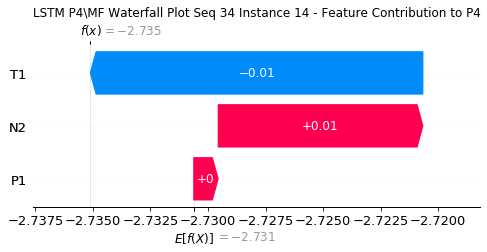

None

Contribution: [-0.00334349 -0.03883162 -0.00267454]


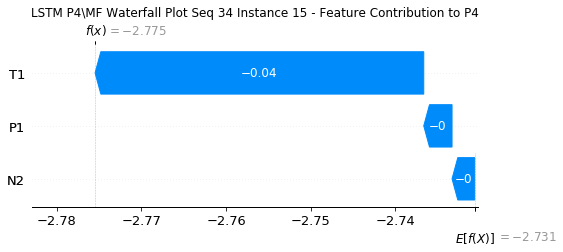

None

Contribution: [-0.00182917  0.01446191 -0.01100832]


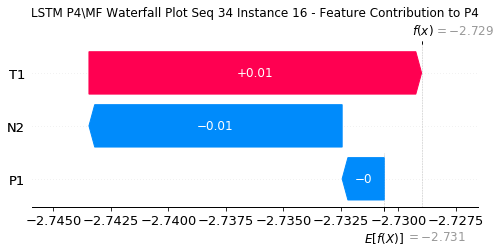

None

Contribution: [0.00263054 0.04595671 0.00158184]


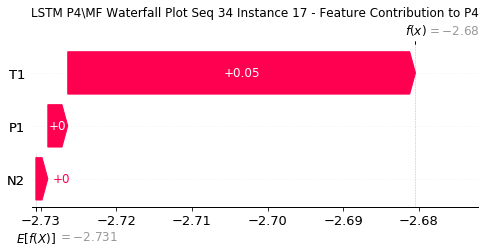

None

Contribution: [ 0.00108425 -0.00456001  0.01369594]


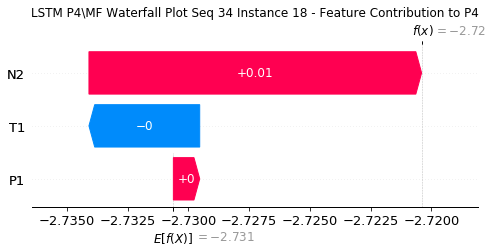

None

Contribution: [-0.00082715 -0.03971886 -0.00170035]


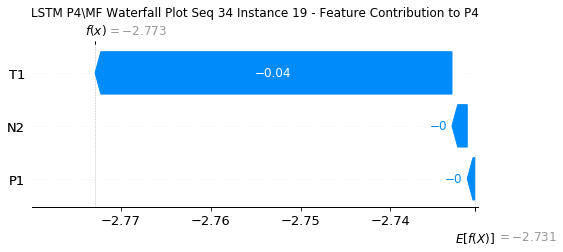

None

Contribution: [-0.00143145  0.01360577 -0.0198056 ]


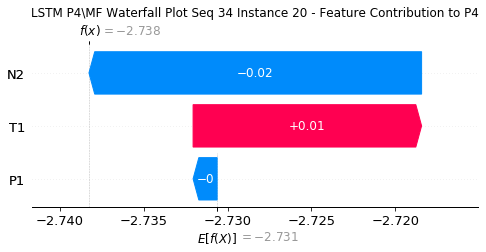

None

Contribution: [ 0.00150458  0.04933551 -0.00243192]


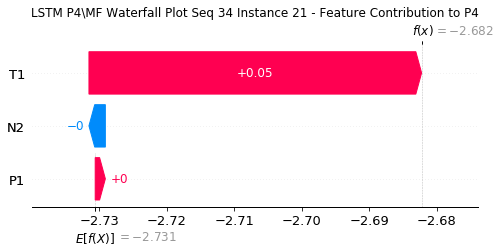

None

Contribution: [ 0.00051502 -0.00660863  0.02094208]


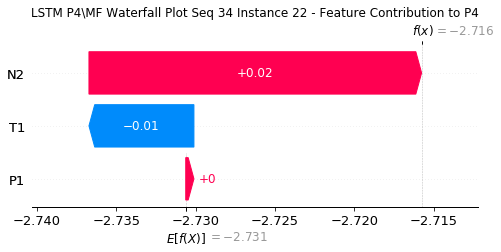

None

Contribution: [-0.00151539  0.00101091 -0.00807679]


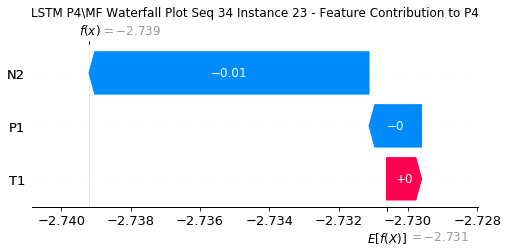

None

Contribution: [-0.00096469  0.03072789 -0.03800612]


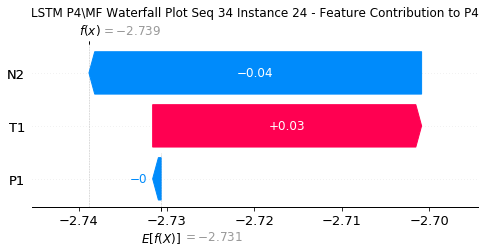

None

In [39]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P4\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [2]:
#Consistency

P4_tot1' = -3.694 + 2.732
P4_tot1'

-0.9619999999999997

In [ ]:
#MF contribution instance 1

MF_P4_1' = -0.00211023